In [1]:
import numpy as np

import os
import gzip
import matplotlib.pyplot as plt
import sys
import time


import argparse
import sys
#import tempfile

FLAGS = None

In [2]:
import tensorflow as tf

In [3]:
import h5py
#import numpy as np
import random

class Data:
  def __init__(self):
    with h5py.File("cell_data.h5", "r") as data:
      self.train_images = [data["/train_image_{}".format(i)][:] for i in range(28)]
      self.train_labels = [data["/train_label_{}".format(i)][:] for i in range(28)]
      self.test_images = [data["/test_image_{}".format(i)][:] for i in range(3)]
      self.test_labels = [data["/test_label_{}".format(i)][:] for i in range(3)]
    
    self.input_resolution = 300
    self.label_resolution = 116

    self.offset = (300 - 116) // 2

  def get_train_image_list_and_label_list(self):
    n = random.randint(0, len(self.train_images) - 1)
    x = random.randint(0, (self.train_images[n].shape)[1] - self.input_resolution - 1)
    y = random.randint(0, (self.train_images[n].shape)[0] - self.input_resolution - 1)
    image = self.train_images[n][y:y + self.input_resolution, x:x + self.input_resolution, :]

    x += self.offset
    y += self.offset
    label = self.train_labels[n][y:y + self.label_resolution, x:x + self.label_resolution]
    
    return [image], [label]

  def get_test_image_list_and_label_list(self):
    coord_list = [[0,0], [0, 116], [0, 232], 
                  [116,0], [116, 116], [116, 232],
                  [219,0], [219, 116], [219, 232]]
    
    image_list = []
    label_list = []
    
    for image_id in range(3):
      for y, x in coord_list:
        image = self.test_images[image_id][y:y + self.input_resolution, x:x + self.input_resolution, :]
        image_list.append(image)
        x += self.offset
        y += self.offset
        label = self.test_labels[image_id][y:y + self.label_resolution, x:x + self.label_resolution]
        label_list.append(label)
    

    return image_list, label_list

28
(519, 694, 1)
(300, 300, 1)
1
(116, 116)
[[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [1 1 1 ..., 0 0 0]
 [1 1 1 ..., 0 0 0]
 [1 1 1 ..., 0 0 0]]


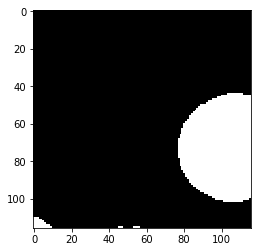

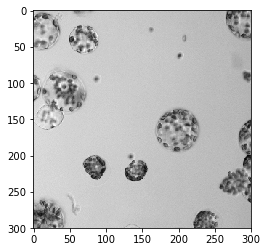

27
(116, 116)
[[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [1 1 1 ..., 0 0 0]
 [1 1 1 ..., 0 0 0]
 [1 1 1 ..., 0 0 0]]


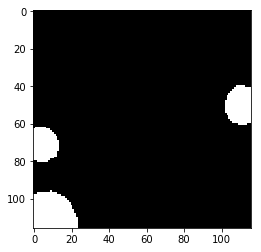

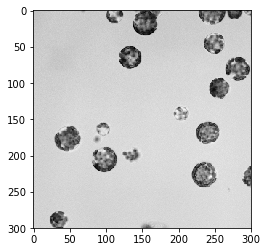

In [5]:
d = Data()
print(len(d.train_images))
print(d.train_images[0].shape)
im, lab = d.get_train_image_list_and_label_list()
print(im[0].shape)
print(len(lab))
print(lab[0].shape)
print(lab[0])
plt.imshow(lab[0], cmap='gray')
plt.show()
tmp=np.reshape(im[0],[300,300])
plt.imshow(tmp, cmap='gray')
plt.show()



im, lab = d.get_test_image_list_and_label_list()

print(len(lab))
print(lab[0].shape)
print(lab[0])
plt.imshow(lab[0], cmap='gray')
plt.show()
tmp=np.reshape(im[0],[300,300])
plt.imshow(tmp, cmap='gray')
plt.show()

In [6]:
def weight_variable(shape):
    initial = tf.truncated_normal(shape, stddev=0.1)
    return tf.Variable(initial)
    
    #v = tf.get_variable("v", shape=shape, initializer=tf.glorot uniform initializer())
    #return v
    

def bias_variable(shape):
    initial = tf.constant(0.0, shape=shape)
    return tf.Variable(initial)

def conv2d(x, W):
    return tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='VALID')

def max_pool_2x2(x):
    return tf.nn.max_pool(x, ksize=[1, 2, 2, 1],strides=[1, 2, 2, 1], padding='VALID')

def print_size(l):
    print(str(l)+' size=',l.get_shape().as_list())

In [16]:
def u_net(x):
    mini_batch_size = 1
    # Reshape the image
    print_size(x)
    
    x_image = tf.reshape(x, [mini_batch_size, 300, 300, 1])
    print_size(x_image)
    
    # convolution 1. Output 298*298*32
    W_conv1 = weight_variable([3, 3, 1, 32])
    b_conv1 = bias_variable([32])    
    h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1) + b_conv1)
    print_size(h_conv1)
    
    # convolution 2. Output 296*296*32
    W_conv2 = weight_variable([3, 3, 32, 32])
    b_conv2 = bias_variable([32])    
    h_conv2 = tf.nn.relu(conv2d(h_conv1, W_conv2) + b_conv2)
    print_size(h_conv2)
    
    # max pool 3. Output 148*148*32
    h_pool3 = max_pool_2x2(h_conv2)
    print_size(h_pool3)
    
    # convolution 4. Output 146*146*64
    W_conv4 = weight_variable([3, 3, 32, 64])
    b_conv4 = bias_variable([64])     
    h_conv4 = tf.nn.relu(conv2d(h_pool3, W_conv4) + b_conv4)
    print_size(h_conv4)
    
    # convolution 5. Output 144*144*64
    W_conv5 = weight_variable([3, 3, 64, 64])
    b_conv5 = bias_variable([64])     
    h_conv5 = tf.nn.relu(conv2d(h_conv4, W_conv5) + b_conv5)
    print_size(h_conv5)
    
    # max pool 6. Output 72*72*64
    h_pool6 = max_pool_2x2(h_conv5)
    print_size(h_pool6)
    
    # convolution 7. Output 70*70*128
    W_conv7 = weight_variable([3, 3, 64, 128])
    b_conv7 = bias_variable([128])     
    h_conv7 = tf.nn.relu(conv2d(h_pool6, W_conv7) + b_conv7)
    print_size(h_conv7)
    
    # convolution 8. Output 68*68*128
    W_conv8 = weight_variable([3, 3, 128, 128])
    b_conv8 = bias_variable([128])     
    h_conv8 = tf.nn.relu(conv2d(h_conv7, W_conv8) + b_conv8)
    print_size(h_conv8)
    
    # max pool 9. Output 34*34*128
    h_pool9 = max_pool_2x2(h_conv8)
    print_size(h_pool9)
    
    # convolution 10. Output 32*32*256
    W_conv10 = weight_variable([3, 3, 128, 256])
    b_conv10 = bias_variable([256])     
    h_conv10 = tf.nn.relu(conv2d(h_pool9, W_conv10) + b_conv10)
    print_size(h_conv10)
    
    # convolution 11. Output 30*30*256
    W_conv11 = weight_variable([3, 3, 256, 256])
    b_conv11 = bias_variable([256])     
    h_conv11 = tf.nn.relu(conv2d(h_conv10, W_conv11) + b_conv11)
    print_size(h_conv11)
    
    # max pool 12. Output 15*15*256
    h_pool12 = max_pool_2x2(h_conv11)
    print_size(h_pool12)
    
    # convolution 13. Output 13*13*512
    W_conv13 = weight_variable([3, 3, 256, 512])
    b_conv13 = bias_variable([512])     
    h_conv13 = tf.nn.relu(conv2d(h_pool12, W_conv13) + b_conv13)
    print_size(h_conv13)
    
    # convolution 14. Output 11*11*512
    W_conv14 = weight_variable([3, 3, 512, 512])
    b_conv14 = bias_variable([512])     
    h_conv14 = tf.nn.relu(conv2d(h_conv13, W_conv14) + b_conv14)
    print_size(h_conv14)
    
    # up-convolition 15. Output 22*22*256
    W_uconv15 = weight_variable([2, 2, 256, 512])   
    stride  = [1, 2, 2, 1]
    h_uconv15 = tf.nn.conv2d_transpose(h_conv14, W_uconv15,[mini_batch_size, 22, 22, 256],stride, padding='VALID')
    print_size(h_uconv15)
    # concat with croped copy from layer 11. Output 22*22*512
    h_conv11_crop = tf.image.resize_image_with_crop_or_pad(h_conv11, 22, 22)
    print_size(h_conv11_crop)
    #print(h_conv11_crop.get_shape().as_list())
    h_uconv15_ = tf.concat([h_conv11_crop, h_uconv15], 3)
    print_size(h_uconv15_)
    
    # convolution 16. Output 20*20*256
    W_conv16 = weight_variable([3, 3, 512, 256])
    b_conv16 = bias_variable([256])     
    h_conv16 = tf.nn.relu(conv2d(h_uconv15_, W_conv16) + b_conv16)
    print_size(h_conv16)
    
    # convolution 17. Output 18*18*256
    W_conv17 = weight_variable([3, 3, 256, 256])
    b_conv17 = bias_variable([256])     
    h_conv17 = tf.nn.relu(conv2d(h_conv16, W_conv17) + b_conv17)
    print_size(h_conv17)
    
    # up-convolition 18. Output 36*36*128
    W_uconv18 = weight_variable([2, 2, 128, 256])   
    stride  = [1, 2, 2, 1]
    h_uconv18 = tf.nn.conv2d_transpose(h_conv17, W_uconv18,[mini_batch_size, 36, 36, 128],stride, padding='VALID') 
    print_size(h_uconv18)
    # concat with croped copy from layer 8. Output 36*36*256
    h_conv8_crop = tf.image.resize_image_with_crop_or_pad(h_conv8, 36, 36)
    print_size(h_conv8_crop)
    h_uconv18_ = tf.concat([h_conv8_crop, h_uconv18], 3)
    print_size(h_uconv18_)
    
    # convolution 19. Output 34*34*128
    W_conv19 = weight_variable([3, 3, 256, 128])
    b_conv19 = bias_variable([128])     
    h_conv19 = tf.nn.relu(conv2d(h_uconv18_, W_conv19) + b_conv19)
    print_size(h_conv19)
    
    # convolution 20. Output 32*32*128
    W_conv20 = weight_variable([3, 3, 128, 128])
    b_conv20 = bias_variable([128])     
    h_conv20 = tf.nn.relu(conv2d(h_conv19, W_conv20) + b_conv20)
    print_size(h_conv20)
    
    
    # up-convolition 21. Output 64*64*64
    W_uconv21 = weight_variable([2, 2, 64, 128])   
    stride  = [1, 2, 2, 1]
    h_uconv21 = tf.nn.conv2d_transpose(h_conv20, W_uconv21,[mini_batch_size, 64, 64, 64],stride, padding='VALID') 
    print_size(h_uconv21)
    # concat with croped copy from layer 5. Output 64*64*128
    h_conv5_crop = tf.image.resize_image_with_crop_or_pad(h_conv5, 64, 64)
    print_size(h_conv5_crop)
    h_uconv21_ = tf.concat([h_conv5_crop, h_uconv21], 3)
    print_size(h_uconv21_)
    
    # convolution 22. Output 62*62*64
    W_conv22 = weight_variable([3, 3, 128, 64])
    b_conv22 = bias_variable([64])     
    h_conv22 = tf.nn.relu(conv2d(h_uconv21_, W_conv22) + b_conv22)
    print_size(h_conv22)
    
    # convolution 23. Output 60*60*64
    W_conv23 = weight_variable([3, 3, 64, 64])
    b_conv23 = bias_variable([64])     
    h_conv23 = tf.nn.relu(conv2d(h_conv22, W_conv23) + b_conv23)
    print_size(h_conv23)
    
    # up-convolition 24. Output 120*120*32
    W_uconv24 = weight_variable([2, 2, 32, 64])   
    stride  = [1, 2, 2, 1]
    h_uconv24 = tf.nn.conv2d_transpose(h_conv23, W_uconv24,[mini_batch_size, 120, 120, 32],stride, padding='VALID')
    print_size(h_uconv24)
    # concat with croped copy from layer 2. Output 120*120*64
    h_conv2_crop = tf.image.resize_image_with_crop_or_pad(h_conv2, 120, 120)
    print_size(h_conv2_crop)
    h_uconv24_ = tf.concat([h_conv2_crop, h_uconv24], 3)
    print_size(h_uconv24_)
    
    # convolution 25. Output 118*118*32
    W_conv25 = weight_variable([3, 3, 64, 32])
    b_conv25 = bias_variable([32])     
    h_conv25 = tf.nn.relu(conv2d(h_uconv24_, W_conv25) + b_conv25)
    print_size(h_conv25)
    
    # convolution 26. Output 116*116*32
    W_conv26 = weight_variable([3, 3, 32, 32])
    b_conv26 = bias_variable([32])     
    h_conv26 = tf.nn.relu(conv2d(h_conv25, W_conv26) + b_conv26)
    print_size(h_conv26)
    
    # convolution 27. Output 116*116*2
    W_conv27 = weight_variable([1, 1, 32, 2])
    b_conv27 = bias_variable([2])     
    h_conv27 = conv2d(h_conv26, W_conv27) + b_conv27
    print_size(h_conv27)
    
    
    return h_conv27


Tensor("Placeholder_14:0", shape=(?, 300, 300, 1), dtype=float32) size= [None, 300, 300, 1]
Tensor("Reshape_60:0", shape=(1, 300, 300, 1), dtype=float32) size= [1, 300, 300, 1]
Tensor("Relu_108:0", shape=(1, 298, 298, 32), dtype=float32) size= [1, 298, 298, 32]
Tensor("Relu_109:0", shape=(1, 296, 296, 32), dtype=float32) size= [1, 296, 296, 32]
Tensor("MaxPool_24:0", shape=(1, 148, 148, 32), dtype=float32) size= [1, 148, 148, 32]
Tensor("Relu_110:0", shape=(1, 146, 146, 64), dtype=float32) size= [1, 146, 146, 64]
Tensor("Relu_111:0", shape=(1, 144, 144, 64), dtype=float32) size= [1, 144, 144, 64]
Tensor("MaxPool_25:0", shape=(1, 72, 72, 64), dtype=float32) size= [1, 72, 72, 64]
Tensor("Relu_112:0", shape=(1, 70, 70, 128), dtype=float32) size= [1, 70, 70, 128]
Tensor("Relu_113:0", shape=(1, 68, 68, 128), dtype=float32) size= [1, 68, 68, 128]
Tensor("MaxPool_26:0", shape=(1, 34, 34, 128), dtype=float32) size= [1, 34, 34, 128]
Tensor("Relu_114:0", shape=(1, 32, 32, 256), dtype=float32) si

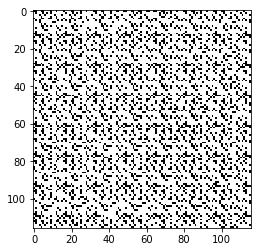

Label  0


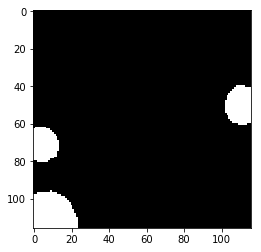

Prediction  1


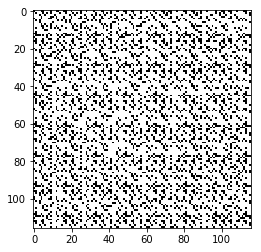

Label  1


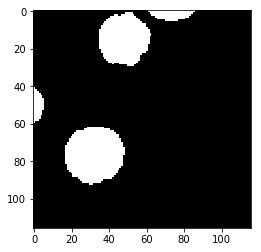

Prediction  2


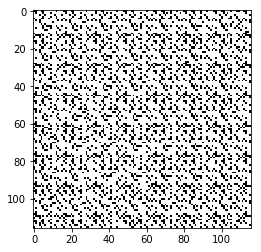

Label  2


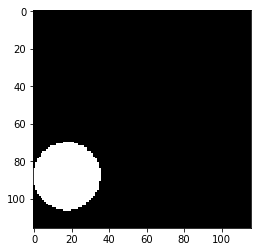

Prediction  3


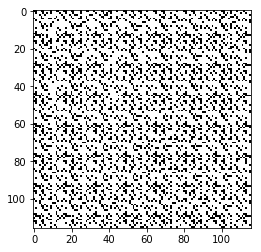

Label  3


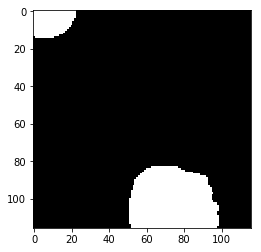

Prediction  4


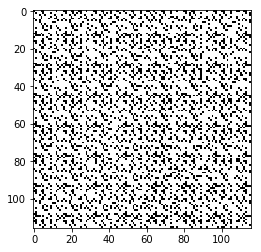

Label  4


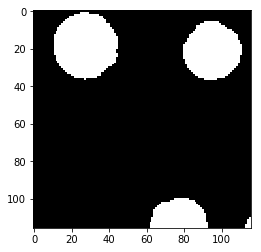

Prediction  5


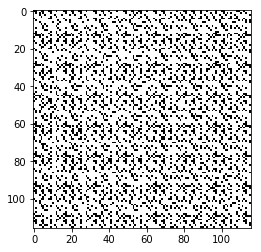

Label  5


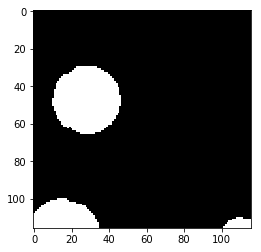

Prediction  6


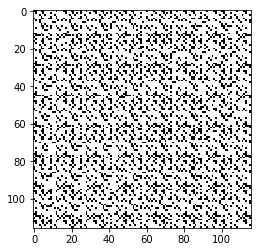

Label  6


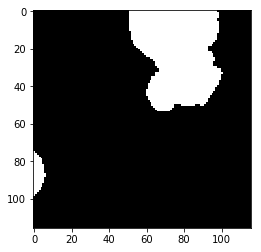

Prediction  7


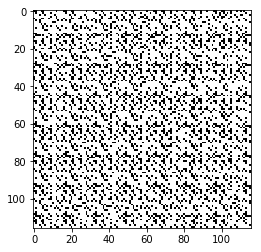

Label  7


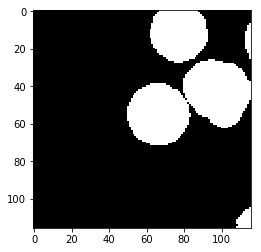

Prediction  8


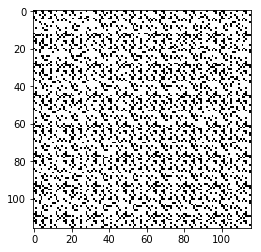

Label  8


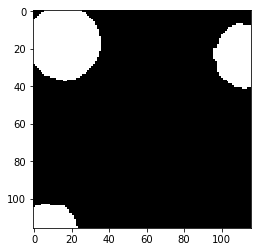

Prediction  9


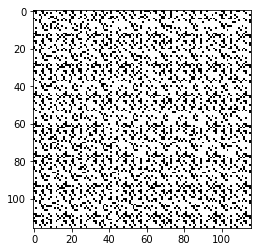

Label  9


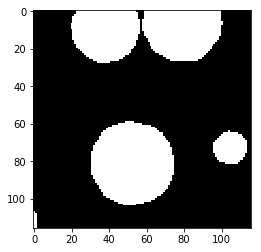

Prediction  10


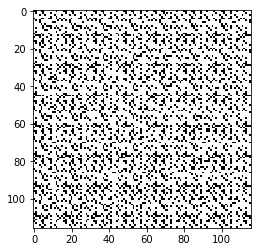

Label  10


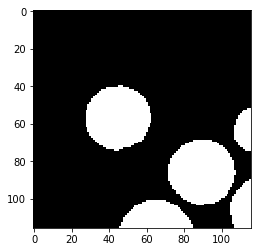

Prediction  11


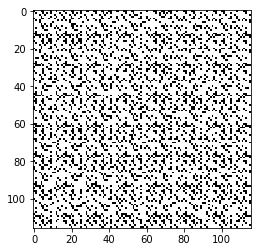

Label  11


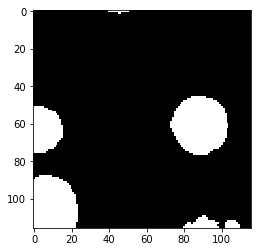

Prediction  12


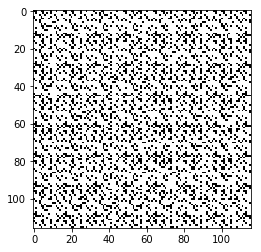

Label  12


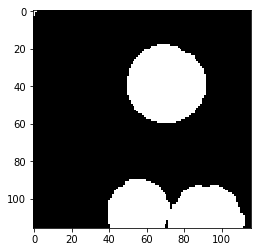

Prediction  13


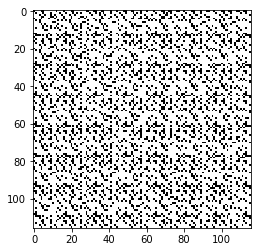

Label  13


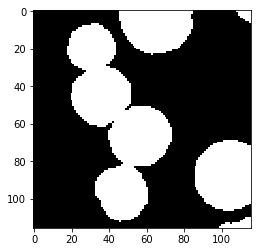

Prediction  14


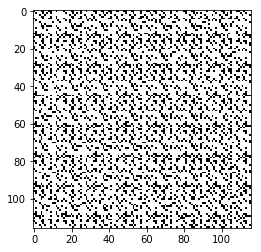

Label  14


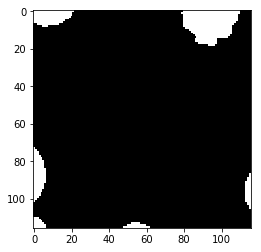

Prediction  15


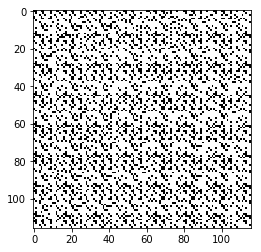

Label  15


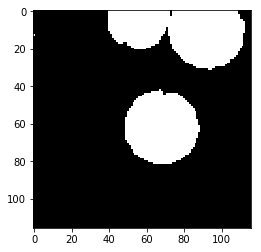

Prediction  16


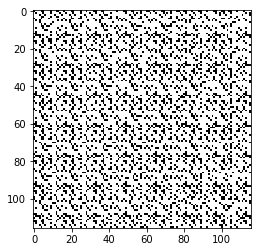

Label  16


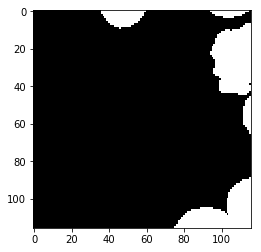

Prediction  17


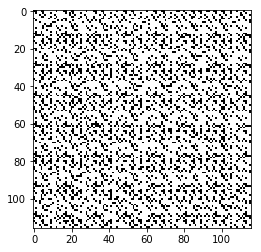

Label  17


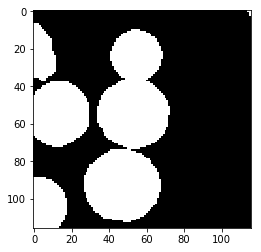

Prediction  18


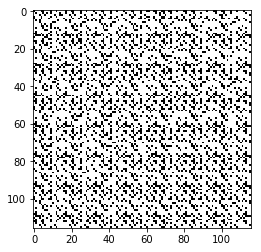

Label  18


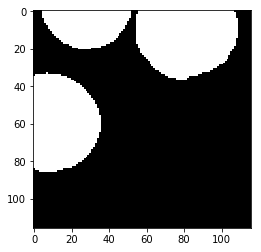

Prediction  19


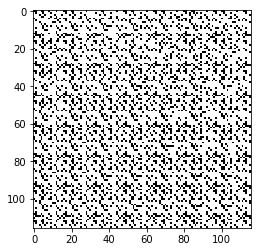

Label  19


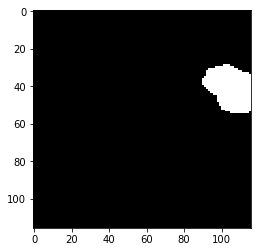

Prediction  20


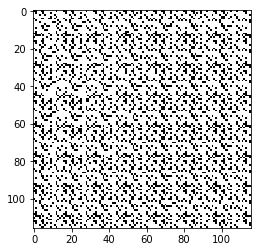

Label  20


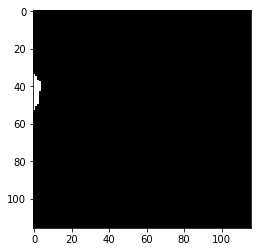

Prediction  21


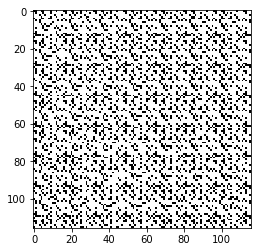

Label  21


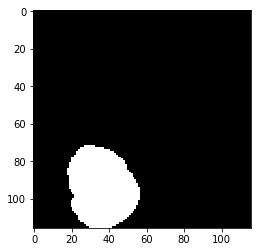

Prediction  22


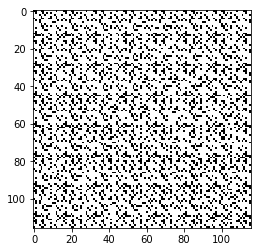

Label  22


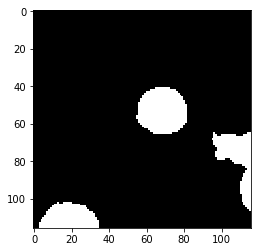

Prediction  23


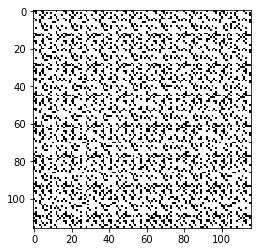

Label  23


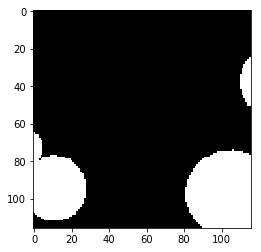

Prediction  24


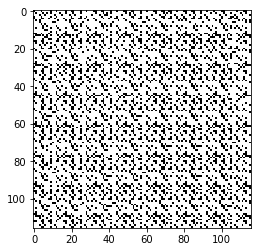

Label  24


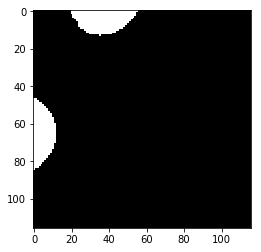

Prediction  25


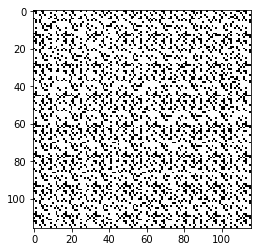

Label  25


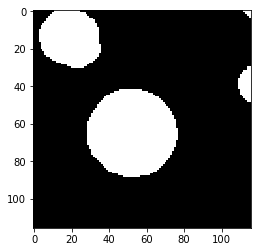

Prediction  26


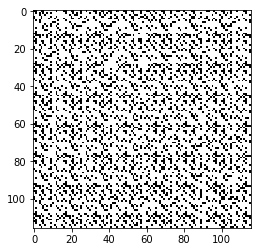

Label  26


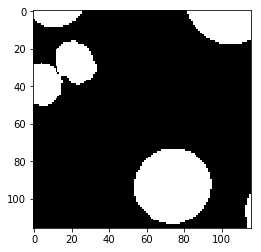

test_accuracy 0.194090142328
Batch: 500 Train Loss value:0.204504 Train Accuracy 0.796888562462
Prediction  0


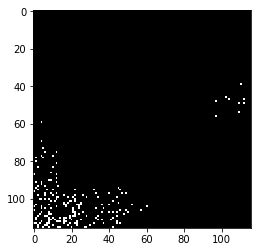

Label  0


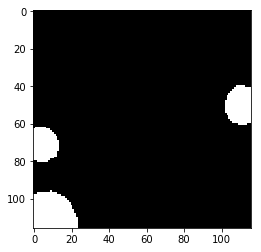

Prediction  1


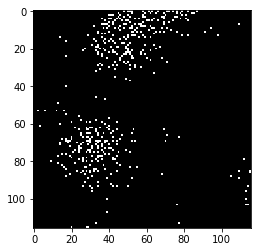

Label  1


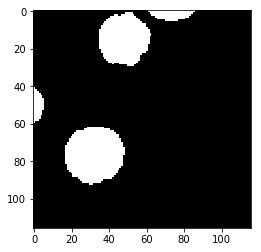

Prediction  2


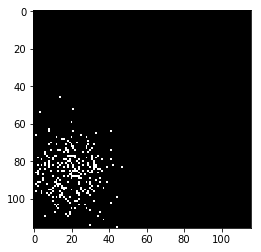

Label  2


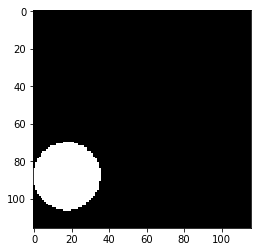

Prediction  3


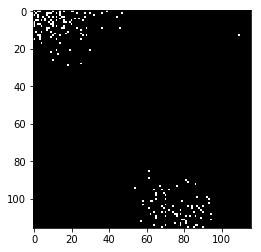

Label  3


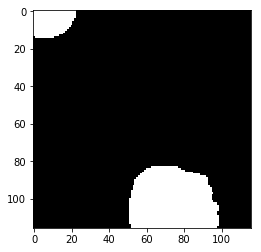

Prediction  4


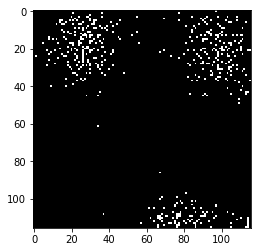

Label  4


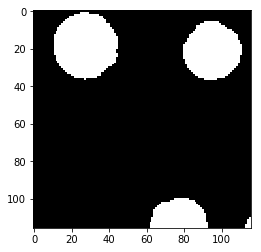

Prediction  5


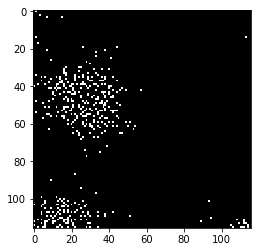

Label  5


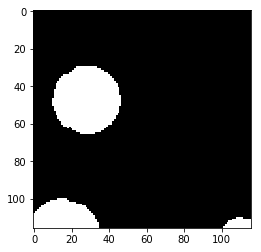

Prediction  6


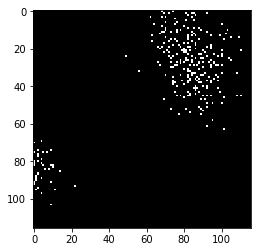

Label  6


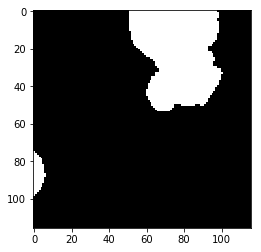

Prediction  7


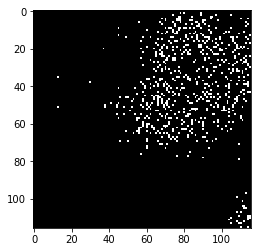

Label  7


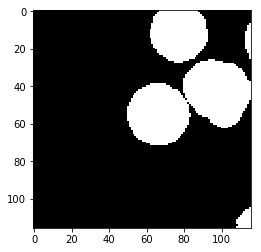

Prediction  8


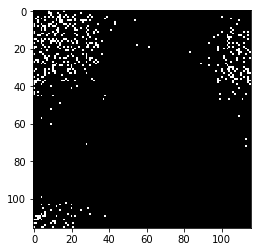

Label  8


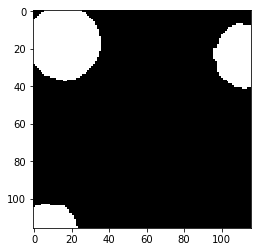

Prediction  9


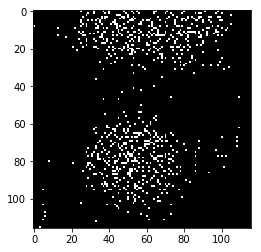

Label  9


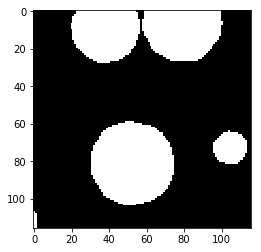

Prediction  10


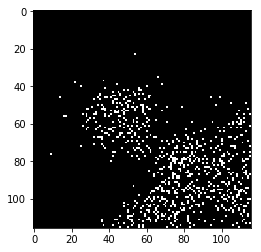

Label  10


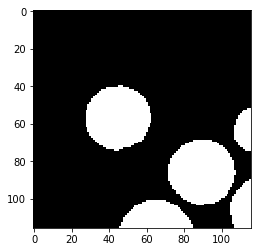

Prediction  11


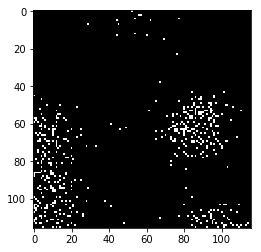

Label  11


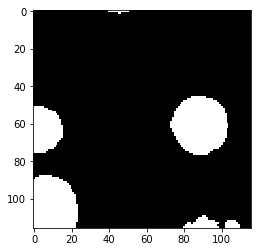

Prediction  12


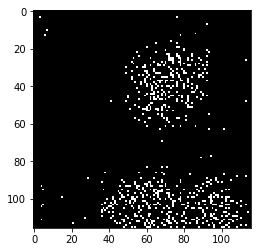

Label  12


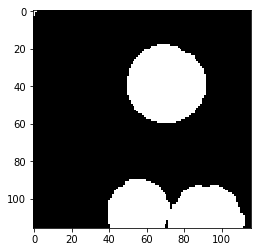

Prediction  13


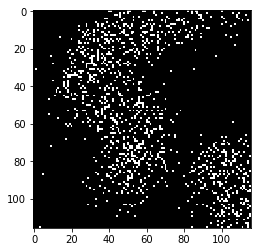

Label  13


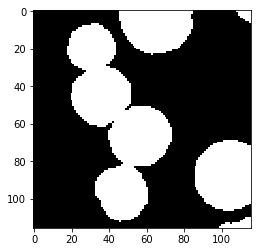

Prediction  14


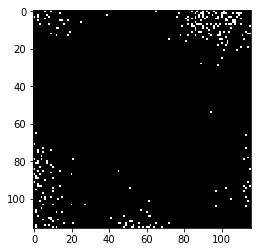

Label  14


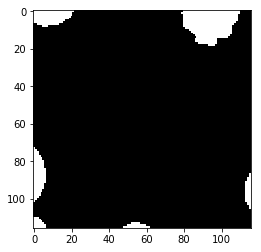

Prediction  15


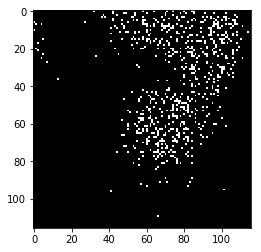

Label  15


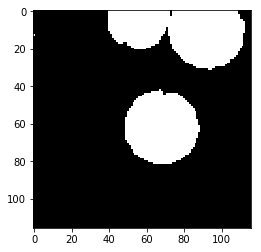

Prediction  16


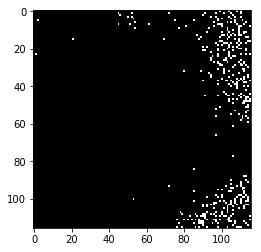

Label  16


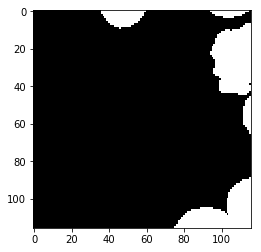

Prediction  17


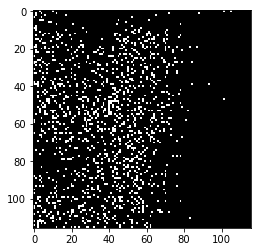

Label  17


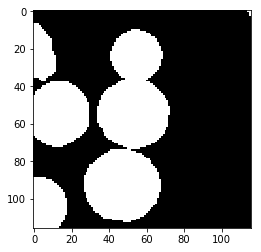

Prediction  18


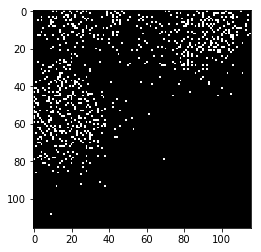

Label  18


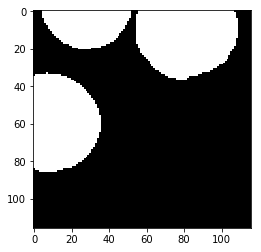

Prediction  19


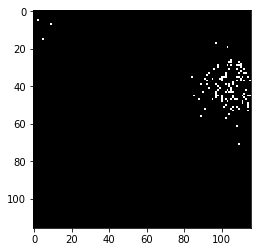

Label  19


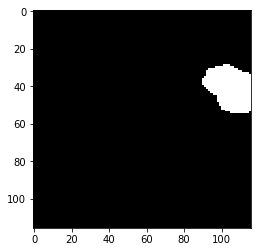

Prediction  20


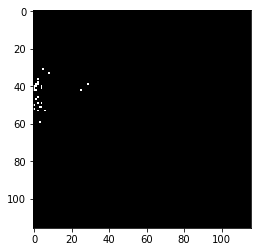

Label  20


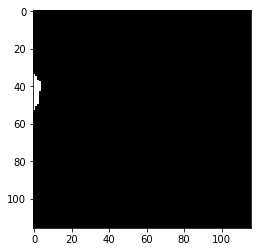

Prediction  21


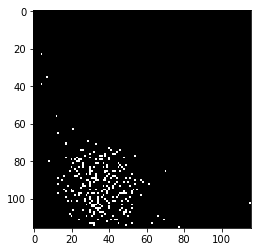

Label  21


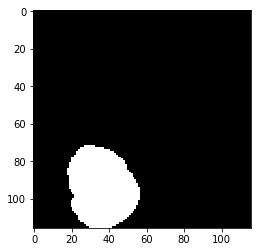

Prediction  22


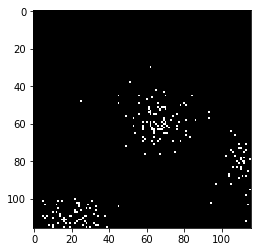

Label  22


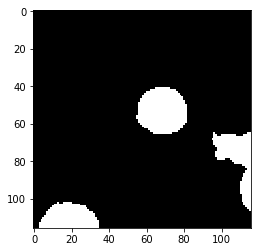

Prediction  23


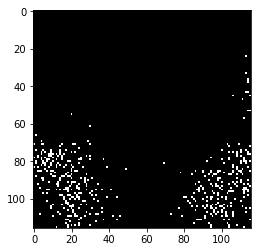

Label  23


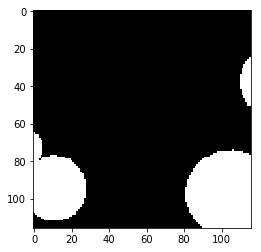

Prediction  24


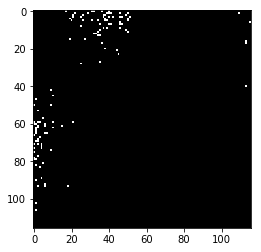

Label  24


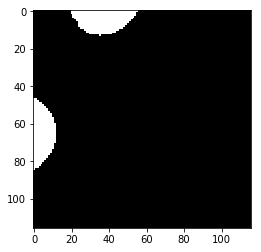

Prediction  25


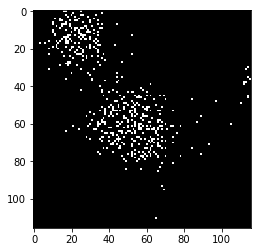

Label  25


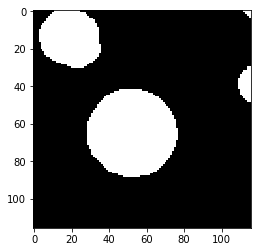

Prediction  26


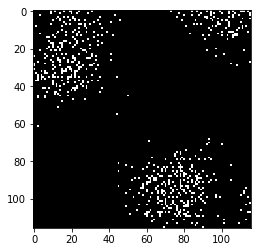

Label  26


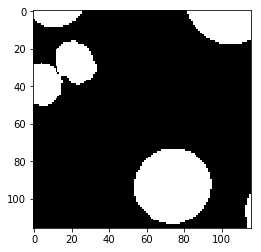

test_accuracy 0.763010672802
Batch: 1000 Train Loss value:0.0625185 Train Accuracy 0.961230141379
Prediction  0


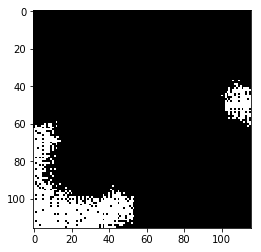

Label  0


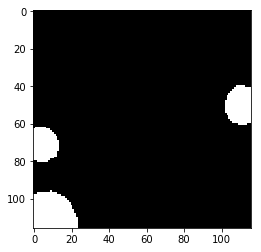

Prediction  1


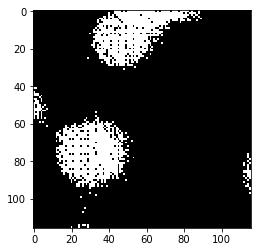

Label  1


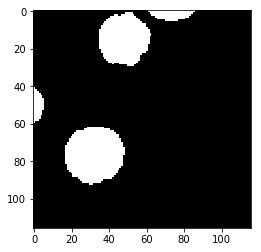

Prediction  2


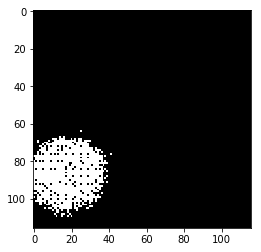

Label  2


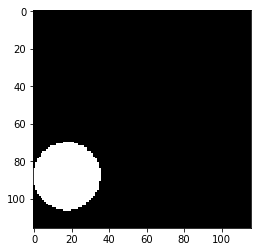

Prediction  3


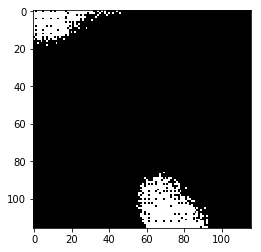

Label  3


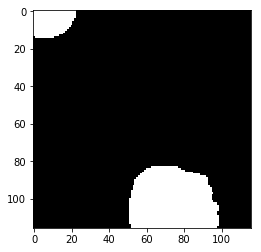

Prediction  4


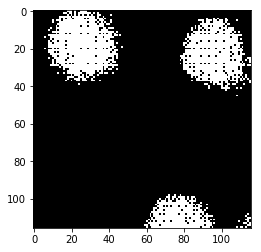

Label  4


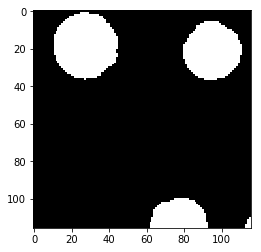

Prediction  5


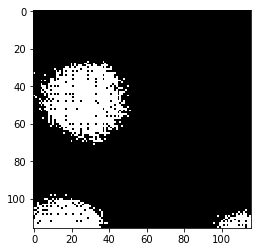

Label  5


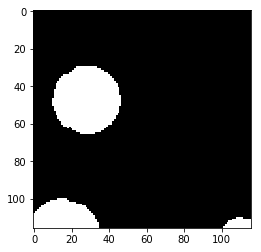

Prediction  6


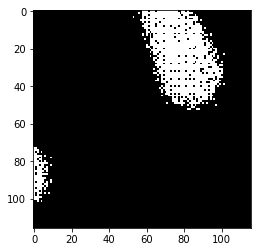

Label  6


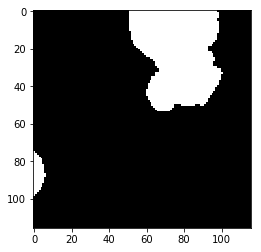

Prediction  7


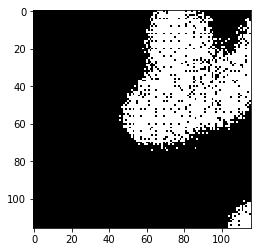

Label  7


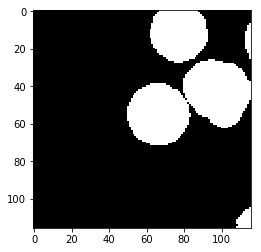

Prediction  8


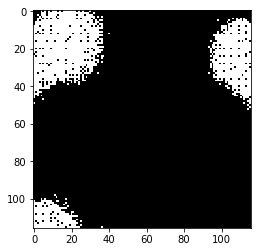

Label  8


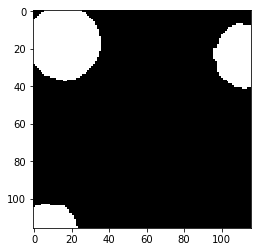

Prediction  9


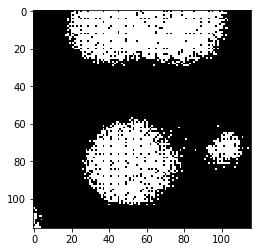

Label  9


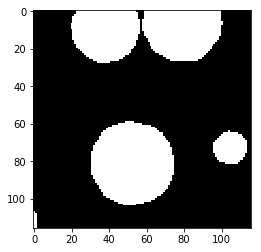

Prediction  10


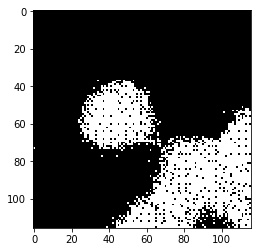

Label  10


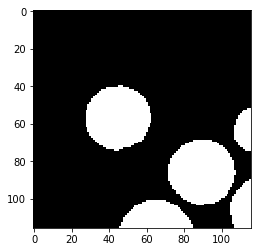

Prediction  11


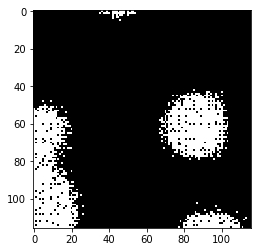

Label  11


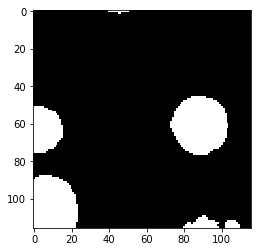

Prediction  12


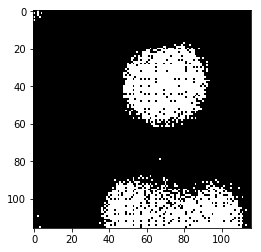

Label  12


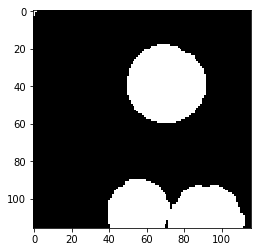

Prediction  13


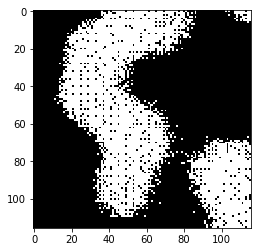

Label  13


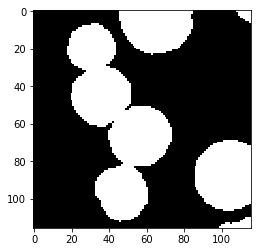

Prediction  14


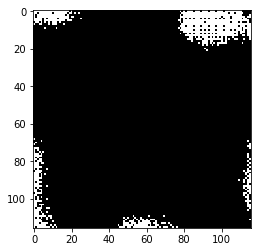

Label  14


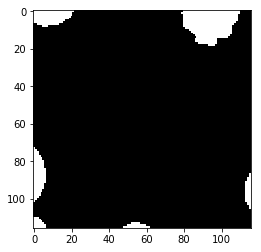

Prediction  15


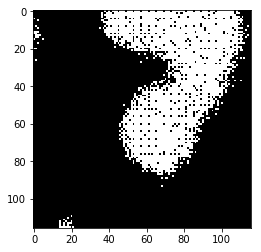

Label  15


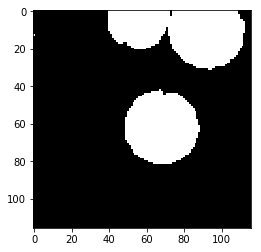

Prediction  16


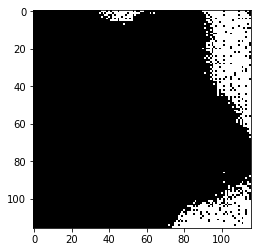

Label  16


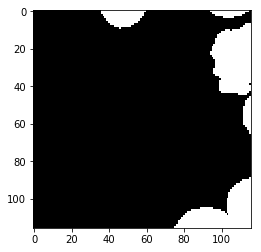

Prediction  17


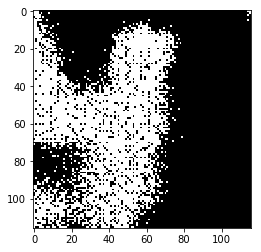

Label  17


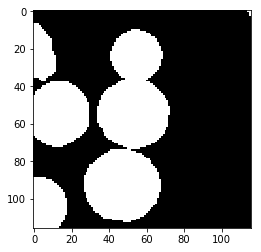

Prediction  18


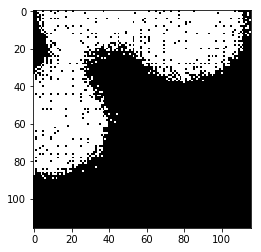

Label  18


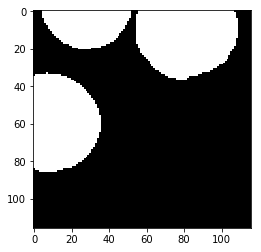

Prediction  19


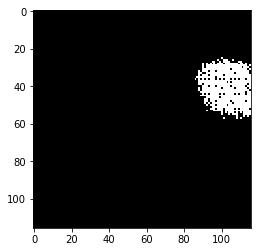

Label  19


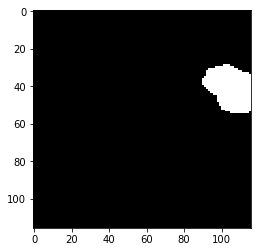

Prediction  20


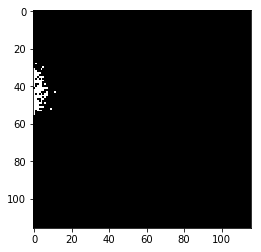

Label  20


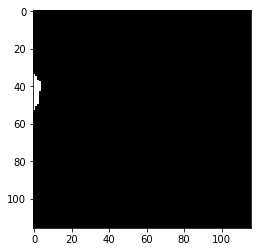

Prediction  21


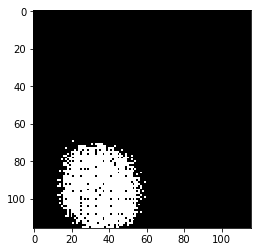

Label  21


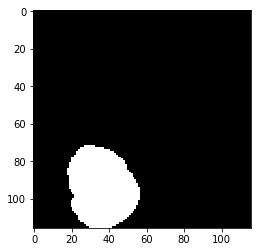

Prediction  22


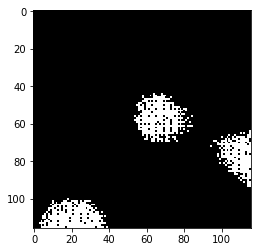

Label  22


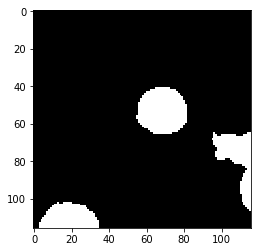

Prediction  23


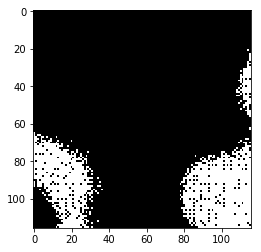

Label  23


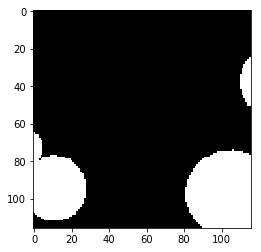

Prediction  24


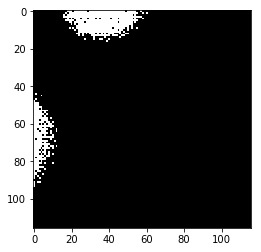

Label  24


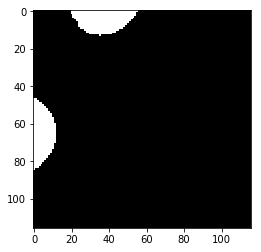

Prediction  25


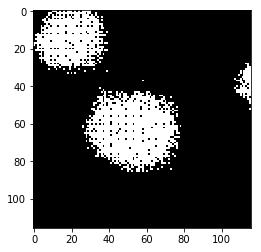

Label  25


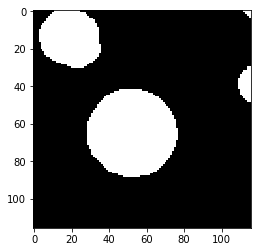

Prediction  26


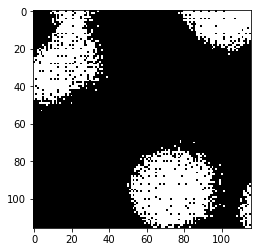

Label  26


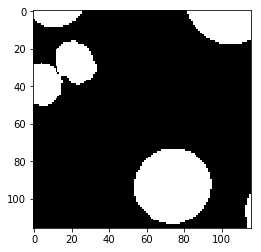

test_accuracy 0.887531890503
Batch: 1500 Train Loss value:0.0636396 Train Accuracy 0.947181824759
Prediction  0


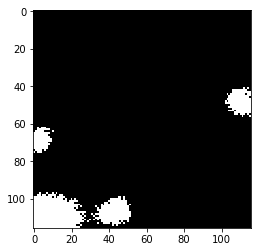

Label  0


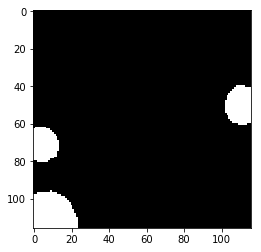

Prediction  1


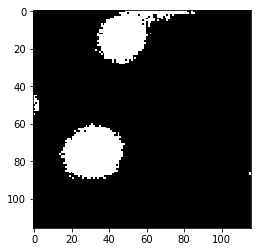

Label  1


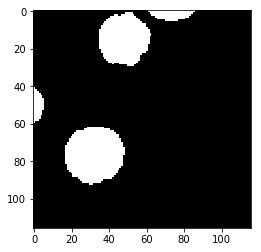

Prediction  2


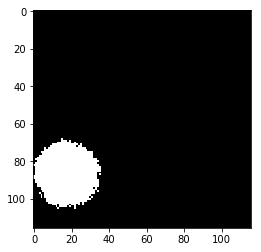

Label  2


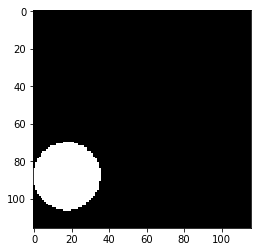

Prediction  3


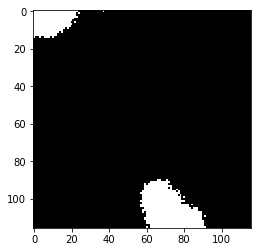

Label  3


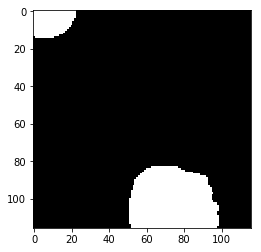

Prediction  4


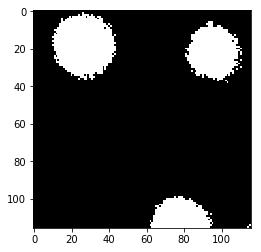

Label  4


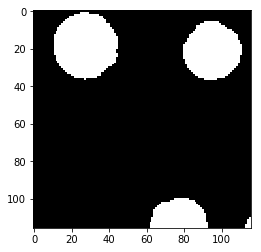

Prediction  5


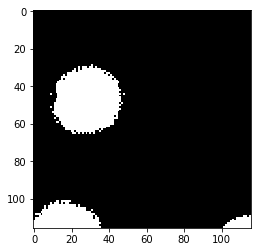

Label  5


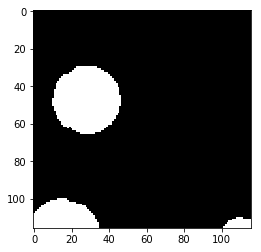

Prediction  6


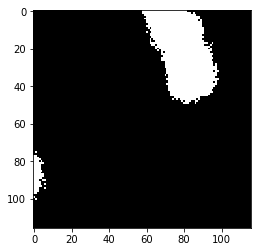

Label  6


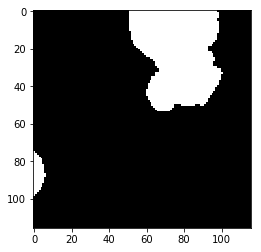

Prediction  7


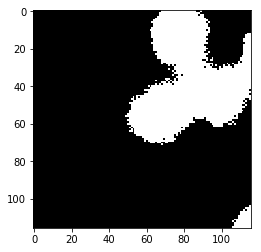

Label  7


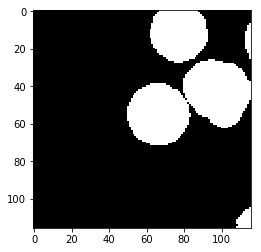

Prediction  8


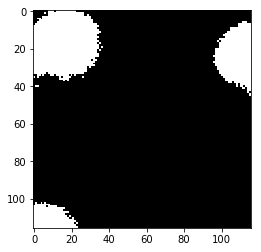

Label  8


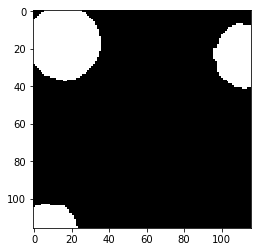

Prediction  9


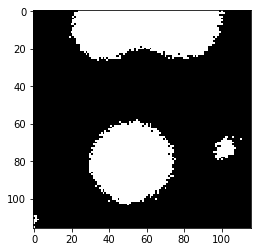

Label  9


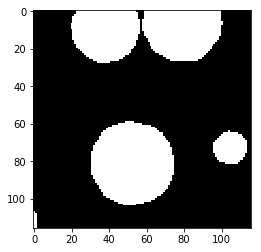

Prediction  10


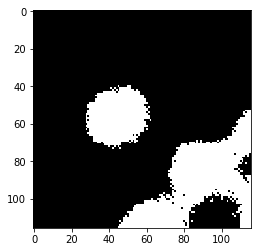

Label  10


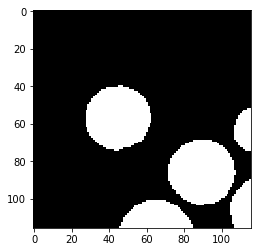

Prediction  11


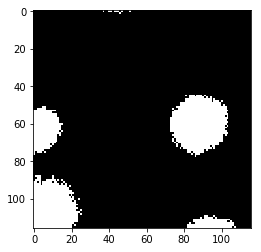

Label  11


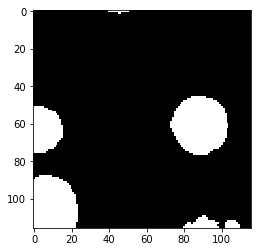

Prediction  12


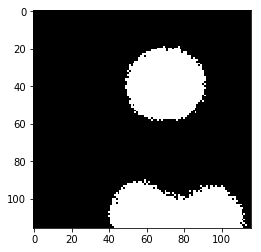

Label  12


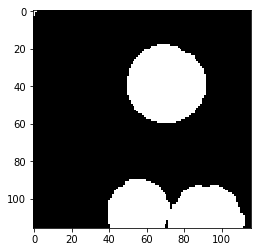

Prediction  13


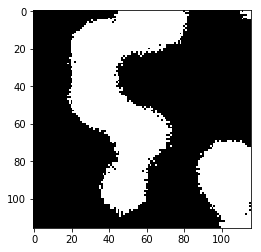

Label  13


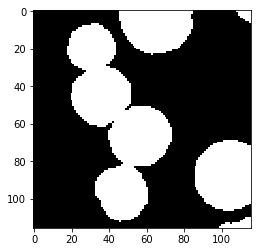

Prediction  14


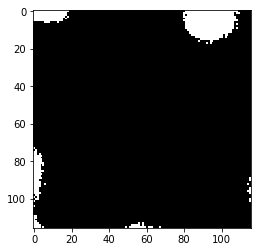

Label  14


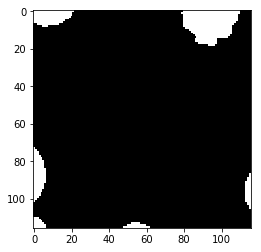

Prediction  15


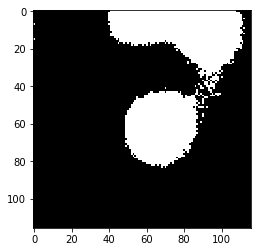

Label  15


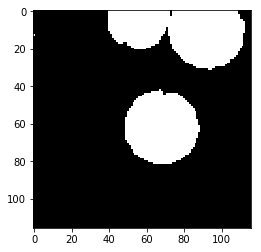

Prediction  16


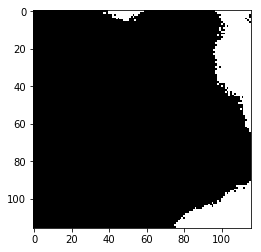

Label  16


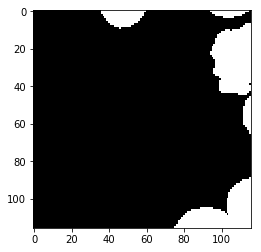

Prediction  17


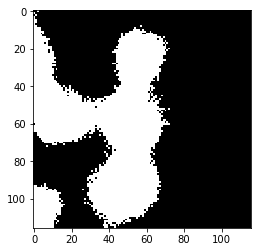

Label  17


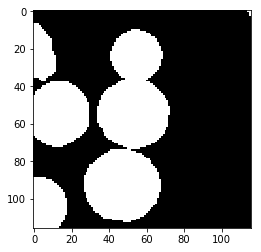

Prediction  18


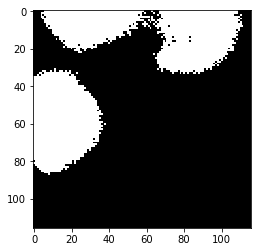

Label  18


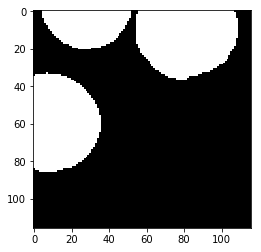

Prediction  19


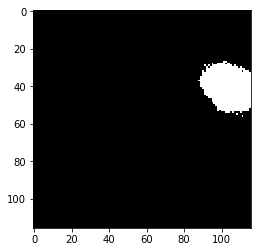

Label  19


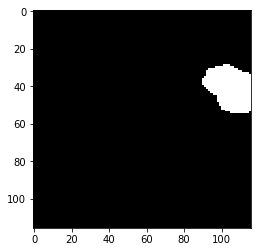

Prediction  20


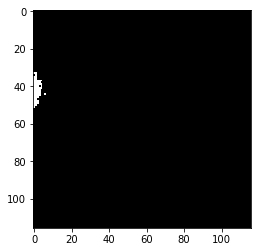

Label  20


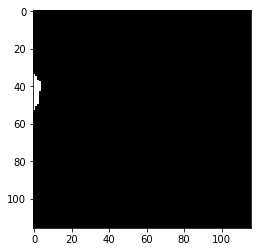

Prediction  21


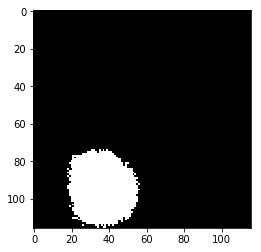

Label  21


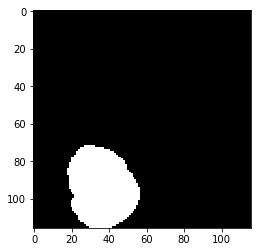

Prediction  22


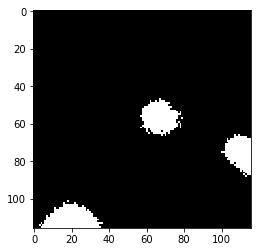

Label  22


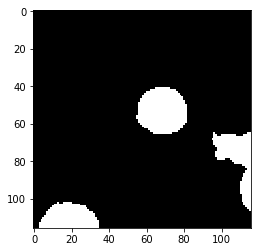

Prediction  23


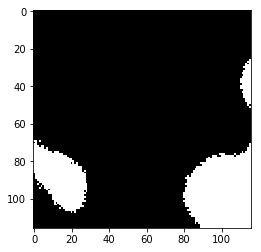

Label  23


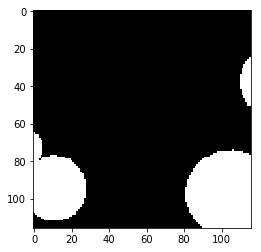

Prediction  24


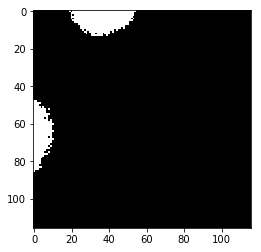

Label  24


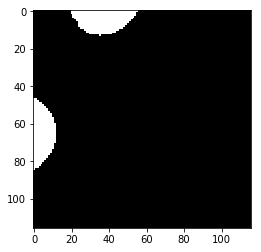

Prediction  25


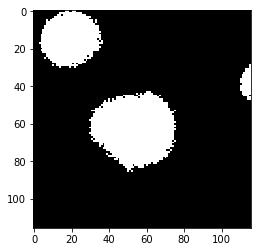

Label  25


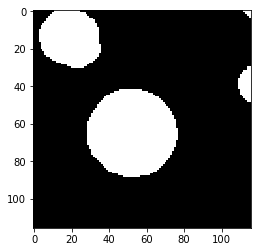

Prediction  26


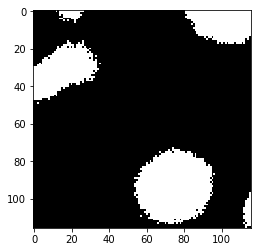

Label  26


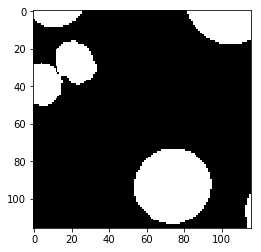

test_accuracy 0.940251319242
Batch: 2000 Train Loss value:0.113958 Train Accuracy 0.909329549486
Prediction  0


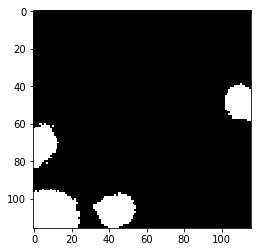

Label  0


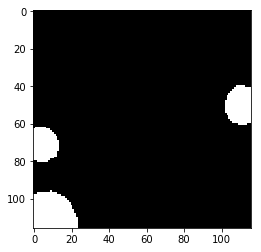

Prediction  1


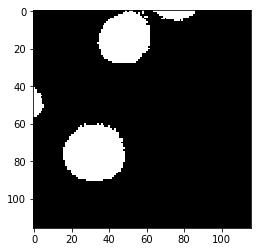

Label  1


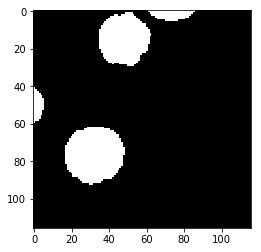

Prediction  2


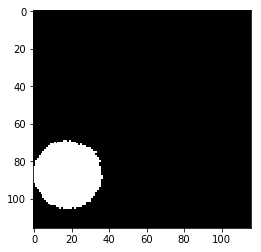

Label  2


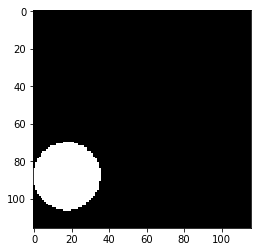

Prediction  3


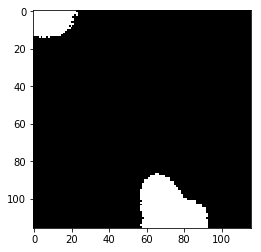

Label  3


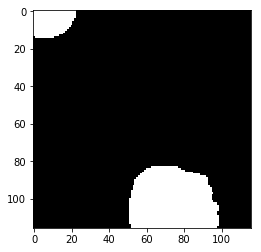

Prediction  4


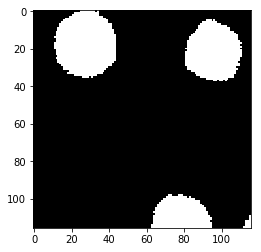

Label  4


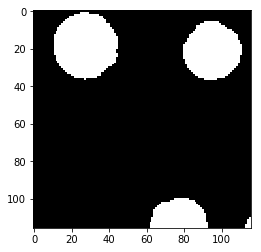

Prediction  5


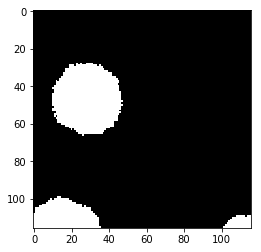

Label  5


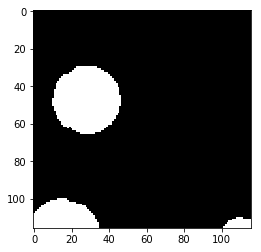

Prediction  6


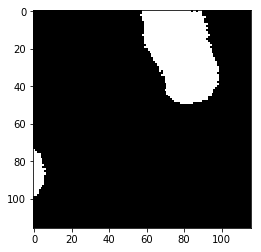

Label  6


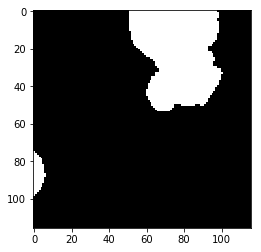

Prediction  7


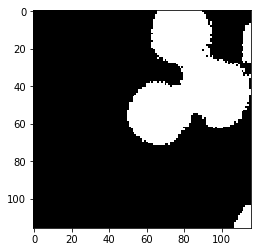

Label  7


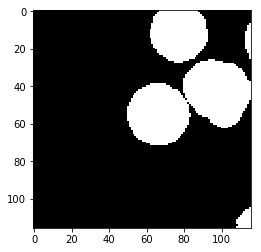

Prediction  8


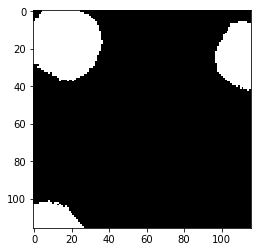

Label  8


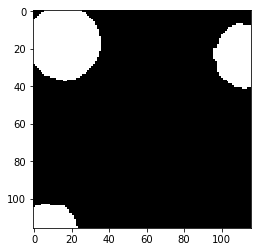

Prediction  9


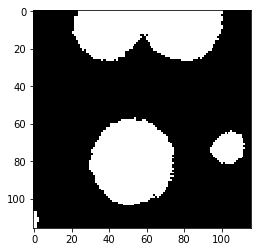

Label  9


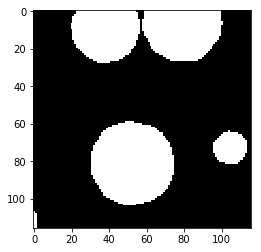

Prediction  10


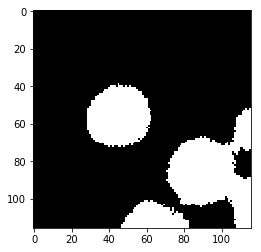

Label  10


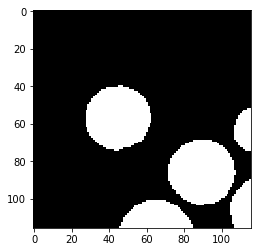

Prediction  11


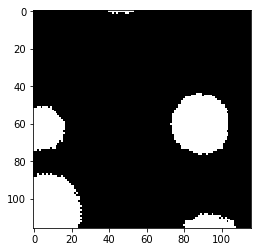

Label  11


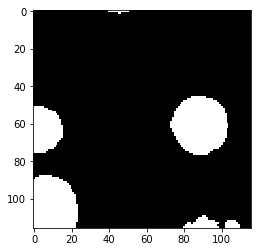

Prediction  12


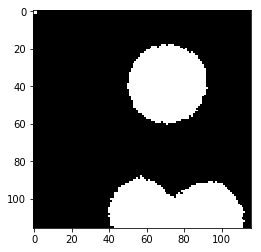

Label  12


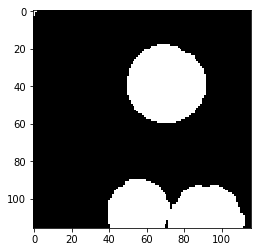

Prediction  13


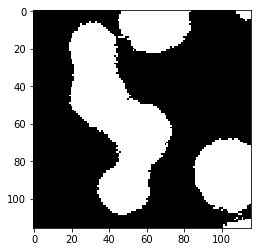

Label  13


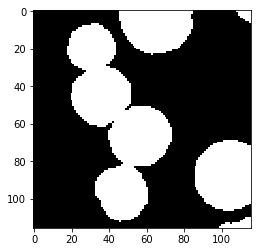

Prediction  14


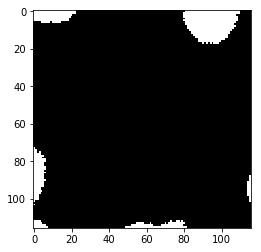

Label  14


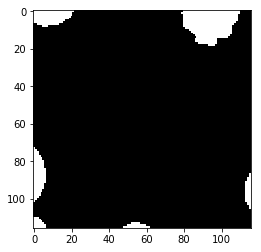

Prediction  15


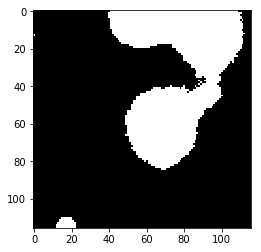

Label  15


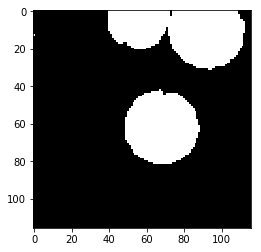

Prediction  16


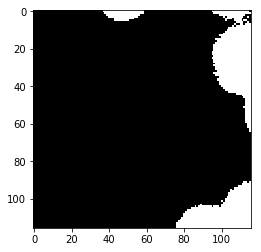

Label  16


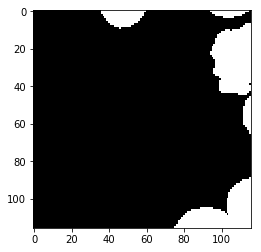

Prediction  17


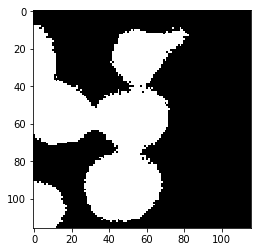

Label  17


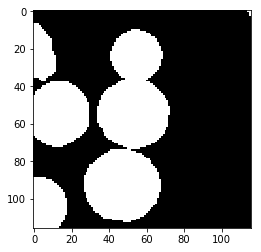

Prediction  18


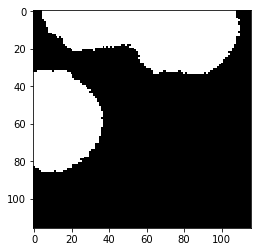

Label  18


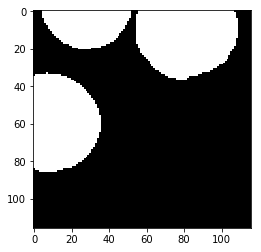

Prediction  19


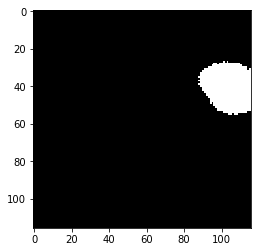

Label  19


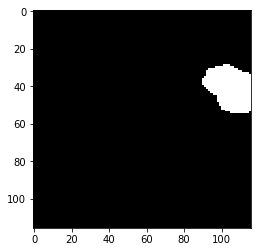

Prediction  20


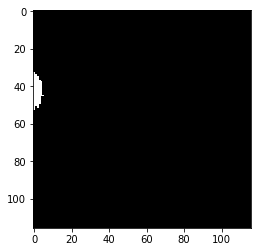

Label  20


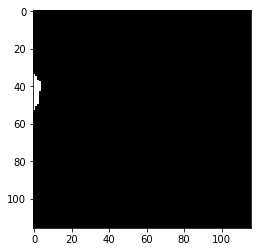

Prediction  21


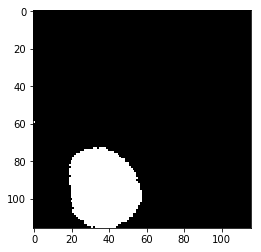

Label  21


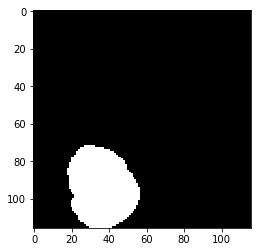

Prediction  22


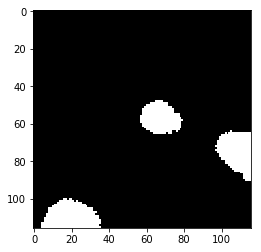

Label  22


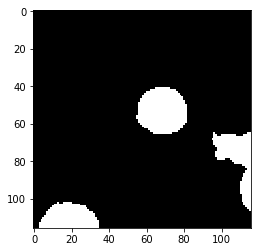

Prediction  23


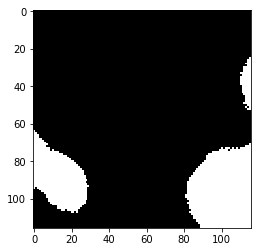

Label  23


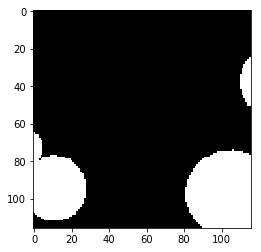

Prediction  24


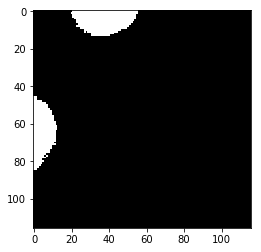

Label  24


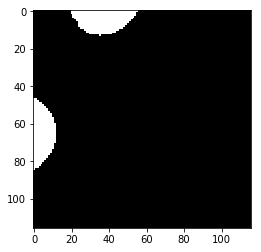

Prediction  25


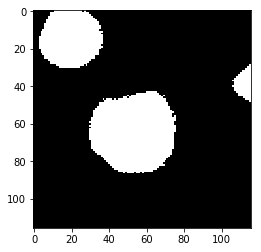

Label  25


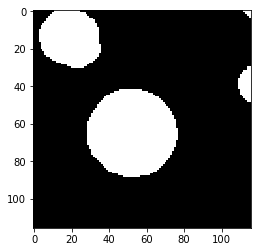

Prediction  26


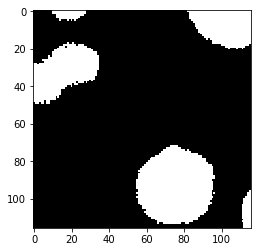

Label  26


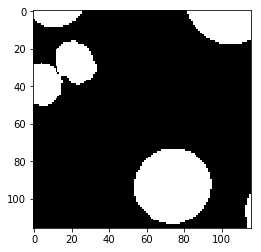

test_accuracy 0.955254673234
Batch: 2500 Train Loss value:0.14099 Train Accuracy 0.918585584943
Prediction  0


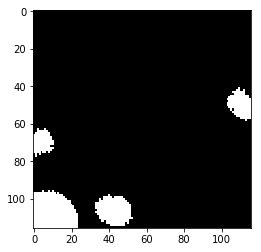

Label  0


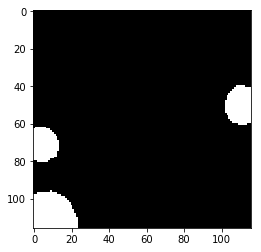

Prediction  1


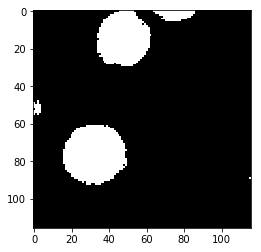

Label  1


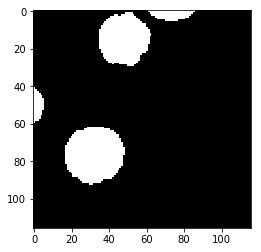

Prediction  2


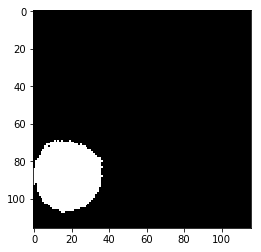

Label  2


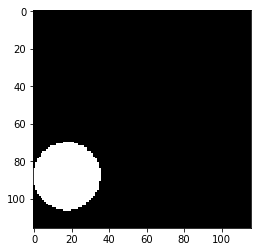

Prediction  3


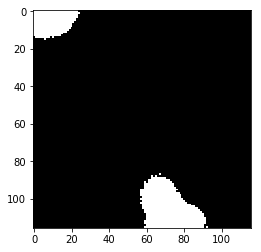

Label  3


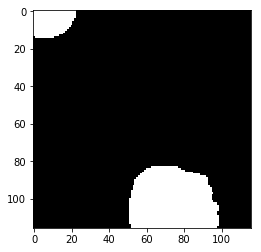

Prediction  4


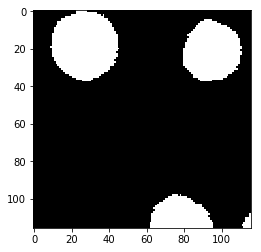

Label  4


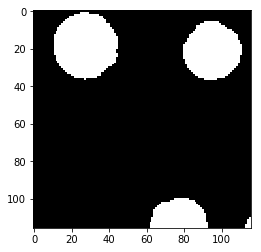

Prediction  5


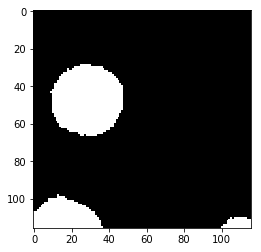

Label  5


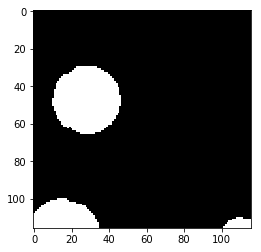

Prediction  6


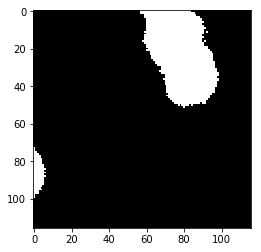

Label  6


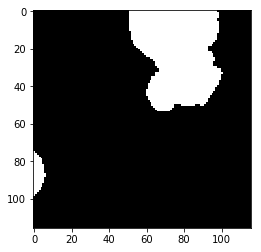

Prediction  7


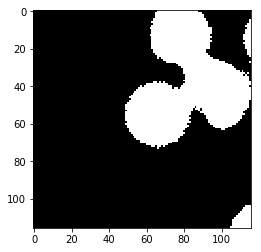

Label  7


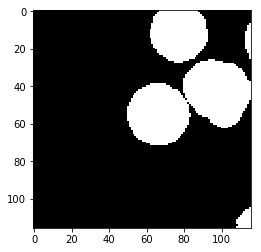

Prediction  8


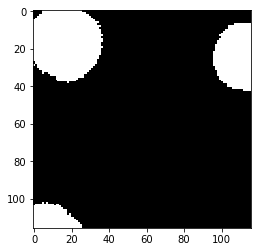

Label  8


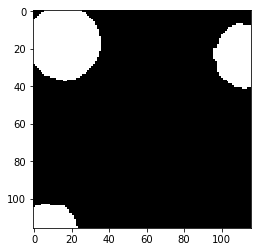

Prediction  9


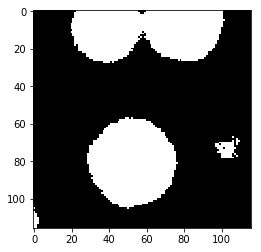

Label  9


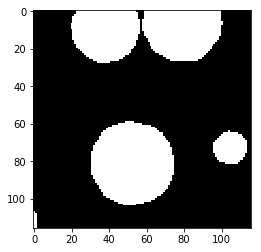

Prediction  10


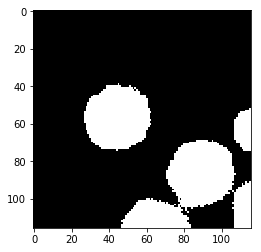

Label  10


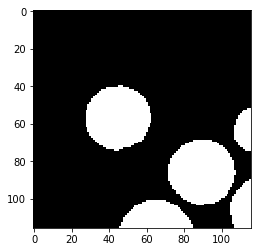

Prediction  11


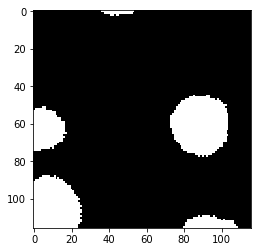

Label  11


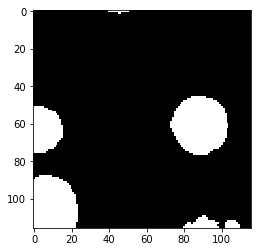

Prediction  12


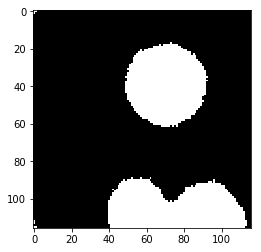

Label  12


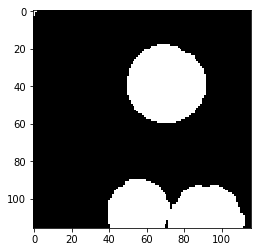

Prediction  13


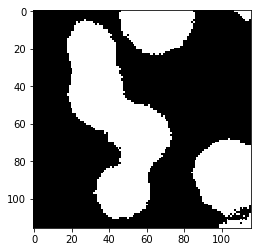

Label  13


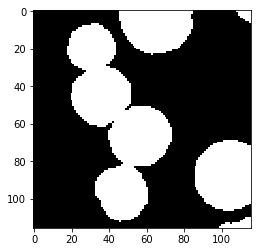

Prediction  14


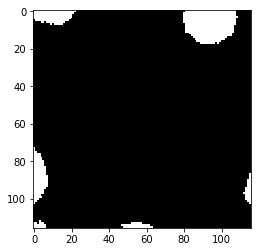

Label  14


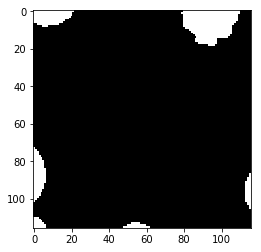

Prediction  15


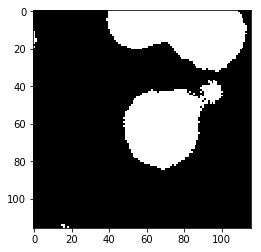

Label  15


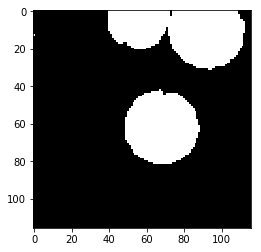

Prediction  16


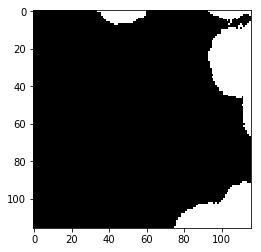

Label  16


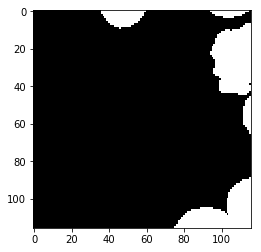

Prediction  17


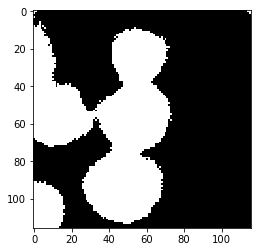

Label  17


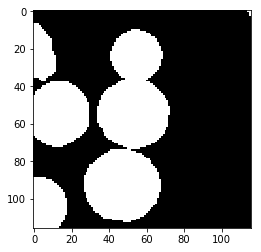

Prediction  18


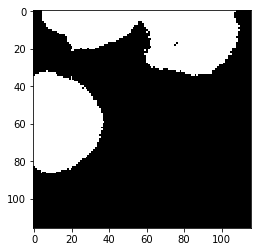

Label  18


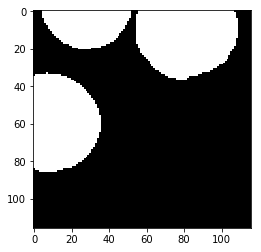

Prediction  19


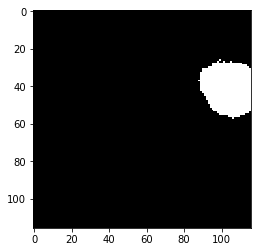

Label  19


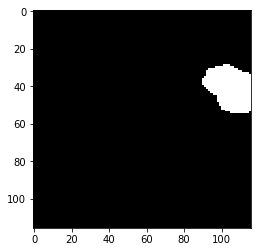

Prediction  20


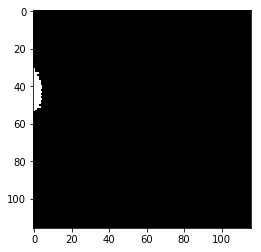

Label  20


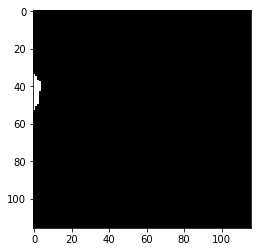

Prediction  21


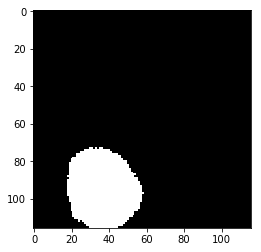

Label  21


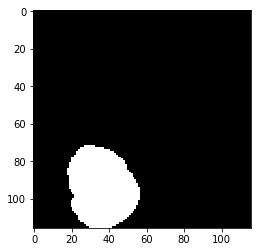

Prediction  22


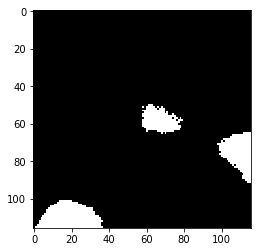

Label  22


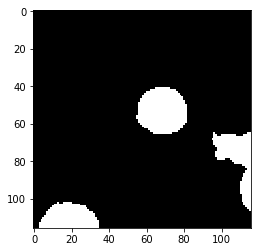

Prediction  23


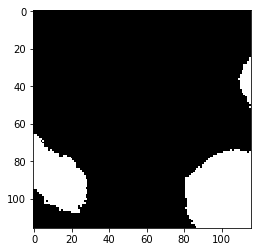

Label  23


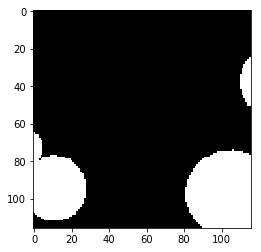

Prediction  24


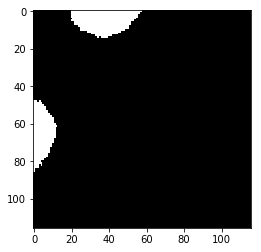

Label  24


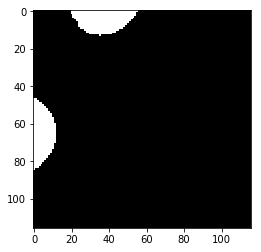

Prediction  25


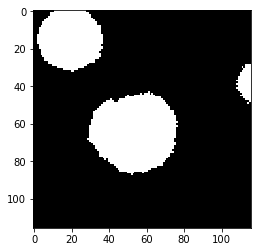

Label  25


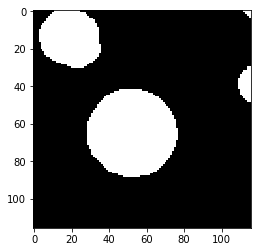

Prediction  26


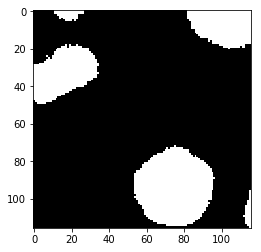

Label  26


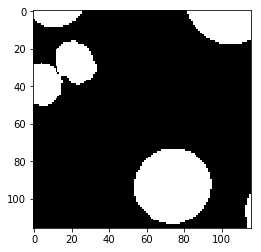

test_accuracy 0.955712379088
Batch: 3000 Train Loss value:0.0380827 Train Accuracy 0.965096750639
Prediction  0


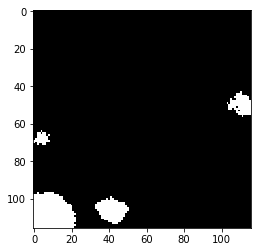

Label  0


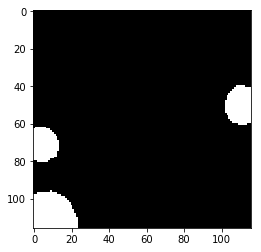

Prediction  1


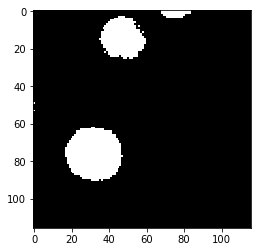

Label  1


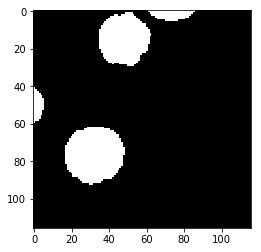

Prediction  2


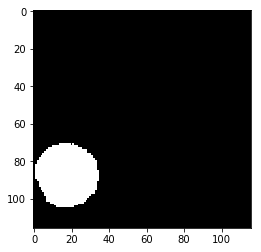

Label  2


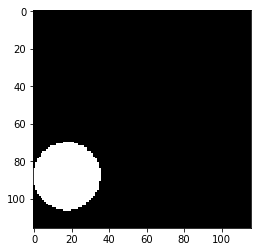

Prediction  3


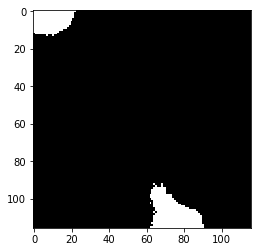

Label  3


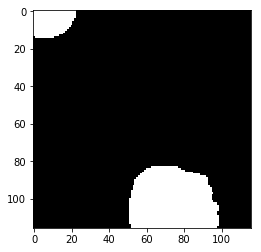

Prediction  4


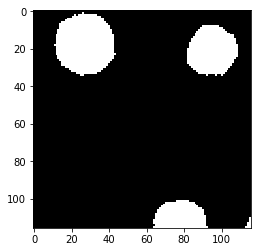

Label  4


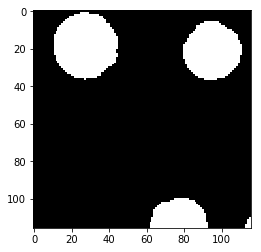

Prediction  5


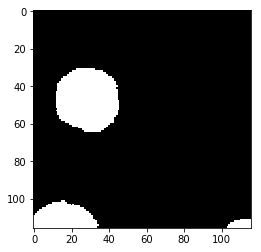

Label  5


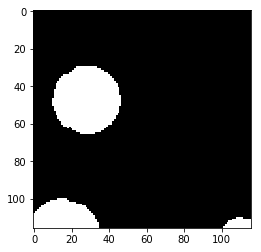

Prediction  6


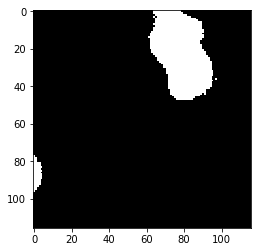

Label  6


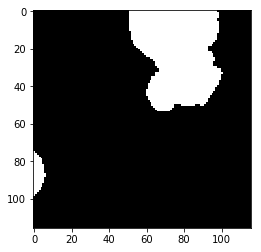

Prediction  7


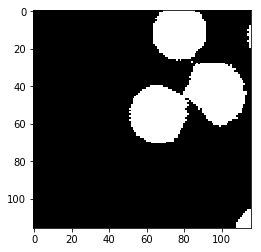

Label  7


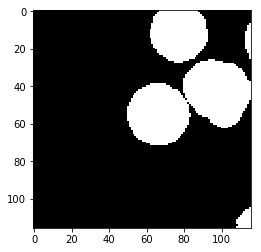

Prediction  8


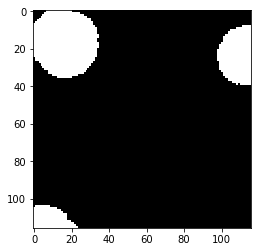

Label  8


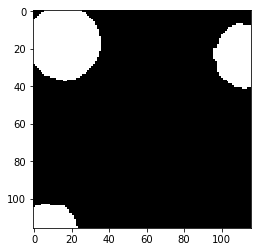

Prediction  9


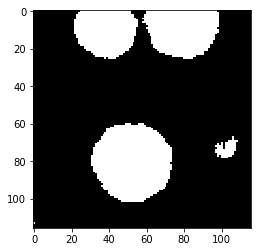

Label  9


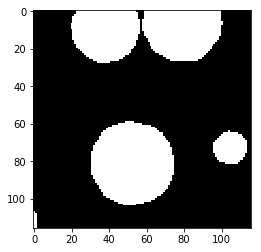

Prediction  10


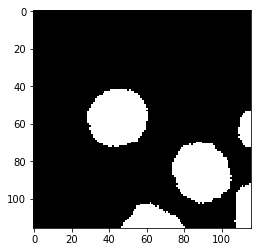

Label  10


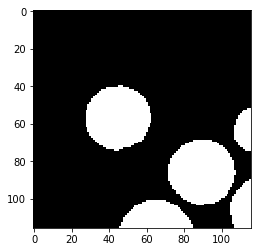

Prediction  11


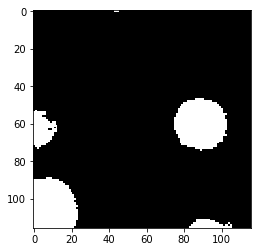

Label  11


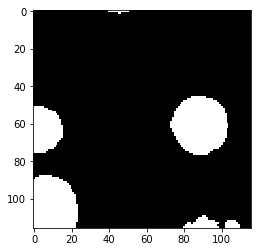

Prediction  12


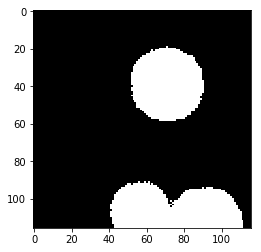

Label  12


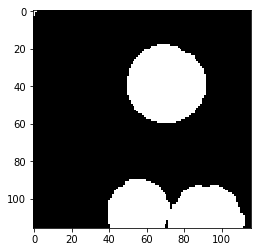

Prediction  13


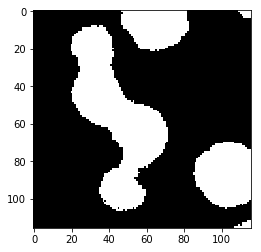

Label  13


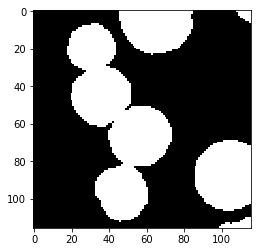

Prediction  14


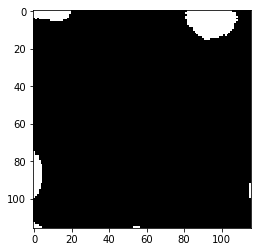

Label  14


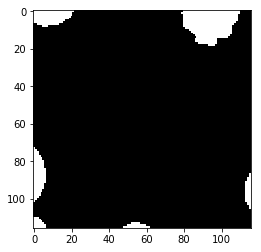

Prediction  15


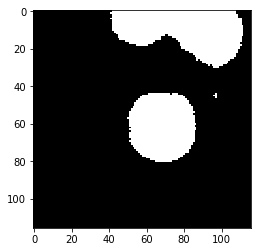

Label  15


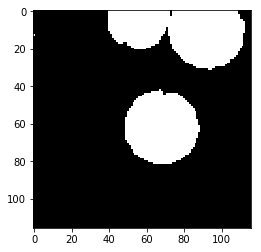

Prediction  16


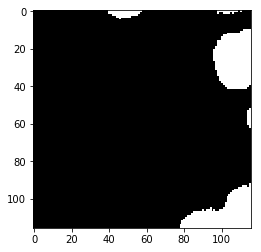

Label  16


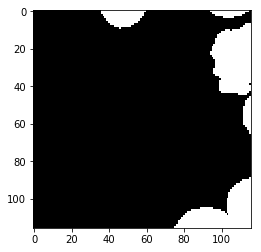

Prediction  17


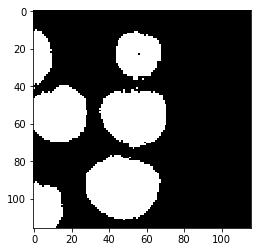

Label  17


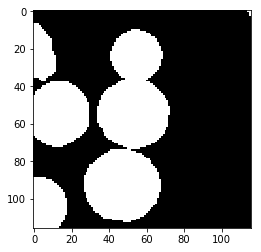

Prediction  18


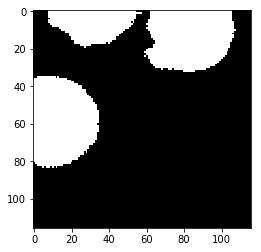

Label  18


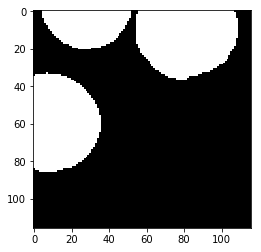

Prediction  19


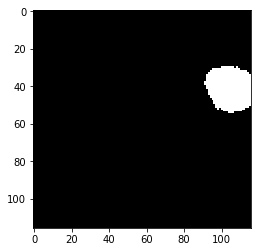

Label  19


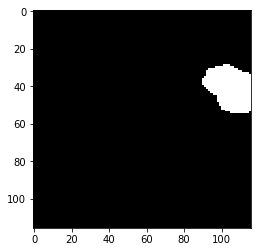

Prediction  20


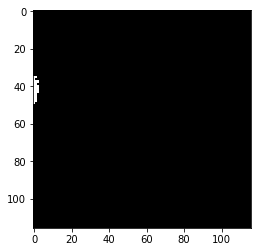

Label  20


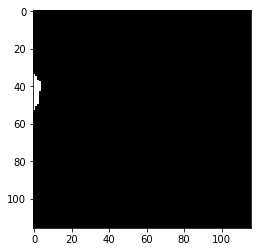

Prediction  21


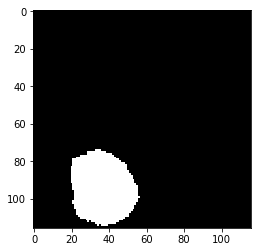

Label  21


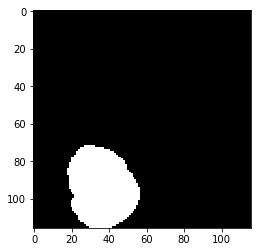

Prediction  22


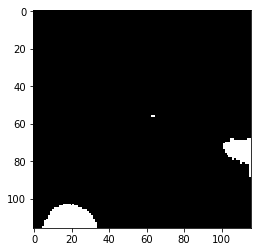

Label  22


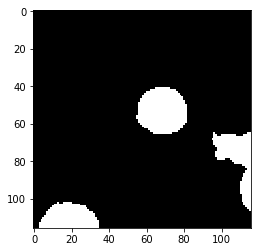

Prediction  23


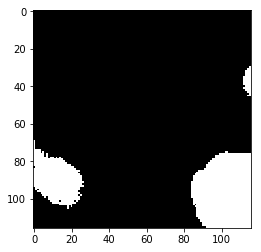

Label  23


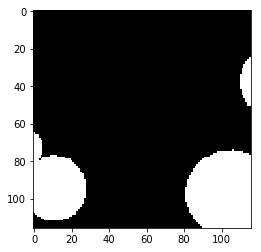

Prediction  24


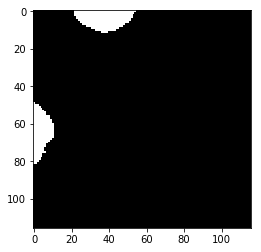

Label  24


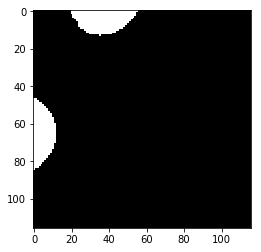

Prediction  25


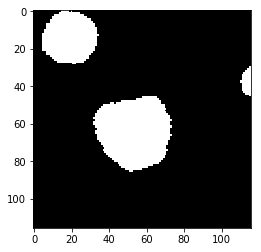

Label  25


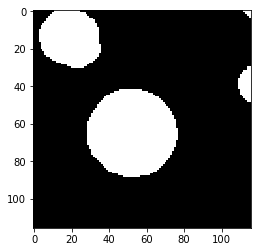

Prediction  26


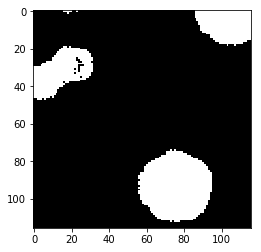

Label  26


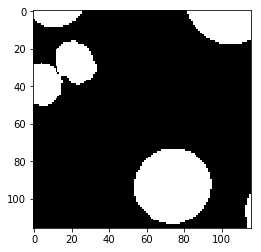

test_accuracy 0.934080816141
Batch: 3500 Train Loss value:0.00803139 Train Accuracy 0.995255041518
Prediction  0


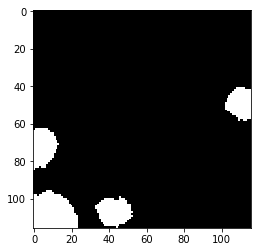

Label  0


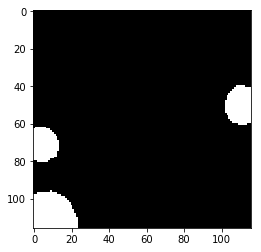

Prediction  1


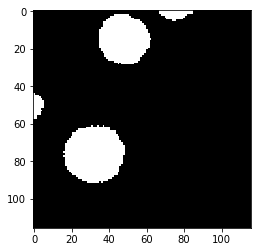

Label  1


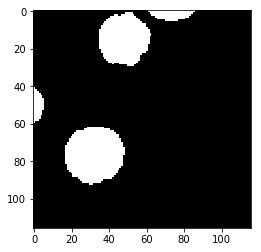

Prediction  2


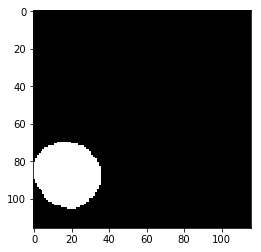

Label  2


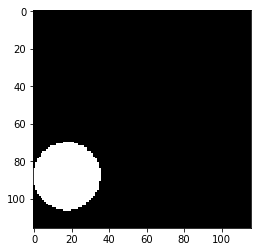

Prediction  3


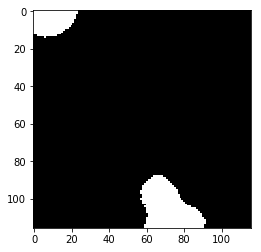

Label  3


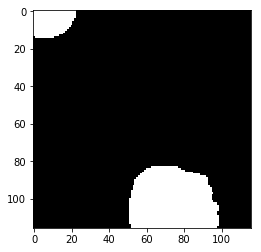

Prediction  4


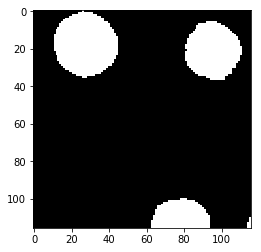

Label  4


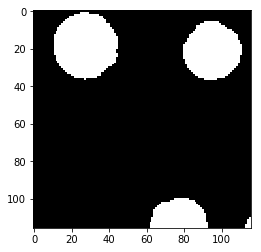

Prediction  5


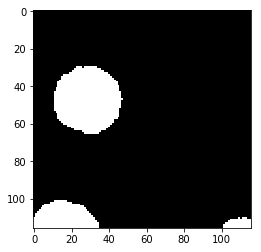

Label  5


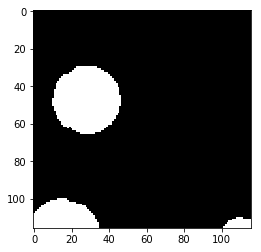

Prediction  6


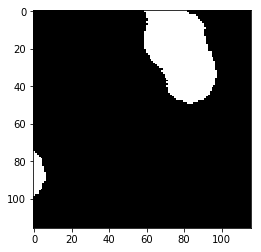

Label  6


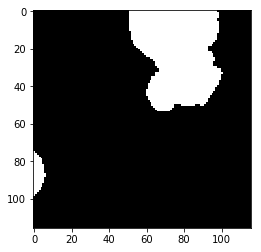

Prediction  7


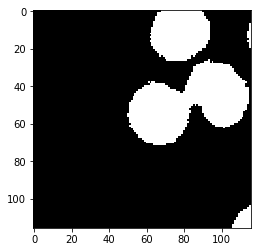

Label  7


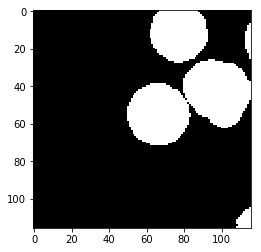

Prediction  8


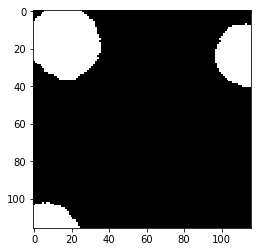

Label  8


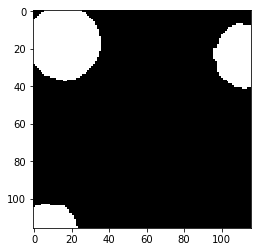

Prediction  9


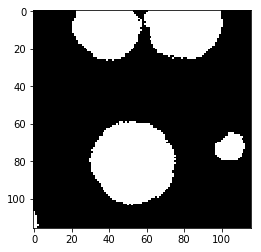

Label  9


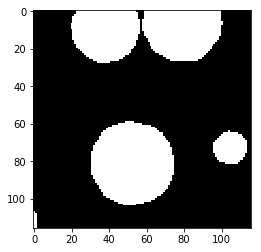

Prediction  10


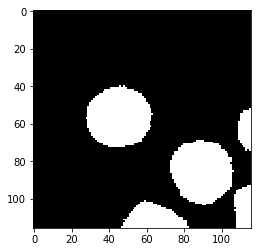

Label  10


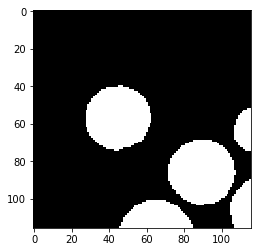

Prediction  11


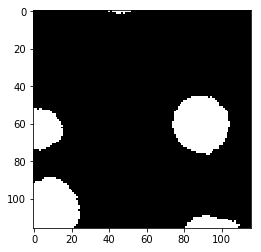

Label  11


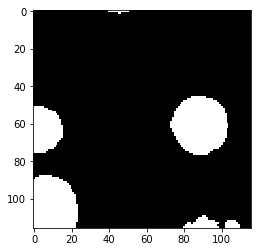

Prediction  12


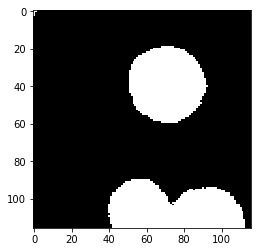

Label  12


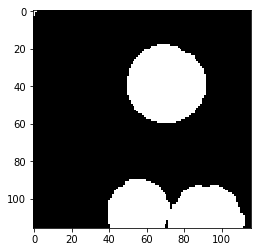

Prediction  13


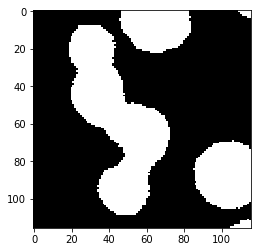

Label  13


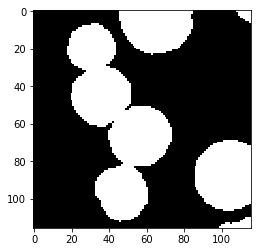

Prediction  14


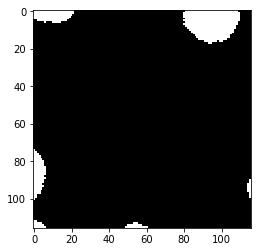

Label  14


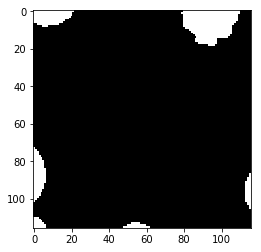

Prediction  15


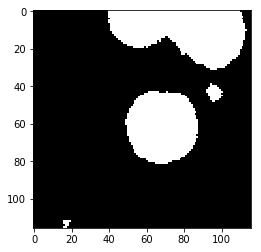

Label  15


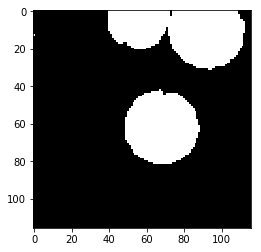

Prediction  16


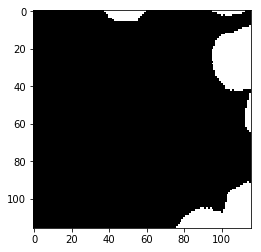

Label  16


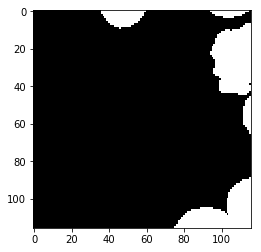

Prediction  17


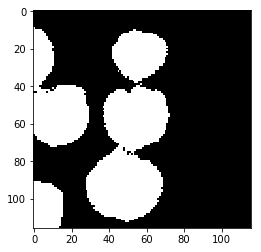

Label  17


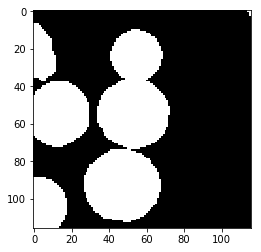

Prediction  18


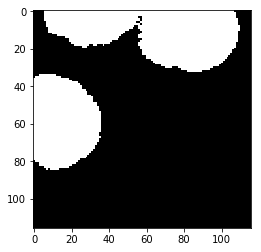

Label  18


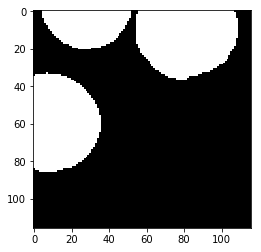

Prediction  19


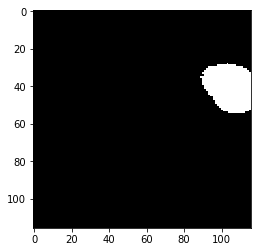

Label  19


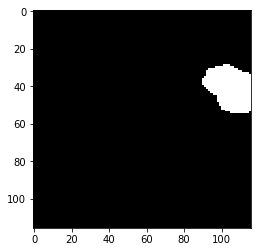

Prediction  20


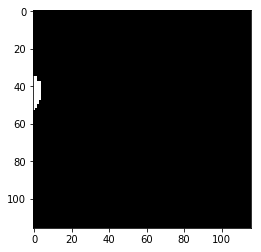

Label  20


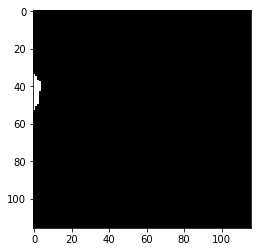

Prediction  21


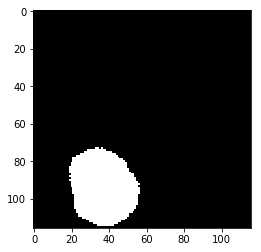

Label  21


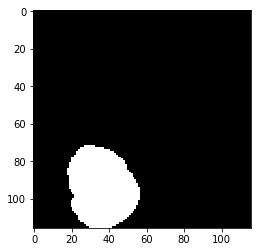

Prediction  22


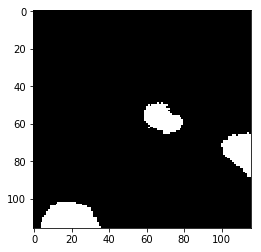

Label  22


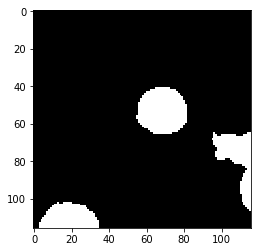

Prediction  23


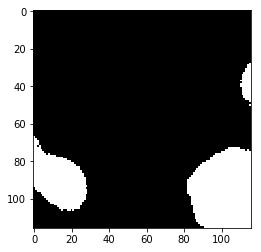

Label  23


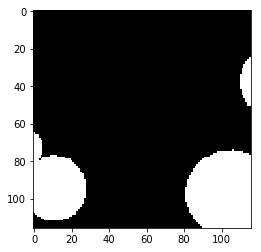

Prediction  24


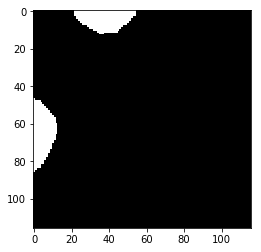

Label  24


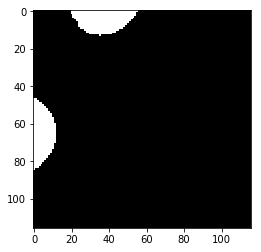

Prediction  25


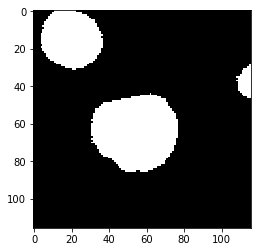

Label  25


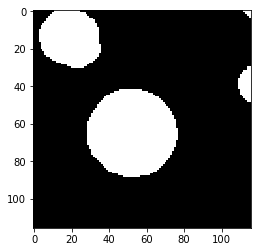

Prediction  26


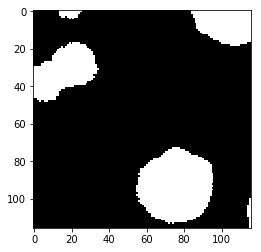

Label  26


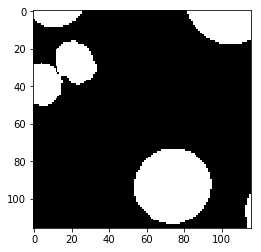

test_accuracy 0.959488945013
Batch: 4000 Train Loss value:0.150791 Train Accuracy 0.88419799762
Prediction  0


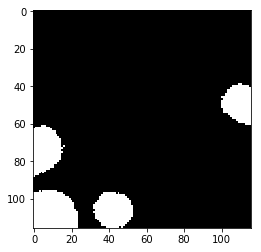

Label  0


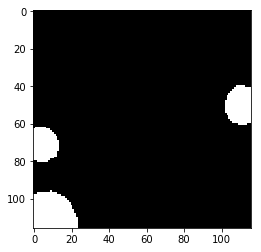

Prediction  1


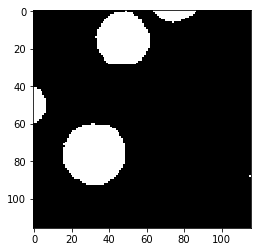

Label  1


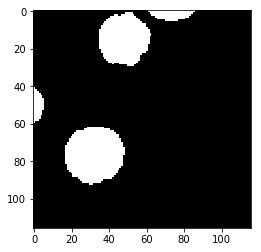

Prediction  2


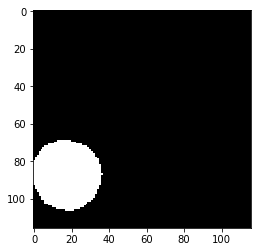

Label  2


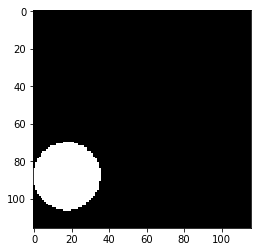

Prediction  3


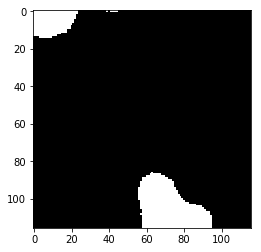

Label  3


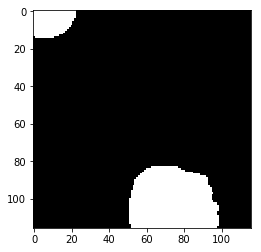

Prediction  4


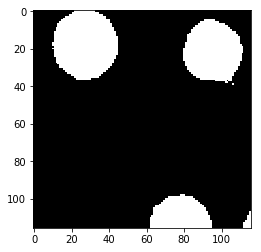

Label  4


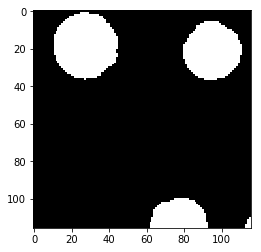

Prediction  5


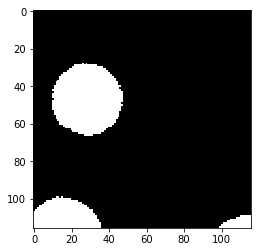

Label  5


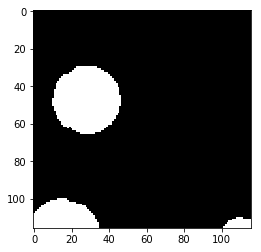

Prediction  6


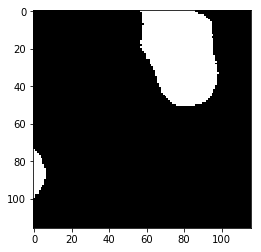

Label  6


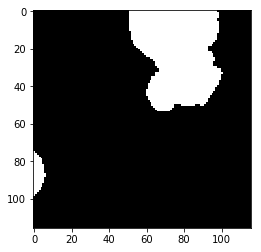

Prediction  7


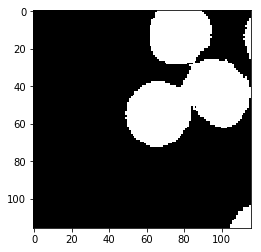

Label  7


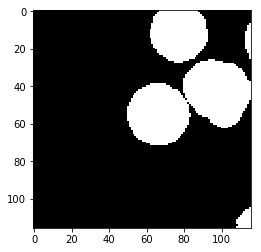

Prediction  8


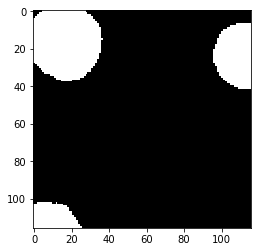

Label  8


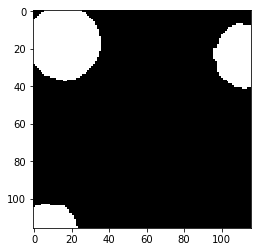

Prediction  9


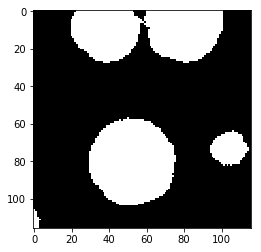

Label  9


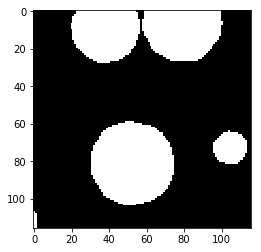

Prediction  10


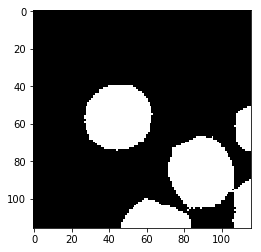

Label  10


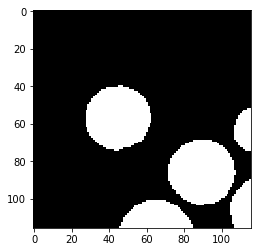

Prediction  11


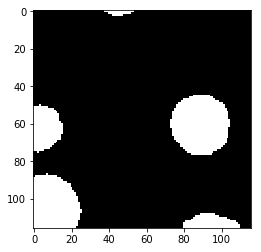

Label  11


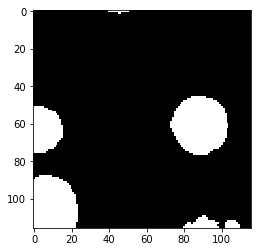

Prediction  12


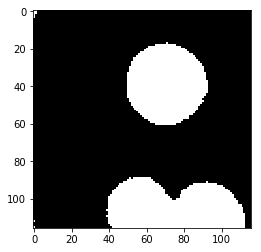

Label  12


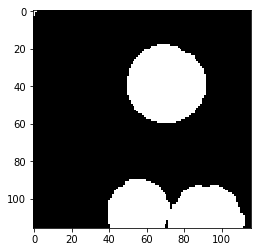

Prediction  13


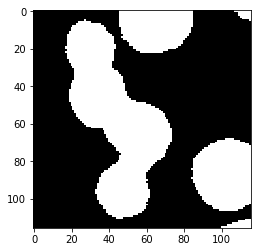

Label  13


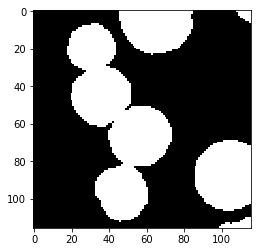

Prediction  14


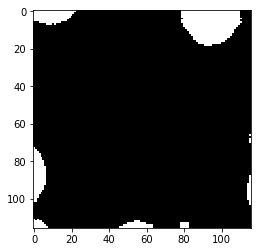

Label  14


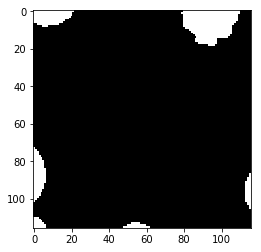

Prediction  15


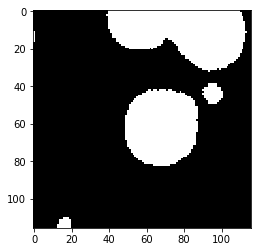

Label  15


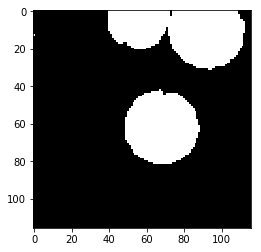

Prediction  16


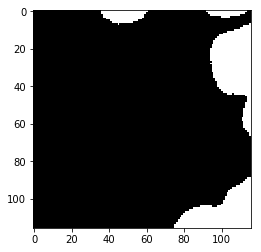

Label  16


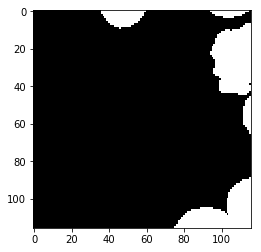

Prediction  17


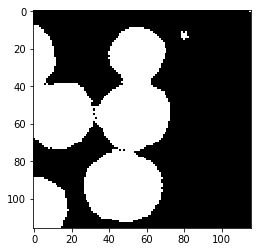

Label  17


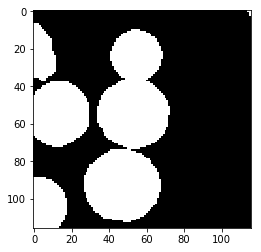

Prediction  18


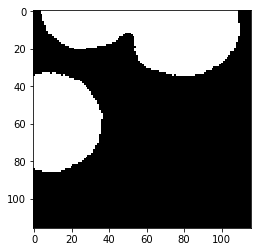

Label  18


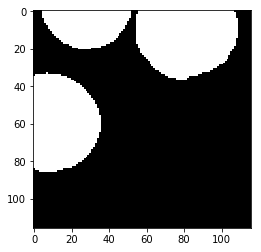

Prediction  19


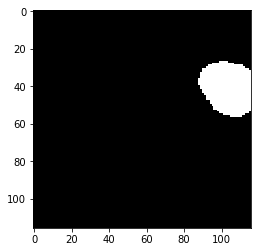

Label  19


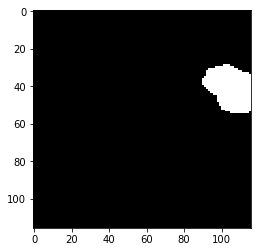

Prediction  20


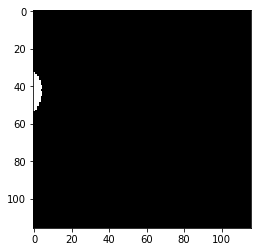

Label  20


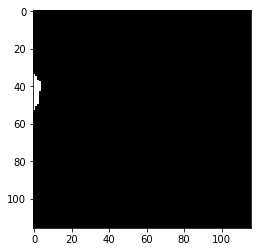

Prediction  21


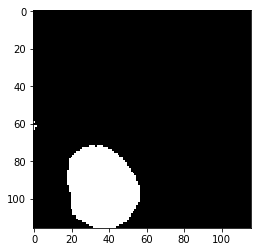

Label  21


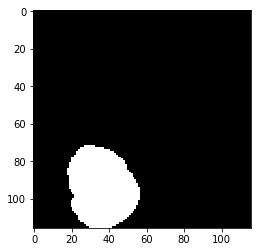

Prediction  22


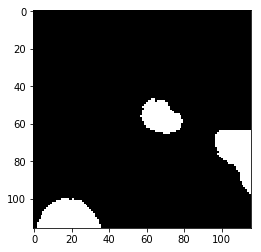

Label  22


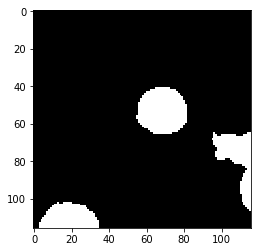

Prediction  23


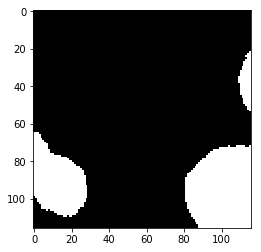

Label  23


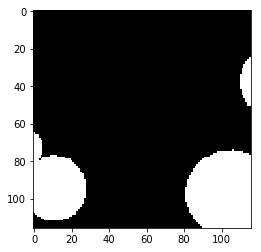

Prediction  24


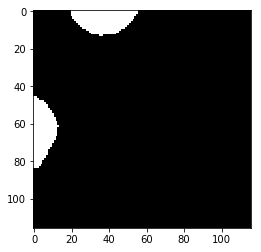

Label  24


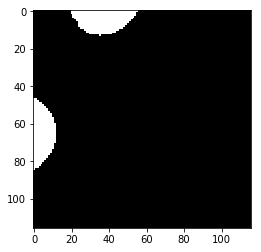

Prediction  25


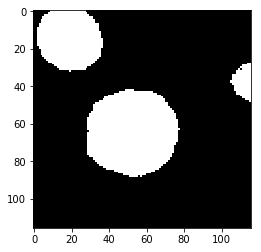

Label  25


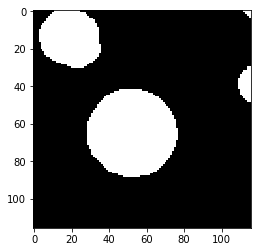

Prediction  26


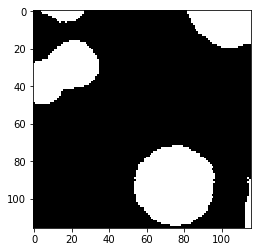

Label  26


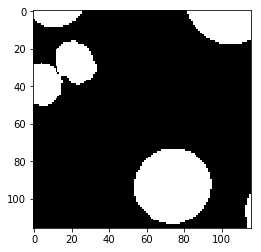

test_accuracy 0.961518750848
Batch: 4500 Train Loss value:0.0507166 Train Accuracy 0.970564545654
Prediction  0


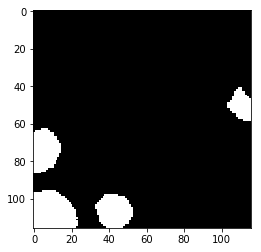

Label  0


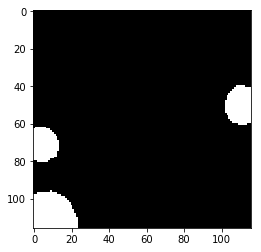

Prediction  1


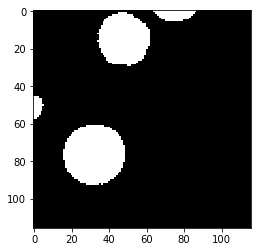

Label  1


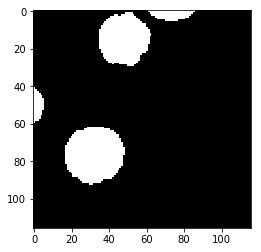

Prediction  2


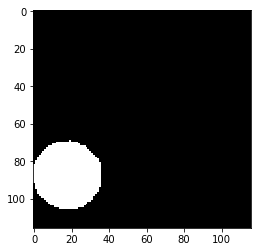

Label  2


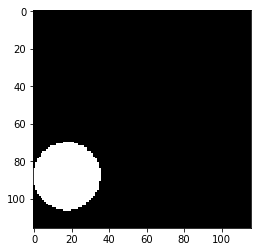

Prediction  3


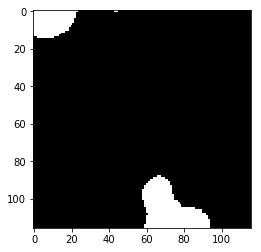

Label  3


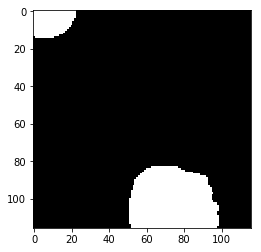

Prediction  4


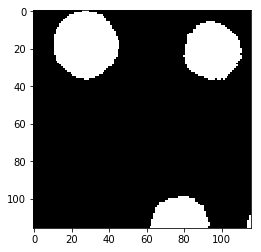

Label  4


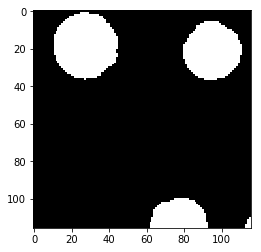

Prediction  5


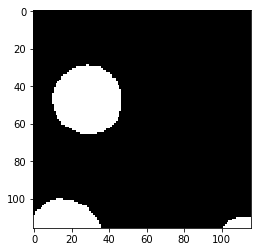

Label  5


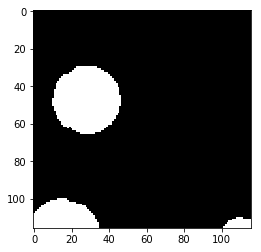

Prediction  6


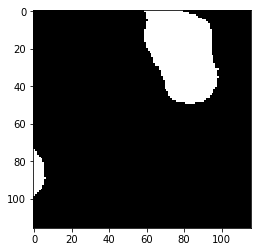

Label  6


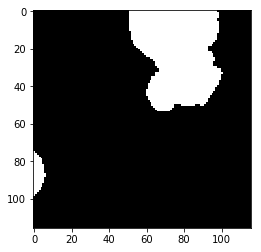

Prediction  7


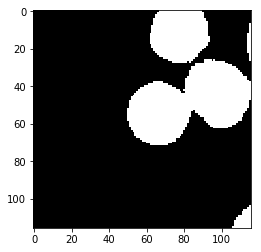

Label  7


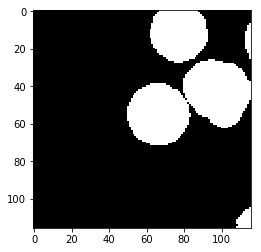

Prediction  8


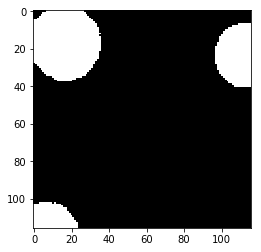

Label  8


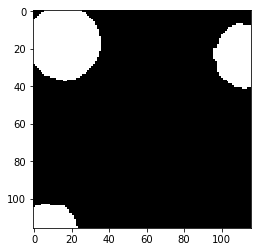

Prediction  9


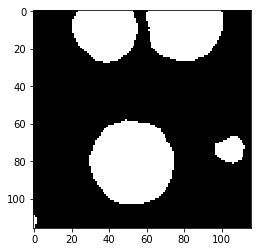

Label  9


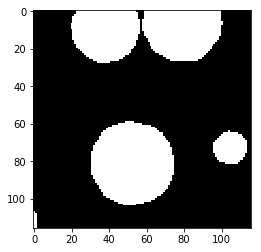

Prediction  10


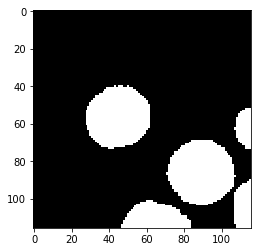

Label  10


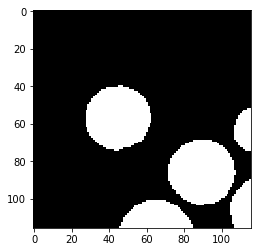

Prediction  11


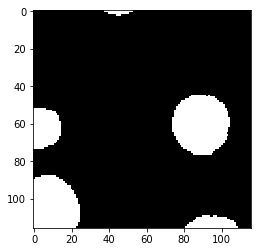

Label  11


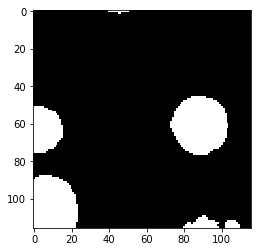

Prediction  12


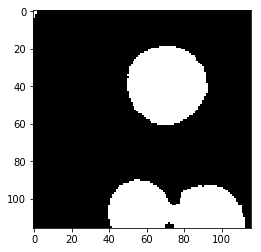

Label  12


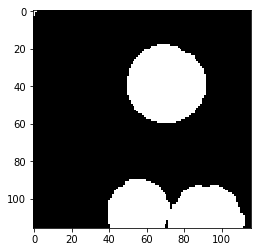

Prediction  13


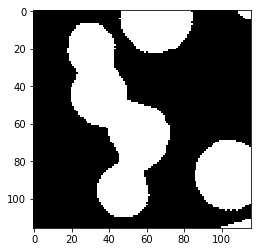

Label  13


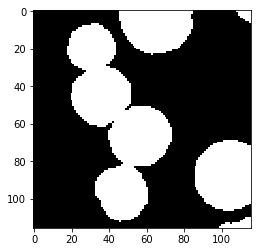

Prediction  14


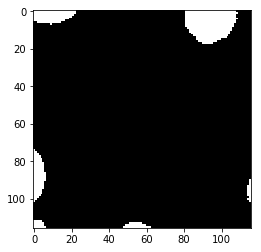

Label  14


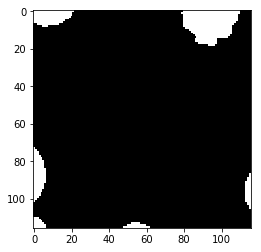

Prediction  15


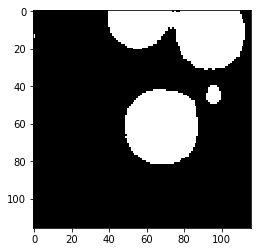

Label  15


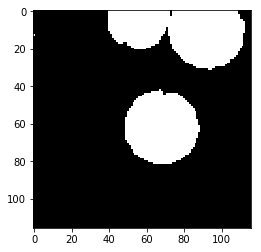

Prediction  16


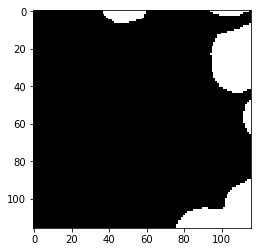

Label  16


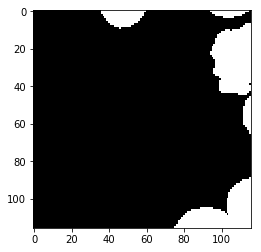

Prediction  17


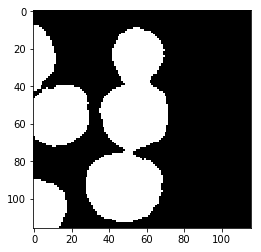

Label  17


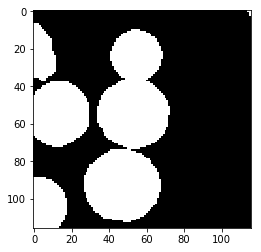

Prediction  18


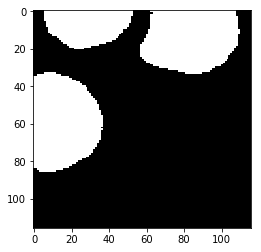

Label  18


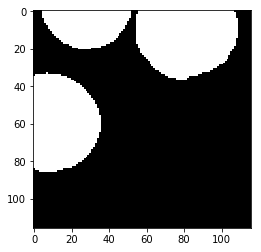

Prediction  19


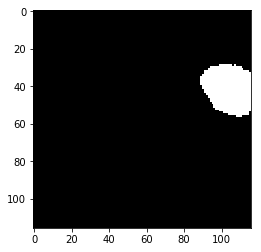

Label  19


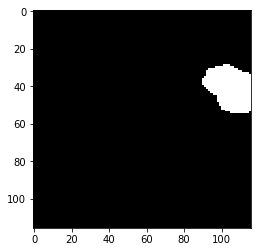

Prediction  20


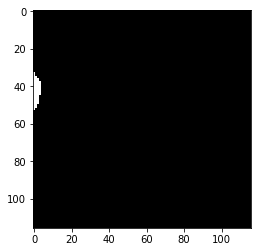

Label  20


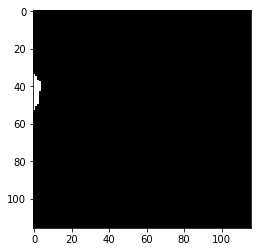

Prediction  21


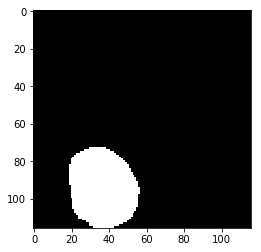

Label  21


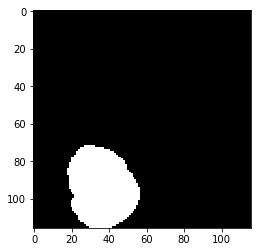

Prediction  22


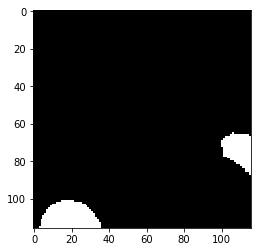

Label  22


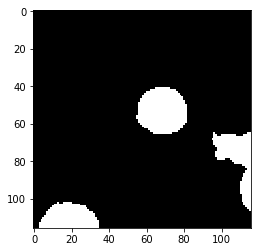

Prediction  23


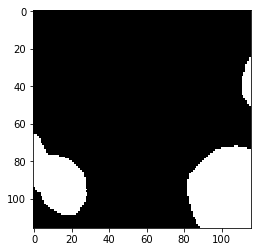

Label  23


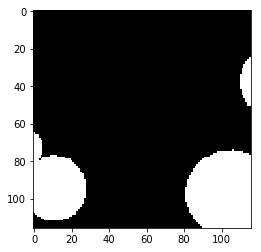

Prediction  24


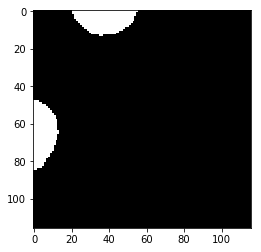

Label  24


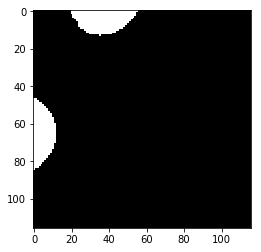

Prediction  25


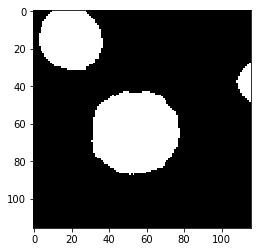

Label  25


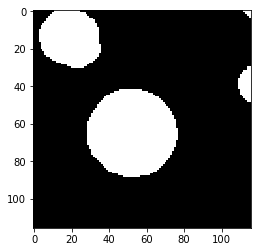

Prediction  26


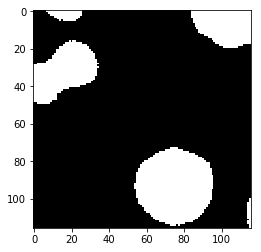

Label  26


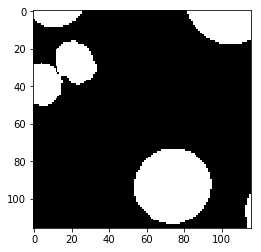

test_accuracy 0.963927221381
Batch: 5000 Train Loss value:0.0311489 Train Accuracy 0.976788599971
Prediction  0


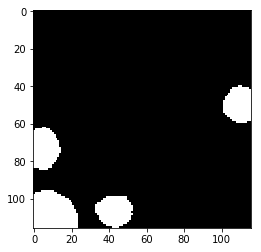

Label  0


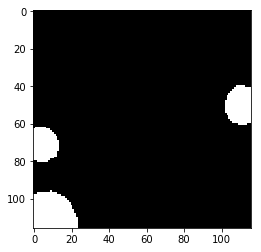

Prediction  1


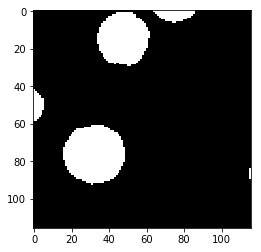

Label  1


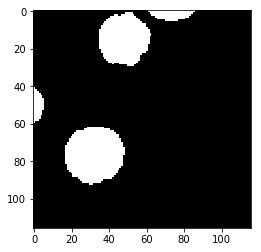

Prediction  2


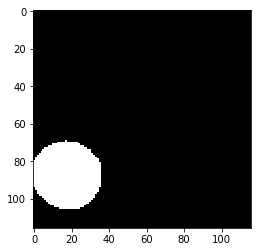

Label  2


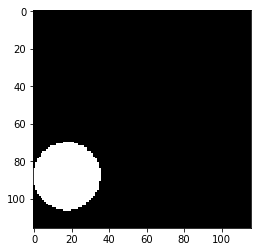

Prediction  3


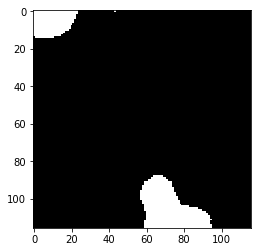

Label  3


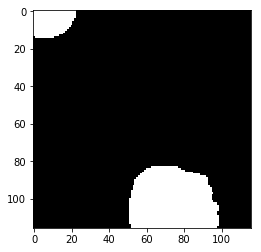

Prediction  4


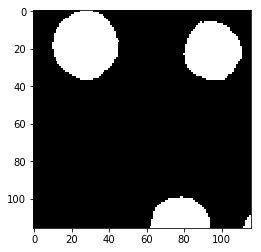

Label  4


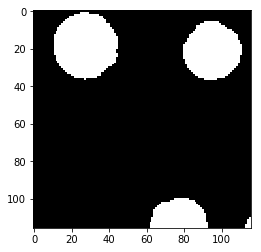

Prediction  5


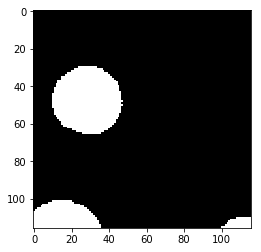

Label  5


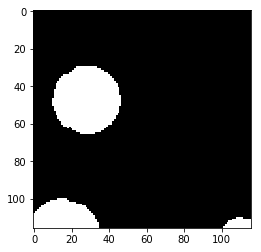

Prediction  6


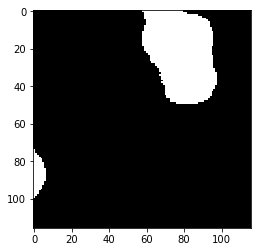

Label  6


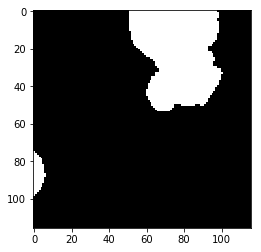

Prediction  7


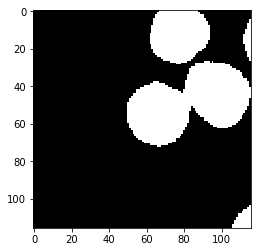

Label  7


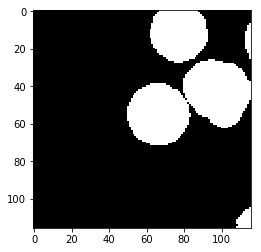

Prediction  8


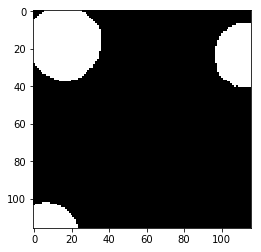

Label  8


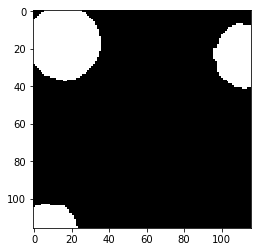

Prediction  9


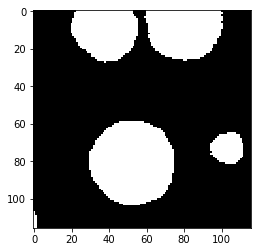

Label  9


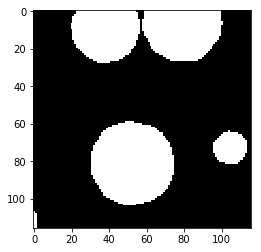

Prediction  10


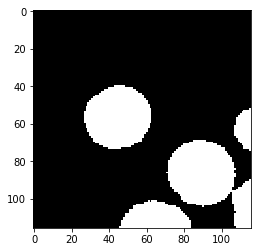

Label  10


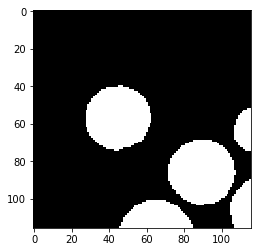

Prediction  11


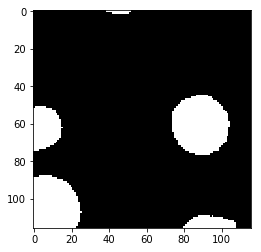

Label  11


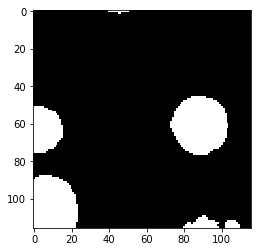

Prediction  12


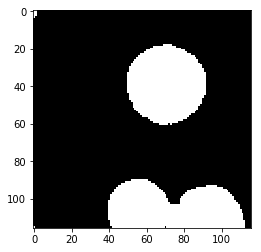

Label  12


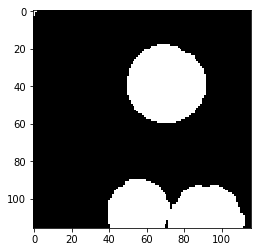

Prediction  13


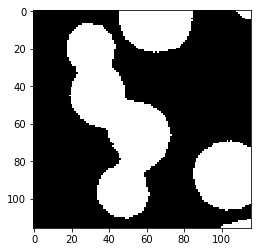

Label  13


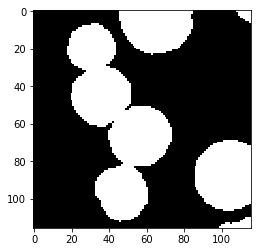

Prediction  14


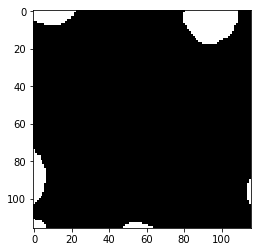

Label  14


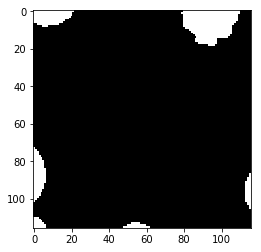

Prediction  15


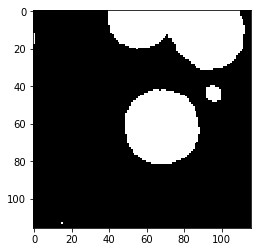

Label  15


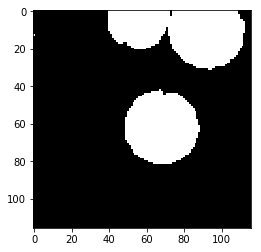

Prediction  16


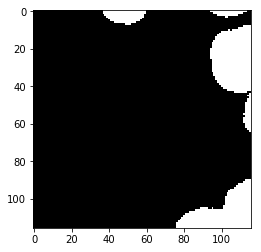

Label  16


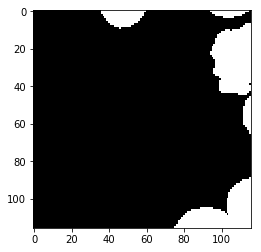

Prediction  17


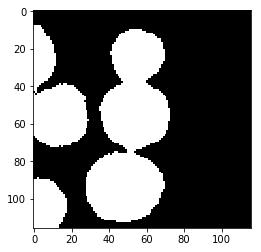

Label  17


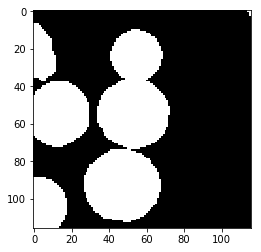

Prediction  18


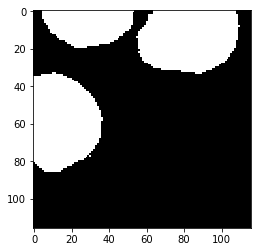

Label  18


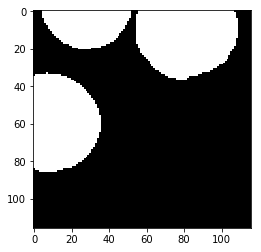

Prediction  19


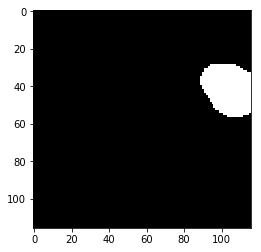

Label  19


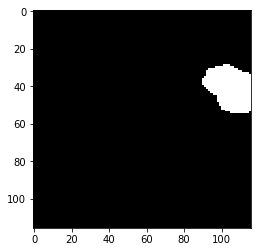

Prediction  20


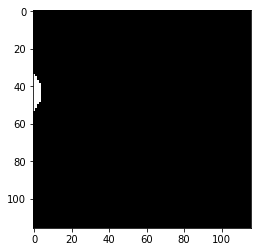

Label  20


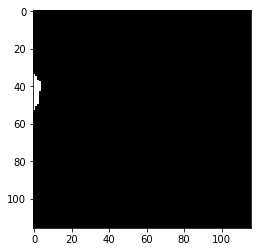

Prediction  21


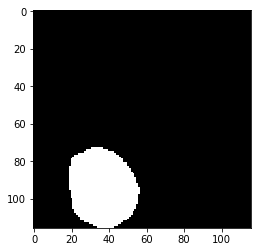

Label  21


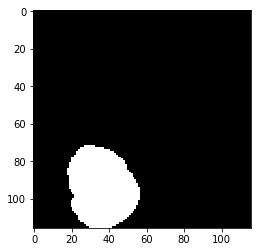

Prediction  22


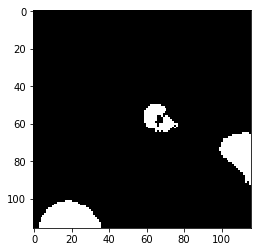

Label  22


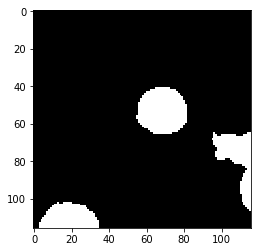

Prediction  23


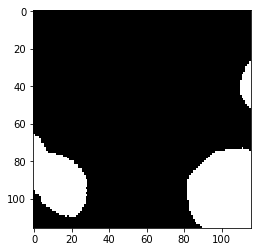

Label  23


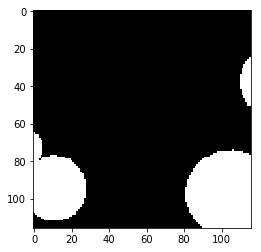

Prediction  24


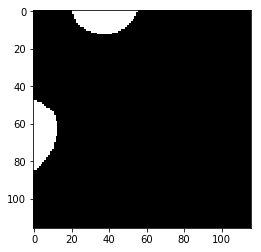

Label  24


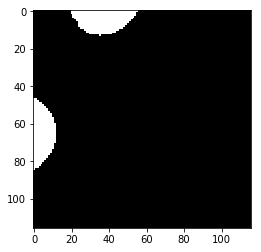

Prediction  25


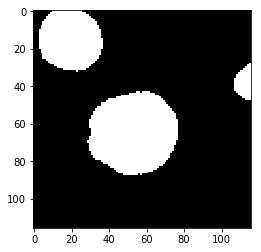

Label  25


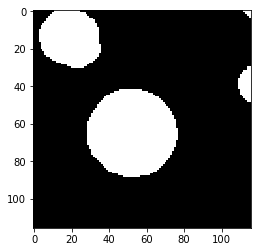

Prediction  26


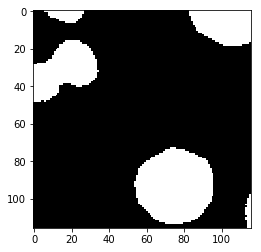

Label  26


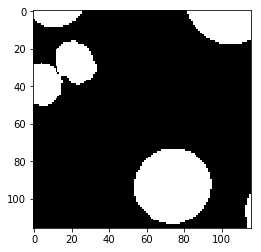

test_accuracy 0.967165917363
Batch: 5500 Train Loss value:0.0511196 Train Accuracy 0.963089940915
Prediction  0


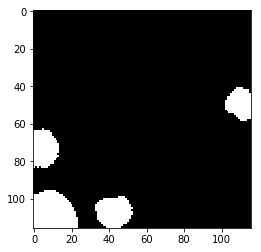

Label  0


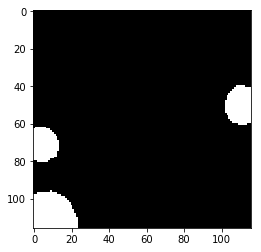

Prediction  1


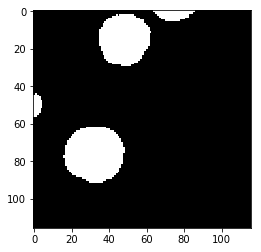

Label  1


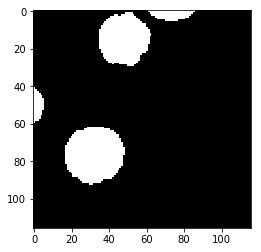

Prediction  2


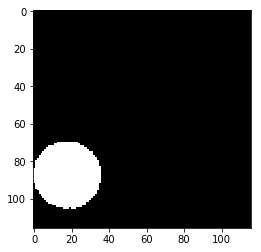

Label  2


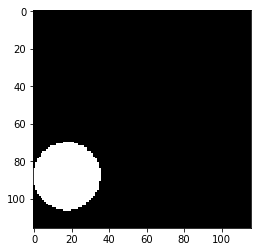

Prediction  3


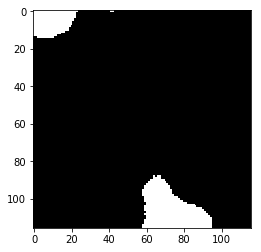

Label  3


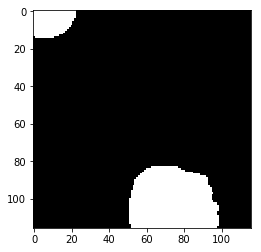

Prediction  4


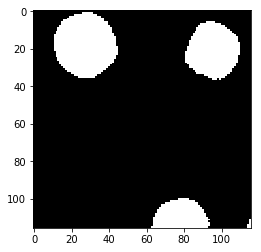

Label  4


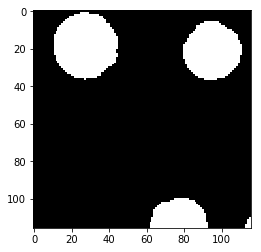

Prediction  5


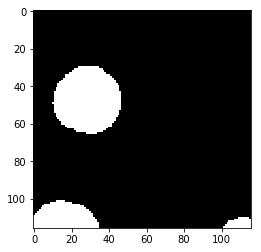

Label  5


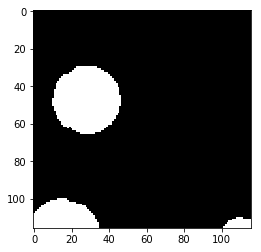

Prediction  6


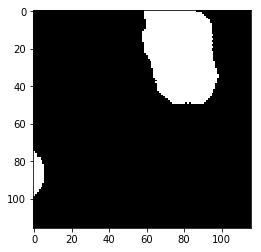

Label  6


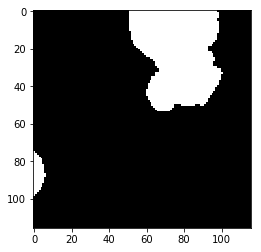

Prediction  7


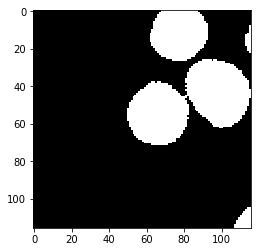

Label  7


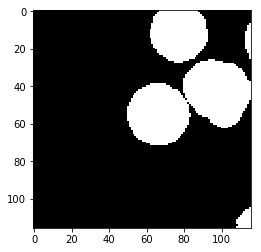

Prediction  8


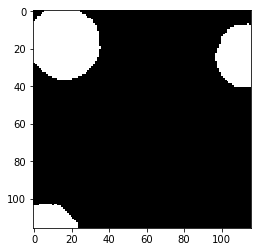

Label  8


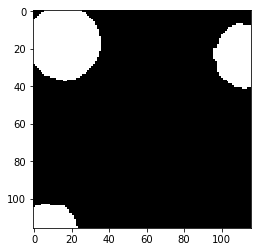

Prediction  9


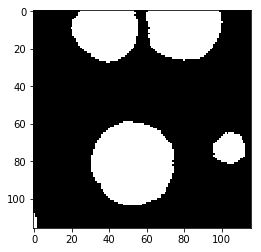

Label  9


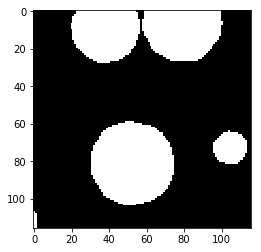

Prediction  10


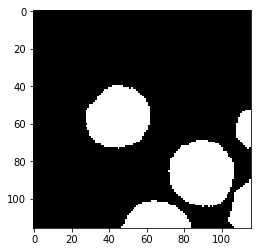

Label  10


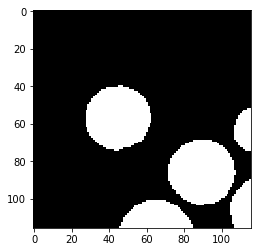

Prediction  11


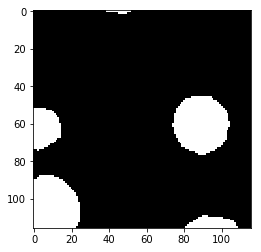

Label  11


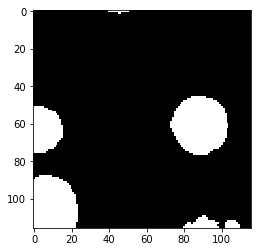

Prediction  12


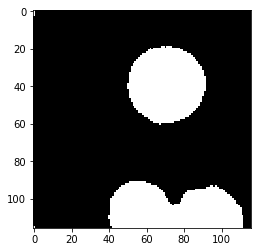

Label  12


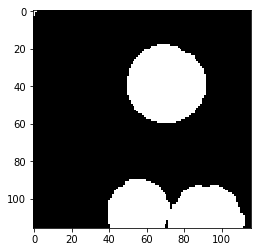

Prediction  13


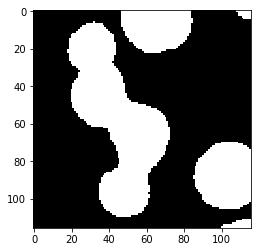

Label  13


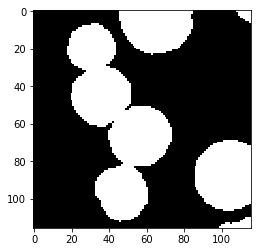

Prediction  14


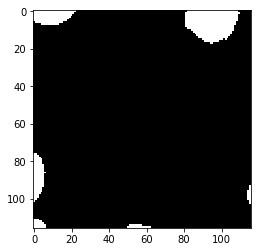

Label  14


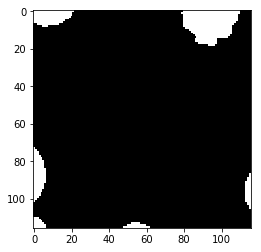

Prediction  15


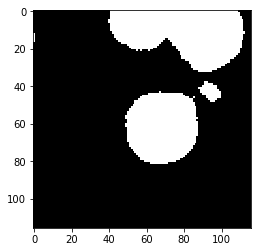

Label  15


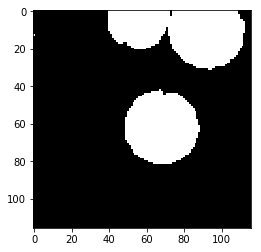

Prediction  16


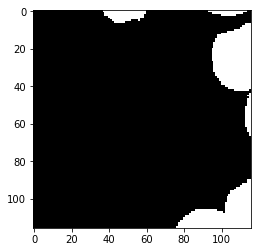

Label  16


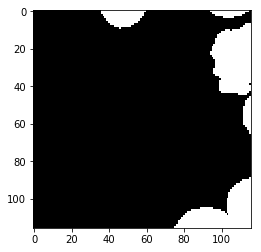

Prediction  17


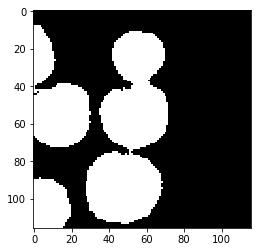

Label  17


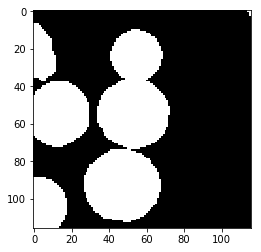

Prediction  18


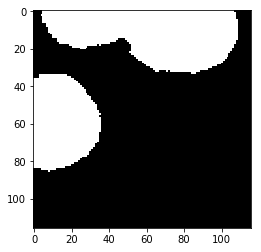

Label  18


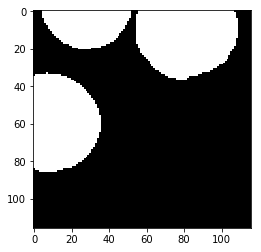

Prediction  19


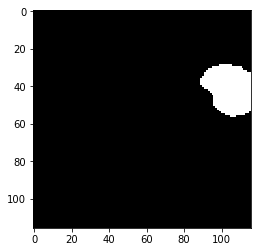

Label  19


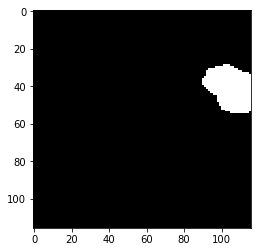

Prediction  20


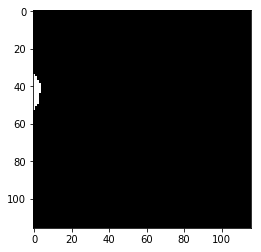

Label  20


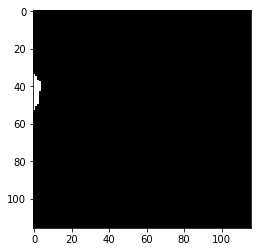

Prediction  21


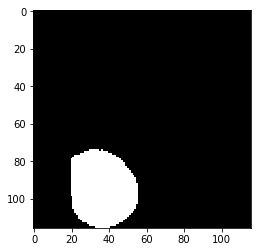

Label  21


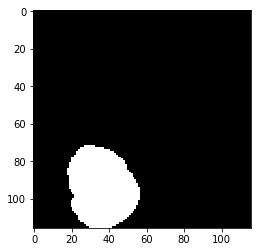

Prediction  22


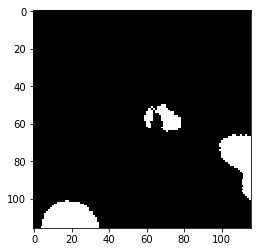

Label  22


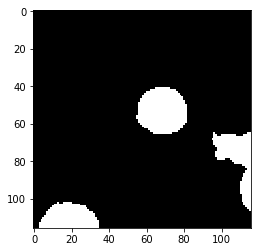

Prediction  23


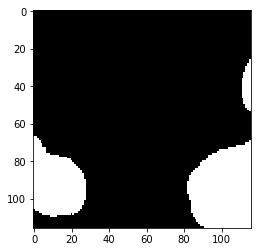

Label  23


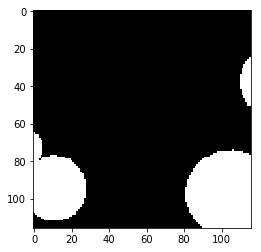

Prediction  24


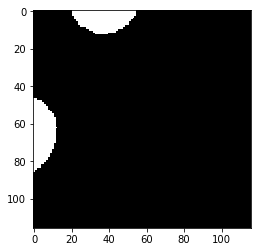

Label  24


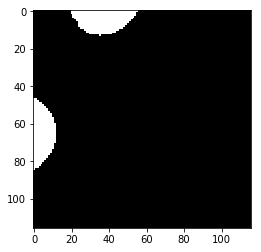

Prediction  25


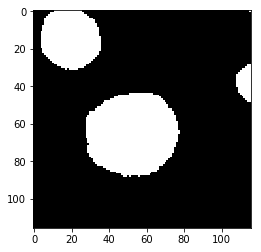

Label  25


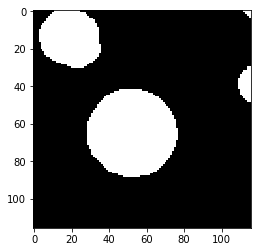

Prediction  26


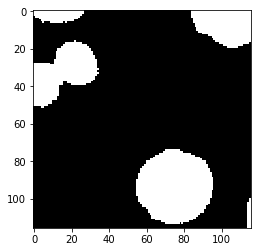

Label  26


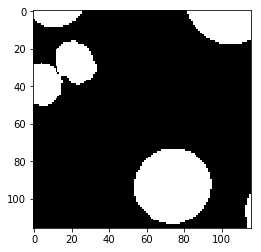

test_accuracy 0.967055343341
Batch: 6000 Train Loss value:0.0342611 Train Accuracy 0.969843361148
Prediction  0


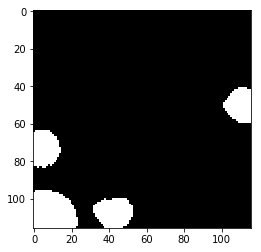

Label  0


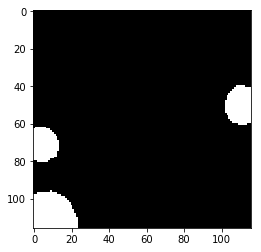

Prediction  1


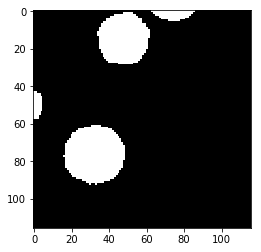

Label  1


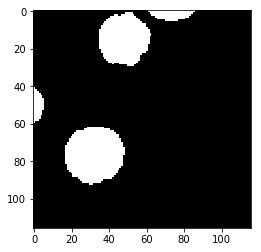

Prediction  2


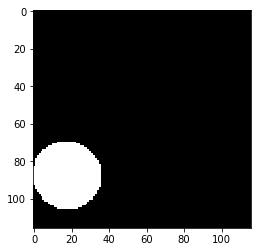

Label  2


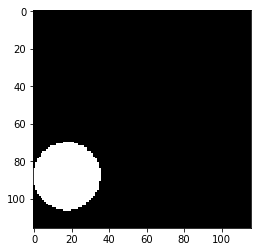

Prediction  3


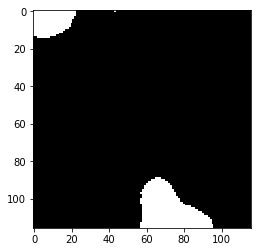

Label  3


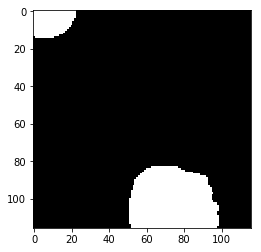

Prediction  4


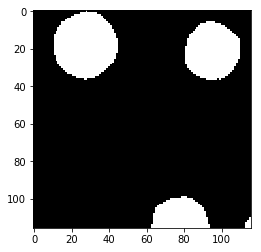

Label  4


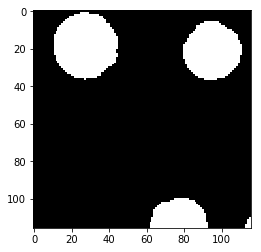

Prediction  5


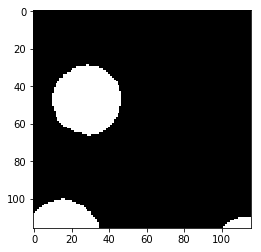

Label  5


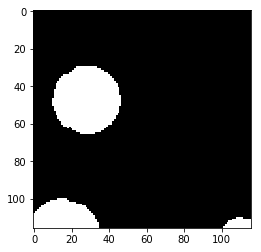

Prediction  6


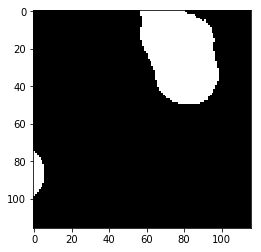

Label  6


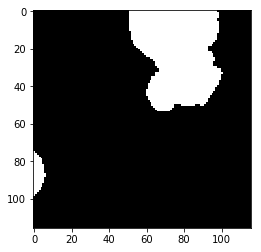

Prediction  7


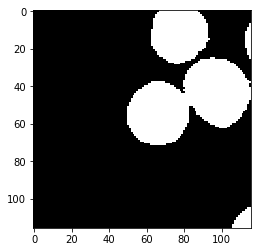

Label  7


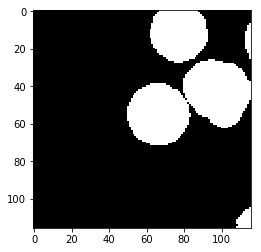

Prediction  8


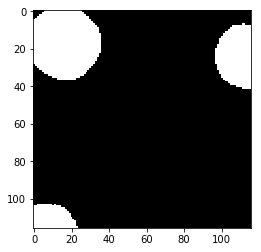

Label  8


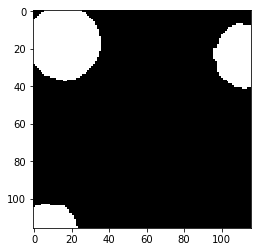

Prediction  9


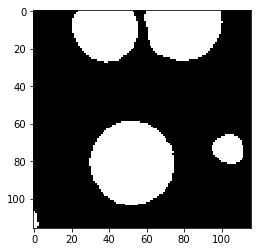

Label  9


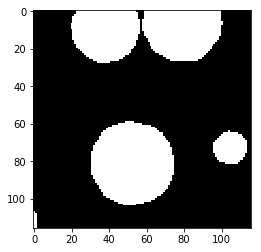

Prediction  10


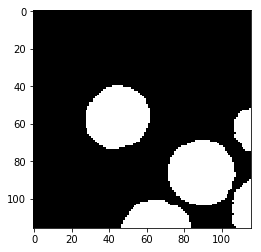

Label  10


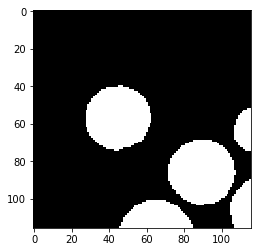

Prediction  11


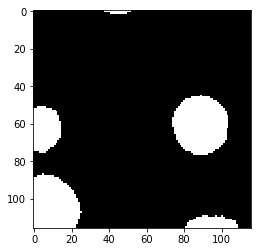

Label  11


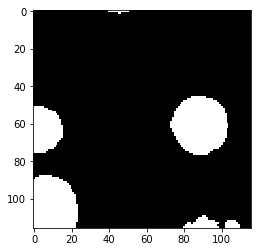

Prediction  12


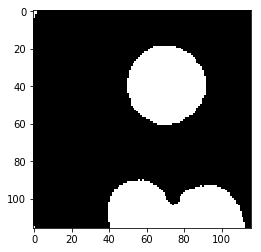

Label  12


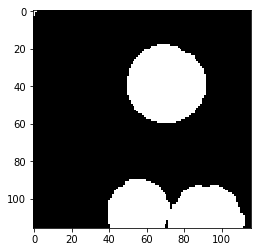

Prediction  13


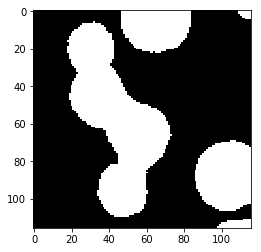

Label  13


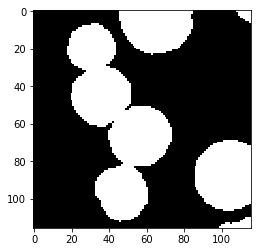

Prediction  14


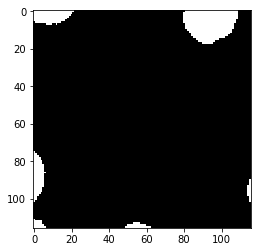

Label  14


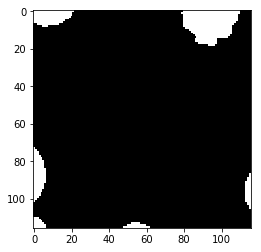

Prediction  15


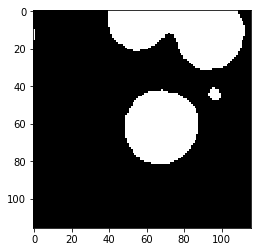

Label  15


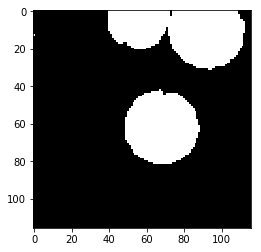

Prediction  16


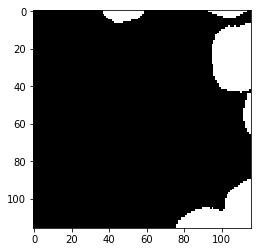

Label  16


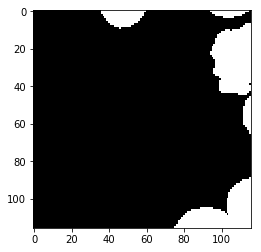

Prediction  17


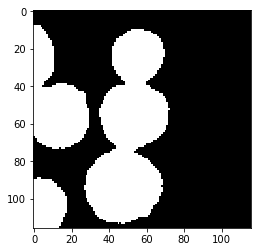

Label  17


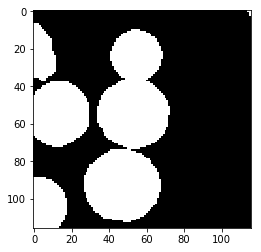

Prediction  18


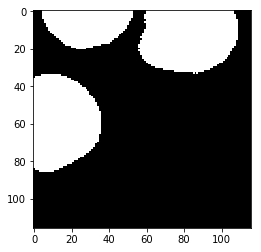

Label  18


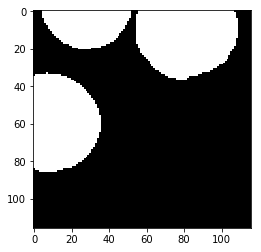

Prediction  19


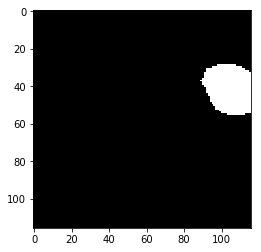

Label  19


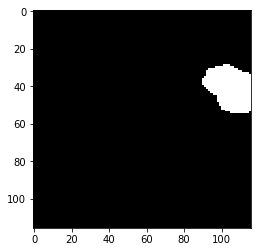

Prediction  20


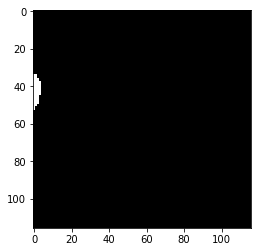

Label  20


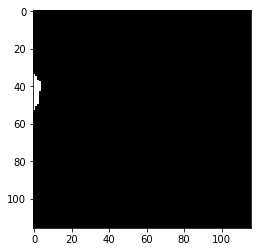

Prediction  21


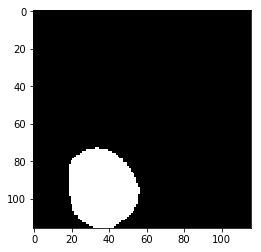

Label  21


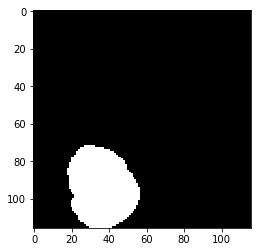

Prediction  22


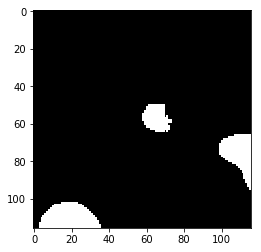

Label  22


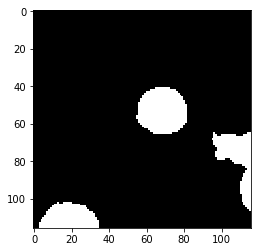

Prediction  23


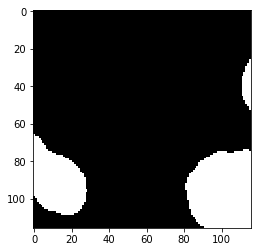

Label  23


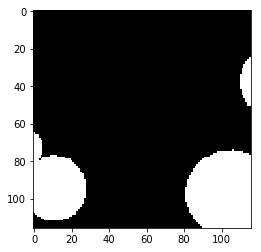

Prediction  24


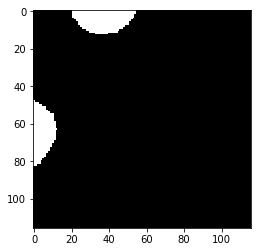

Label  24


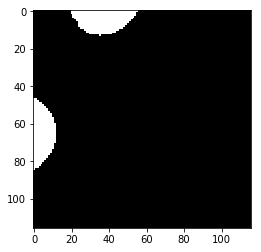

Prediction  25


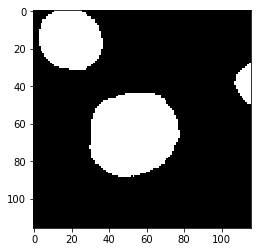

Label  25


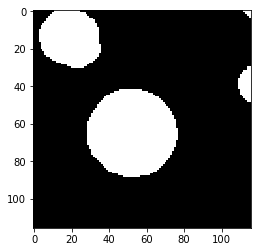

Prediction  26


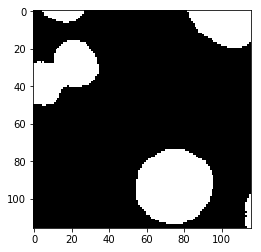

Label  26


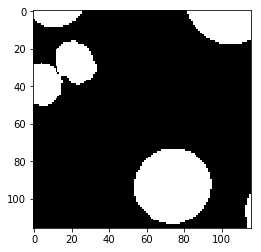

test_accuracy 0.969786275634
Batch: 6500 Train Loss value:0.0744579 Train Accuracy 0.94450867052
Prediction  0


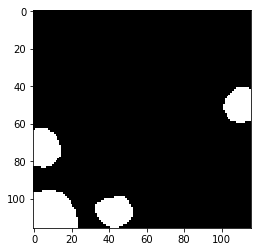

Label  0


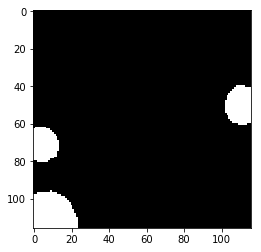

Prediction  1


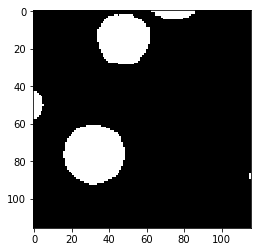

Label  1


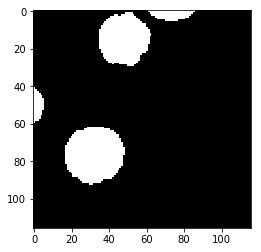

Prediction  2


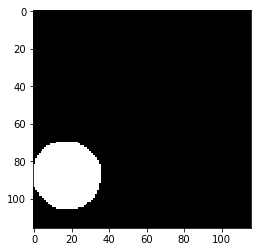

Label  2


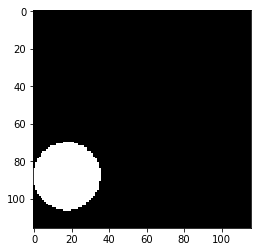

Prediction  3


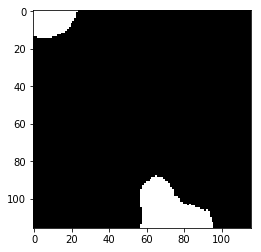

Label  3


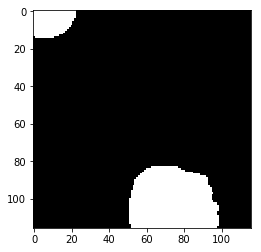

Prediction  4


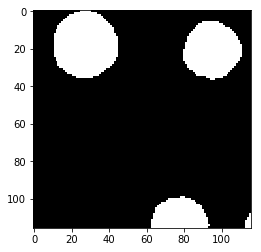

Label  4


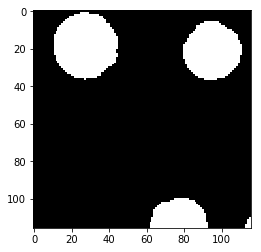

Prediction  5


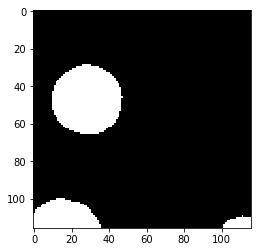

Label  5


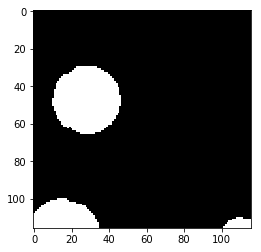

Prediction  6


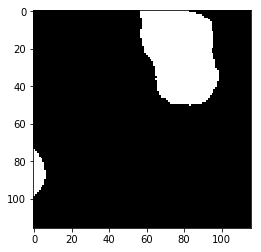

Label  6


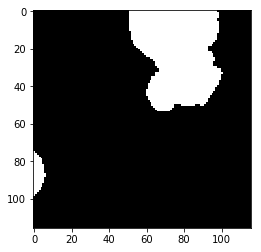

Prediction  7


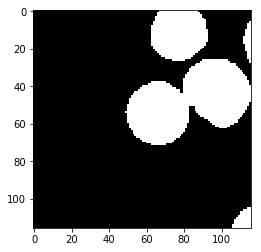

Label  7


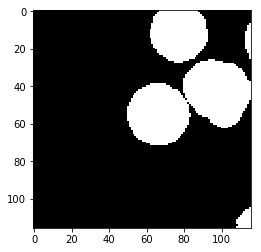

Prediction  8


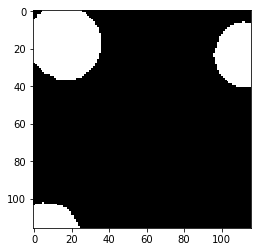

Label  8


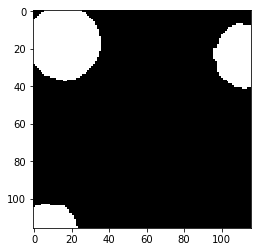

Prediction  9


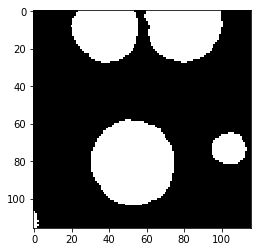

Label  9


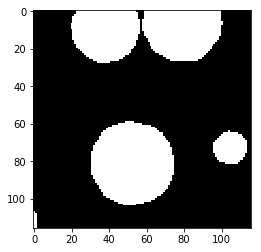

Prediction  10


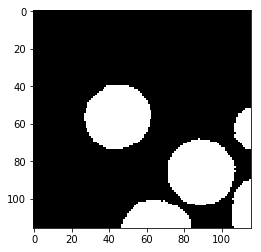

Label  10


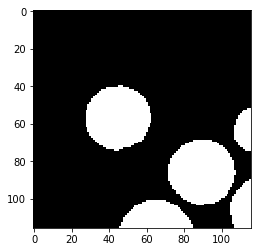

Prediction  11


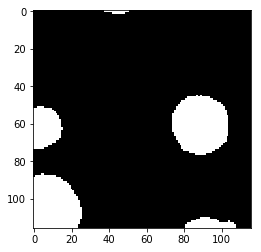

Label  11


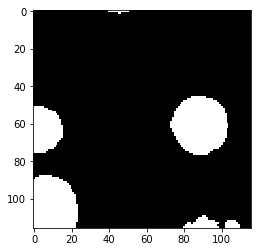

Prediction  12


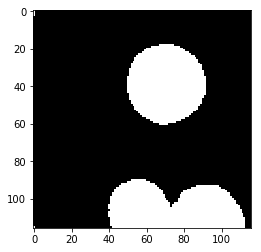

Label  12


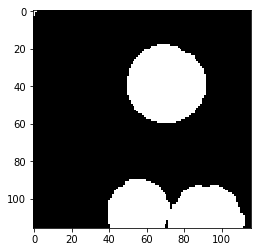

Prediction  13


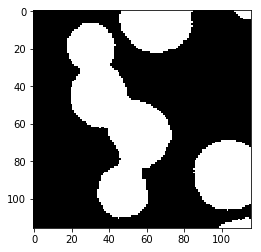

Label  13


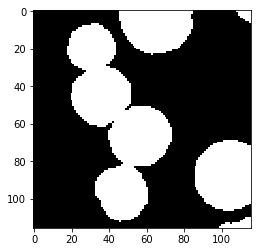

Prediction  14


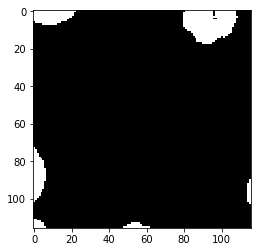

Label  14


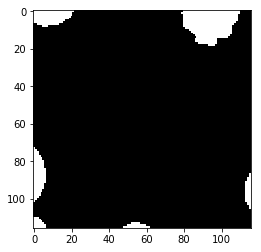

Prediction  15


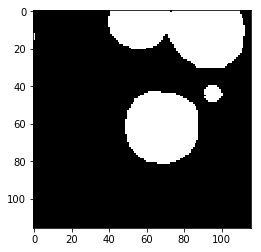

Label  15


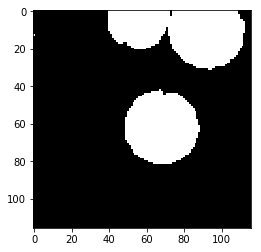

Prediction  16


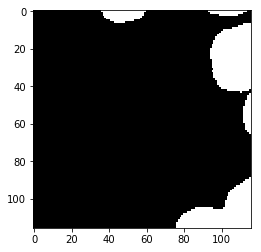

Label  16


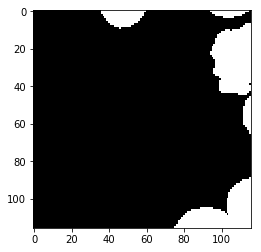

Prediction  17


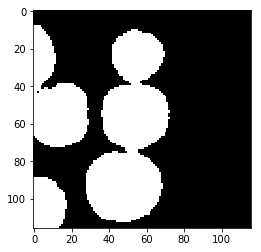

Label  17


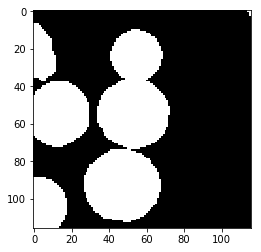

Prediction  18


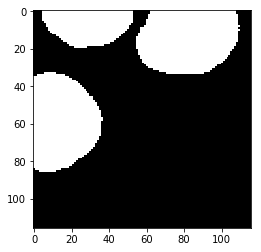

Label  18


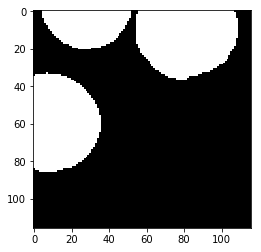

Prediction  19


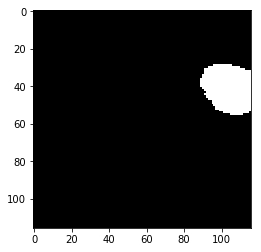

Label  19


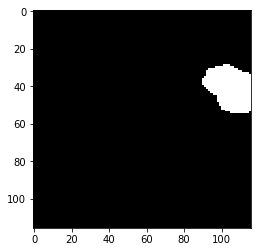

Prediction  20


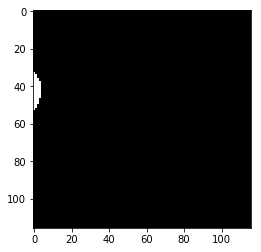

Label  20


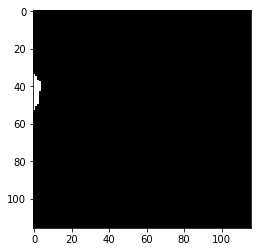

Prediction  21


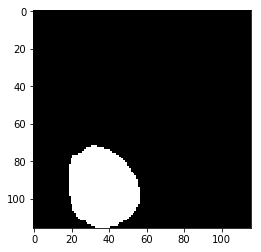

Label  21


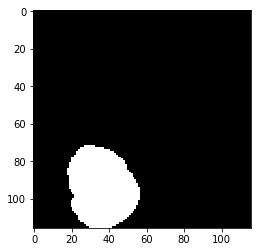

Prediction  22


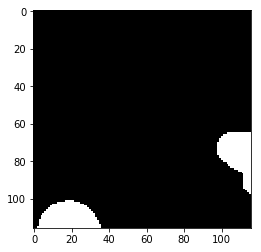

Label  22


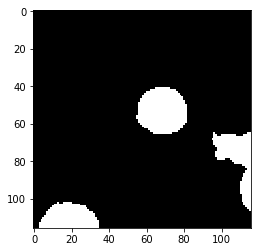

Prediction  23


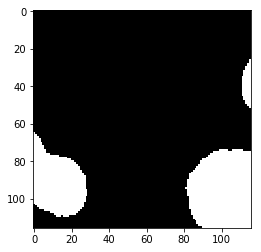

Label  23


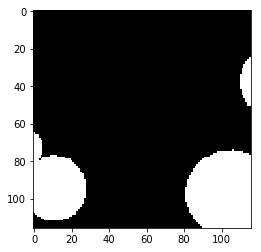

Prediction  24


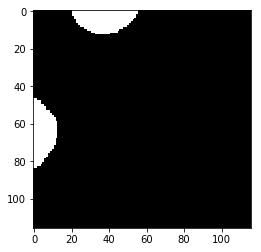

Label  24


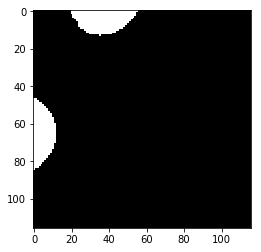

Prediction  25


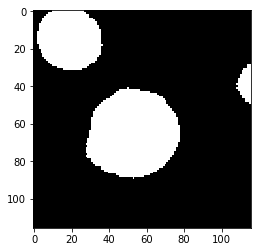

Label  25


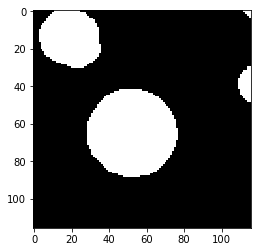

Prediction  26


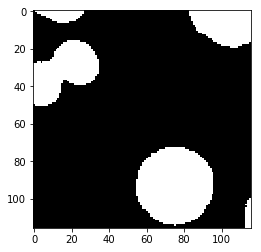

Label  26


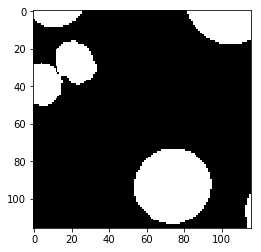

test_accuracy 0.969936823998
Batch: 7000 Train Loss value:0.0148403 Train Accuracy 0.988914344838
Prediction  0


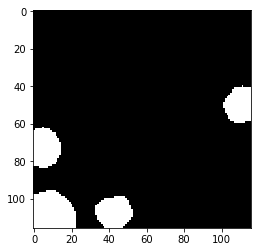

Label  0


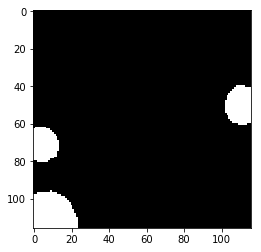

Prediction  1


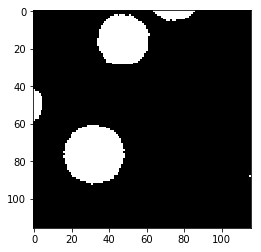

Label  1


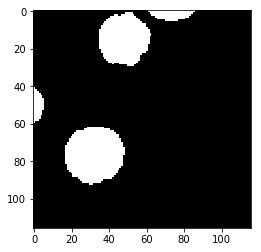

Prediction  2


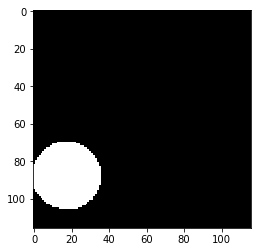

Label  2


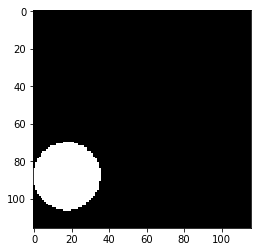

Prediction  3


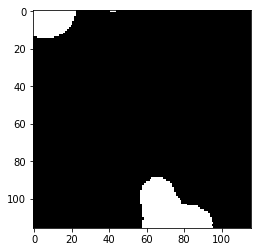

Label  3


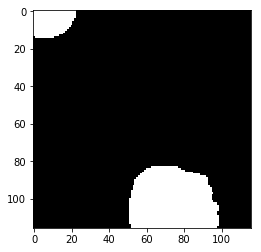

Prediction  4


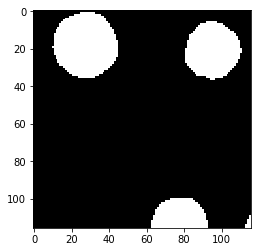

Label  4


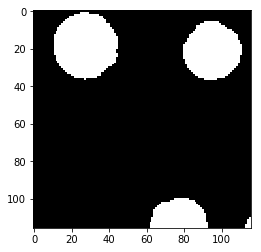

Prediction  5


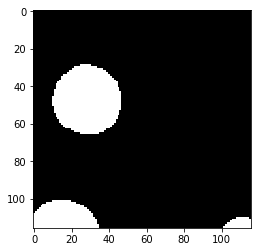

Label  5


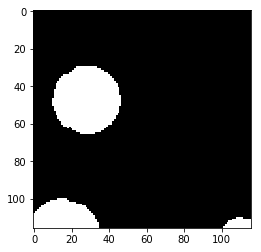

Prediction  6


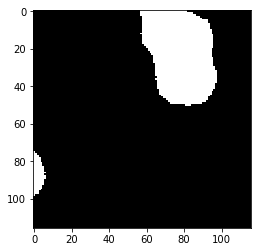

Label  6


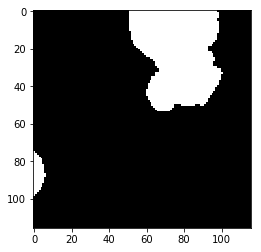

Prediction  7


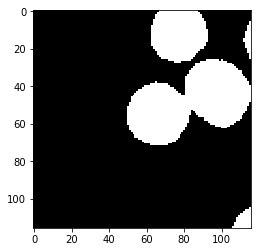

Label  7


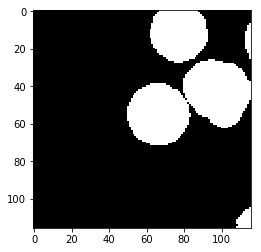

Prediction  8


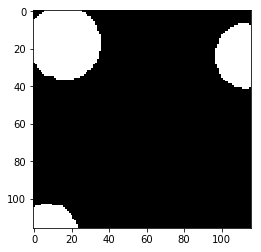

Label  8


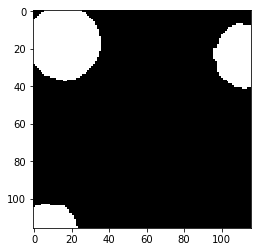

Prediction  9


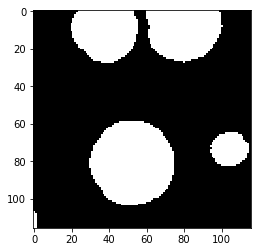

Label  9


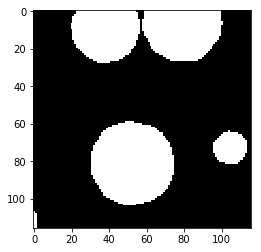

Prediction  10


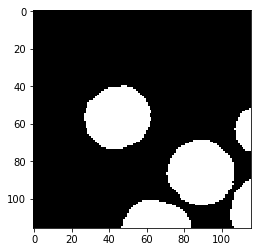

Label  10


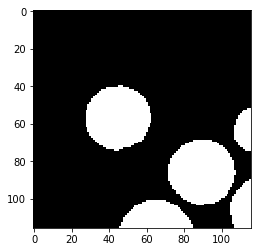

Prediction  11


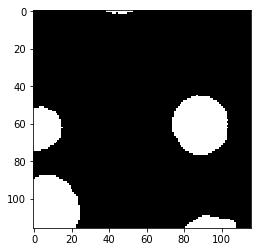

Label  11


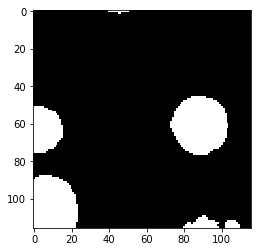

Prediction  12


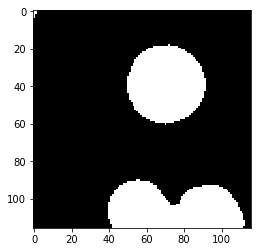

Label  12


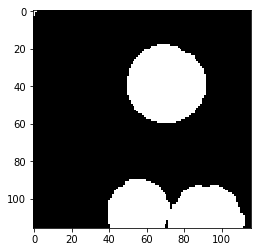

Prediction  13


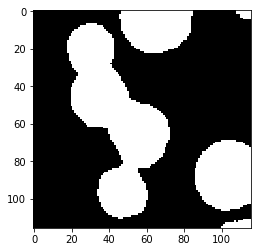

Label  13


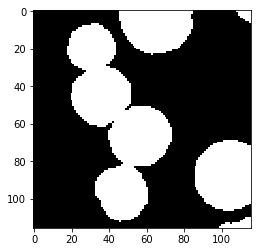

Prediction  14


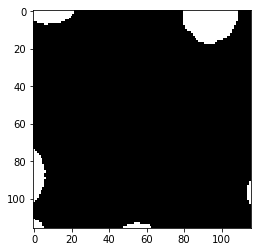

Label  14


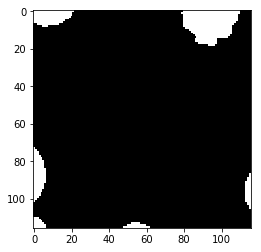

Prediction  15


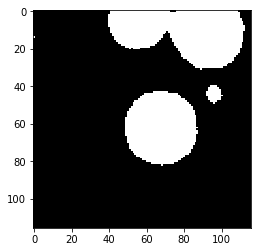

Label  15


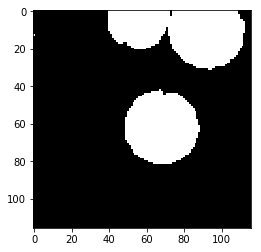

Prediction  16


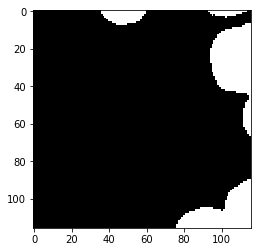

Label  16


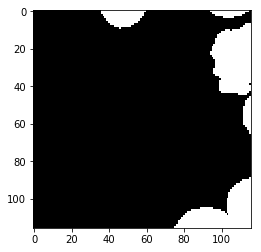

Prediction  17


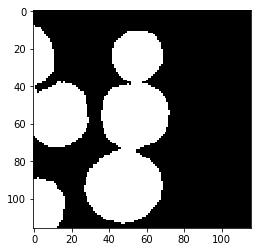

Label  17


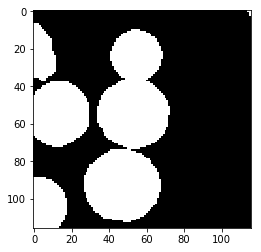

Prediction  18


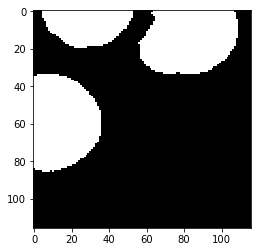

Label  18


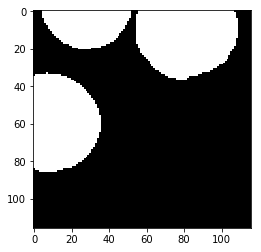

Prediction  19


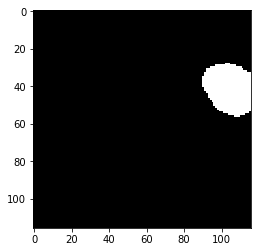

Label  19


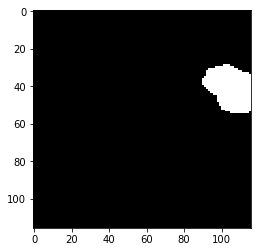

Prediction  20


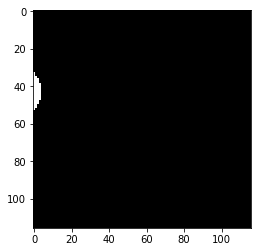

Label  20


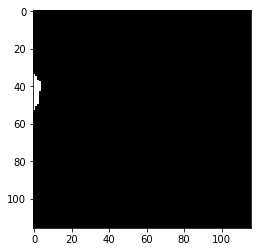

Prediction  21


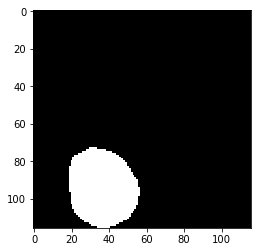

Label  21


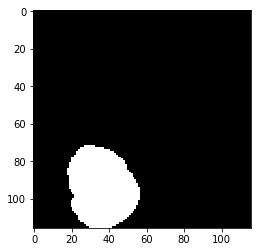

Prediction  22


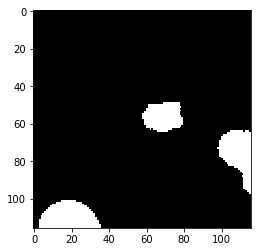

Label  22


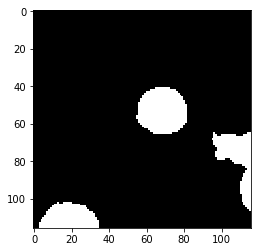

Prediction  23


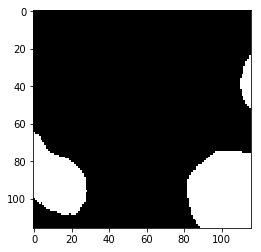

Label  23


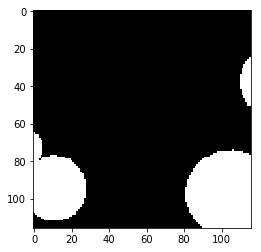

Prediction  24


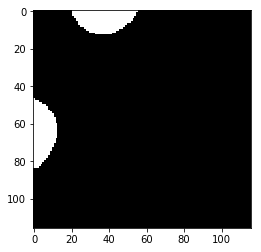

Label  24


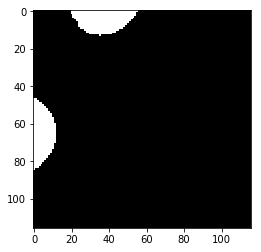

Prediction  25


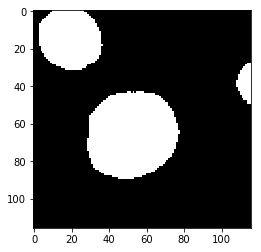

Label  25


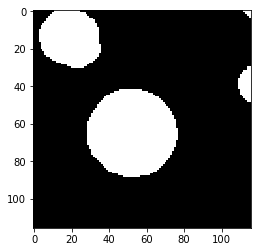

Prediction  26


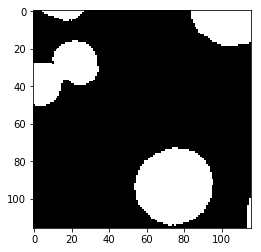

Label  26


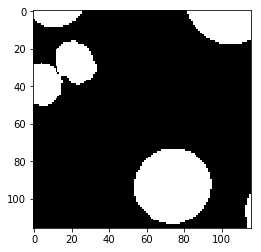

test_accuracy 0.971615806146
Batch: 7500 Train Loss value:0.114908 Train Accuracy 0.927517547629
Prediction  0


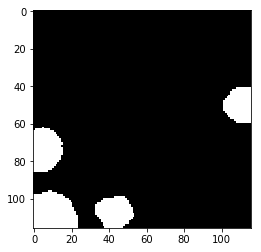

Label  0


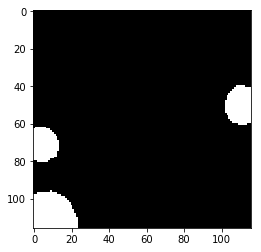

Prediction  1


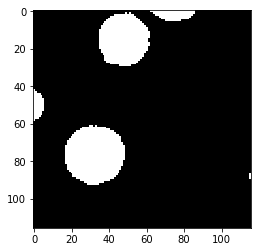

Label  1


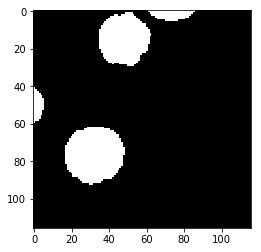

Prediction  2


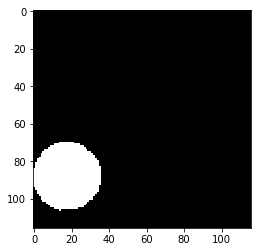

Label  2


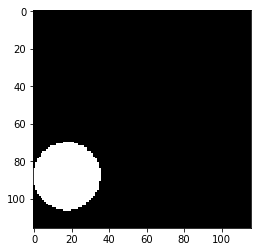

Prediction  3


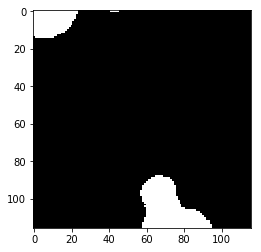

Label  3


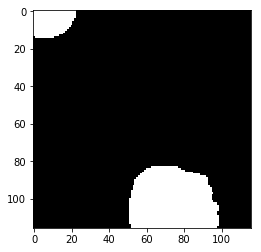

Prediction  4


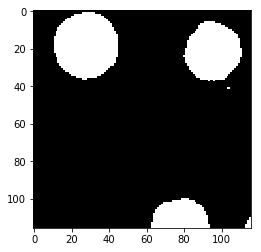

Label  4


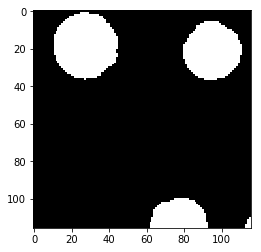

Prediction  5


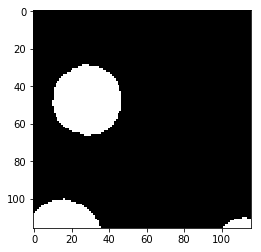

Label  5


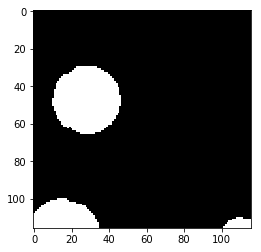

Prediction  6


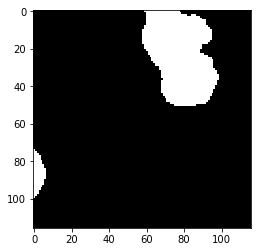

Label  6


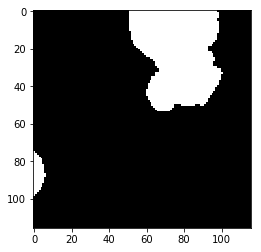

Prediction  7


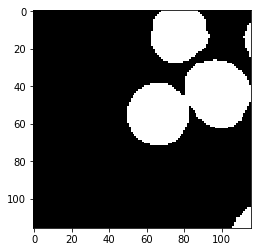

Label  7


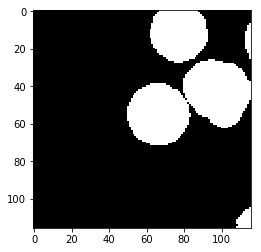

Prediction  8


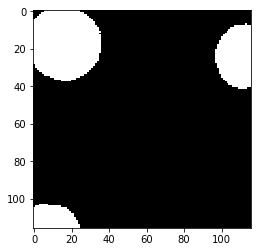

Label  8


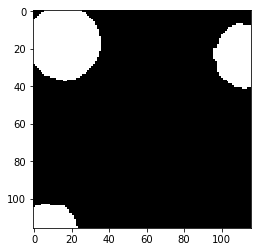

Prediction  9


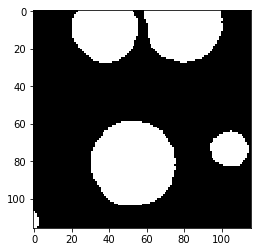

Label  9


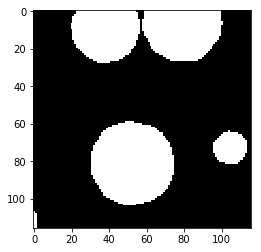

Prediction  10


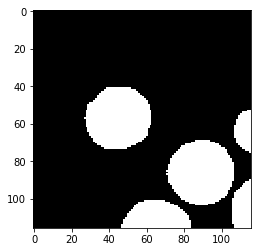

Label  10


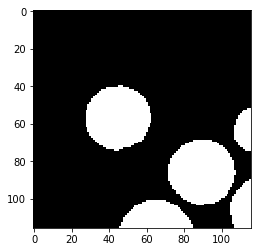

Prediction  11


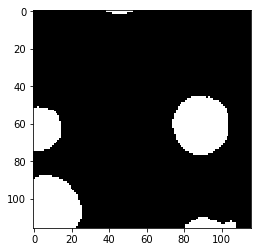

Label  11


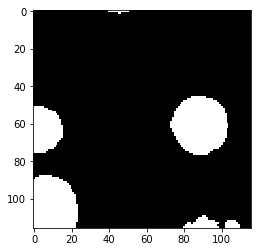

Prediction  12


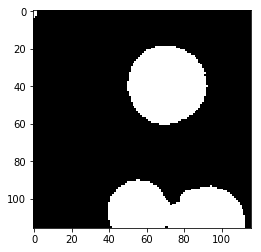

Label  12


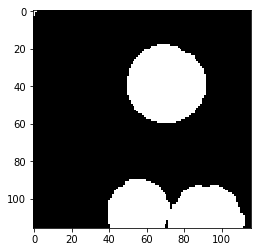

Prediction  13


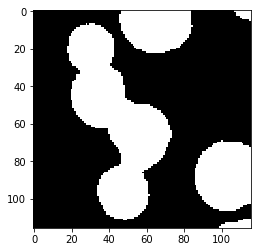

Label  13


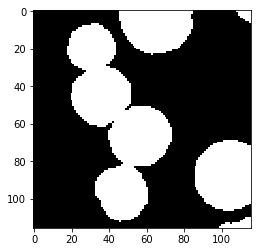

Prediction  14


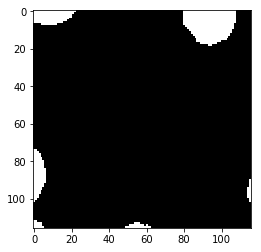

Label  14


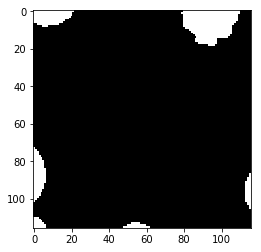

Prediction  15


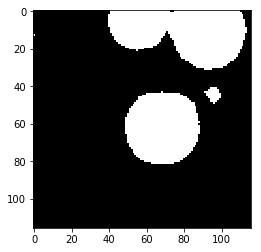

Label  15


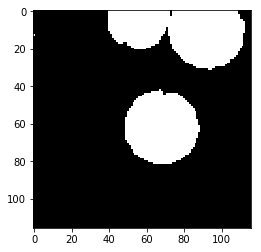

Prediction  16


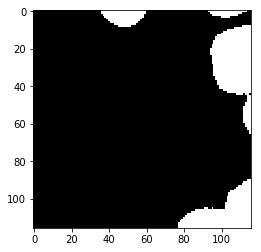

Label  16


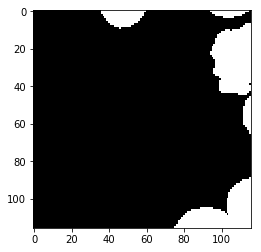

Prediction  17


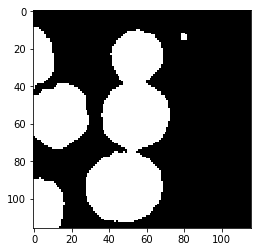

Label  17


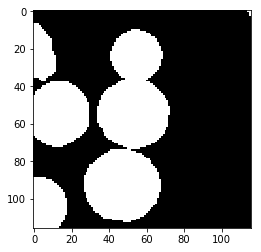

Prediction  18


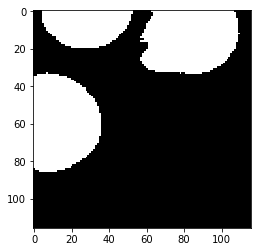

Label  18


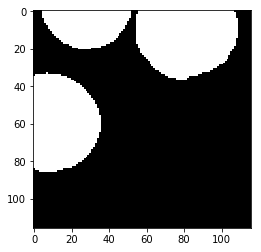

Prediction  19


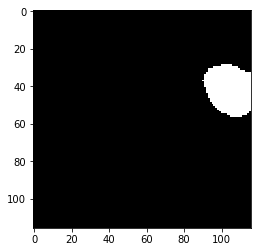

Label  19


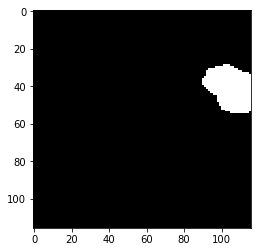

Prediction  20


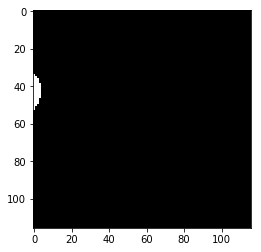

Label  20


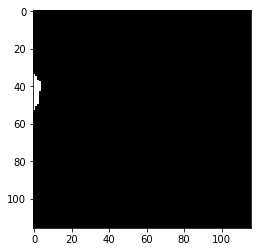

Prediction  21


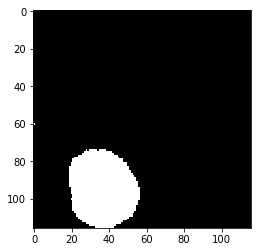

Label  21


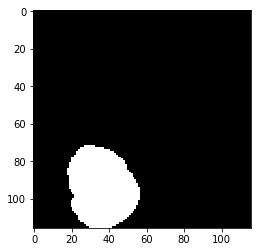

Prediction  22


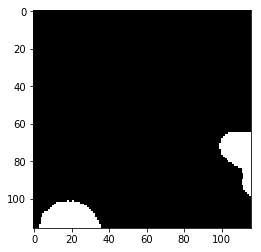

Label  22


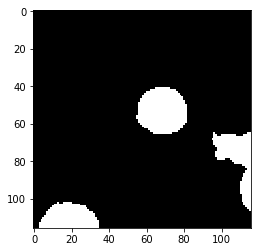

Prediction  23


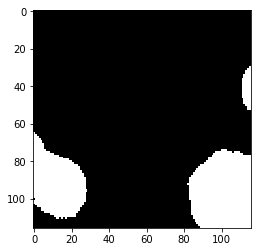

Label  23


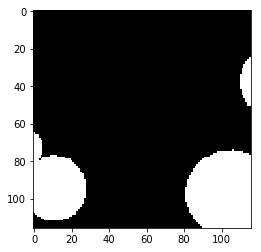

Prediction  24


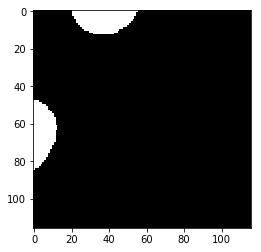

Label  24


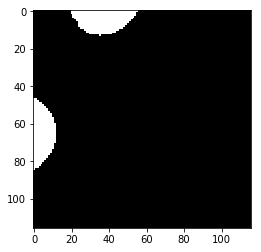

Prediction  25


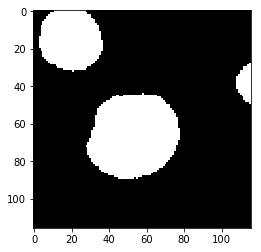

Label  25


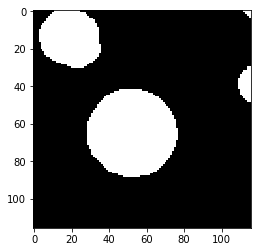

Prediction  26


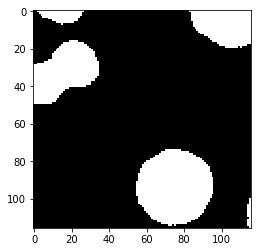

Label  26


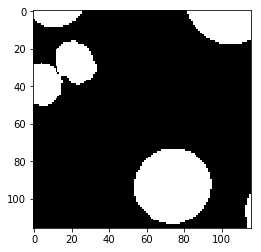

test_accuracy 0.968271891568
Batch: 8000 Train Loss value:5.84275e-05 Train Accuracy 1.0
Prediction  0


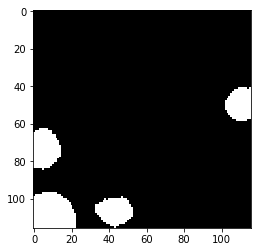

Label  0


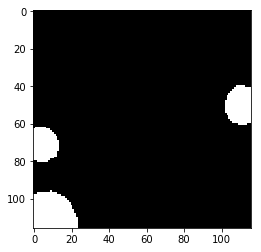

Prediction  1


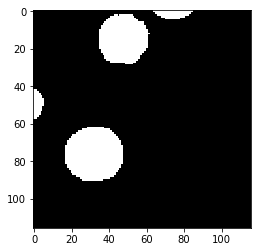

Label  1


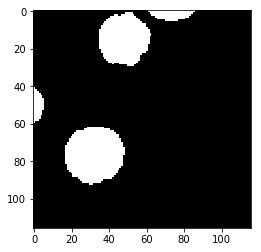

Prediction  2


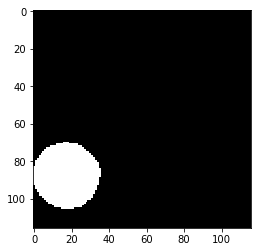

Label  2


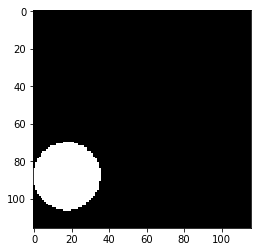

Prediction  3


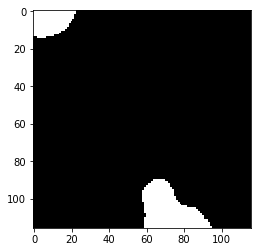

Label  3


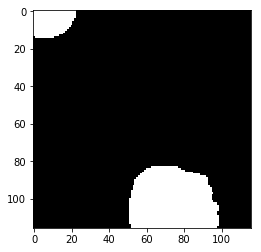

Prediction  4


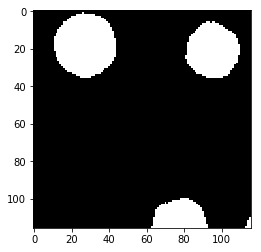

Label  4


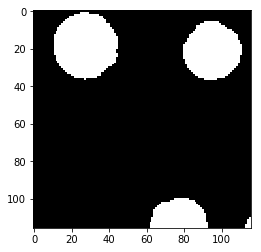

Prediction  5


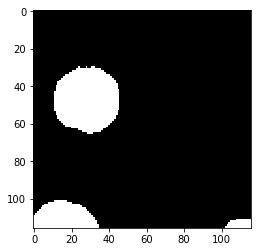

Label  5


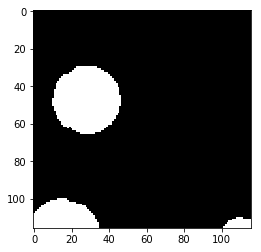

Prediction  6


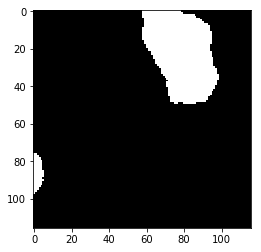

Label  6


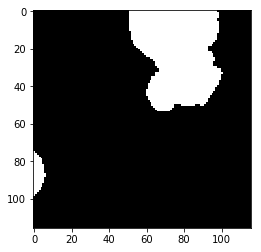

Prediction  7


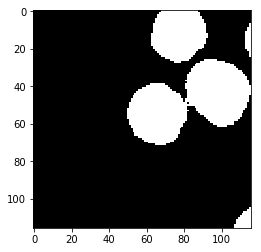

Label  7


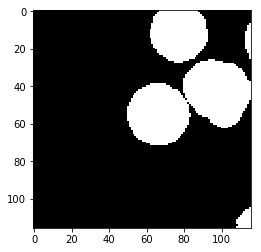

Prediction  8


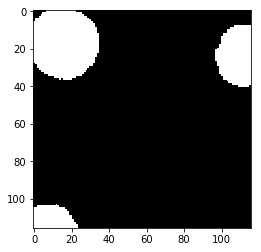

Label  8


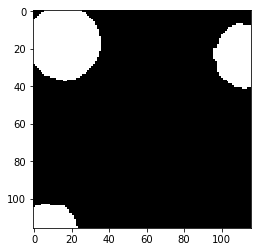

Prediction  9


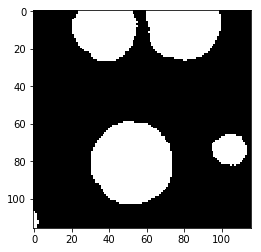

Label  9


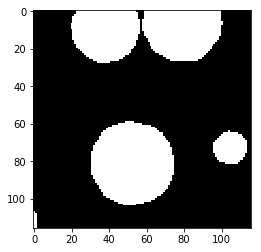

Prediction  10


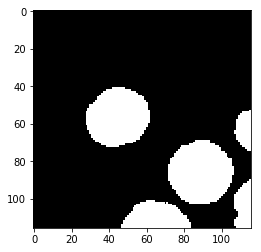

Label  10


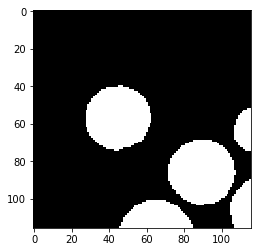

Prediction  11


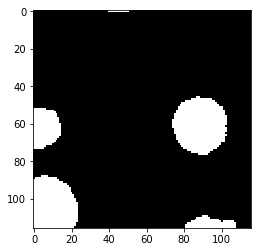

Label  11


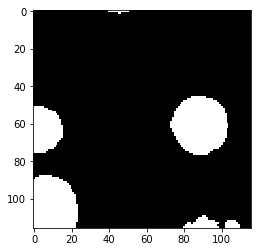

Prediction  12


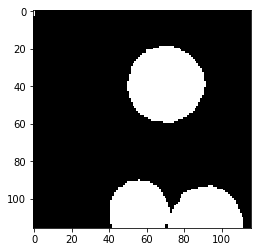

Label  12


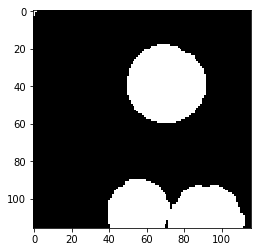

Prediction  13


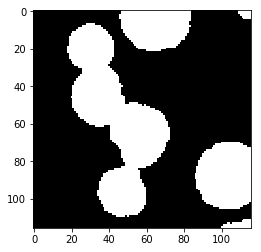

Label  13


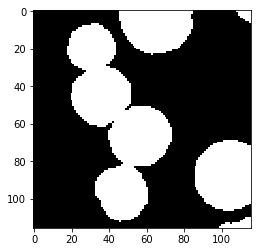

Prediction  14


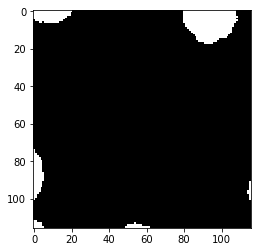

Label  14


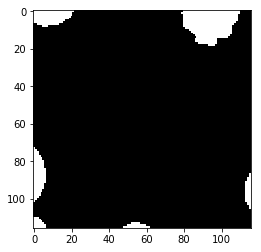

Prediction  15


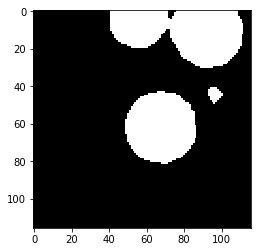

Label  15


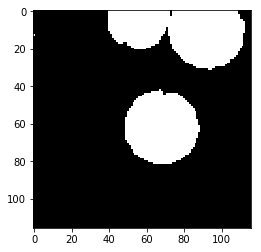

Prediction  16


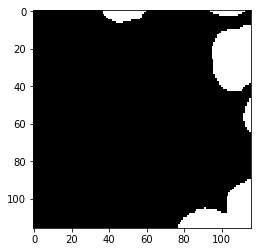

Label  16


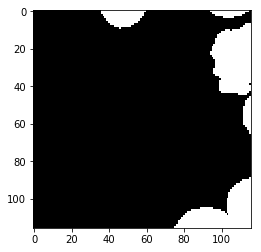

Prediction  17


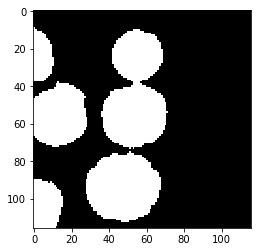

Label  17


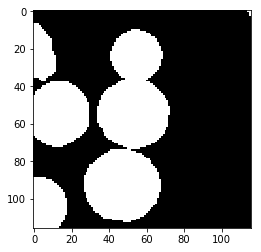

Prediction  18


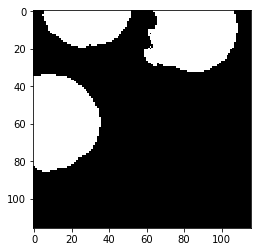

Label  18


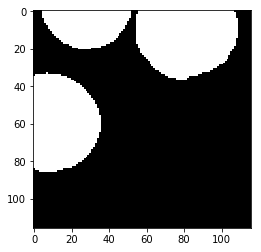

Prediction  19


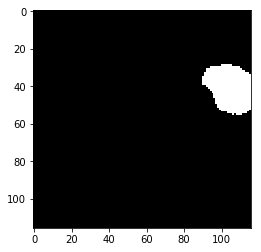

Label  19


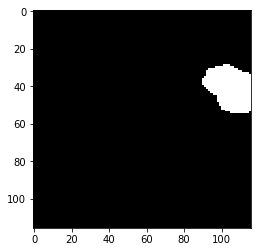

Prediction  20


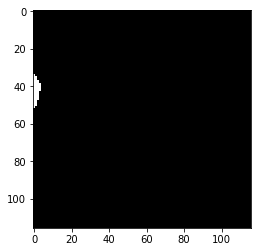

Label  20


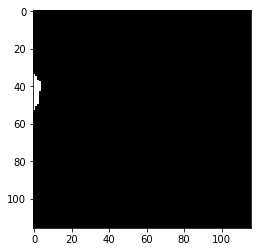

Prediction  21


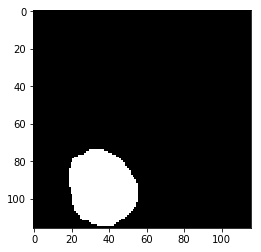

Label  21


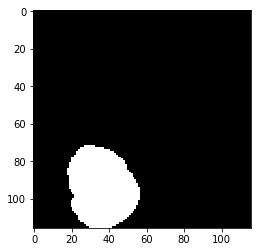

Prediction  22


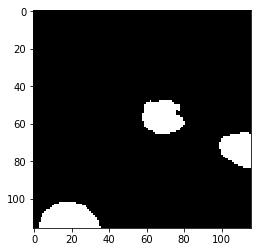

Label  22


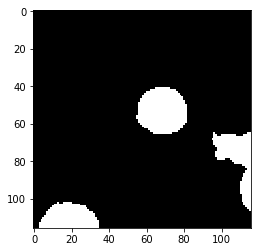

Prediction  23


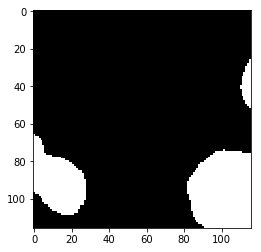

Label  23


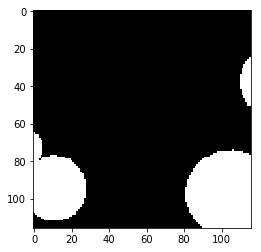

Prediction  24


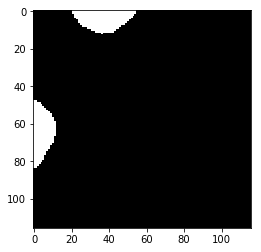

Label  24


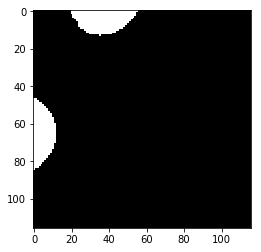

Prediction  25


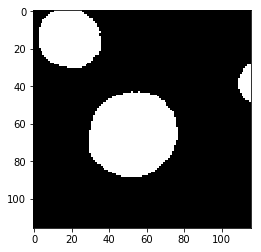

Label  25


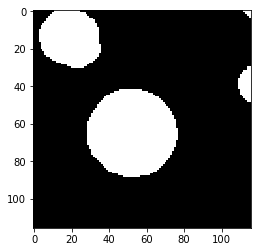

Prediction  26


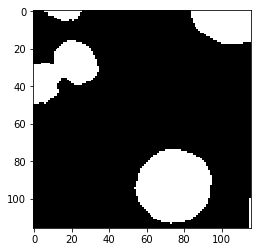

Label  26


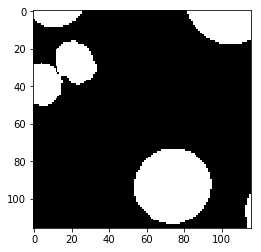

test_accuracy 0.965024611223
Batch: 8500 Train Loss value:0.0302419 Train Accuracy 0.980862652731
Prediction  0


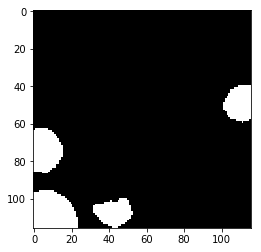

Label  0


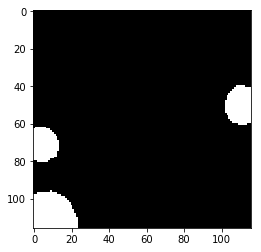

Prediction  1


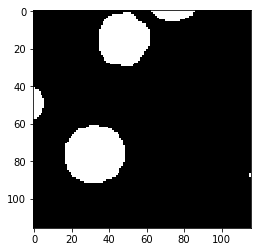

Label  1


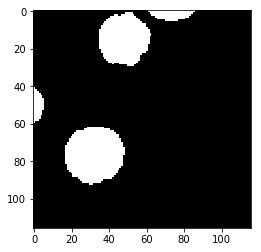

Prediction  2


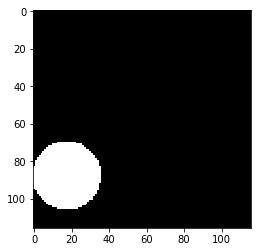

Label  2


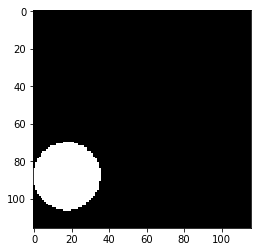

Prediction  3


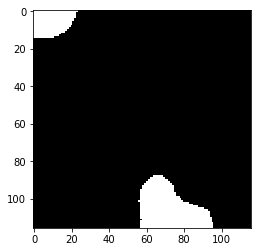

Label  3


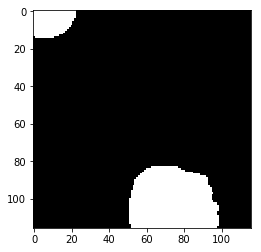

Prediction  4


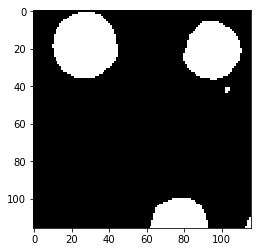

Label  4


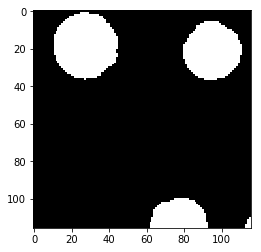

Prediction  5


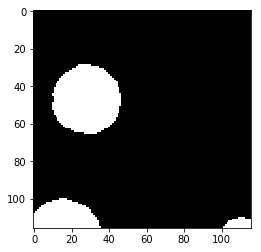

Label  5


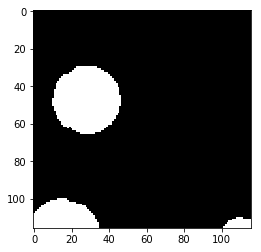

Prediction  6


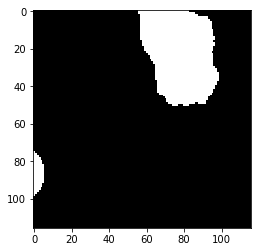

Label  6


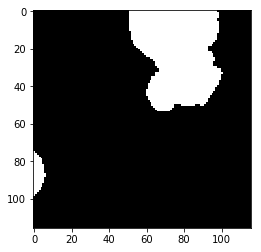

Prediction  7


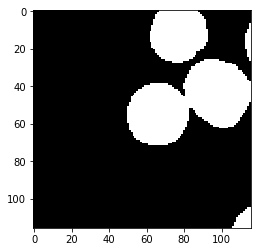

Label  7


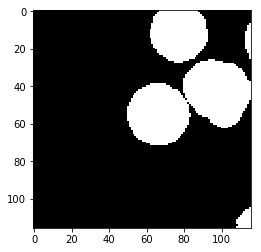

Prediction  8


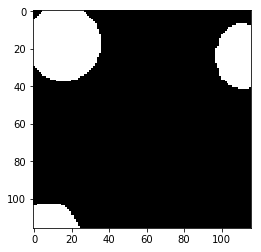

Label  8


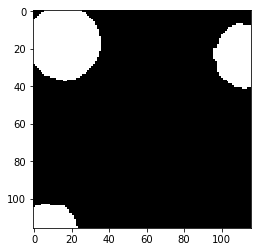

Prediction  9


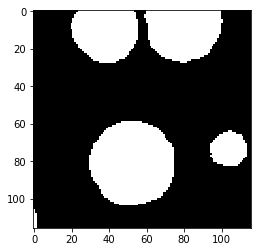

Label  9


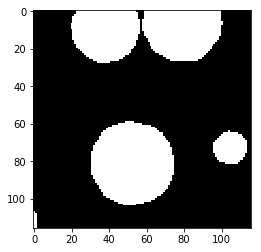

Prediction  10


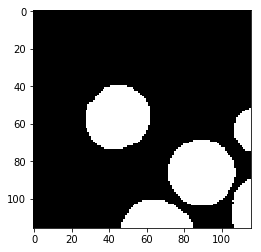

Label  10


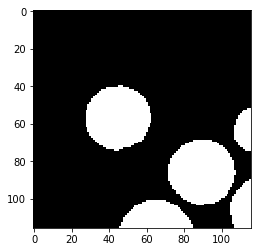

Prediction  11


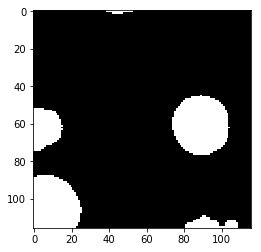

Label  11


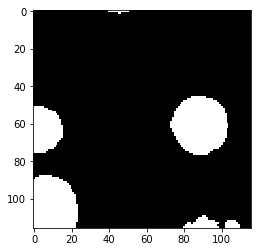

Prediction  12


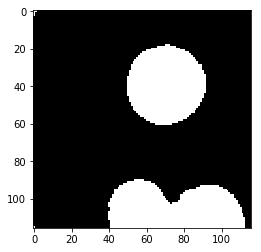

Label  12


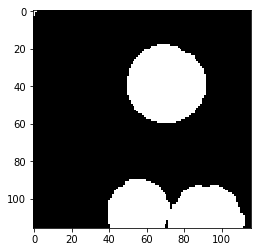

Prediction  13


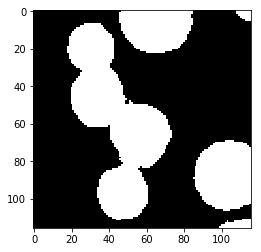

Label  13


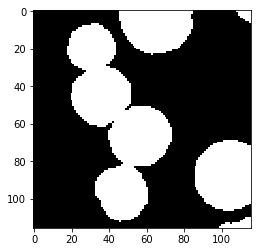

Prediction  14


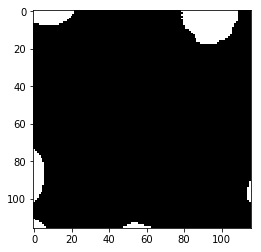

Label  14


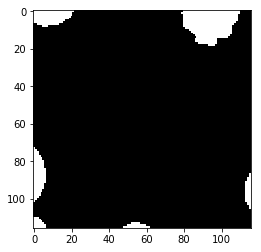

Prediction  15


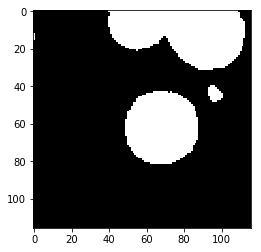

Label  15


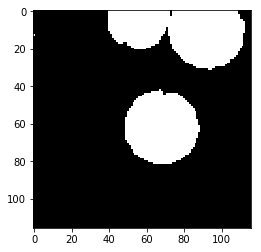

Prediction  16


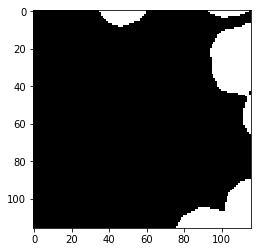

Label  16


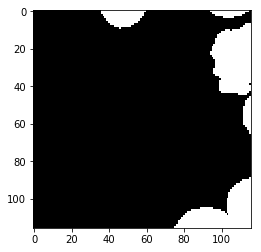

Prediction  17


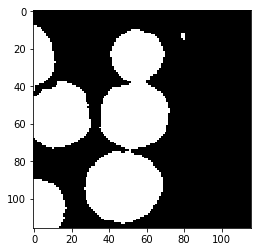

Label  17


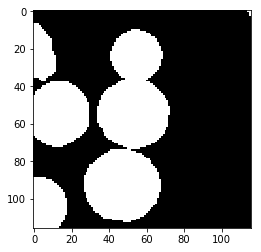

Prediction  18


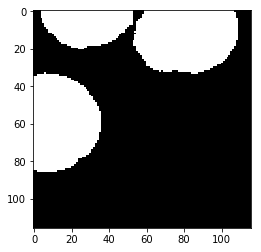

Label  18


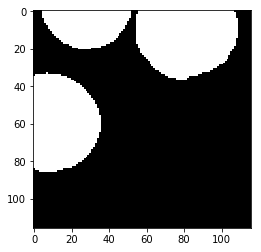

Prediction  19


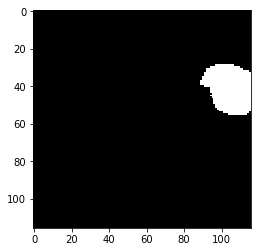

Label  19


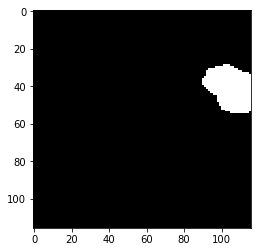

Prediction  20


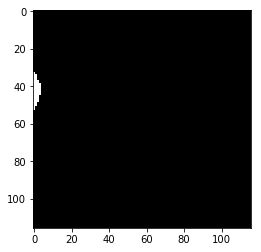

Label  20


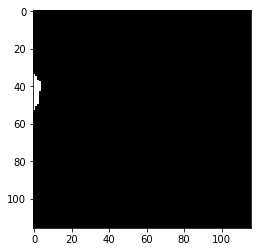

Prediction  21


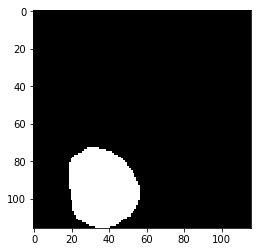

Label  21


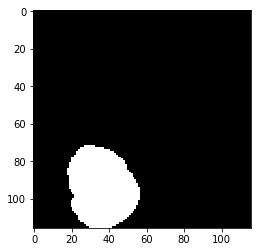

Prediction  22


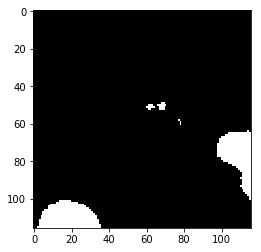

Label  22


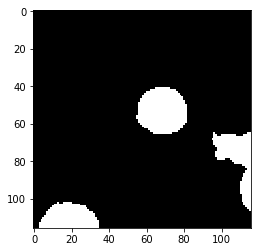

Prediction  23


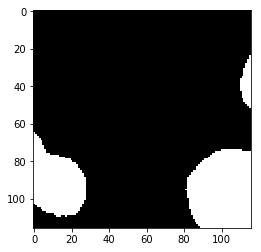

Label  23


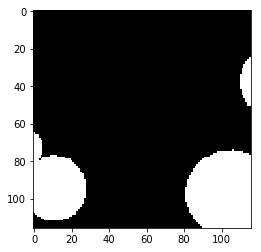

Prediction  24


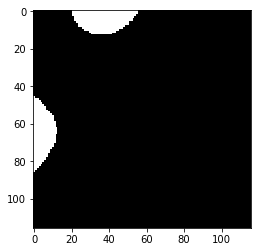

Label  24


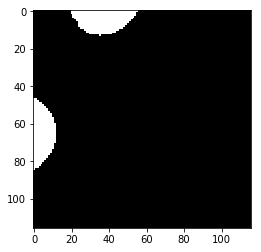

Prediction  25


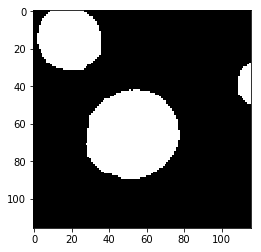

Label  25


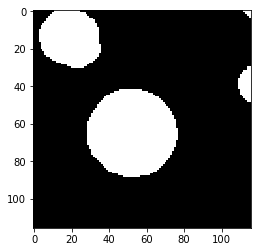

Prediction  26


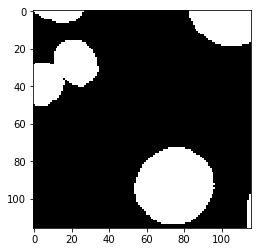

Label  26


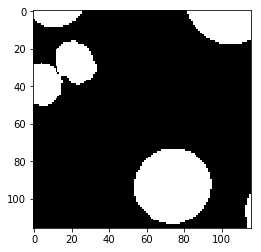

test_accuracy 0.972462015642
Batch: 9000 Train Loss value:6.5406e-06 Train Accuracy 1.0
Prediction  0


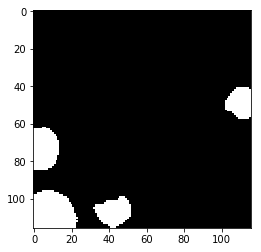

Label  0


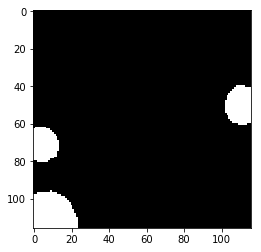

Prediction  1


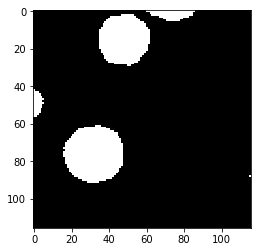

Label  1


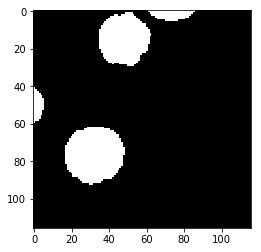

Prediction  2


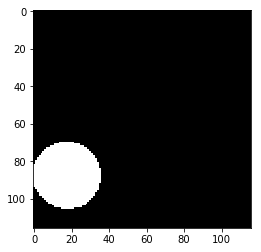

Label  2


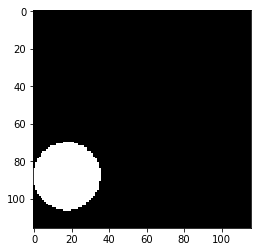

Prediction  3


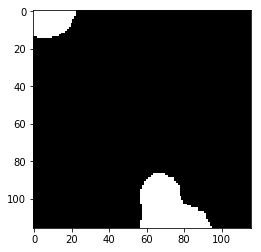

Label  3


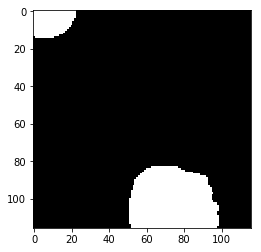

Prediction  4


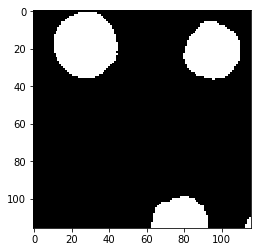

Label  4


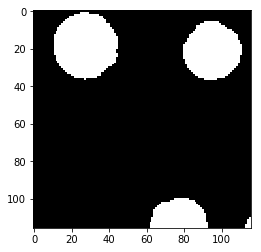

Prediction  5


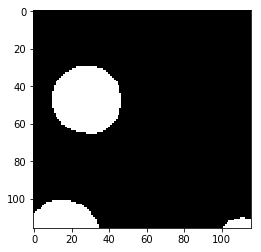

Label  5


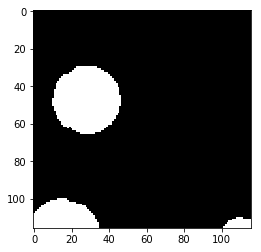

Prediction  6


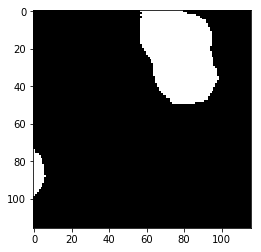

Label  6


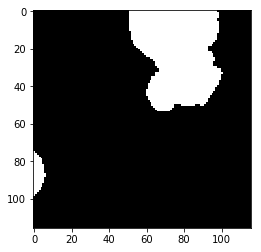

Prediction  7


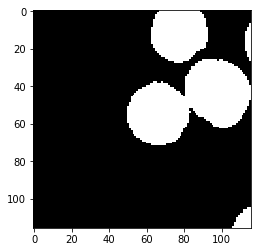

Label  7


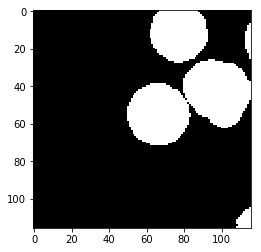

Prediction  8


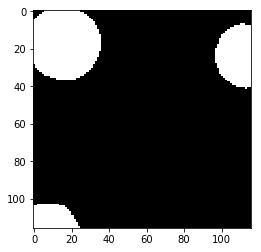

Label  8


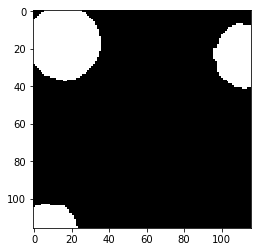

Prediction  9


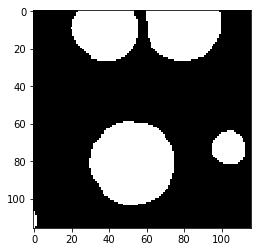

Label  9


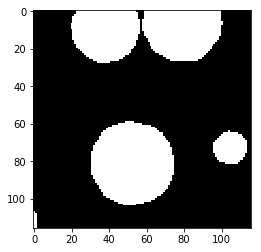

Prediction  10


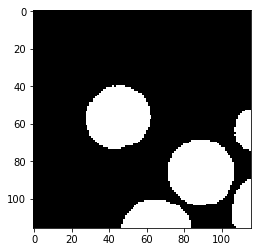

Label  10


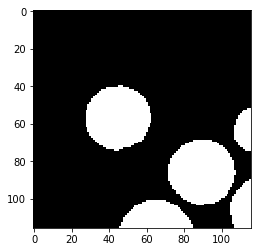

Prediction  11


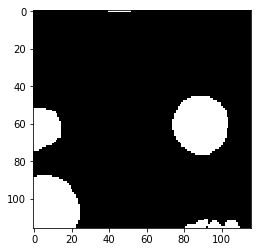

Label  11


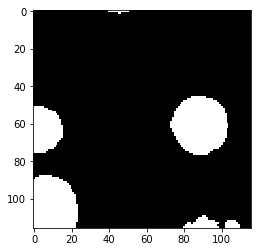

Prediction  12


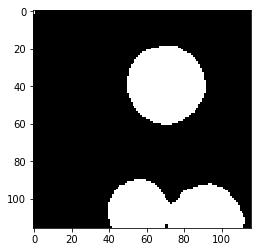

Label  12


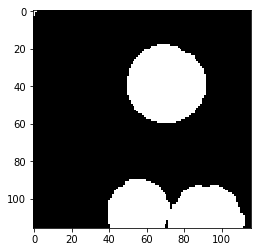

Prediction  13


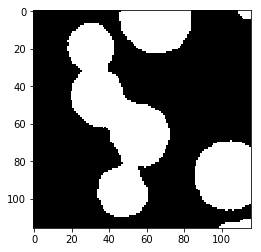

Label  13


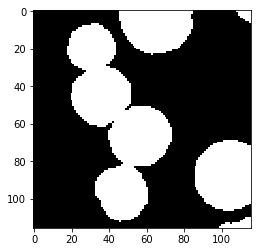

Prediction  14


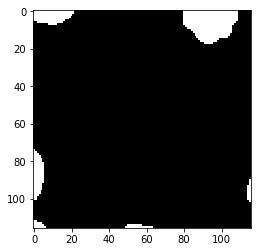

Label  14


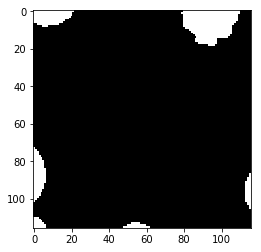

Prediction  15


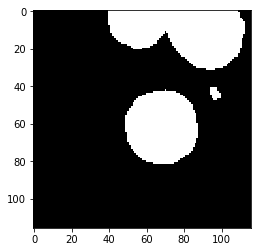

Label  15


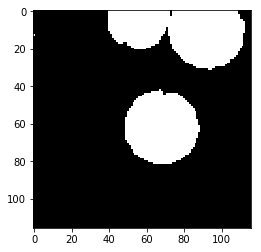

Prediction  16


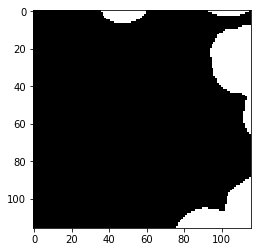

Label  16


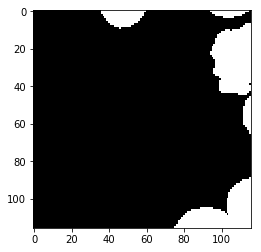

Prediction  17


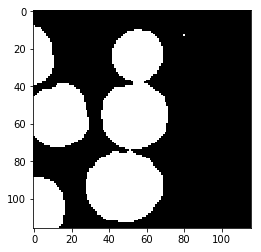

Label  17


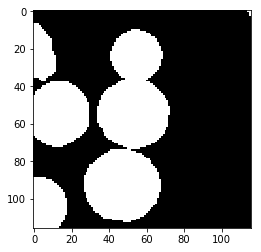

Prediction  18


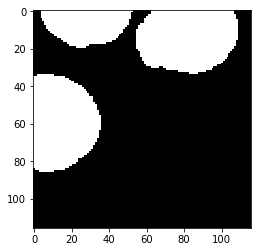

Label  18


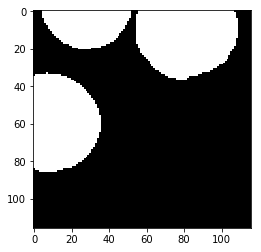

Prediction  19


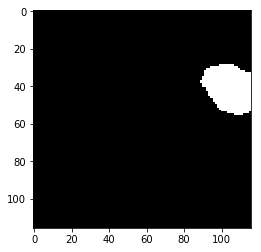

Label  19


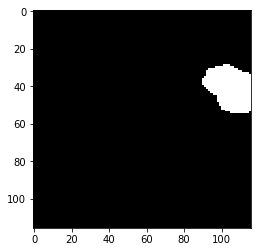

Prediction  20


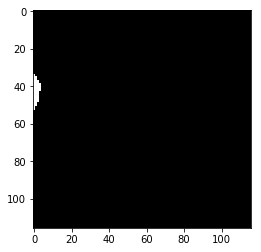

Label  20


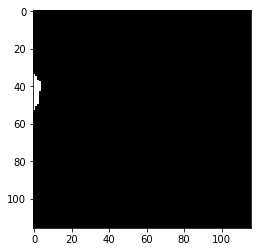

Prediction  21


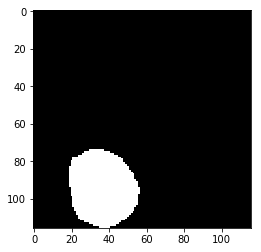

Label  21


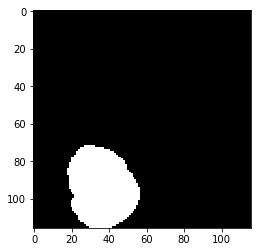

Prediction  22


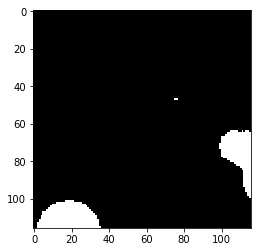

Label  22


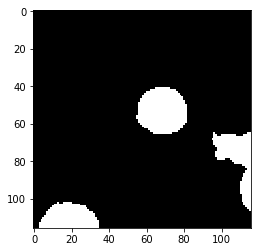

Prediction  23


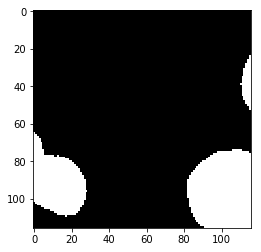

Label  23


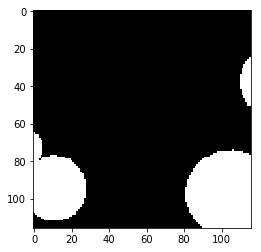

Prediction  24


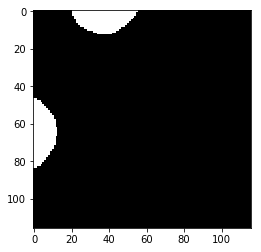

Label  24


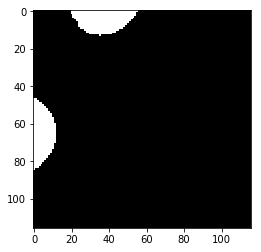

Prediction  25


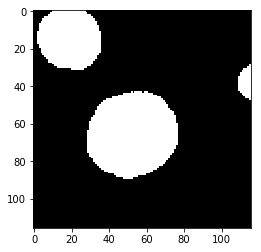

Label  25


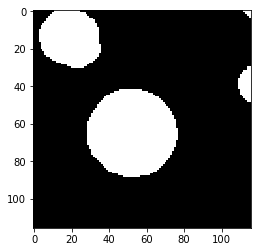

Prediction  26


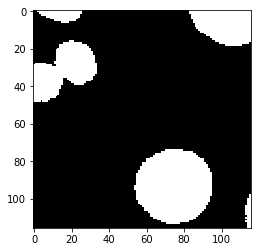

Label  26


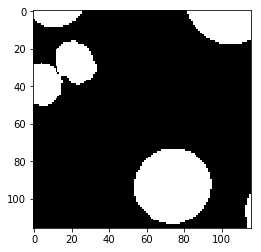

test_accuracy 0.97172225595
Batch: 9500 Train Loss value:0.0171161 Train Accuracy 0.984953532969
Prediction  0


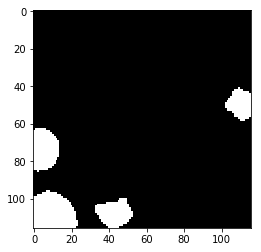

Label  0


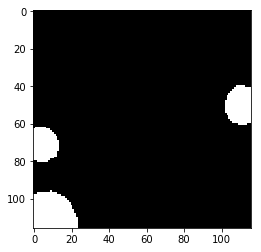

Prediction  1


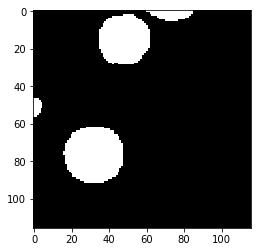

Label  1


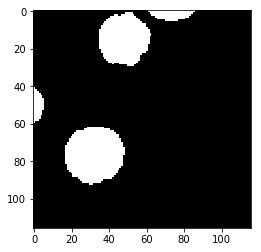

Prediction  2


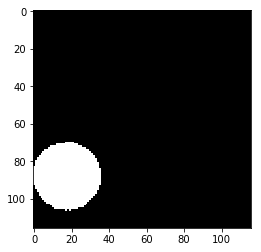

Label  2


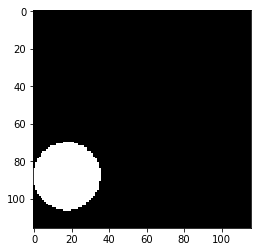

Prediction  3


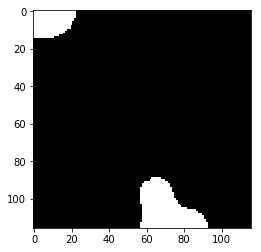

Label  3


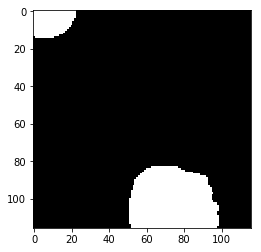

Prediction  4


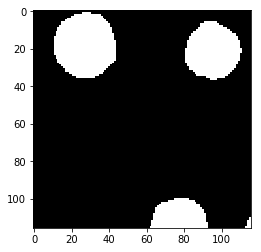

Label  4


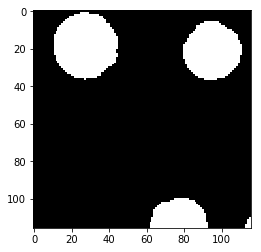

Prediction  5


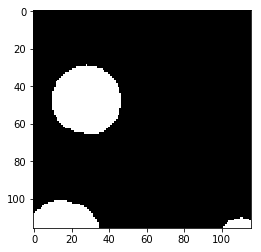

Label  5


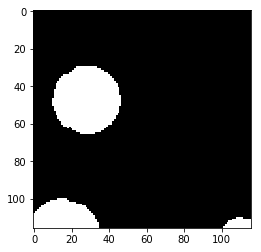

Prediction  6


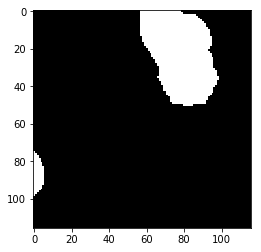

Label  6


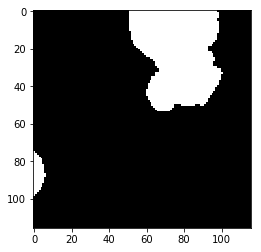

Prediction  7


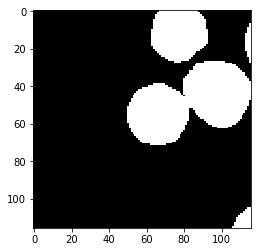

Label  7


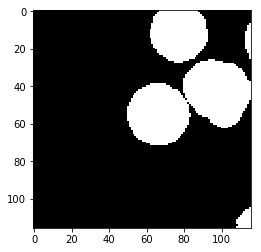

Prediction  8


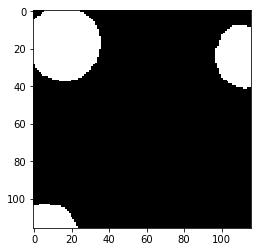

Label  8


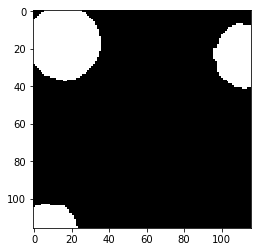

Prediction  9


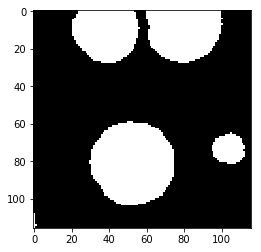

Label  9


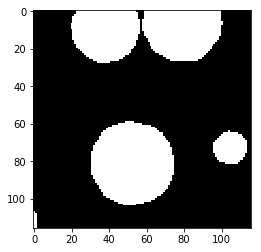

Prediction  10


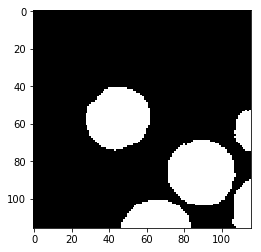

Label  10


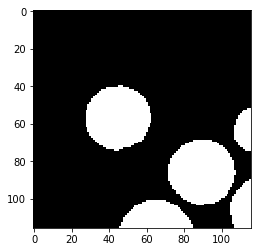

Prediction  11


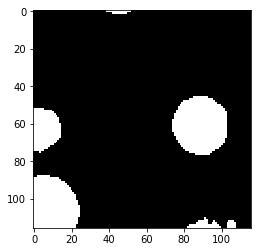

Label  11


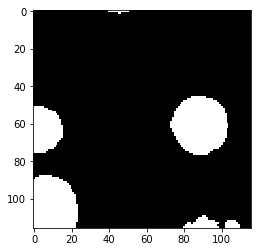

Prediction  12


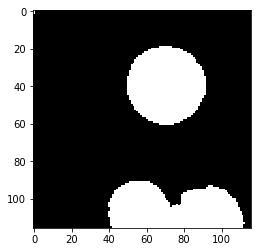

Label  12


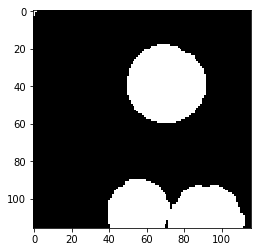

Prediction  13


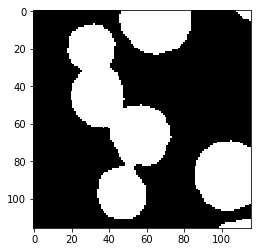

Label  13


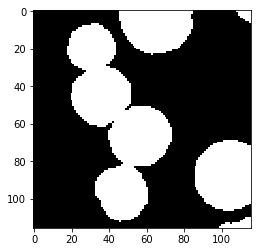

Prediction  14


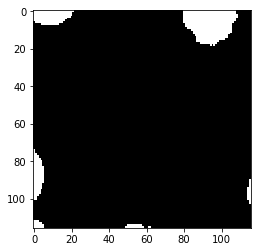

Label  14


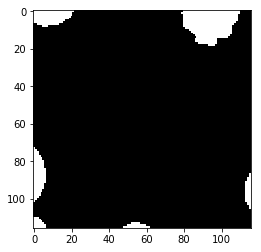

Prediction  15


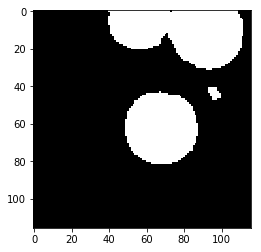

Label  15


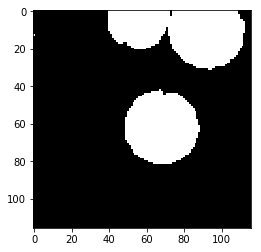

Prediction  16


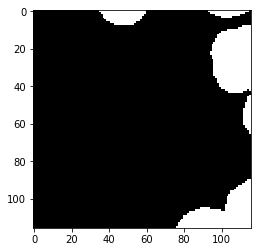

Label  16


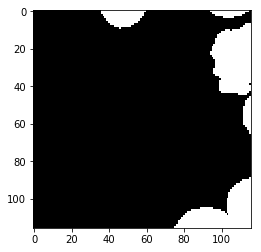

Prediction  17


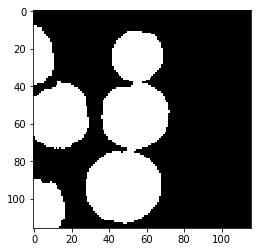

Label  17


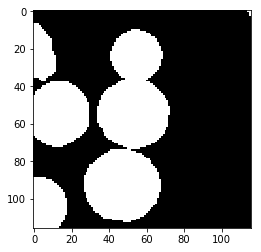

Prediction  18


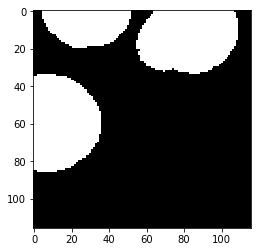

Label  18


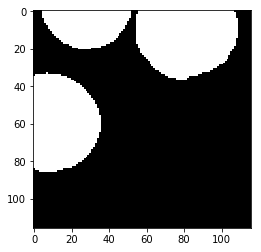

Prediction  19


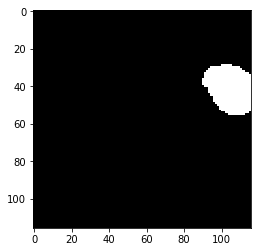

Label  19


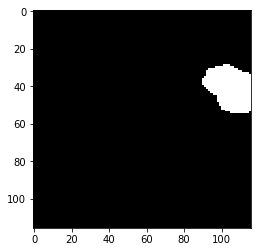

Prediction  20


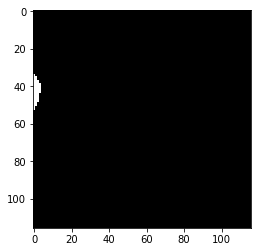

Label  20


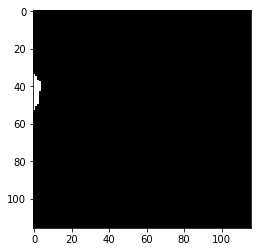

Prediction  21


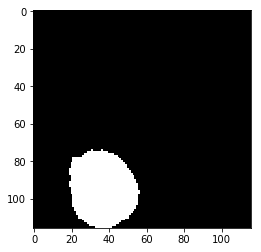

Label  21


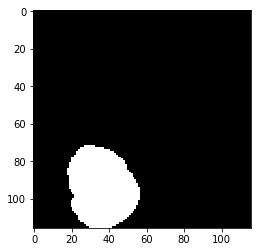

Prediction  22


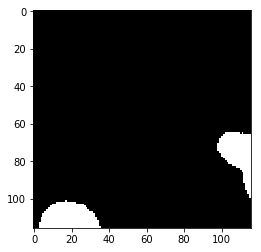

Label  22


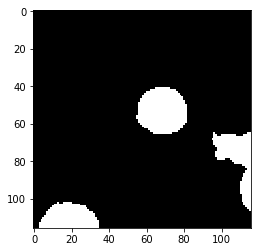

Prediction  23


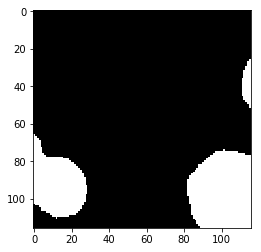

Label  23


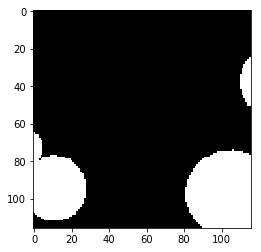

Prediction  24


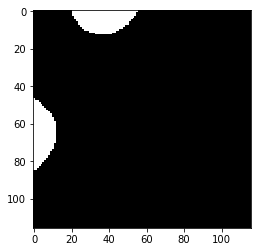

Label  24


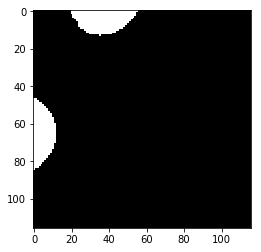

Prediction  25


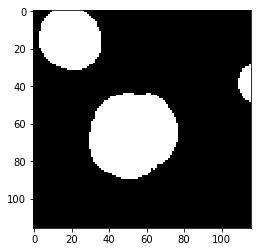

Label  25


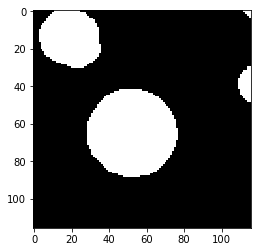

Prediction  26


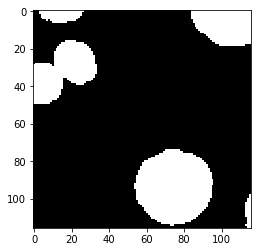

Label  26


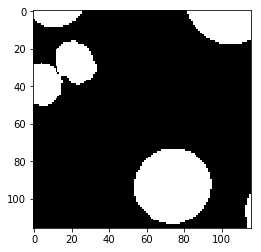

test_accuracy 0.97090696469
Batch: 10000 Train Loss value:0.0246669 Train Accuracy 0.97998822837
Prediction  0


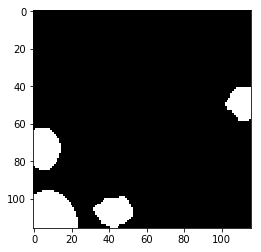

Label  0


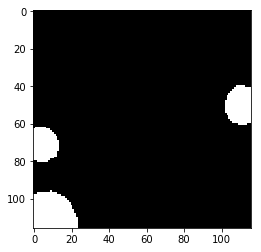

Prediction  1


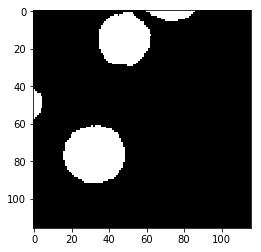

Label  1


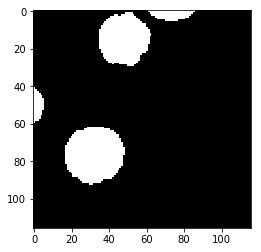

Prediction  2


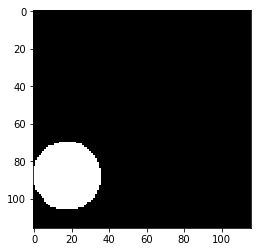

Label  2


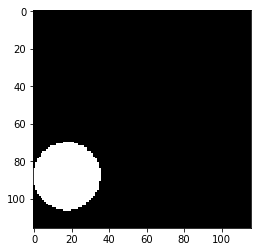

Prediction  3


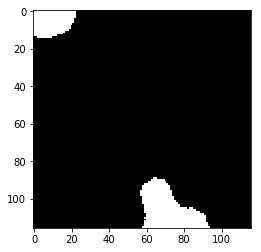

Label  3


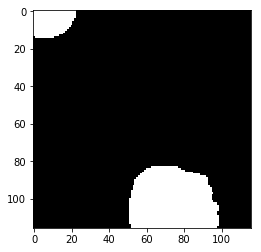

Prediction  4


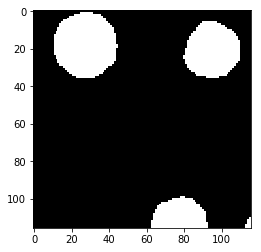

Label  4


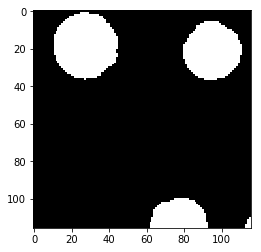

Prediction  5


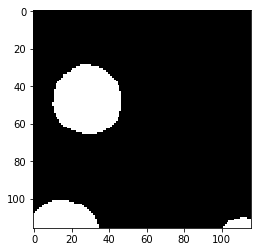

Label  5


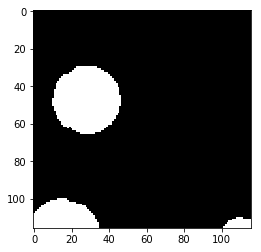

Prediction  6


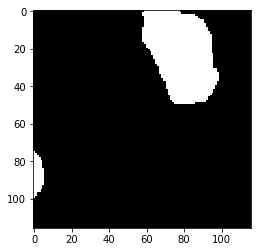

Label  6


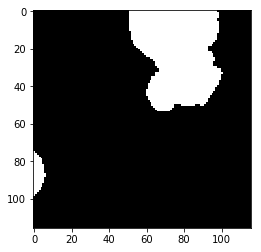

Prediction  7


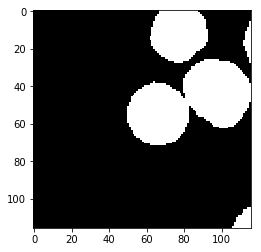

Label  7


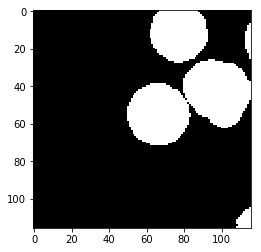

Prediction  8


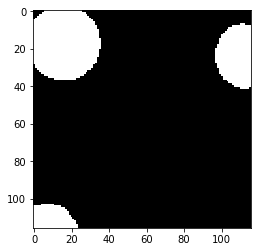

Label  8


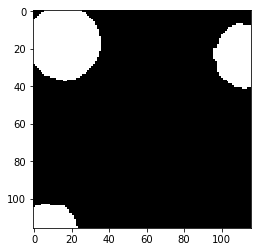

Prediction  9


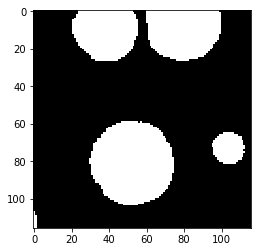

Label  9


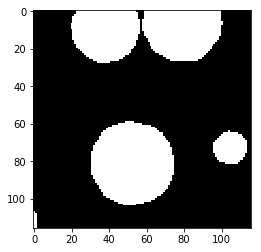

Prediction  10


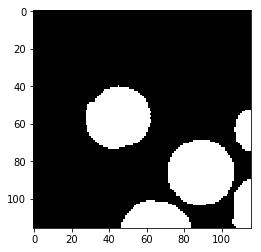

Label  10


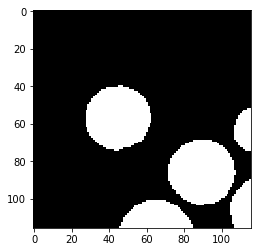

Prediction  11


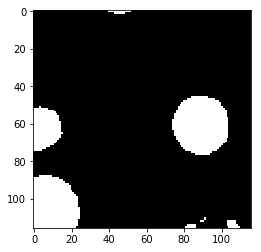

Label  11


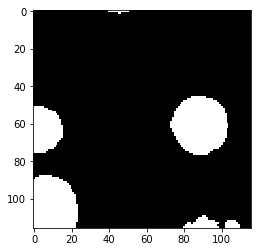

Prediction  12


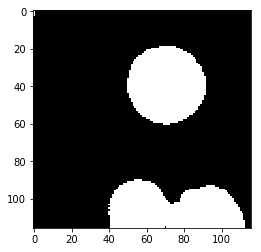

Label  12


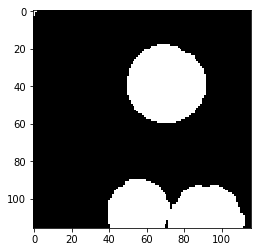

Prediction  13


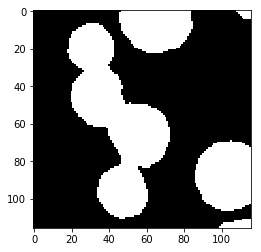

Label  13


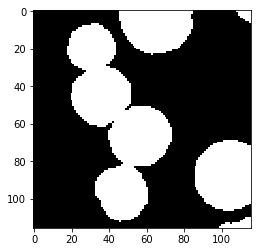

Prediction  14


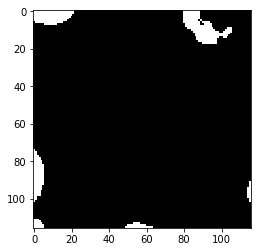

Label  14


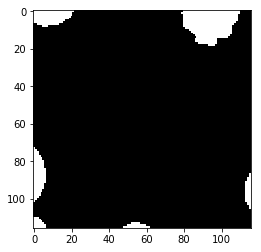

Prediction  15


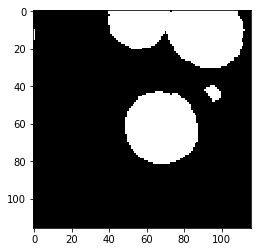

Label  15


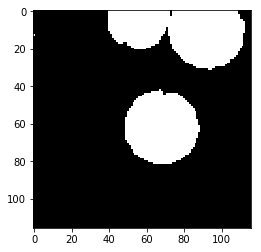

Prediction  16


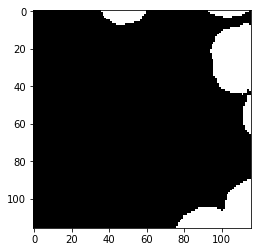

Label  16


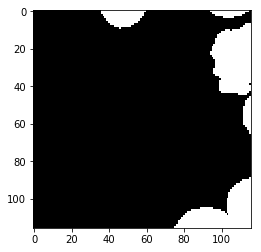

Prediction  17


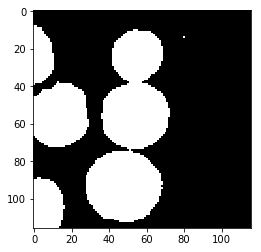

Label  17


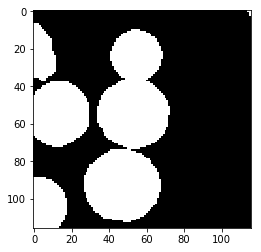

Prediction  18


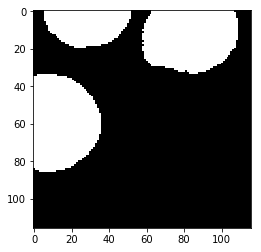

Label  18


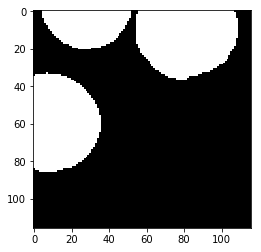

Prediction  19


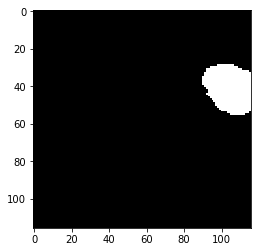

Label  19


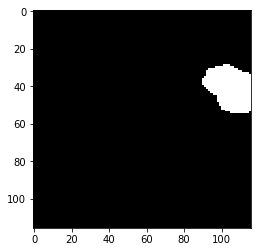

Prediction  20


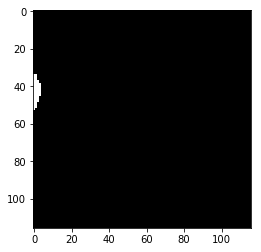

Label  20


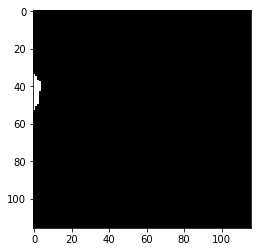

Prediction  21


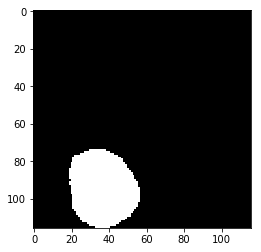

Label  21


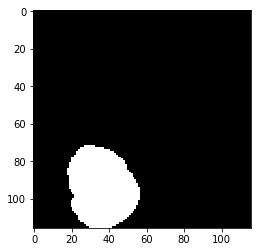

Prediction  22


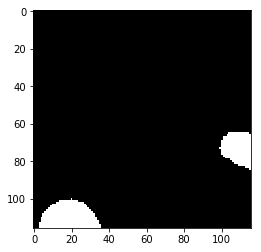

Label  22


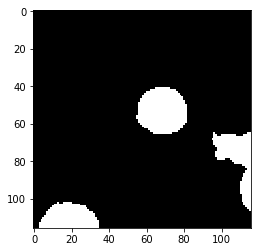

Prediction  23


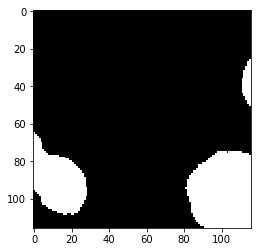

Label  23


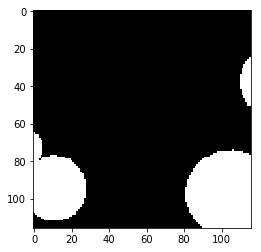

Prediction  24


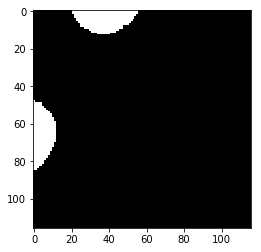

Label  24


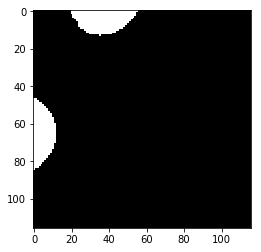

Prediction  25


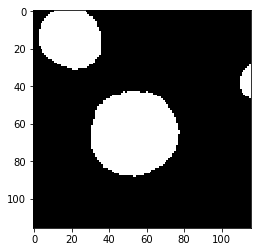

Label  25


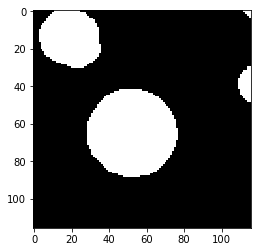

Prediction  26


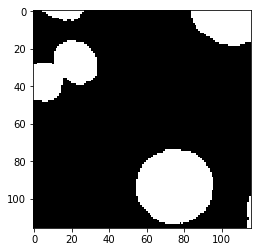

Label  26


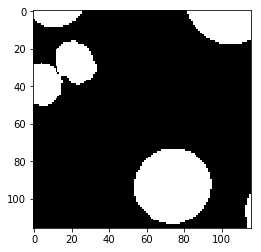

test_accuracy 0.968710943753
Batch: 10500 Train Loss value:0.0186867 Train Accuracy 0.985685826016
Prediction  0


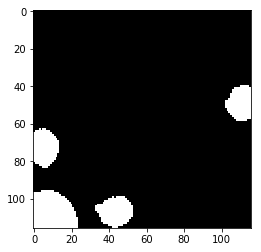

Label  0


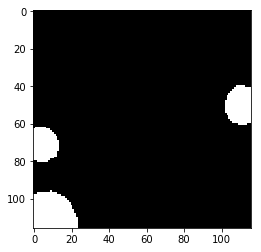

Prediction  1


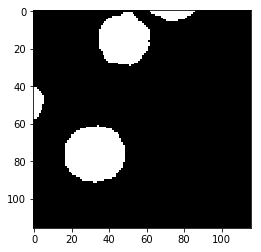

Label  1


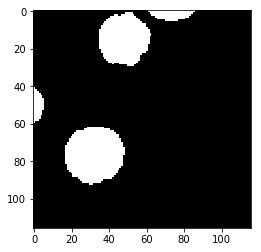

Prediction  2


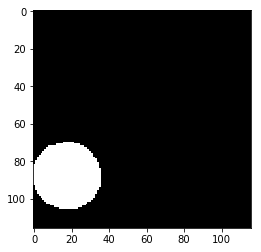

Label  2


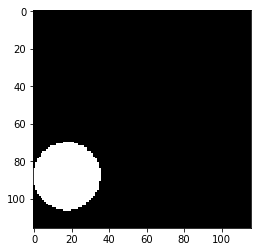

Prediction  3


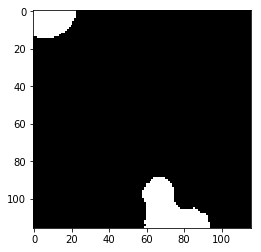

Label  3


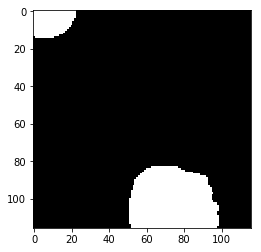

Prediction  4


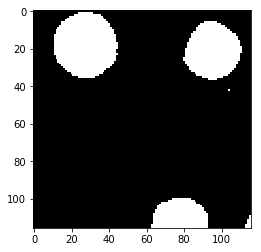

Label  4


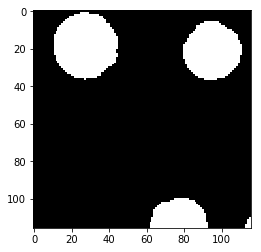

Prediction  5


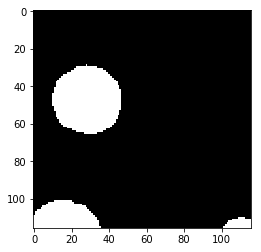

Label  5


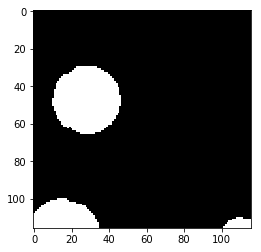

Prediction  6


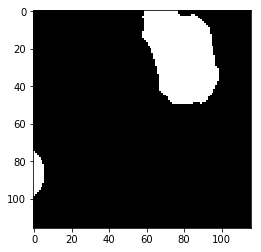

Label  6


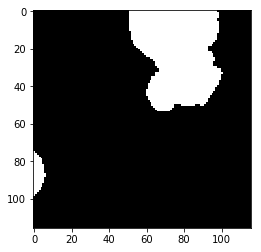

Prediction  7


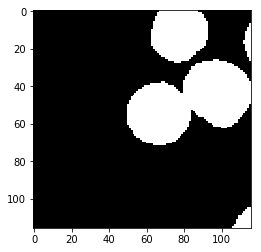

Label  7


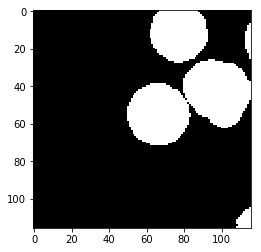

Prediction  8


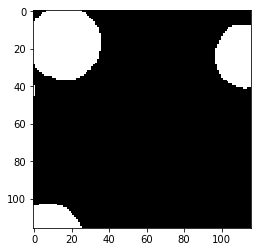

Label  8


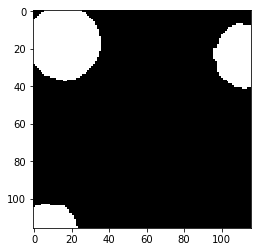

Prediction  9


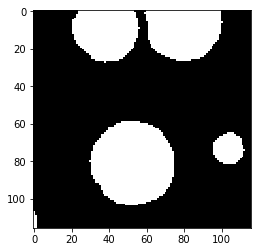

Label  9


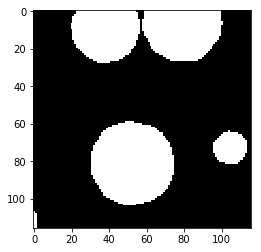

Prediction  10


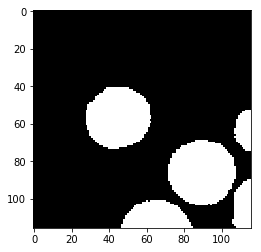

Label  10


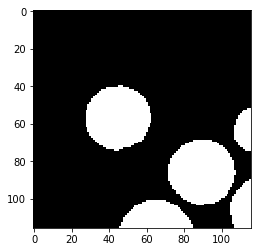

Prediction  11


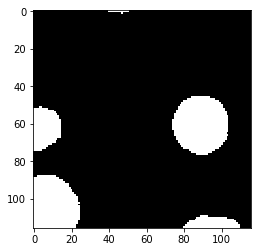

Label  11


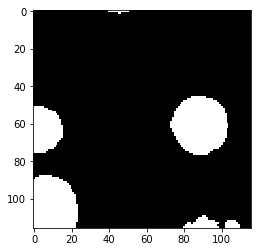

Prediction  12


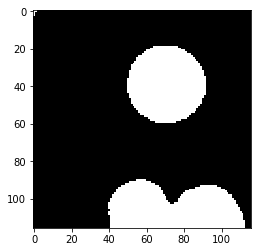

Label  12


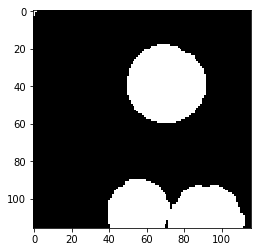

Prediction  13


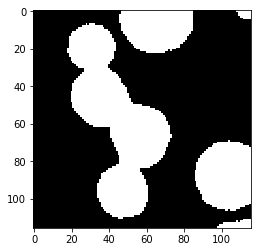

Label  13


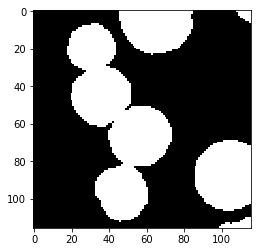

Prediction  14


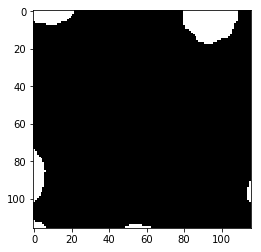

Label  14


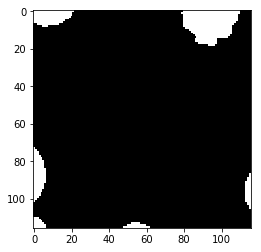

Prediction  15


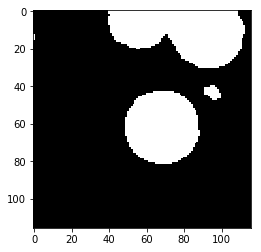

Label  15


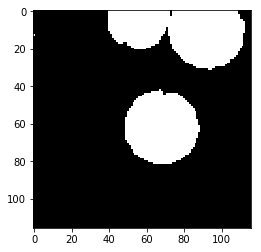

Prediction  16


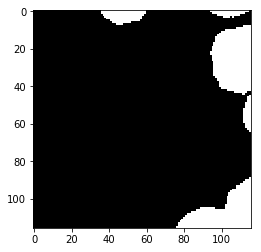

Label  16


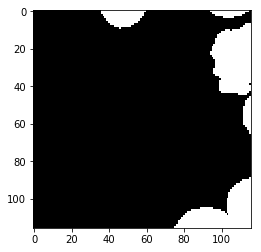

Prediction  17


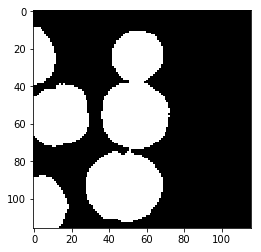

Label  17


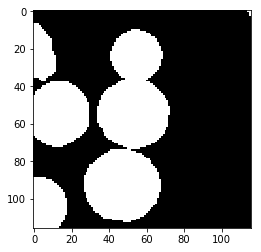

Prediction  18


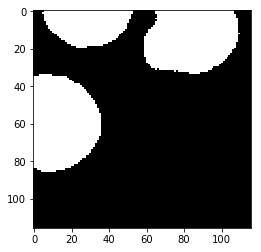

Label  18


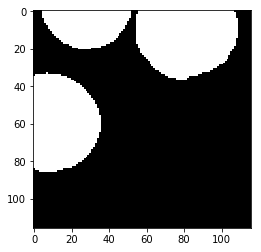

Prediction  19


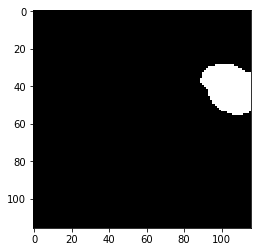

Label  19


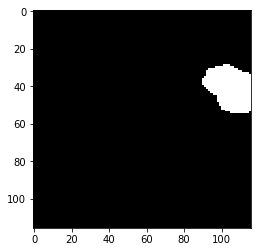

Prediction  20


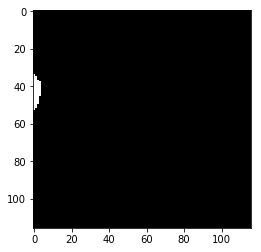

Label  20


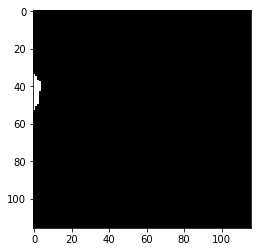

Prediction  21


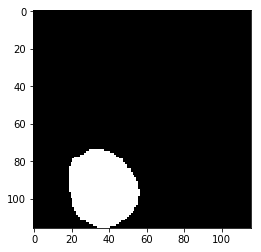

Label  21


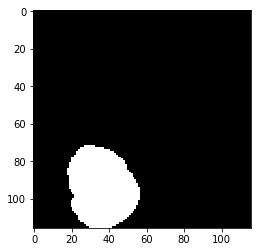

Prediction  22


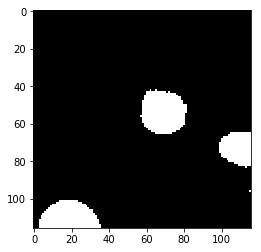

Label  22


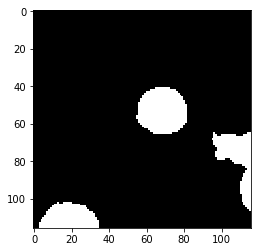

Prediction  23


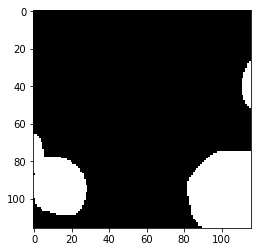

Label  23


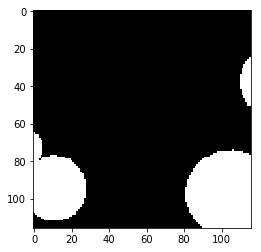

Prediction  24


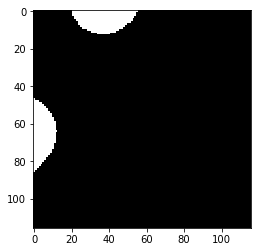

Label  24


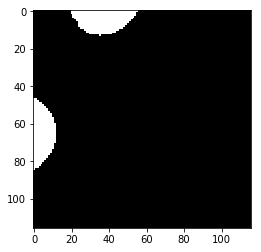

Prediction  25


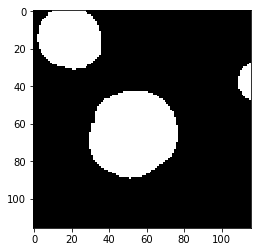

Label  25


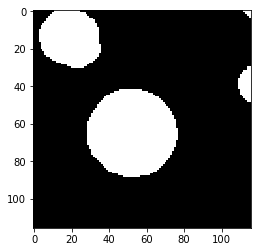

Prediction  26


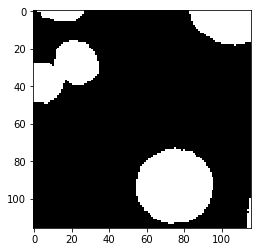

Label  26


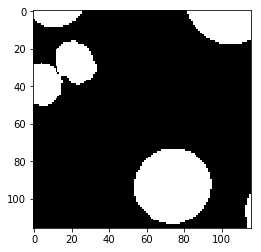

test_accuracy 0.972793820963
Batch: 11000 Train Loss value:0.0153632 Train Accuracy 0.985392843969
Prediction  0


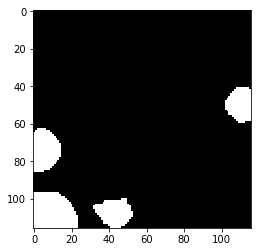

Label  0


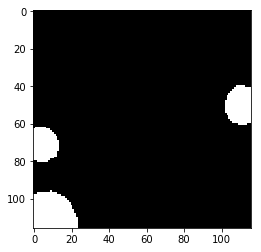

Prediction  1


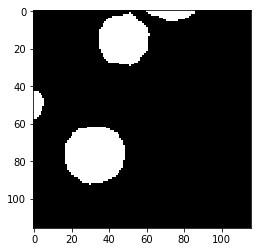

Label  1


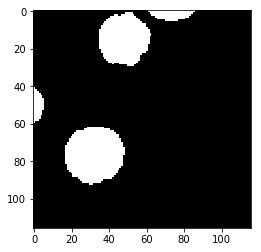

Prediction  2


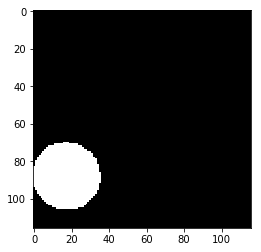

Label  2


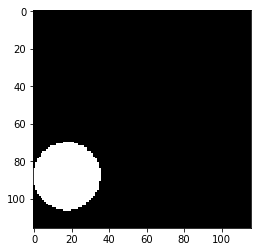

Prediction  3


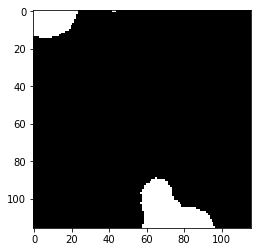

Label  3


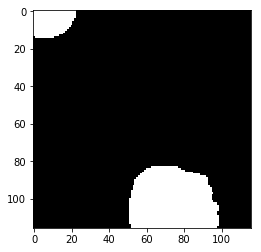

Prediction  4


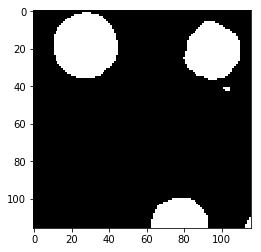

Label  4


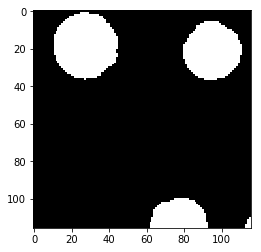

Prediction  5


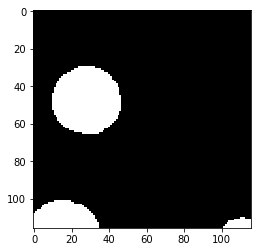

Label  5


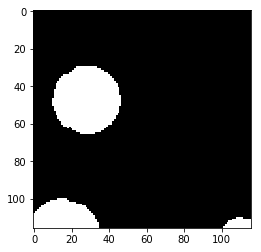

Prediction  6


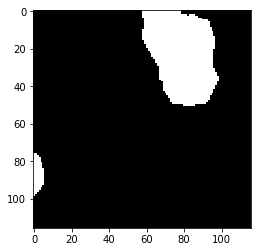

Label  6


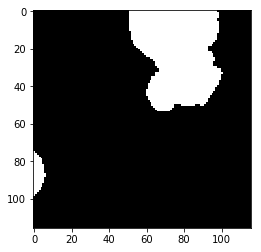

Prediction  7


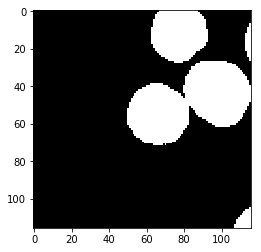

Label  7


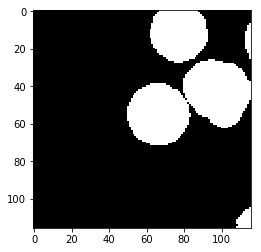

Prediction  8


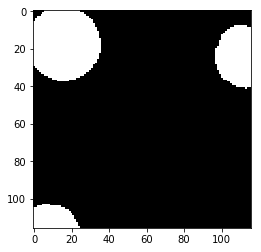

Label  8


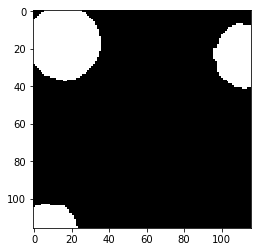

Prediction  9


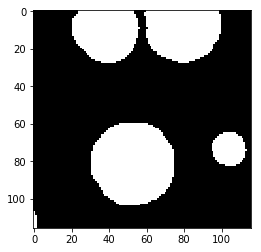

Label  9


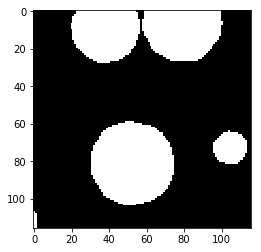

Prediction  10


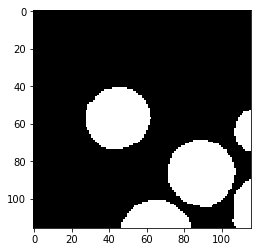

Label  10


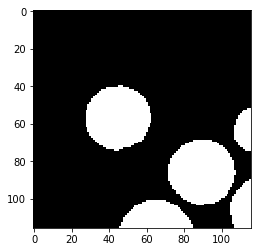

Prediction  11


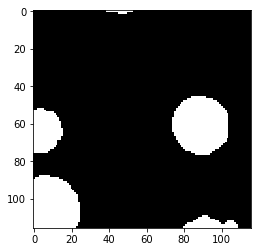

Label  11


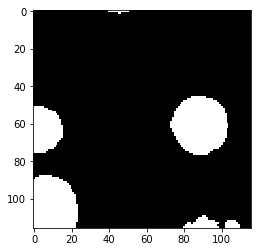

Prediction  12


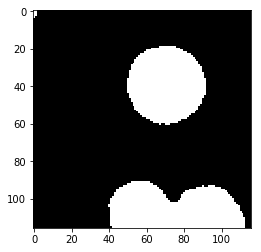

Label  12


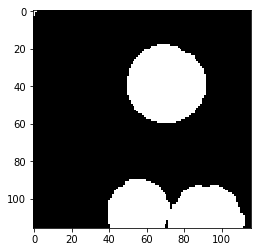

Prediction  13


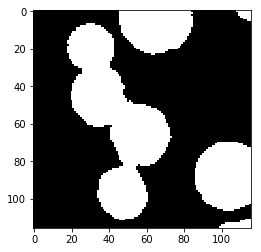

Label  13


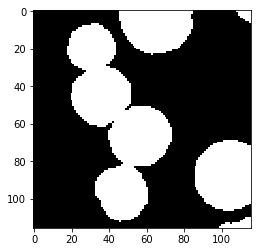

Prediction  14


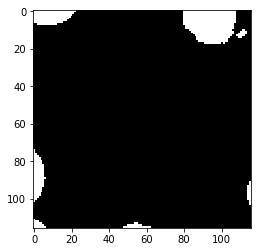

Label  14


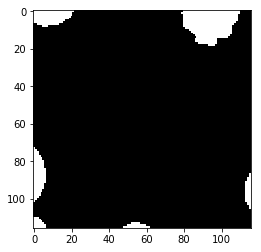

Prediction  15


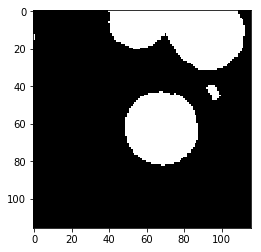

Label  15


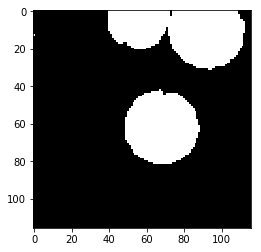

Prediction  16


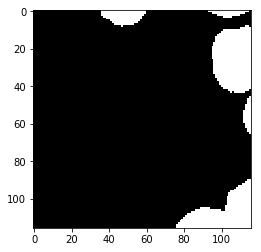

Label  16


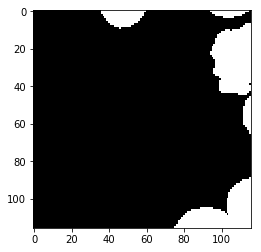

Prediction  17


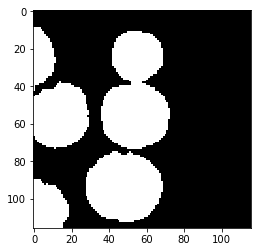

Label  17


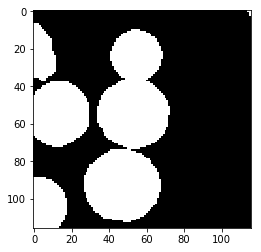

Prediction  18


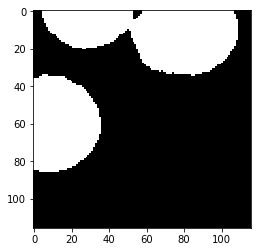

Label  18


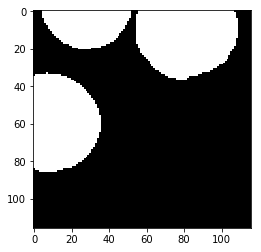

Prediction  19


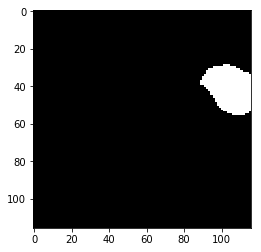

Label  19


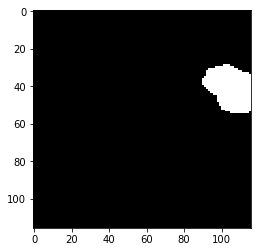

Prediction  20


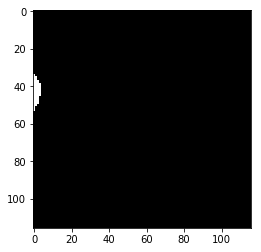

Label  20


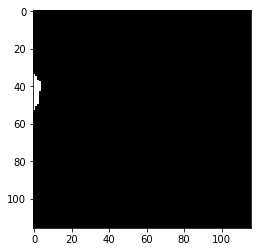

Prediction  21


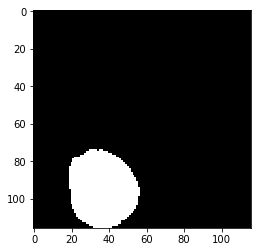

Label  21


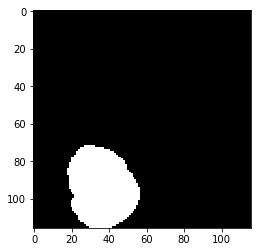

Prediction  22


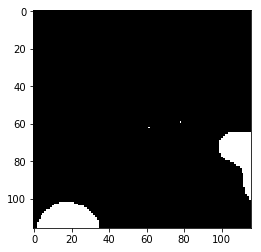

Label  22


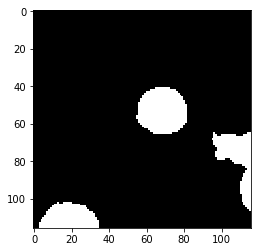

Prediction  23


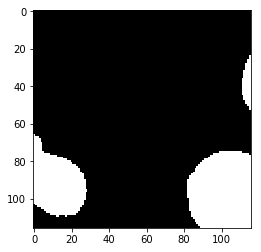

Label  23


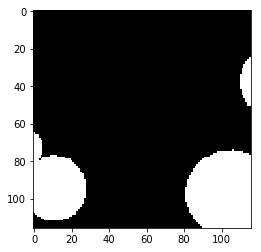

Prediction  24


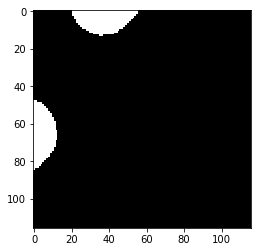

Label  24


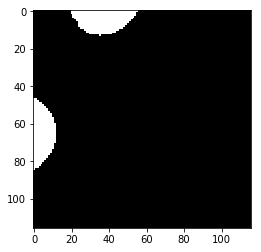

Prediction  25


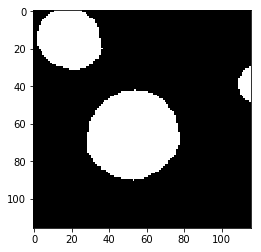

Label  25


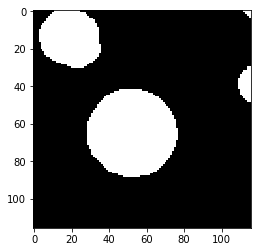

Prediction  26


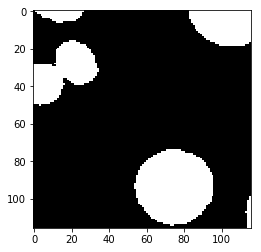

Label  26


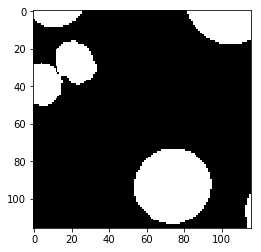

test_accuracy 0.971783585888
Batch: 11500 Train Loss value:0.0182635 Train Accuracy 0.989943803608
Prediction  0


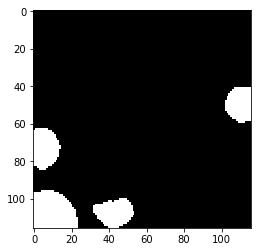

Label  0


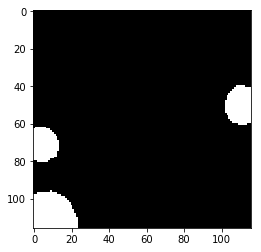

Prediction  1


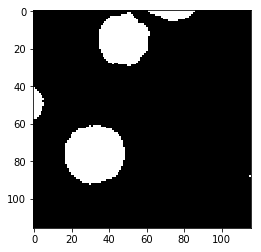

Label  1


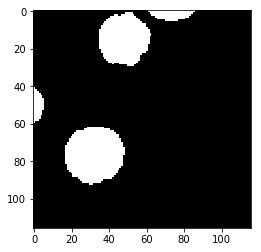

Prediction  2


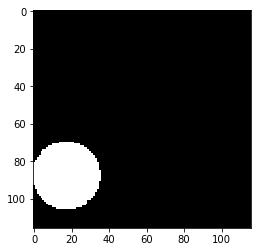

Label  2


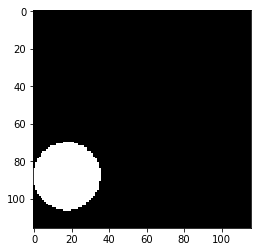

Prediction  3


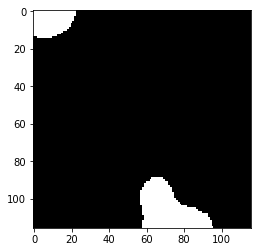

Label  3


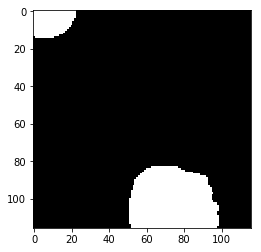

Prediction  4


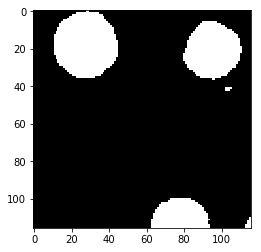

Label  4


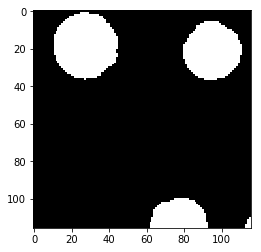

Prediction  5


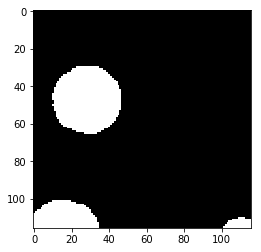

Label  5


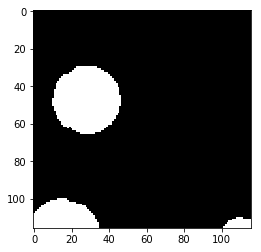

Prediction  6


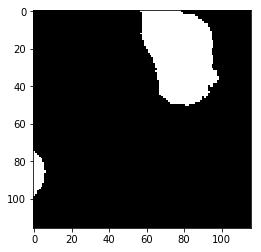

Label  6


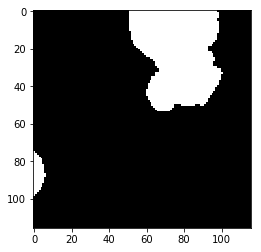

Prediction  7


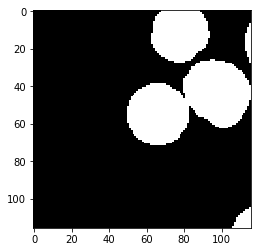

Label  7


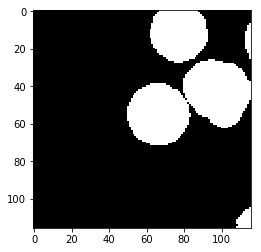

Prediction  8


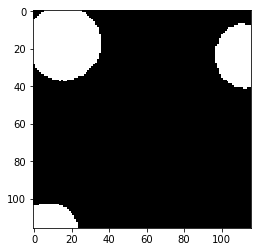

Label  8


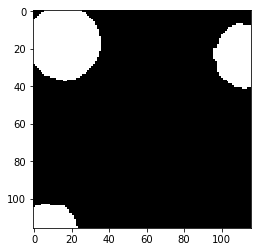

Prediction  9


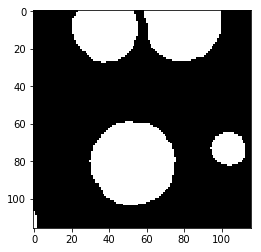

Label  9


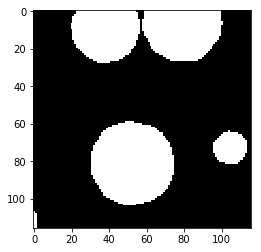

Prediction  10


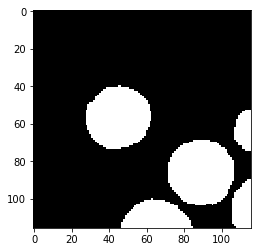

Label  10


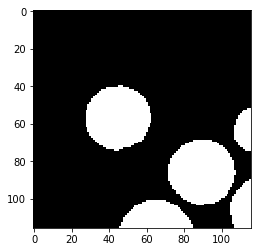

Prediction  11


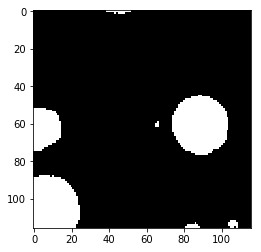

Label  11


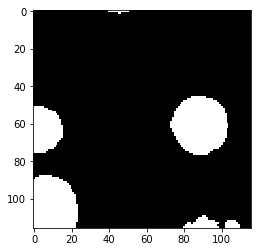

Prediction  12


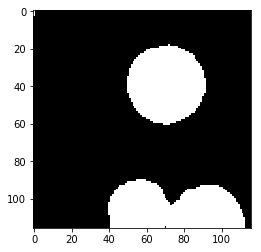

Label  12


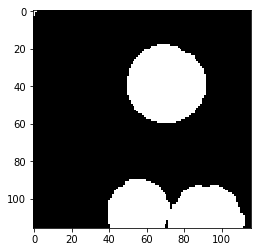

Prediction  13


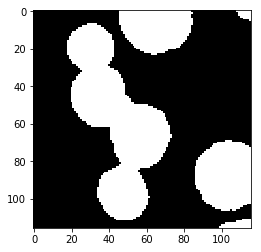

Label  13


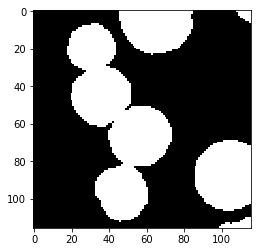

Prediction  14


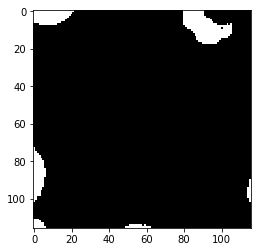

Label  14


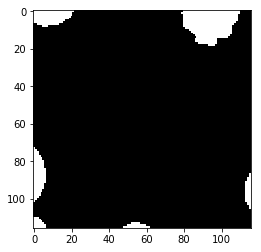

Prediction  15


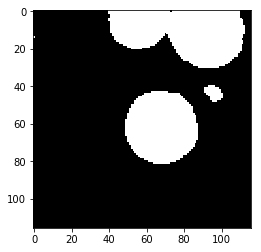

Label  15


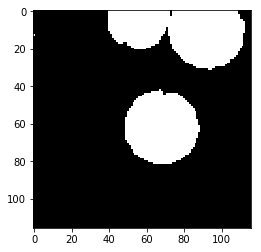

Prediction  16


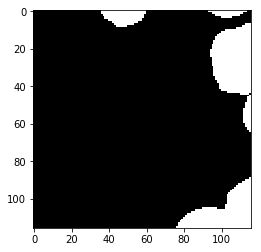

Label  16


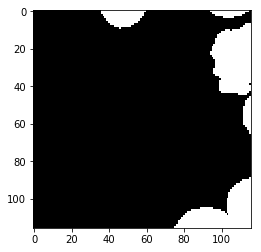

Prediction  17


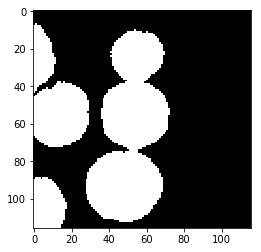

Label  17


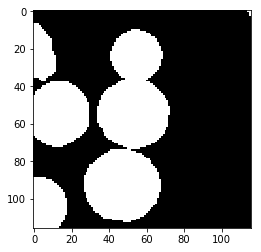

Prediction  18


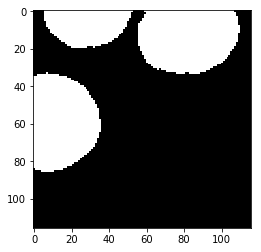

Label  18


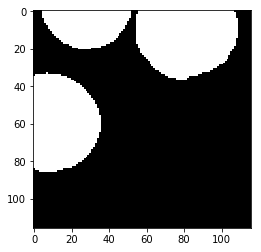

Prediction  19


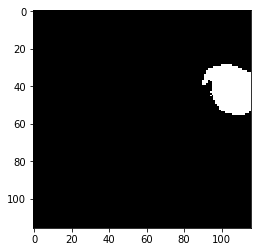

Label  19


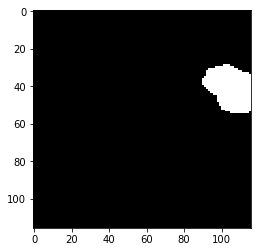

Prediction  20


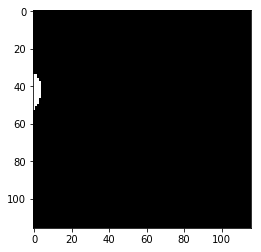

Label  20


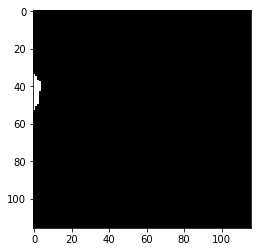

Prediction  21


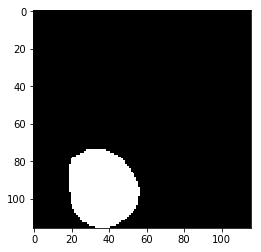

Label  21


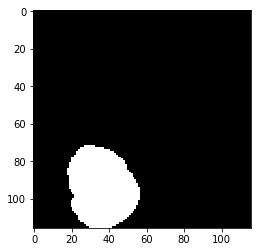

Prediction  22


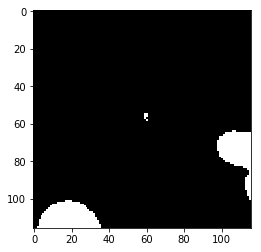

Label  22


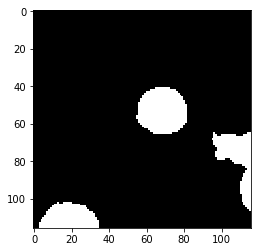

Prediction  23


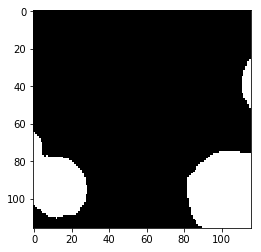

Label  23


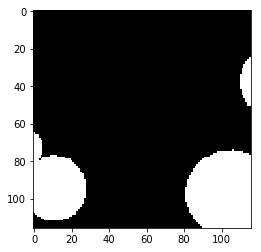

Prediction  24


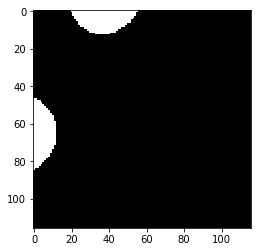

Label  24


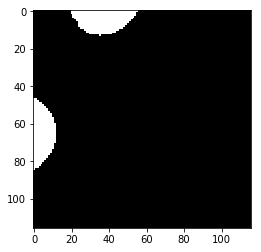

Prediction  25


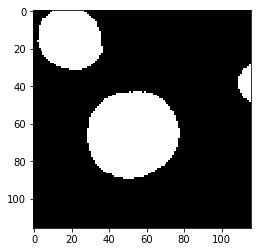

Label  25


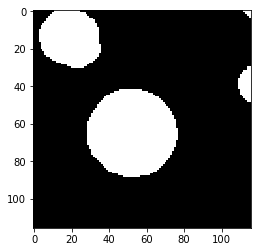

Prediction  26


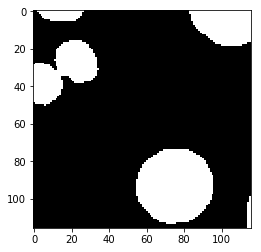

Label  26


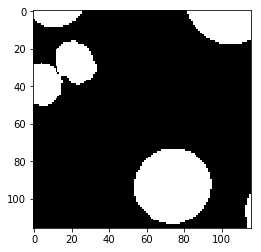

test_accuracy 0.97243021944
Batch: 12000 Train Loss value:0.0125757 Train Accuracy 0.990238130454
Prediction  0


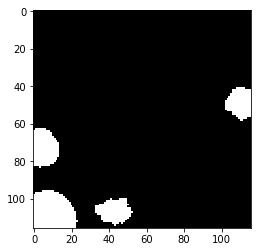

Label  0


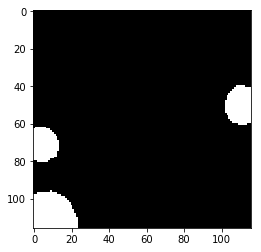

Prediction  1


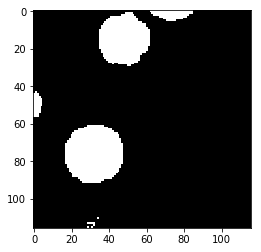

Label  1


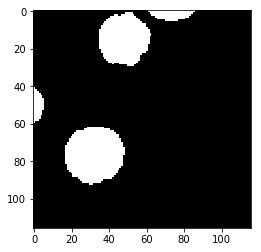

Prediction  2


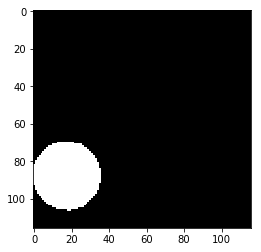

Label  2


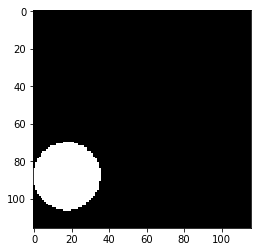

Prediction  3


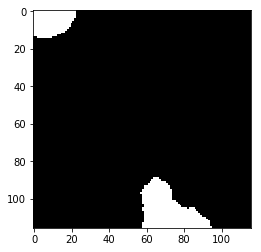

Label  3


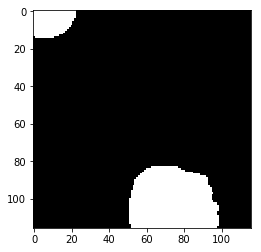

Prediction  4


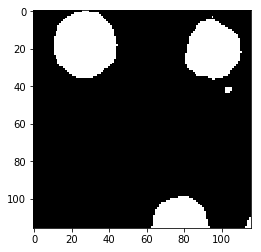

Label  4


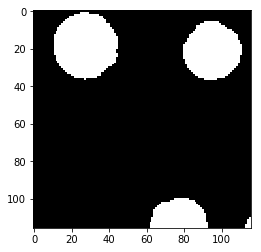

Prediction  5


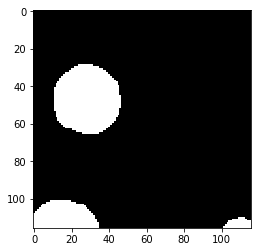

Label  5


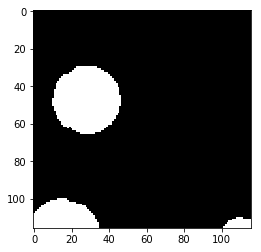

Prediction  6


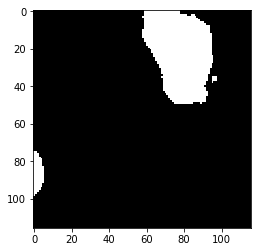

Label  6


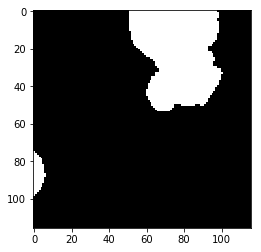

Prediction  7


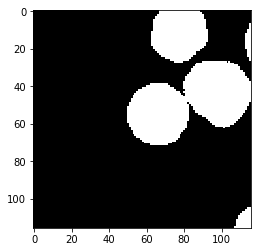

Label  7


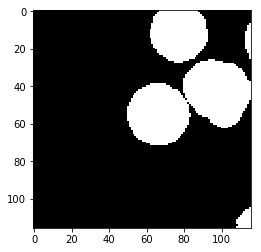

Prediction  8


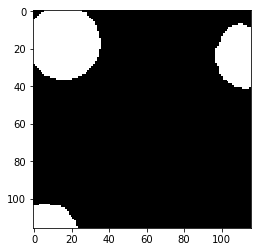

Label  8


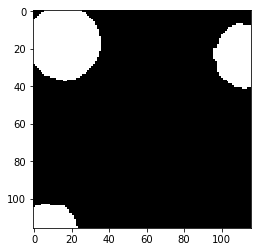

Prediction  9


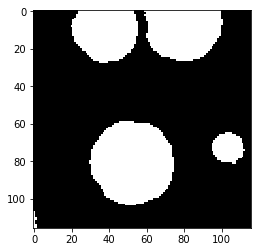

Label  9


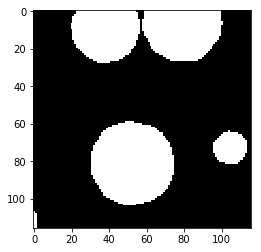

Prediction  10


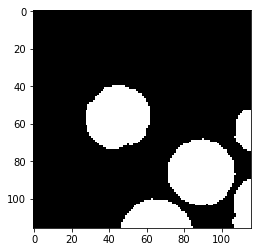

Label  10


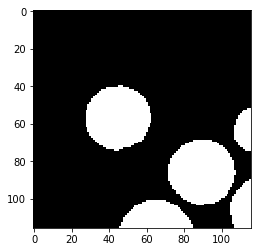

Prediction  11


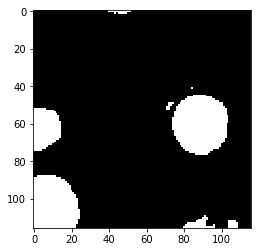

Label  11


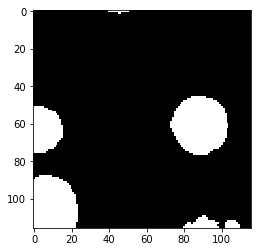

Prediction  12


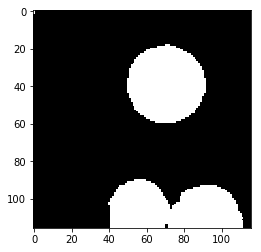

Label  12


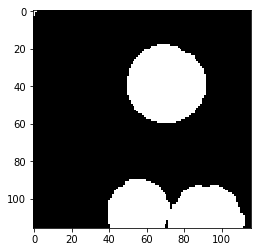

Prediction  13


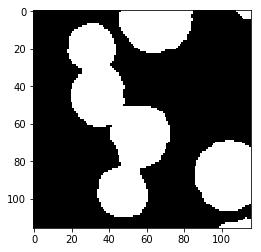

Label  13


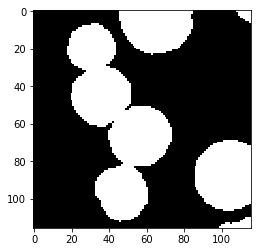

Prediction  14


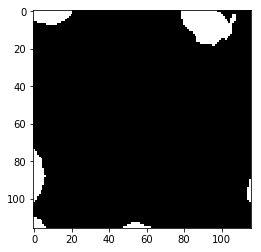

Label  14


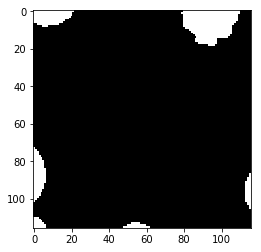

Prediction  15


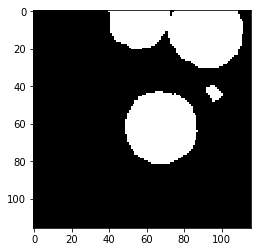

Label  15


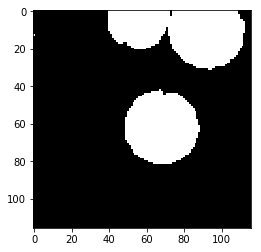

Prediction  16


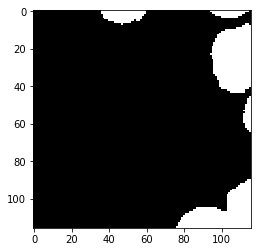

Label  16


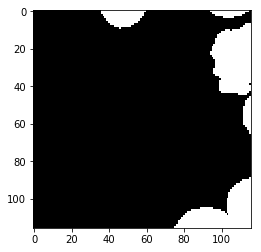

Prediction  17


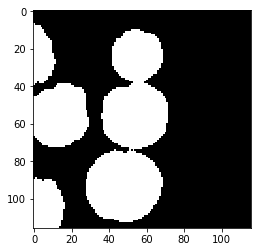

Label  17


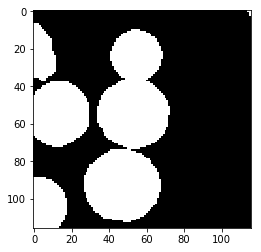

Prediction  18


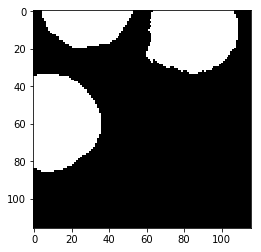

Label  18


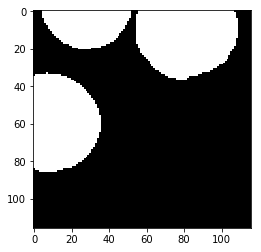

Prediction  19


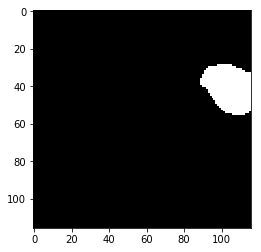

Label  19


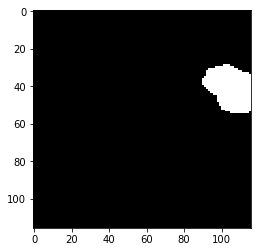

Prediction  20


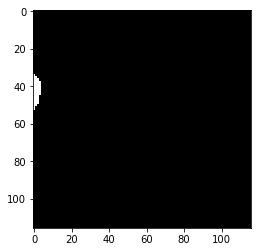

Label  20


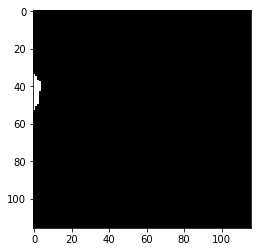

Prediction  21


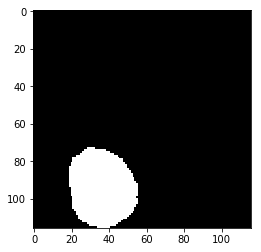

Label  21


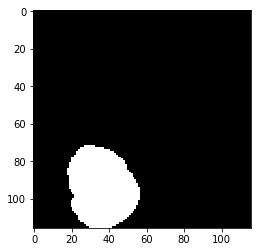

Prediction  22


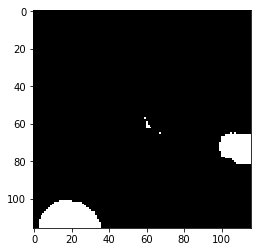

Label  22


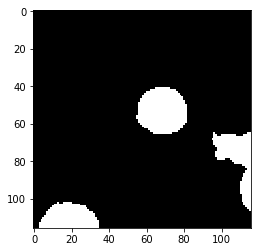

Prediction  23


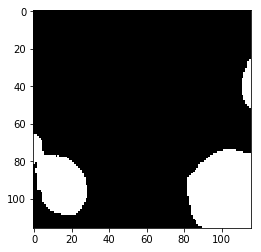

Label  23


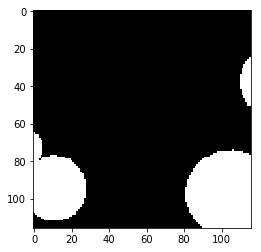

Prediction  24


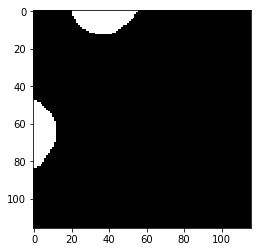

Label  24


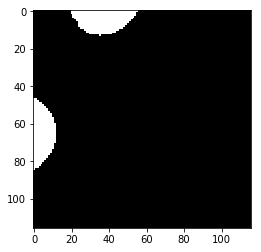

Prediction  25


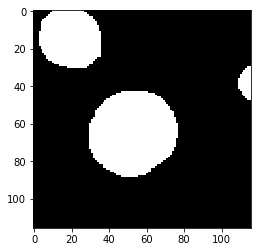

Label  25


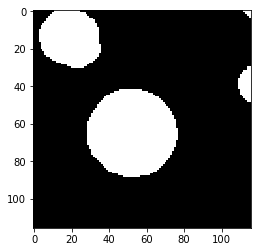

Prediction  26


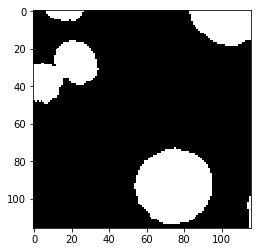

Label  26


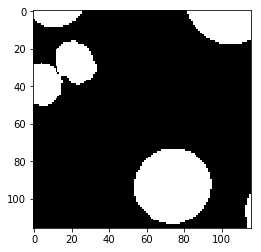

test_accuracy 0.969491220873
Batch: 12500 Train Loss value:0.0234843 Train Accuracy 0.981446031512
Prediction  0


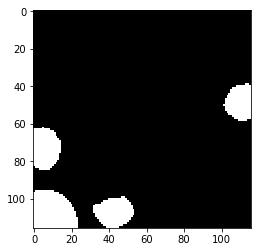

Label  0


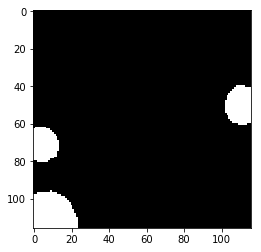

Prediction  1


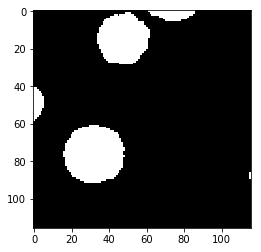

Label  1


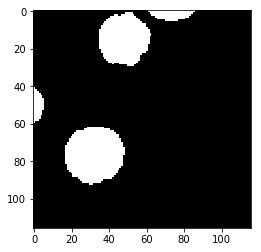

Prediction  2


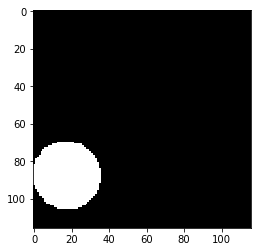

Label  2


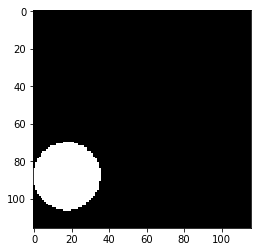

Prediction  3


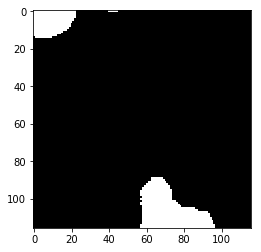

Label  3


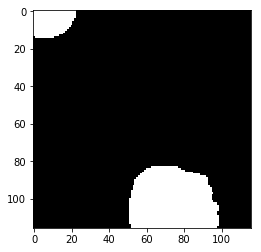

Prediction  4


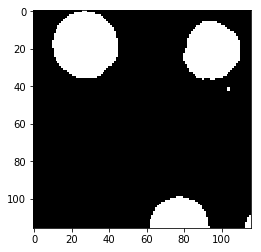

Label  4


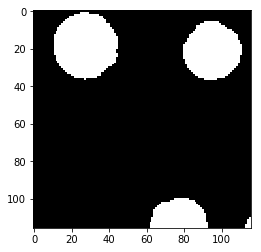

Prediction  5


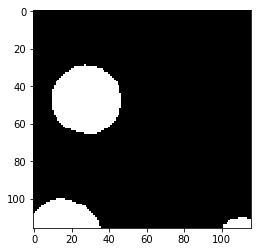

Label  5


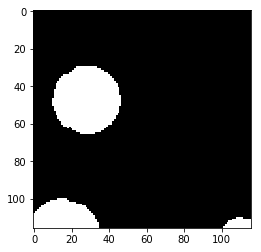

Prediction  6


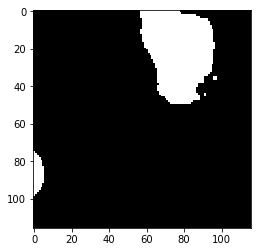

Label  6


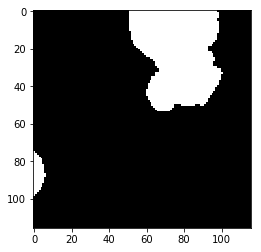

Prediction  7


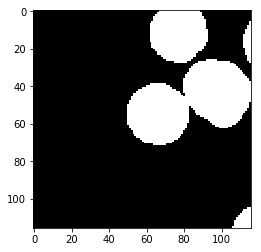

Label  7


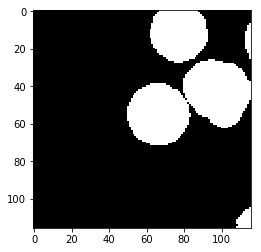

Prediction  8


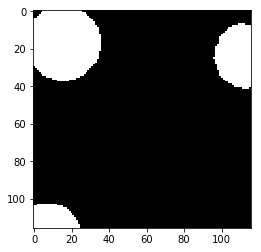

Label  8


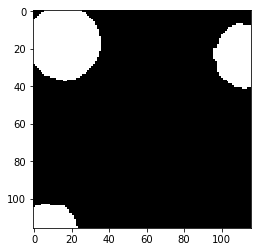

Prediction  9


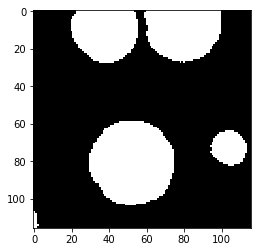

Label  9


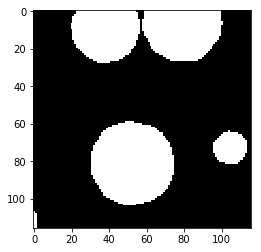

Prediction  10


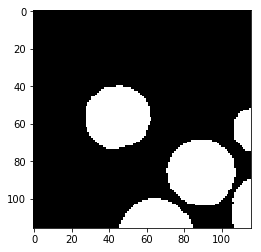

Label  10


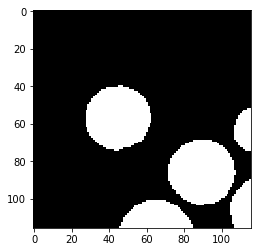

Prediction  11


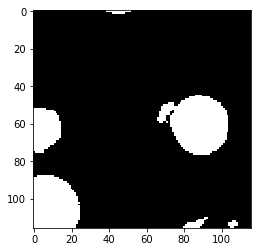

Label  11


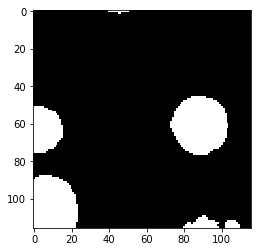

Prediction  12


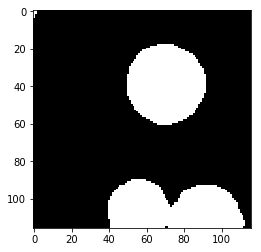

Label  12


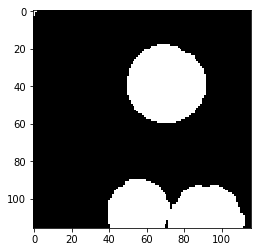

Prediction  13


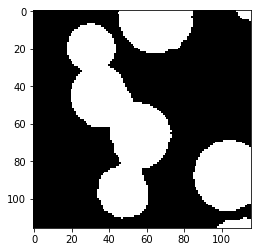

Label  13


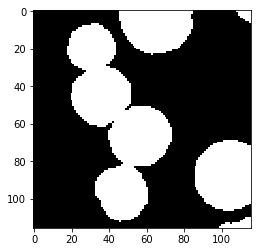

Prediction  14


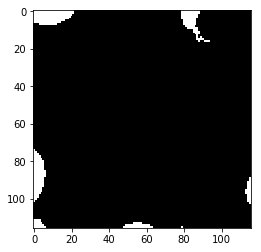

Label  14


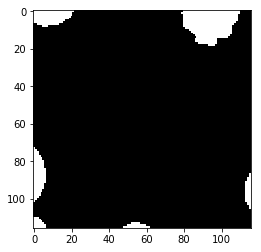

Prediction  15


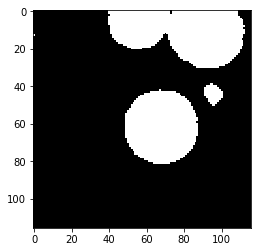

Label  15


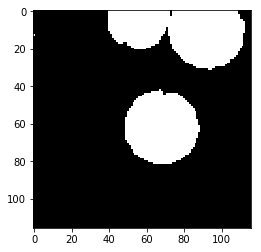

Prediction  16


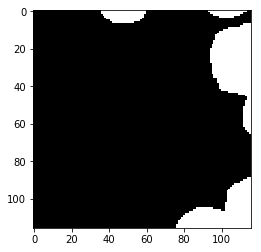

Label  16


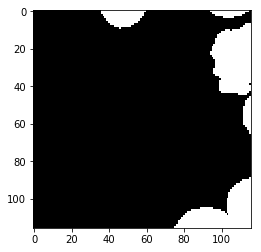

Prediction  17


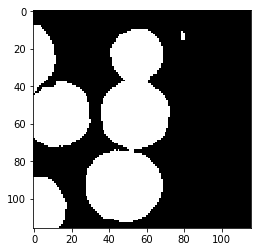

Label  17


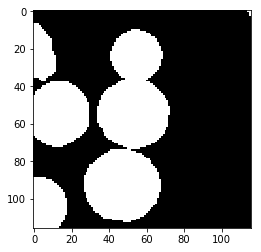

Prediction  18


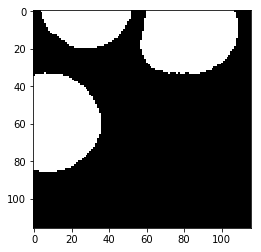

Label  18


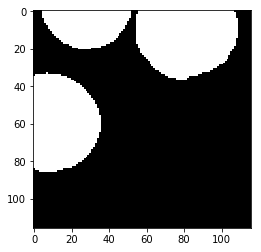

Prediction  19


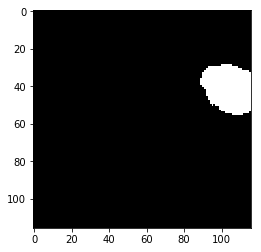

Label  19


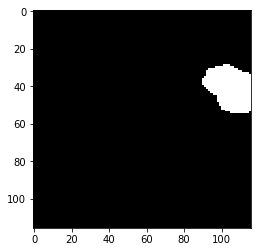

Prediction  20


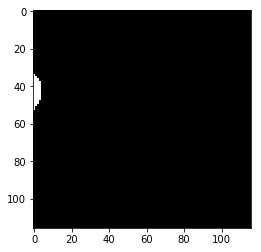

Label  20


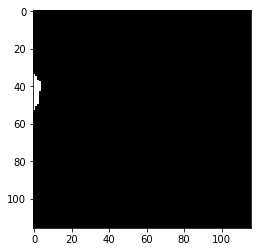

Prediction  21


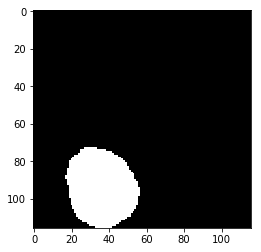

Label  21


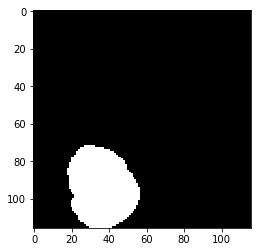

Prediction  22


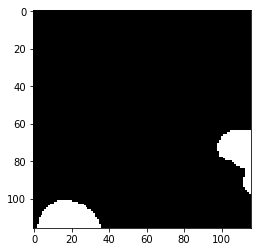

Label  22


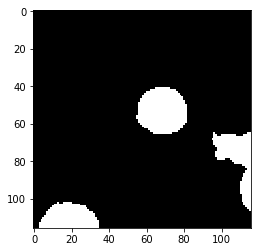

Prediction  23


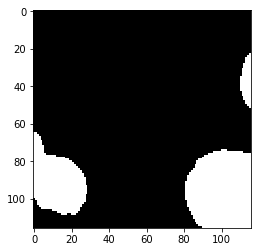

Label  23


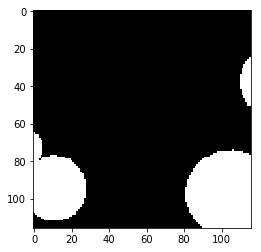

Prediction  24


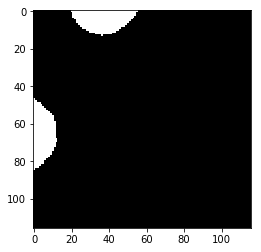

Label  24


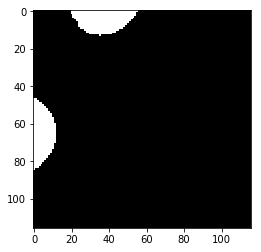

Prediction  25


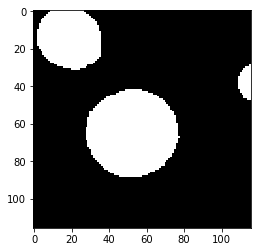

Label  25


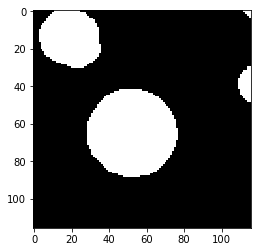

Prediction  26


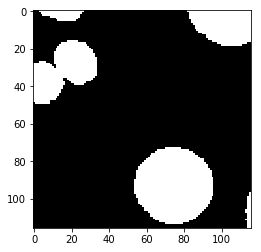

Label  26


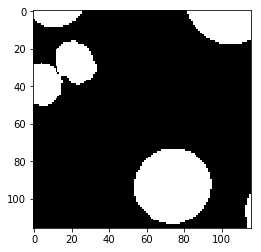

test_accuracy 0.96979497131
Batch: 13000 Train Loss value:0.00268794 Train Accuracy 0.997179962894
Prediction  0


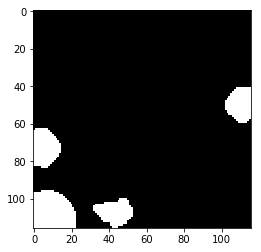

Label  0


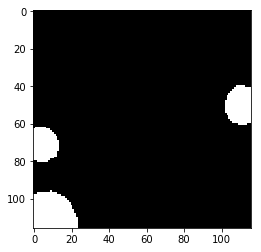

Prediction  1


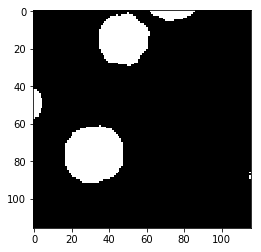

Label  1


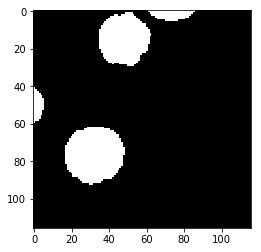

Prediction  2


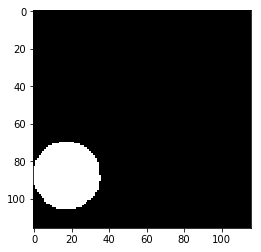

Label  2


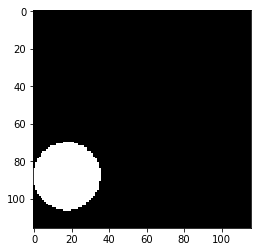

Prediction  3


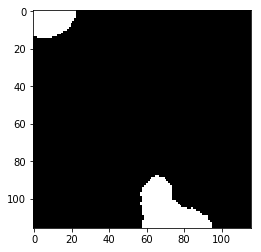

Label  3


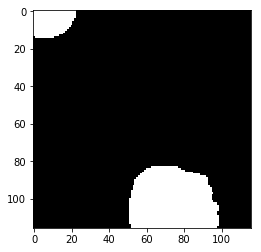

Prediction  4


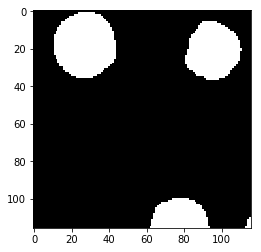

Label  4


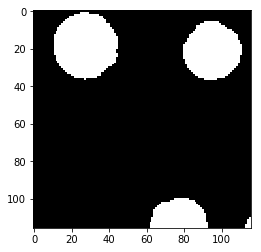

Prediction  5


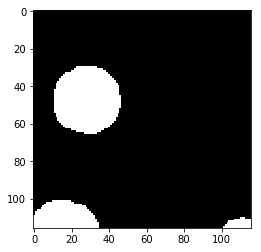

Label  5


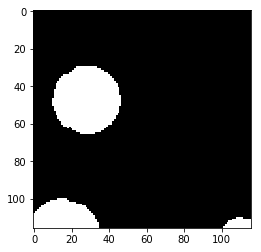

Prediction  6


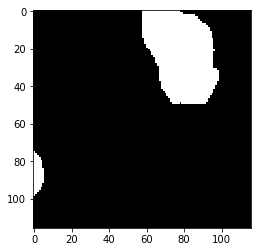

Label  6


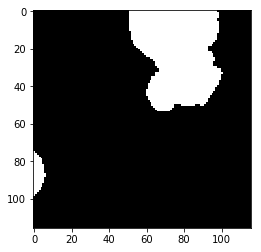

Prediction  7


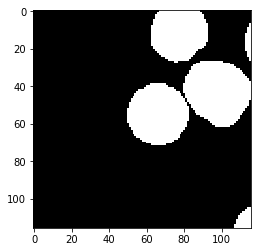

Label  7


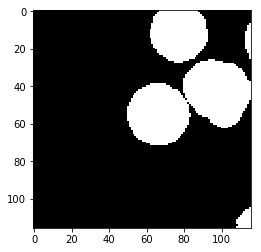

Prediction  8


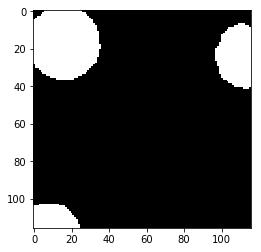

Label  8


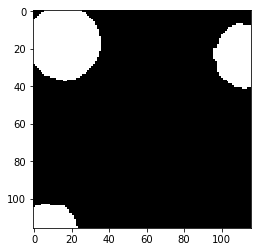

Prediction  9


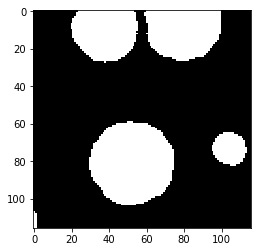

Label  9


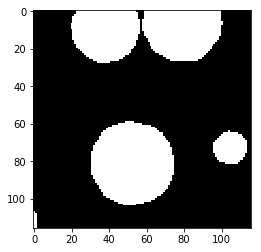

Prediction  10


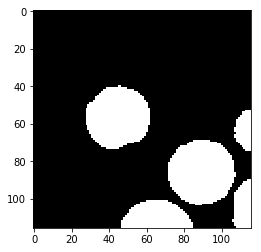

Label  10


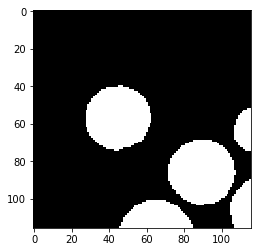

Prediction  11


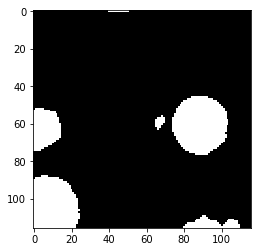

Label  11


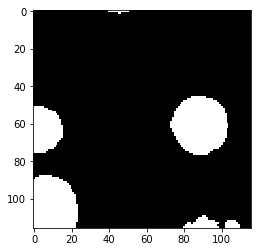

Prediction  12


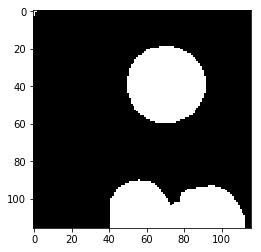

Label  12


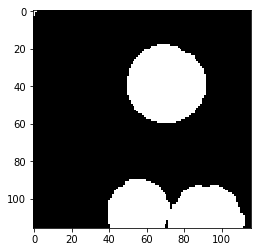

Prediction  13


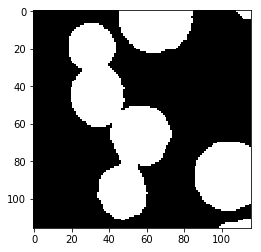

Label  13


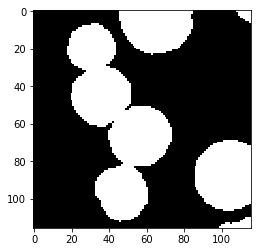

Prediction  14


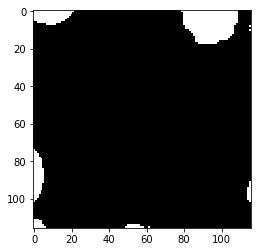

Label  14


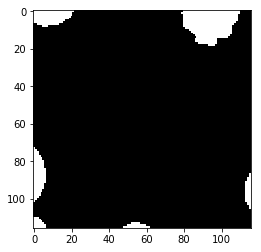

Prediction  15


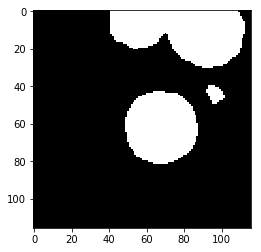

Label  15


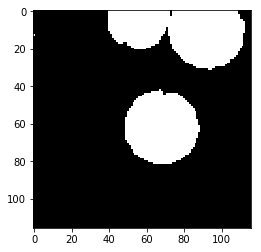

Prediction  16


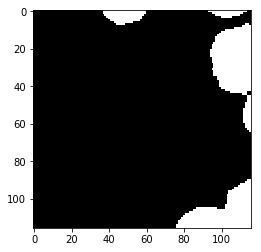

Label  16


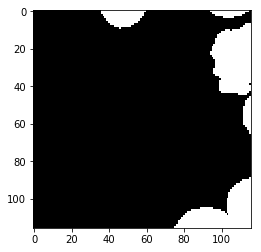

Prediction  17


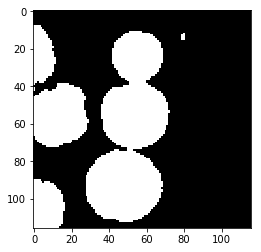

Label  17


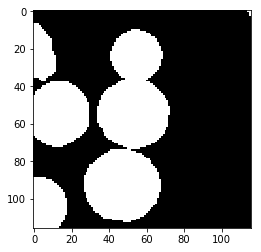

Prediction  18


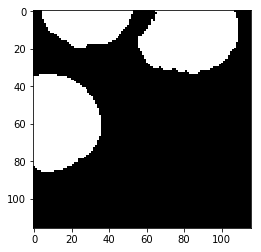

Label  18


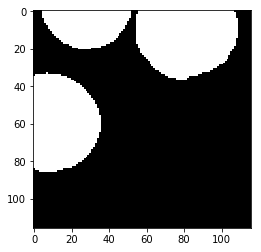

Prediction  19


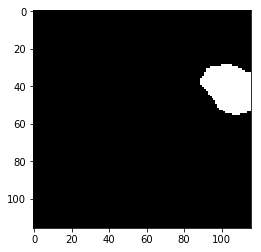

Label  19


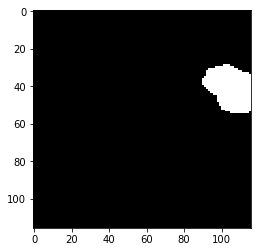

Prediction  20


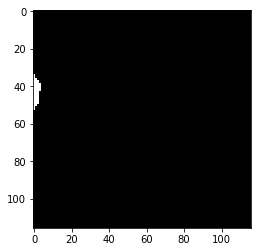

Label  20


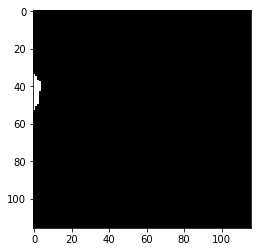

Prediction  21


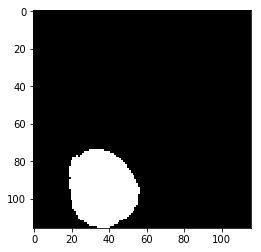

Label  21


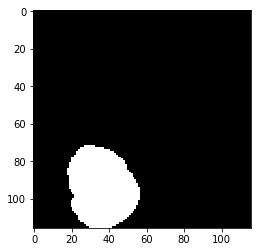

Prediction  22


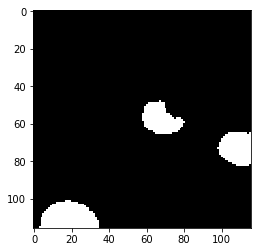

Label  22


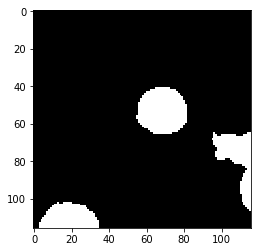

Prediction  23


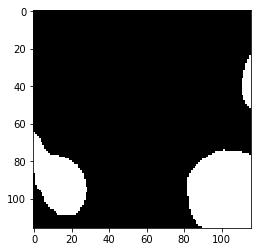

Label  23


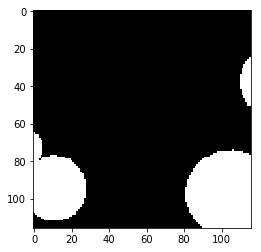

Prediction  24


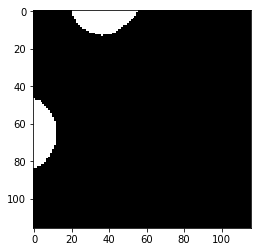

Label  24


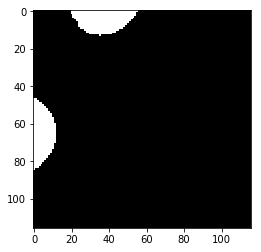

Prediction  25


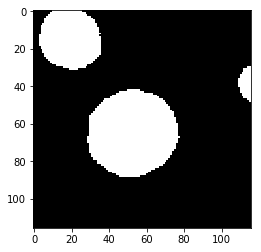

Label  25


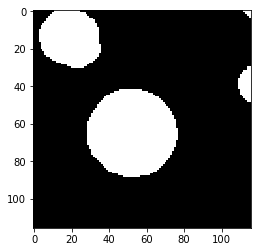

Prediction  26


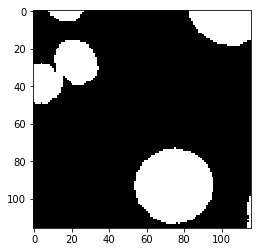

Label  26


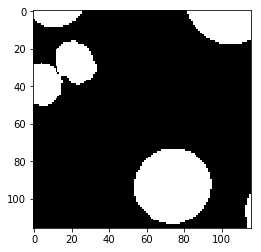

test_accuracy 0.972610189175
Batch: 13500 Train Loss value:1.87877e-05 Train Accuracy 1.0
Prediction  0


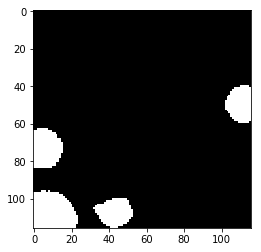

Label  0


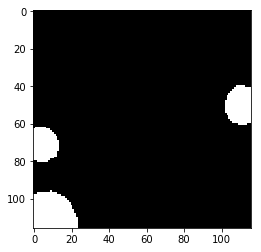

Prediction  1


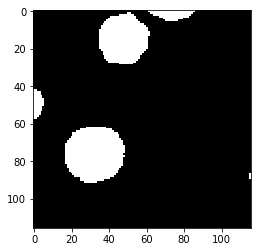

Label  1


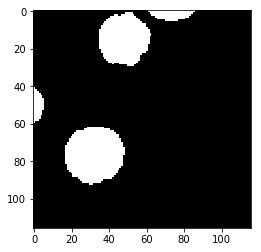

Prediction  2


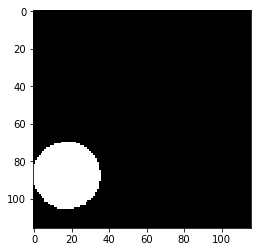

Label  2


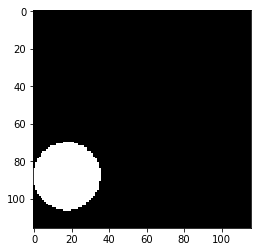

Prediction  3


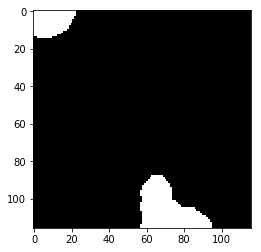

Label  3


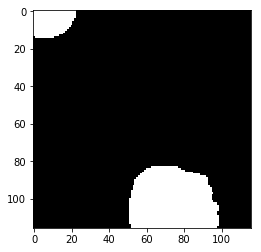

Prediction  4


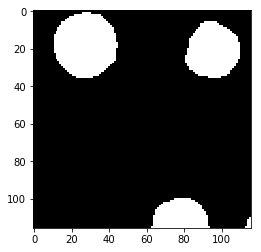

Label  4


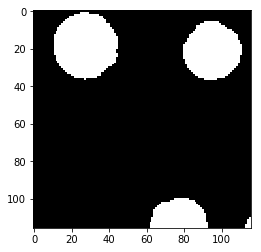

Prediction  5


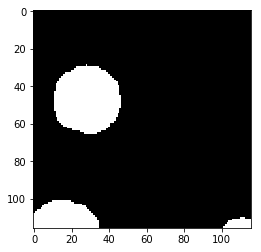

Label  5


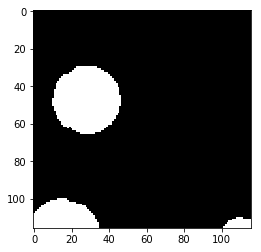

Prediction  6


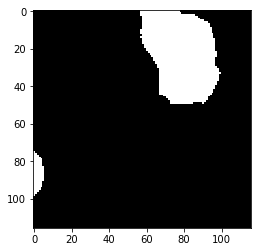

Label  6


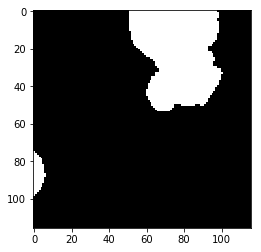

Prediction  7


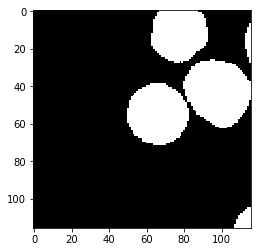

Label  7


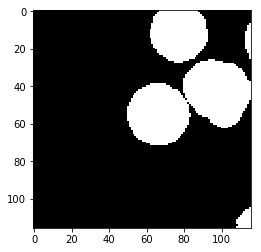

Prediction  8


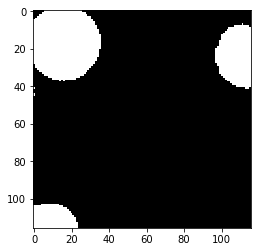

Label  8


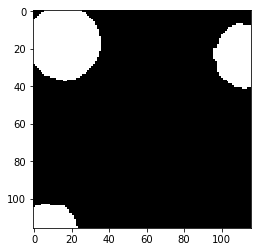

Prediction  9


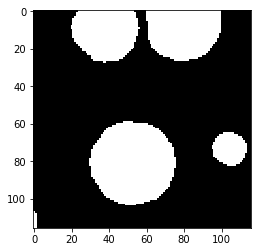

Label  9


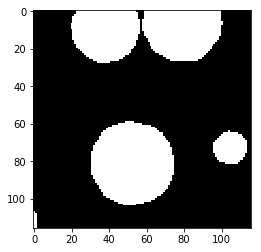

Prediction  10


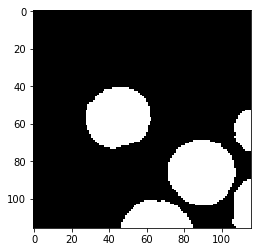

Label  10


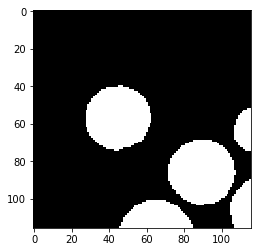

Prediction  11


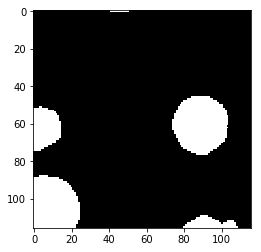

Label  11


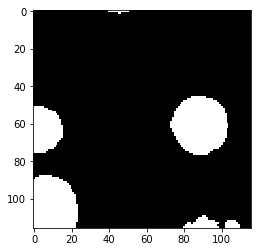

Prediction  12


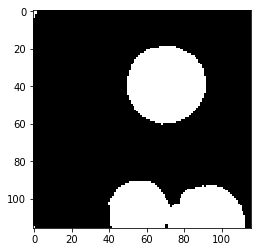

Label  12


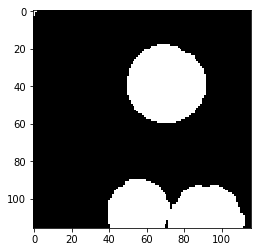

Prediction  13


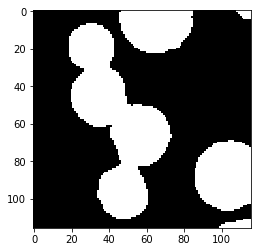

Label  13


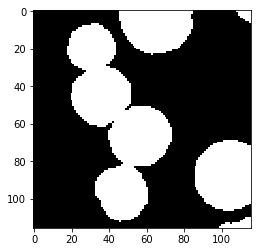

Prediction  14


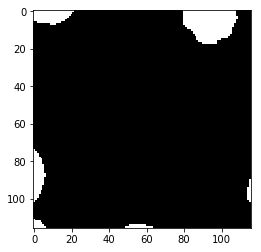

Label  14


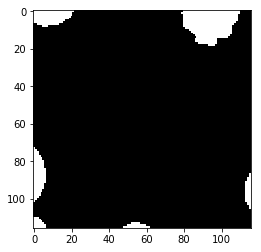

Prediction  15


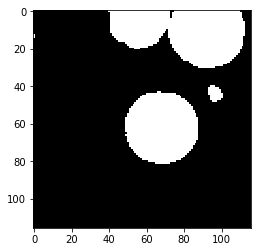

Label  15


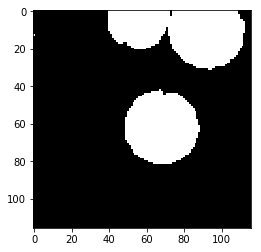

Prediction  16


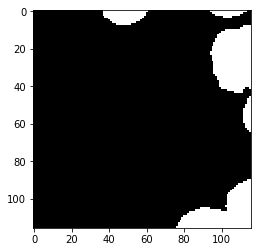

Label  16


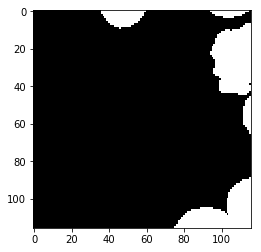

Prediction  17


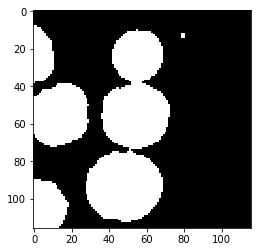

Label  17


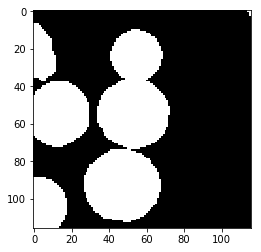

Prediction  18


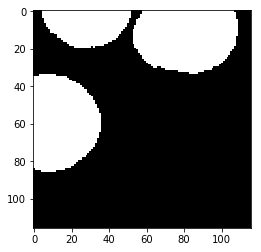

Label  18


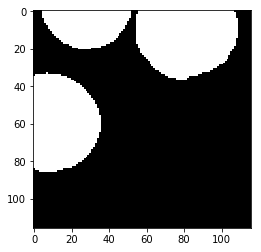

Prediction  19


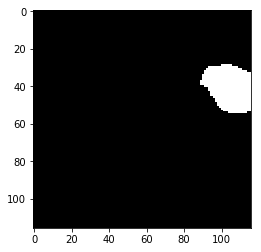

Label  19


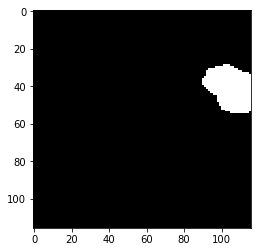

Prediction  20


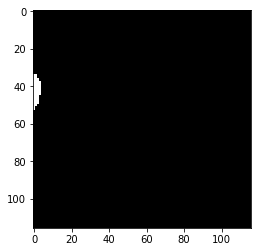

Label  20


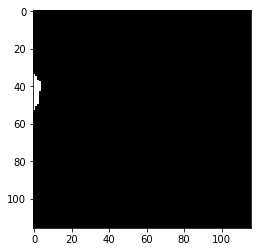

Prediction  21


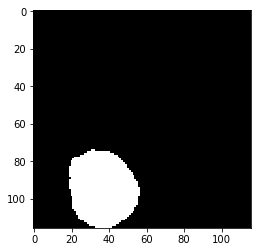

Label  21


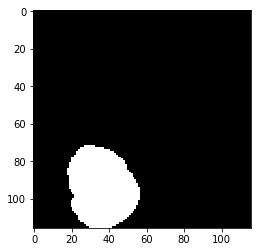

Prediction  22


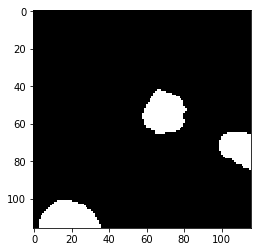

Label  22


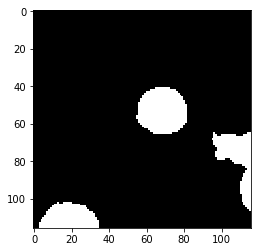

Prediction  23


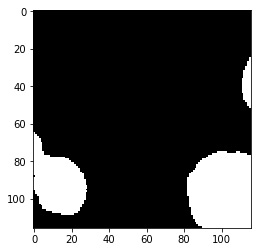

Label  23


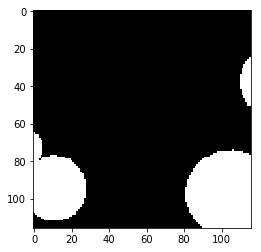

Prediction  24


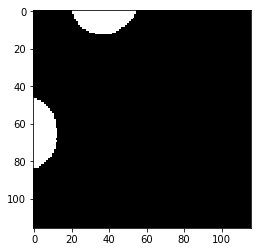

Label  24


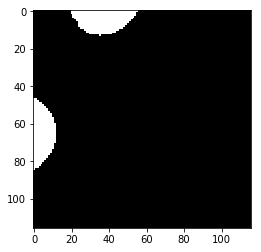

Prediction  25


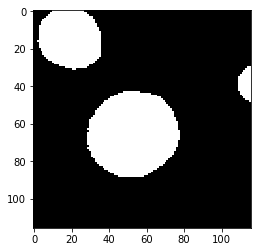

Label  25


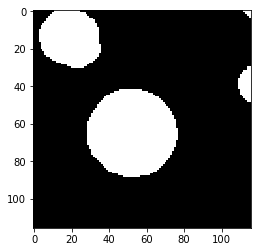

Prediction  26


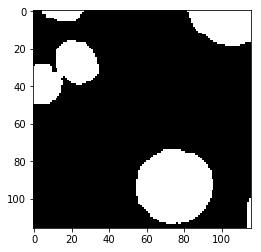

Label  26


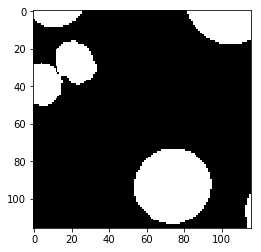

test_accuracy 0.974125595151
Batch: 14000 Train Loss value:0.0177716 Train Accuracy 0.989649563803
Prediction  0


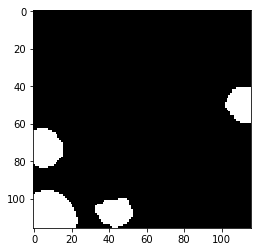

Label  0


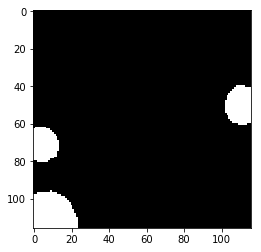

Prediction  1


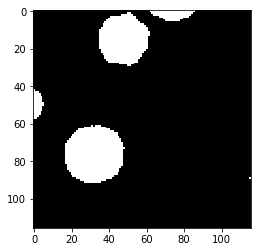

Label  1


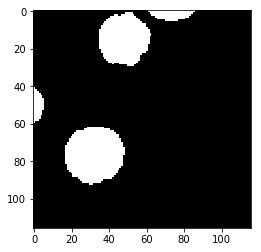

Prediction  2


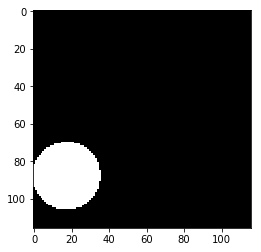

Label  2


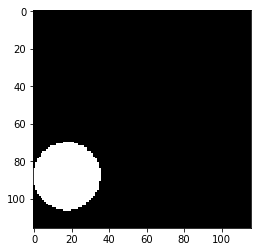

Prediction  3


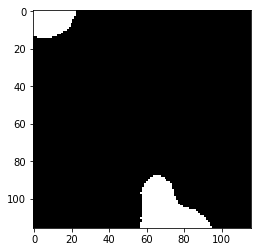

Label  3


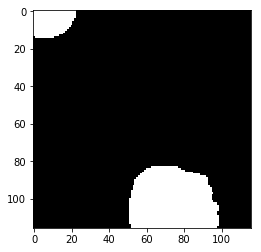

Prediction  4


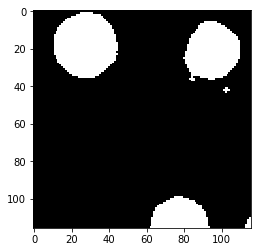

Label  4


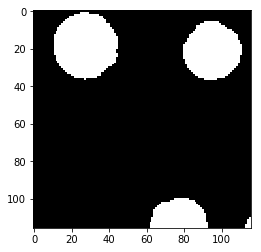

Prediction  5


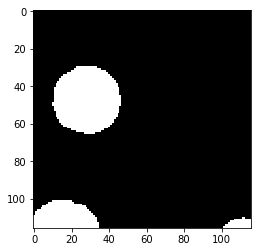

Label  5


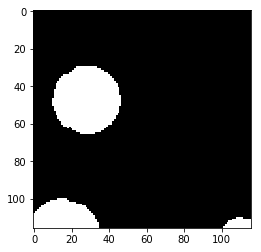

Prediction  6


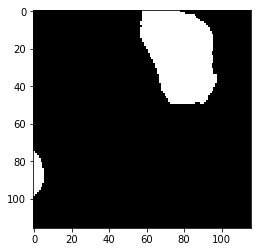

Label  6


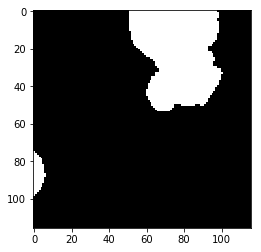

Prediction  7


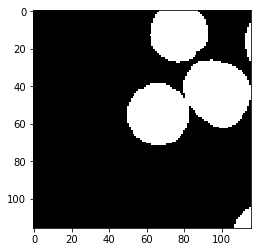

Label  7


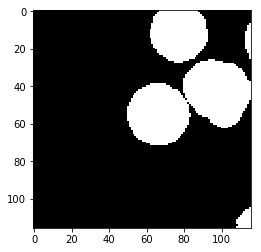

Prediction  8


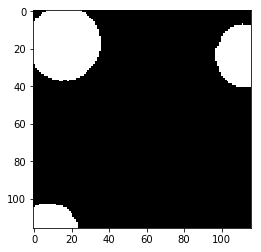

Label  8


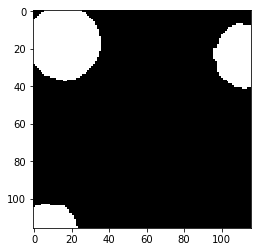

Prediction  9


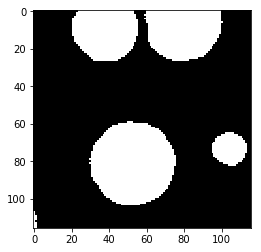

Label  9


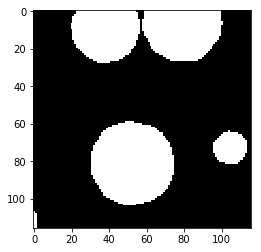

Prediction  10


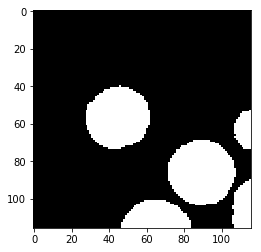

Label  10


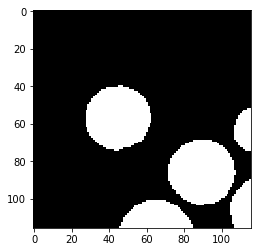

Prediction  11


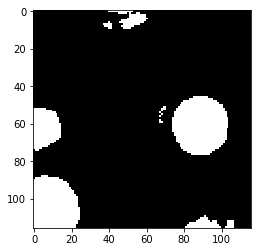

Label  11


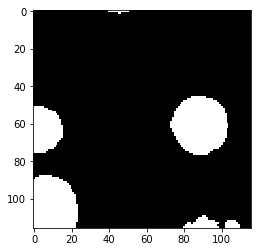

Prediction  12


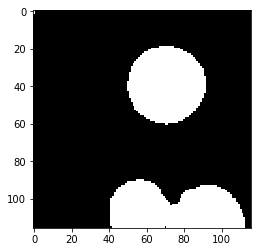

Label  12


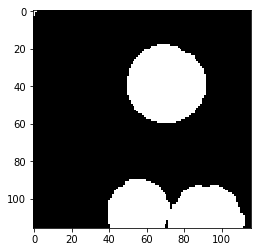

Prediction  13


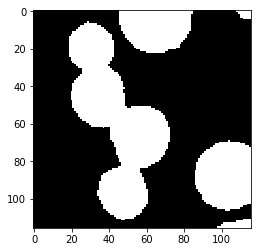

Label  13


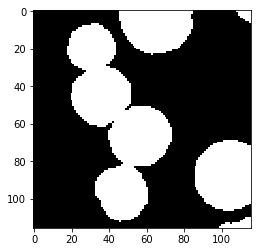

Prediction  14


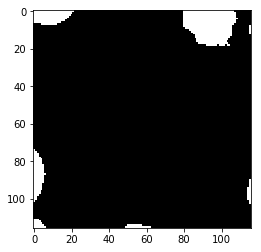

Label  14


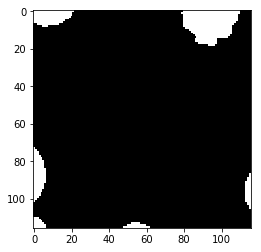

Prediction  15


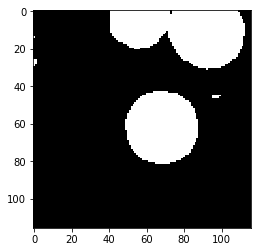

Label  15


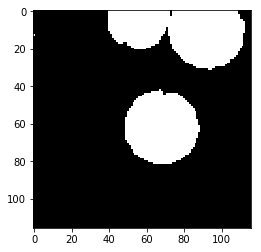

Prediction  16


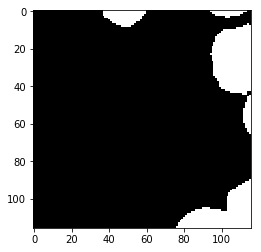

Label  16


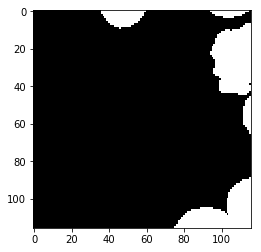

Prediction  17


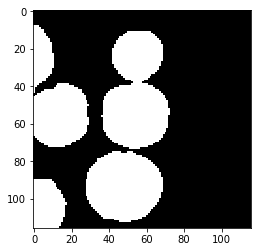

Label  17


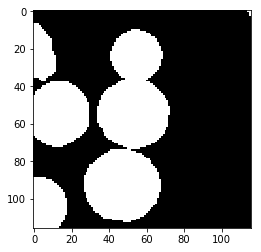

Prediction  18


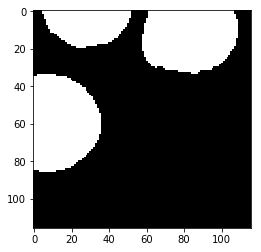

Label  18


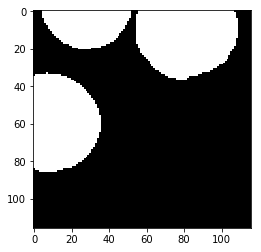

Prediction  19


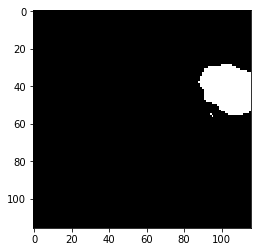

Label  19


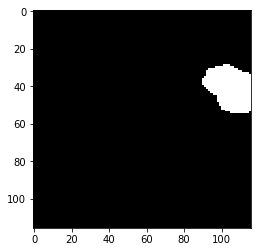

Prediction  20


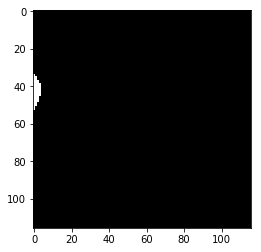

Label  20


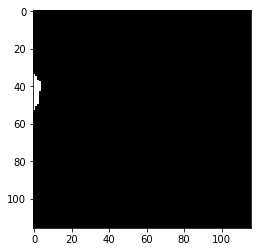

Prediction  21


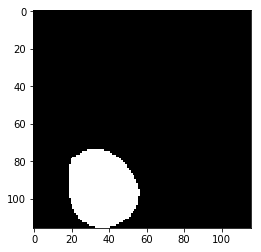

Label  21


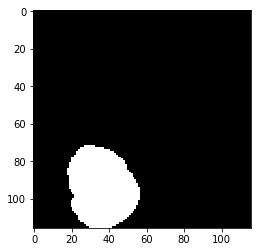

Prediction  22


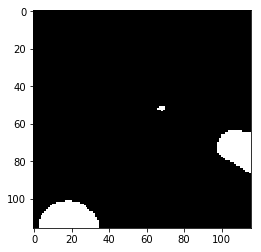

Label  22


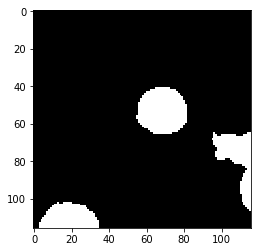

Prediction  23


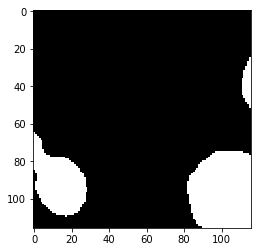

Label  23


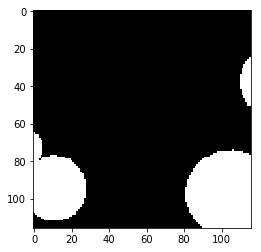

Prediction  24


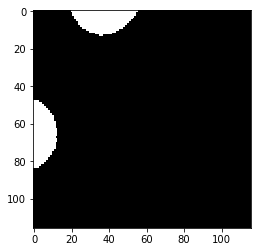

Label  24


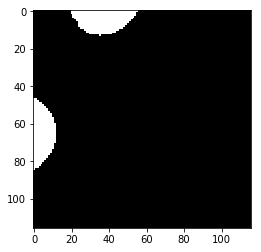

Prediction  25


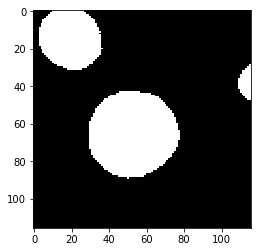

Label  25


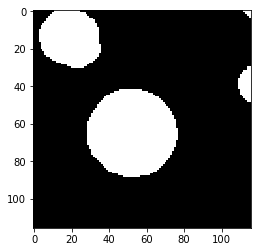

Prediction  26


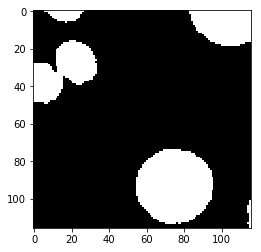

Label  26


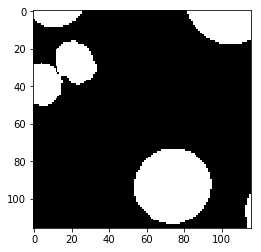

test_accuracy 0.971001213772
Batch: 14500 Train Loss value:0.0104968 Train Accuracy 0.99230085875
Prediction  0


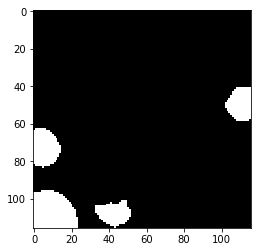

Label  0


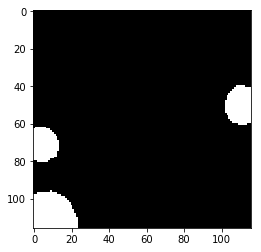

Prediction  1


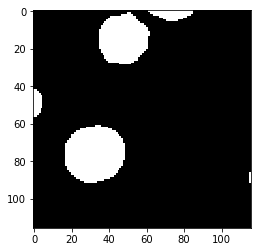

Label  1


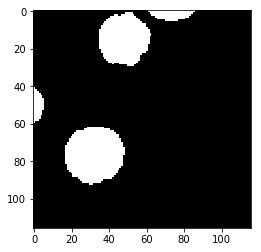

Prediction  2


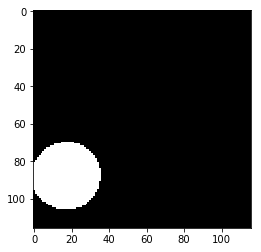

Label  2


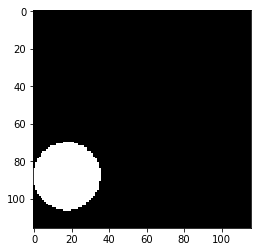

Prediction  3


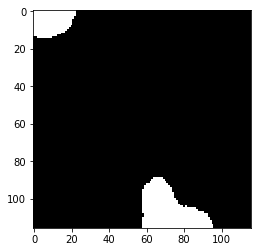

Label  3


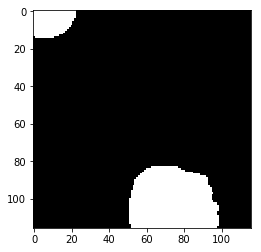

Prediction  4


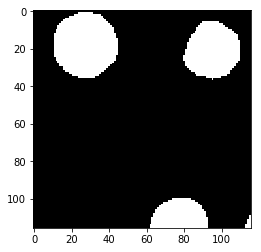

Label  4


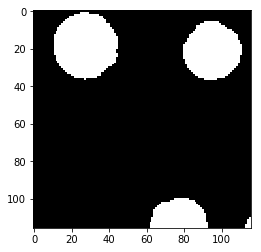

Prediction  5


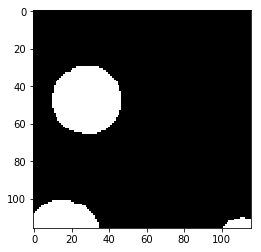

Label  5


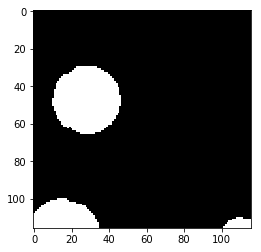

Prediction  6


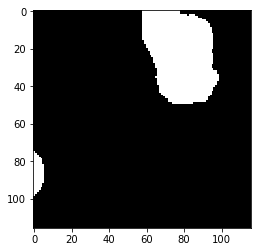

Label  6


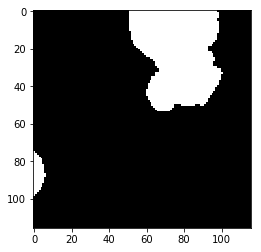

Prediction  7


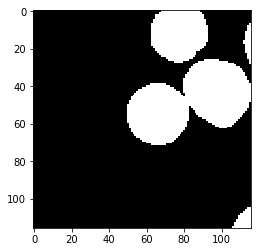

Label  7


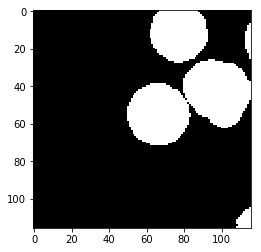

Prediction  8


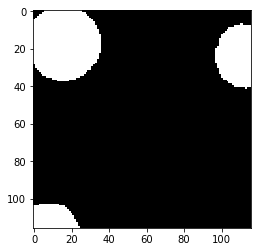

Label  8


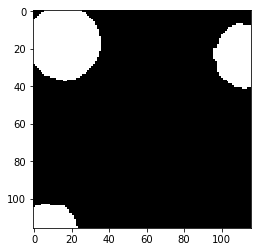

Prediction  9


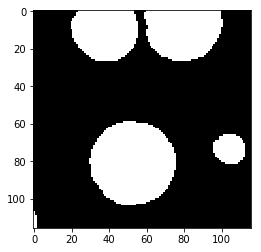

Label  9


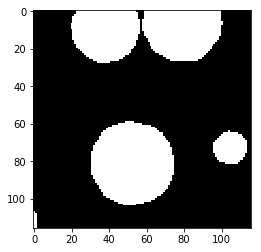

Prediction  10


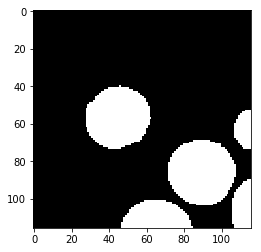

Label  10


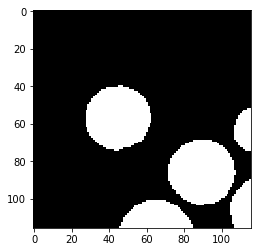

Prediction  11


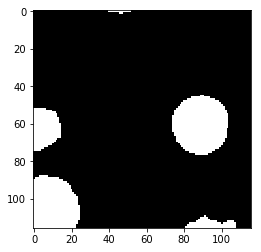

Label  11


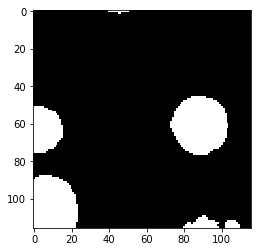

Prediction  12


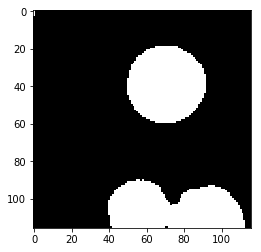

Label  12


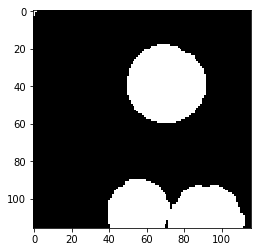

Prediction  13


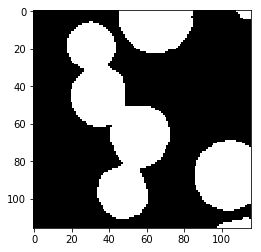

Label  13


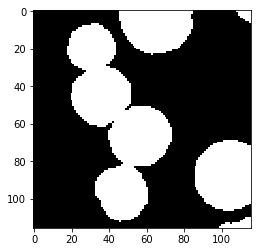

Prediction  14


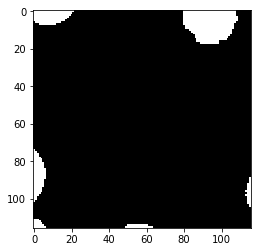

Label  14


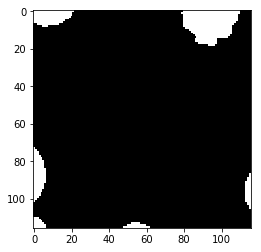

Prediction  15


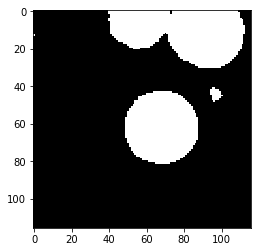

Label  15


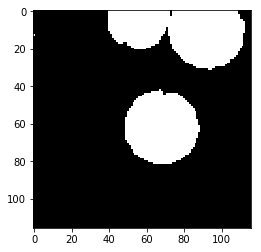

Prediction  16


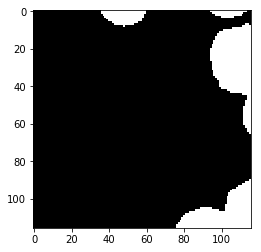

Label  16


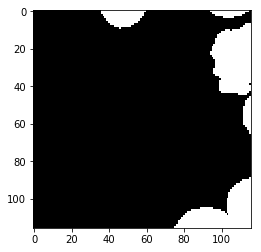

Prediction  17


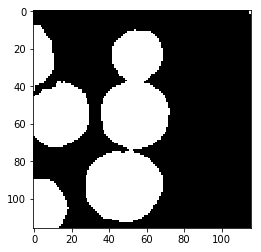

Label  17


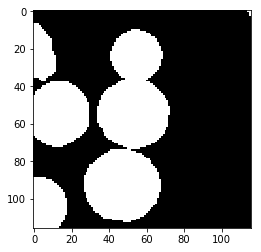

Prediction  18


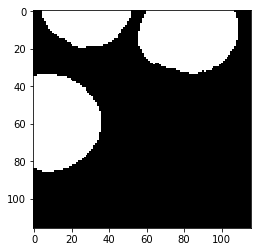

Label  18


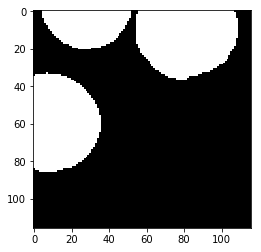

Prediction  19


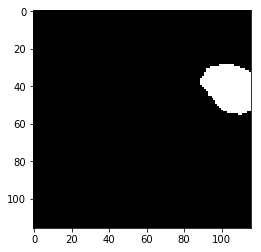

Label  19


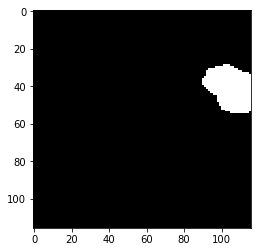

Prediction  20


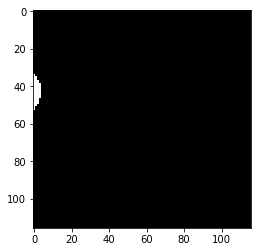

Label  20


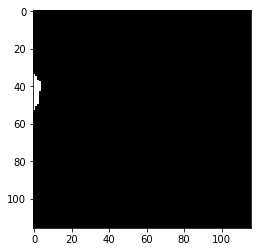

Prediction  21


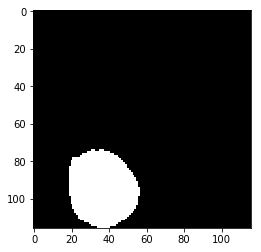

Label  21


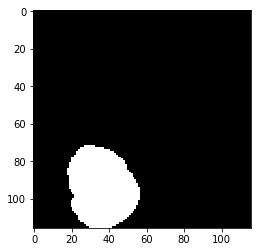

Prediction  22


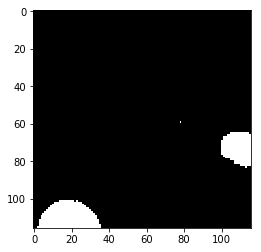

Label  22


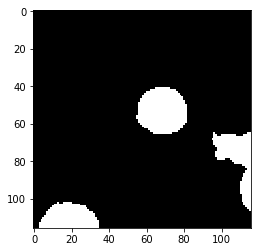

Prediction  23


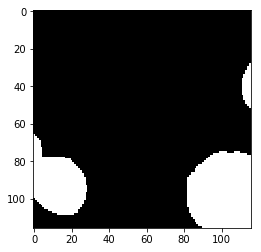

Label  23


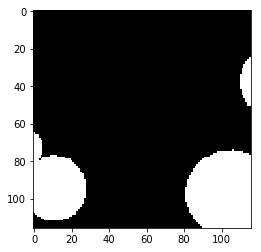

Prediction  24


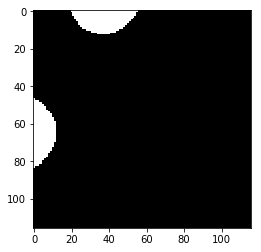

Label  24


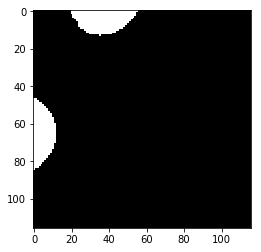

Prediction  25


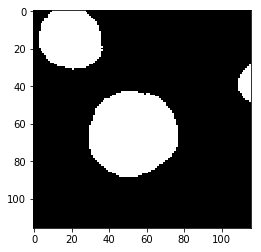

Label  25


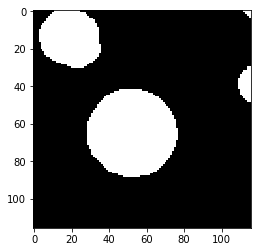

Prediction  26


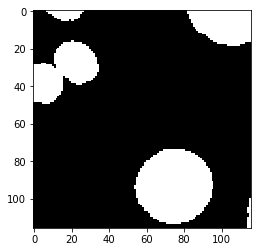

Label  26


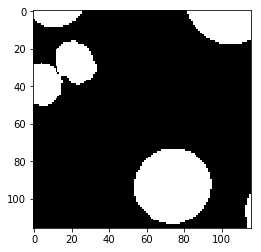

test_accuracy 0.972951299848
Batch: 15000 Train Loss value:0.0292686 Train Accuracy 0.977514879859
Prediction  0


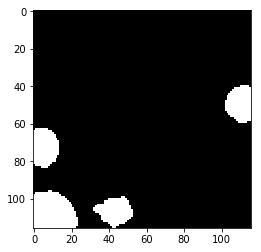

Label  0


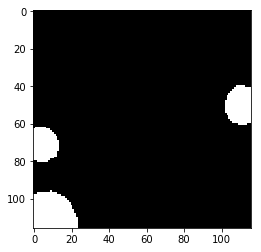

Prediction  1


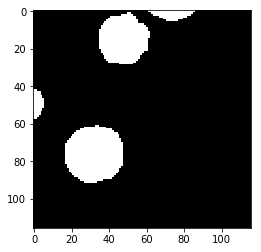

Label  1


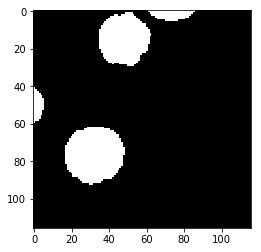

Prediction  2


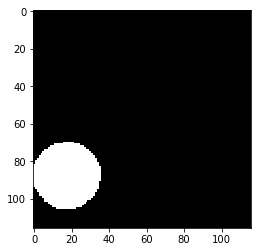

Label  2


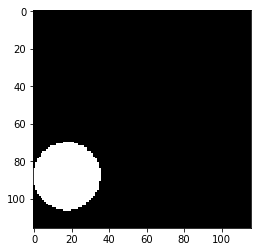

Prediction  3


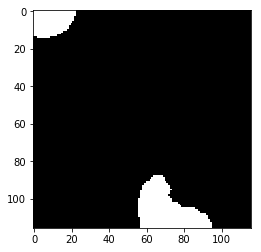

Label  3


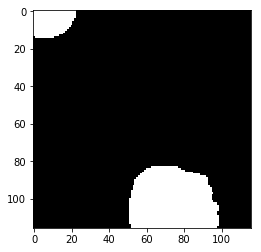

Prediction  4


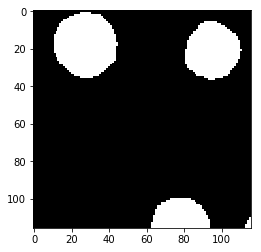

Label  4


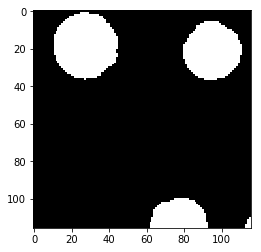

Prediction  5


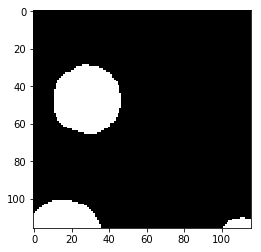

Label  5


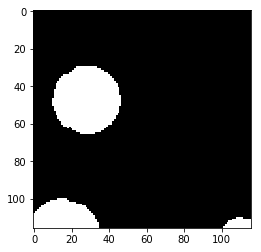

Prediction  6


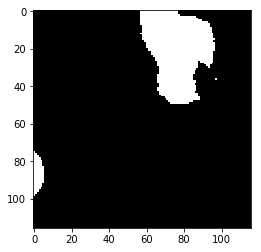

Label  6


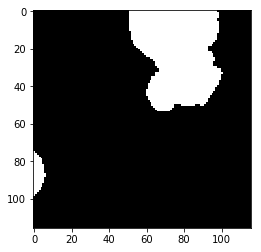

Prediction  7


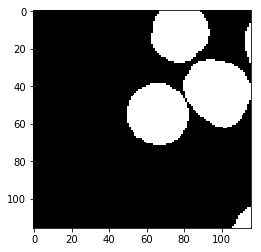

Label  7


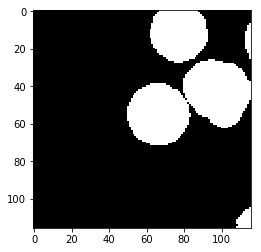

Prediction  8


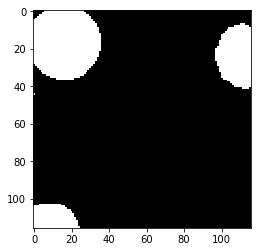

Label  8


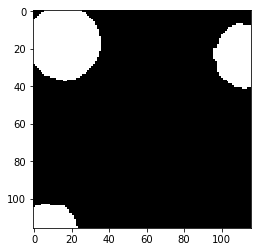

Prediction  9


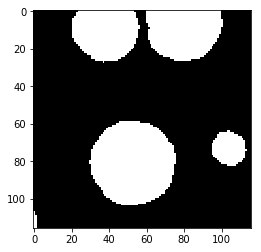

Label  9


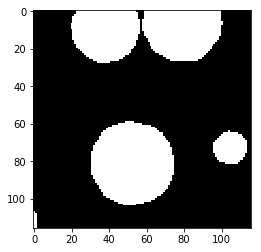

Prediction  10


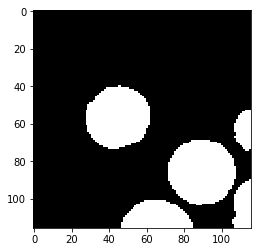

Label  10


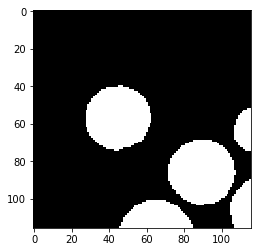

Prediction  11


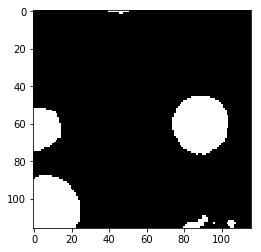

Label  11


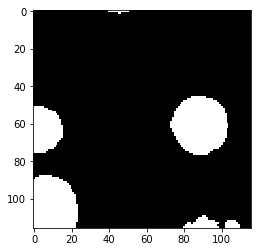

Prediction  12


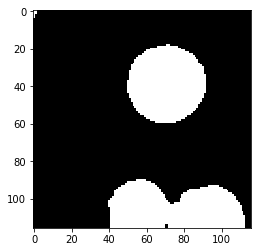

Label  12


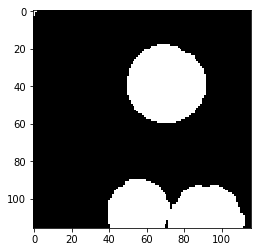

Prediction  13


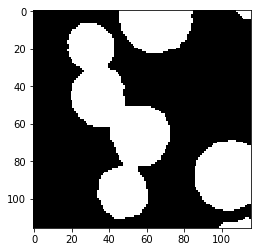

Label  13


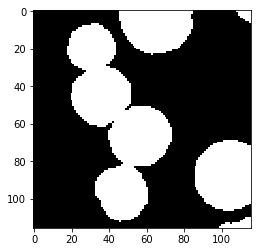

Prediction  14


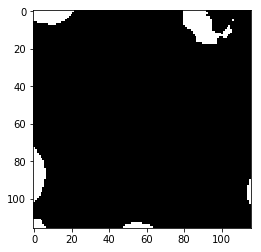

Label  14


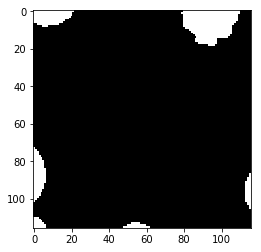

Prediction  15


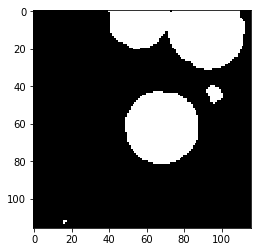

Label  15


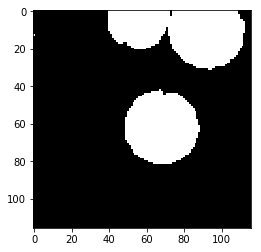

Prediction  16


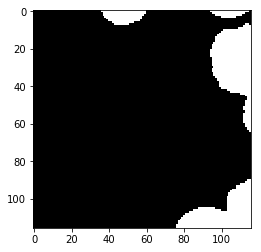

Label  16


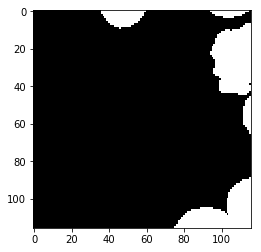

Prediction  17


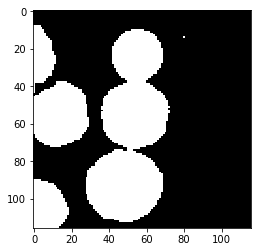

Label  17


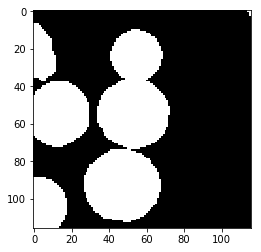

Prediction  18


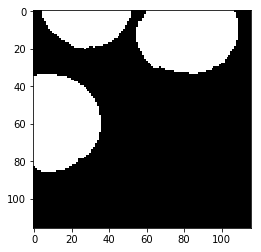

Label  18


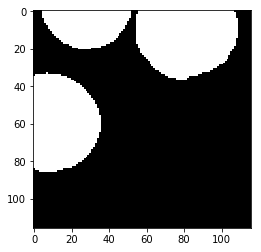

Prediction  19


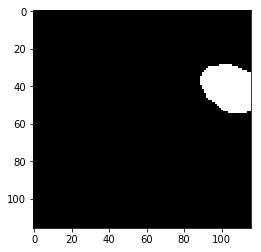

Label  19


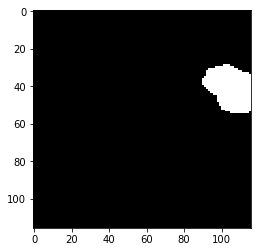

Prediction  20


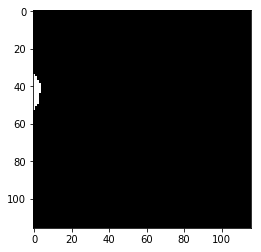

Label  20


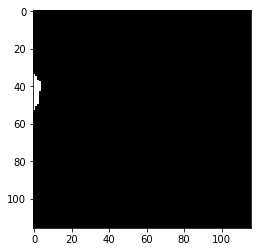

Prediction  21


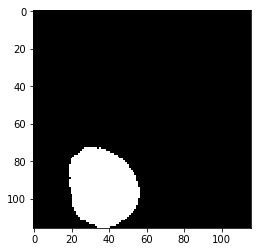

Label  21


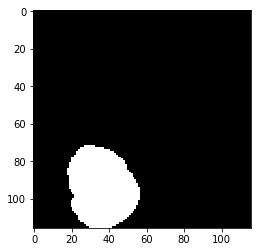

Prediction  22


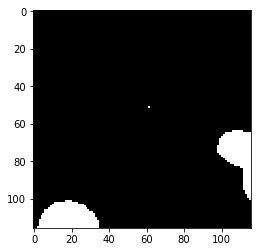

Label  22


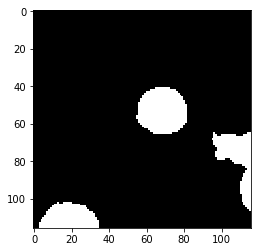

Prediction  23


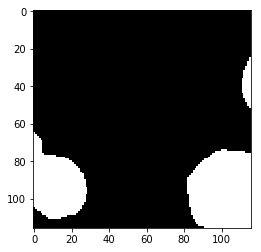

Label  23


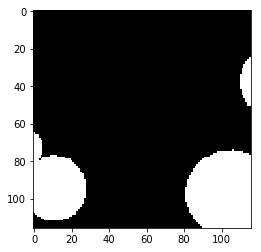

Prediction  24


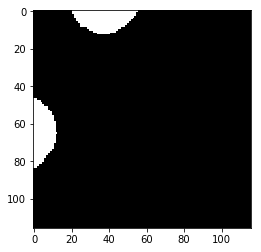

Label  24


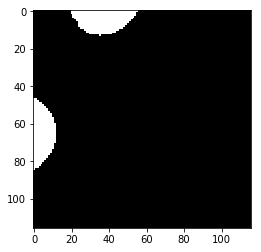

Prediction  25


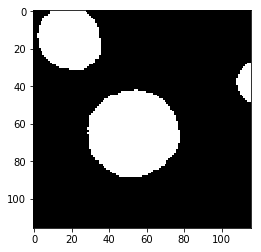

Label  25


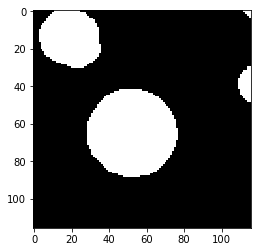

Prediction  26


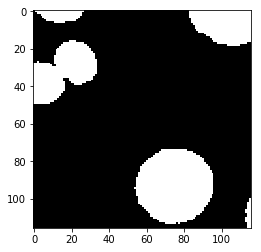

Label  26


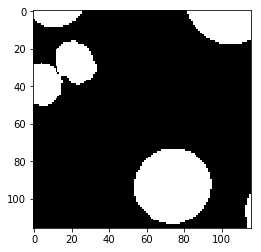

test_accuracy 0.97159115811
Batch: 15500 Train Loss value:0.00718004 Train Accuracy 0.994663504299
Prediction  0


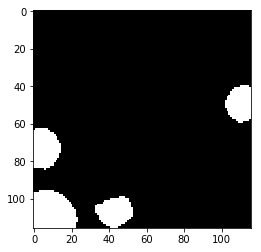

Label  0


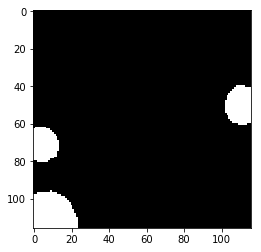

Prediction  1


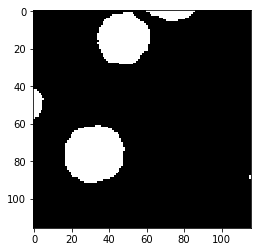

Label  1


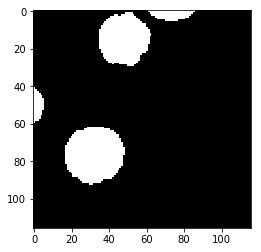

Prediction  2


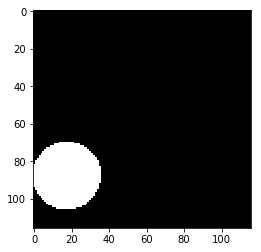

Label  2


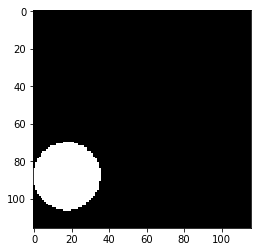

Prediction  3


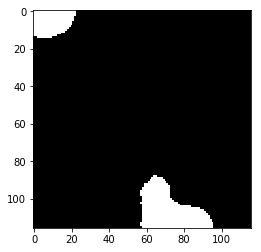

Label  3


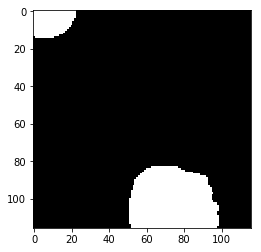

Prediction  4


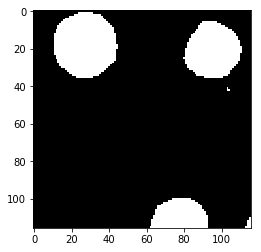

Label  4


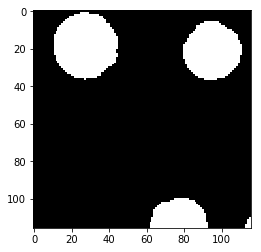

Prediction  5


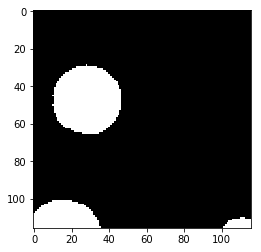

Label  5


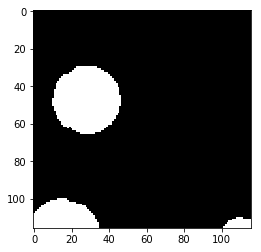

Prediction  6


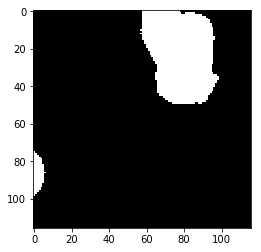

Label  6


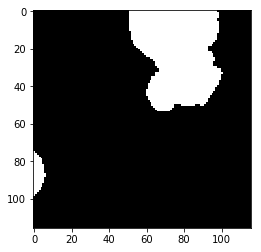

Prediction  7


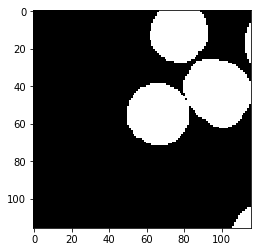

Label  7


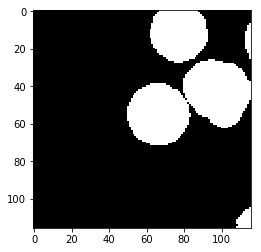

Prediction  8


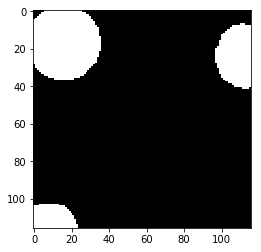

Label  8


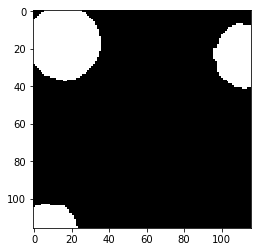

Prediction  9


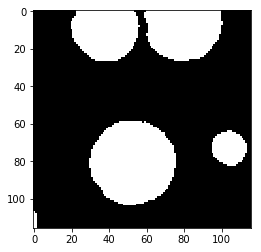

Label  9


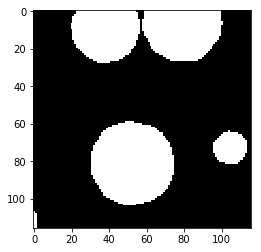

Prediction  10


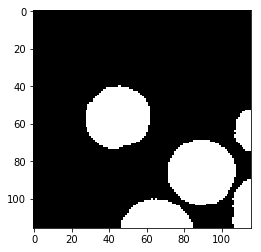

Label  10


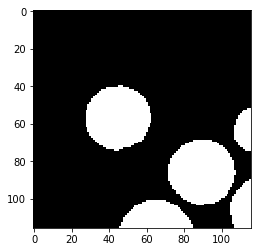

Prediction  11


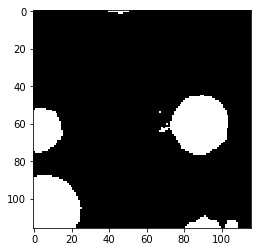

Label  11


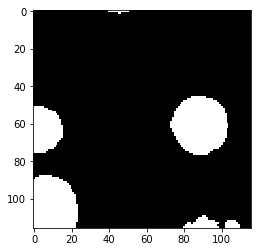

Prediction  12


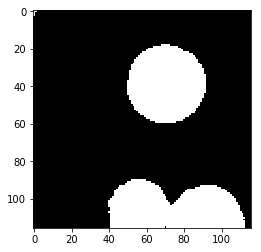

Label  12


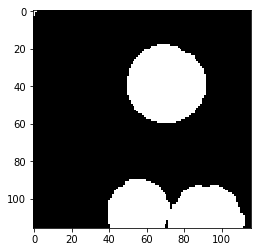

Prediction  13


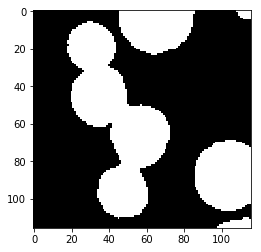

Label  13


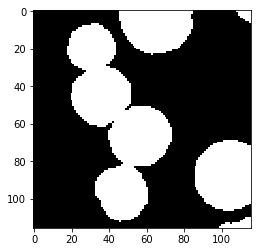

Prediction  14


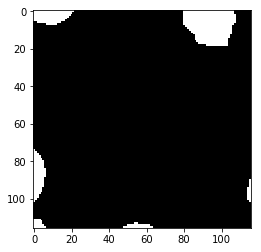

Label  14


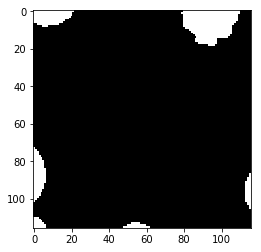

Prediction  15


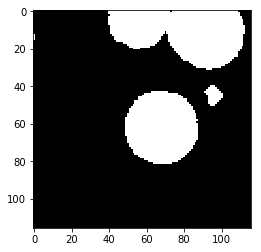

Label  15


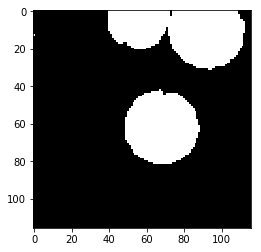

Prediction  16


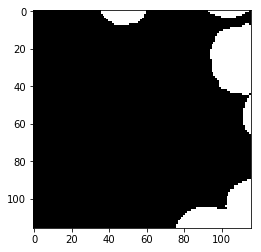

Label  16


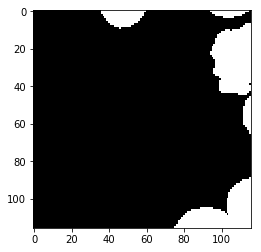

Prediction  17


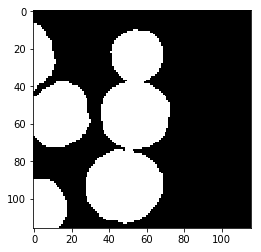

Label  17


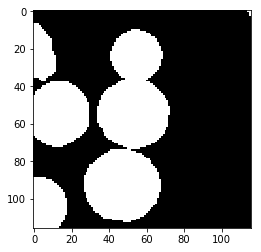

Prediction  18


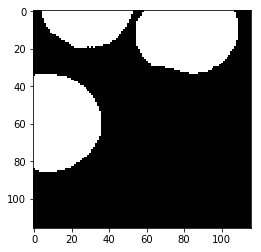

Label  18


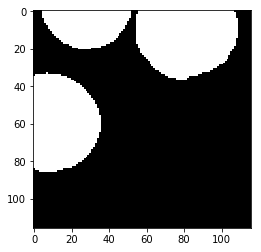

Prediction  19


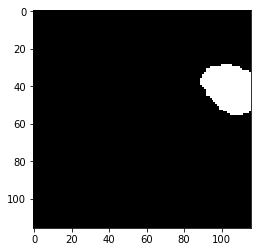

Label  19


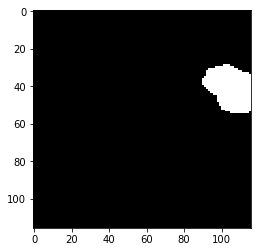

Prediction  20


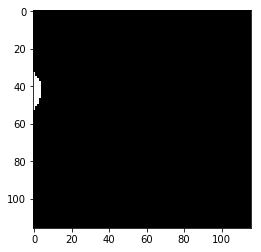

Label  20


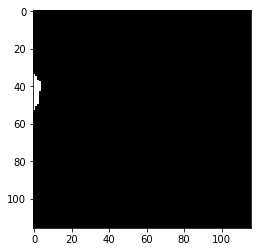

Prediction  21


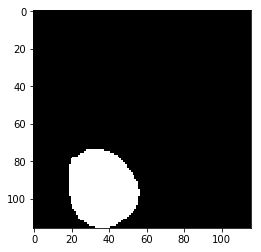

Label  21


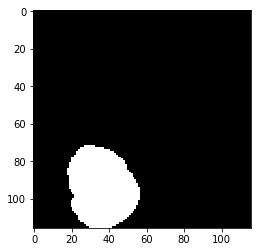

Prediction  22


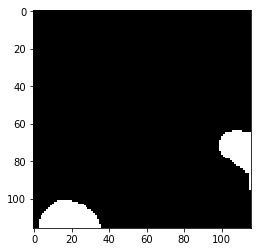

Label  22


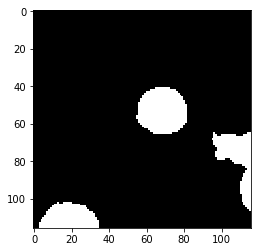

Prediction  23


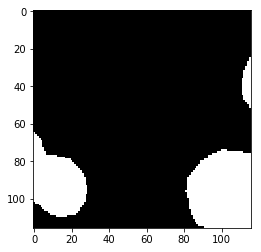

Label  23


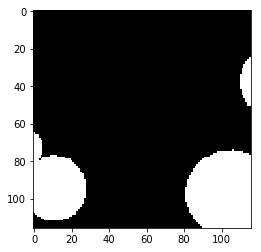

Prediction  24


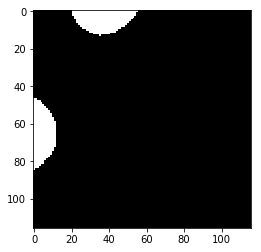

Label  24


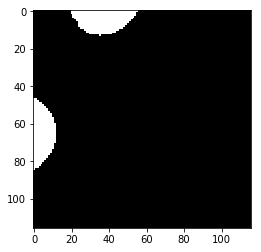

Prediction  25


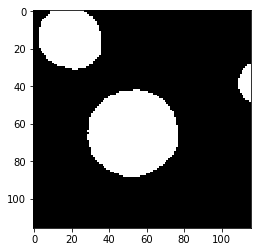

Label  25


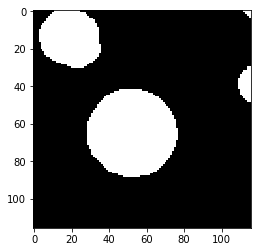

Prediction  26


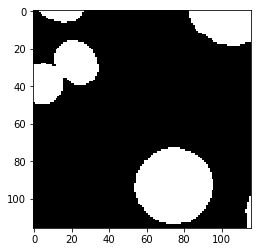

Label  26


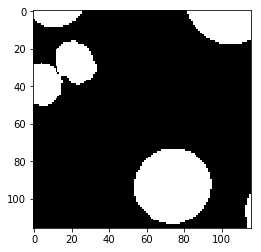

test_accuracy 0.973748324237
Batch: 16000 Train Loss value:0.00574047 Train Accuracy 0.996143005489
Prediction  0


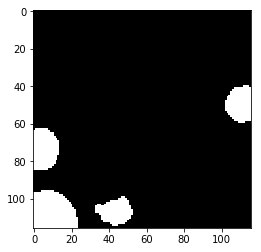

Label  0


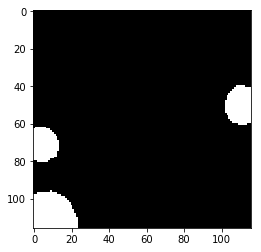

Prediction  1


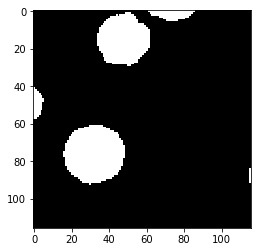

Label  1


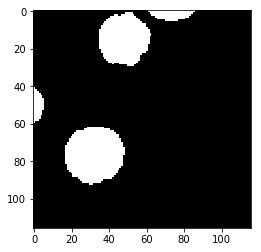

Prediction  2


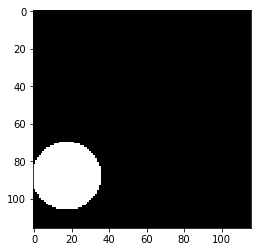

Label  2


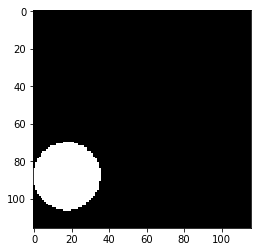

Prediction  3


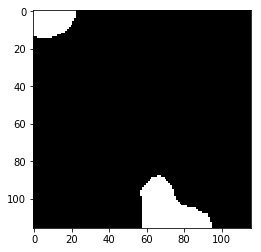

Label  3


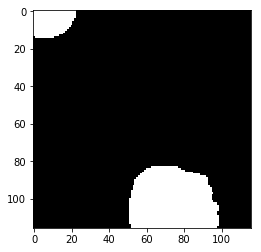

Prediction  4


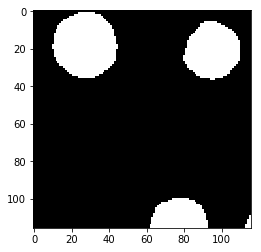

Label  4


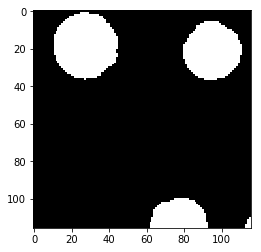

Prediction  5


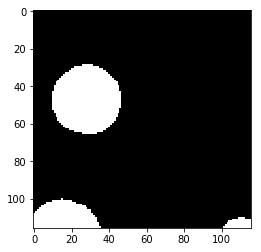

Label  5


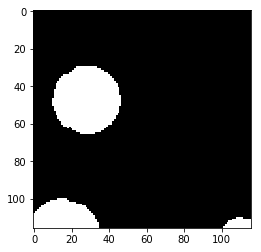

Prediction  6


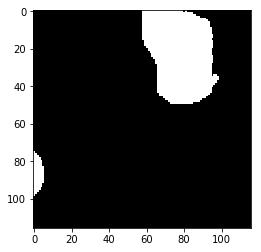

Label  6


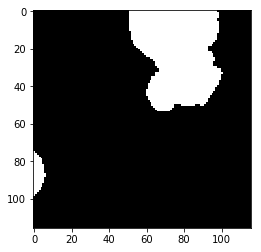

Prediction  7


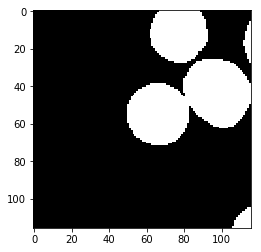

Label  7


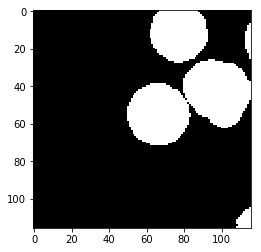

Prediction  8


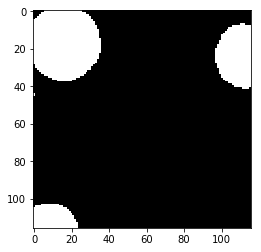

Label  8


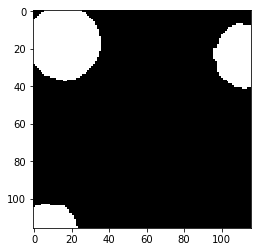

Prediction  9


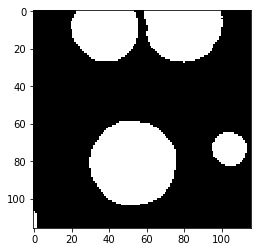

Label  9


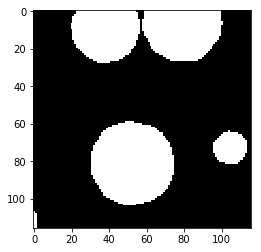

Prediction  10


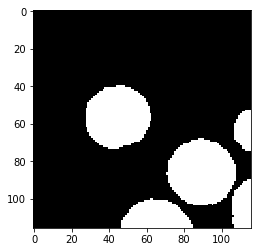

Label  10


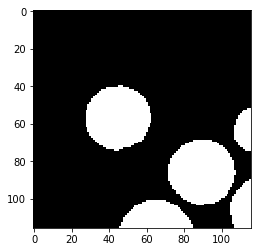

Prediction  11


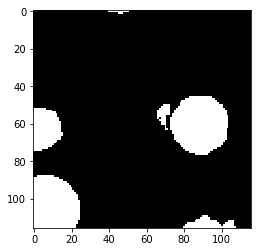

Label  11


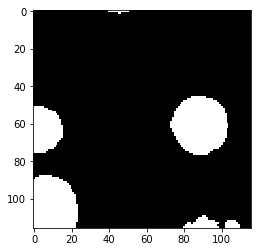

Prediction  12


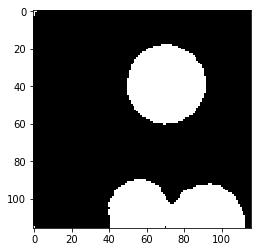

Label  12


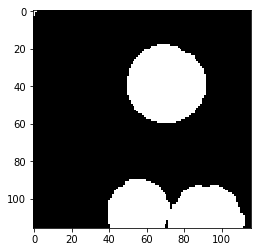

Prediction  13


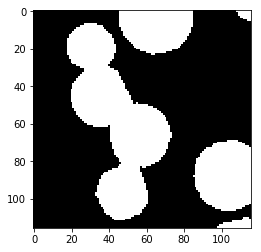

Label  13


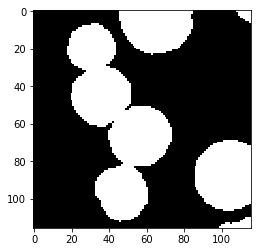

Prediction  14


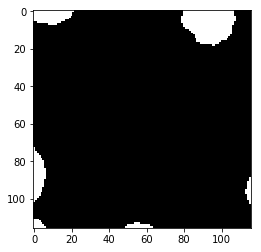

Label  14


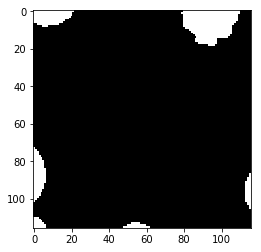

Prediction  15


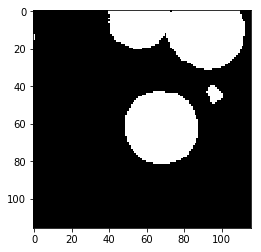

Label  15


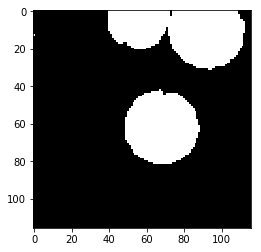

Prediction  16


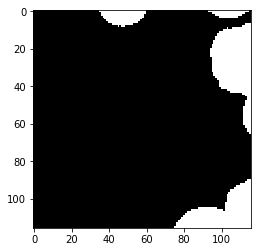

Label  16


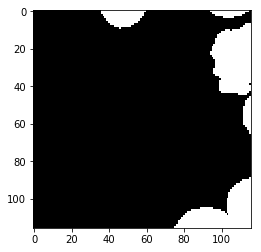

Prediction  17


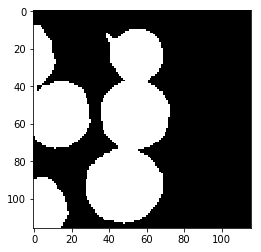

Label  17


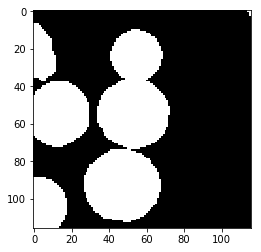

Prediction  18


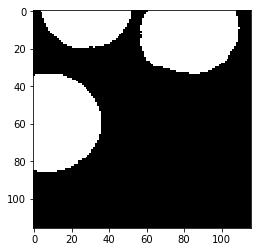

Label  18


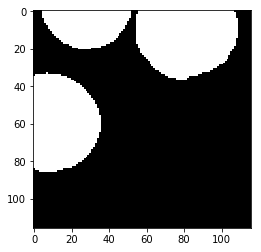

Prediction  19


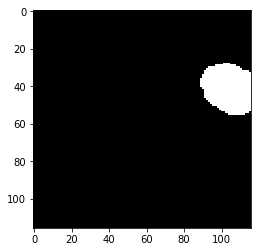

Label  19


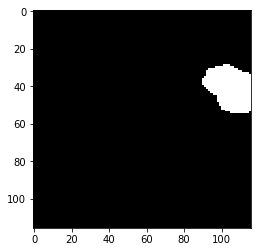

Prediction  20


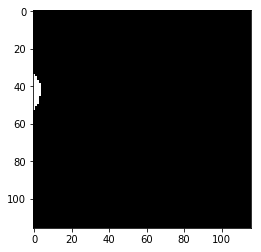

Label  20


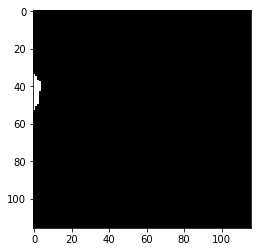

Prediction  21


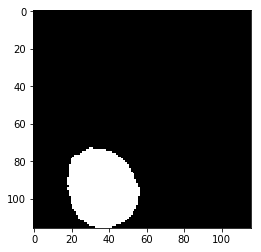

Label  21


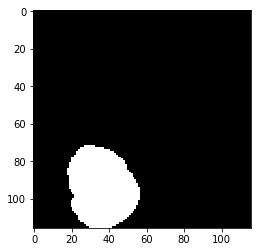

Prediction  22


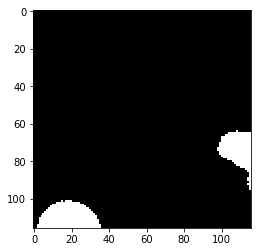

Label  22


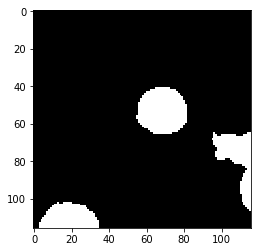

Prediction  23


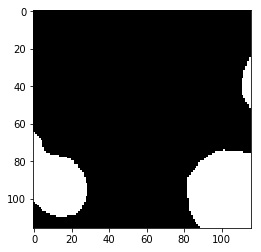

Label  23


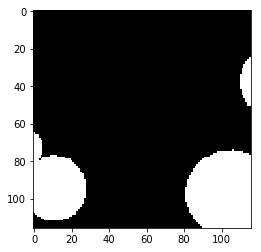

Prediction  24


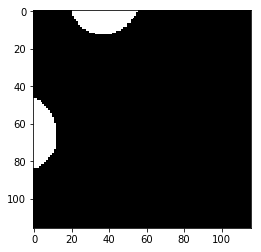

Label  24


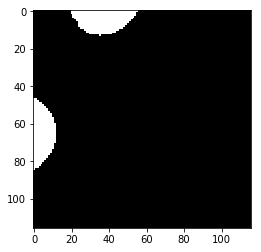

Prediction  25


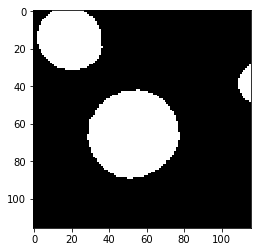

Label  25


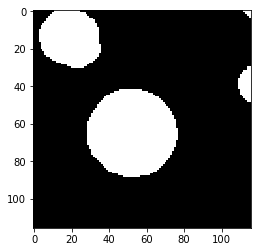

Prediction  26


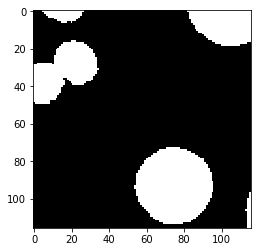

Label  26


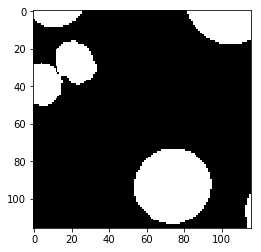

test_accuracy 0.972706762695
Batch: 16500 Train Loss value:0.00926678 Train Accuracy 0.993481481481
Prediction  0


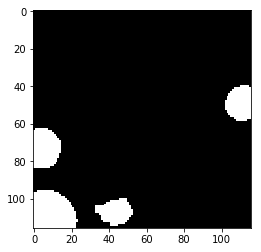

Label  0


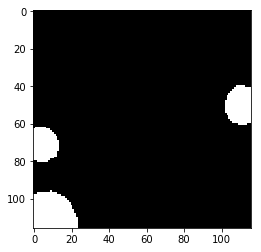

Prediction  1


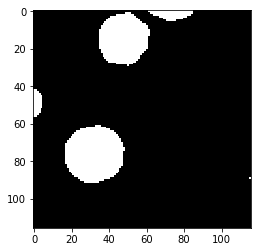

Label  1


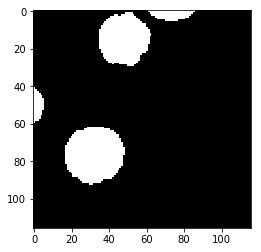

Prediction  2


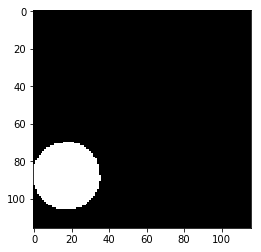

Label  2


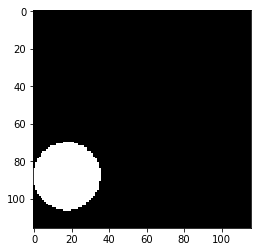

Prediction  3


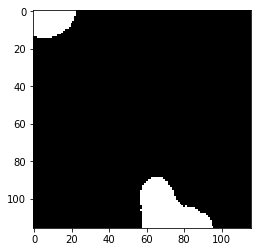

Label  3


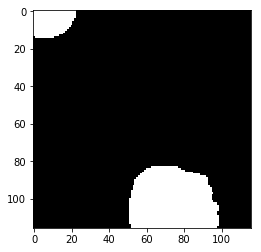

Prediction  4


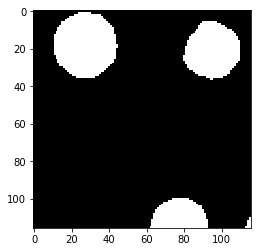

Label  4


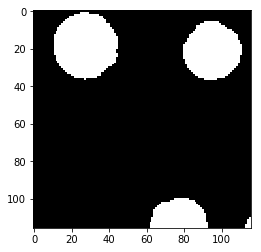

Prediction  5


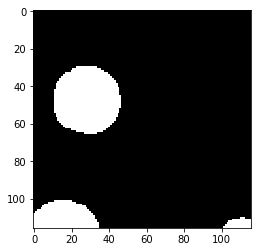

Label  5


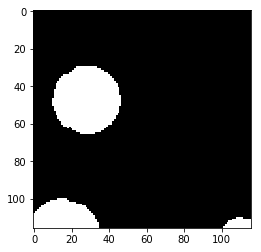

Prediction  6


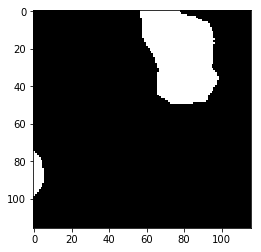

Label  6


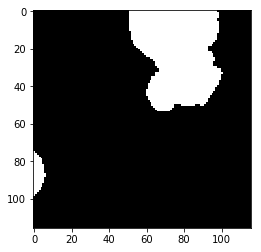

Prediction  7


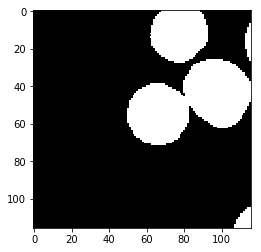

Label  7


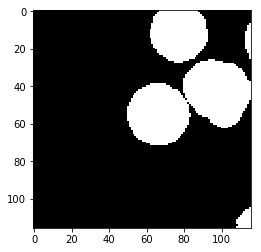

Prediction  8


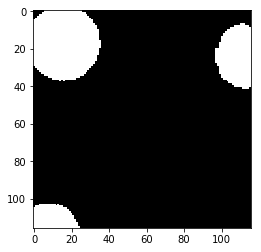

Label  8


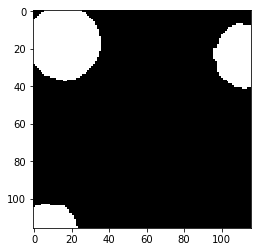

Prediction  9


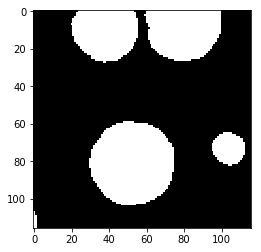

Label  9


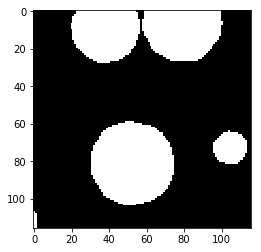

Prediction  10


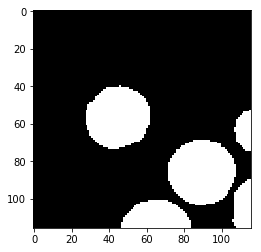

Label  10


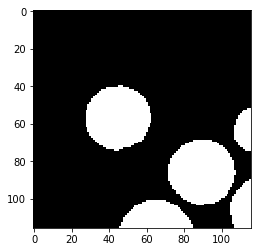

Prediction  11


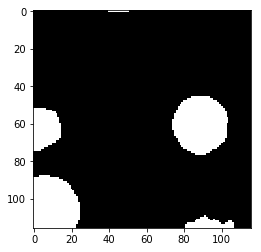

Label  11


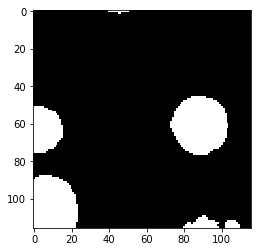

Prediction  12


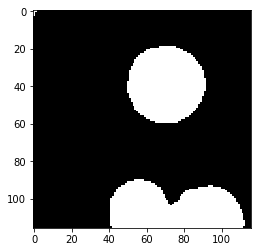

Label  12


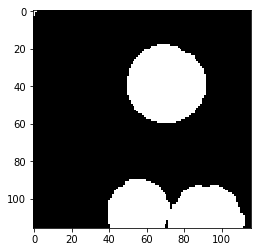

Prediction  13


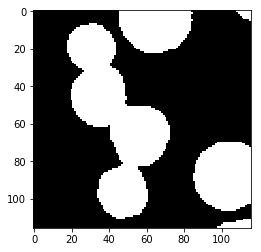

Label  13


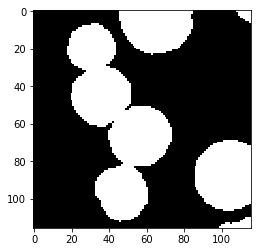

Prediction  14


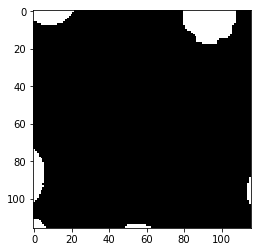

Label  14


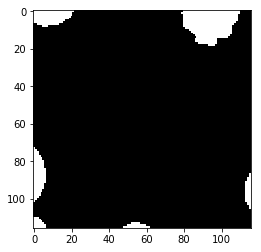

Prediction  15


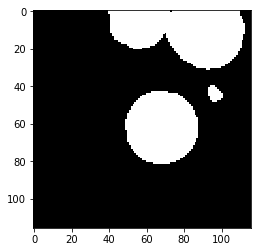

Label  15


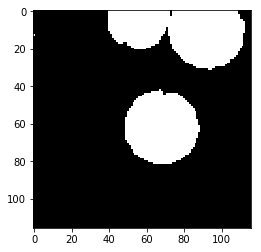

Prediction  16


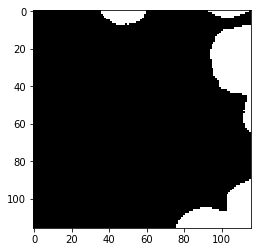

Label  16


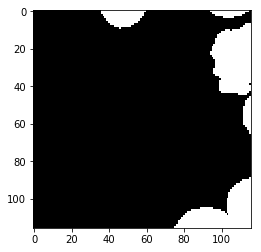

Prediction  17


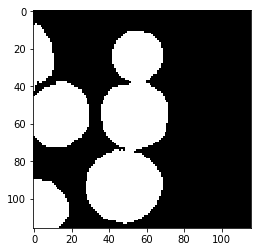

Label  17


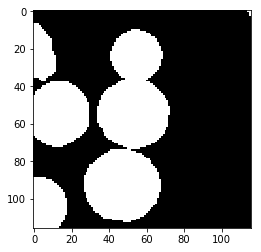

Prediction  18


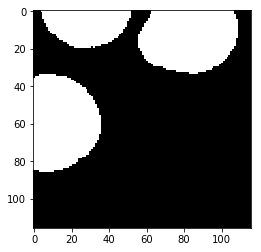

Label  18


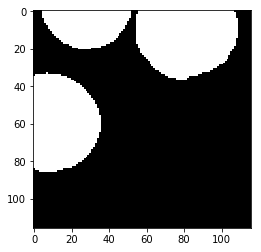

Prediction  19


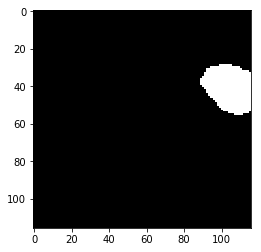

Label  19


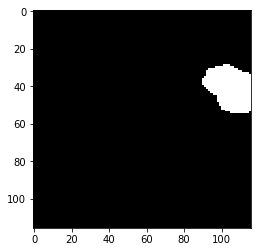

Prediction  20


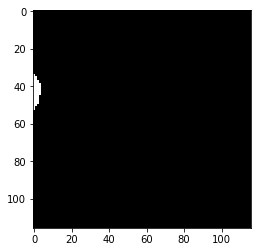

Label  20


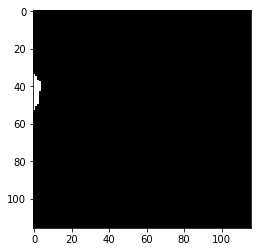

Prediction  21


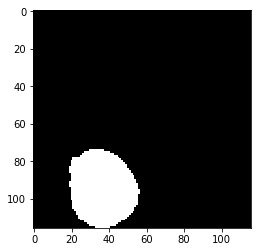

Label  21


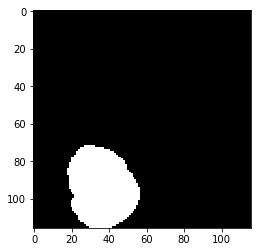

Prediction  22


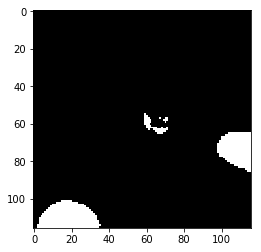

Label  22


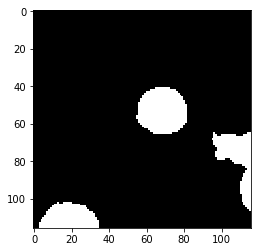

Prediction  23


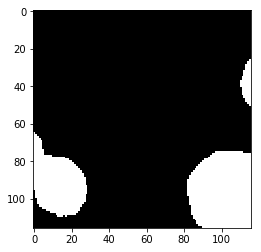

Label  23


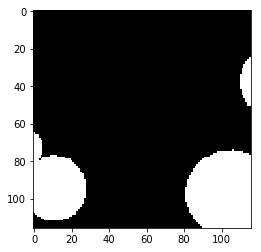

Prediction  24


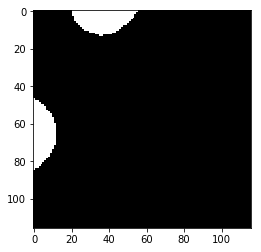

Label  24


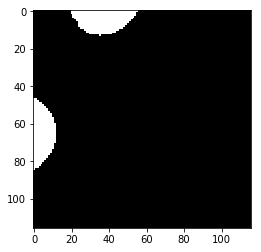

Prediction  25


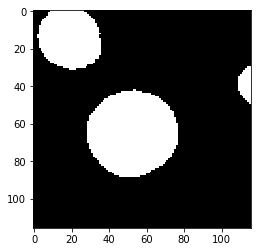

Label  25


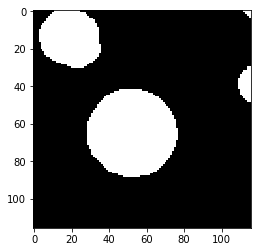

Prediction  26


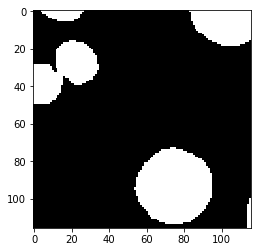

Label  26


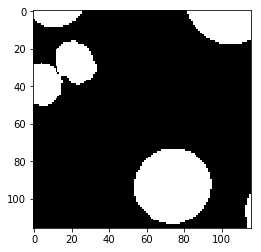

test_accuracy 0.973383662614
Batch: 17000 Train Loss value:0.0236711 Train Accuracy 0.981591929902
Prediction  0


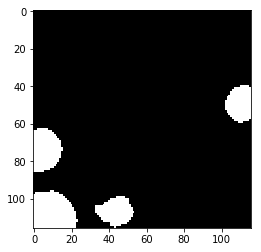

Label  0


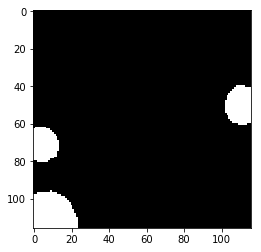

Prediction  1


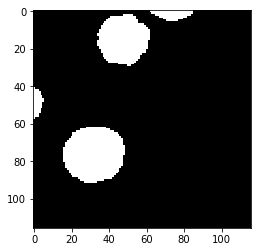

Label  1


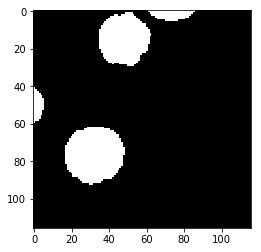

Prediction  2


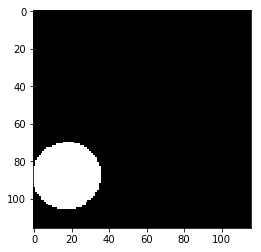

Label  2


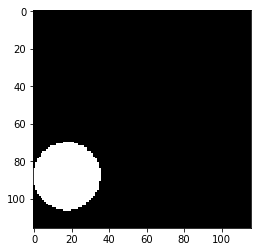

Prediction  3


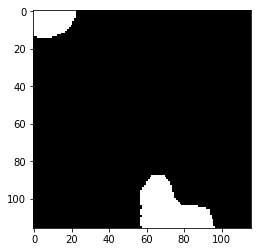

Label  3


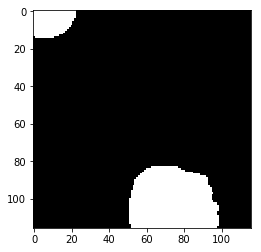

Prediction  4


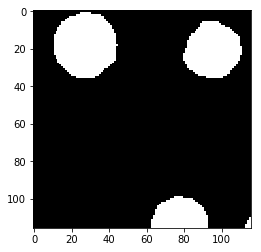

Label  4


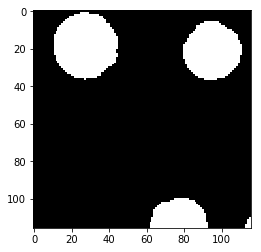

Prediction  5


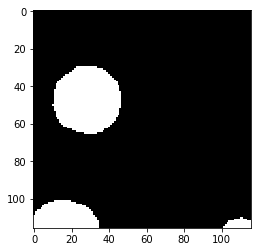

Label  5


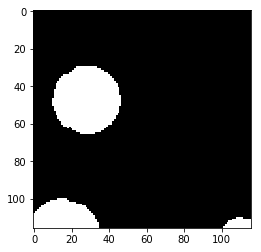

Prediction  6


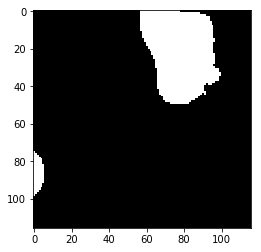

Label  6


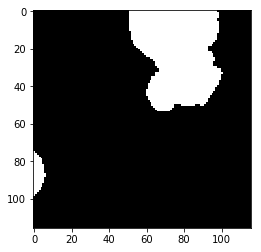

Prediction  7


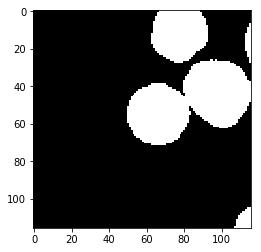

Label  7


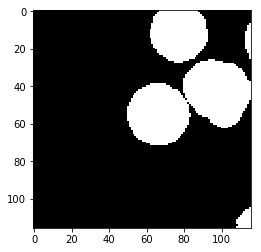

Prediction  8


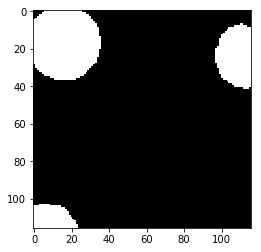

Label  8


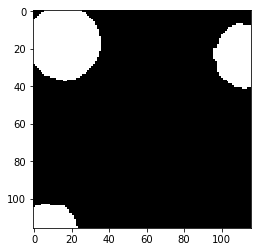

Prediction  9


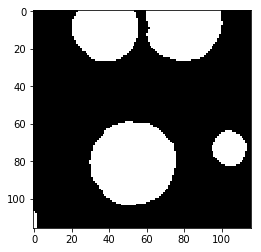

Label  9


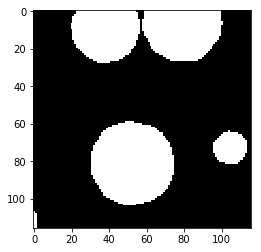

Prediction  10


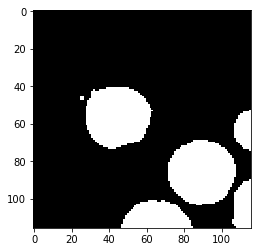

Label  10


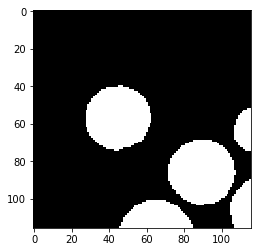

Prediction  11


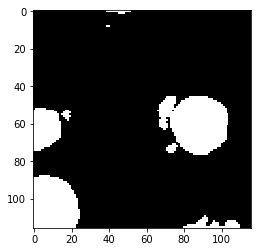

Label  11


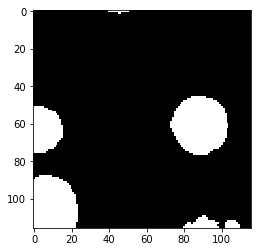

Prediction  12


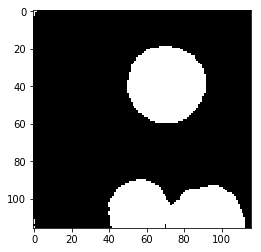

Label  12


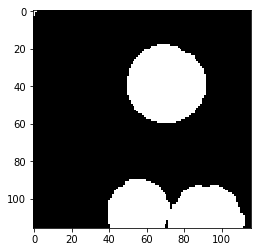

Prediction  13


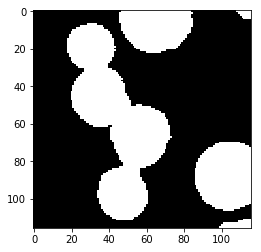

Label  13


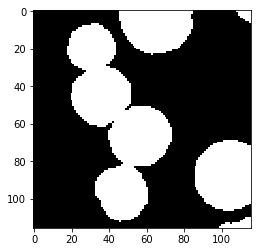

Prediction  14


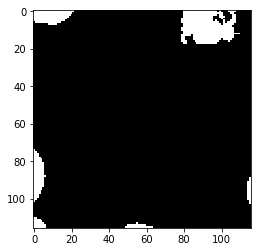

Label  14


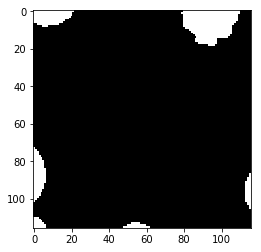

Prediction  15


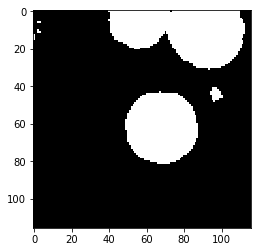

Label  15


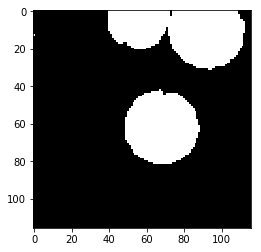

Prediction  16


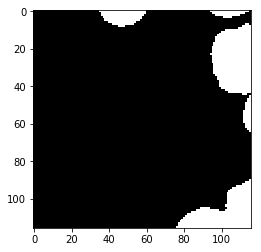

Label  16


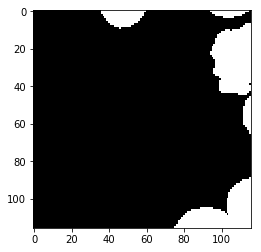

Prediction  17


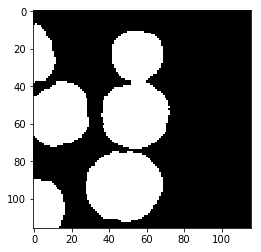

Label  17


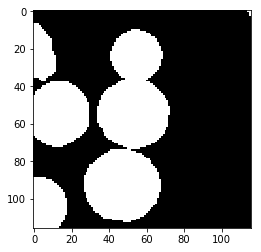

Prediction  18


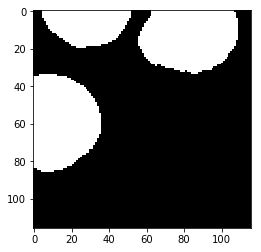

Label  18


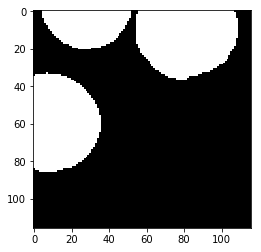

Prediction  19


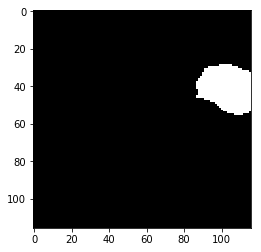

Label  19


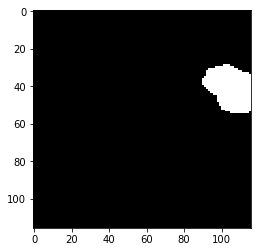

Prediction  20


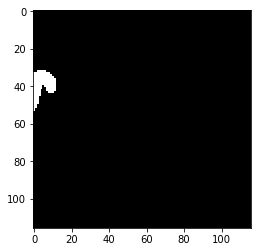

Label  20


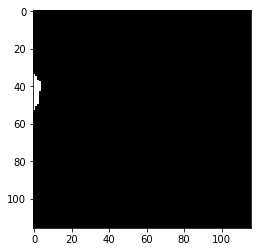

Prediction  21


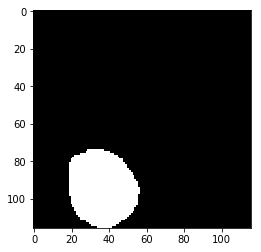

Label  21


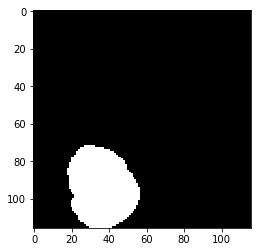

Prediction  22


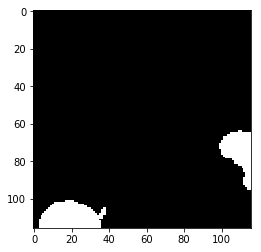

Label  22


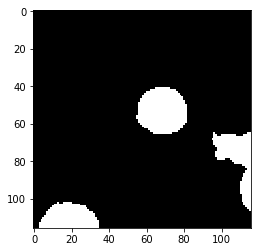

Prediction  23


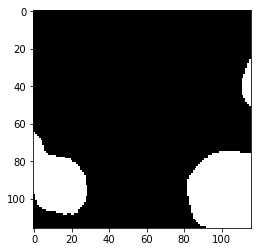

Label  23


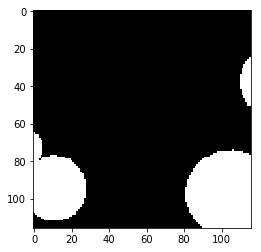

Prediction  24


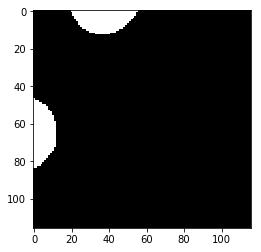

Label  24


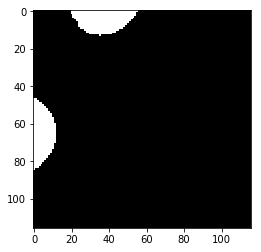

Prediction  25


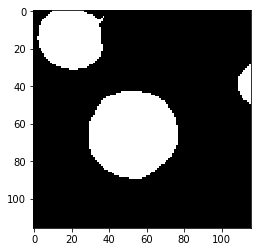

Label  25


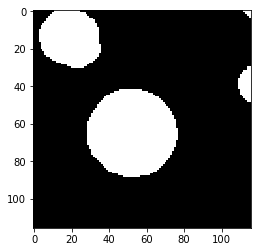

Prediction  26


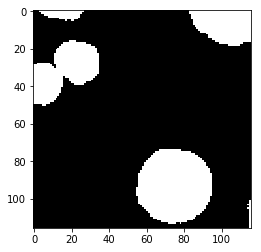

Label  26


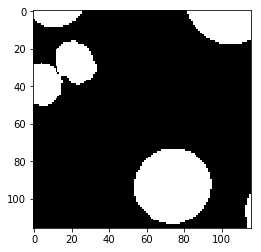

test_accuracy 0.970072050661
Batch: 17500 Train Loss value:0.0116242 Train Accuracy 0.990238130454
Prediction  0


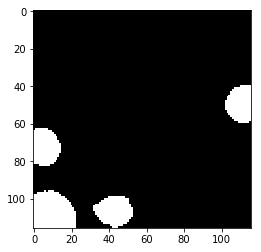

Label  0


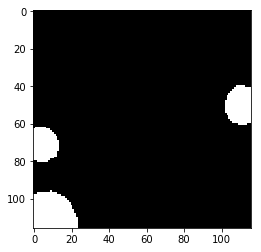

Prediction  1


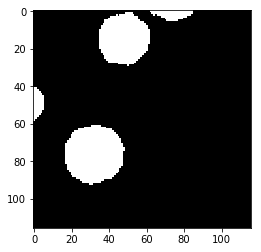

Label  1


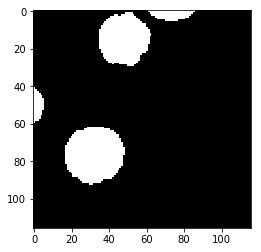

Prediction  2


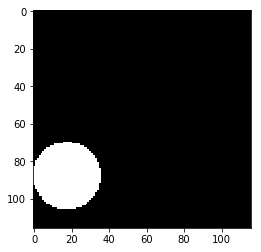

Label  2


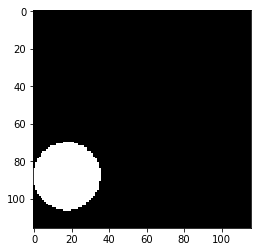

Prediction  3


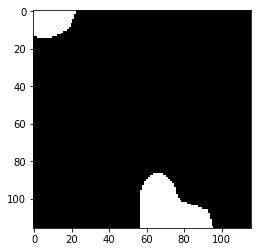

Label  3


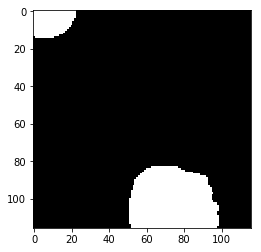

Prediction  4


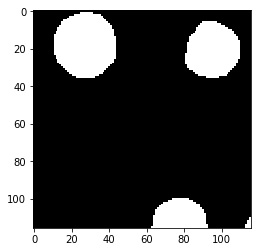

Label  4


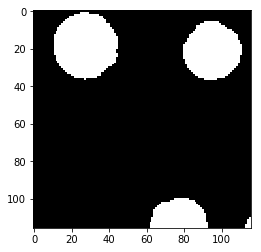

Prediction  5


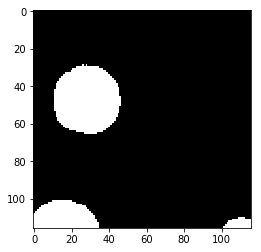

Label  5


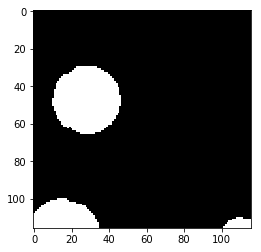

Prediction  6


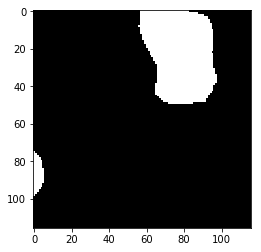

Label  6


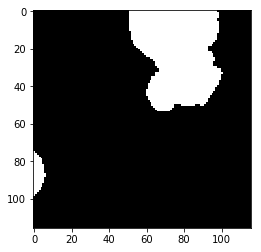

Prediction  7


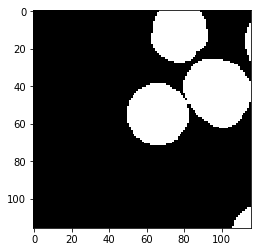

Label  7


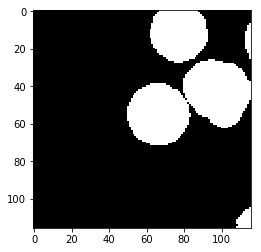

Prediction  8


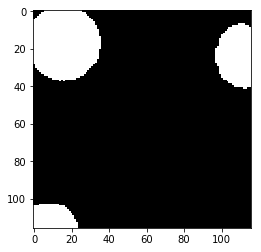

Label  8


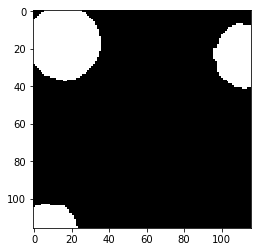

Prediction  9


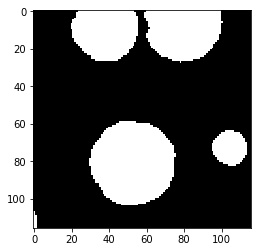

Label  9


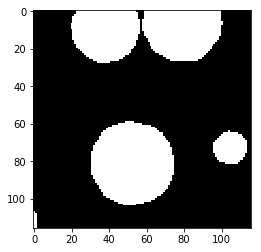

Prediction  10


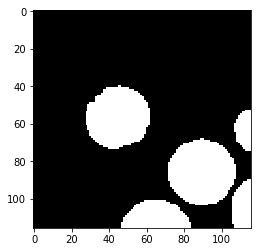

Label  10


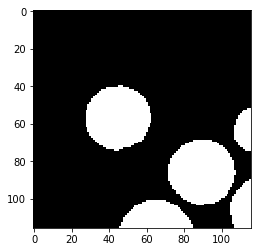

Prediction  11


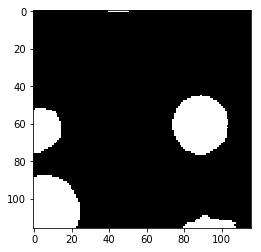

Label  11


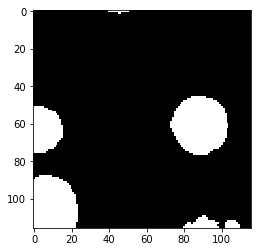

Prediction  12


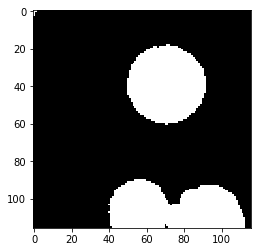

Label  12


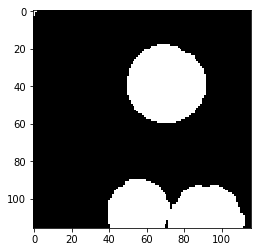

Prediction  13


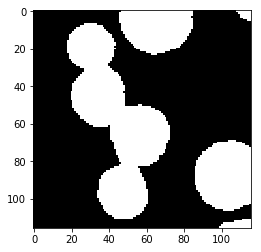

Label  13


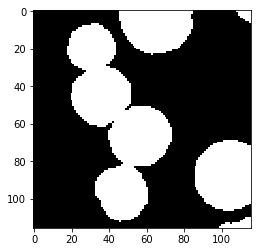

Prediction  14


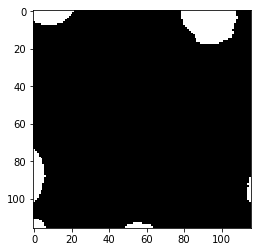

Label  14


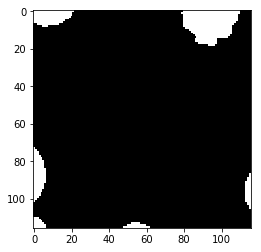

Prediction  15


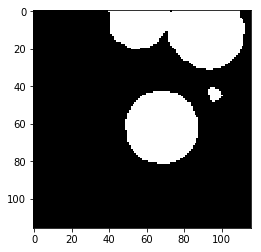

Label  15


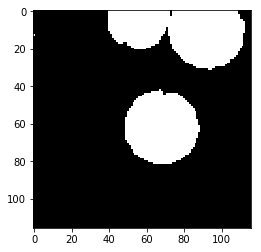

Prediction  16


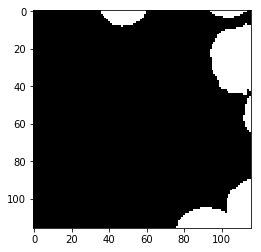

Label  16


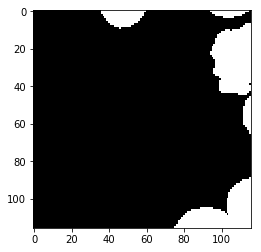

Prediction  17


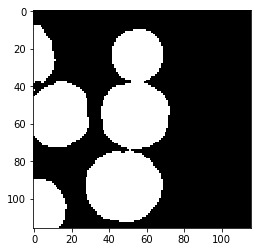

Label  17


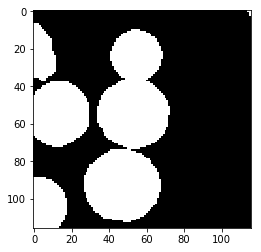

Prediction  18


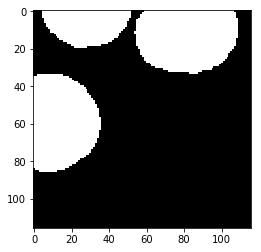

Label  18


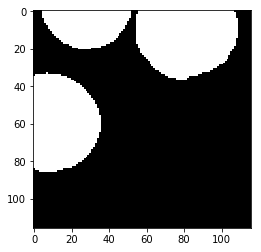

Prediction  19


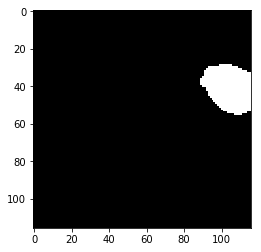

Label  19


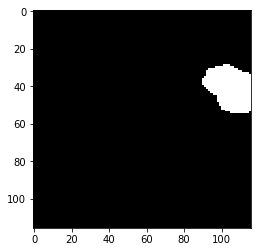

Prediction  20


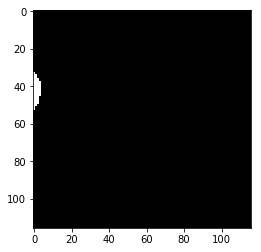

Label  20


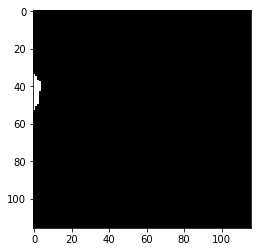

Prediction  21


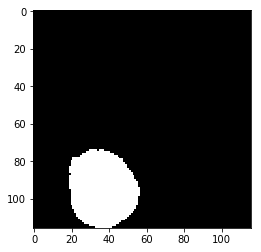

Label  21


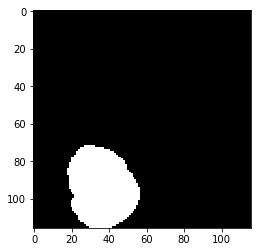

Prediction  22


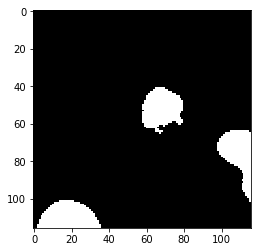

Label  22


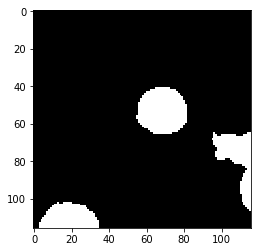

Prediction  23


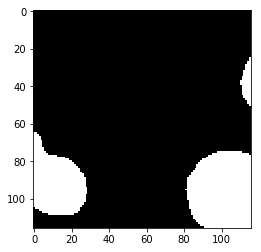

Label  23


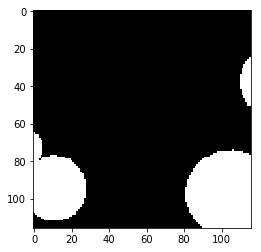

Prediction  24


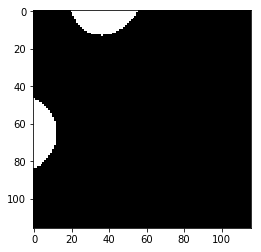

Label  24


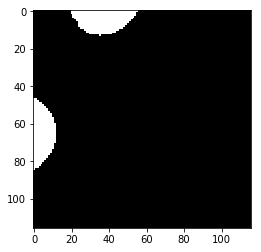

Prediction  25


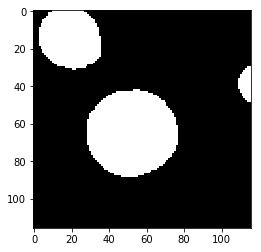

Label  25


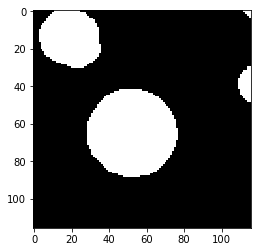

Prediction  26


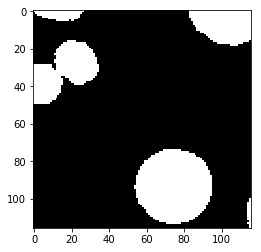

Label  26


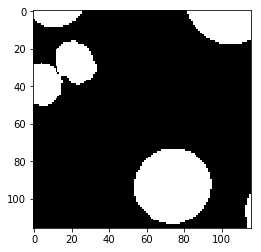

test_accuracy 0.977276526506
Batch: 18000 Train Loss value:0.00282327 Train Accuracy 0.997772993839
Prediction  0


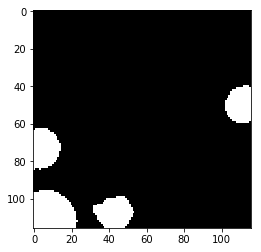

Label  0


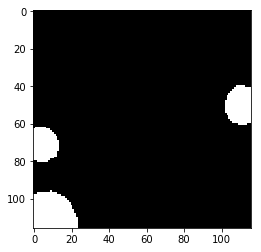

Prediction  1


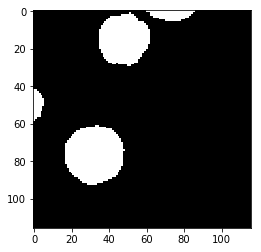

Label  1


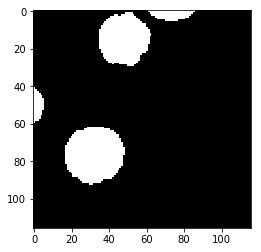

Prediction  2


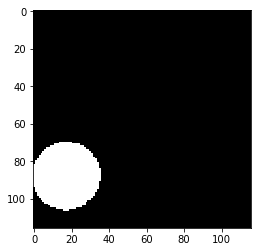

Label  2


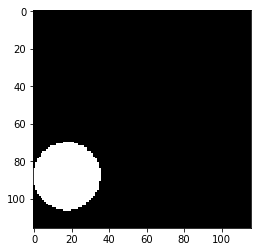

Prediction  3


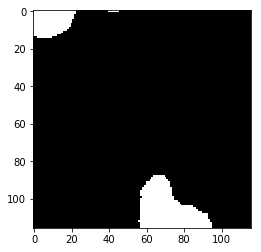

Label  3


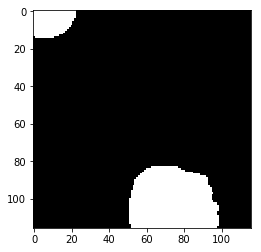

Prediction  4


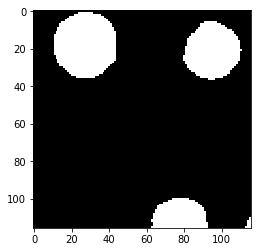

Label  4


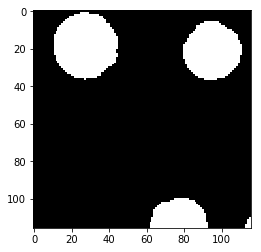

Prediction  5


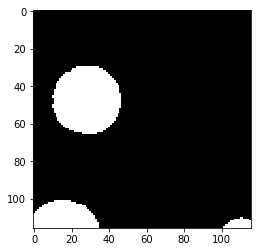

Label  5


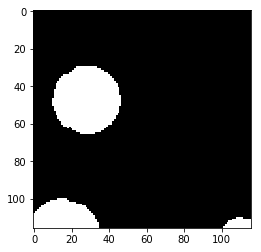

Prediction  6


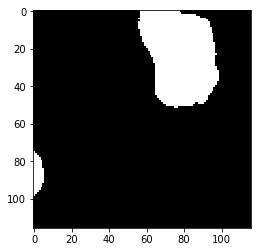

Label  6


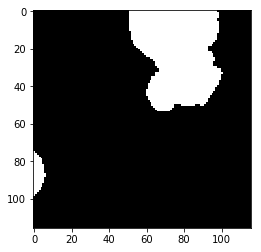

Prediction  7


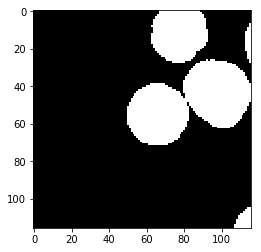

Label  7


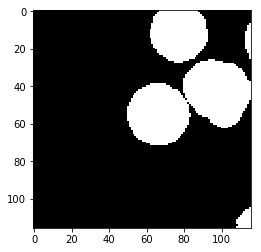

Prediction  8


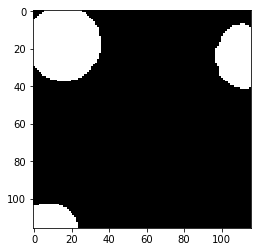

Label  8


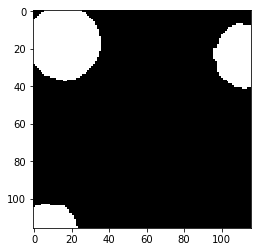

Prediction  9


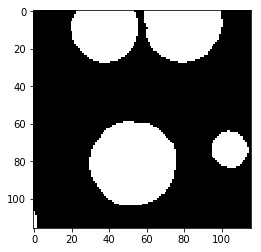

Label  9


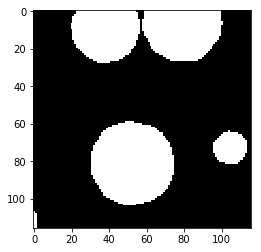

Prediction  10


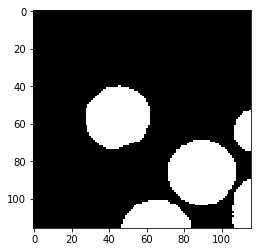

Label  10


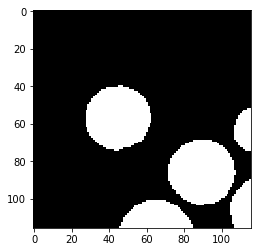

Prediction  11


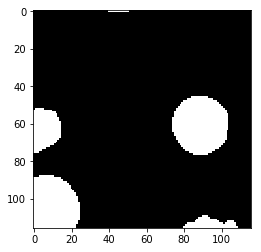

Label  11


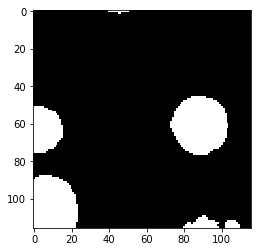

Prediction  12


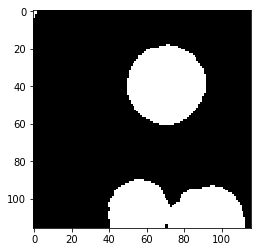

Label  12


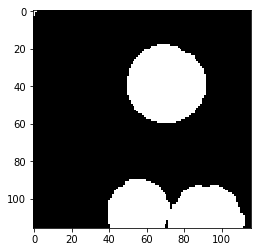

Prediction  13


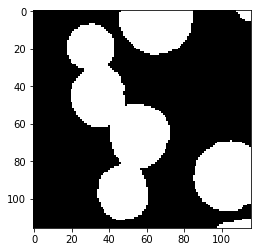

Label  13


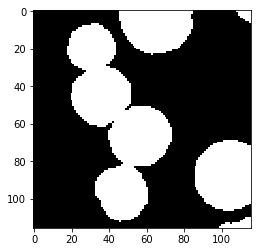

Prediction  14


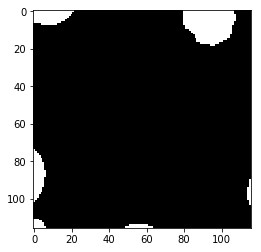

Label  14


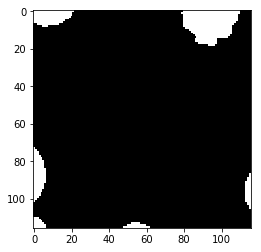

Prediction  15


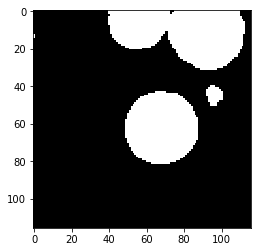

Label  15


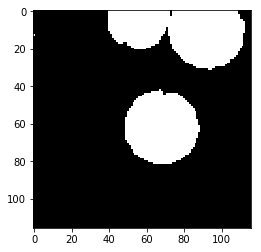

Prediction  16


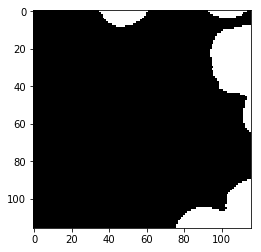

Label  16


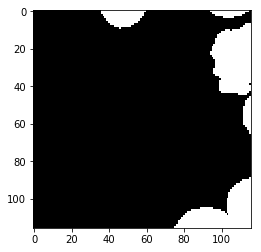

Prediction  17


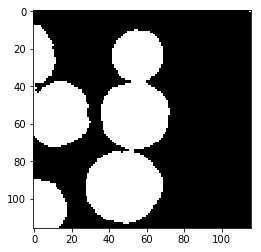

Label  17


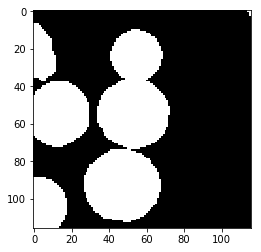

Prediction  18


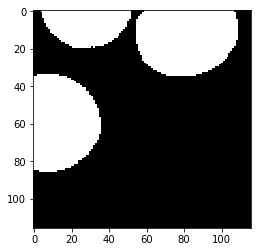

Label  18


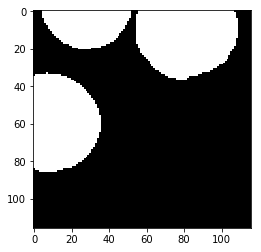

Prediction  19


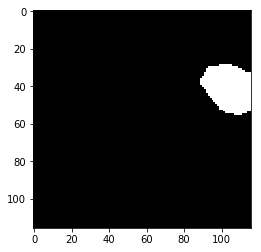

Label  19


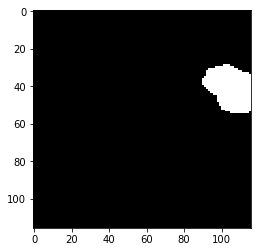

Prediction  20


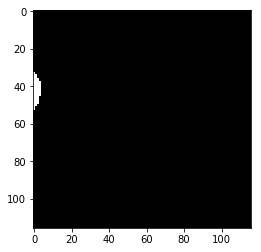

Label  20


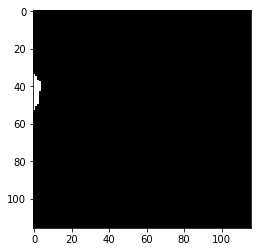

Prediction  21


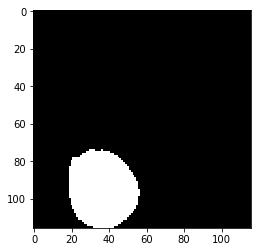

Label  21


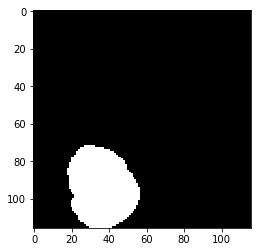

Prediction  22


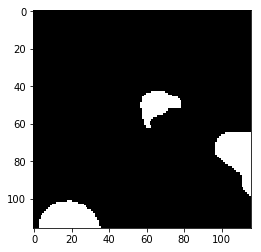

Label  22


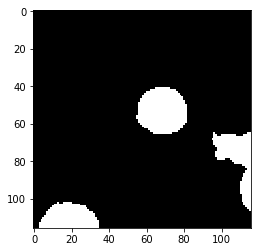

Prediction  23


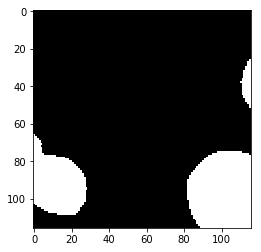

Label  23


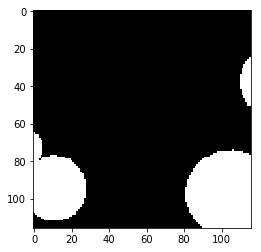

Prediction  24


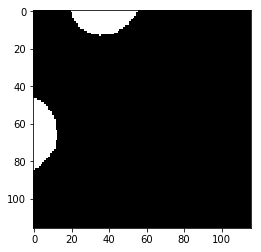

Label  24


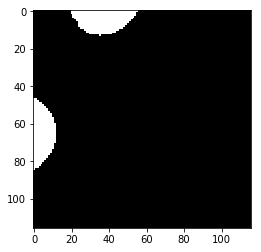

Prediction  25


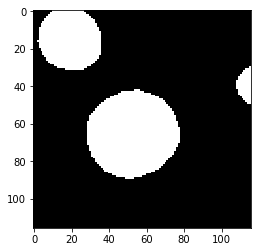

Label  25


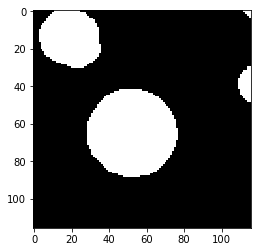

Prediction  26


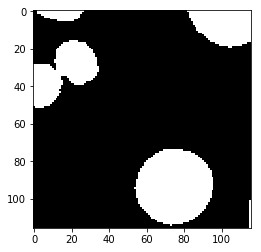

Label  26


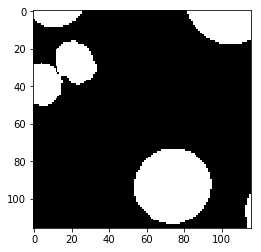

test_accuracy 0.974825926962
Batch: 18500 Train Loss value:0.00724965 Train Accuracy 0.994811355719
Prediction  0


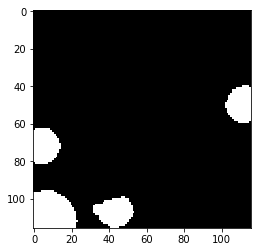

Label  0


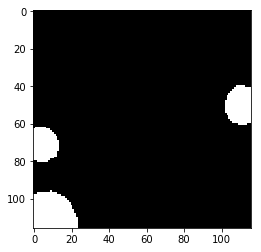

Prediction  1


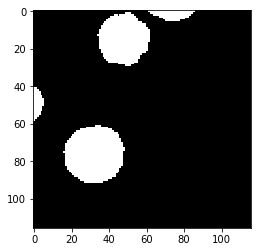

Label  1


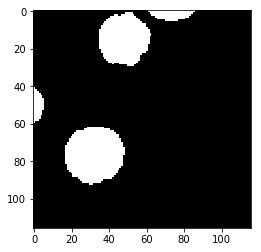

Prediction  2


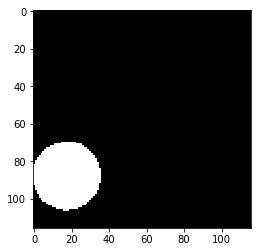

Label  2


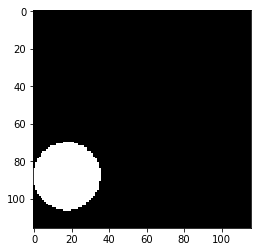

Prediction  3


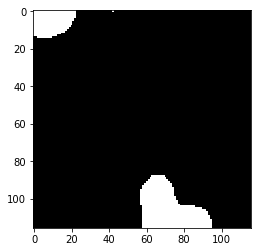

Label  3


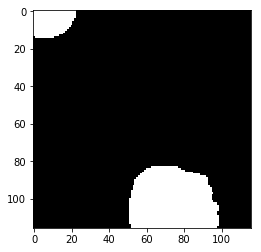

Prediction  4


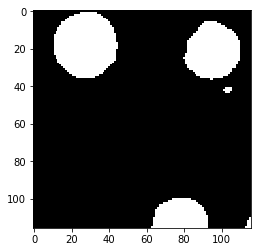

Label  4


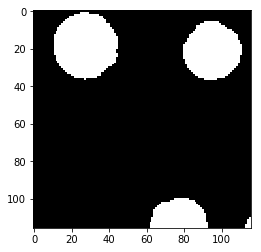

Prediction  5


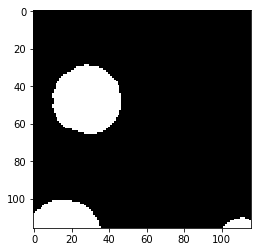

Label  5


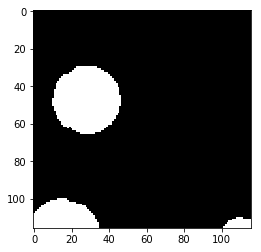

Prediction  6


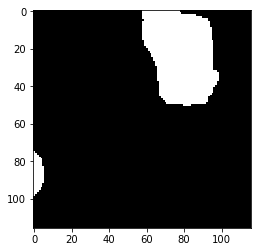

Label  6


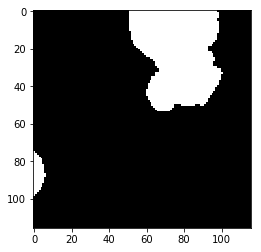

Prediction  7


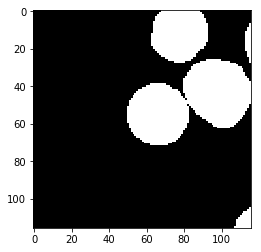

Label  7


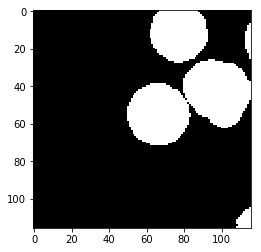

Prediction  8


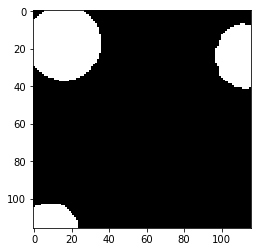

Label  8


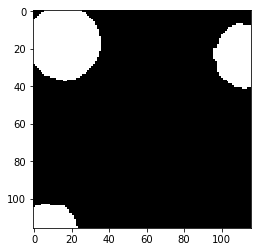

Prediction  9


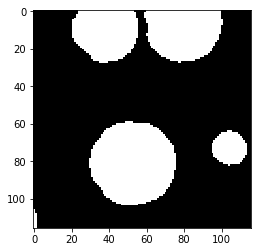

Label  9


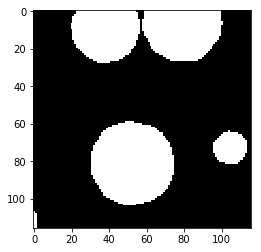

Prediction  10


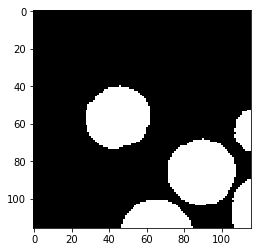

Label  10


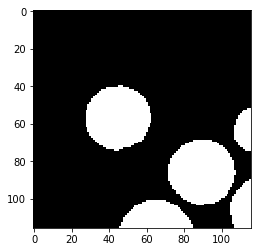

Prediction  11


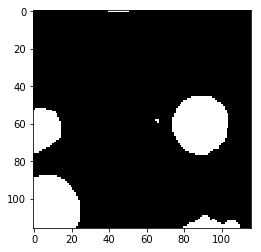

Label  11


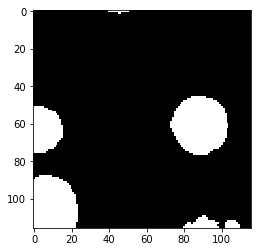

Prediction  12


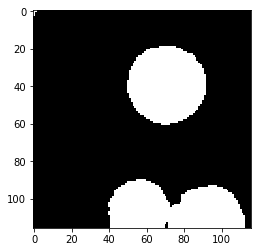

Label  12


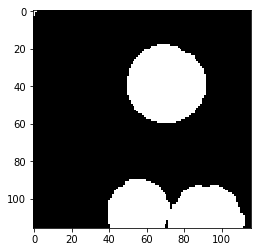

Prediction  13


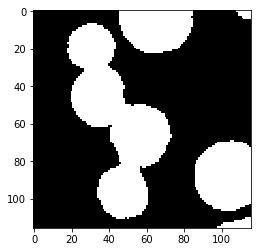

Label  13


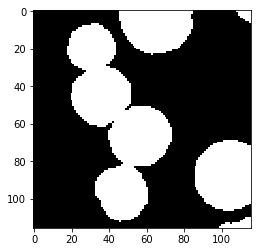

Prediction  14


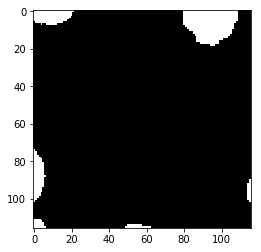

Label  14


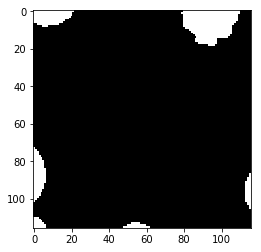

Prediction  15


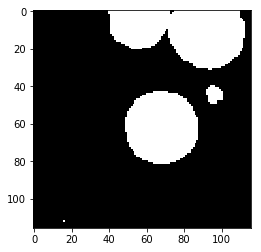

Label  15


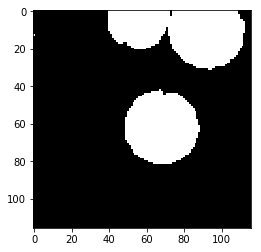

Prediction  16


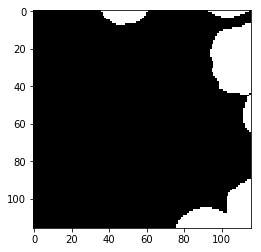

Label  16


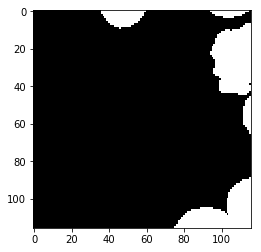

Prediction  17


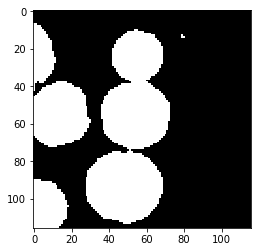

Label  17


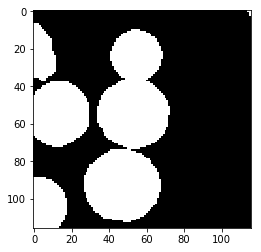

Prediction  18


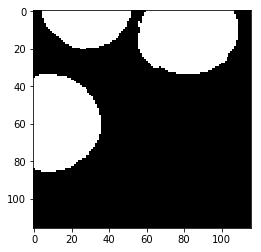

Label  18


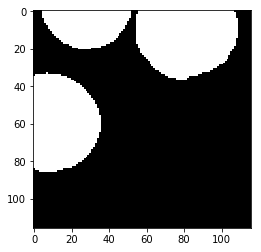

Prediction  19


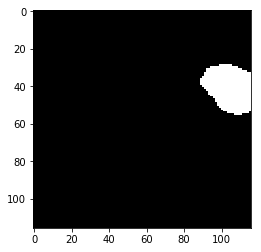

Label  19


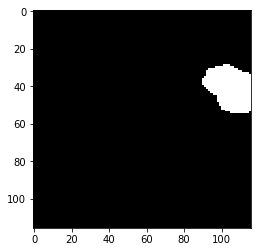

Prediction  20


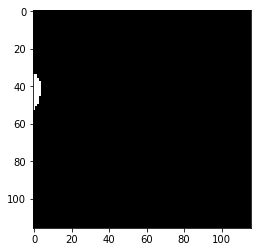

Label  20


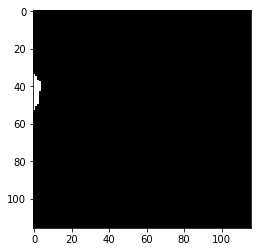

Prediction  21


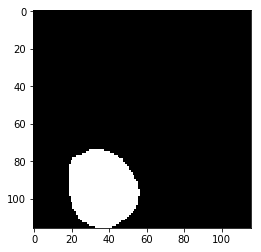

Label  21


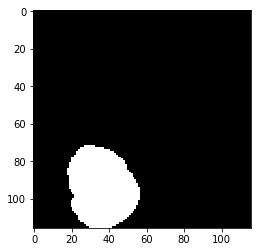

Prediction  22


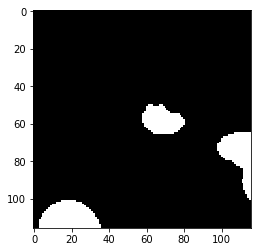

Label  22


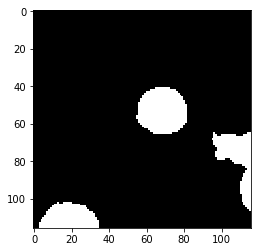

Prediction  23


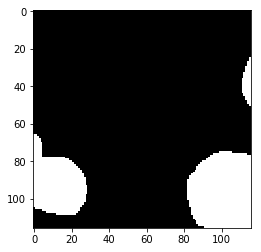

Label  23


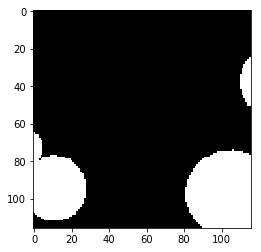

Prediction  24


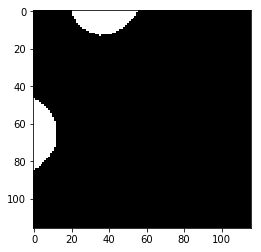

Label  24


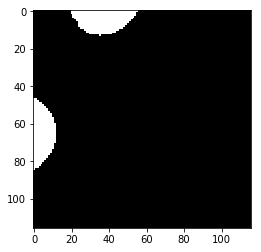

Prediction  25


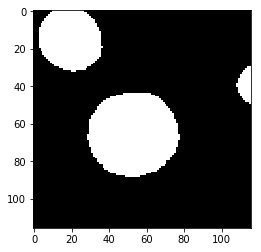

Label  25


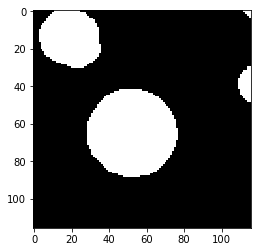

Prediction  26


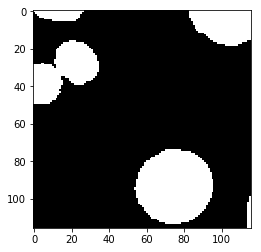

Label  26


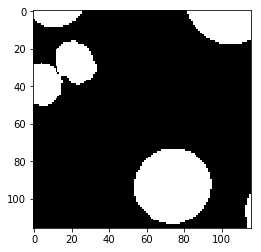

test_accuracy 0.975332900219
Batch: 19000 Train Loss value:0.0163996 Train Accuracy 0.985978894547
Prediction  0


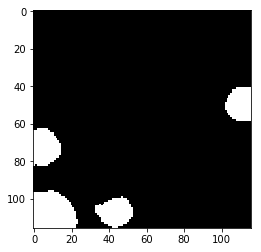

Label  0


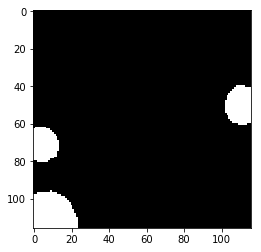

Prediction  1


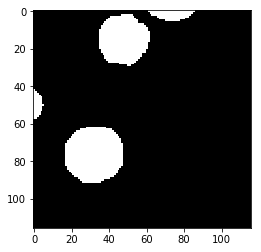

Label  1


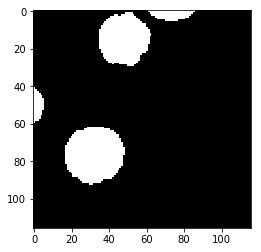

Prediction  2


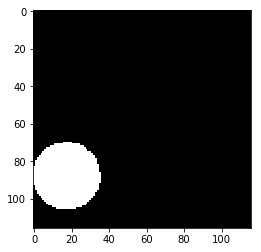

Label  2


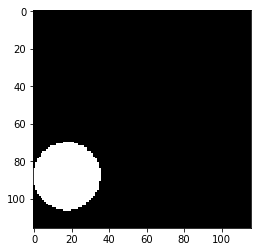

Prediction  3


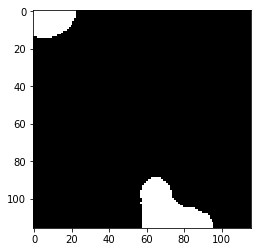

Label  3


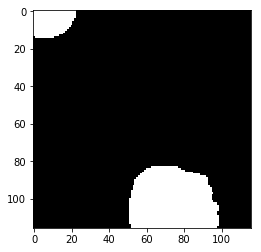

Prediction  4


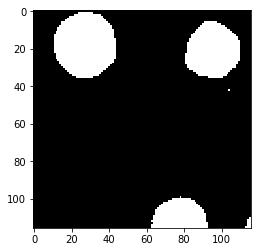

Label  4


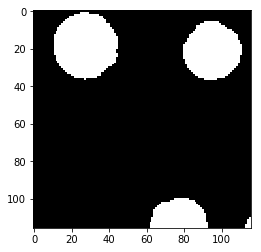

Prediction  5


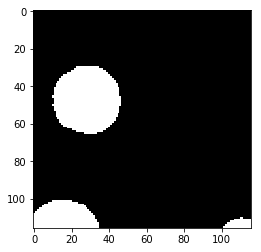

Label  5


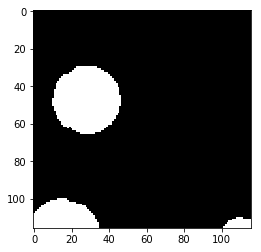

Prediction  6


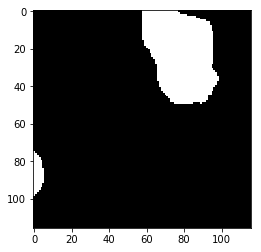

Label  6


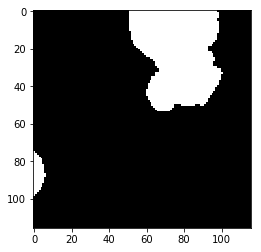

Prediction  7


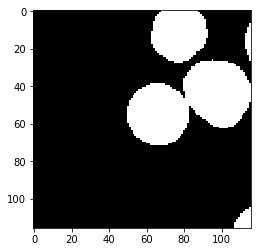

Label  7


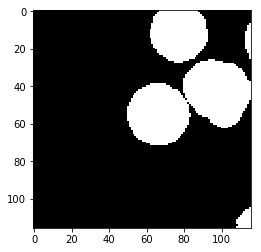

Prediction  8


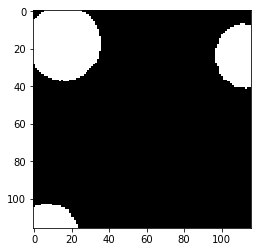

Label  8


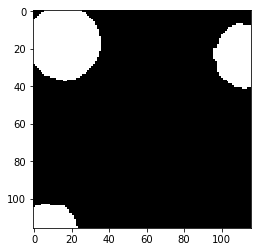

Prediction  9


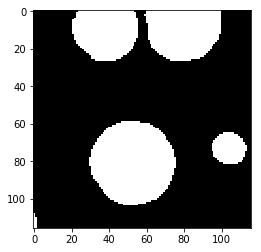

Label  9


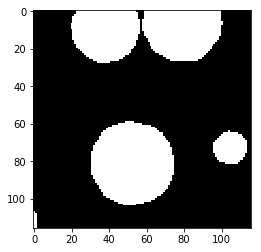

Prediction  10


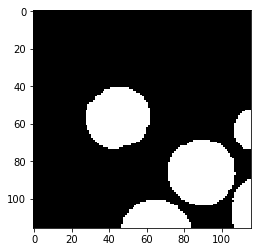

Label  10


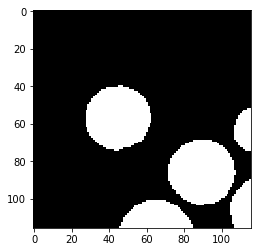

Prediction  11


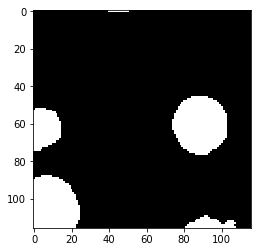

Label  11


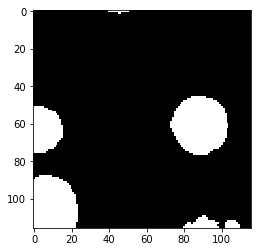

Prediction  12


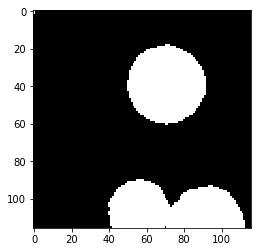

Label  12


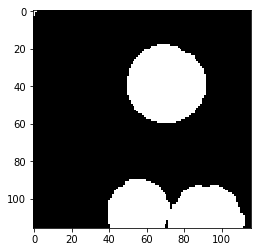

Prediction  13


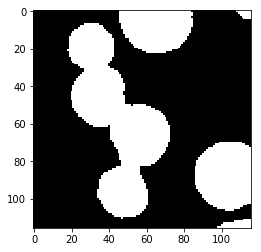

Label  13


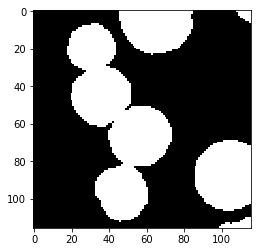

Prediction  14


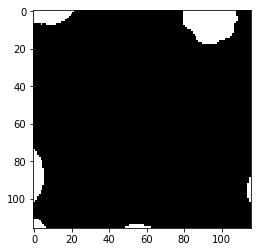

Label  14


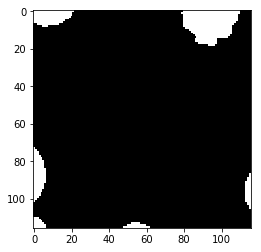

Prediction  15


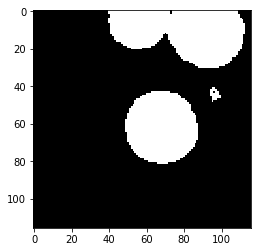

Label  15


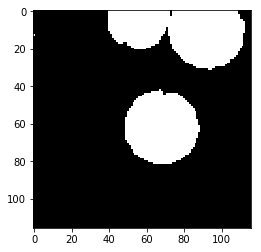

Prediction  16


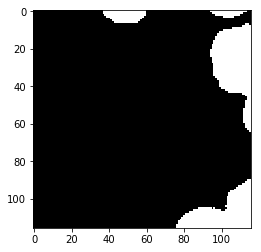

Label  16


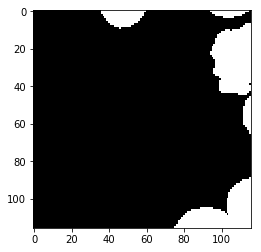

Prediction  17


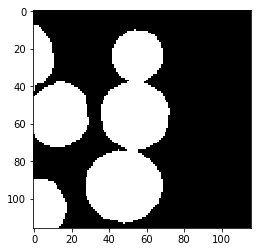

Label  17


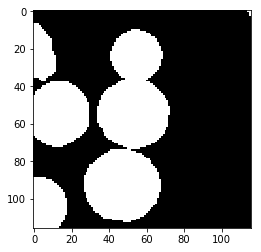

Prediction  18


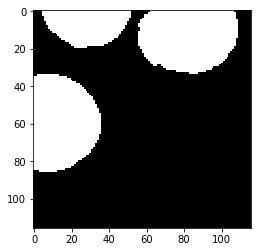

Label  18


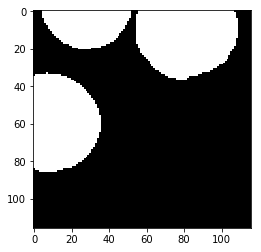

Prediction  19


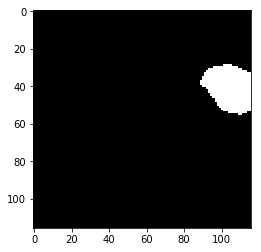

Label  19


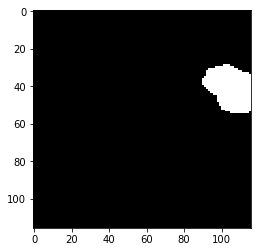

Prediction  20


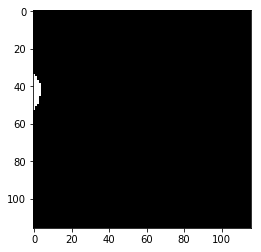

Label  20


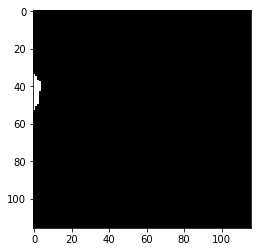

Prediction  21


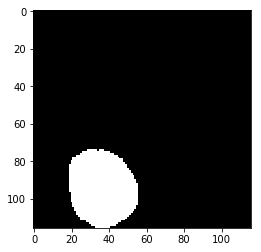

Label  21


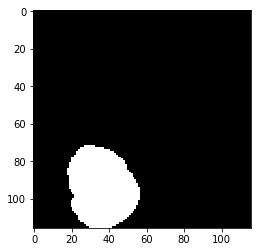

Prediction  22


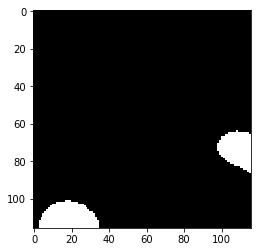

Label  22


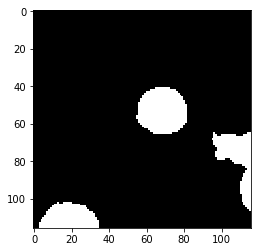

Prediction  23


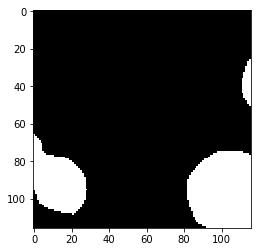

Label  23


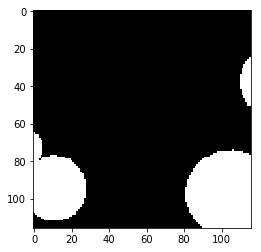

Prediction  24


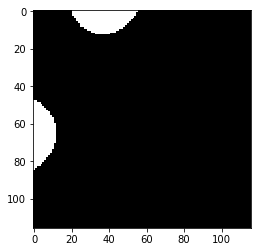

Label  24


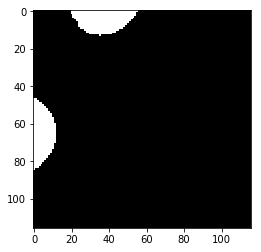

Prediction  25


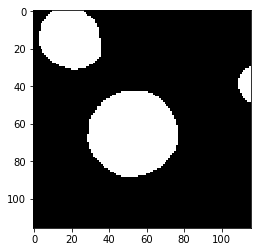

Label  25


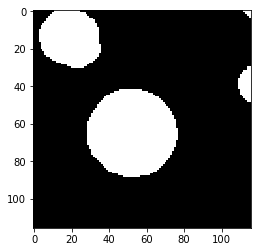

Prediction  26


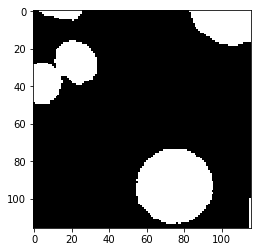

Label  26


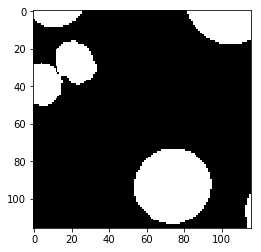

test_accuracy 0.972872225661
Batch: 19500 Train Loss value:0.00556752 Train Accuracy 0.995550941717
Prediction  0


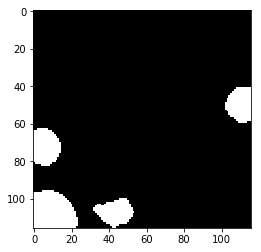

Label  0


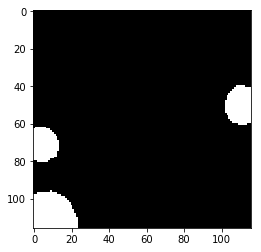

Prediction  1


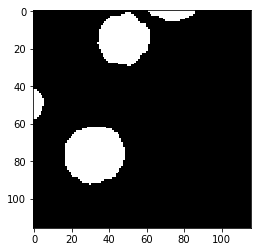

Label  1


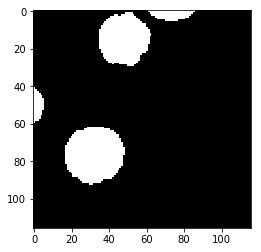

Prediction  2


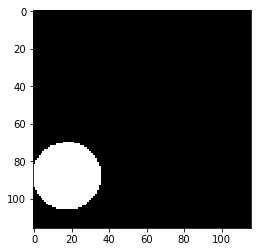

Label  2


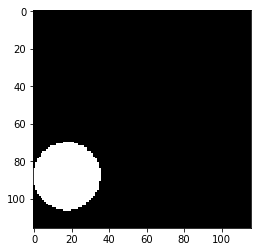

Prediction  3


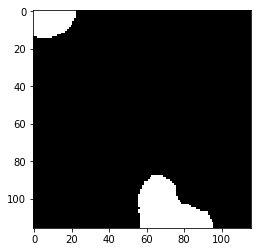

Label  3


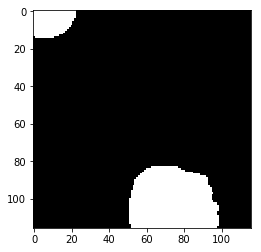

Prediction  4


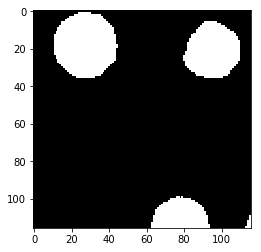

Label  4


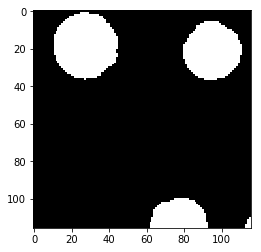

Prediction  5


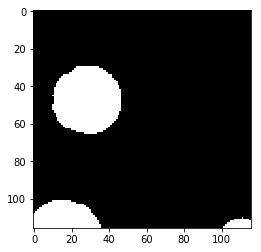

Label  5


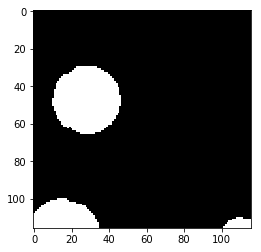

Prediction  6


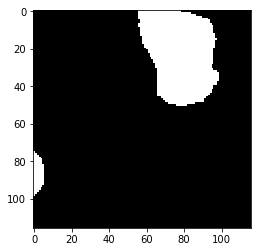

Label  6


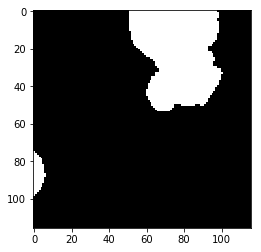

Prediction  7


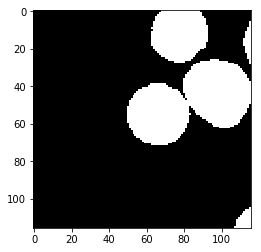

Label  7


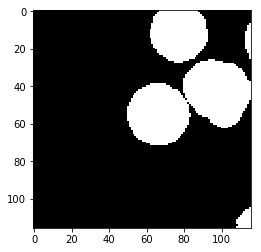

Prediction  8


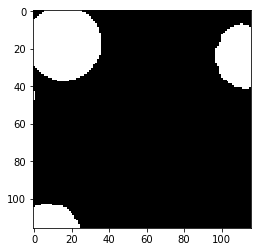

Label  8


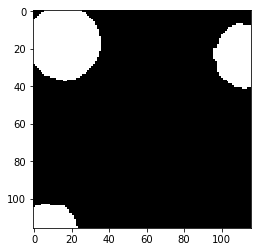

Prediction  9


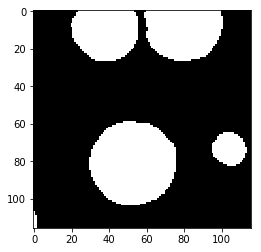

Label  9


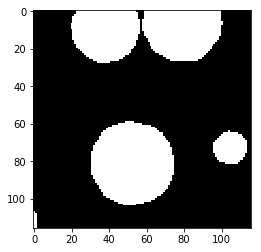

Prediction  10


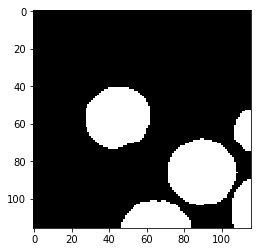

Label  10


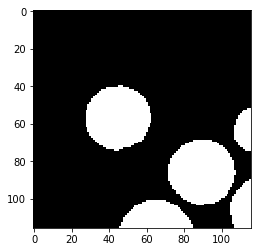

Prediction  11


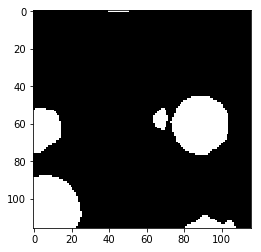

Label  11


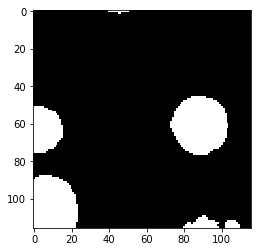

Prediction  12


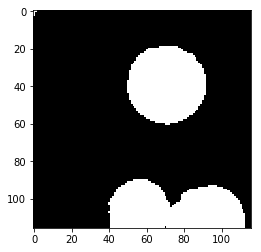

Label  12


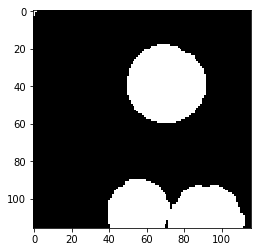

Prediction  13


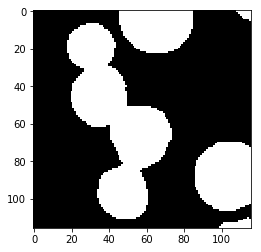

Label  13


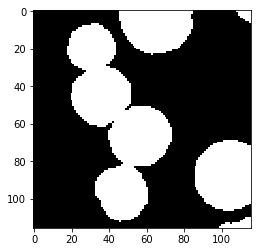

Prediction  14


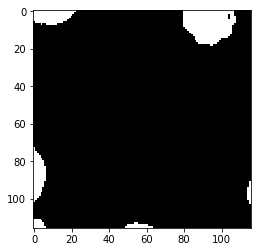

Label  14


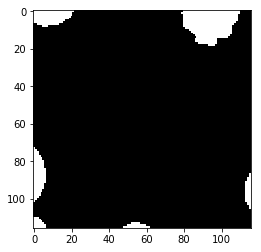

Prediction  15


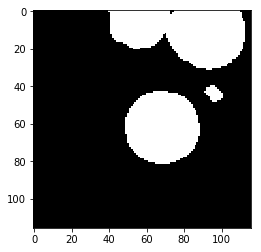

Label  15


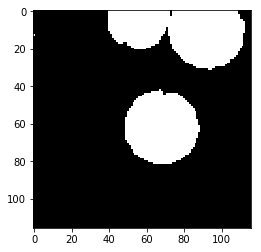

Prediction  16


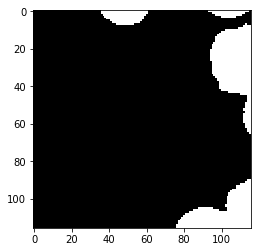

Label  16


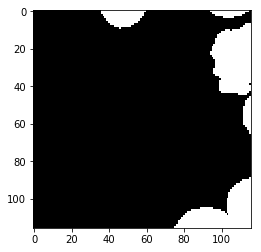

Prediction  17


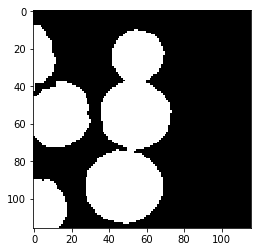

Label  17


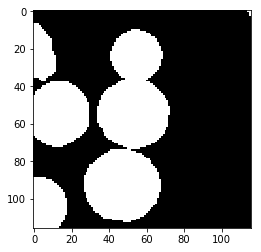

Prediction  18


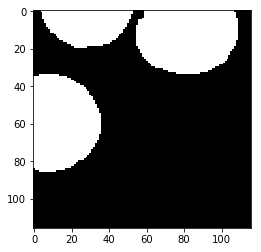

Label  18


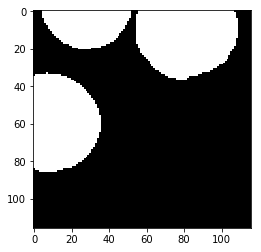

Prediction  19


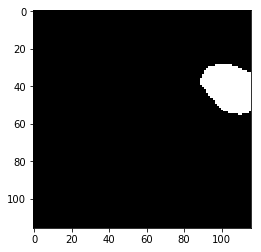

Label  19


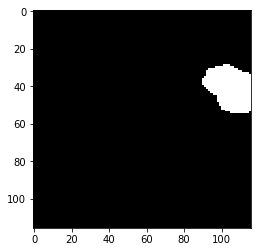

Prediction  20


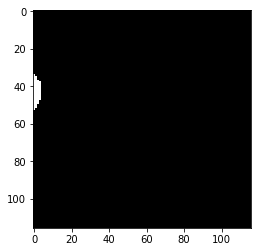

Label  20


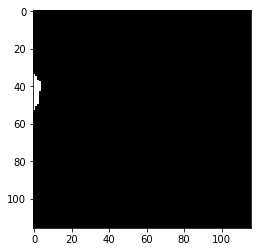

Prediction  21


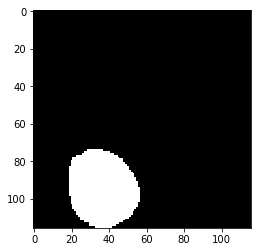

Label  21


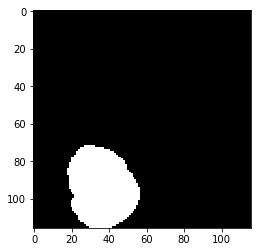

Prediction  22


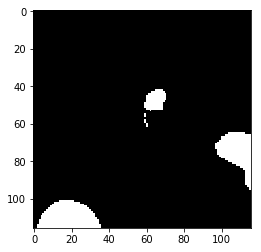

Label  22


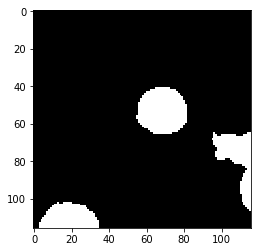

Prediction  23


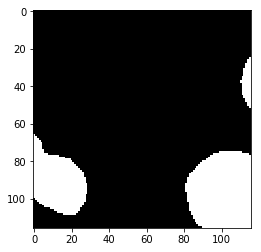

Label  23


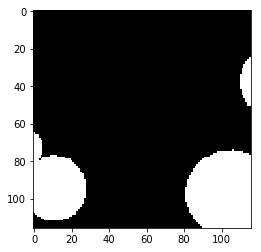

Prediction  24


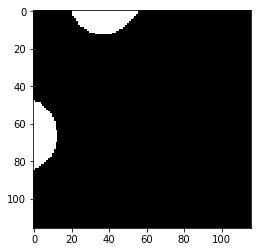

Label  24


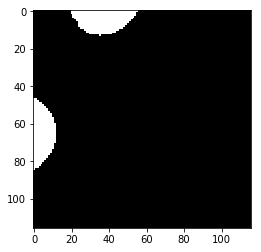

Prediction  25


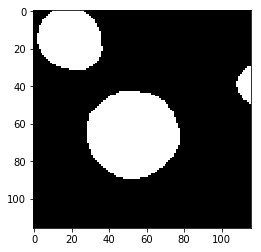

Label  25


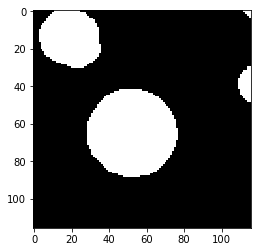

Prediction  26


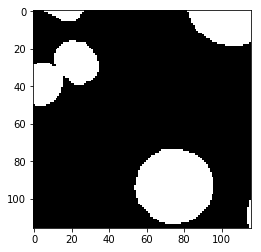

Label  26


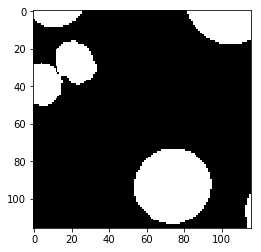

test_accuracy 0.973751600797
Batch: 20000 Train Loss value:0.0145228 Train Accuracy 0.987005316007
Prediction  0


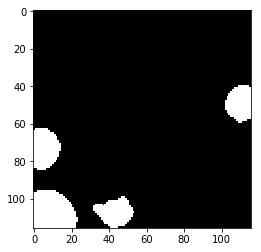

Label  0


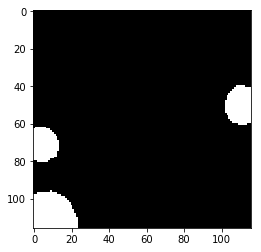

Prediction  1


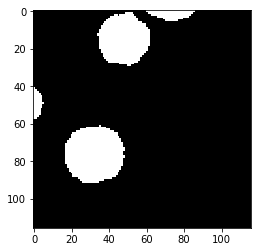

Label  1


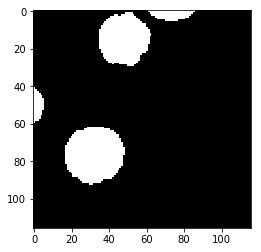

Prediction  2


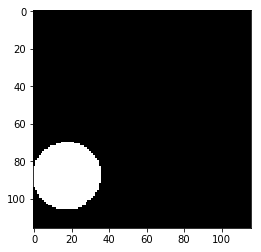

Label  2


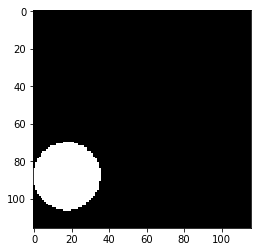

Prediction  3


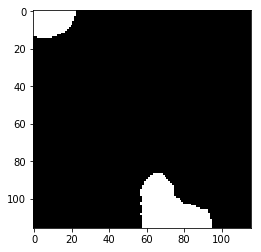

Label  3


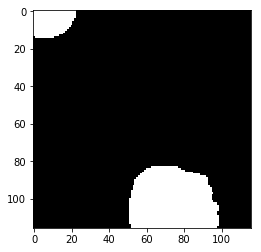

Prediction  4


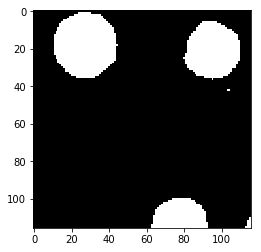

Label  4


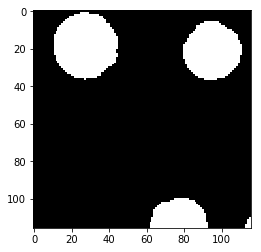

Prediction  5


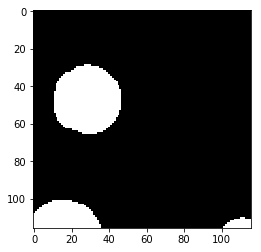

Label  5


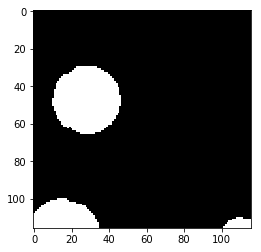

Prediction  6


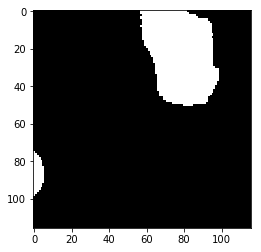

Label  6


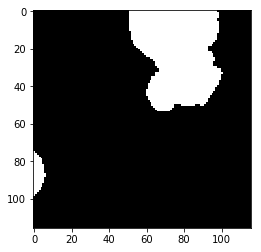

Prediction  7


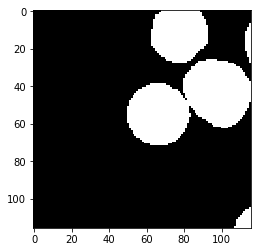

Label  7


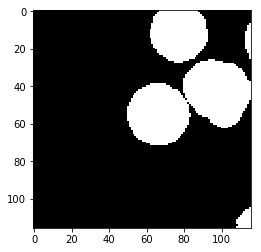

Prediction  8


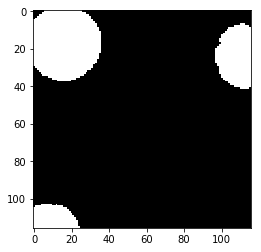

Label  8


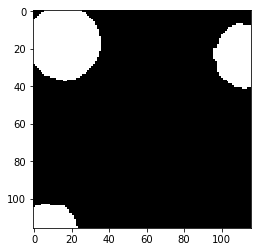

Prediction  9


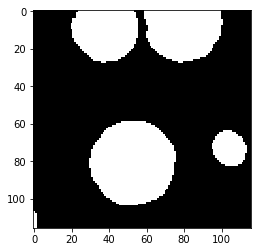

Label  9


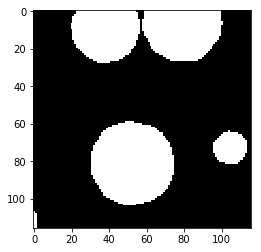

Prediction  10


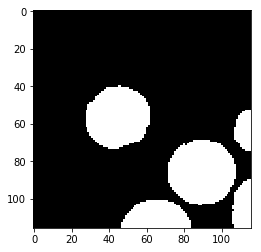

Label  10


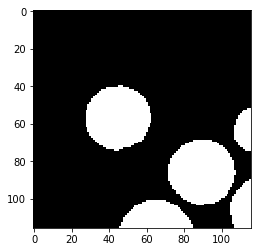

Prediction  11


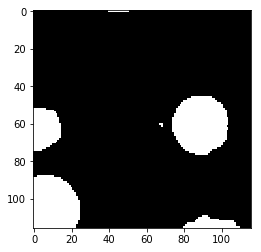

Label  11


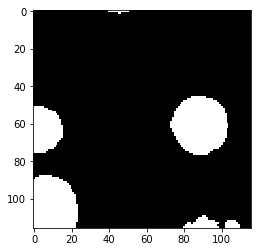

Prediction  12


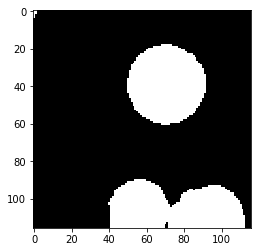

Label  12


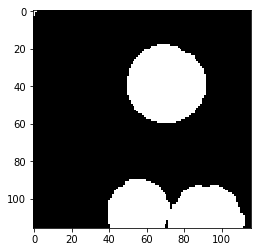

Prediction  13


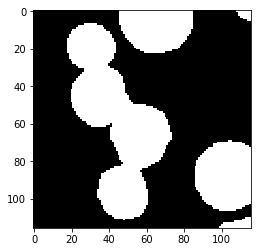

Label  13


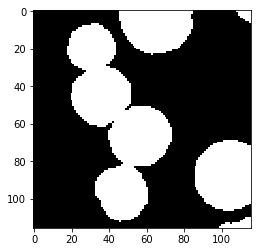

Prediction  14


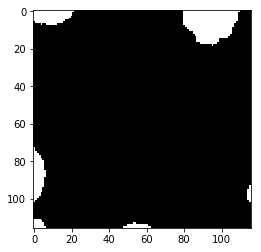

Label  14


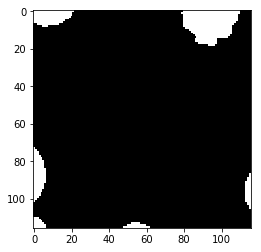

Prediction  15


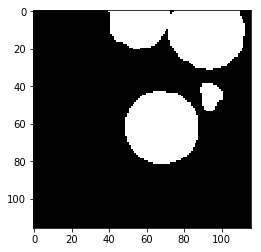

Label  15


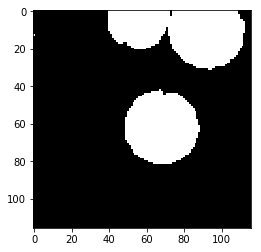

Prediction  16


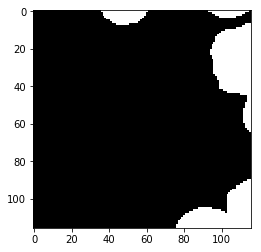

Label  16


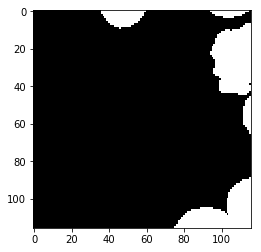

Prediction  17


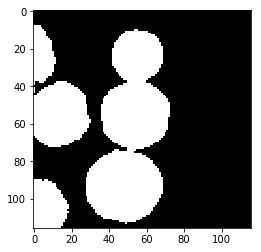

Label  17


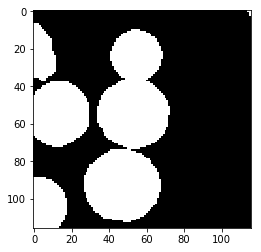

Prediction  18


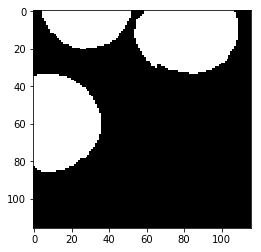

Label  18


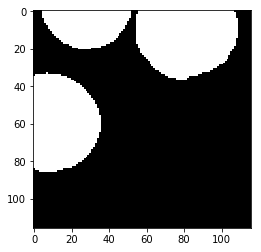

Prediction  19


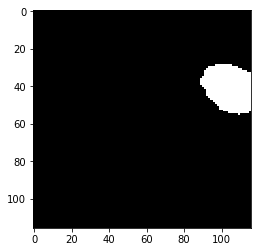

Label  19


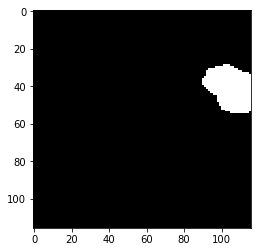

Prediction  20


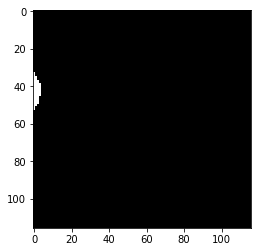

Label  20


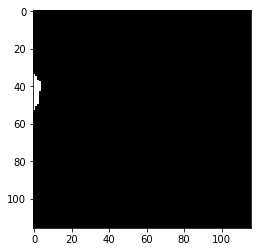

Prediction  21


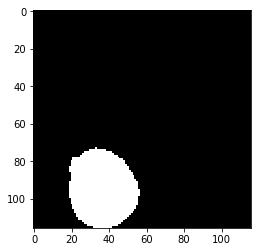

Label  21


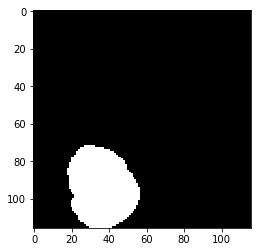

Prediction  22


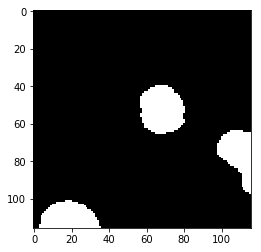

Label  22


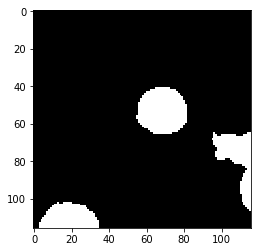

Prediction  23


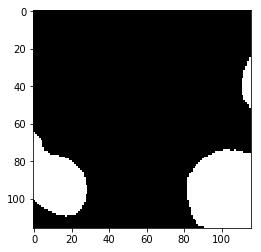

Label  23


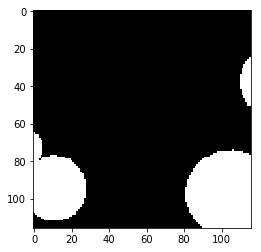

Prediction  24


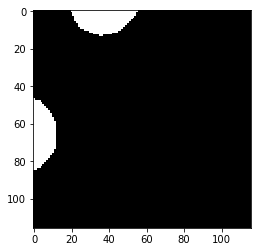

Label  24


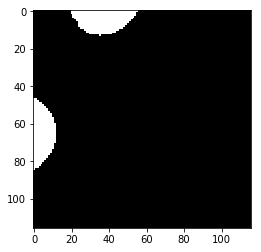

Prediction  25


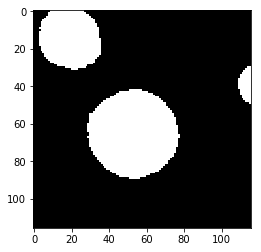

Label  25


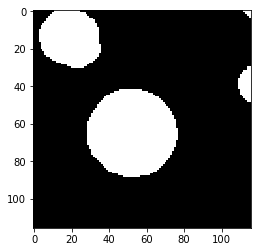

Prediction  26


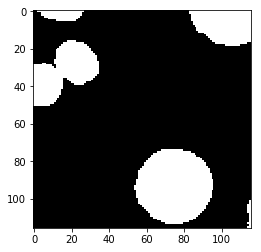

Label  26


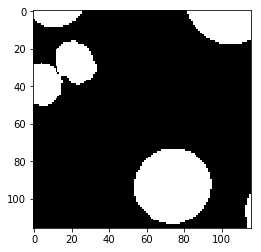

test_accuracy 0.97650785719
Batch: 20500 Train Loss value:0.00452012 Train Accuracy 0.996587283923
Prediction  0


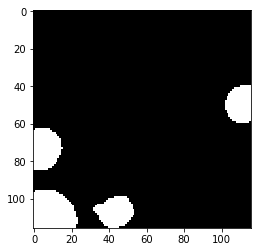

Label  0


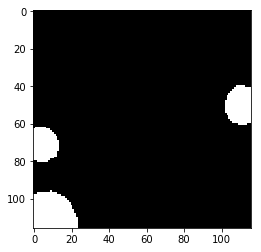

Prediction  1


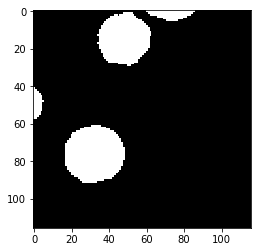

Label  1


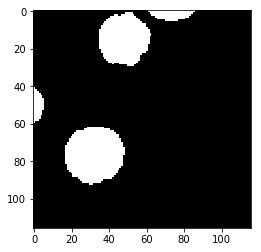

Prediction  2


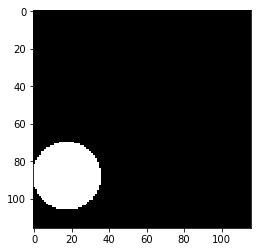

Label  2


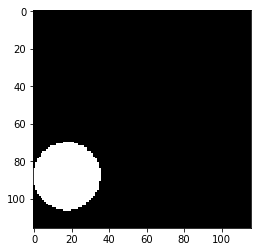

Prediction  3


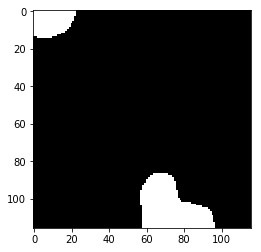

Label  3


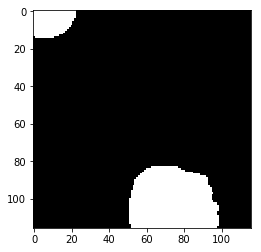

Prediction  4


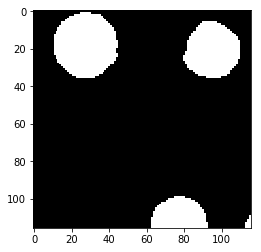

Label  4


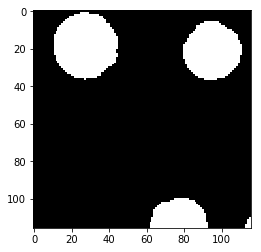

Prediction  5


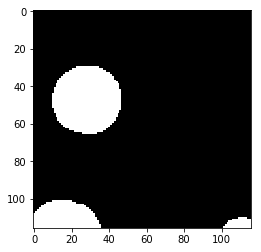

Label  5


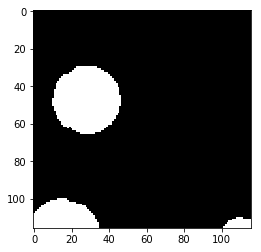

Prediction  6


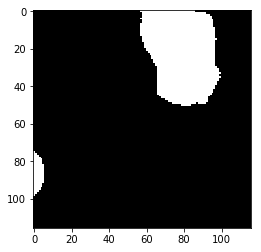

Label  6


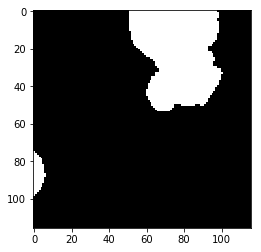

Prediction  7


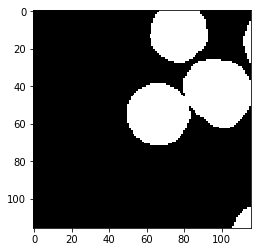

Label  7


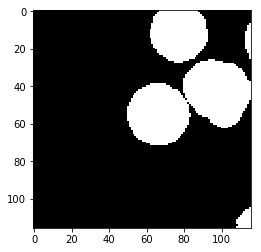

Prediction  8


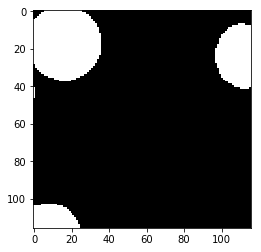

Label  8


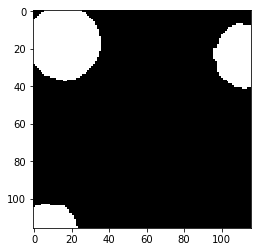

Prediction  9


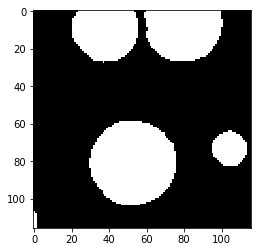

Label  9


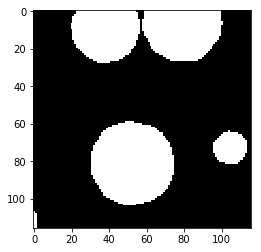

Prediction  10


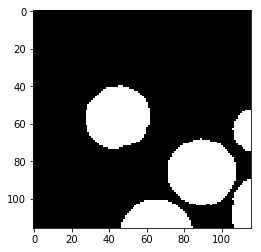

Label  10


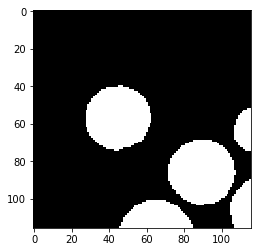

Prediction  11


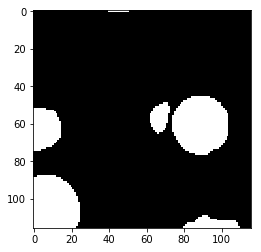

Label  11


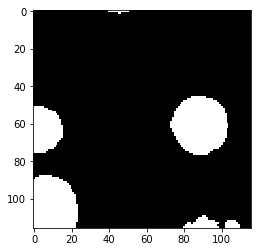

Prediction  12


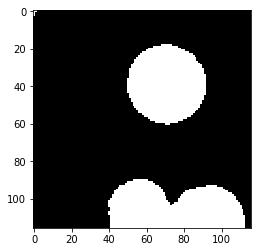

Label  12


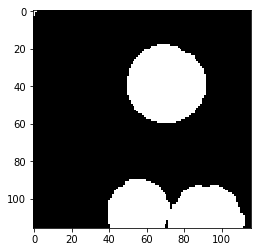

Prediction  13


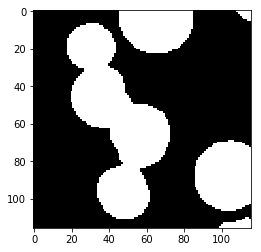

Label  13


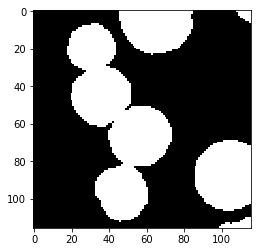

Prediction  14


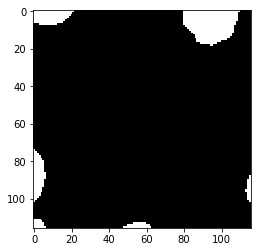

Label  14


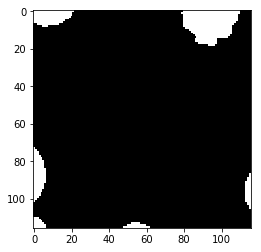

Prediction  15


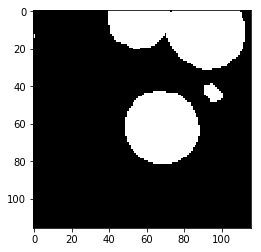

Label  15


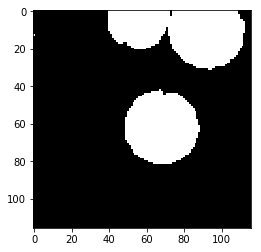

Prediction  16


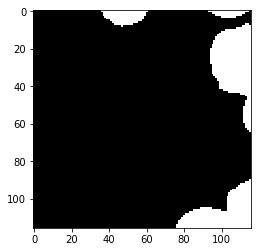

Label  16


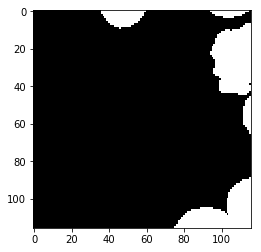

Prediction  17


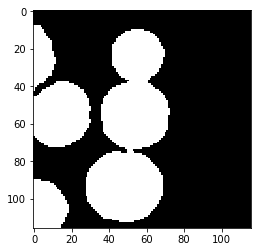

Label  17


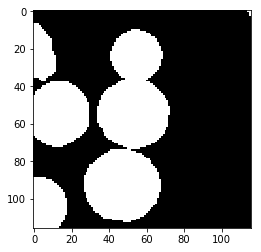

Prediction  18


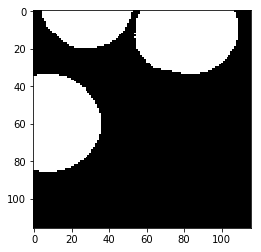

Label  18


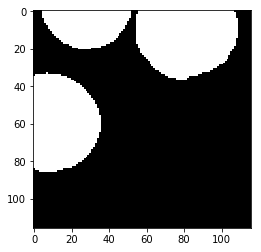

Prediction  19


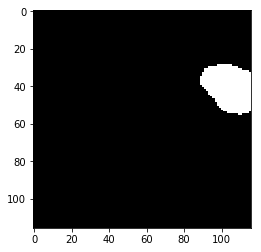

Label  19


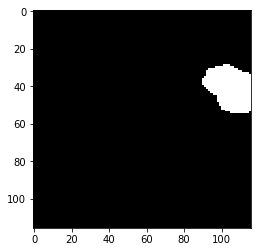

Prediction  20


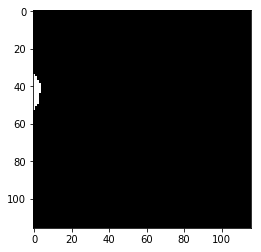

Label  20


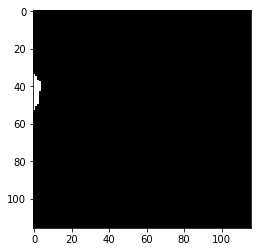

Prediction  21


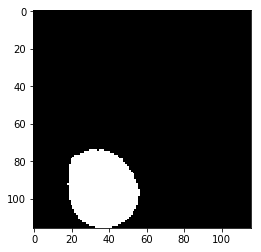

Label  21


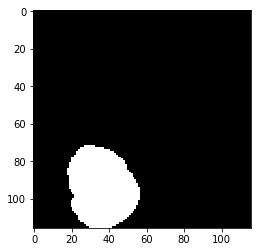

Prediction  22


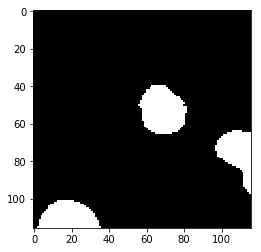

Label  22


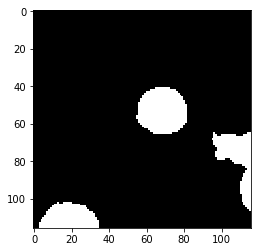

Prediction  23


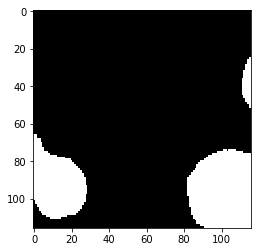

Label  23


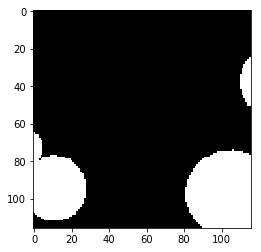

Prediction  24


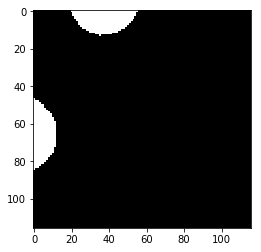

Label  24


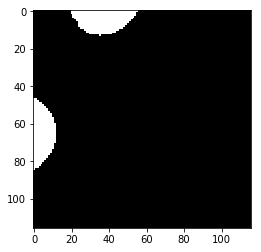

Prediction  25


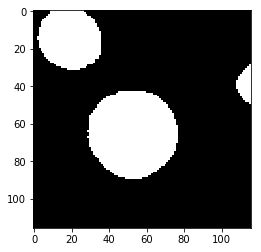

Label  25


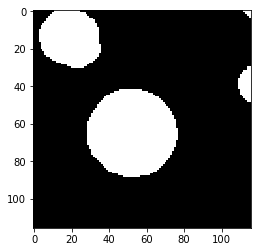

Prediction  26


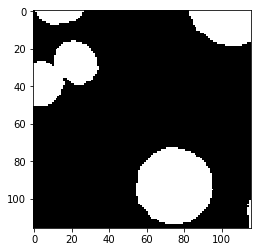

Label  26


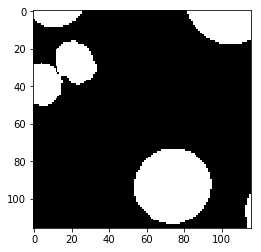

test_accuracy 0.976419227777
Batch: 21000 Train Loss value:0.00147032 Train Accuracy 1.0
Prediction  0


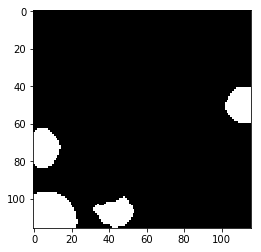

Label  0


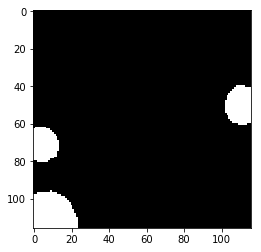

Prediction  1


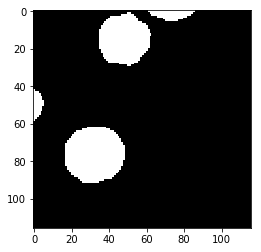

Label  1


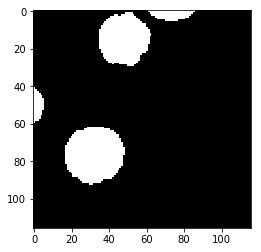

Prediction  2


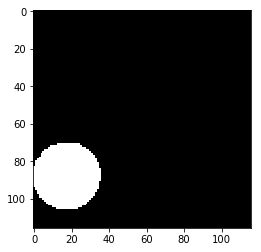

Label  2


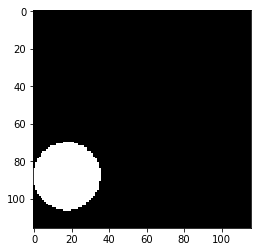

Prediction  3


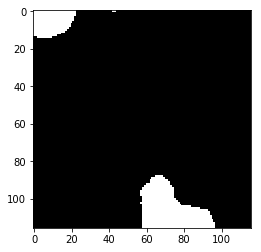

Label  3


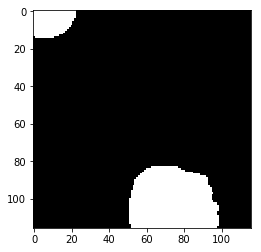

Prediction  4


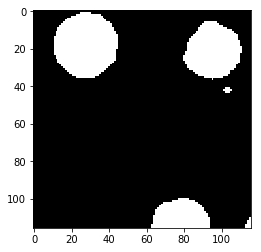

Label  4


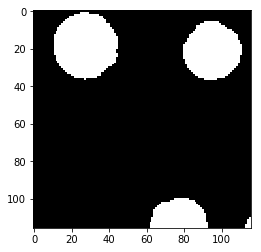

Prediction  5


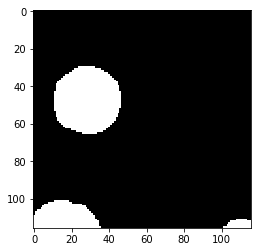

Label  5


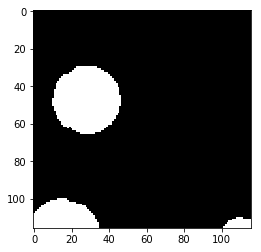

Prediction  6


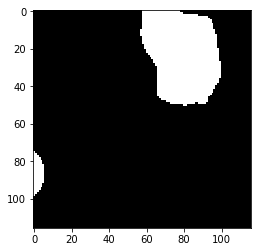

Label  6


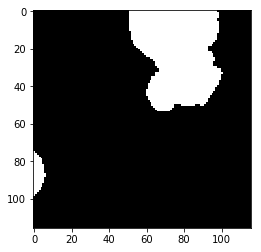

Prediction  7


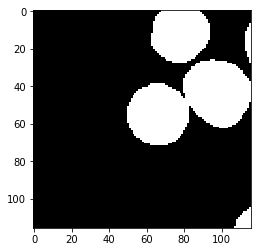

Label  7


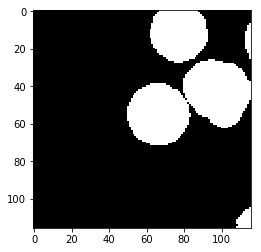

Prediction  8


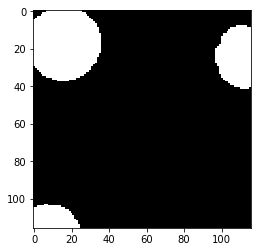

Label  8


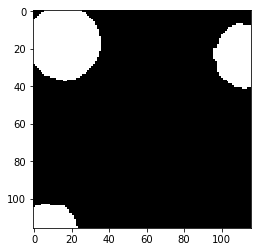

Prediction  9


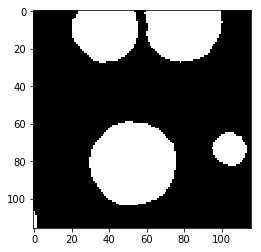

Label  9


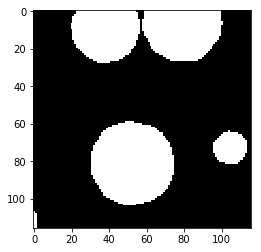

Prediction  10


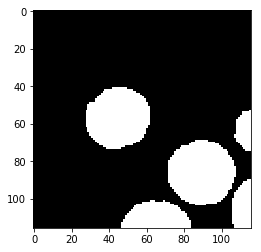

Label  10


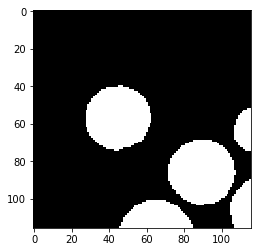

Prediction  11


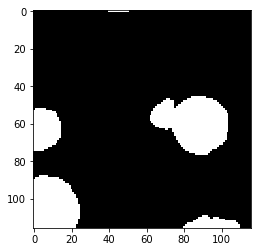

Label  11


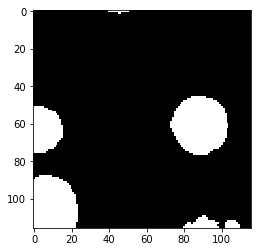

Prediction  12


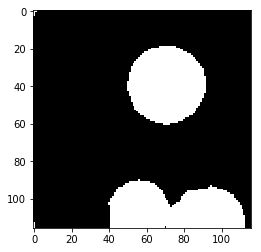

Label  12


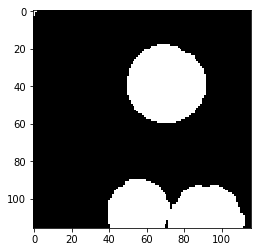

Prediction  13


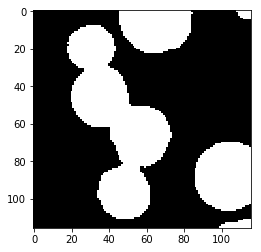

Label  13


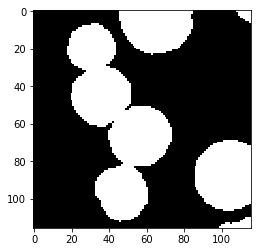

Prediction  14


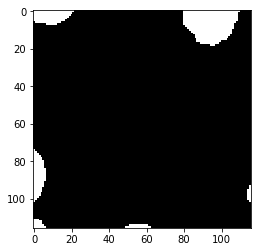

Label  14


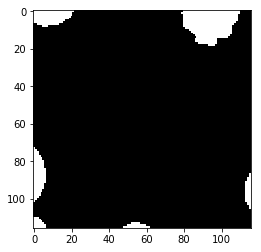

Prediction  15


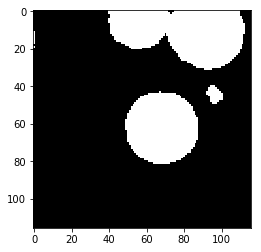

Label  15


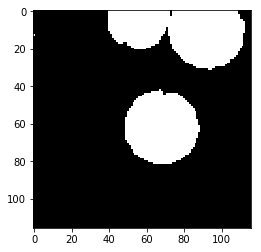

Prediction  16


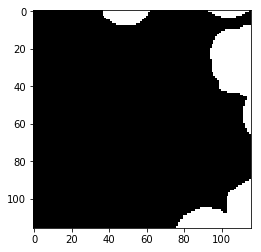

Label  16


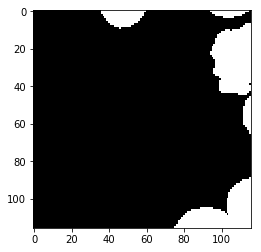

Prediction  17


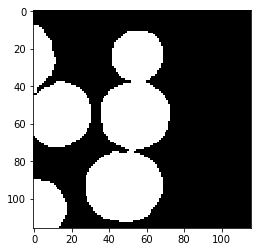

Label  17


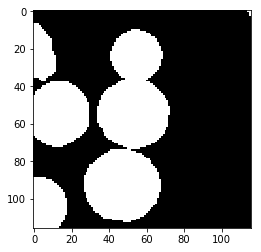

Prediction  18


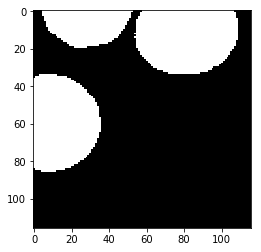

Label  18


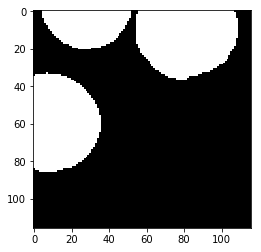

Prediction  19


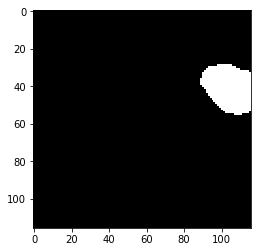

Label  19


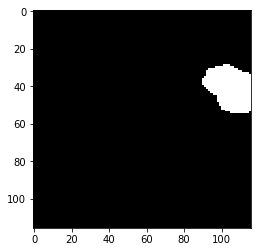

Prediction  20


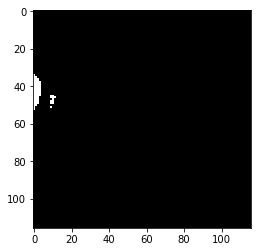

Label  20


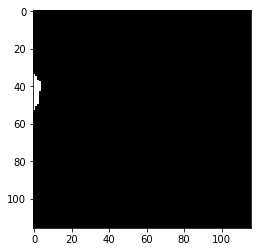

Prediction  21


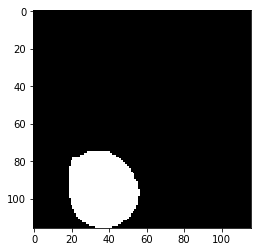

Label  21


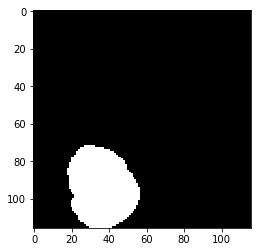

Prediction  22


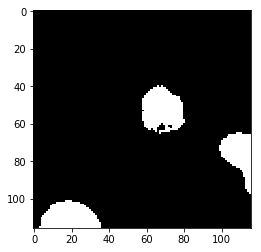

Label  22


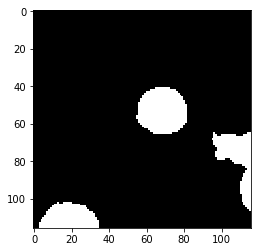

Prediction  23


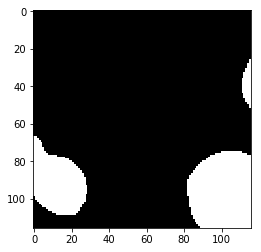

Label  23


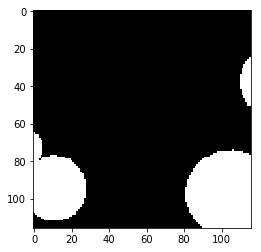

Prediction  24


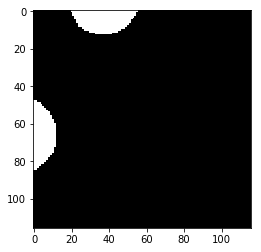

Label  24


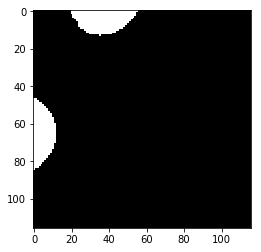

Prediction  25


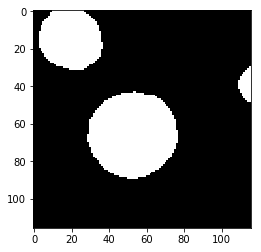

Label  25


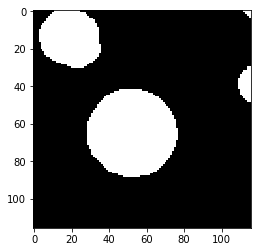

Prediction  26


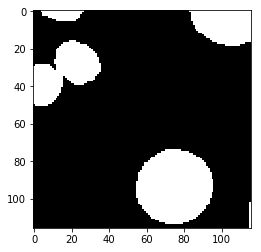

Label  26


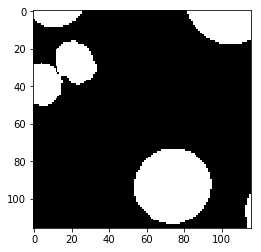

test_accuracy 0.974050729226
Batch: 21500 Train Loss value:0.006009 Train Accuracy 0.994811355719
Prediction  0


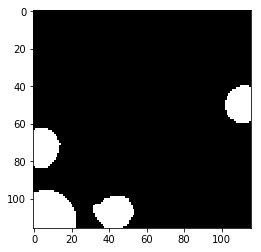

Label  0


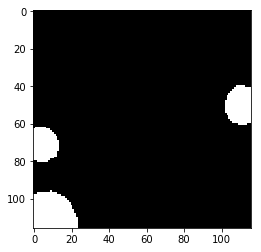

Prediction  1


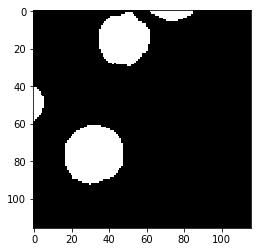

Label  1


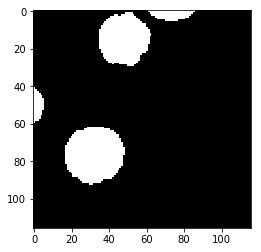

Prediction  2


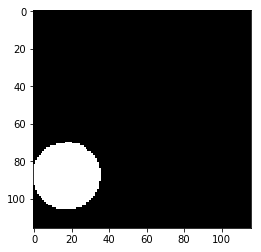

Label  2


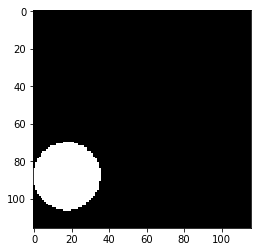

Prediction  3


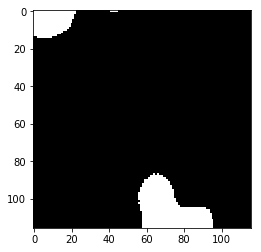

Label  3


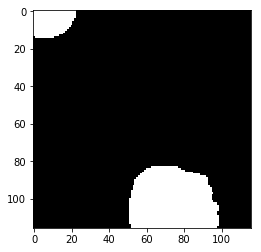

Prediction  4


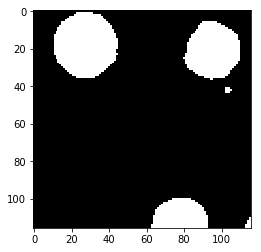

Label  4


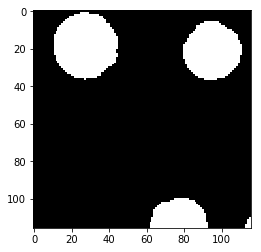

Prediction  5


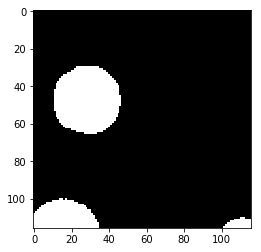

Label  5


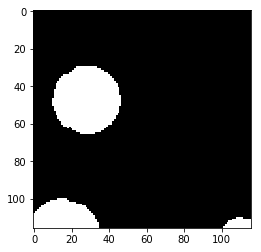

Prediction  6


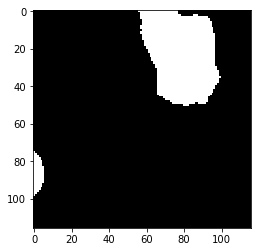

Label  6


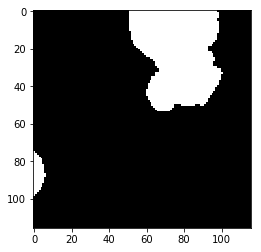

Prediction  7


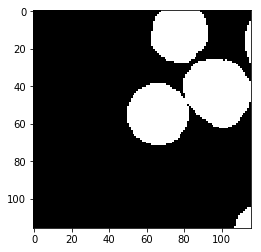

Label  7


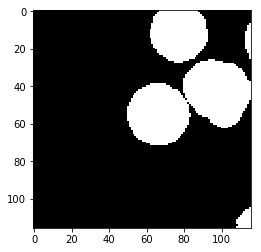

Prediction  8


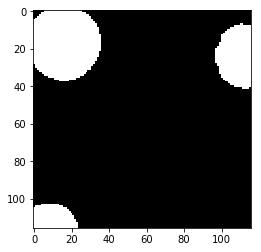

Label  8


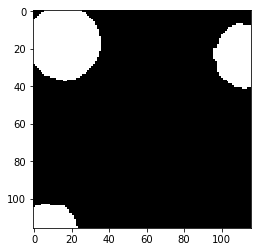

Prediction  9


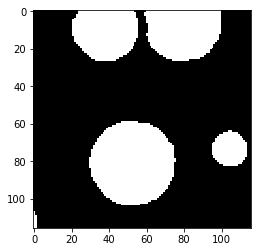

Label  9


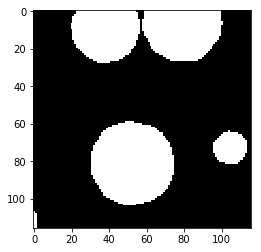

Prediction  10


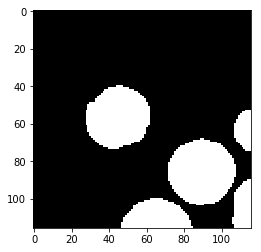

Label  10


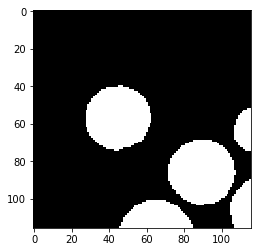

Prediction  11


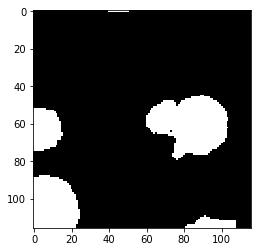

Label  11


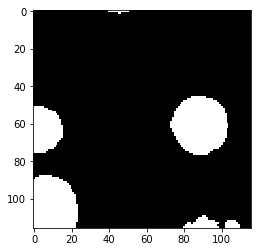

Prediction  12


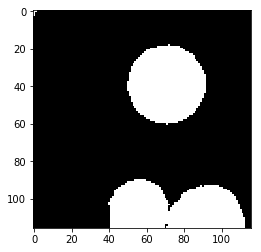

Label  12


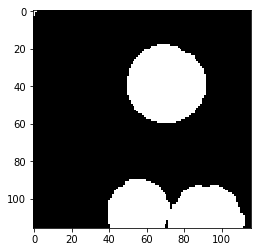

Prediction  13


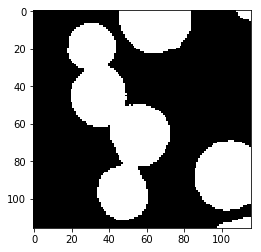

Label  13


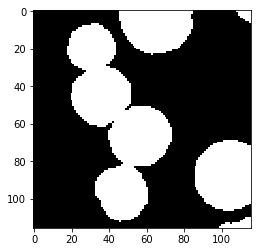

Prediction  14


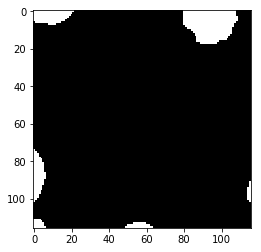

Label  14


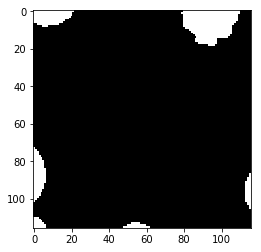

Prediction  15


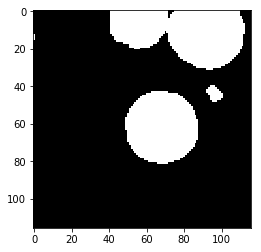

Label  15


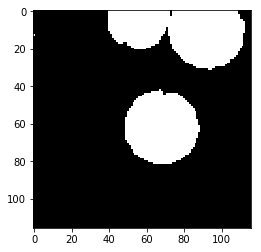

Prediction  16


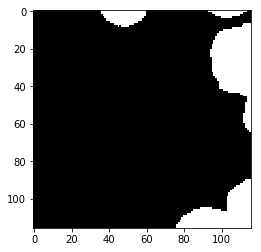

Label  16


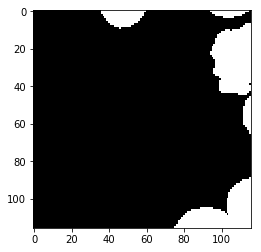

Prediction  17


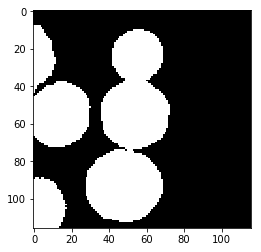

Label  17


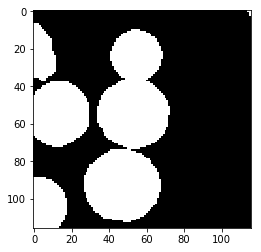

Prediction  18


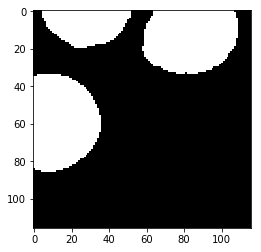

Label  18


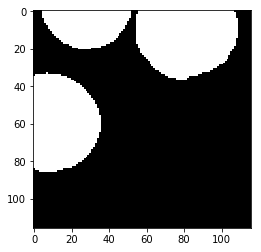

Prediction  19


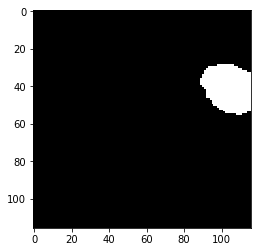

Label  19


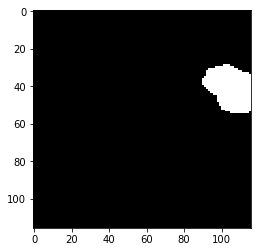

Prediction  20


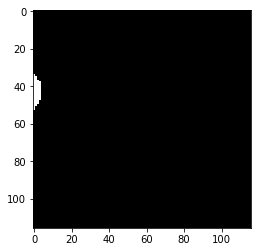

Label  20


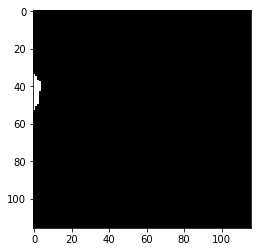

Prediction  21


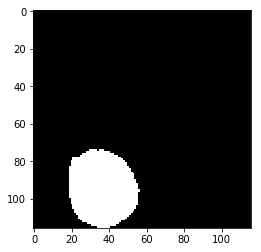

Label  21


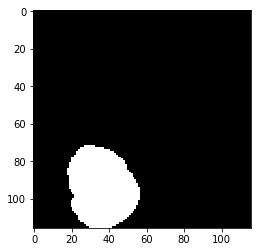

Prediction  22


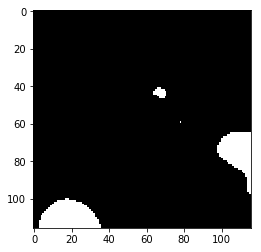

Label  22


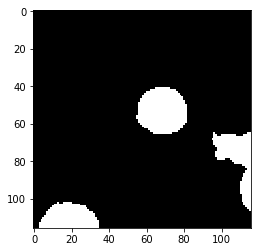

Prediction  23


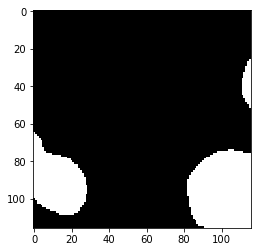

Label  23


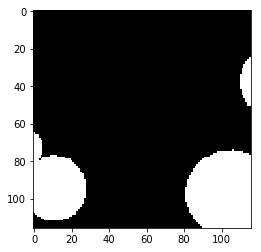

Prediction  24


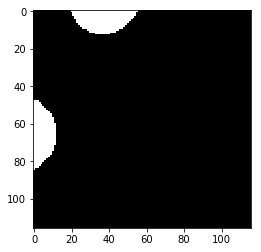

Label  24


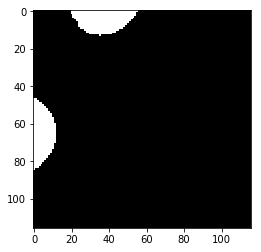

Prediction  25


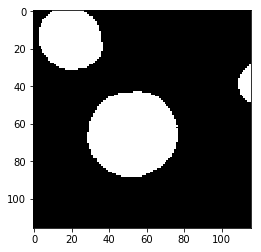

Label  25


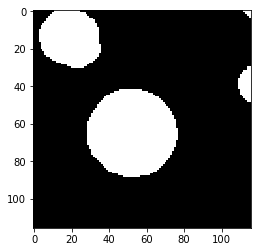

Prediction  26


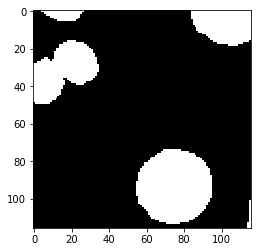

Label  26


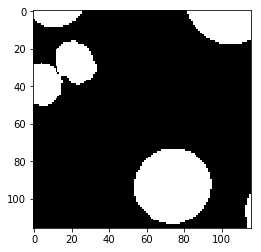

test_accuracy 0.971653382093
Batch: 22000 Train Loss value:0.00199895 Train Accuracy 0.998514777959
Prediction  0


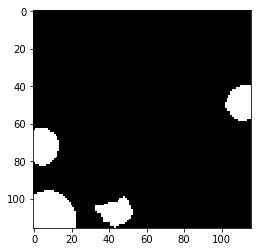

Label  0


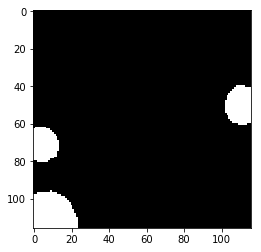

Prediction  1


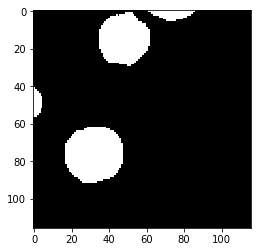

Label  1


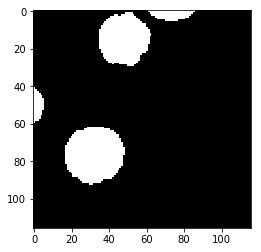

Prediction  2


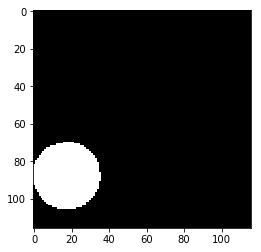

Label  2


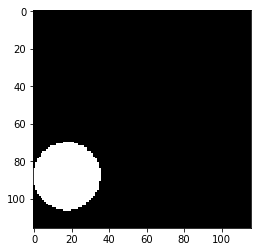

Prediction  3


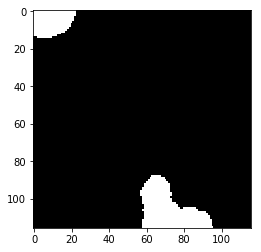

Label  3


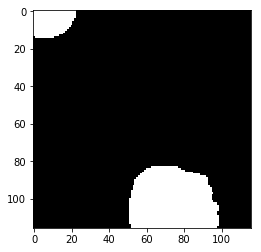

Prediction  4


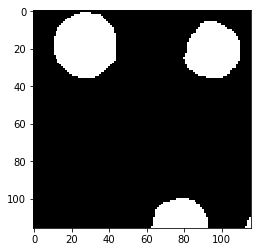

Label  4


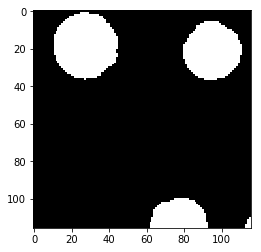

Prediction  5


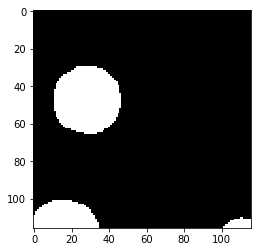

Label  5


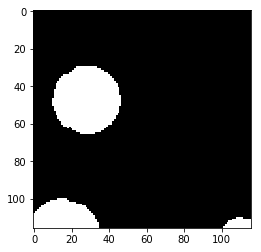

Prediction  6


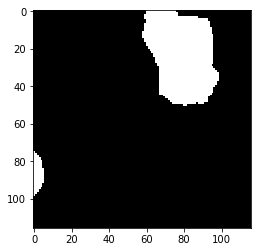

Label  6


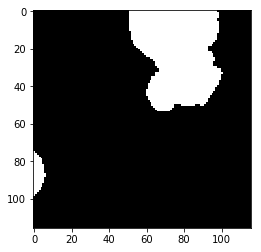

Prediction  7


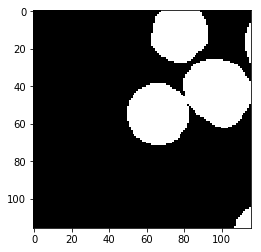

Label  7


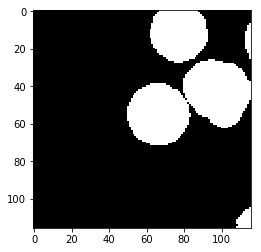

Prediction  8


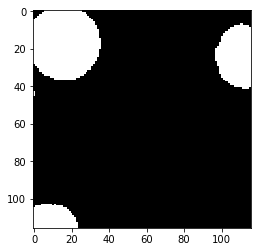

Label  8


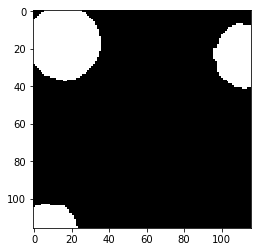

Prediction  9


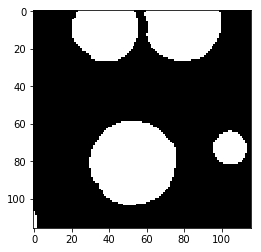

Label  9


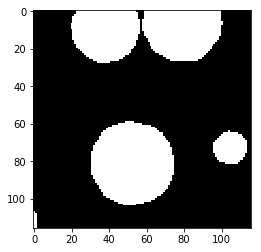

Prediction  10


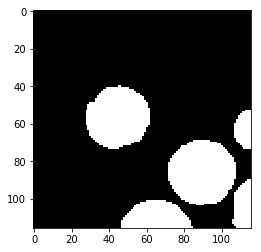

Label  10


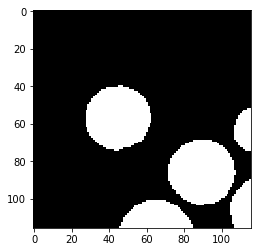

Prediction  11


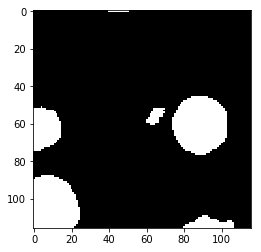

Label  11


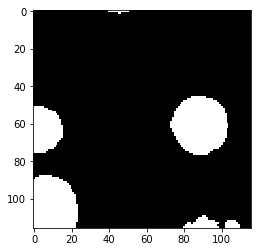

Prediction  12


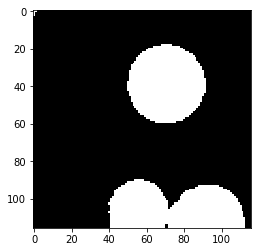

Label  12


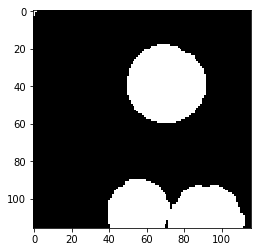

Prediction  13


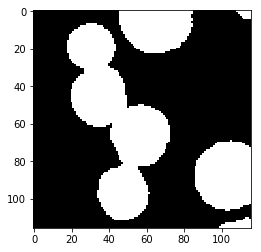

Label  13


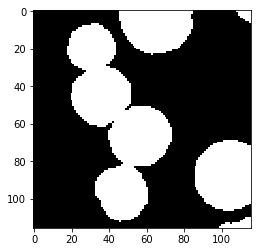

Prediction  14


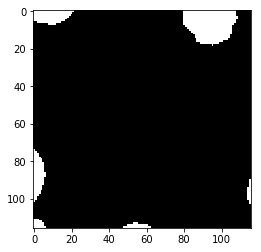

Label  14


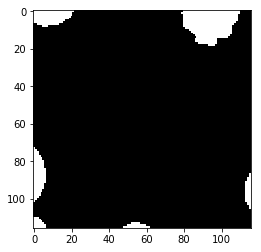

Prediction  15


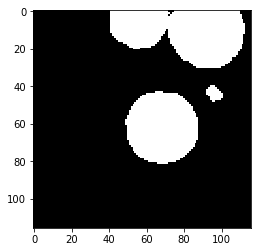

Label  15


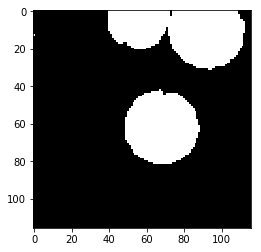

Prediction  16


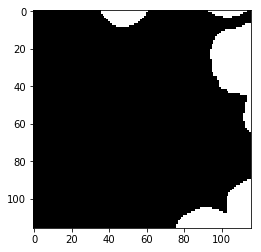

Label  16


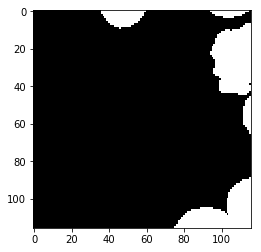

Prediction  17


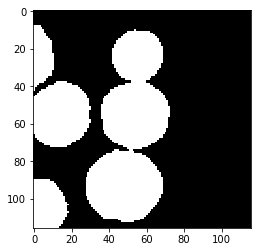

Label  17


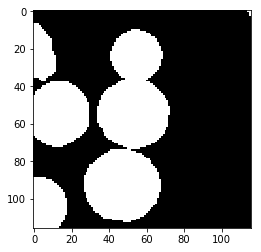

Prediction  18


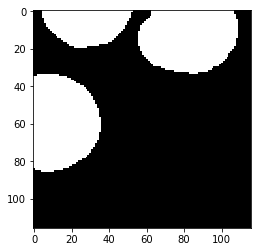

Label  18


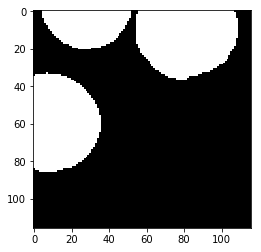

Prediction  19


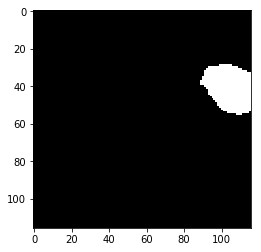

Label  19


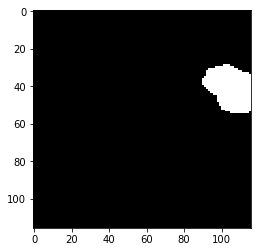

Prediction  20


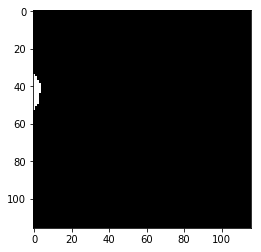

Label  20


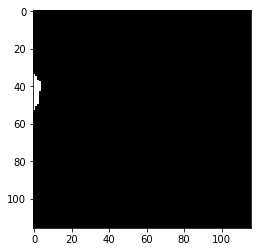

Prediction  21


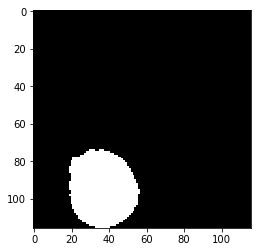

Label  21


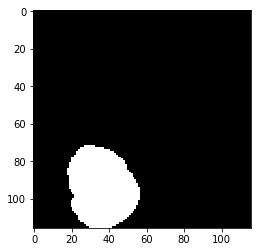

Prediction  22


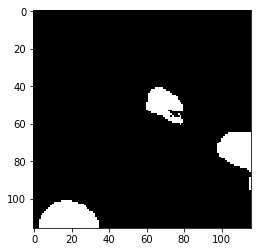

Label  22


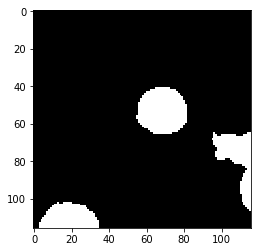

Prediction  23


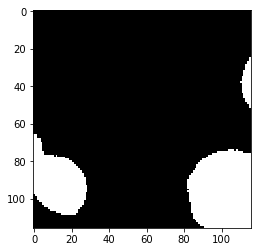

Label  23


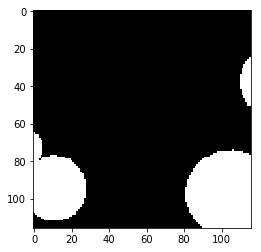

Prediction  24


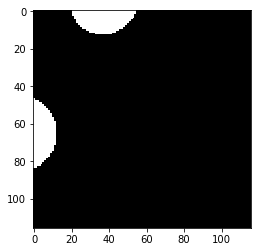

Label  24


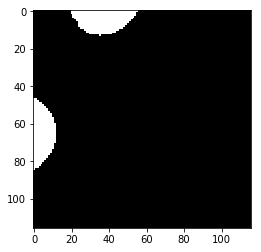

Prediction  25


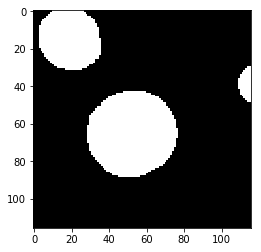

Label  25


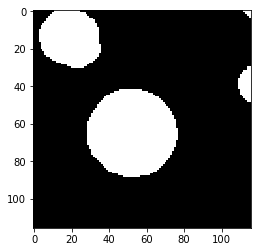

Prediction  26


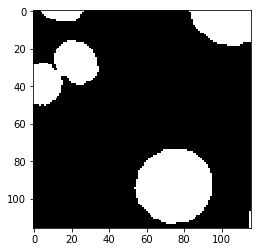

Label  26


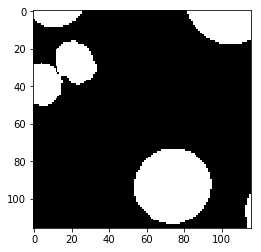

test_accuracy 0.974418239725
Batch: 22500 Train Loss value:0.0255523 Train Accuracy 0.979551305627
Prediction  0


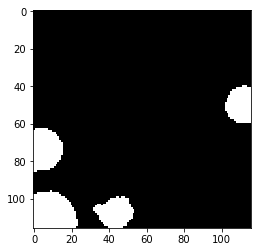

Label  0


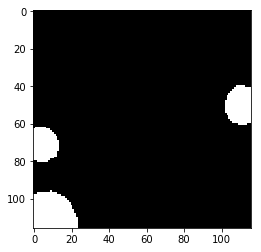

Prediction  1


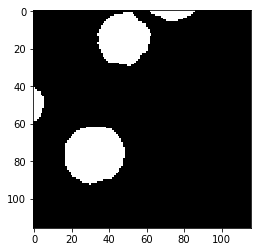

Label  1


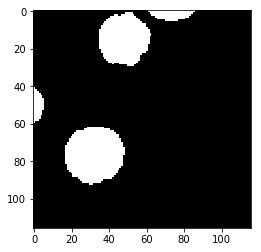

Prediction  2


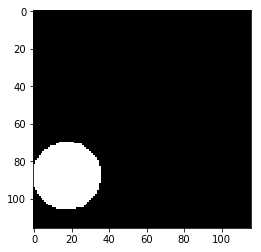

Label  2


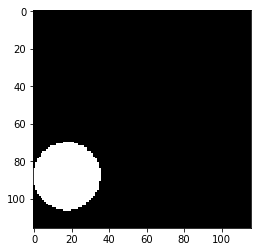

Prediction  3


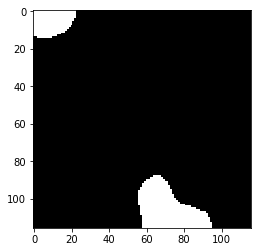

Label  3


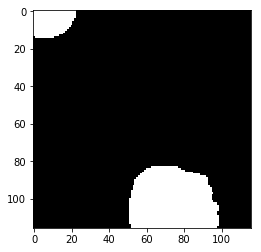

Prediction  4


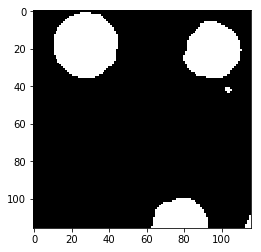

Label  4


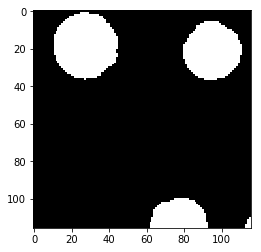

Prediction  5


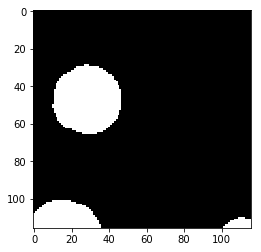

Label  5


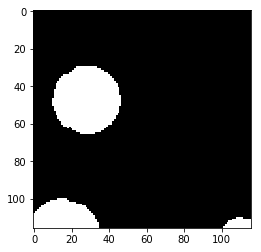

Prediction  6


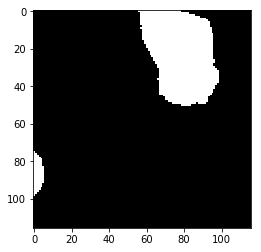

Label  6


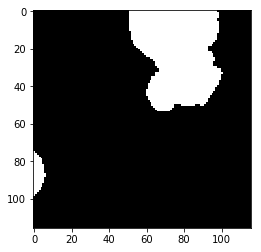

Prediction  7


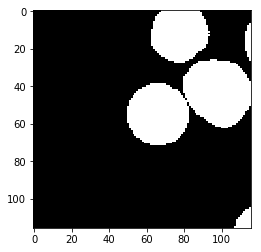

Label  7


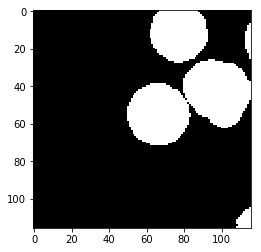

Prediction  8


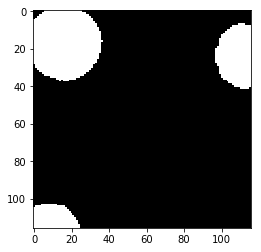

Label  8


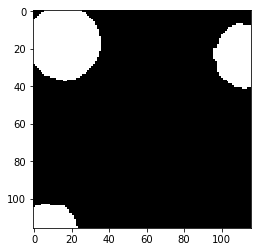

Prediction  9


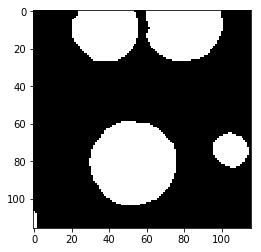

Label  9


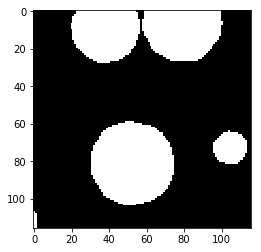

Prediction  10


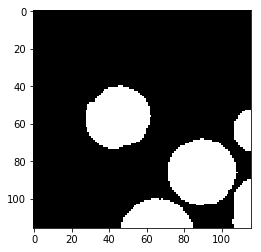

Label  10


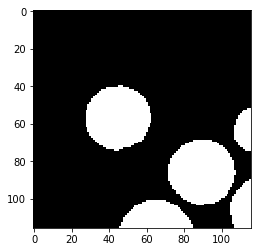

Prediction  11


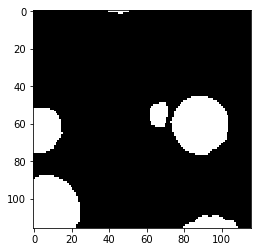

Label  11


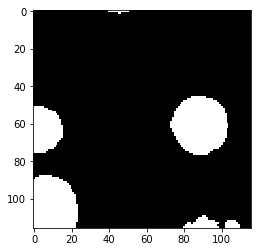

Prediction  12


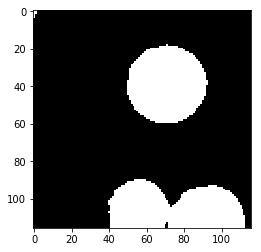

Label  12


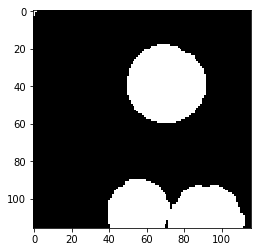

Prediction  13


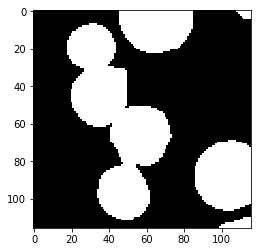

Label  13


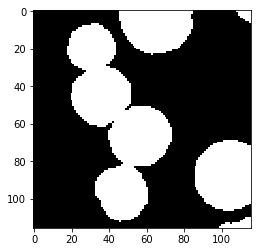

Prediction  14


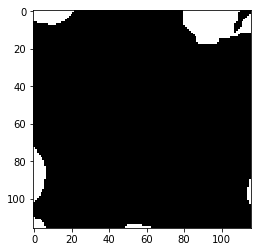

Label  14


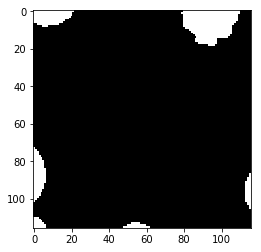

Prediction  15


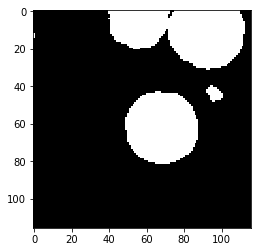

Label  15


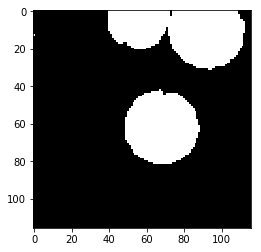

Prediction  16


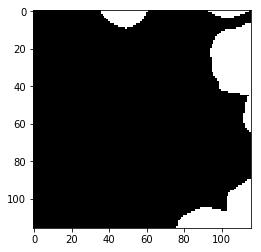

Label  16


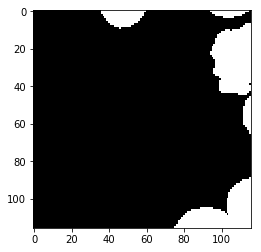

Prediction  17


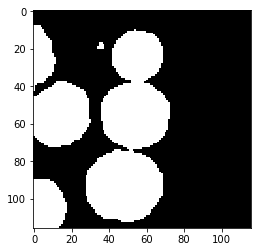

Label  17


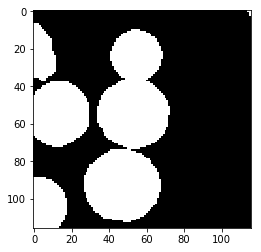

Prediction  18


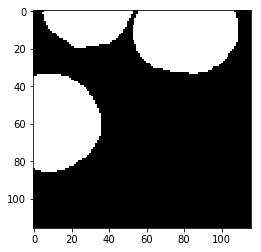

Label  18


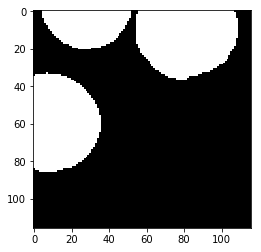

Prediction  19


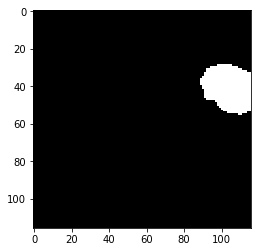

Label  19


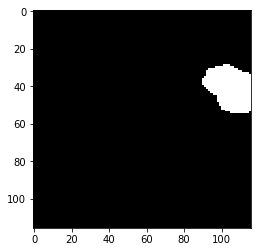

Prediction  20


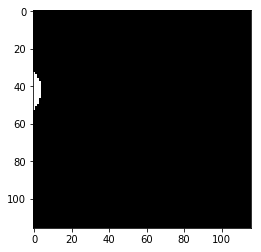

Label  20


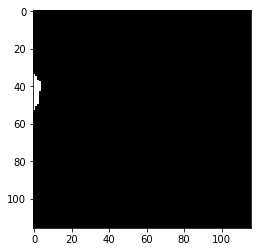

Prediction  21


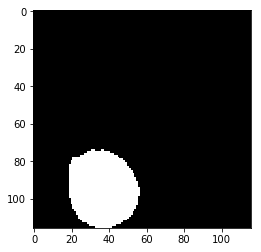

Label  21


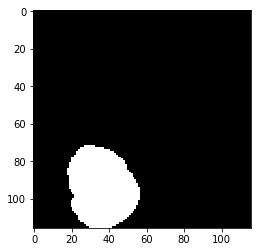

Prediction  22


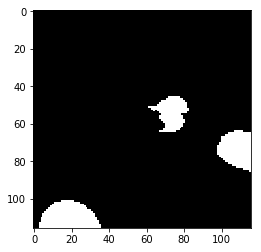

Label  22


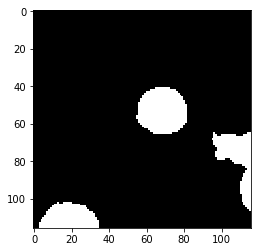

Prediction  23


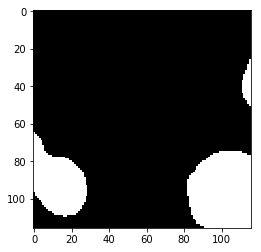

Label  23


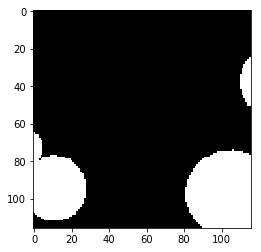

Prediction  24


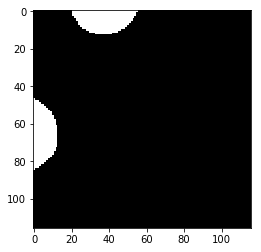

Label  24


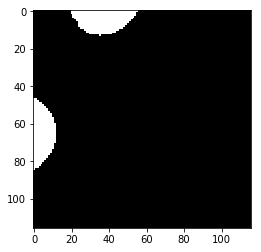

Prediction  25


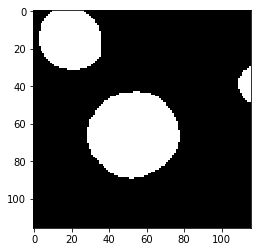

Label  25


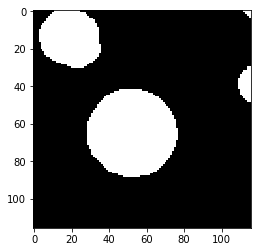

Prediction  26


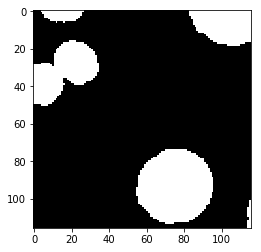

Label  26


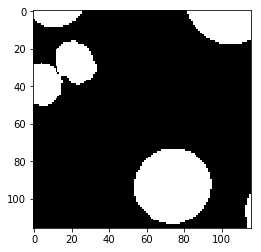

test_accuracy 0.972929995561
Batch: 23000 Train Loss value:0.0217745 Train Accuracy 0.981737849779
Prediction  0


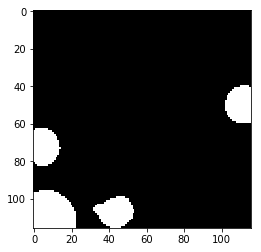

Label  0


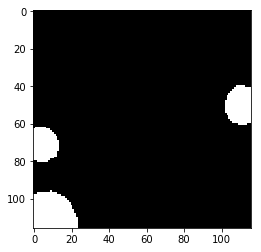

Prediction  1


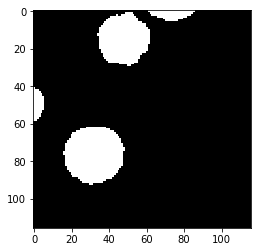

Label  1


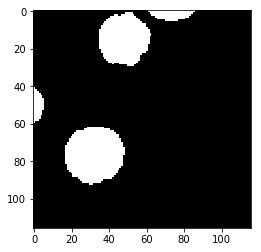

Prediction  2


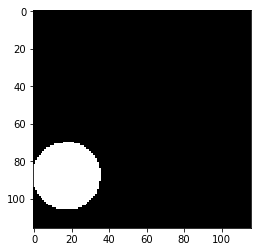

Label  2


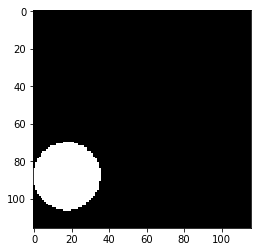

Prediction  3


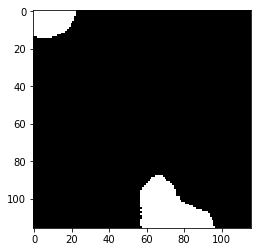

Label  3


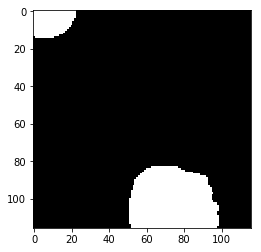

Prediction  4


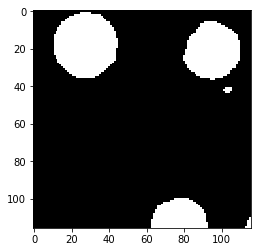

Label  4


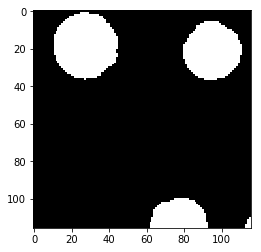

Prediction  5


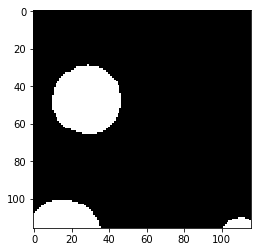

Label  5


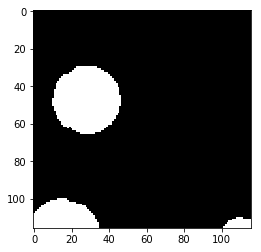

Prediction  6


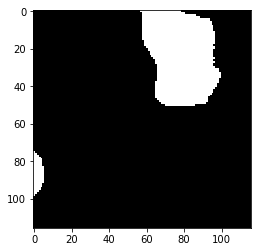

Label  6


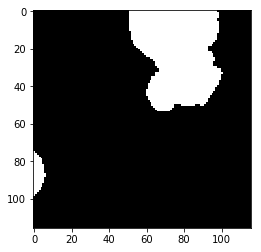

Prediction  7


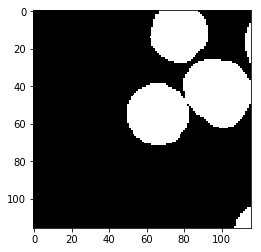

Label  7


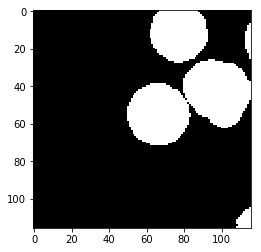

Prediction  8


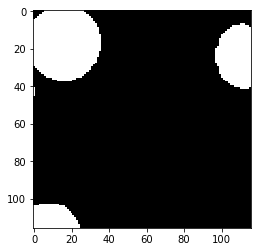

Label  8


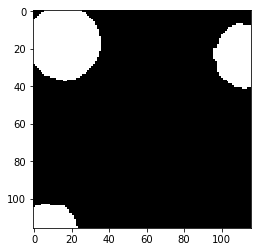

Prediction  9


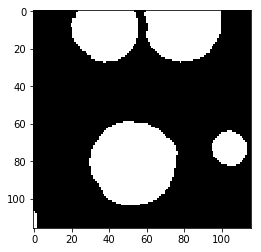

Label  9


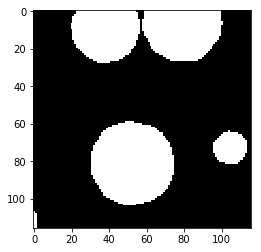

Prediction  10


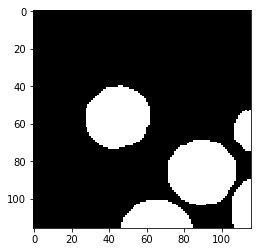

Label  10


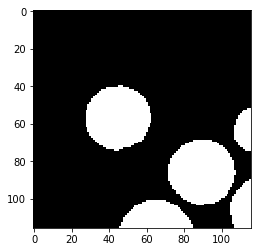

Prediction  11


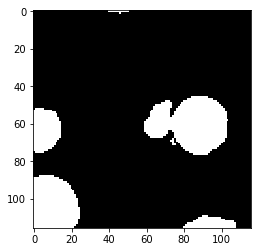

Label  11


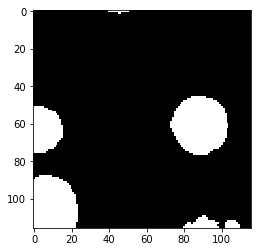

Prediction  12


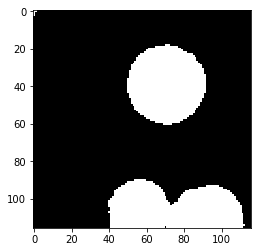

Label  12


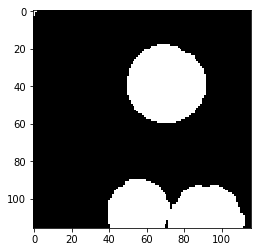

Prediction  13


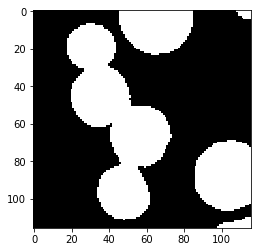

Label  13


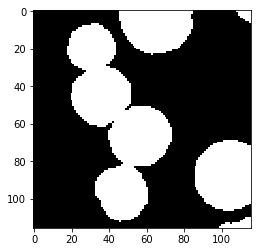

Prediction  14


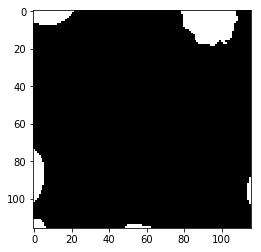

Label  14


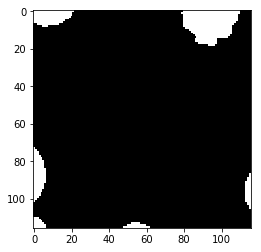

Prediction  15


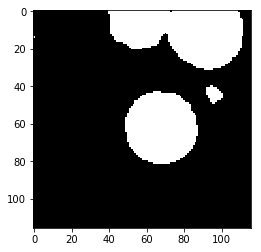

Label  15


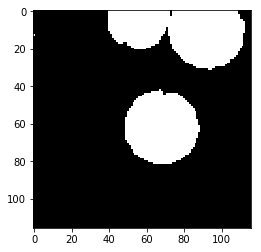

Prediction  16


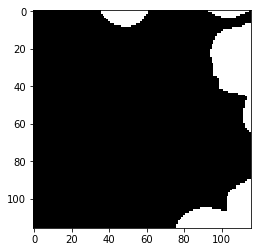

Label  16


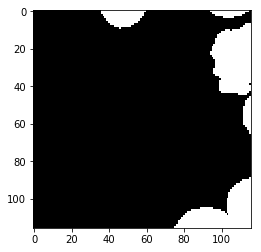

Prediction  17


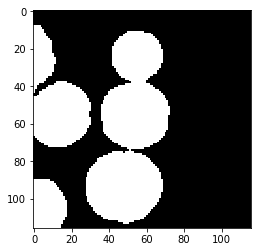

Label  17


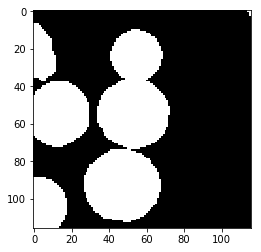

Prediction  18


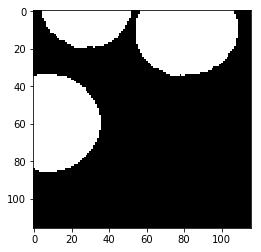

Label  18


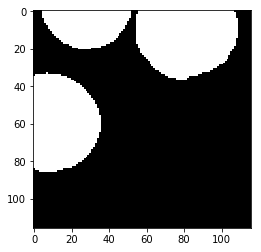

Prediction  19


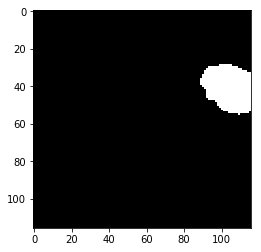

Label  19


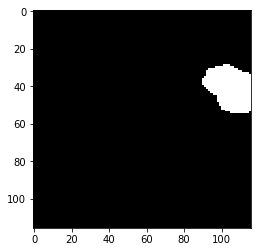

Prediction  20


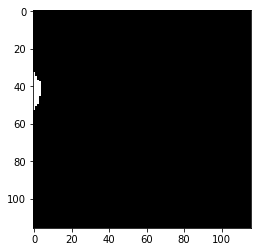

Label  20


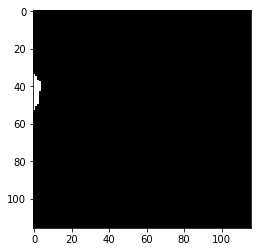

Prediction  21


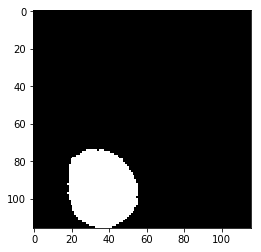

Label  21


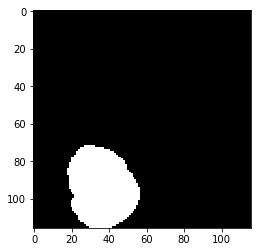

Prediction  22


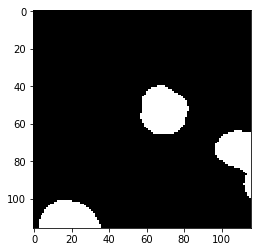

Label  22


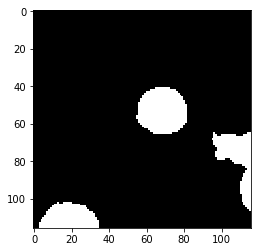

Prediction  23


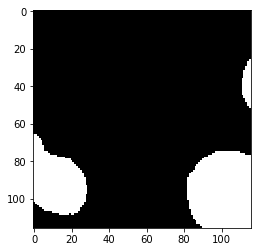

Label  23


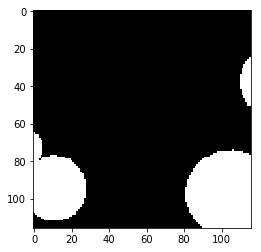

Prediction  24


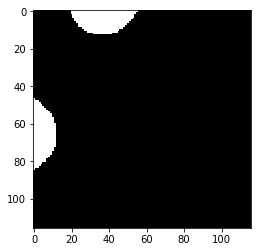

Label  24


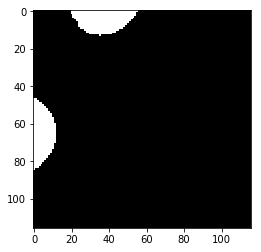

Prediction  25


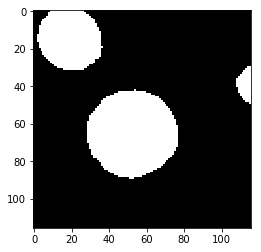

Label  25


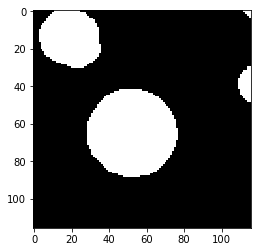

Prediction  26


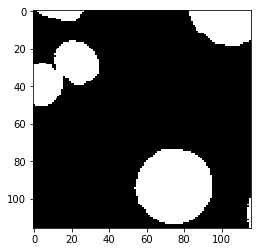

Label  26


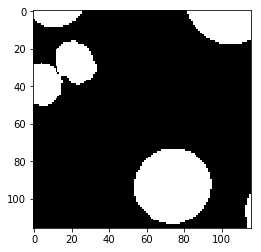

test_accuracy 0.976444245784
Batch: 23500 Train Loss value:0.0106583 Train Accuracy 0.991416309013
Prediction  0


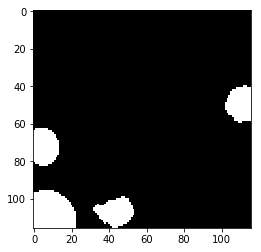

Label  0


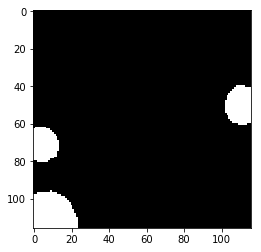

Prediction  1


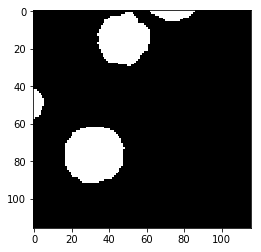

Label  1


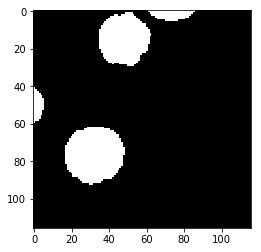

Prediction  2


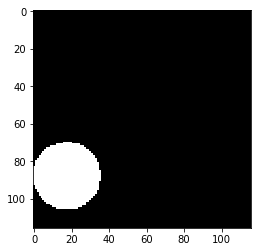

Label  2


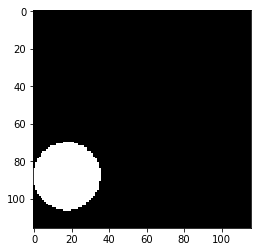

Prediction  3


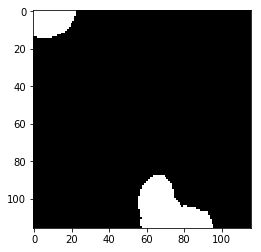

Label  3


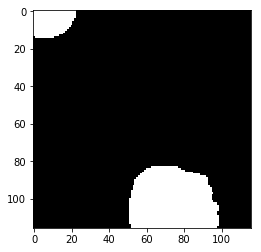

Prediction  4


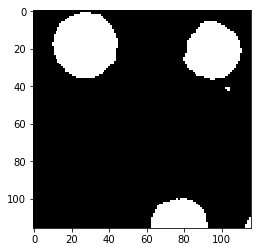

Label  4


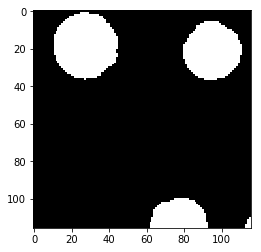

Prediction  5


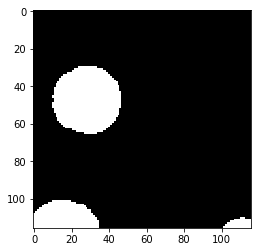

Label  5


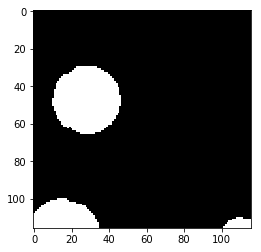

Prediction  6


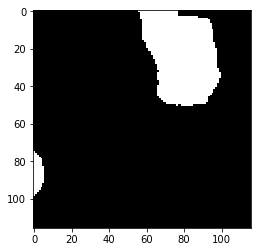

Label  6


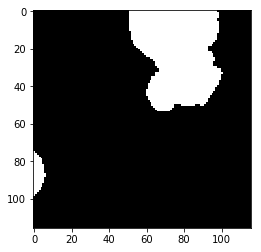

Prediction  7


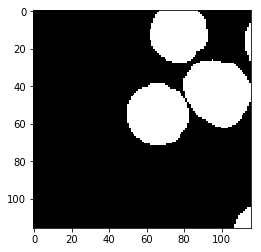

Label  7


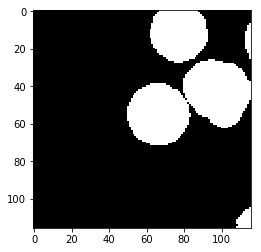

Prediction  8


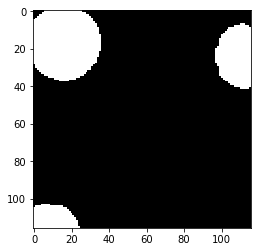

Label  8


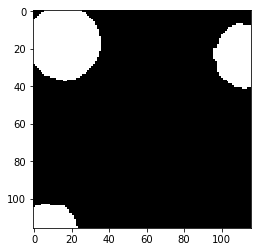

Prediction  9


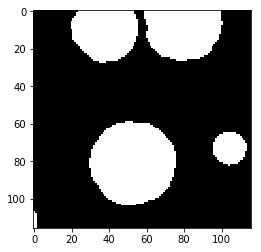

Label  9


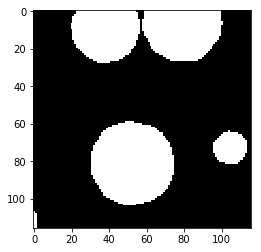

Prediction  10


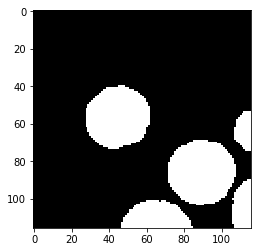

Label  10


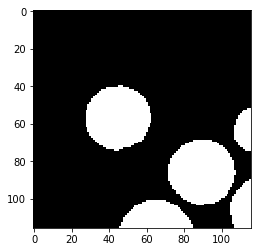

Prediction  11


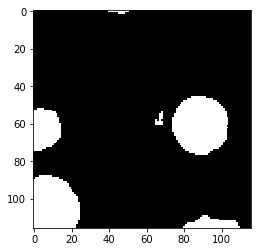

Label  11


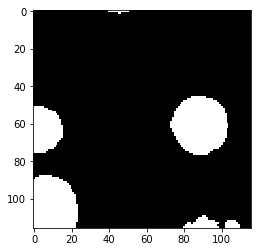

Prediction  12


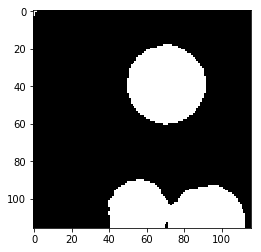

Label  12


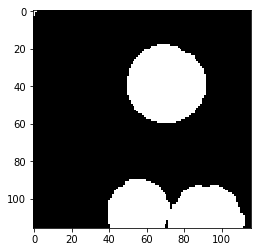

Prediction  13


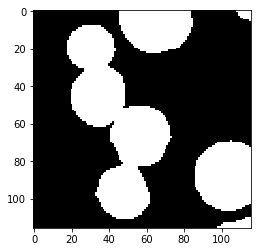

Label  13


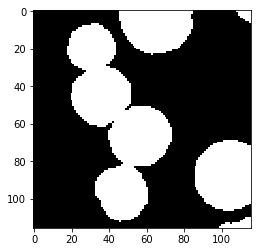

Prediction  14


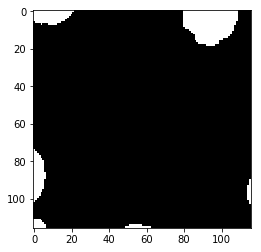

Label  14


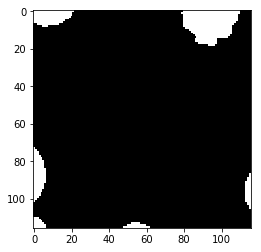

Prediction  15


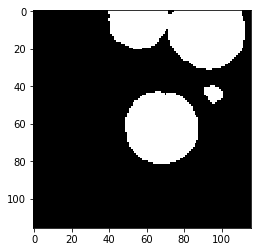

Label  15


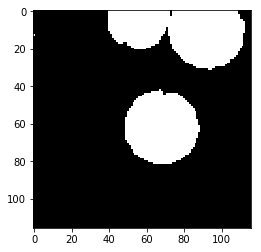

Prediction  16


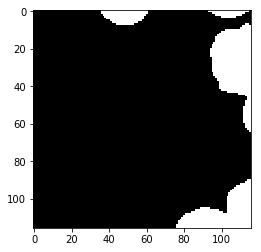

Label  16


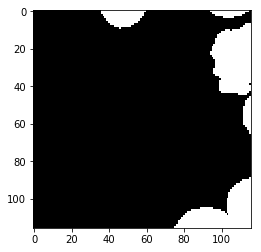

Prediction  17


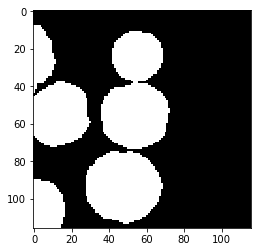

Label  17


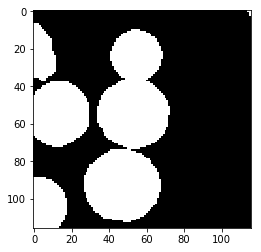

Prediction  18


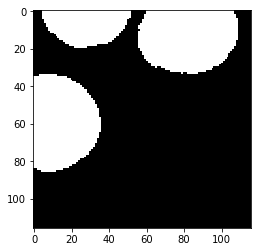

Label  18


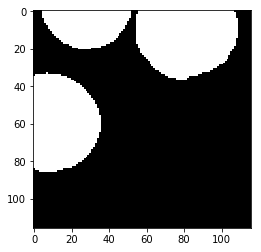

Prediction  19


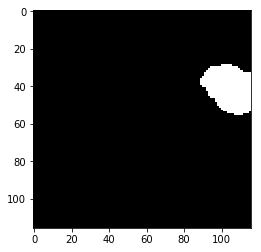

Label  19


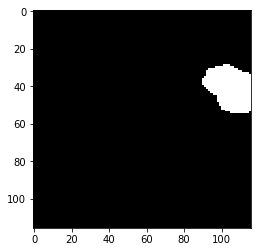

Prediction  20


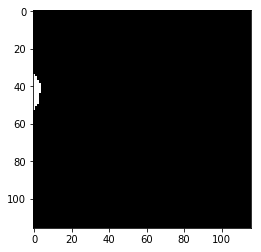

Label  20


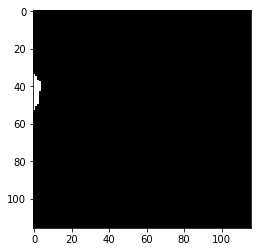

Prediction  21


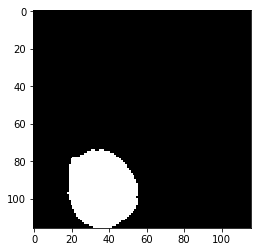

Label  21


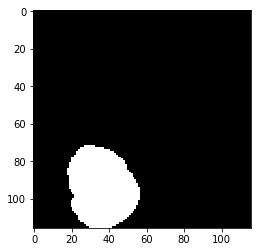

Prediction  22


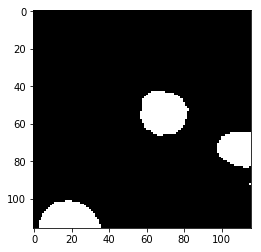

Label  22


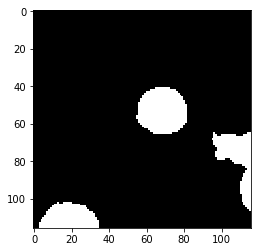

Prediction  23


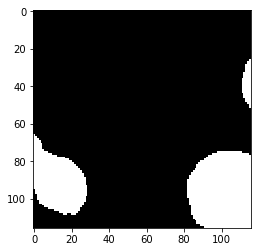

Label  23


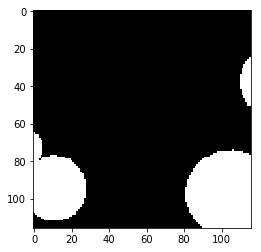

Prediction  24


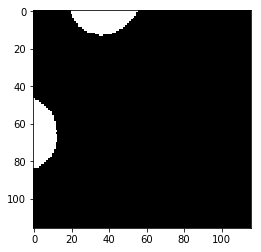

Label  24


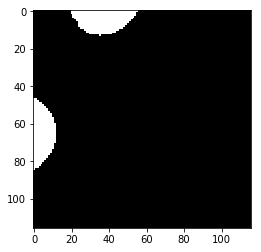

Prediction  25


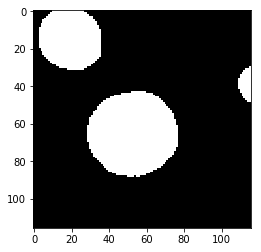

Label  25


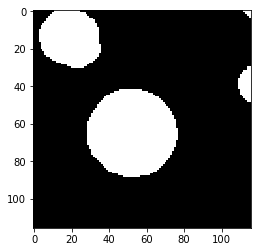

Prediction  26


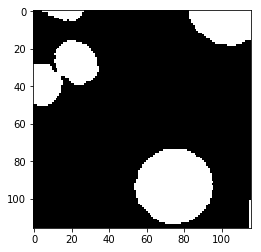

Label  26


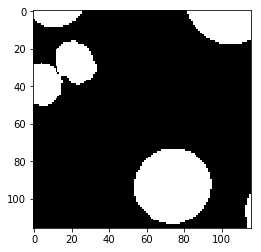

test_accuracy 0.976342373589
Batch: 24000 Train Loss value:0.00622646 Train Accuracy 0.994220081512
Prediction  0


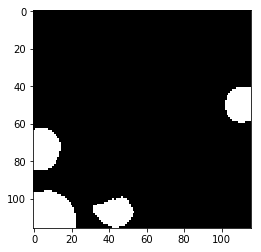

Label  0


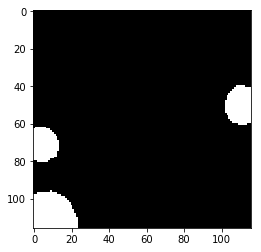

Prediction  1


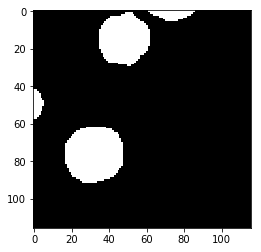

Label  1


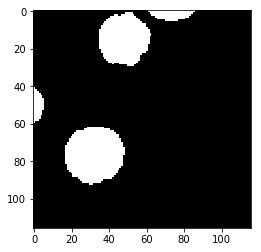

Prediction  2


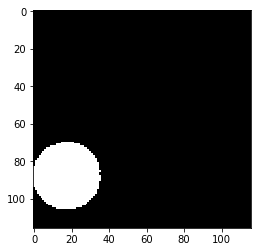

Label  2


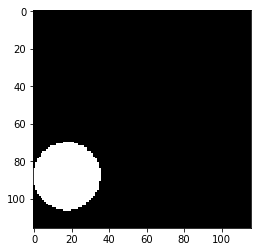

Prediction  3


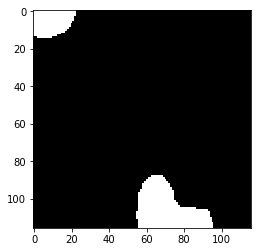

Label  3


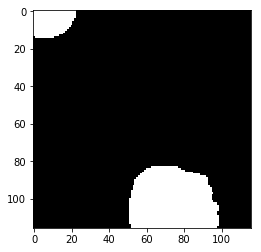

Prediction  4


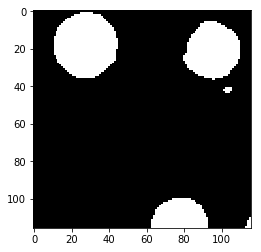

Label  4


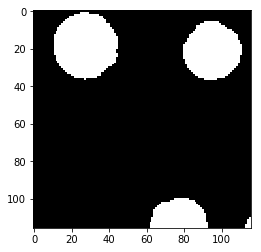

Prediction  5


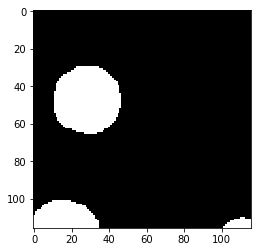

Label  5


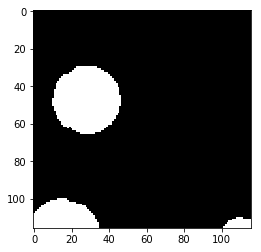

Prediction  6


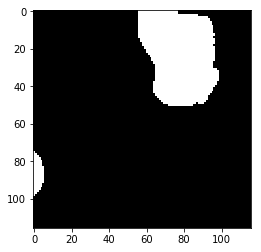

Label  6


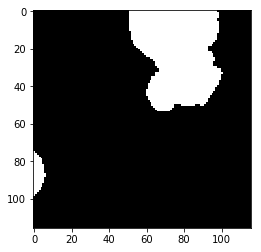

Prediction  7


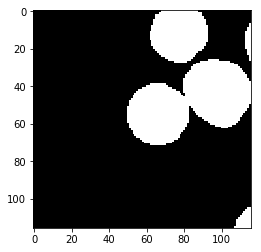

Label  7


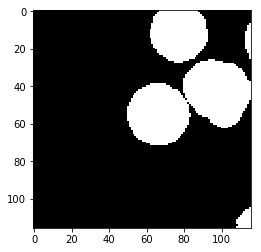

Prediction  8


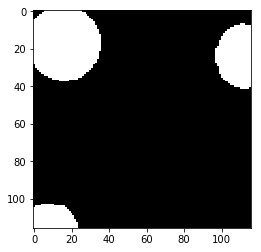

Label  8


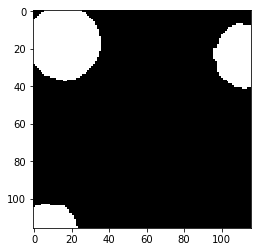

Prediction  9


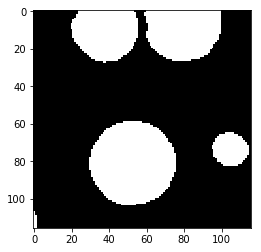

Label  9


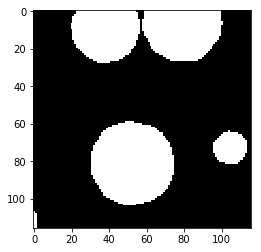

Prediction  10


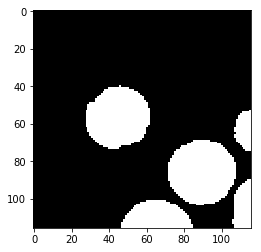

Label  10


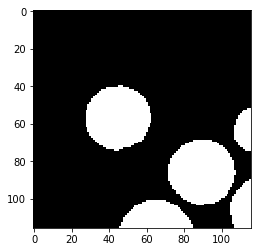

Prediction  11


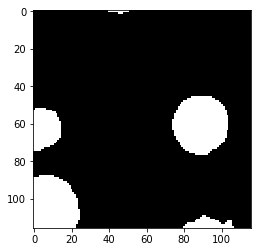

Label  11


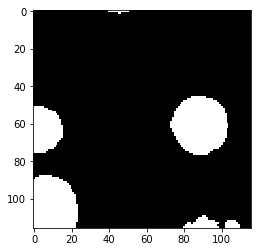

Prediction  12


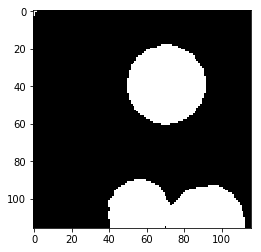

Label  12


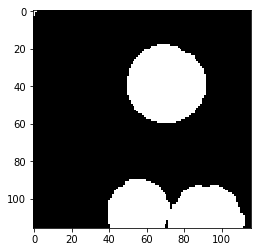

Prediction  13


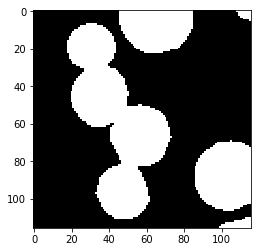

Label  13


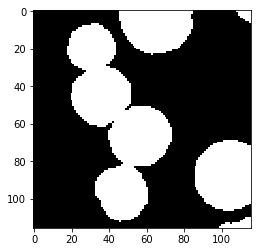

Prediction  14


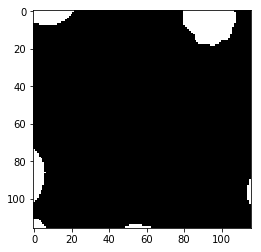

Label  14


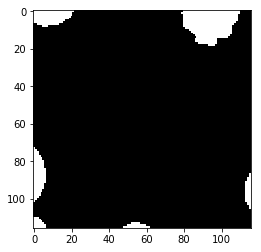

Prediction  15


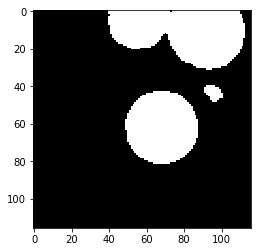

Label  15


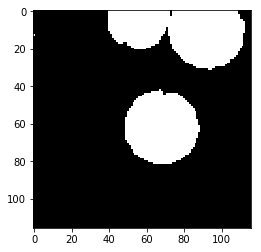

Prediction  16


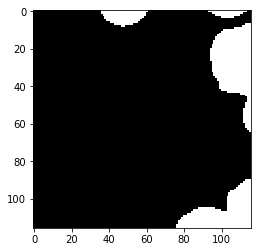

Label  16


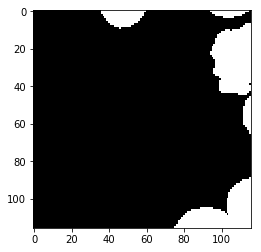

Prediction  17


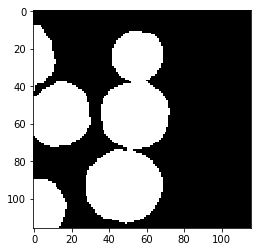

Label  17


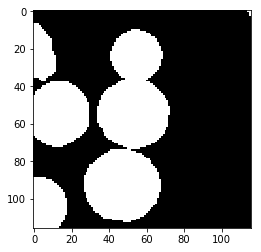

Prediction  18


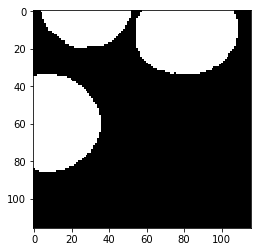

Label  18


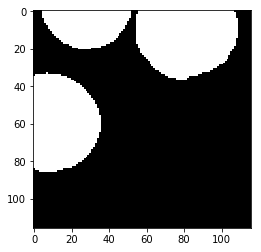

Prediction  19


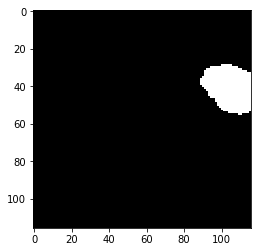

Label  19


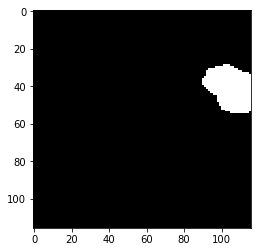

Prediction  20


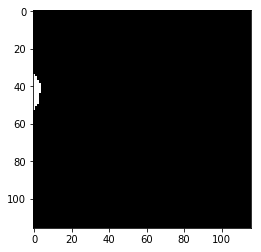

Label  20


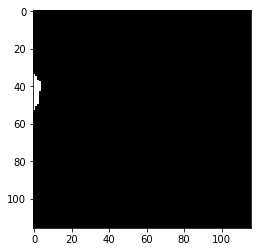

Prediction  21


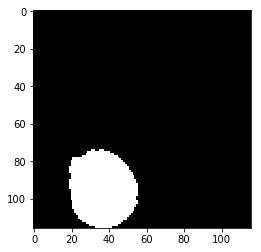

Label  21


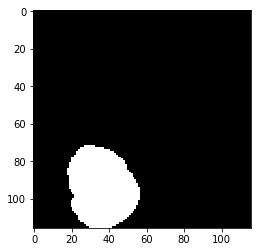

Prediction  22


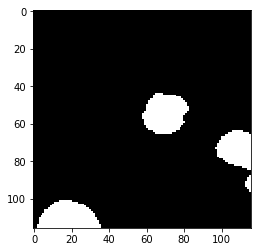

Label  22


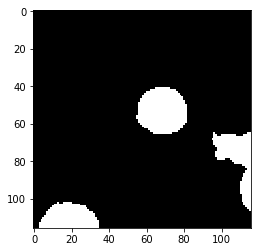

Prediction  23


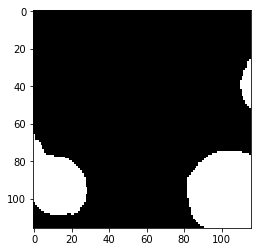

Label  23


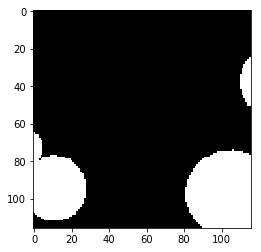

Prediction  24


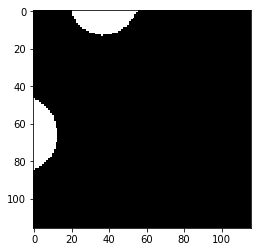

Label  24


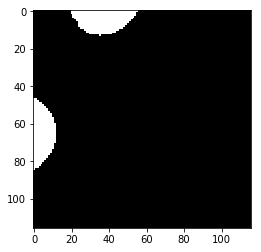

Prediction  25


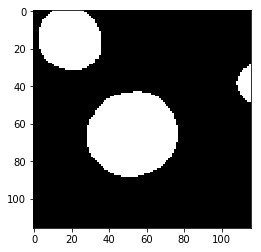

Label  25


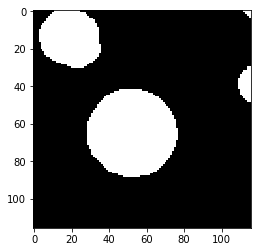

Prediction  26


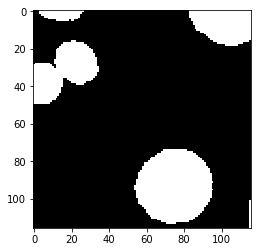

Label  26


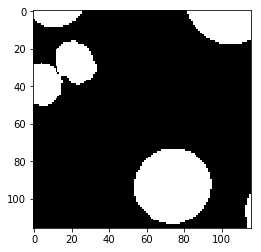

test_accuracy 0.976567947082
Batch: 24500 Train Loss value:0.00867967 Train Accuracy 0.993333827124
Prediction  0


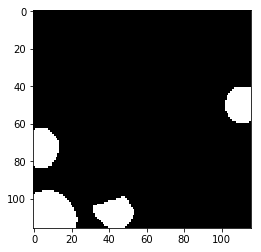

Label  0


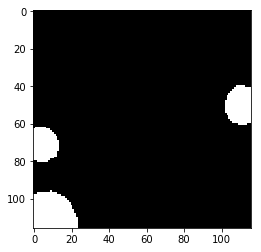

Prediction  1


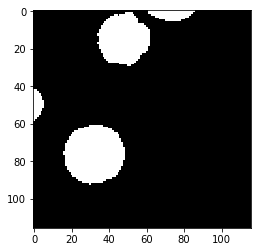

Label  1


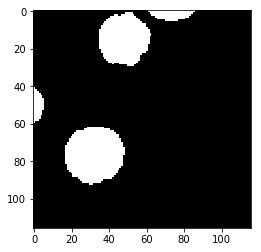

Prediction  2


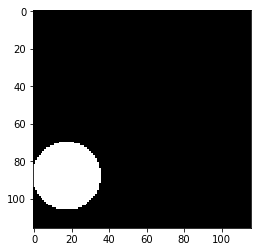

Label  2


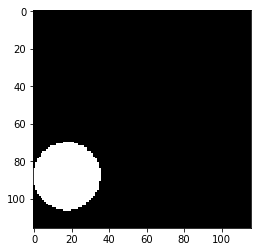

Prediction  3


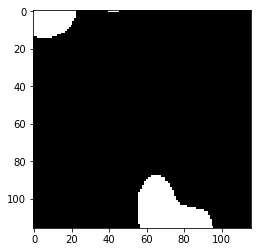

Label  3


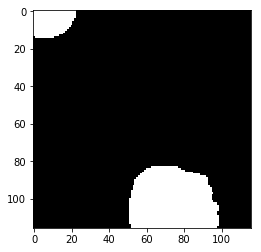

Prediction  4


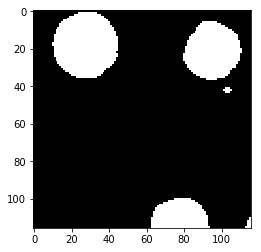

Label  4


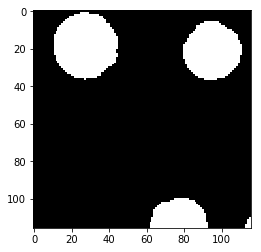

Prediction  5


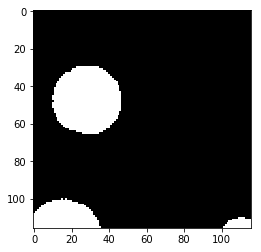

Label  5


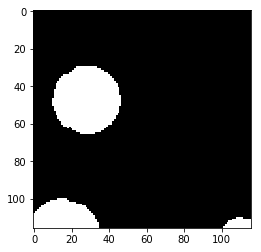

Prediction  6


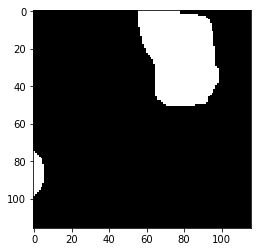

Label  6


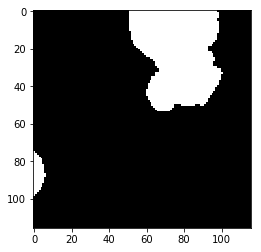

Prediction  7


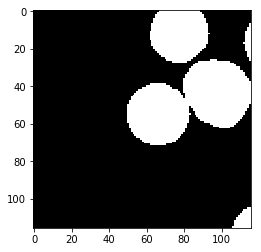

Label  7


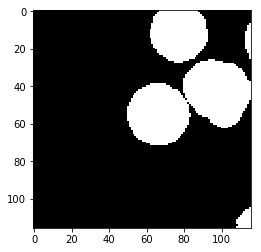

Prediction  8


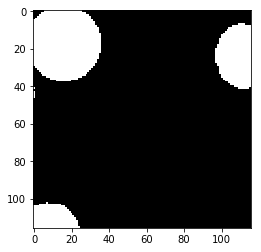

Label  8


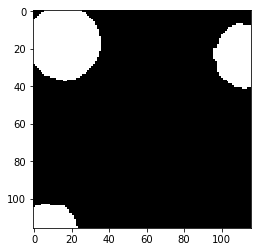

Prediction  9


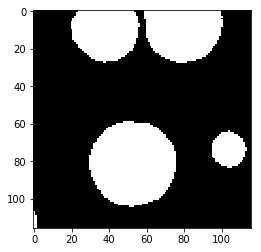

Label  9


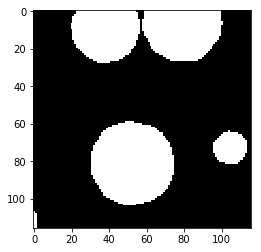

Prediction  10


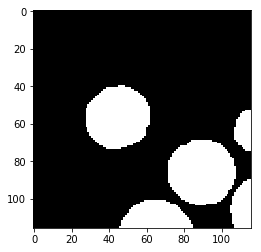

Label  10


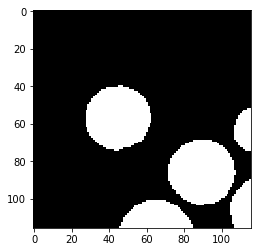

Prediction  11


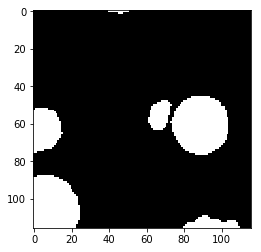

Label  11


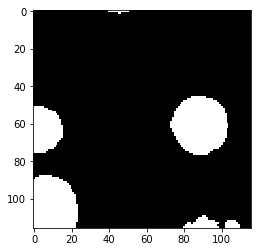

Prediction  12


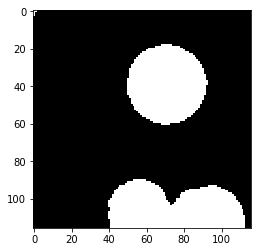

Label  12


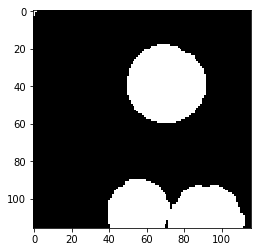

Prediction  13


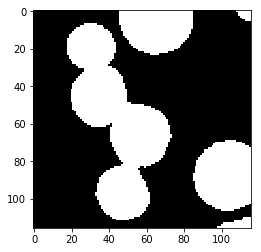

Label  13


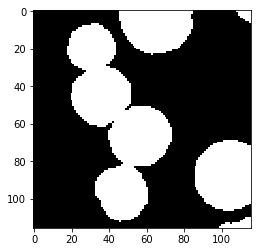

Prediction  14


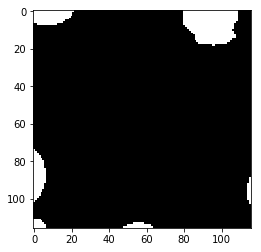

Label  14


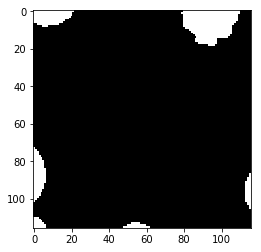

Prediction  15


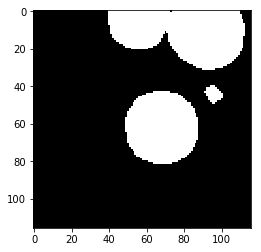

Label  15


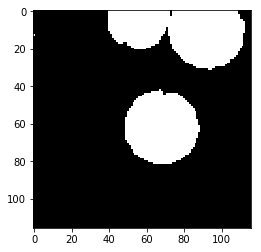

Prediction  16


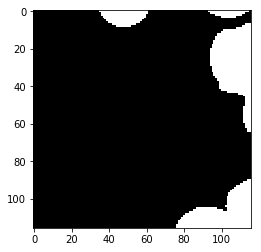

Label  16


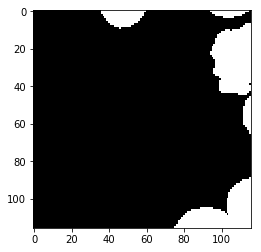

Prediction  17


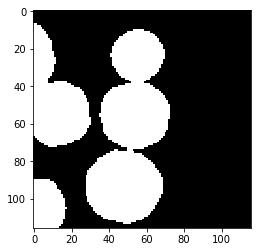

Label  17


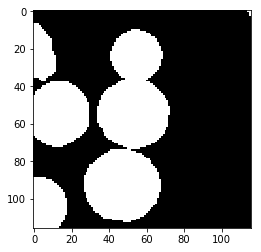

Prediction  18


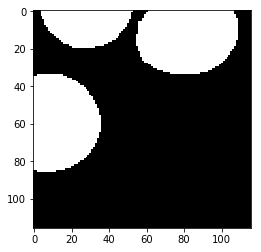

Label  18


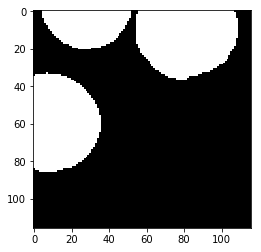

Prediction  19


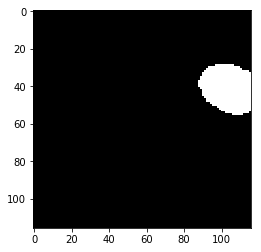

Label  19


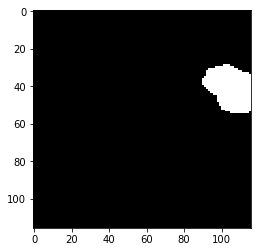

Prediction  20


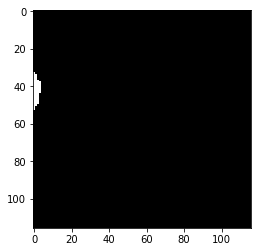

Label  20


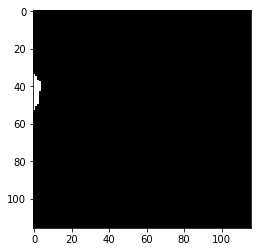

Prediction  21


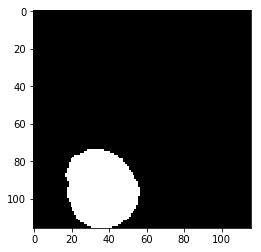

Label  21


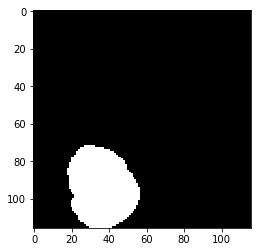

Prediction  22


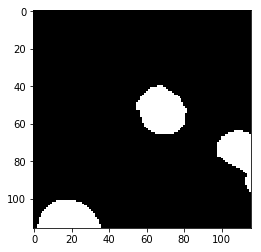

Label  22


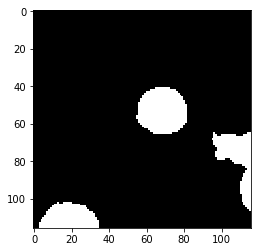

Prediction  23


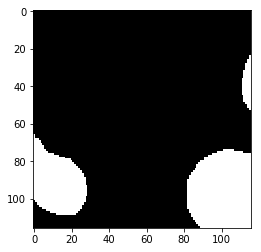

Label  23


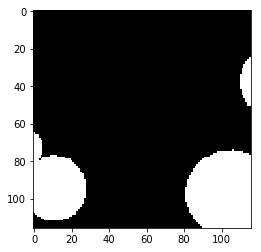

Prediction  24


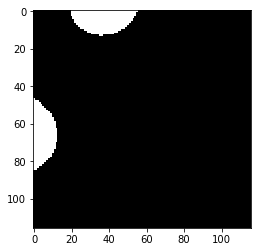

Label  24


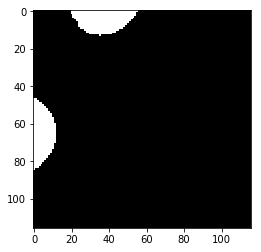

Prediction  25


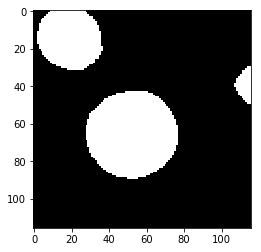

Label  25


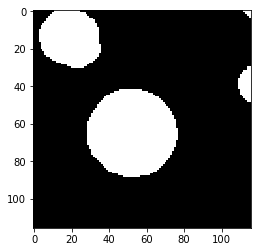

Prediction  26


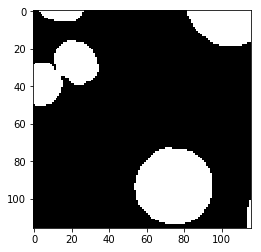

Label  26


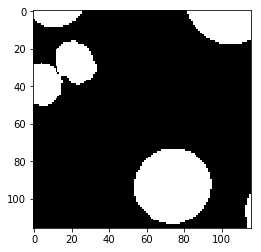

test_accuracy 0.975374504487
Batch: 25000 Train Loss value:0.00844816 Train Accuracy 0.99200592154
Prediction  0


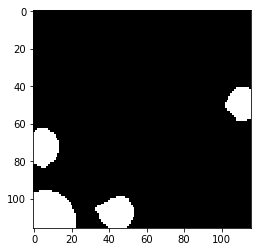

Label  0


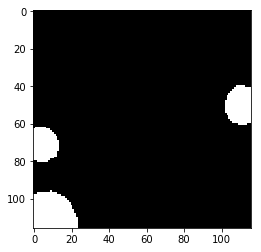

Prediction  1


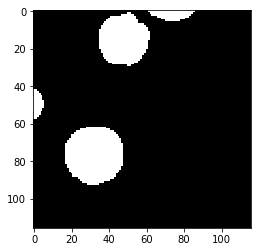

Label  1


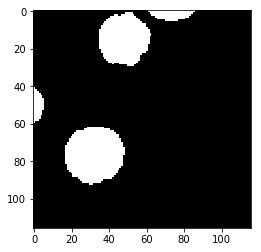

Prediction  2


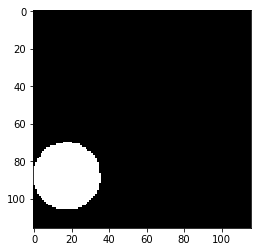

Label  2


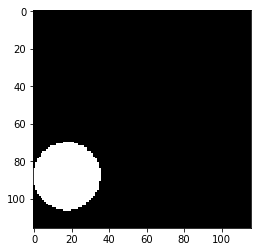

Prediction  3


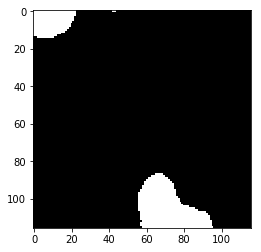

Label  3


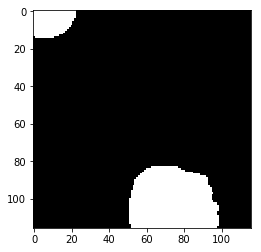

Prediction  4


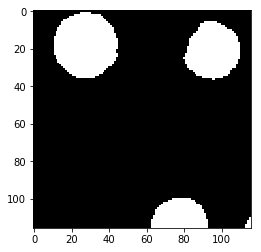

Label  4


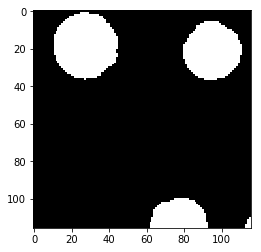

Prediction  5


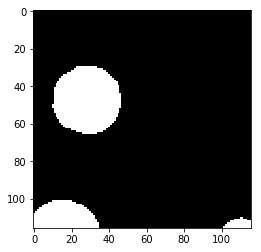

Label  5


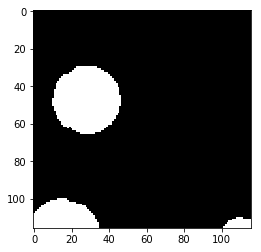

Prediction  6


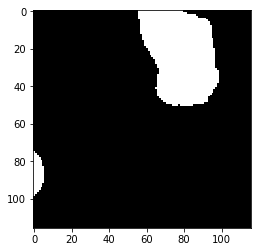

Label  6


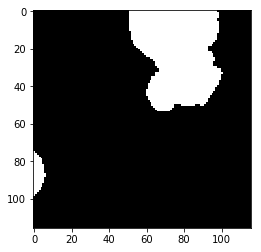

Prediction  7


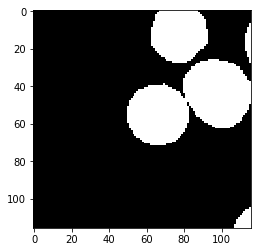

Label  7


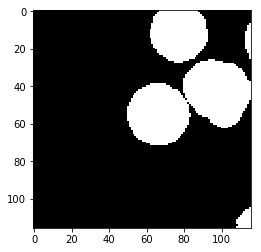

Prediction  8


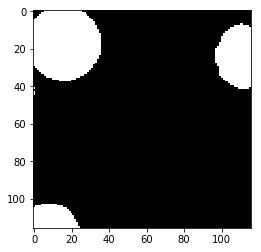

Label  8


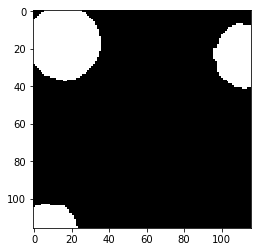

Prediction  9


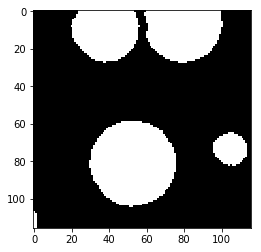

Label  9


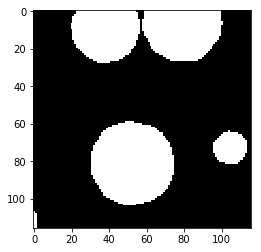

Prediction  10


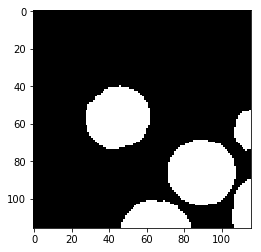

Label  10


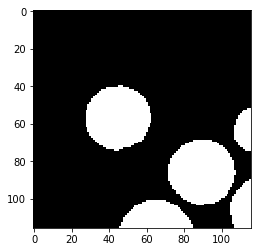

Prediction  11


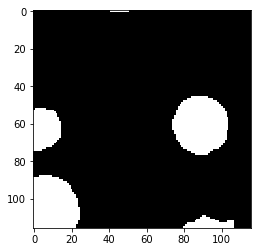

Label  11


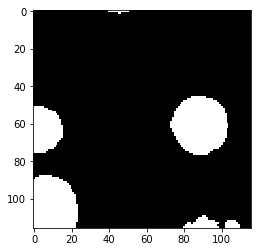

Prediction  12


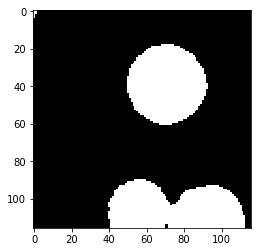

Label  12


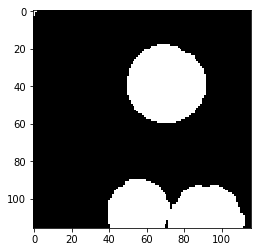

Prediction  13


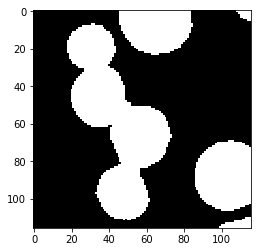

Label  13


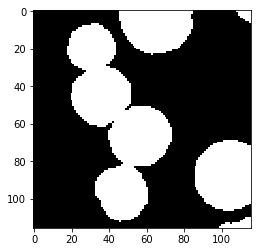

Prediction  14


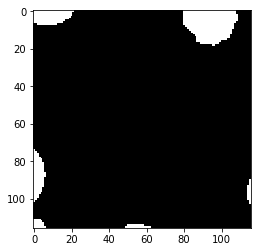

Label  14


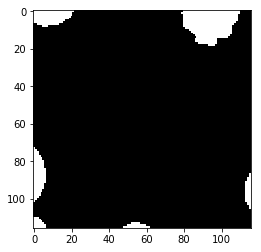

Prediction  15


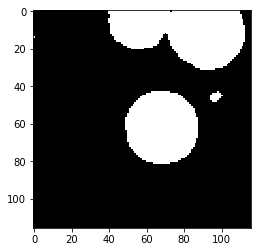

Label  15


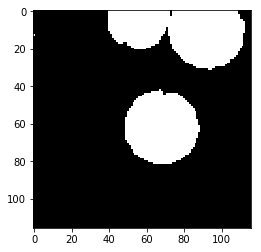

Prediction  16


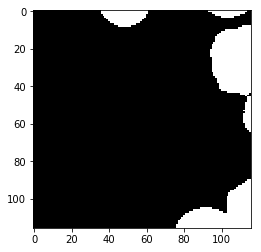

Label  16


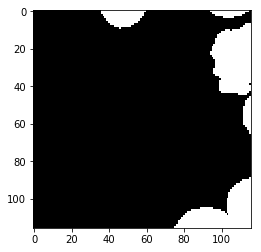

Prediction  17


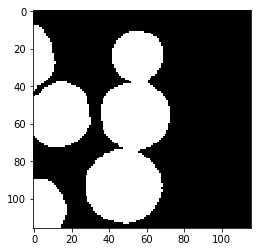

Label  17


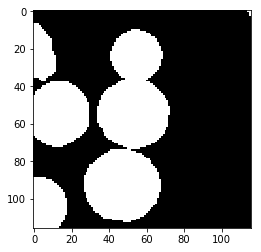

Prediction  18


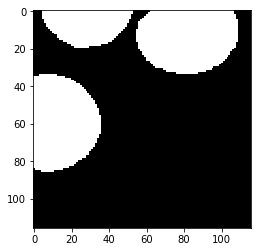

Label  18


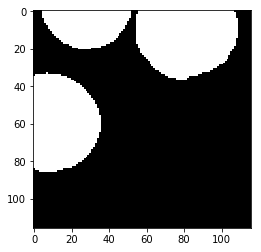

Prediction  19


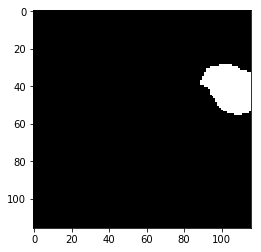

Label  19


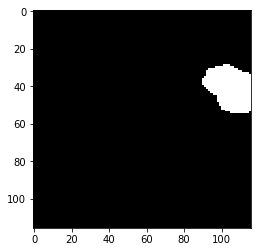

Prediction  20


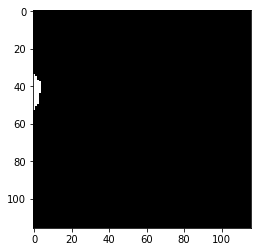

Label  20


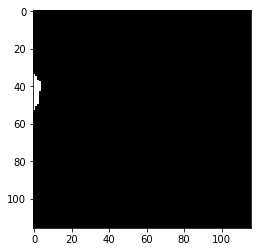

Prediction  21


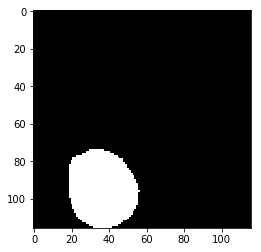

Label  21


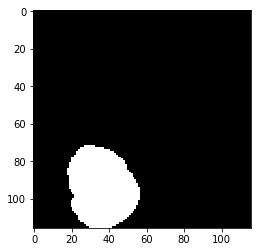

Prediction  22


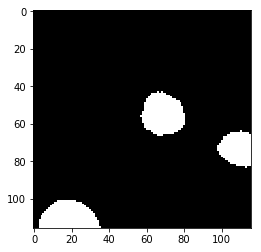

Label  22


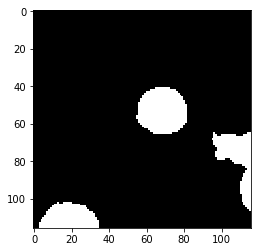

Prediction  23


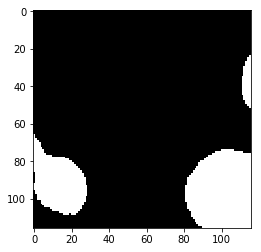

Label  23


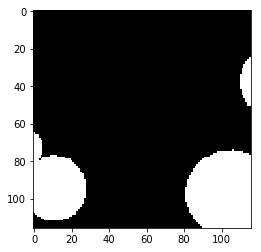

Prediction  24


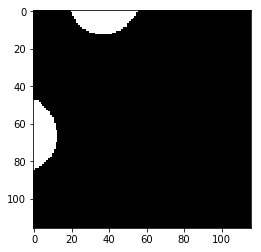

Label  24


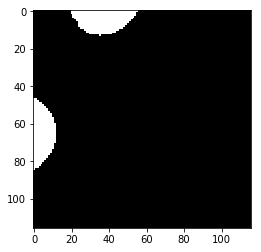

Prediction  25


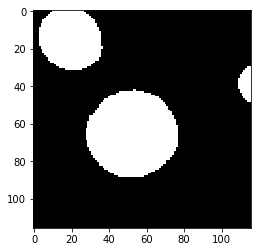

Label  25


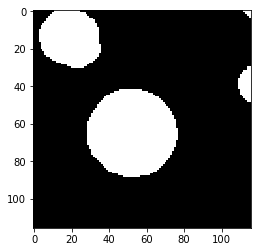

Prediction  26


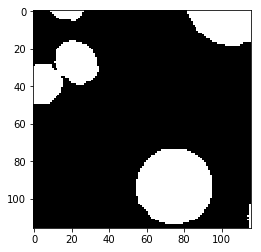

Label  26


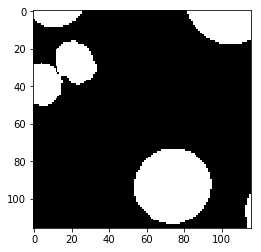

test_accuracy 0.975678004011
Batch: 25500 Train Loss value:0.00135116 Train Accuracy 0.998960112902
Prediction  0


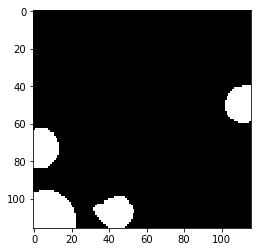

Label  0


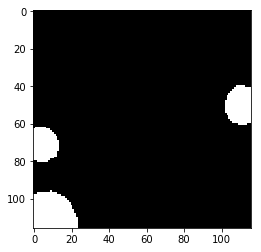

Prediction  1


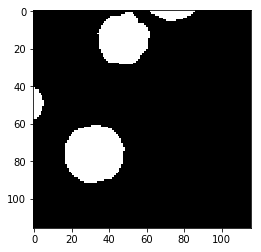

Label  1


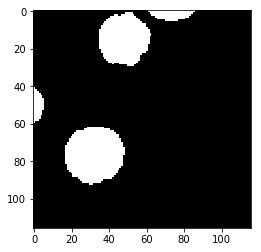

Prediction  2


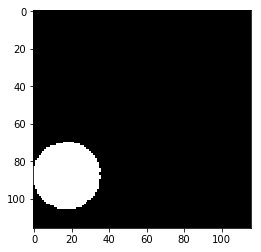

Label  2


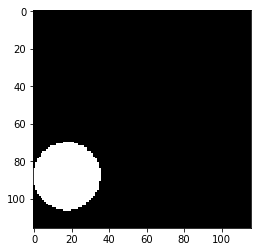

Prediction  3


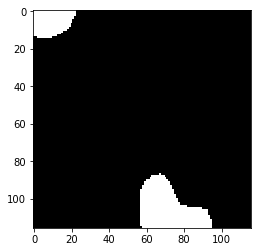

Label  3


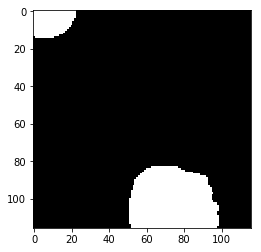

Prediction  4


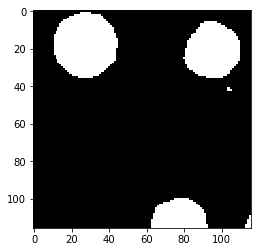

Label  4


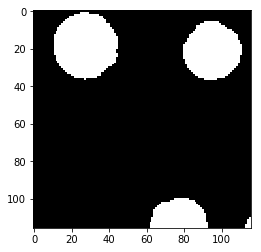

Prediction  5


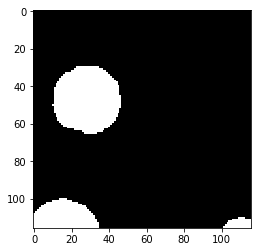

Label  5


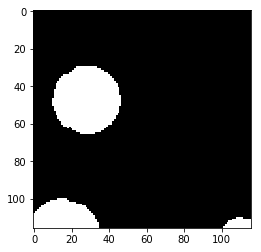

Prediction  6


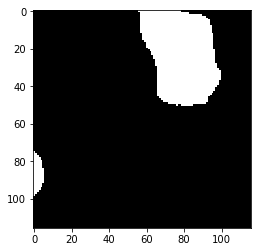

Label  6


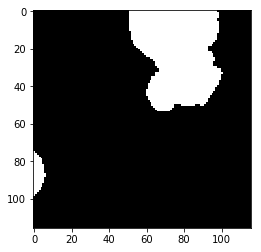

Prediction  7


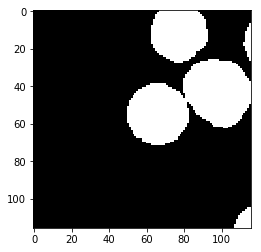

Label  7


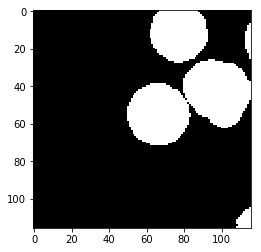

Prediction  8


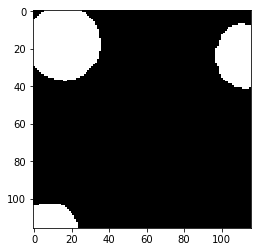

Label  8


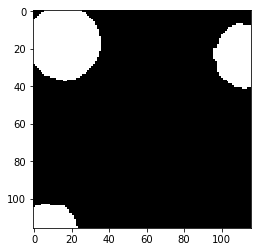

Prediction  9


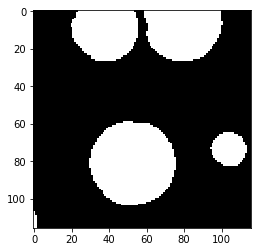

Label  9


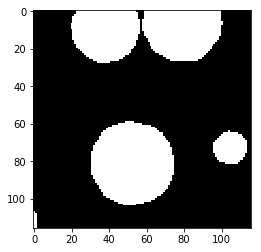

Prediction  10


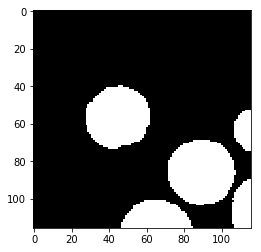

Label  10


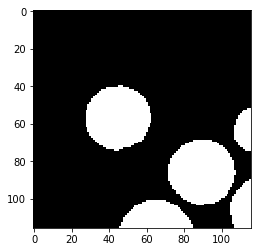

Prediction  11


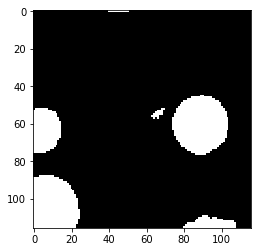

Label  11


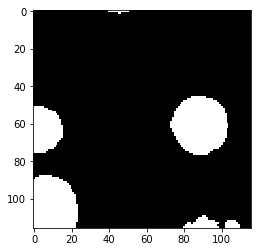

Prediction  12


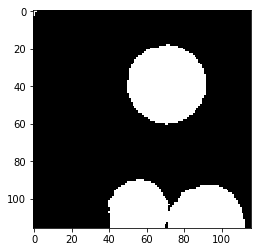

Label  12


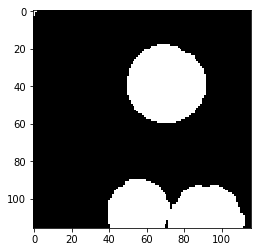

Prediction  13


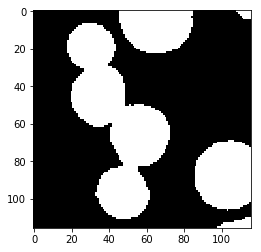

Label  13


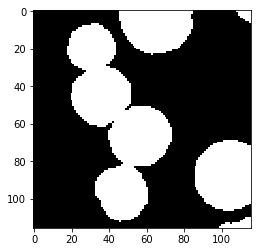

Prediction  14


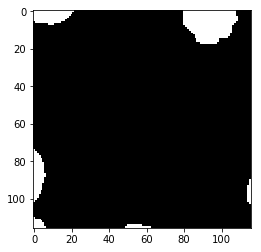

Label  14


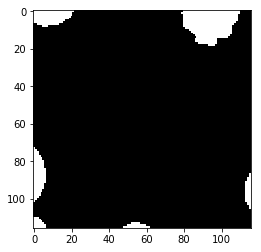

Prediction  15


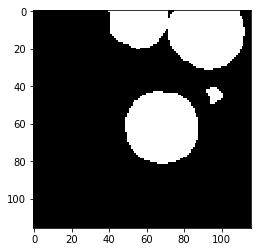

Label  15


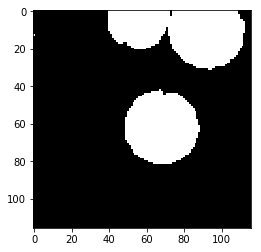

Prediction  16


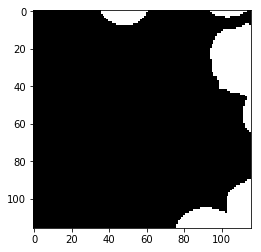

Label  16


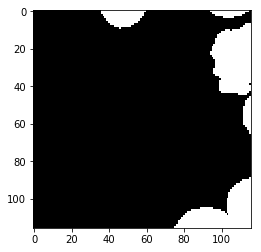

Prediction  17


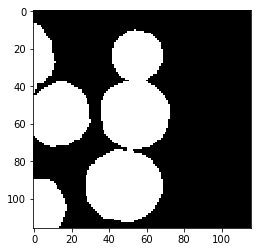

Label  17


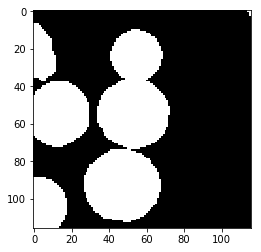

Prediction  18


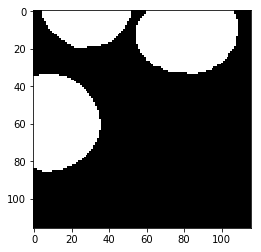

Label  18


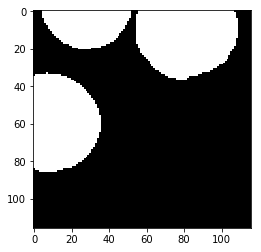

Prediction  19


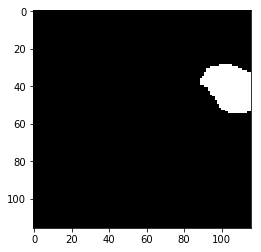

Label  19


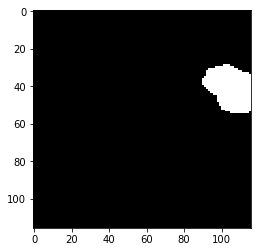

Prediction  20


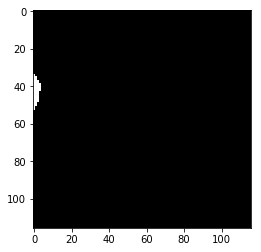

Label  20


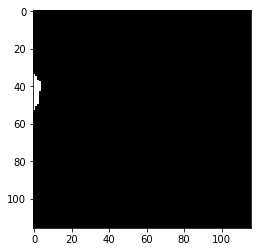

Prediction  21


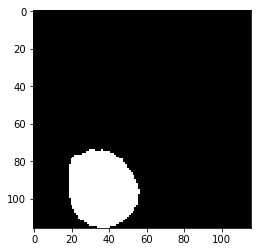

Label  21


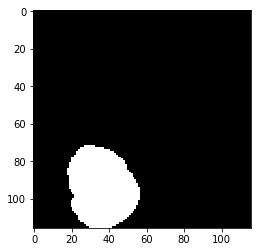

Prediction  22


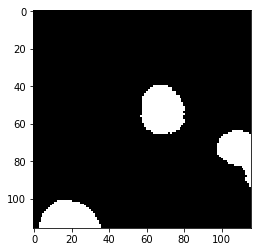

Label  22


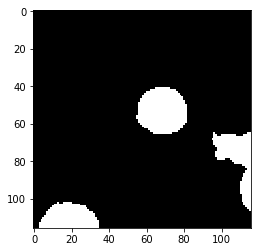

Prediction  23


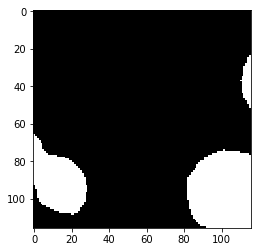

Label  23


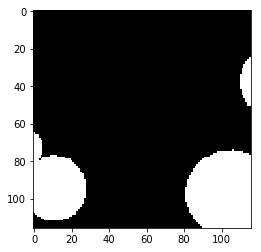

Prediction  24


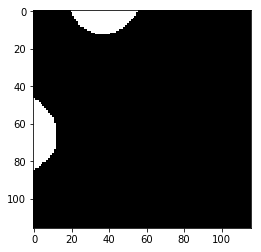

Label  24


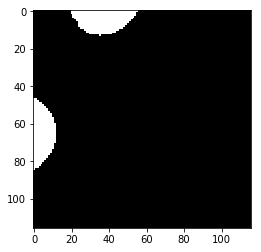

Prediction  25


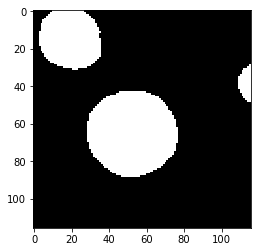

Label  25


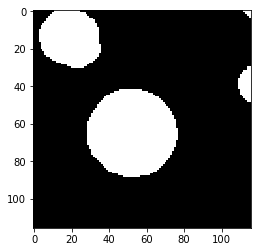

Prediction  26


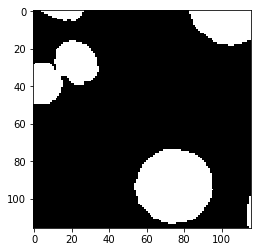

Label  26


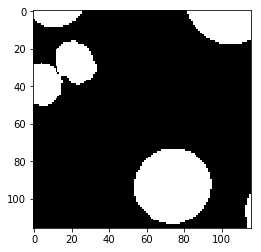

test_accuracy 0.976923580877
Batch: 26000 Train Loss value:0.0149049 Train Accuracy 0.987005316007
Prediction  0


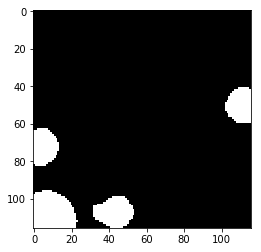

Label  0


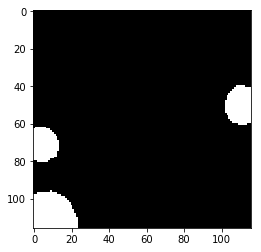

Prediction  1


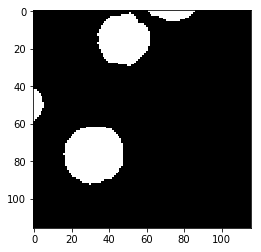

Label  1


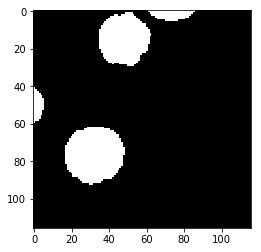

Prediction  2


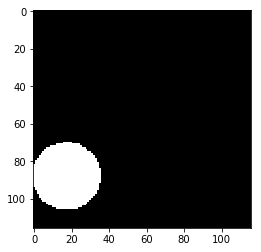

Label  2


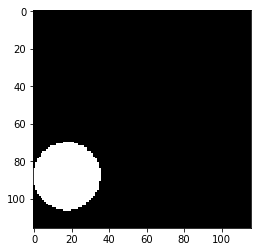

Prediction  3


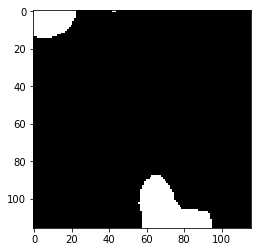

Label  3


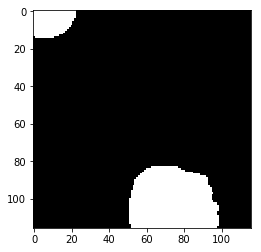

Prediction  4


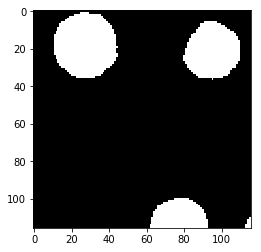

Label  4


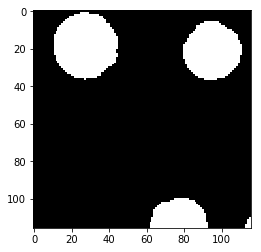

Prediction  5


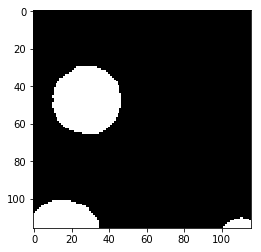

Label  5


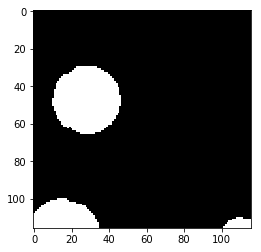

Prediction  6


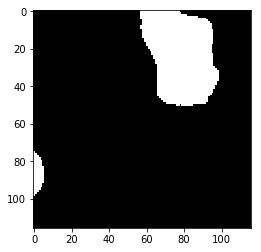

Label  6


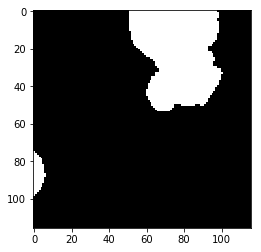

Prediction  7


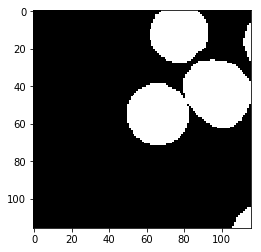

Label  7


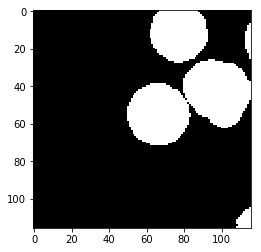

Prediction  8


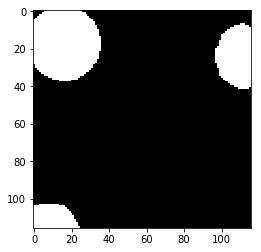

Label  8


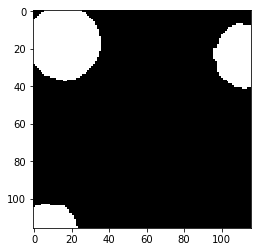

Prediction  9


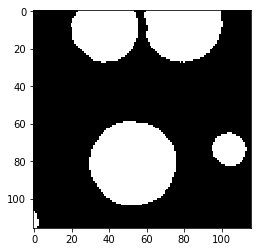

Label  9


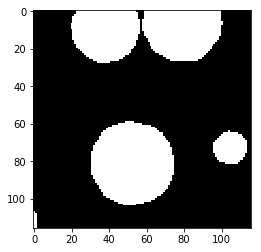

Prediction  10


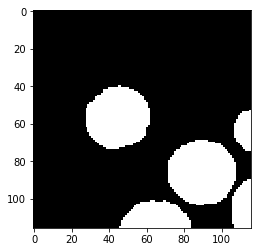

Label  10


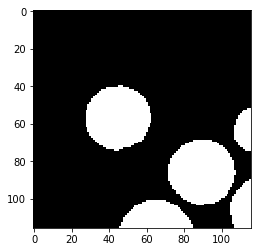

Prediction  11


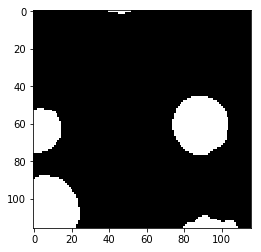

Label  11


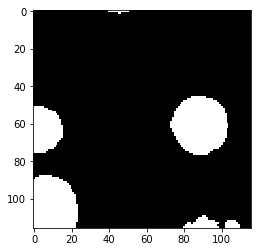

Prediction  12


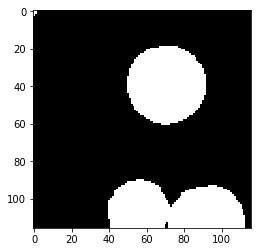

Label  12


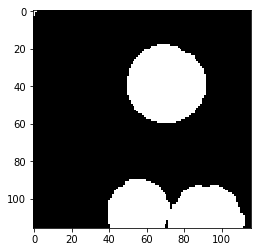

Prediction  13


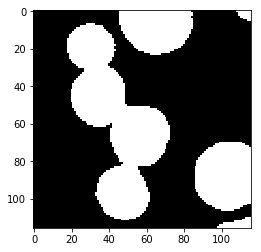

Label  13


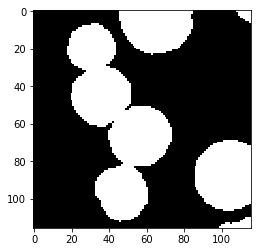

Prediction  14


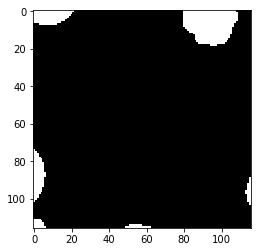

Label  14


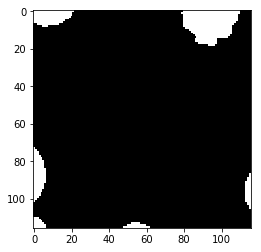

Prediction  15


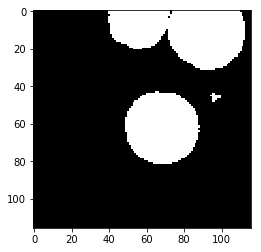

Label  15


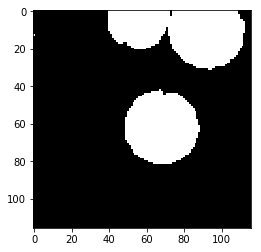

Prediction  16


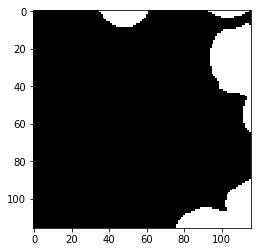

Label  16


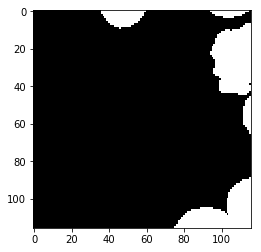

Prediction  17


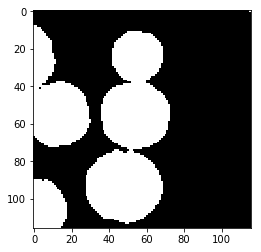

Label  17


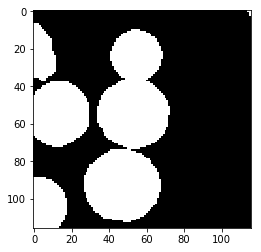

Prediction  18


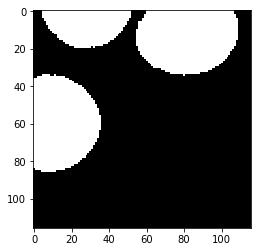

Label  18


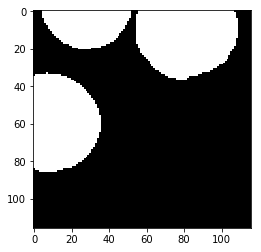

Prediction  19


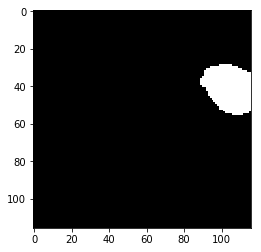

Label  19


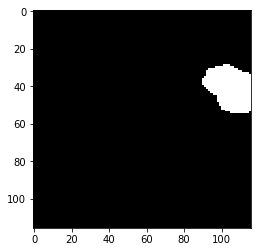

Prediction  20


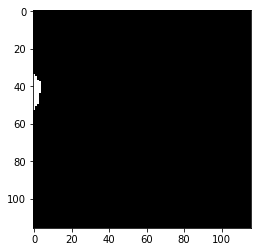

Label  20


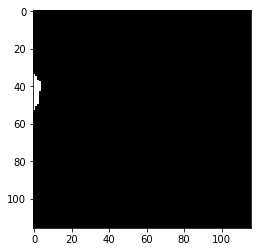

Prediction  21


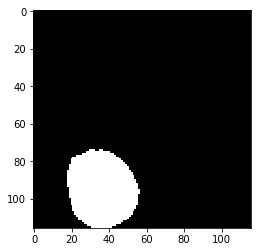

Label  21


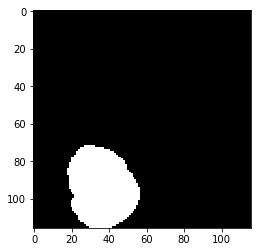

Prediction  22


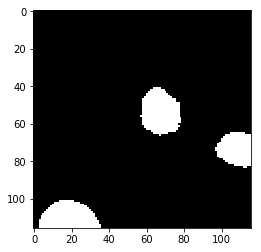

Label  22


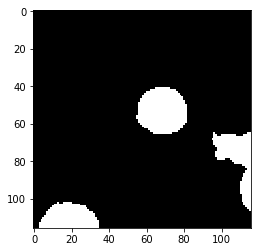

Prediction  23


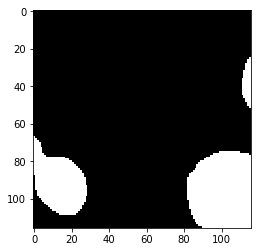

Label  23


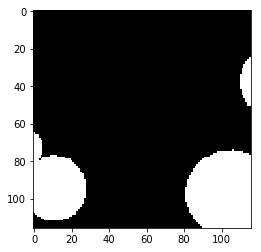

Prediction  24


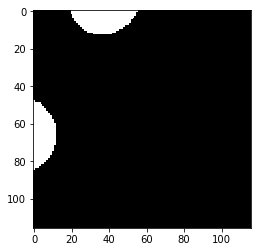

Label  24


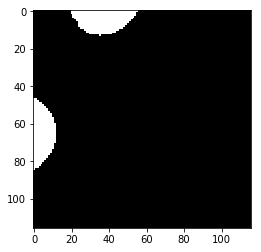

Prediction  25


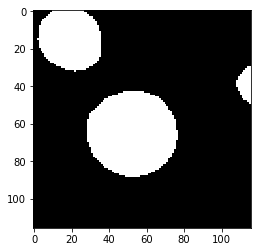

Label  25


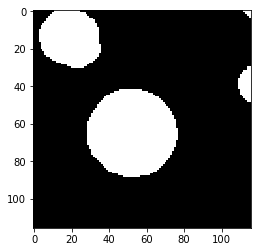

Prediction  26


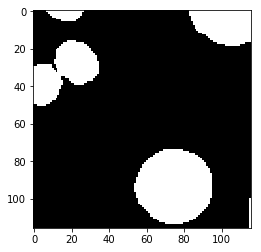

Label  26


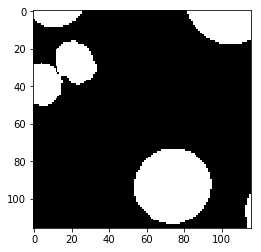

test_accuracy 0.975785152809
Batch: 26500 Train Loss value:0.00824057 Train Accuracy 0.99230085875
Prediction  0


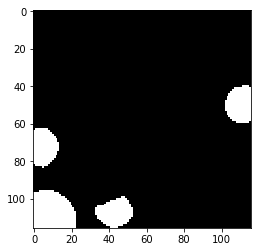

Label  0


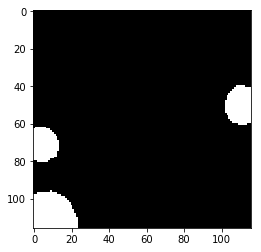

Prediction  1


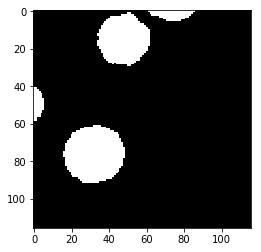

Label  1


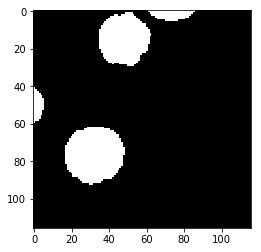

Prediction  2


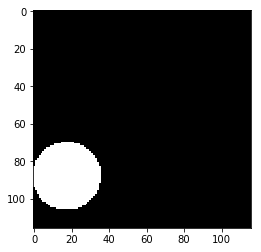

Label  2


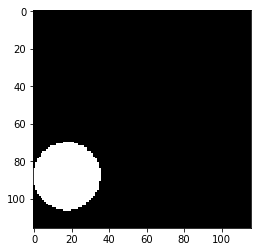

Prediction  3


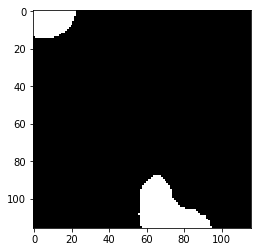

Label  3


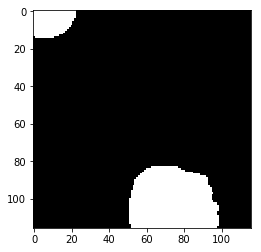

Prediction  4


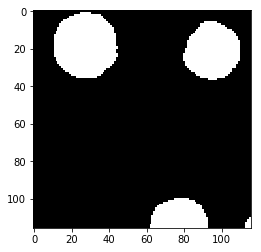

Label  4


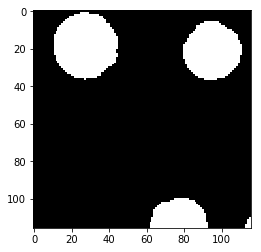

Prediction  5


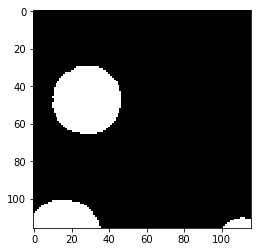

Label  5


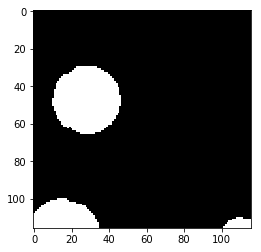

Prediction  6


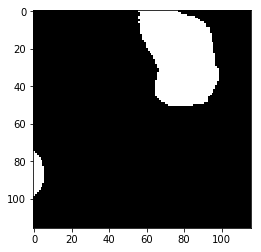

Label  6


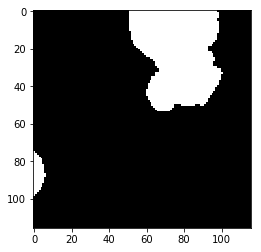

Prediction  7


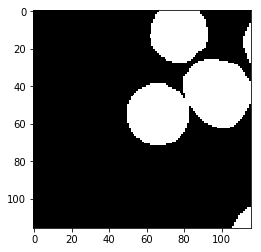

Label  7


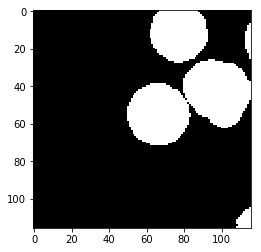

Prediction  8


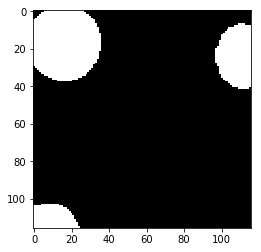

Label  8


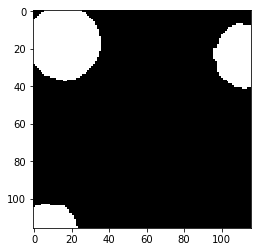

Prediction  9


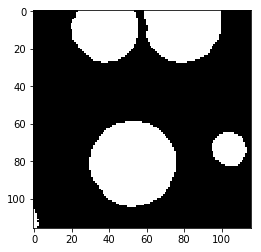

Label  9


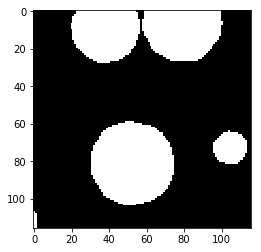

Prediction  10


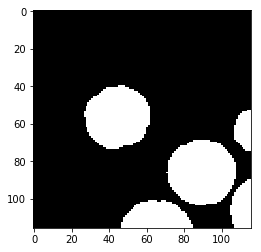

Label  10


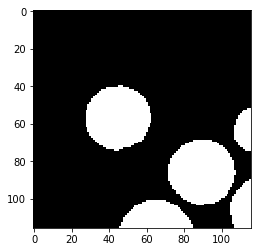

Prediction  11


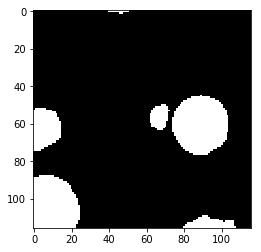

Label  11


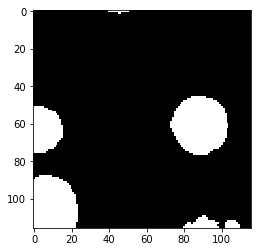

Prediction  12


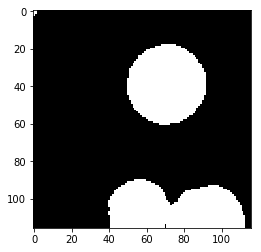

Label  12


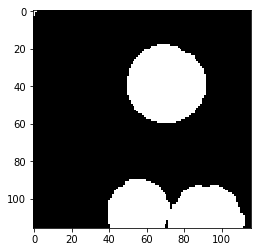

Prediction  13


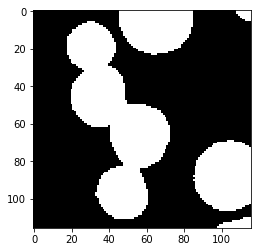

Label  13


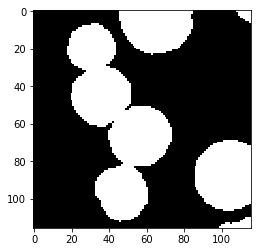

Prediction  14


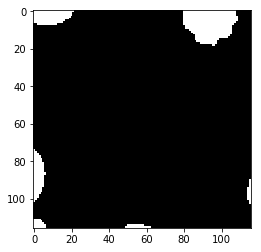

Label  14


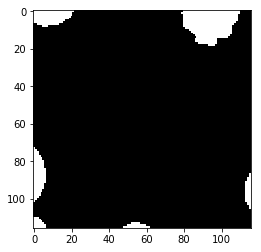

Prediction  15


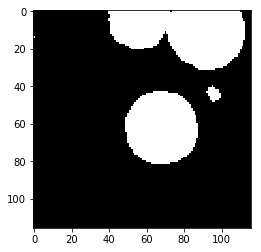

Label  15


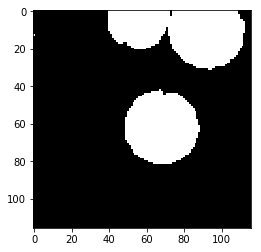

Prediction  16


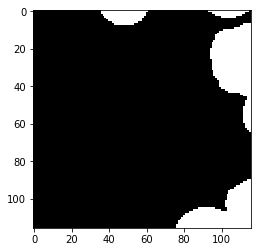

Label  16


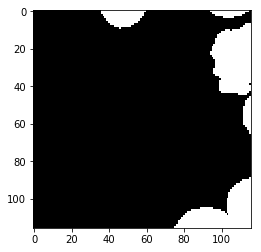

Prediction  17


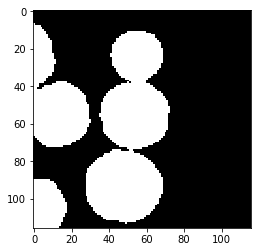

Label  17


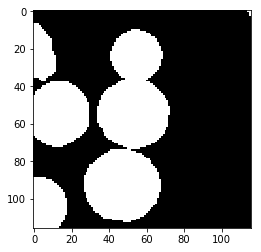

Prediction  18


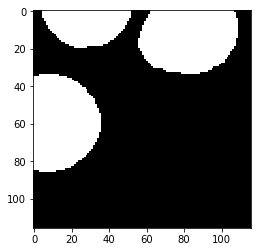

Label  18


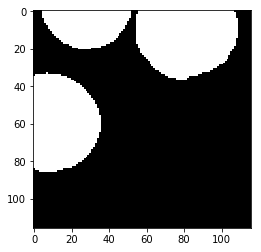

Prediction  19


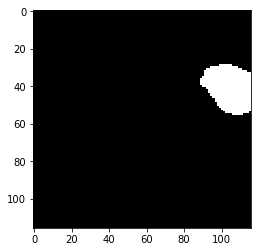

Label  19


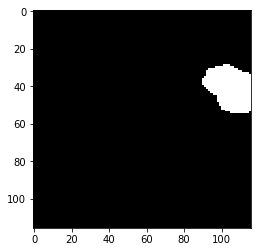

Prediction  20


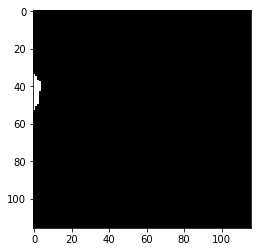

Label  20


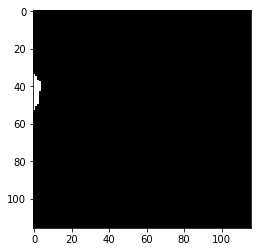

Prediction  21


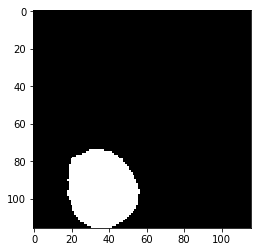

Label  21


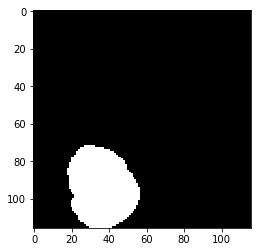

Prediction  22


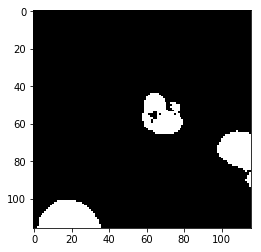

Label  22


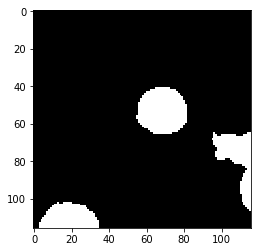

Prediction  23


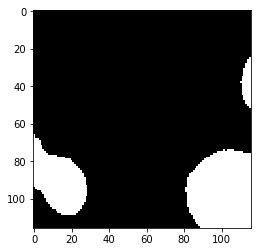

Label  23


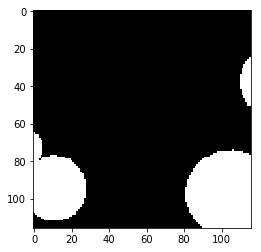

Prediction  24


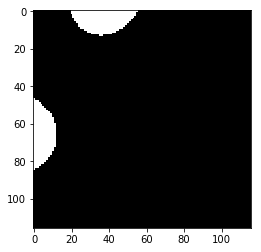

Label  24


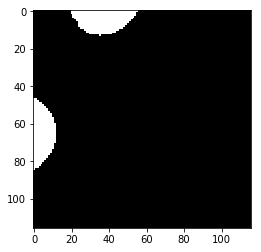

Prediction  25


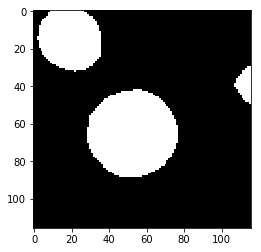

Label  25


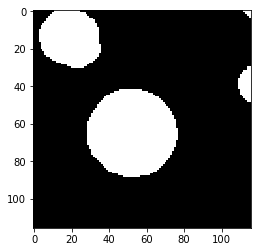

Prediction  26


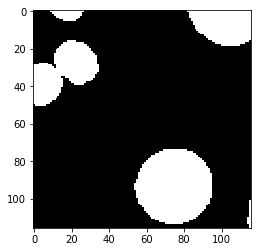

Label  26


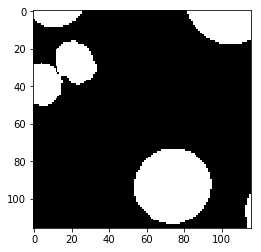

test_accuracy 0.974479330085
Batch: 27000 Train Loss value:0.0116511 Train Accuracy 0.990090956149
Prediction  0


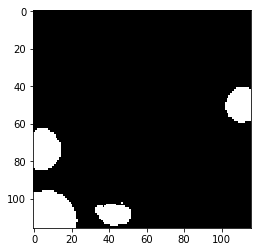

Label  0


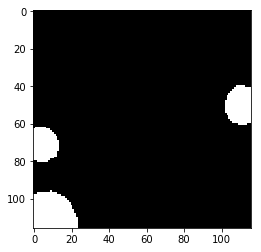

Prediction  1


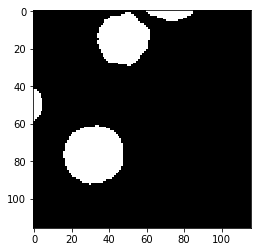

Label  1


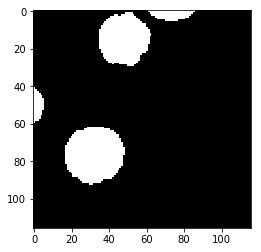

Prediction  2


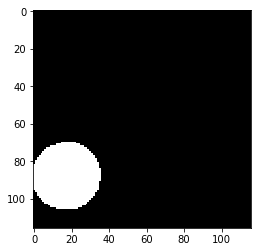

Label  2


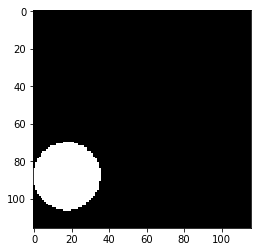

Prediction  3


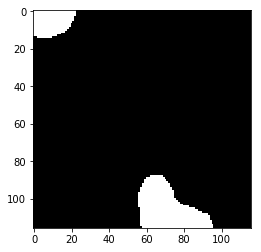

Label  3


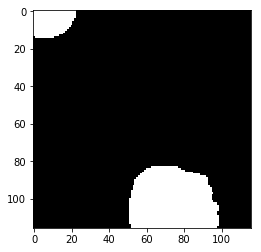

Prediction  4


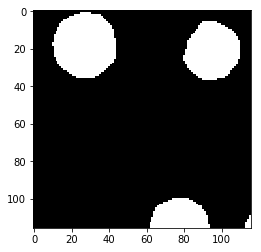

Label  4


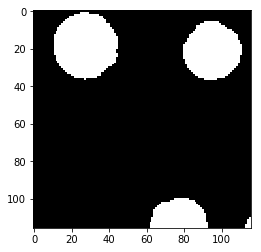

Prediction  5


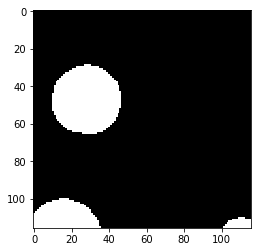

Label  5


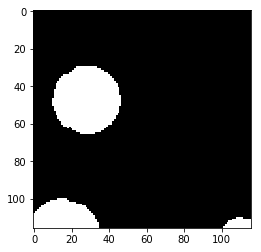

Prediction  6


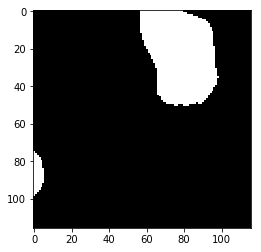

Label  6


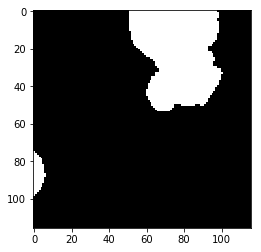

Prediction  7


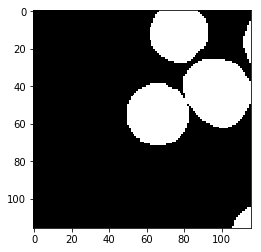

Label  7


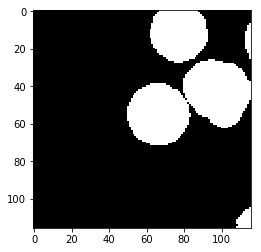

Prediction  8


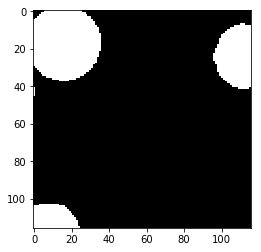

Label  8


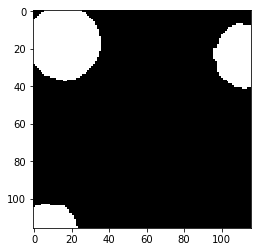

Prediction  9


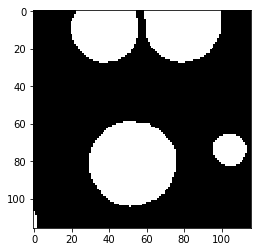

Label  9


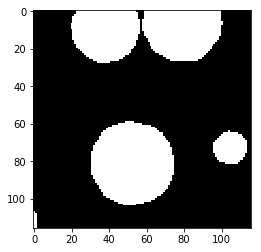

Prediction  10


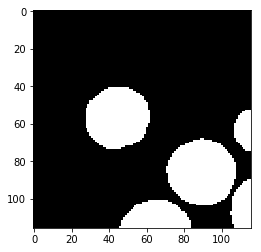

Label  10


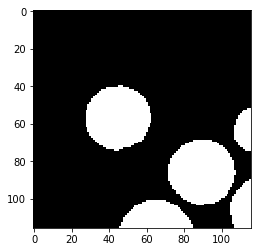

Prediction  11


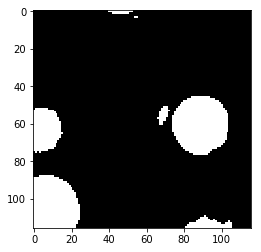

Label  11


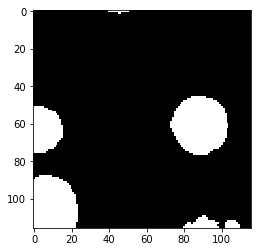

Prediction  12


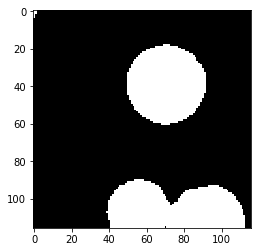

Label  12


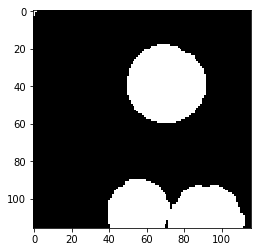

Prediction  13


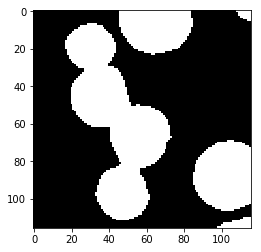

Label  13


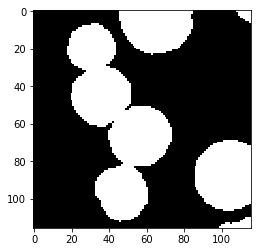

Prediction  14


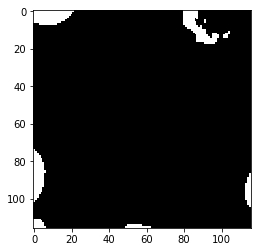

Label  14


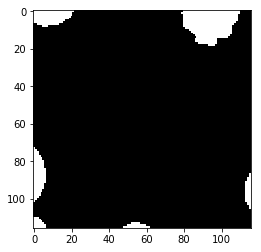

Prediction  15


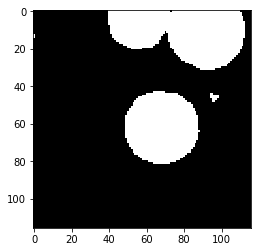

Label  15


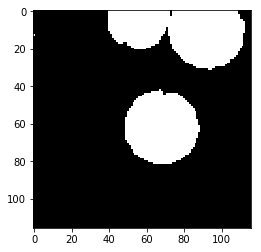

Prediction  16


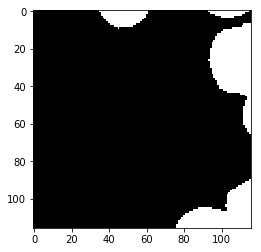

Label  16


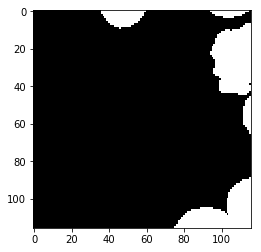

Prediction  17


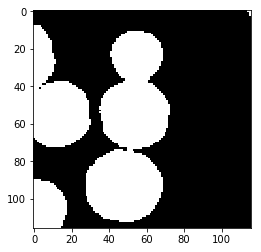

Label  17


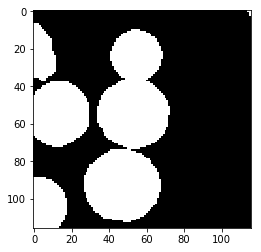

Prediction  18


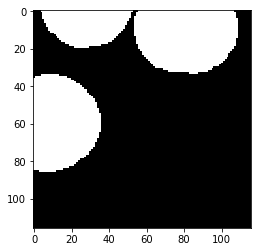

Label  18


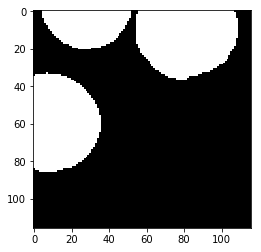

Prediction  19


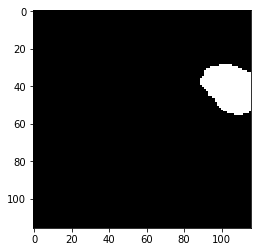

Label  19


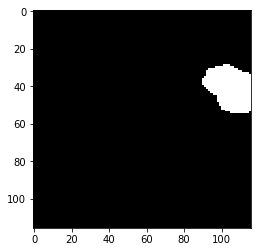

Prediction  20


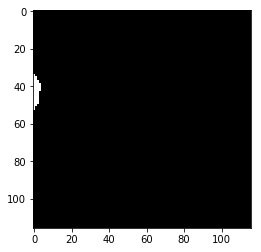

Label  20


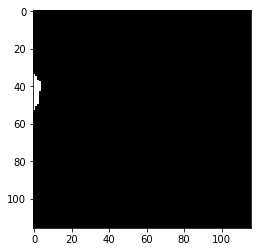

Prediction  21


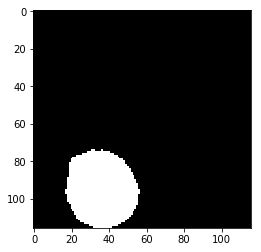

Label  21


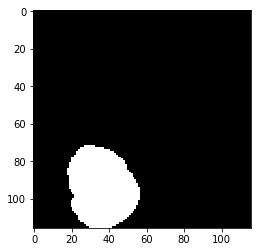

Prediction  22


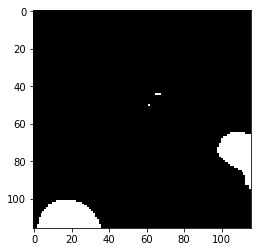

Label  22


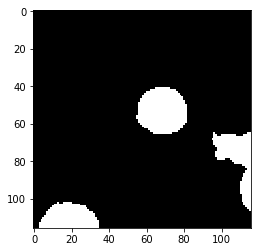

Prediction  23


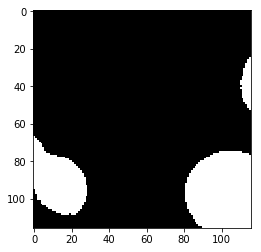

Label  23


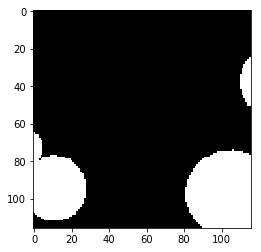

Prediction  24


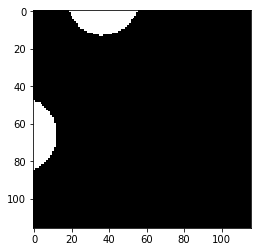

Label  24


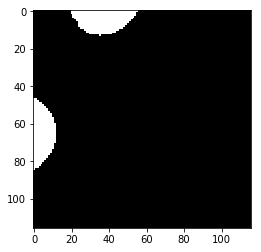

Prediction  25


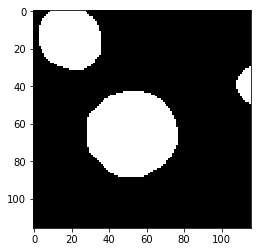

Label  25


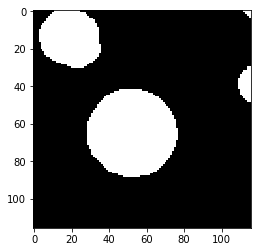

Prediction  26


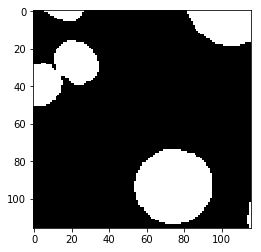

Label  26


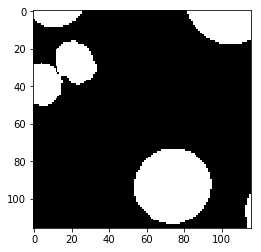

test_accuracy 0.972789669584
Batch: 27500 Train Loss value:0.00622881 Train Accuracy 0.994515674794
Prediction  0


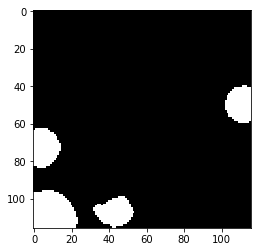

Label  0


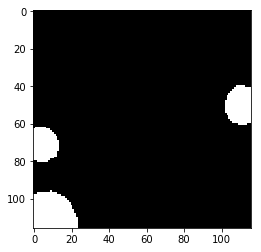

Prediction  1


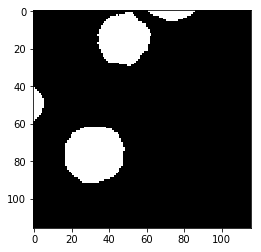

Label  1


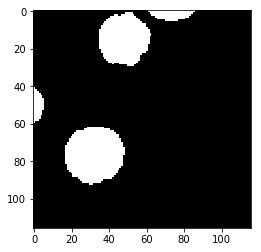

Prediction  2


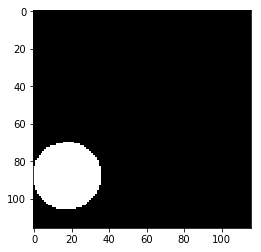

Label  2


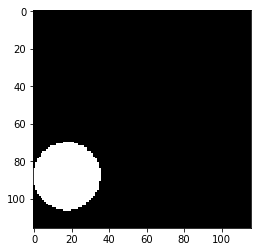

Prediction  3


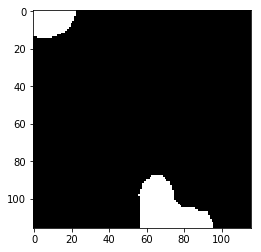

Label  3


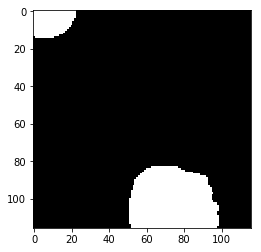

Prediction  4


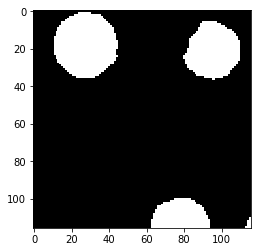

Label  4


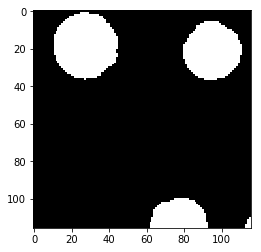

Prediction  5


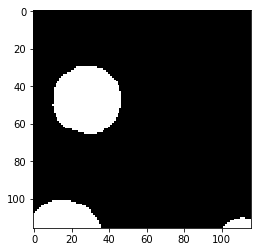

Label  5


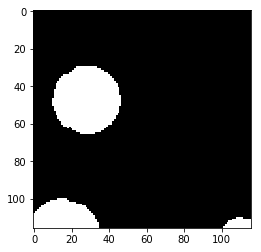

Prediction  6


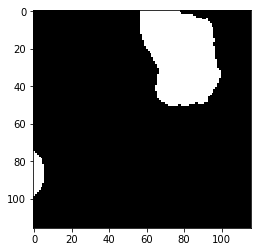

Label  6


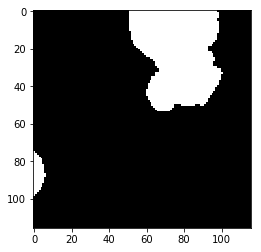

Prediction  7


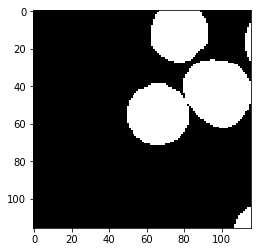

Label  7


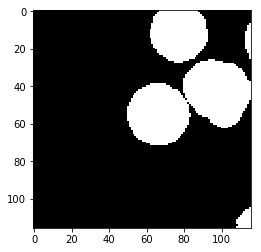

Prediction  8


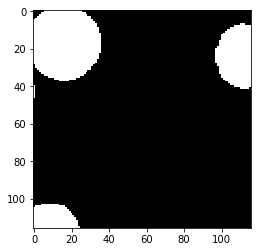

Label  8


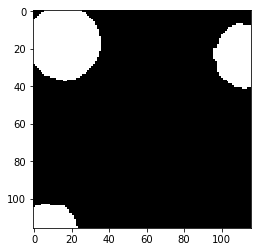

Prediction  9


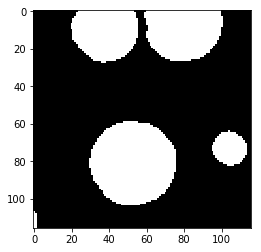

Label  9


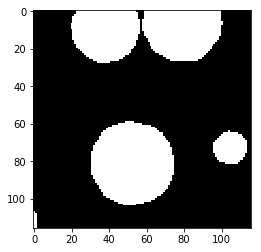

Prediction  10


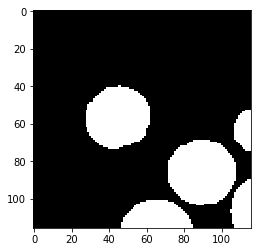

Label  10


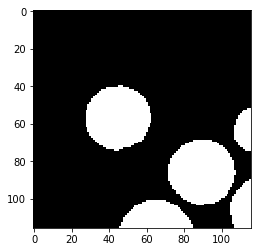

Prediction  11


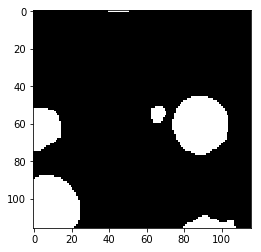

Label  11


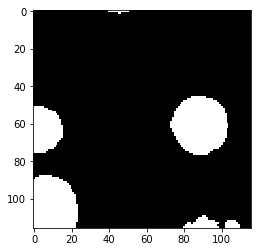

Prediction  12


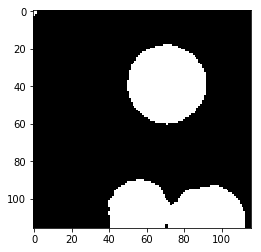

Label  12


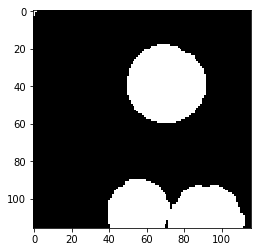

Prediction  13


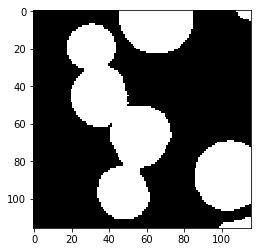

Label  13


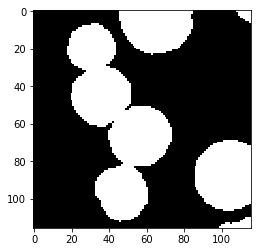

Prediction  14


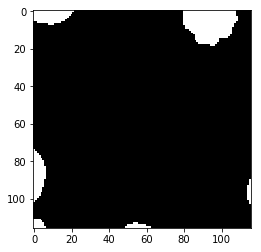

Label  14


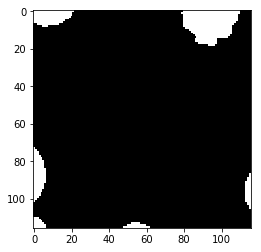

Prediction  15


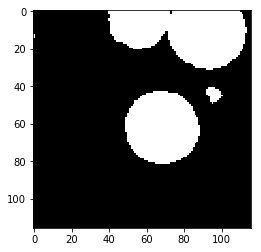

Label  15


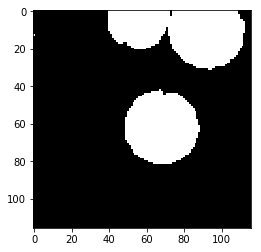

Prediction  16


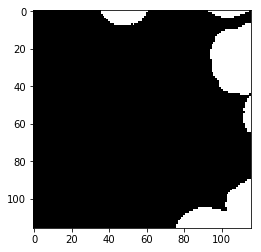

Label  16


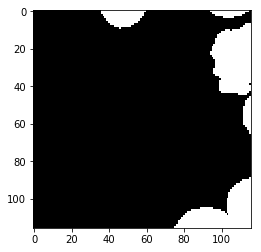

Prediction  17


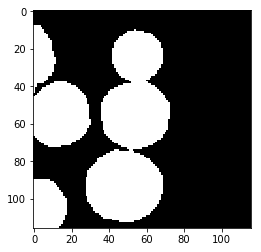

Label  17


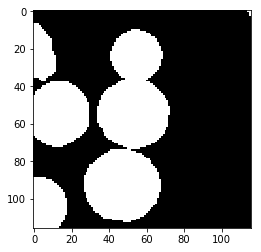

Prediction  18


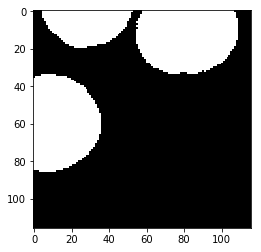

Label  18


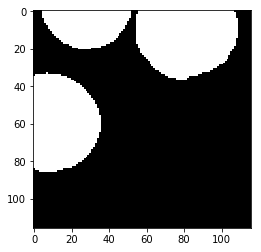

Prediction  19


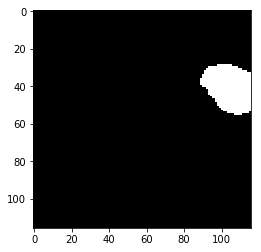

Label  19


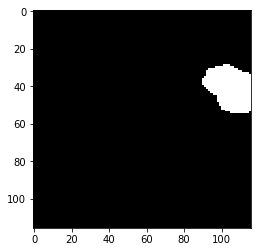

Prediction  20


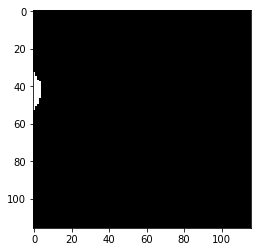

Label  20


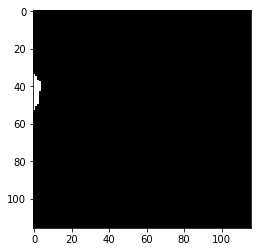

Prediction  21


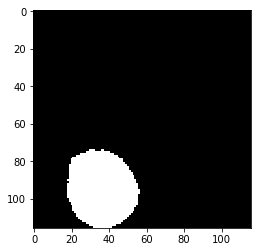

Label  21


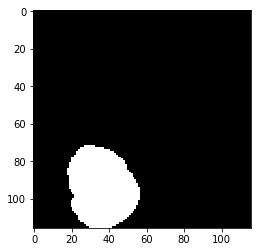

Prediction  22


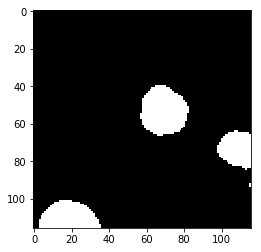

Label  22


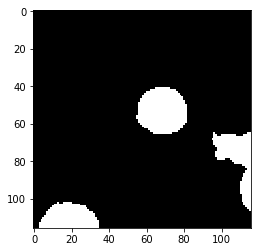

Prediction  23


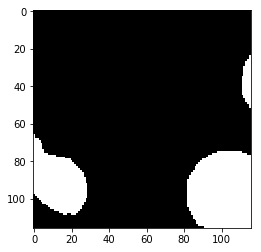

Label  23


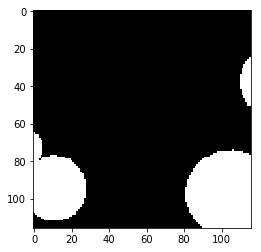

Prediction  24


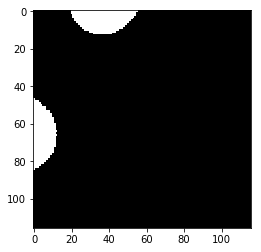

Label  24


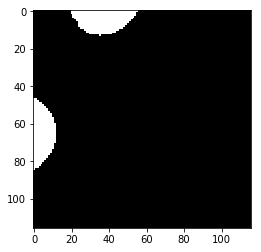

Prediction  25


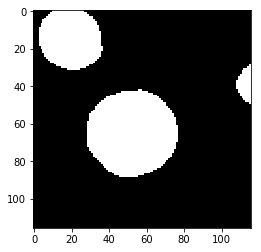

Label  25


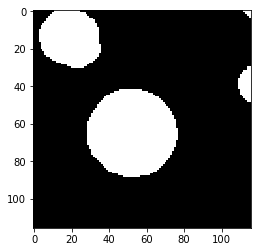

Prediction  26


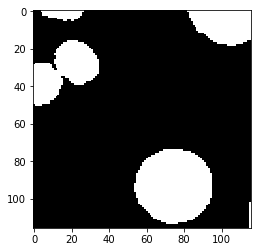

Label  26


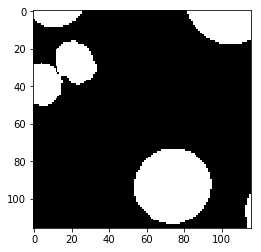

test_accuracy 0.976634217315
Batch: 28000 Train Loss value:0.00805241 Train Accuracy 0.99377685583
Prediction  0


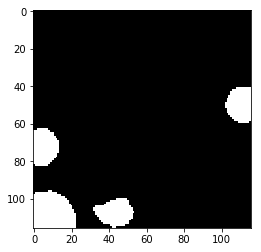

Label  0


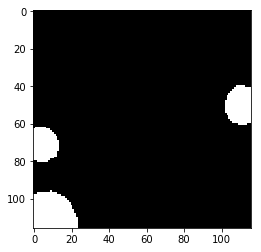

Prediction  1


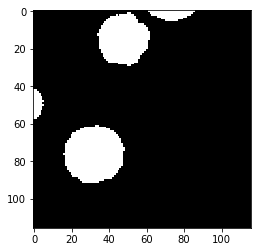

Label  1


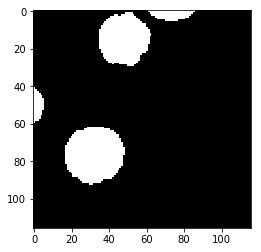

Prediction  2


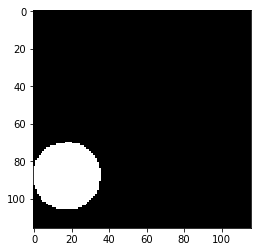

Label  2


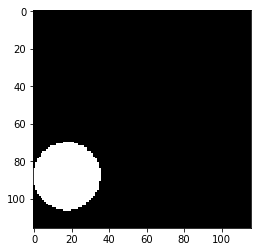

Prediction  3


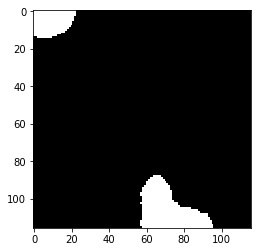

Label  3


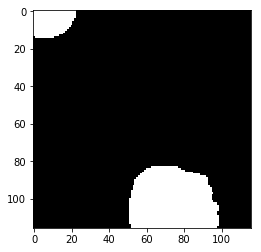

Prediction  4


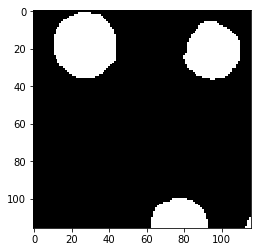

Label  4


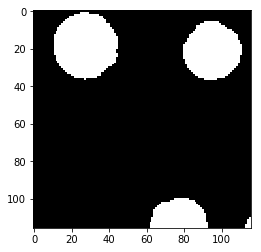

Prediction  5


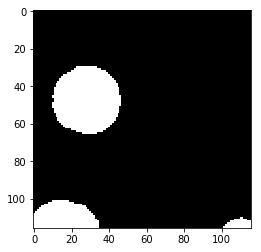

Label  5


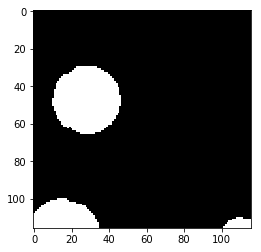

Prediction  6


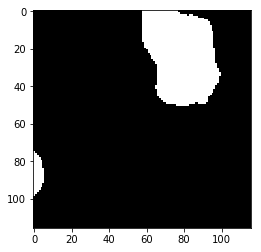

Label  6


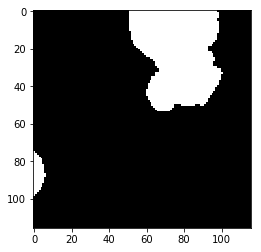

Prediction  7


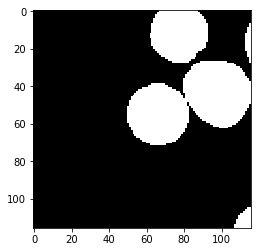

Label  7


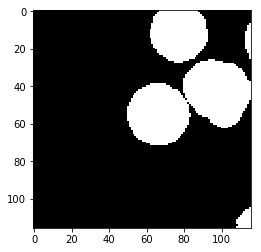

Prediction  8


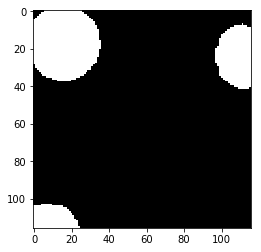

Label  8


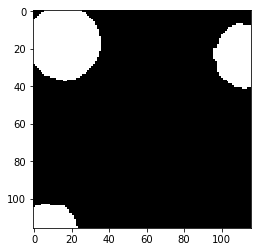

Prediction  9


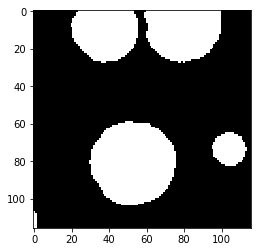

Label  9


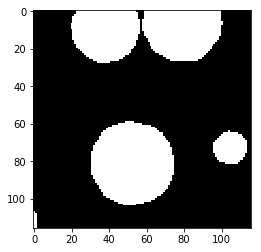

Prediction  10


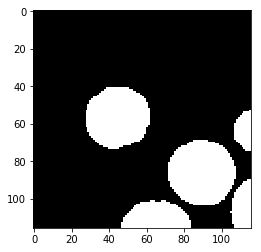

Label  10


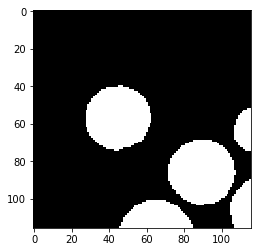

Prediction  11


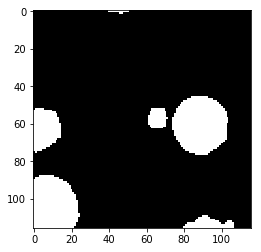

Label  11


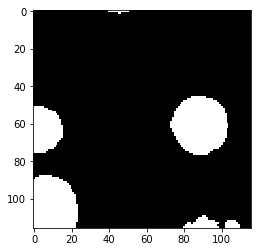

Prediction  12


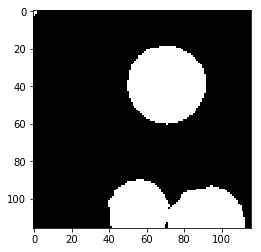

Label  12


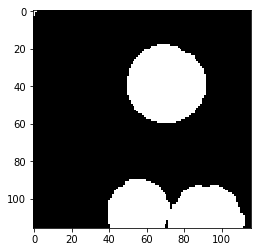

Prediction  13


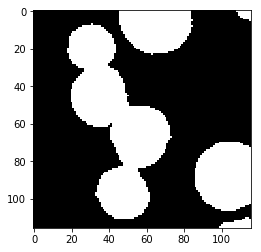

Label  13


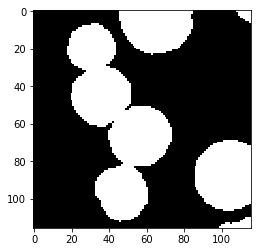

Prediction  14


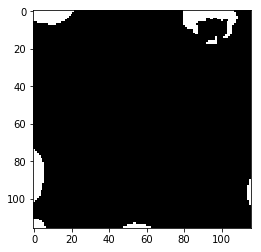

Label  14


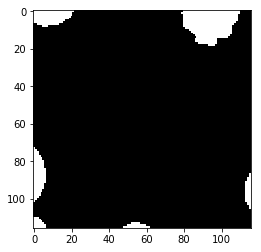

Prediction  15


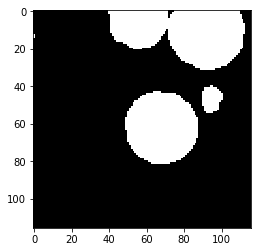

Label  15


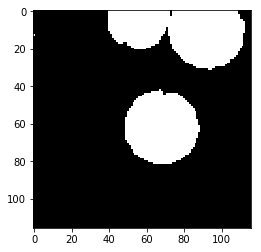

Prediction  16


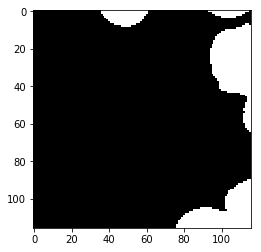

Label  16


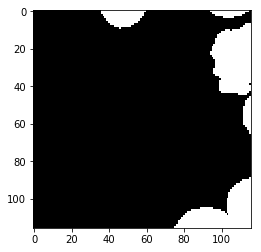

Prediction  17


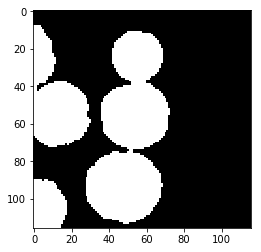

Label  17


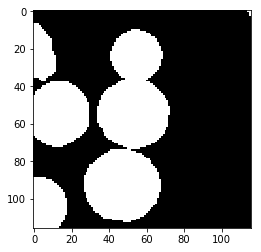

Prediction  18


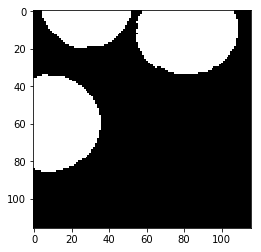

Label  18


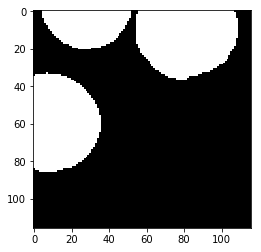

Prediction  19


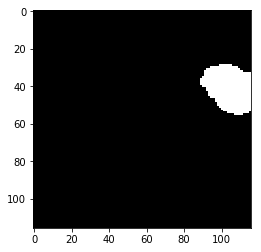

Label  19


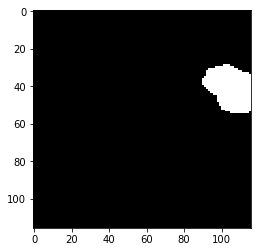

Prediction  20


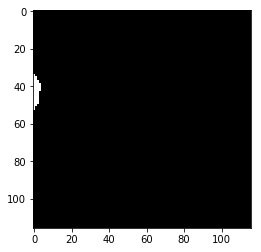

Label  20


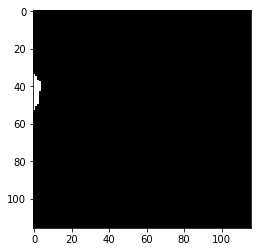

Prediction  21


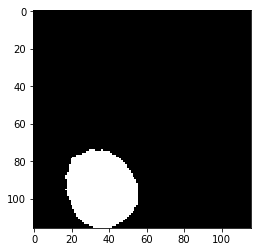

Label  21


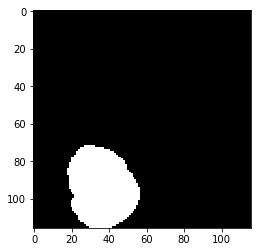

Prediction  22


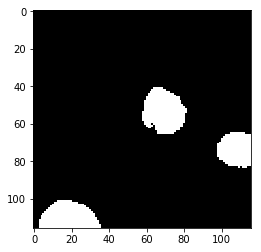

Label  22


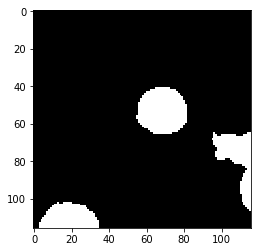

Prediction  23


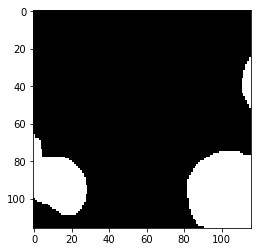

Label  23


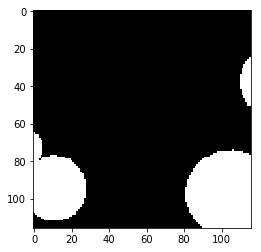

Prediction  24


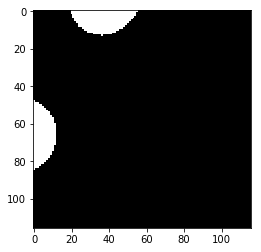

Label  24


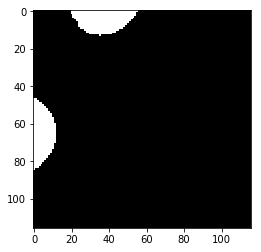

Prediction  25


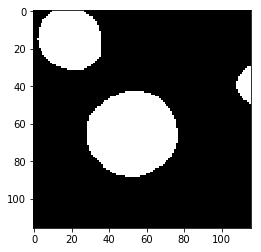

Label  25


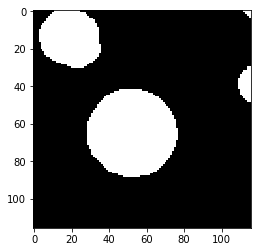

Prediction  26


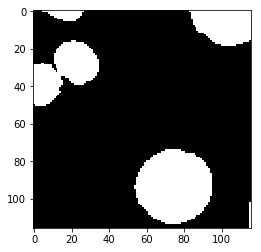

Label  26


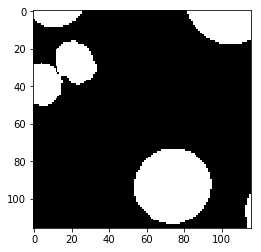

test_accuracy 0.974040707043
Batch: 28500 Train Loss value:0.00581379 Train Accuracy 0.995107124324
Prediction  0


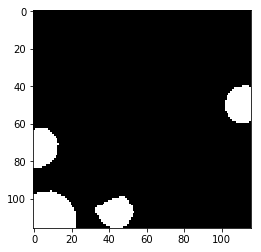

Label  0


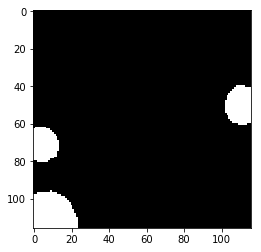

Prediction  1


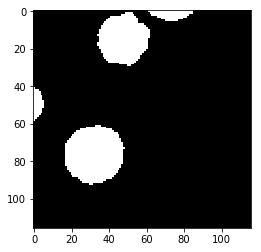

Label  1


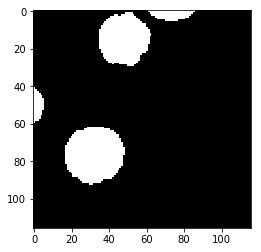

Prediction  2


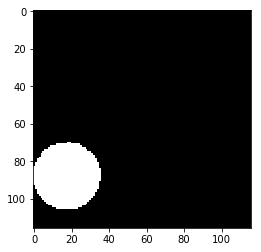

Label  2


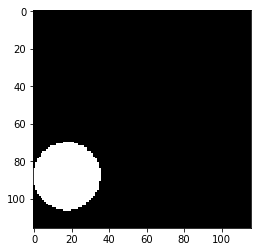

Prediction  3


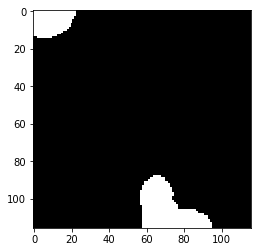

Label  3


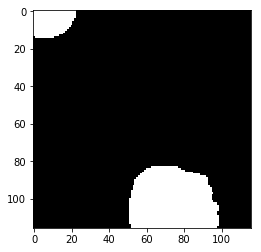

Prediction  4


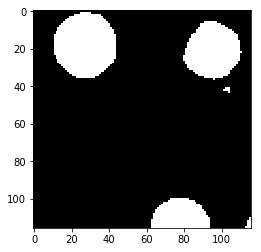

Label  4


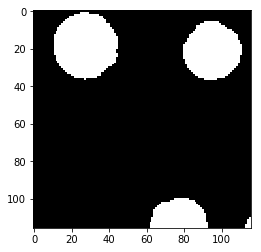

Prediction  5


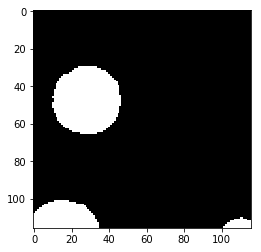

Label  5


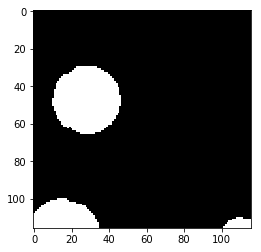

Prediction  6


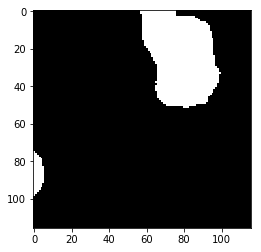

Label  6


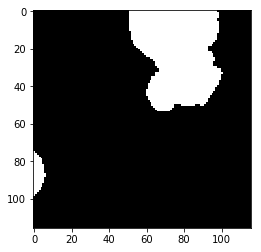

Prediction  7


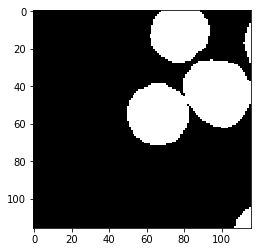

Label  7


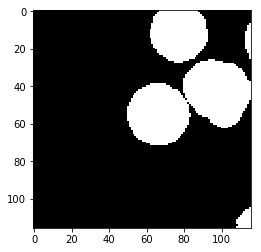

Prediction  8


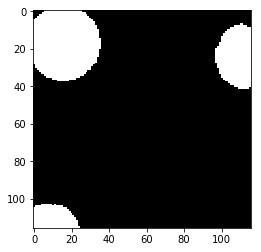

Label  8


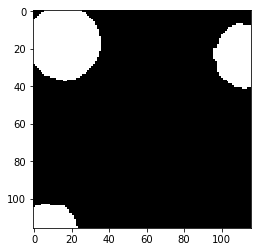

Prediction  9


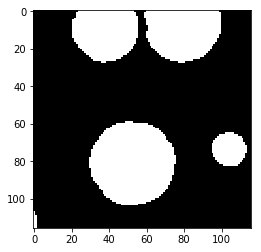

Label  9


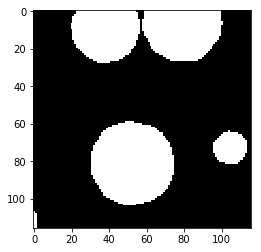

Prediction  10


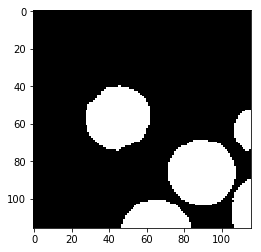

Label  10


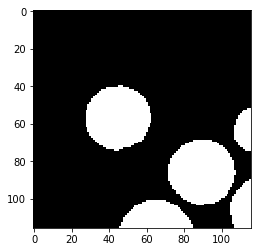

Prediction  11


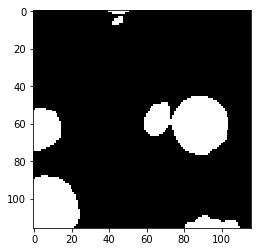

Label  11


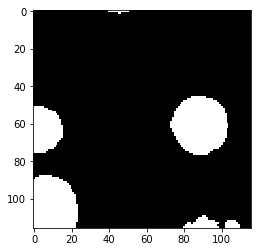

Prediction  12


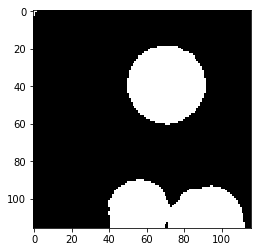

Label  12


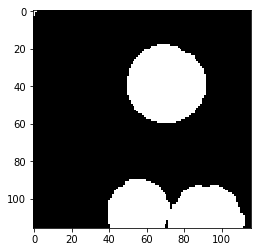

Prediction  13


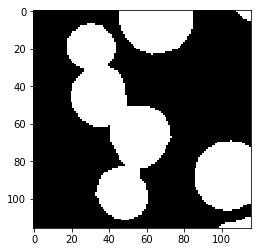

Label  13


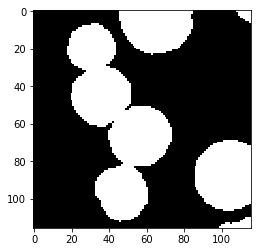

Prediction  14


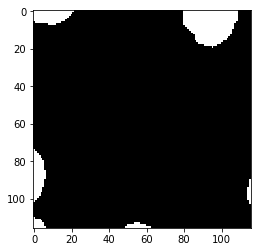

Label  14


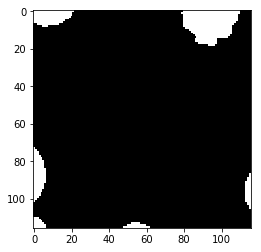

Prediction  15


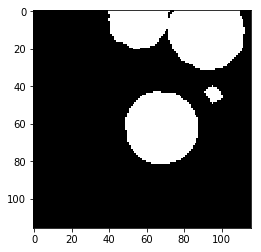

Label  15


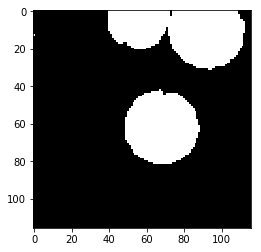

Prediction  16


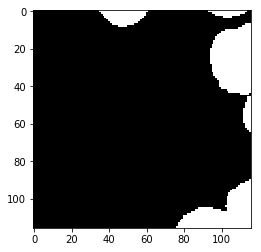

Label  16


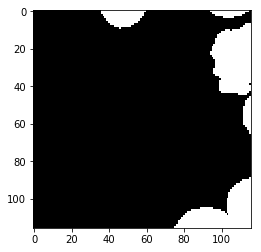

Prediction  17


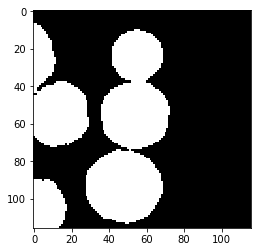

Label  17


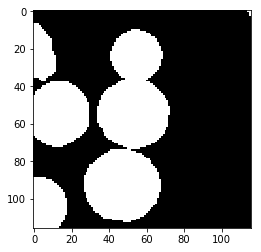

Prediction  18


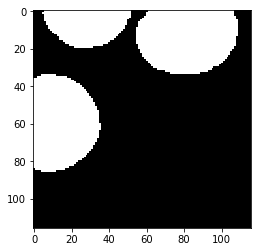

Label  18


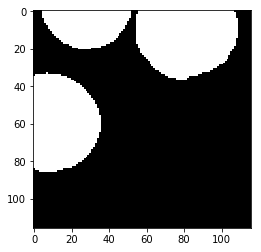

Prediction  19


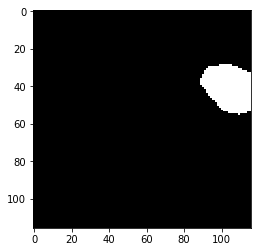

Label  19


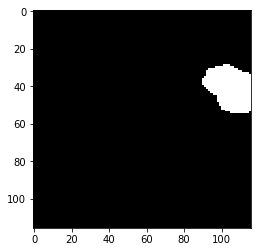

Prediction  20


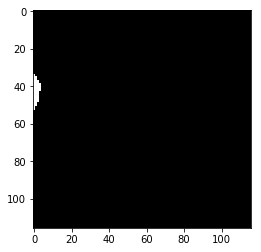

Label  20


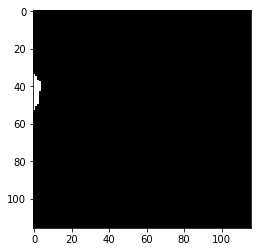

Prediction  21


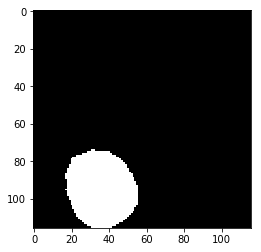

Label  21


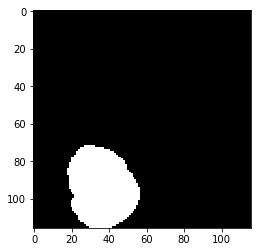

Prediction  22


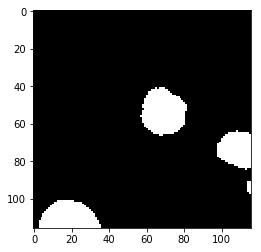

Label  22


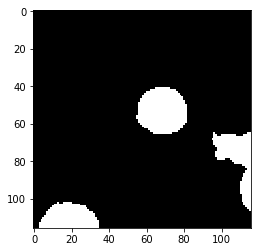

Prediction  23


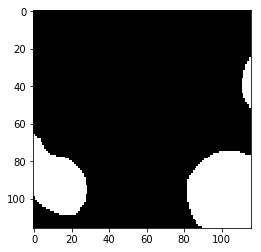

Label  23


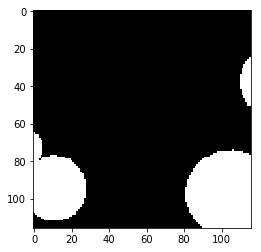

Prediction  24


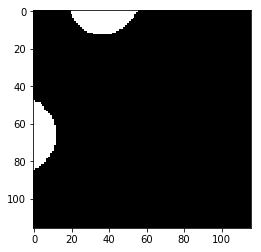

Label  24


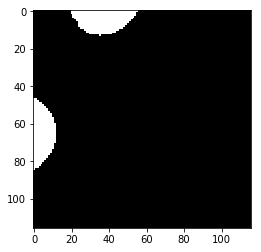

Prediction  25


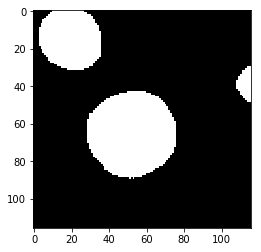

Label  25


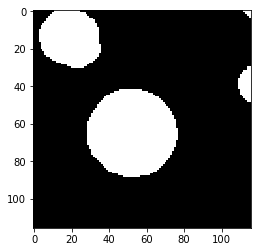

Prediction  26


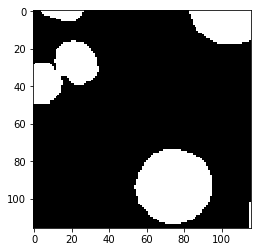

Label  26


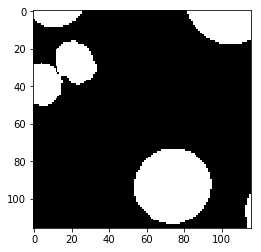

test_accuracy 0.975092811567
Batch: 29000 Train Loss value:0.0158547 Train Accuracy 0.986565291208
Prediction  0


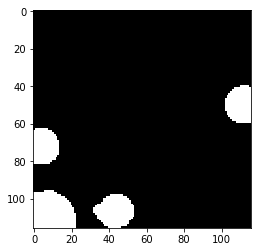

Label  0


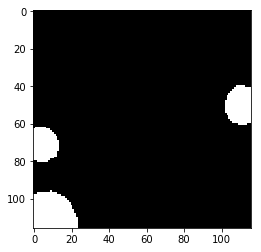

Prediction  1


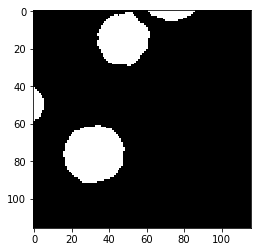

Label  1


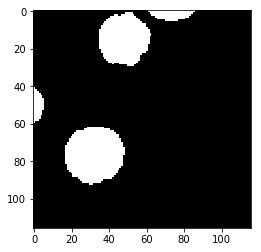

Prediction  2


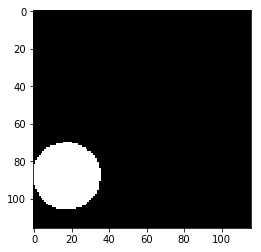

Label  2


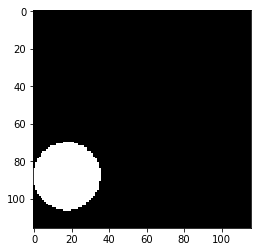

Prediction  3


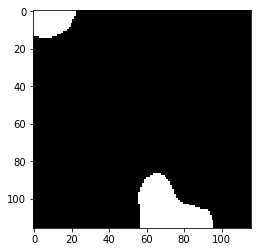

Label  3


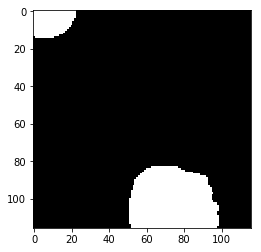

Prediction  4


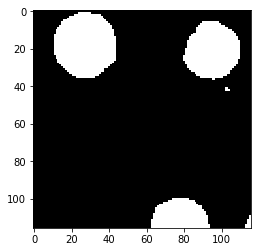

Label  4


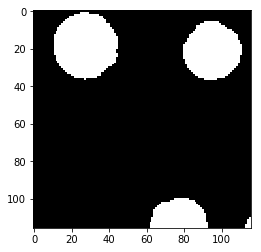

Prediction  5


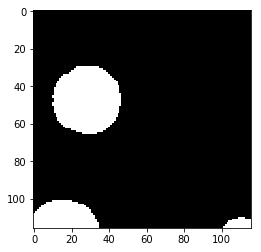

Label  5


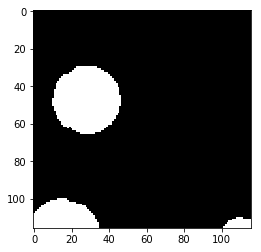

Prediction  6


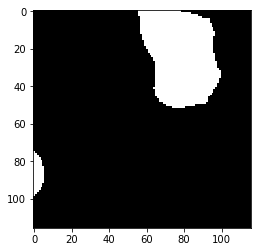

Label  6


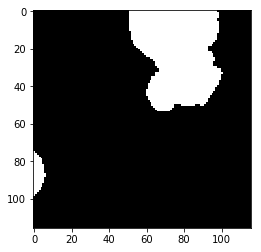

Prediction  7


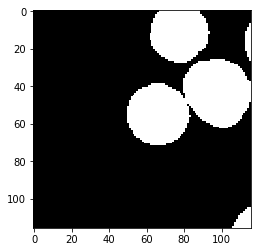

Label  7


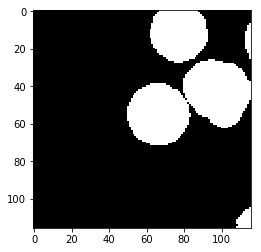

Prediction  8


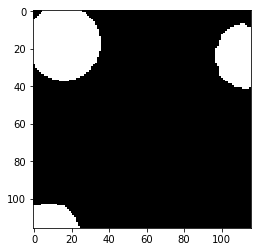

Label  8


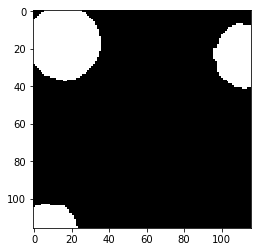

Prediction  9


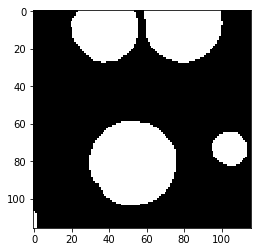

Label  9


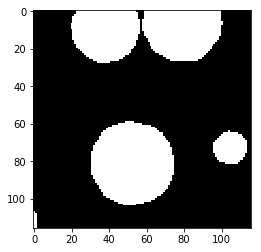

Prediction  10


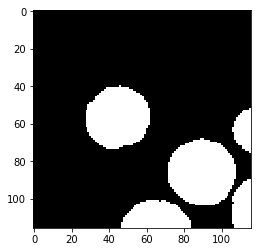

Label  10


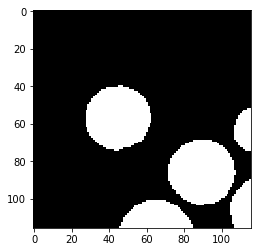

Prediction  11


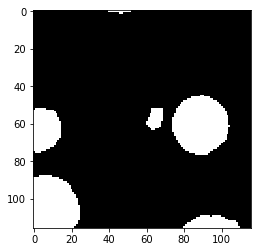

Label  11


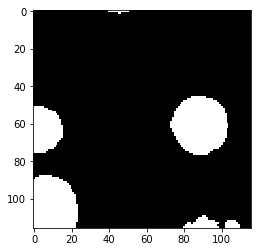

Prediction  12


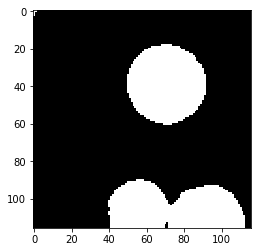

Label  12


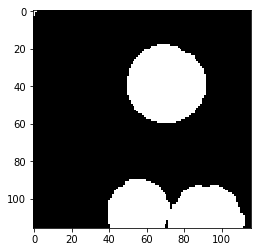

Prediction  13


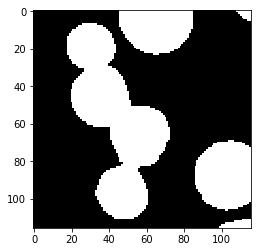

Label  13


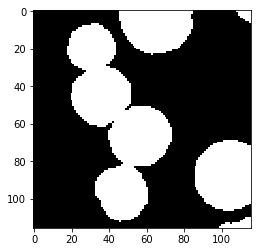

Prediction  14


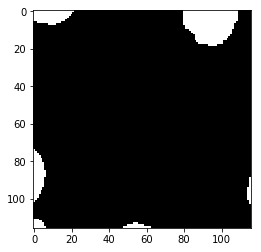

Label  14


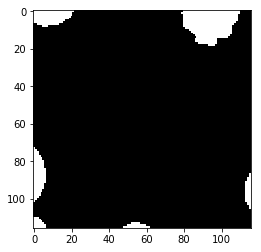

Prediction  15


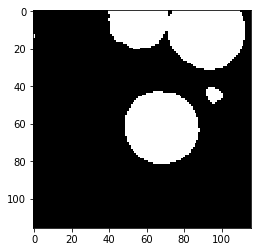

Label  15


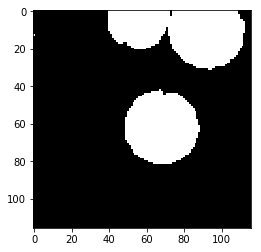

Prediction  16


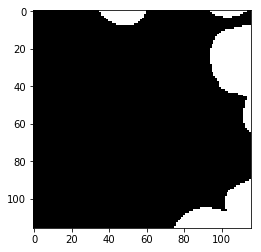

Label  16


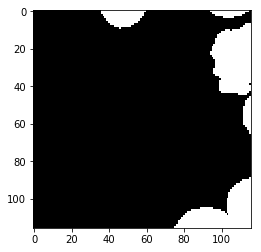

Prediction  17


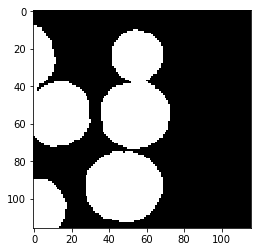

Label  17


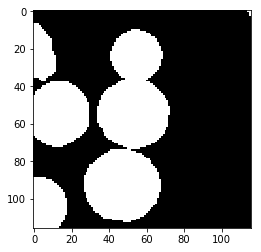

Prediction  18


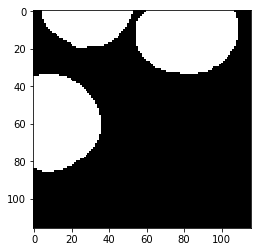

Label  18


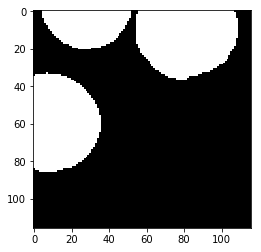

Prediction  19


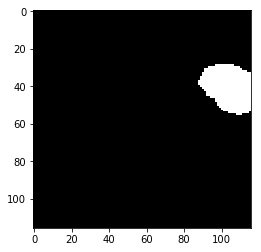

Label  19


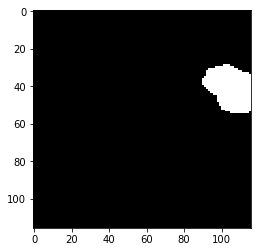

Prediction  20


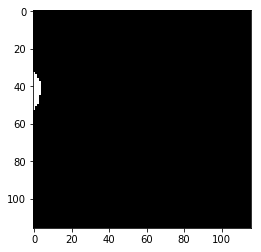

Label  20


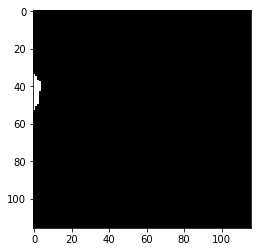

Prediction  21


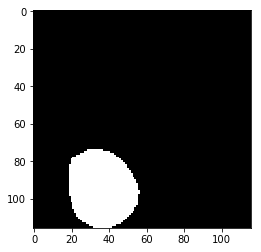

Label  21


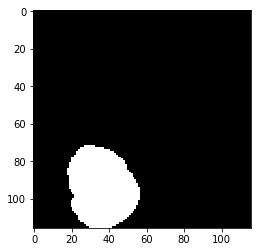

Prediction  22


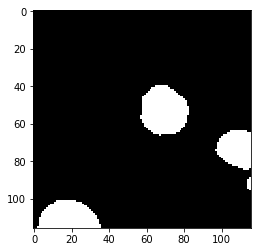

Label  22


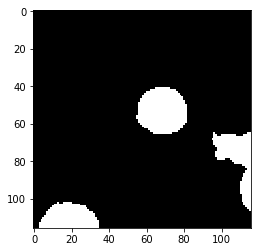

Prediction  23


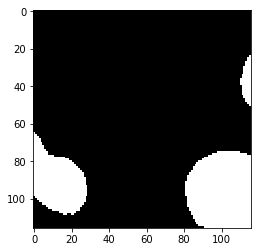

Label  23


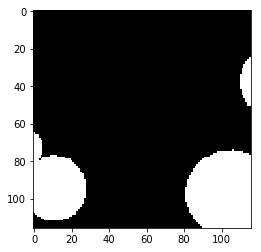

Prediction  24


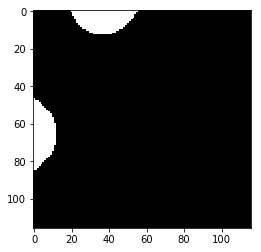

Label  24


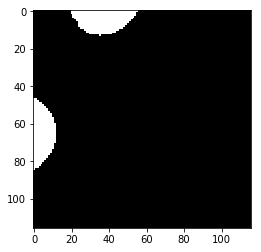

Prediction  25


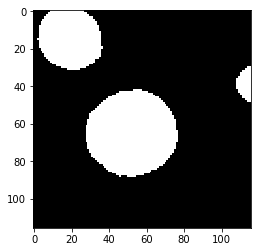

Label  25


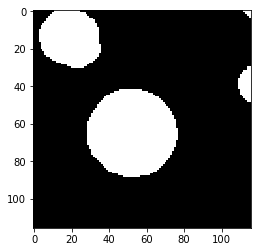

Prediction  26


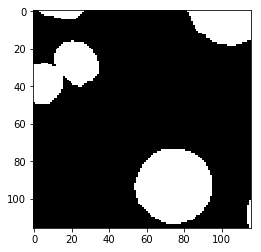

Label  26


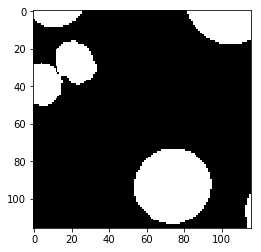

test_accuracy 0.976421149536
Batch: 29500 Train Loss value:0.00532117 Train Accuracy 0.994959229059
Prediction  0


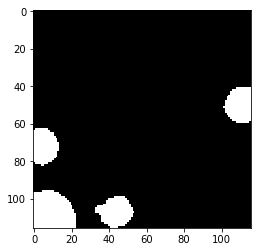

Label  0


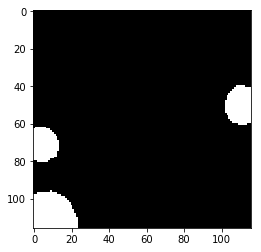

Prediction  1


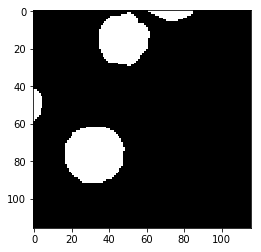

Label  1


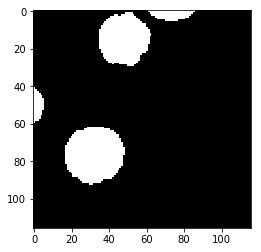

Prediction  2


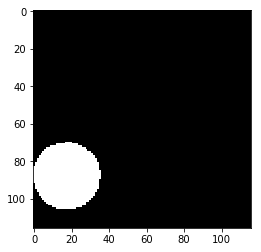

Label  2


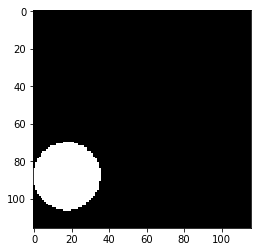

Prediction  3


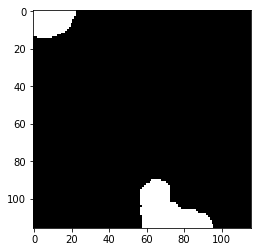

Label  3


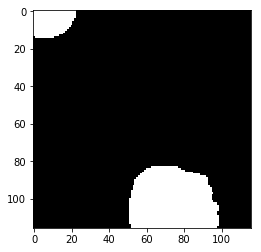

Prediction  4


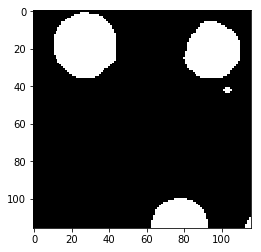

Label  4


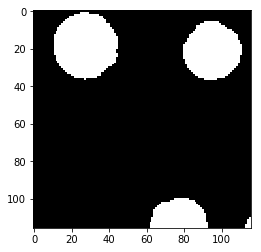

Prediction  5


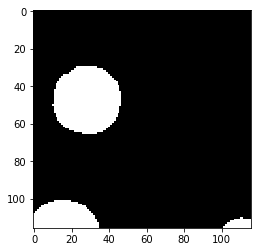

Label  5


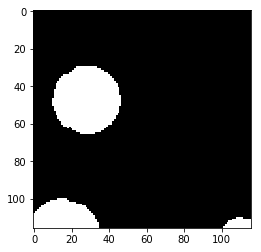

Prediction  6


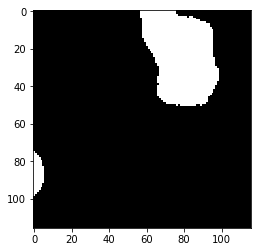

Label  6


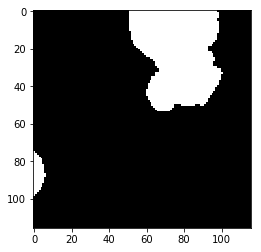

Prediction  7


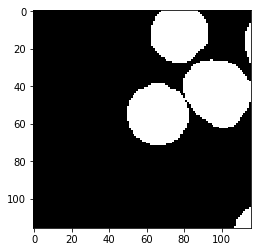

Label  7


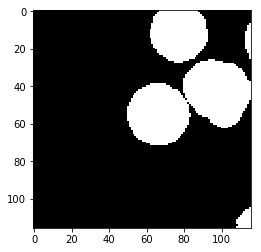

Prediction  8


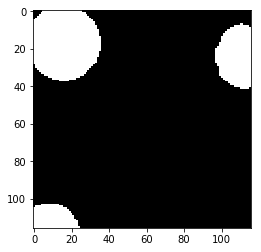

Label  8


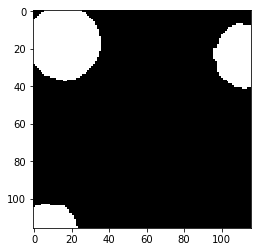

Prediction  9


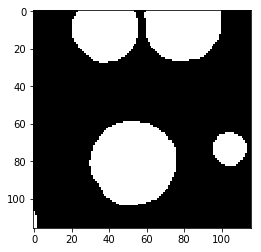

Label  9


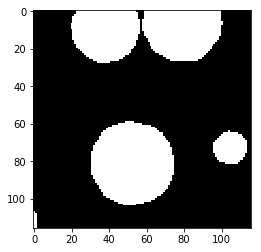

Prediction  10


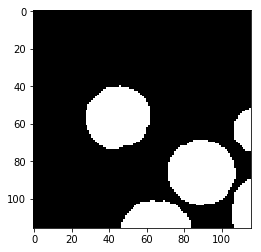

Label  10


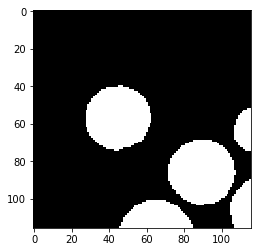

Prediction  11


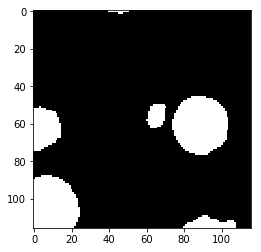

Label  11


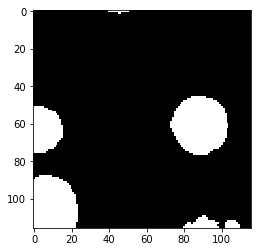

Prediction  12


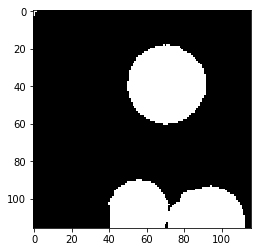

Label  12


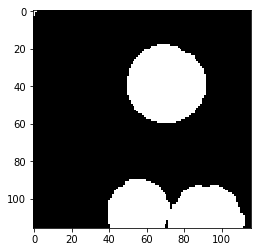

Prediction  13


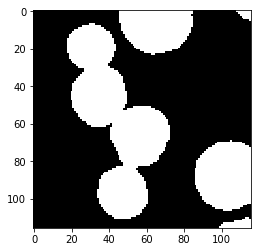

Label  13


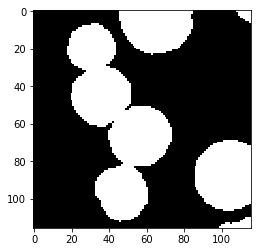

Prediction  14


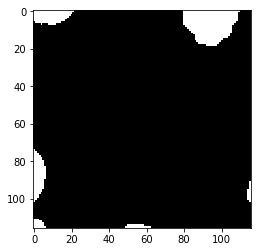

Label  14


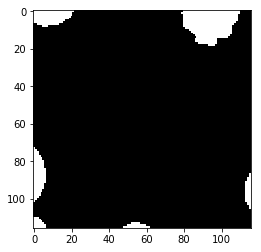

Prediction  15


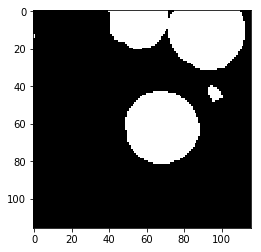

Label  15


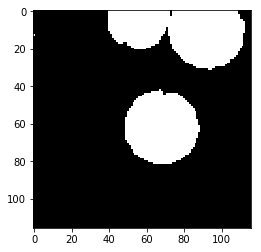

Prediction  16


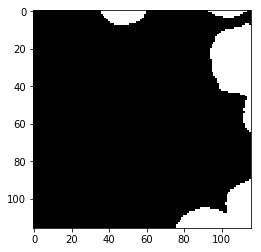

Label  16


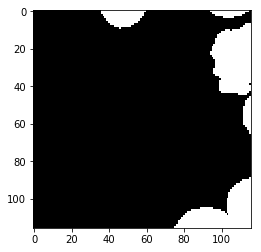

Prediction  17


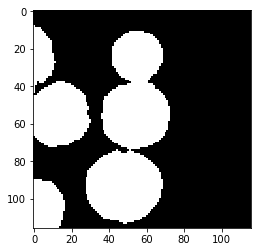

Label  17


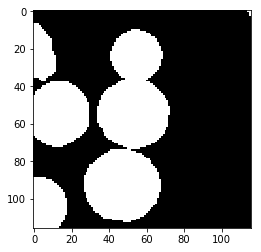

Prediction  18


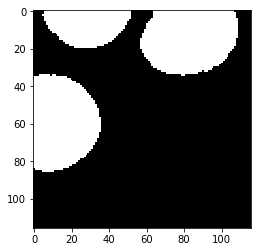

Label  18


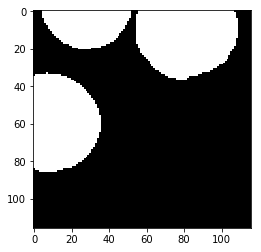

Prediction  19


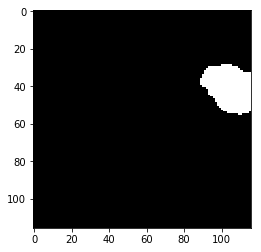

Label  19


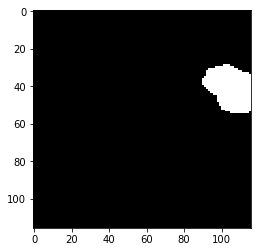

Prediction  20


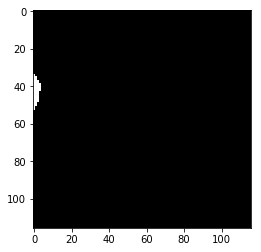

Label  20


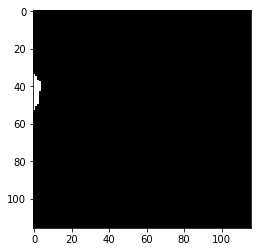

Prediction  21


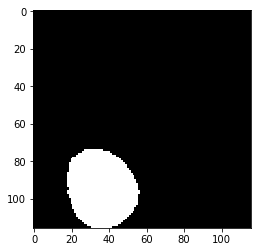

Label  21


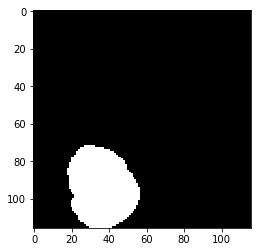

Prediction  22


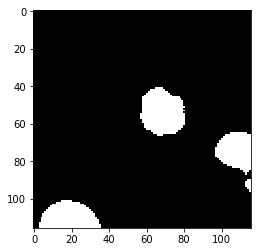

Label  22


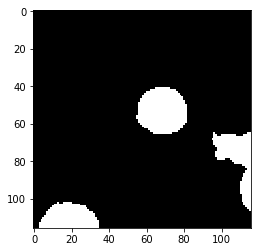

Prediction  23


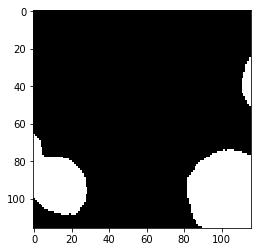

Label  23


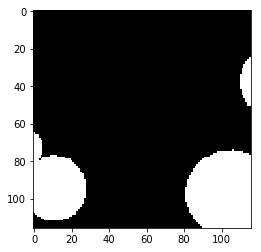

Prediction  24


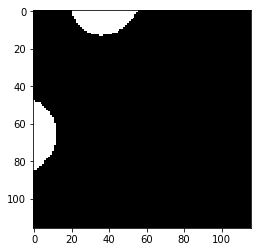

Label  24


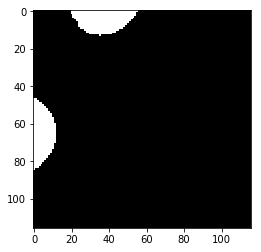

Prediction  25


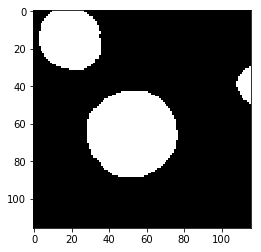

Label  25


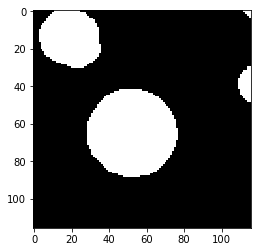

Prediction  26


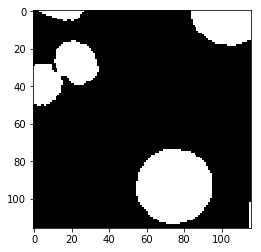

Label  26


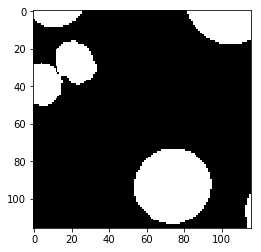

test_accuracy 0.975350908709
Batch: 30000 Train Loss value:0.0108749 Train Accuracy 0.990679784008
Prediction  0


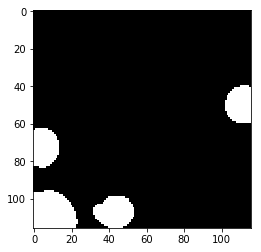

Label  0


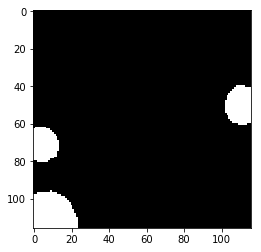

Prediction  1


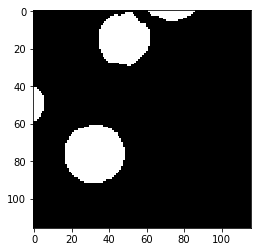

Label  1


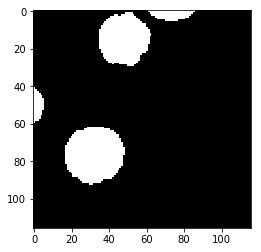

Prediction  2


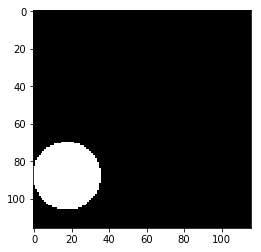

Label  2


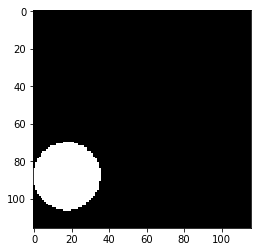

Prediction  3


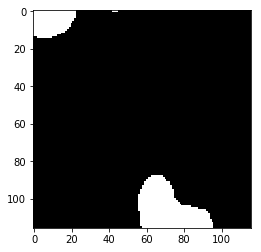

Label  3


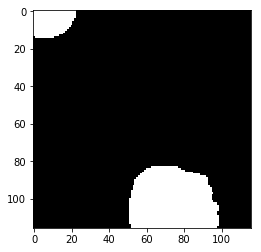

Prediction  4


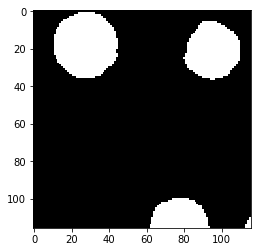

Label  4


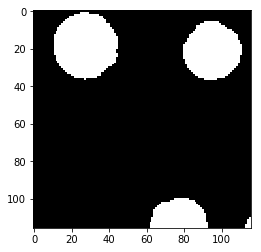

Prediction  5


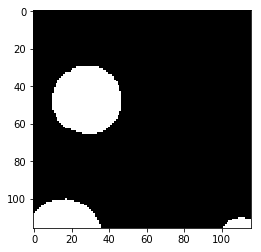

Label  5


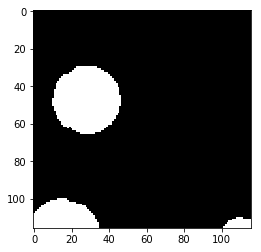

Prediction  6


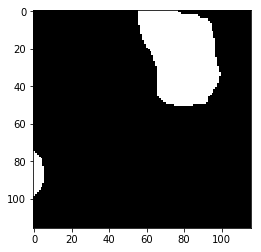

Label  6


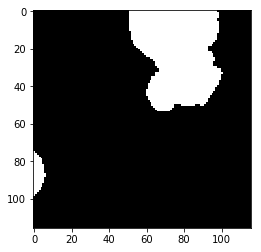

Prediction  7


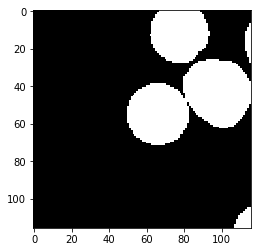

Label  7


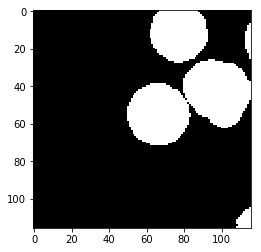

Prediction  8


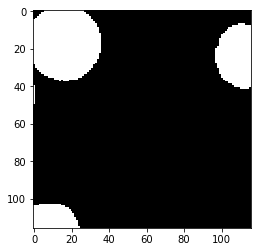

Label  8


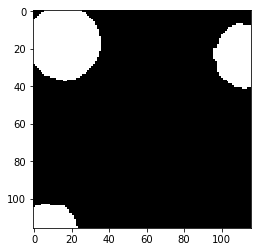

Prediction  9


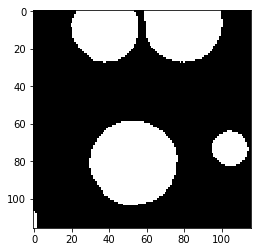

Label  9


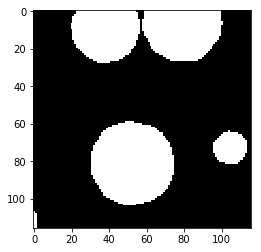

Prediction  10


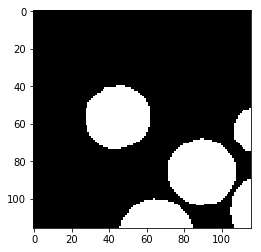

Label  10


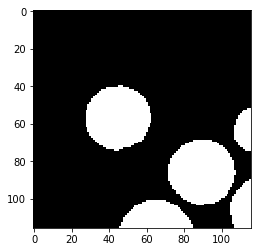

Prediction  11


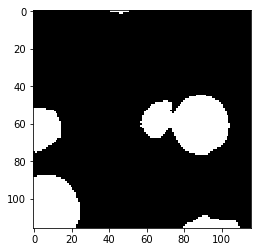

Label  11


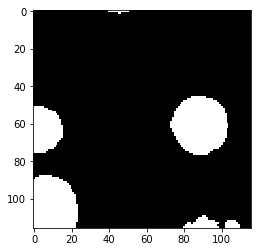

Prediction  12


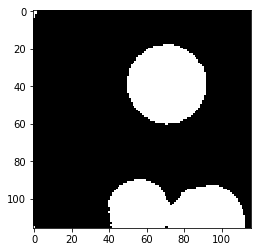

Label  12


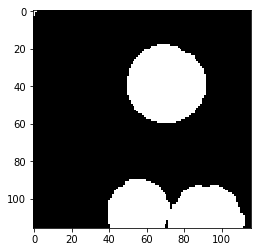

Prediction  13


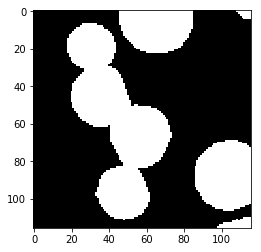

Label  13


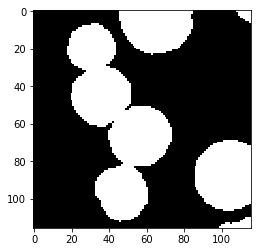

Prediction  14


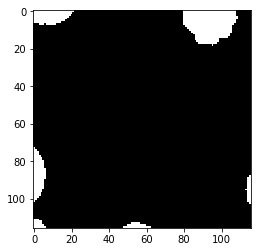

Label  14


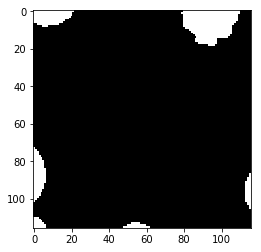

Prediction  15


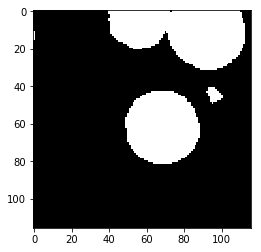

Label  15


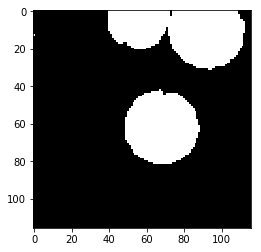

Prediction  16


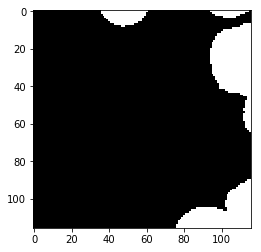

Label  16


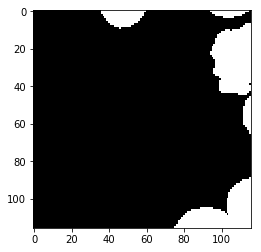

Prediction  17


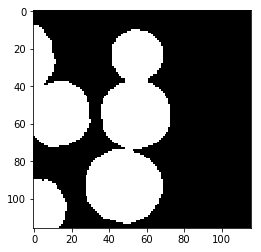

Label  17


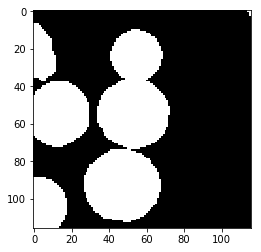

Prediction  18


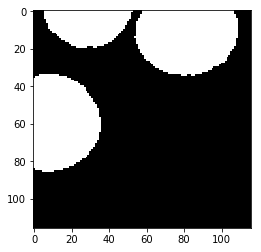

Label  18


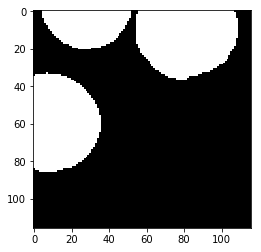

Prediction  19


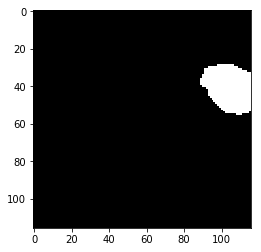

Label  19


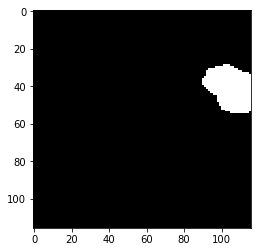

Prediction  20


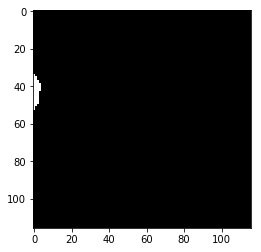

Label  20


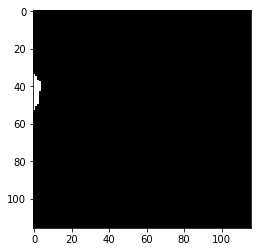

Prediction  21


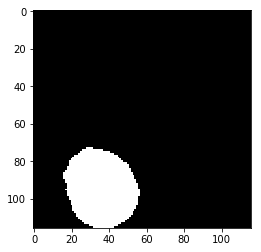

Label  21


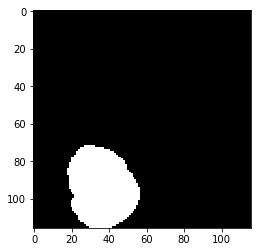

Prediction  22


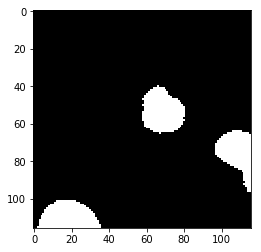

Label  22


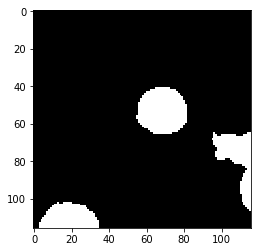

Prediction  23


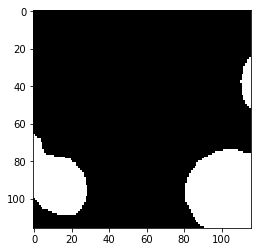

Label  23


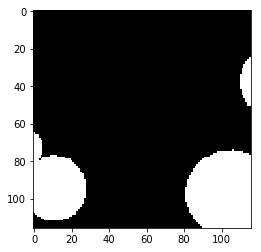

Prediction  24


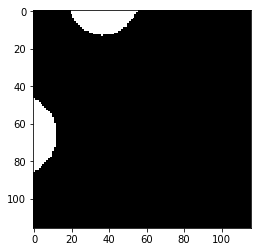

Label  24


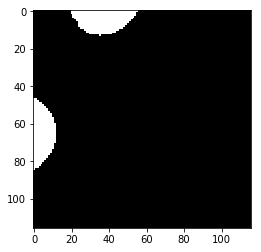

Prediction  25


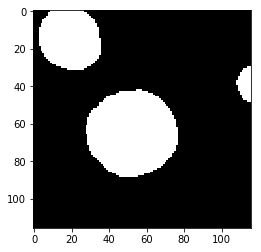

Label  25


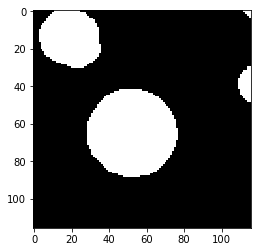

Prediction  26


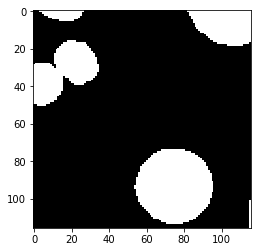

Label  26


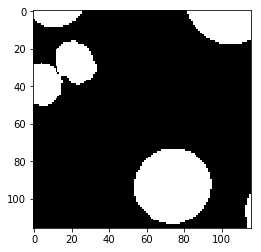

test_accuracy 0.975000879066
Batch: 30500 Train Loss value:0.0113752 Train Accuracy 0.989061345159
Prediction  0


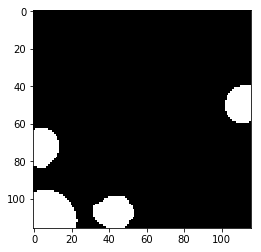

Label  0


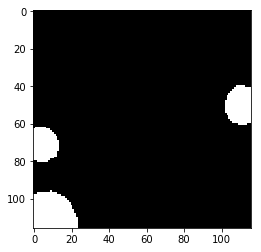

Prediction  1


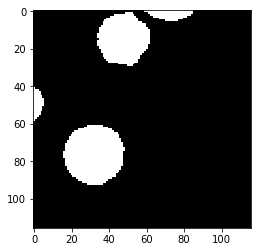

Label  1


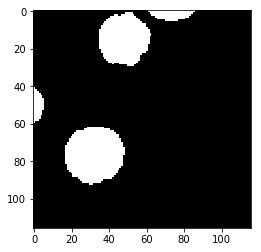

Prediction  2


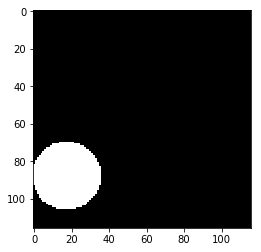

Label  2


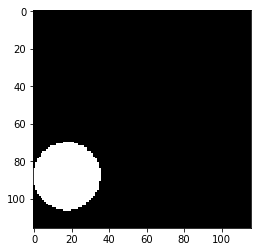

Prediction  3


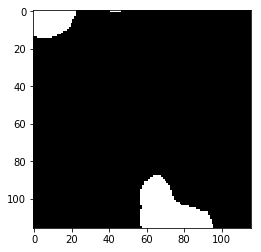

Label  3


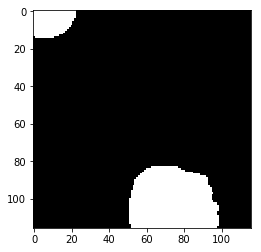

Prediction  4


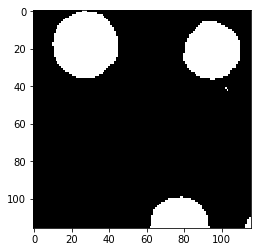

Label  4


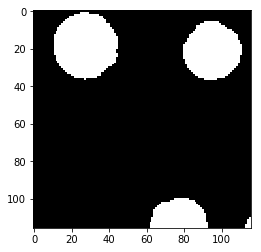

Prediction  5


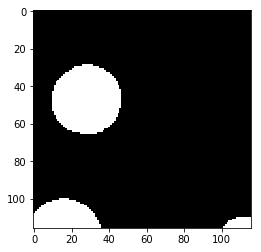

Label  5


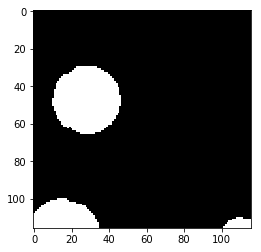

Prediction  6


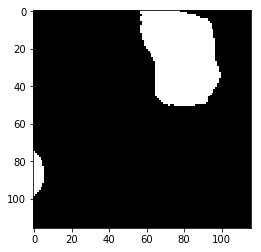

Label  6


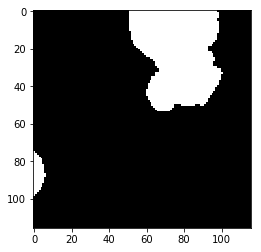

Prediction  7


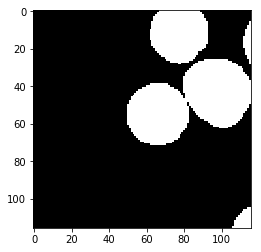

Label  7


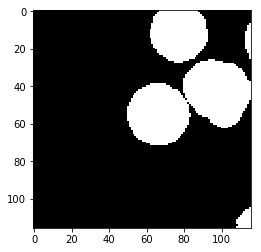

Prediction  8


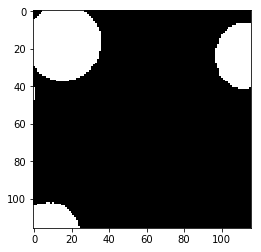

Label  8


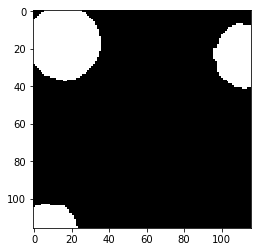

Prediction  9


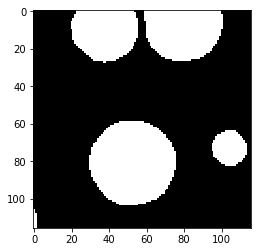

Label  9


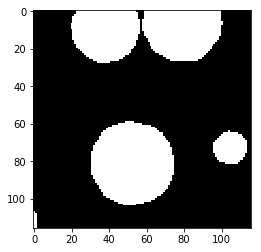

Prediction  10


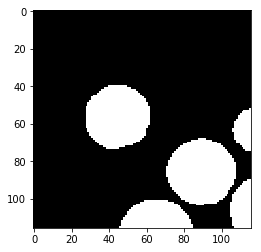

Label  10


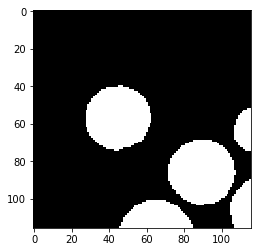

Prediction  11


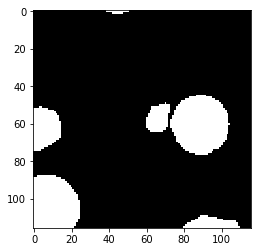

Label  11


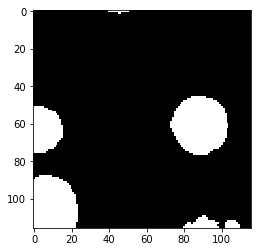

Prediction  12


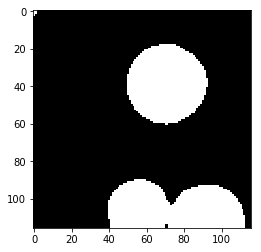

Label  12


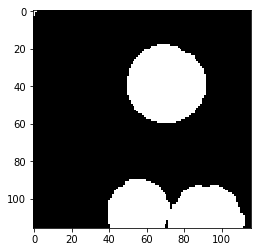

Prediction  13


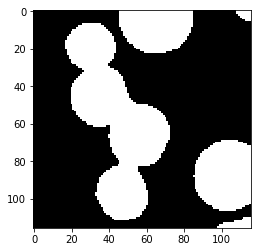

Label  13


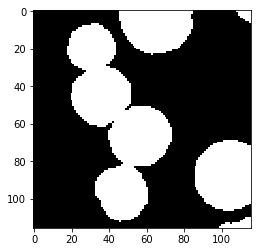

Prediction  14


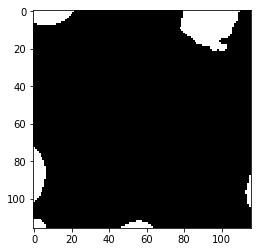

Label  14


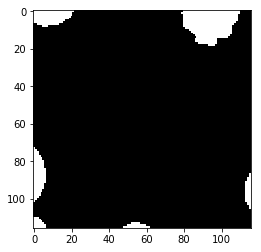

Prediction  15


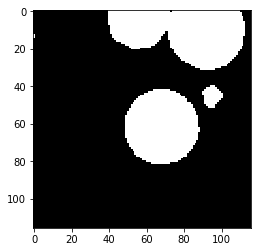

Label  15


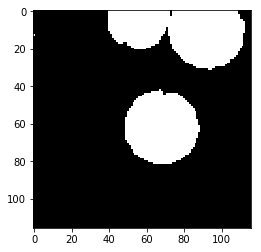

Prediction  16


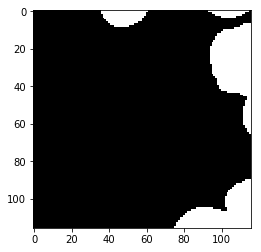

Label  16


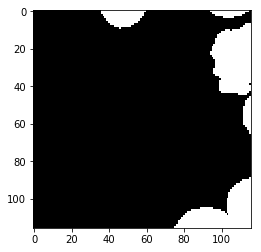

Prediction  17


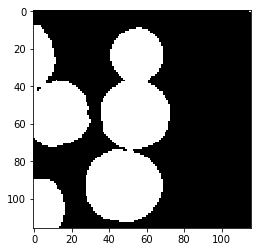

Label  17


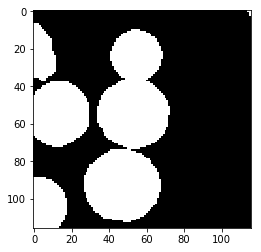

Prediction  18


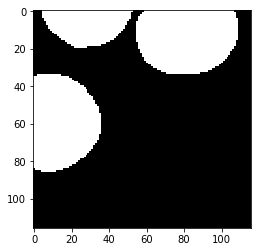

Label  18


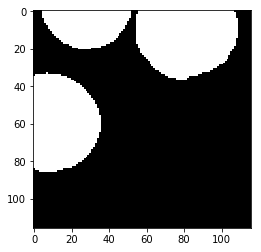

Prediction  19


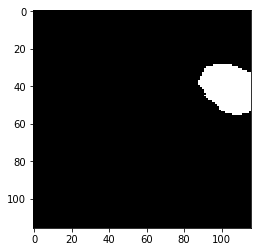

Label  19


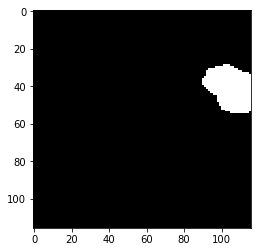

Prediction  20


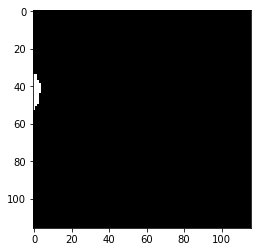

Label  20


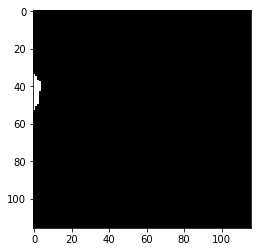

Prediction  21


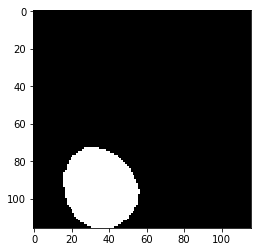

Label  21


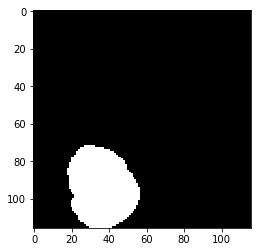

Prediction  22


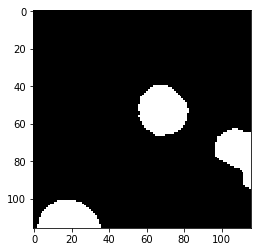

Label  22


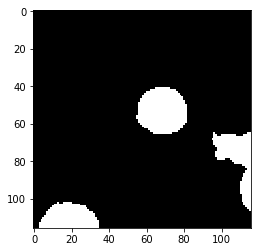

Prediction  23


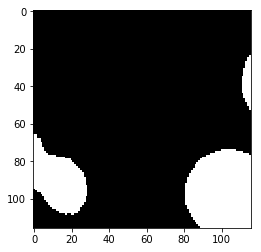

Label  23


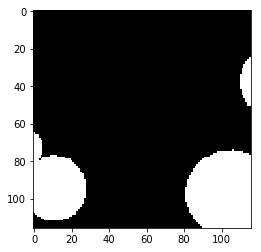

Prediction  24


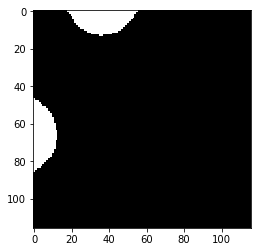

Label  24


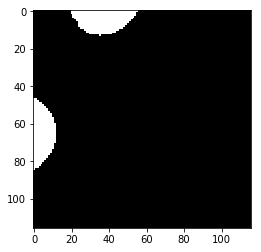

Prediction  25


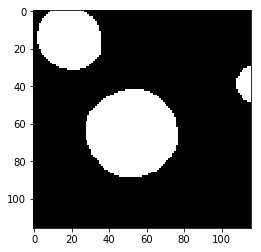

Label  25


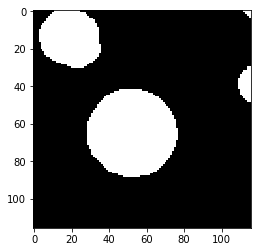

Prediction  26


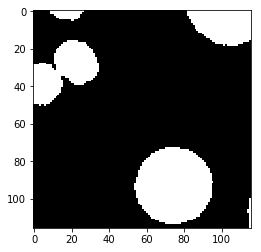

Label  26


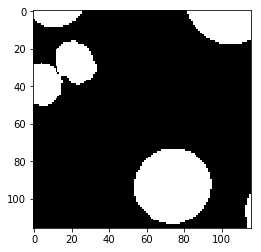

test_accuracy 0.973793564802
Batch: 31000 Train Loss value:0.0136099 Train Accuracy 0.988179669031
Prediction  0


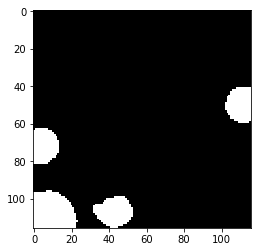

Label  0


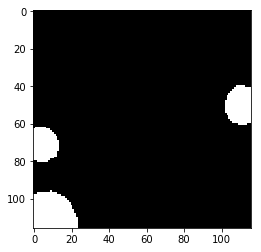

Prediction  1


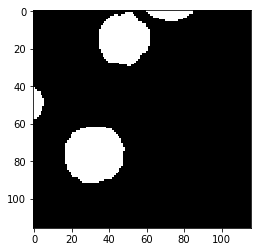

Label  1


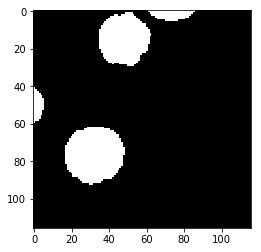

Prediction  2


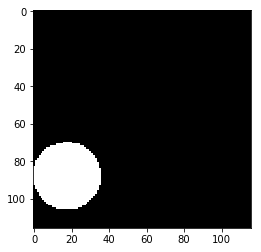

Label  2


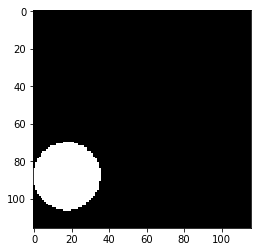

Prediction  3


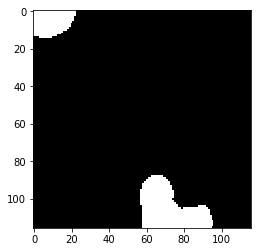

Label  3


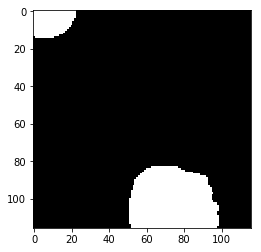

Prediction  4


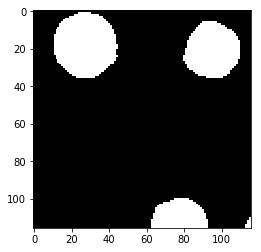

Label  4


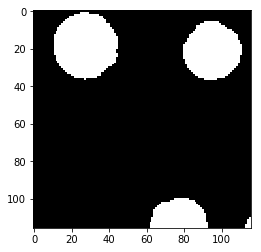

Prediction  5


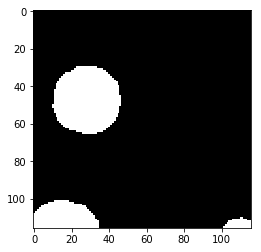

Label  5


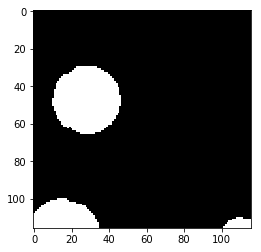

Prediction  6


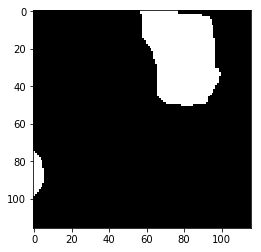

Label  6


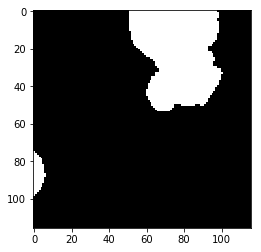

Prediction  7


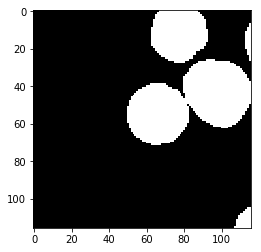

Label  7


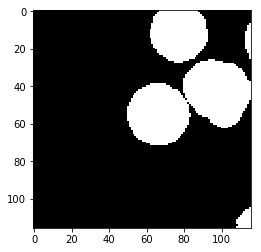

Prediction  8


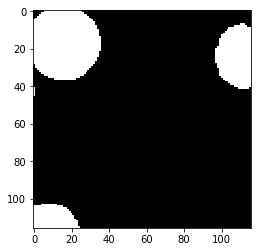

Label  8


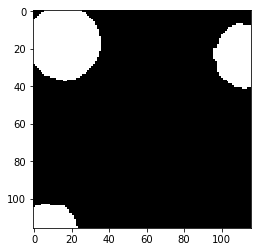

Prediction  9


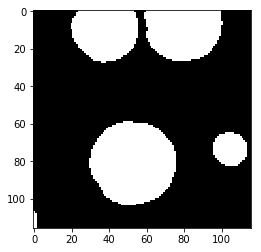

Label  9


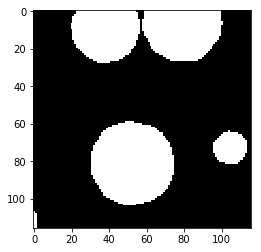

Prediction  10


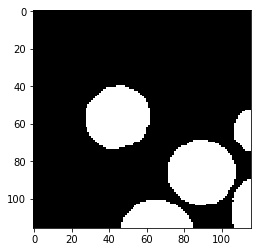

Label  10


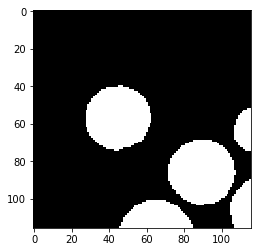

Prediction  11


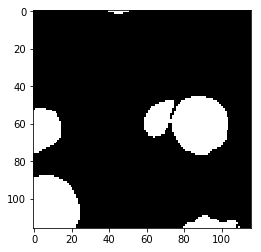

Label  11


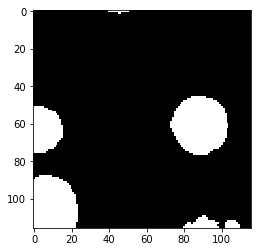

Prediction  12


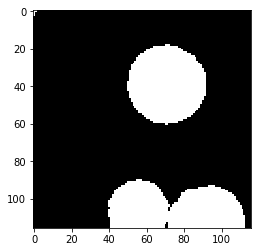

Label  12


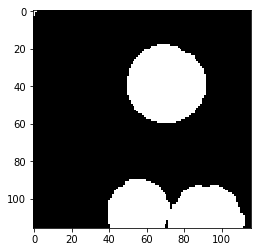

Prediction  13


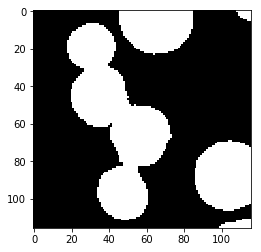

Label  13


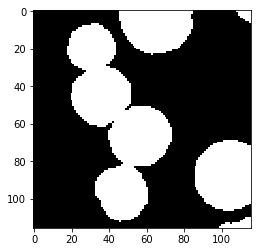

Prediction  14


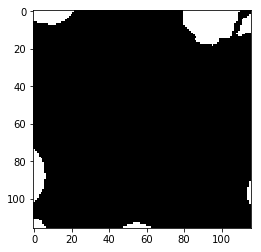

Label  14


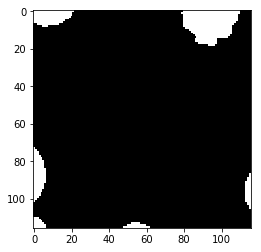

Prediction  15


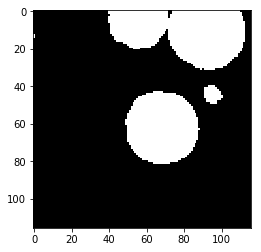

Label  15


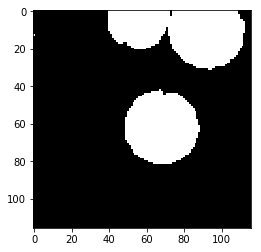

Prediction  16


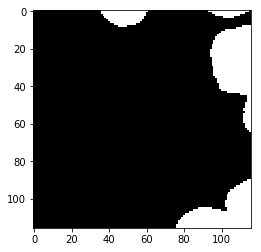

Label  16


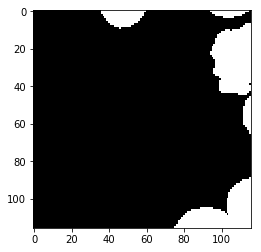

Prediction  17


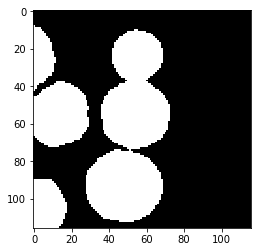

Label  17


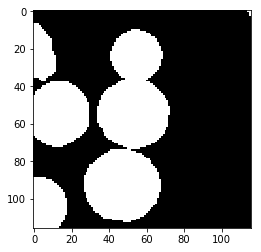

Prediction  18


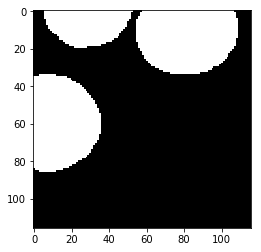

Label  18


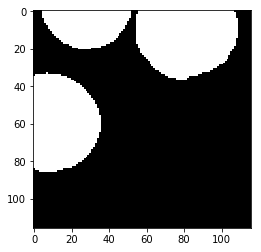

Prediction  19


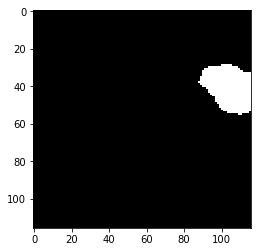

Label  19


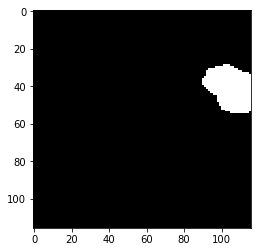

Prediction  20


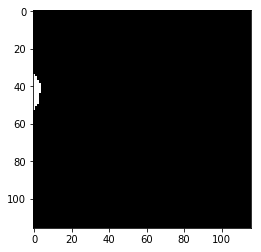

Label  20


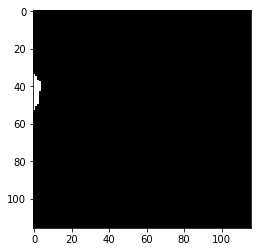

Prediction  21


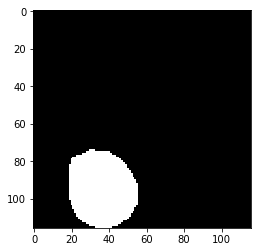

Label  21


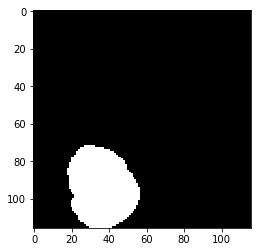

Prediction  22


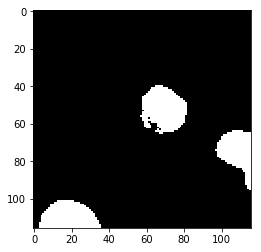

Label  22


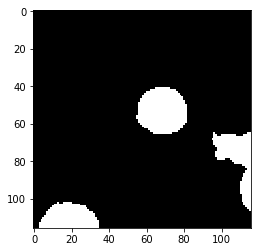

Prediction  23


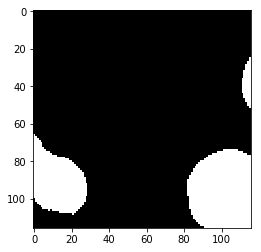

Label  23


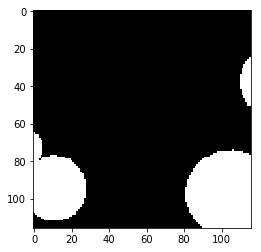

Prediction  24


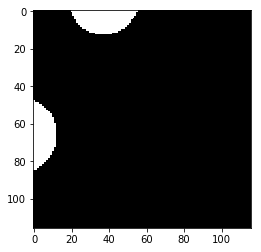

Label  24


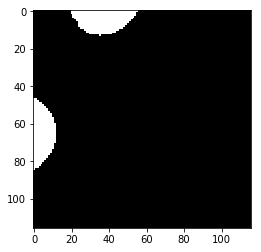

Prediction  25


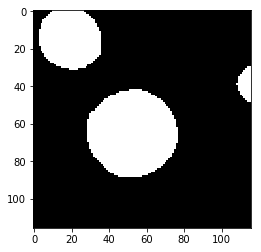

Label  25


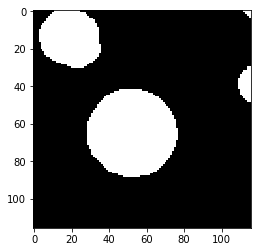

Prediction  26


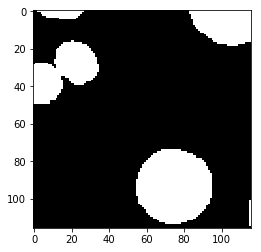

Label  26


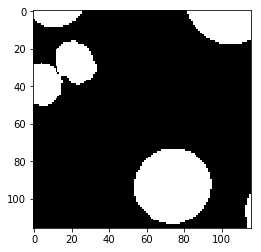

test_accuracy 0.97576893288
Batch: 31500 Train Loss value:0.0115287 Train Accuracy 0.990679784008
Prediction  0


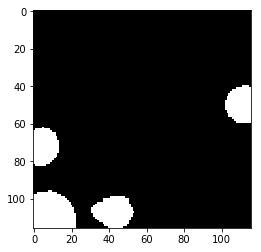

Label  0


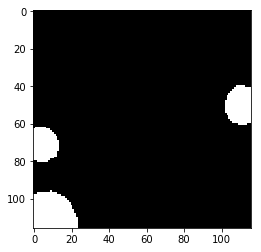

Prediction  1


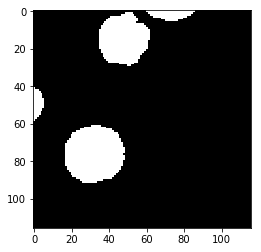

Label  1


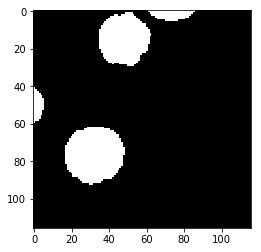

Prediction  2


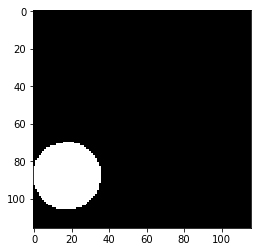

Label  2


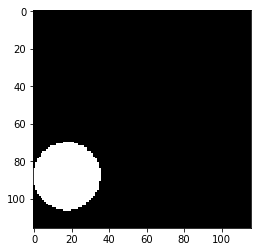

Prediction  3


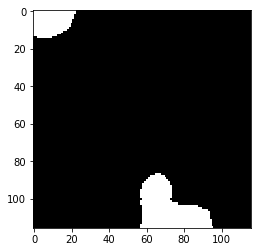

Label  3


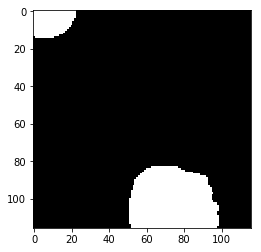

Prediction  4


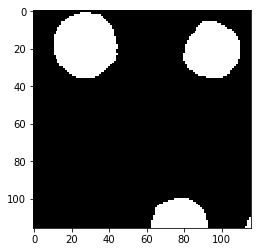

Label  4


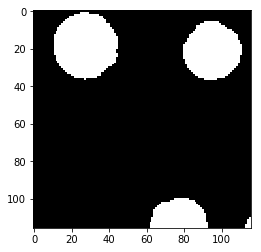

Prediction  5


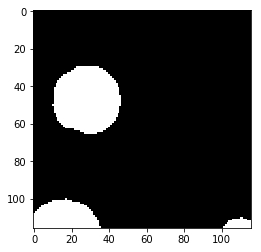

Label  5


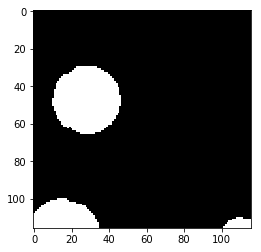

Prediction  6


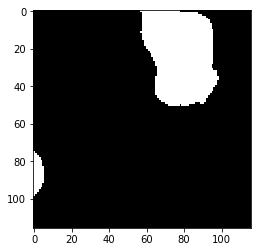

Label  6


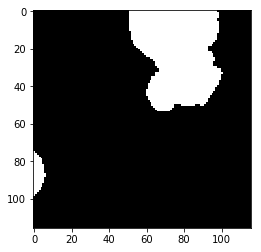

Prediction  7


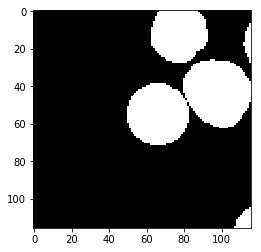

Label  7


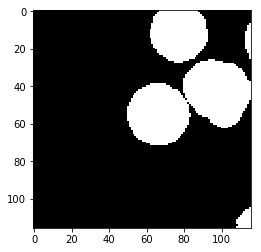

Prediction  8


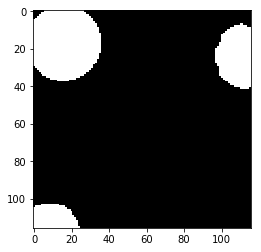

Label  8


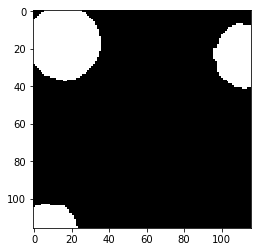

Prediction  9


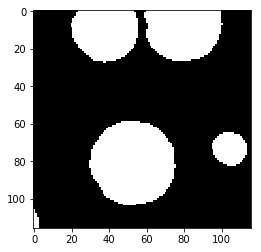

Label  9


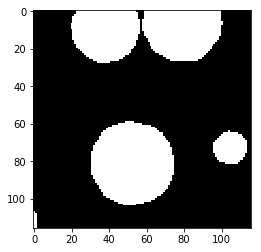

Prediction  10


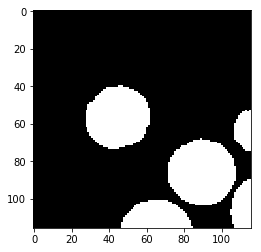

Label  10


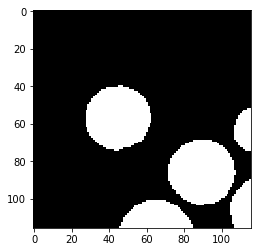

Prediction  11


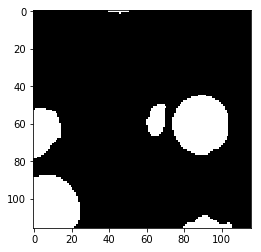

Label  11


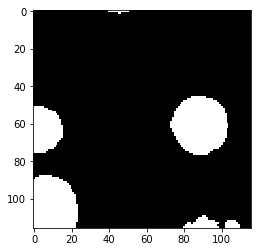

Prediction  12


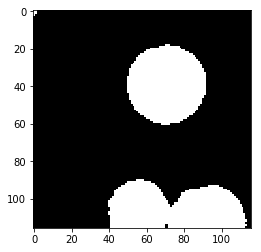

Label  12


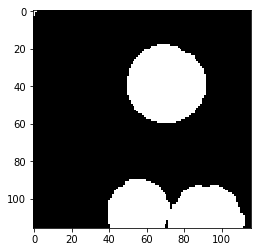

Prediction  13


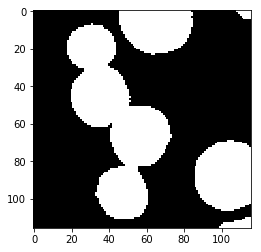

Label  13


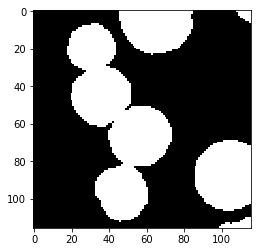

Prediction  14


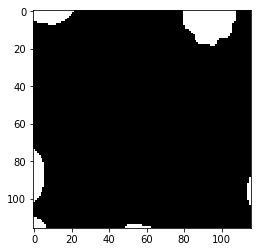

Label  14


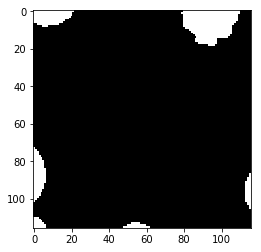

Prediction  15


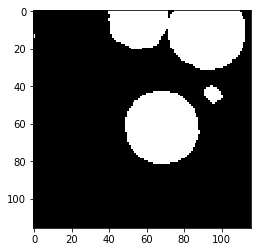

Label  15


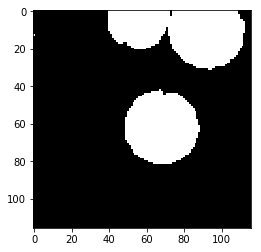

Prediction  16


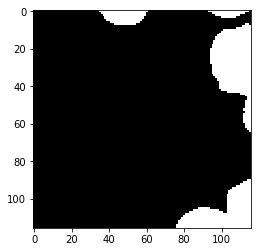

Label  16


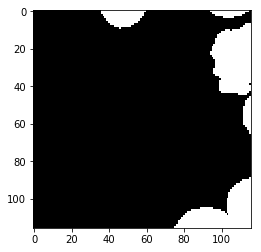

Prediction  17


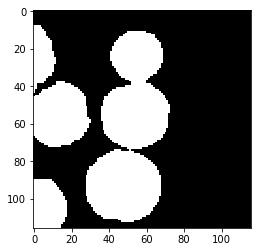

Label  17


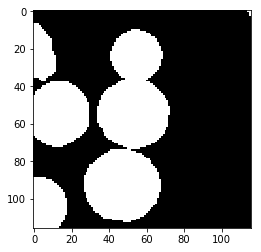

Prediction  18


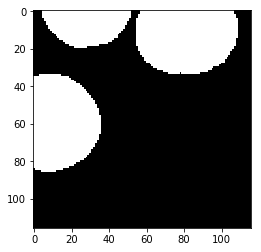

Label  18


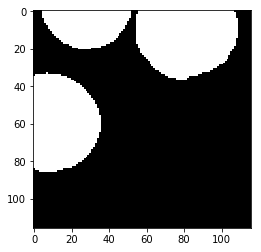

Prediction  19


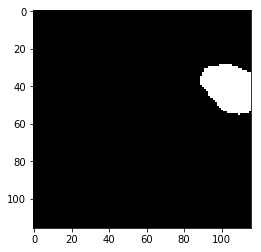

Label  19


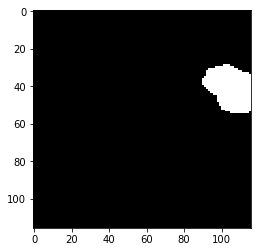

Prediction  20


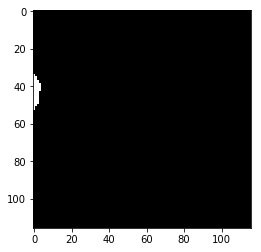

Label  20


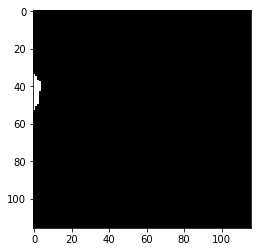

Prediction  21


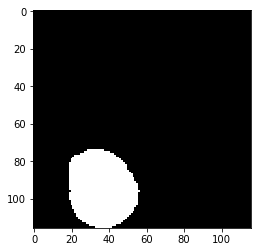

Label  21


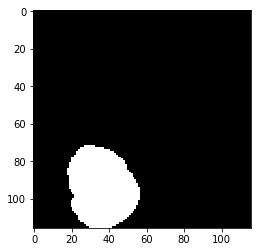

Prediction  22


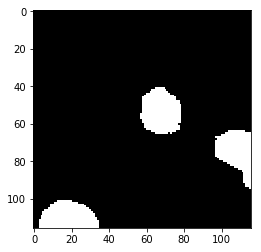

Label  22


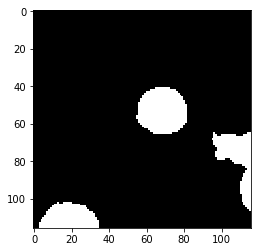

Prediction  23


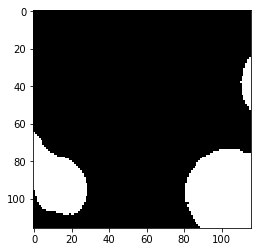

Label  23


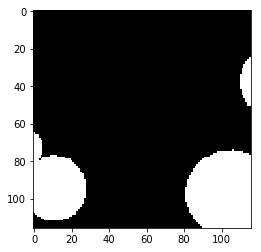

Prediction  24


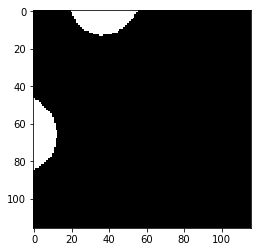

Label  24


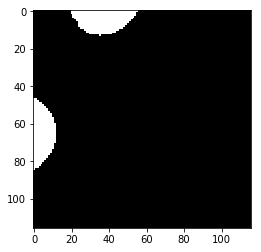

Prediction  25


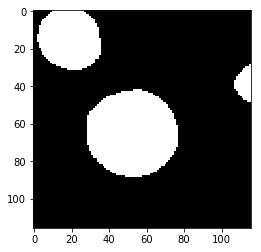

Label  25


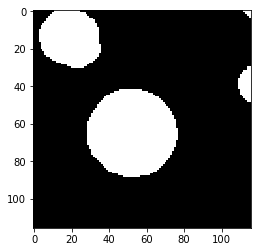

Prediction  26


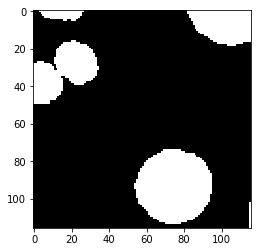

Label  26


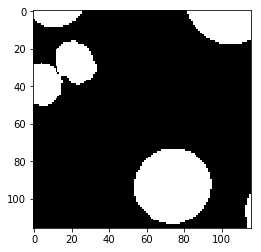

test_accuracy 0.976050692082
Batch: 32000 Train Loss value:0.0146512 Train Accuracy 0.987298774184
Prediction  0


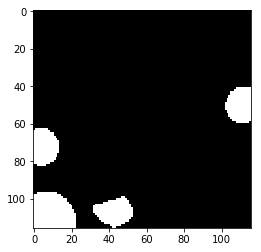

Label  0


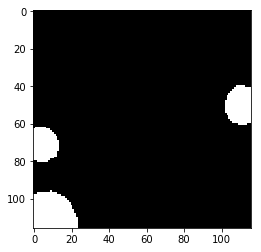

Prediction  1


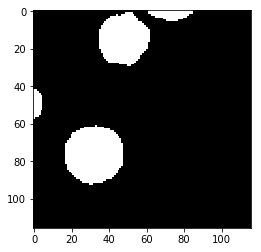

Label  1


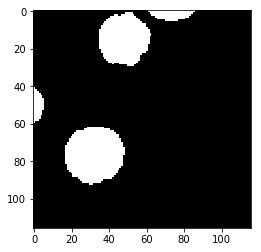

Prediction  2


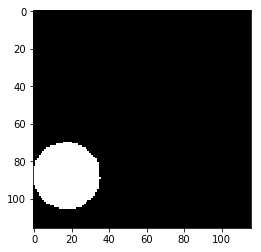

Label  2


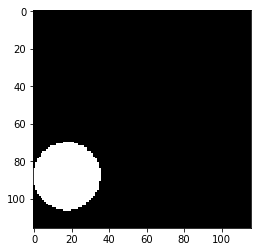

Prediction  3


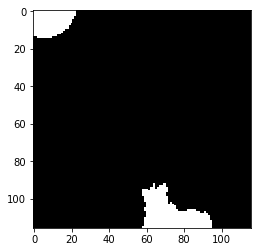

Label  3


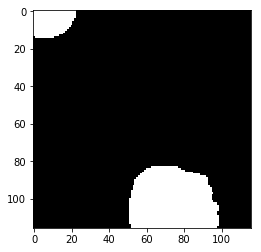

Prediction  4


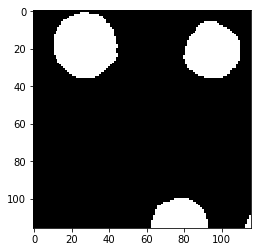

Label  4


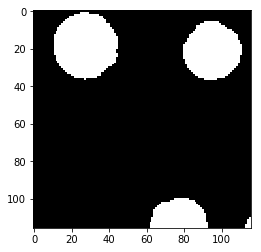

Prediction  5


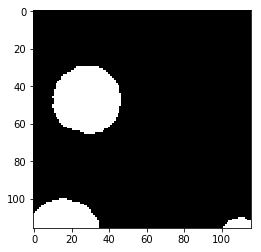

Label  5


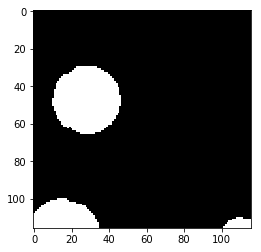

Prediction  6


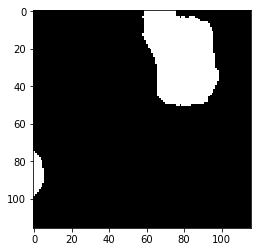

Label  6


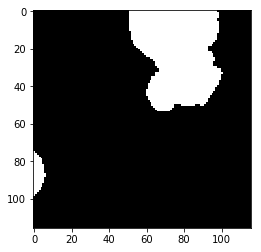

Prediction  7


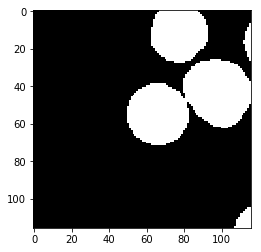

Label  7


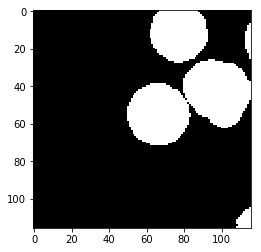

Prediction  8


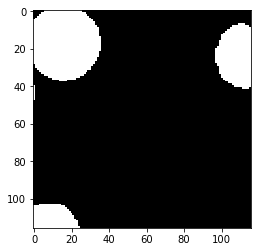

Label  8


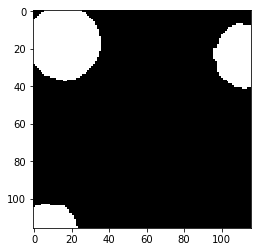

Prediction  9


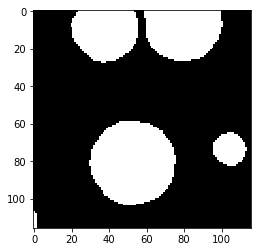

Label  9


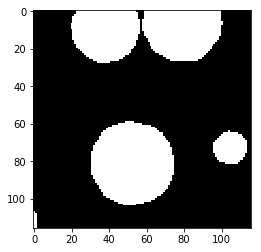

Prediction  10


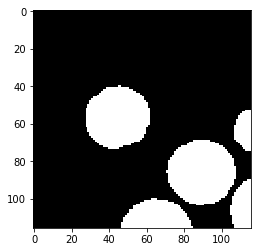

Label  10


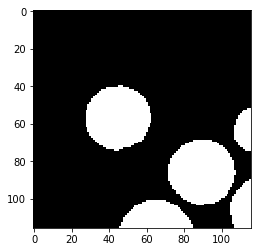

Prediction  11


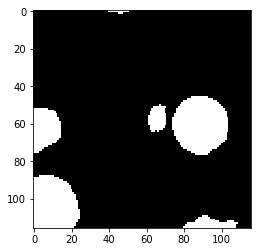

Label  11


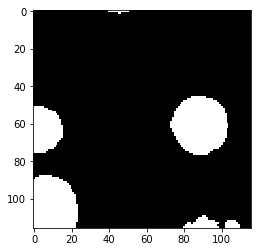

Prediction  12


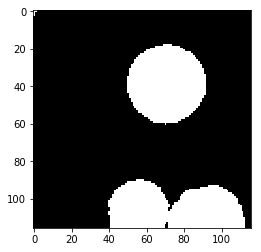

Label  12


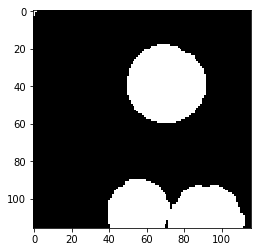

Prediction  13


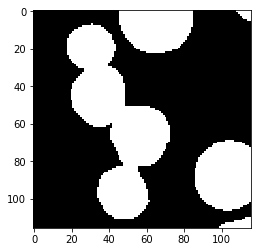

Label  13


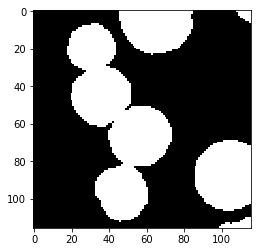

Prediction  14


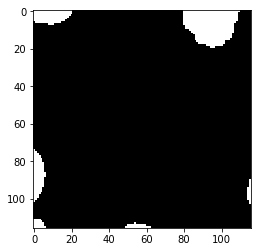

Label  14


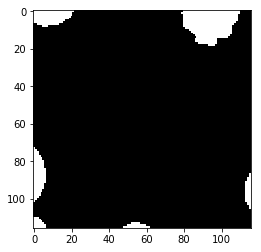

Prediction  15


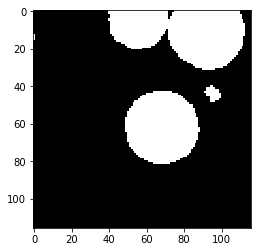

Label  15


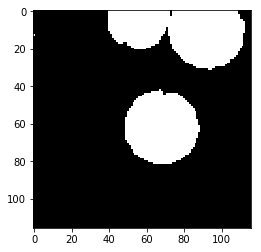

Prediction  16


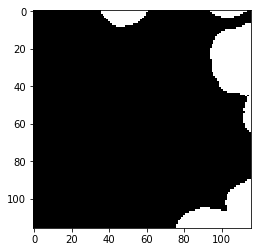

Label  16


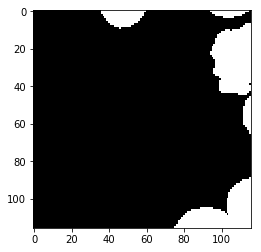

Prediction  17


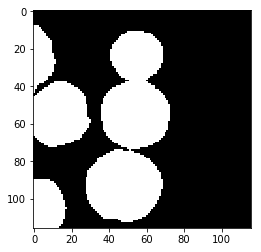

Label  17


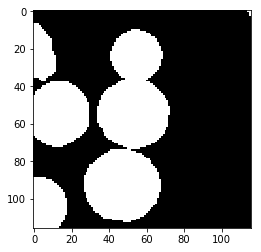

Prediction  18


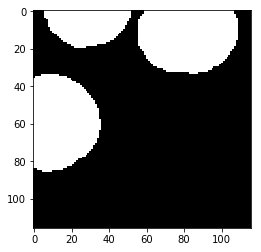

Label  18


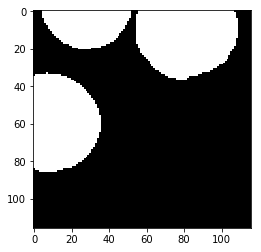

Prediction  19


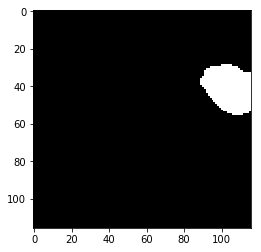

Label  19


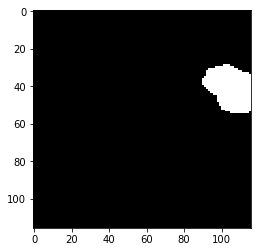

Prediction  20


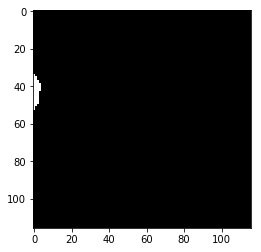

Label  20


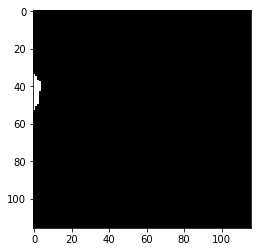

Prediction  21


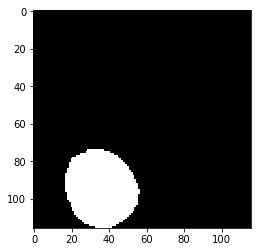

Label  21


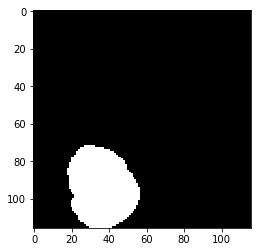

Prediction  22


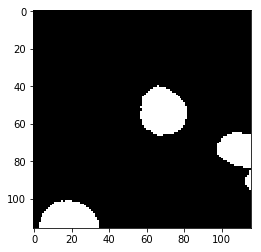

Label  22


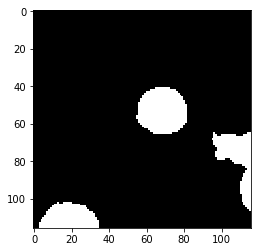

Prediction  23


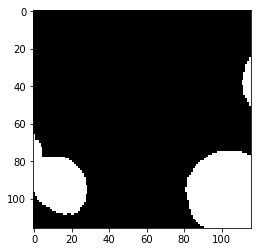

Label  23


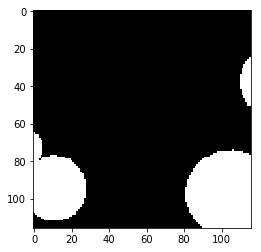

Prediction  24


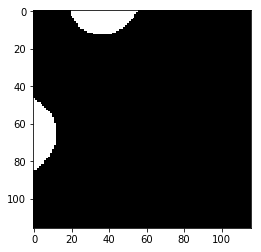

Label  24


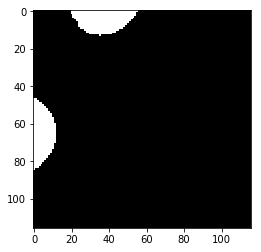

Prediction  25


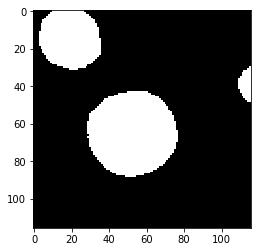

Label  25


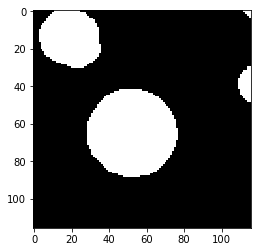

Prediction  26


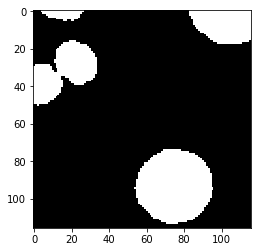

Label  26


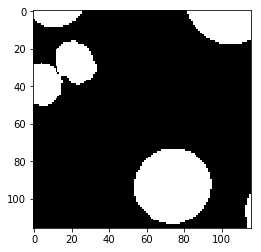

test_accuracy 0.975338424389
Batch: 32500 Train Loss value:0.00239324 Train Accuracy 0.997921306607
Prediction  0


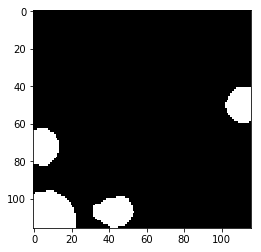

Label  0


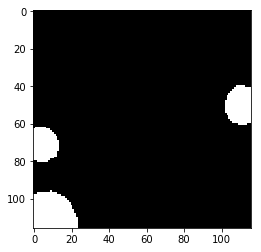

Prediction  1


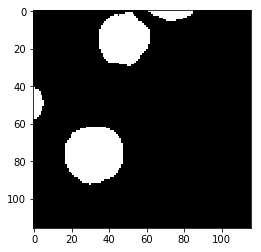

Label  1


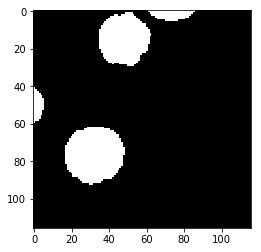

Prediction  2


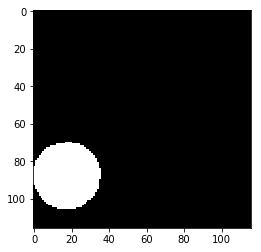

Label  2


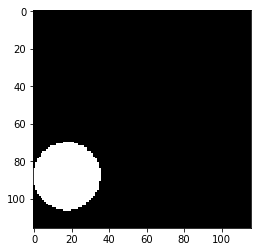

Prediction  3


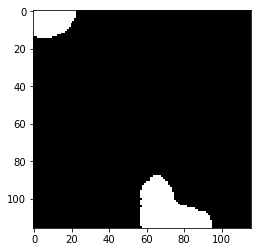

Label  3


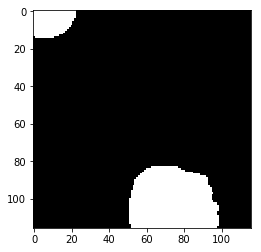

Prediction  4


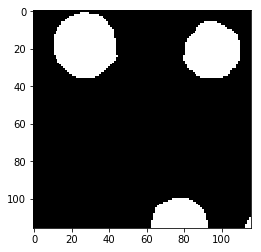

Label  4


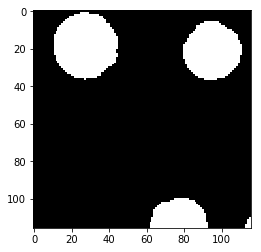

Prediction  5


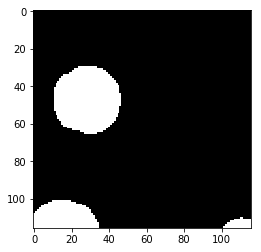

Label  5


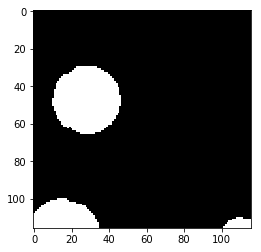

Prediction  6


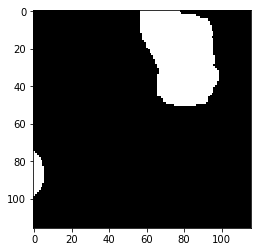

Label  6


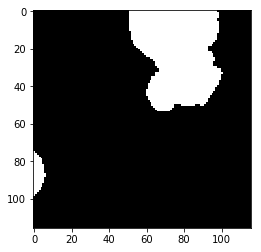

Prediction  7


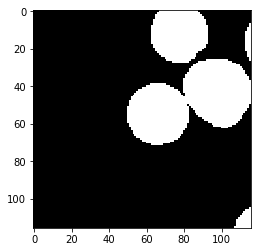

Label  7


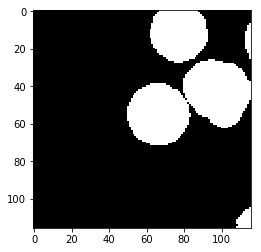

Prediction  8


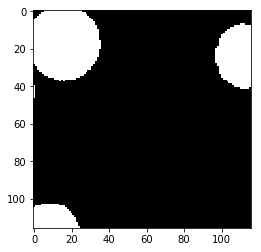

Label  8


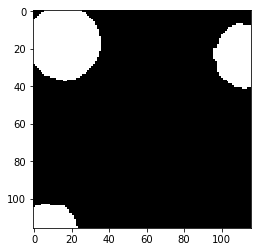

Prediction  9


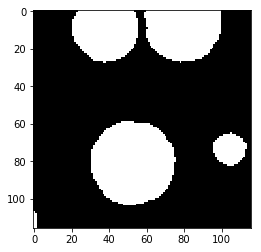

Label  9


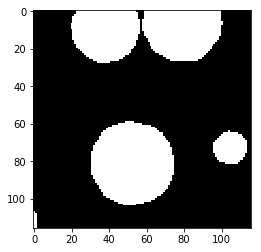

Prediction  10


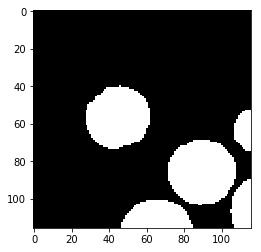

Label  10


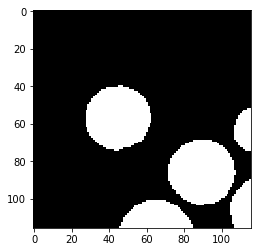

Prediction  11


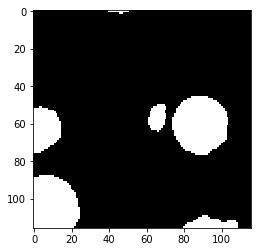

Label  11


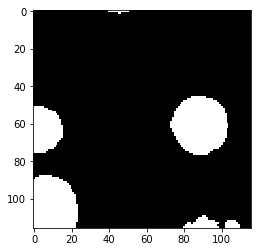

Prediction  12


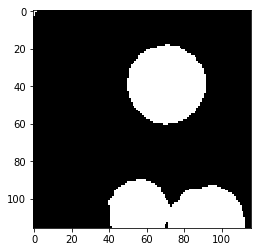

Label  12


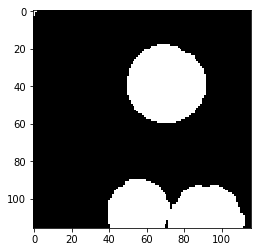

Prediction  13


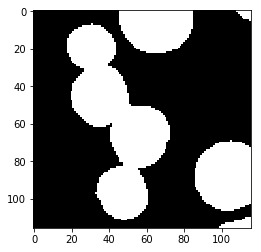

Label  13


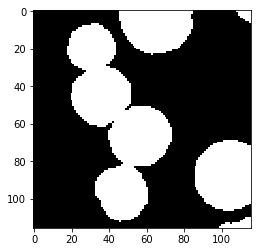

Prediction  14


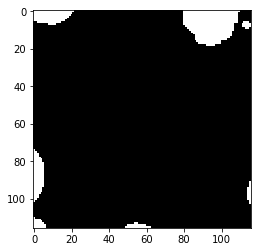

Label  14


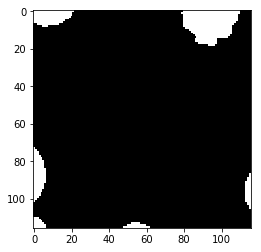

Prediction  15


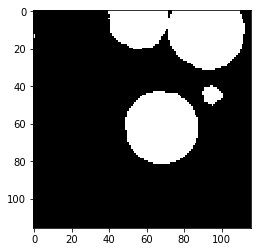

Label  15


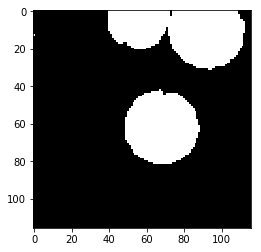

Prediction  16


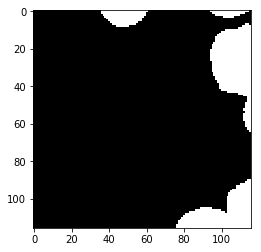

Label  16


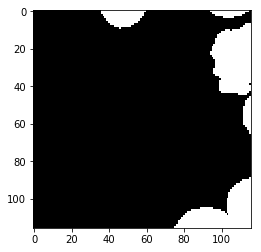

Prediction  17


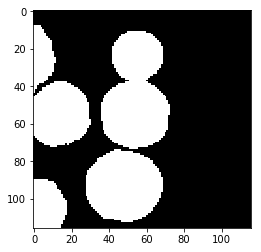

Label  17


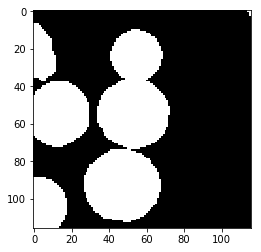

Prediction  18


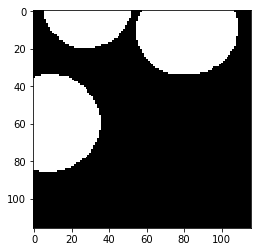

Label  18


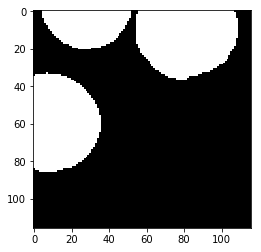

Prediction  19


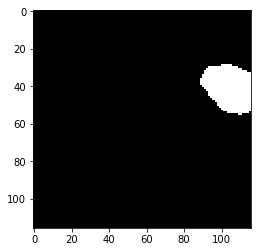

Label  19


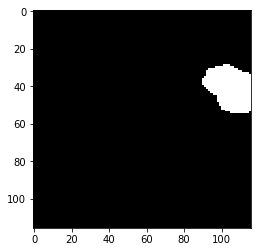

Prediction  20


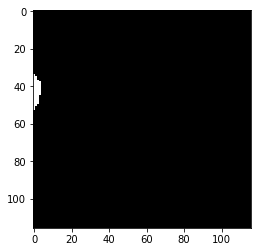

Label  20


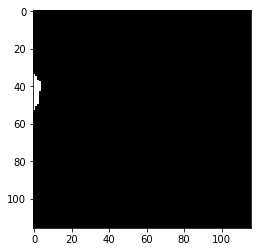

Prediction  21


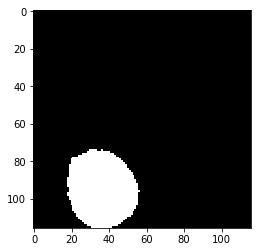

Label  21


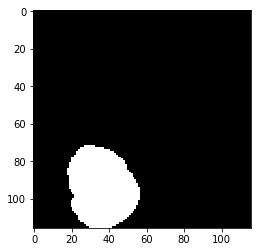

Prediction  22


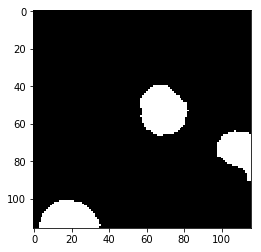

Label  22


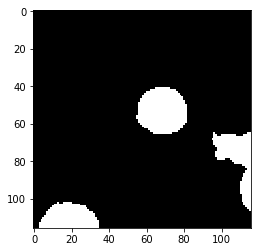

Prediction  23


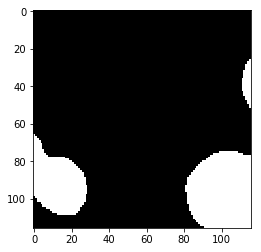

Label  23


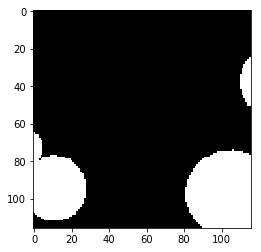

Prediction  24


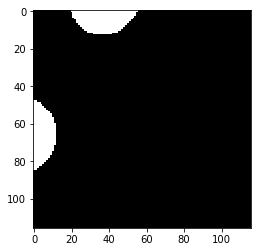

Label  24


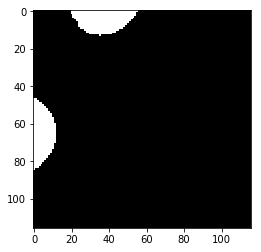

Prediction  25


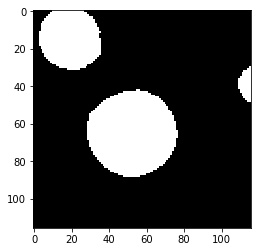

Label  25


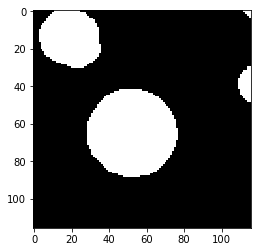

Prediction  26


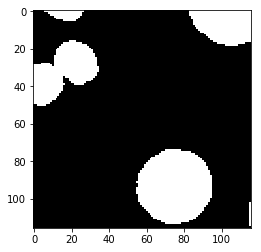

Label  26


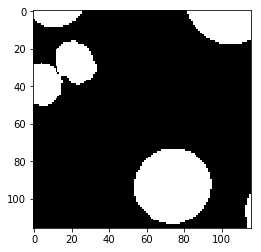

test_accuracy 0.976559507114
Batch: 33000 Train Loss value:0.0103406 Train Accuracy 0.991268960414
Prediction  0


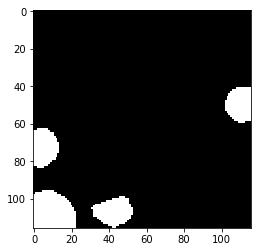

Label  0


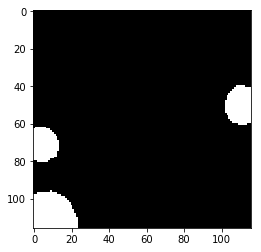

Prediction  1


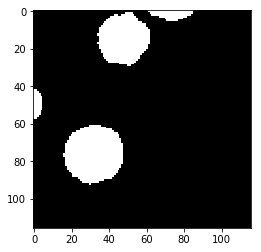

Label  1


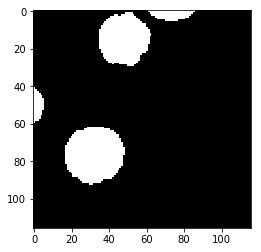

Prediction  2


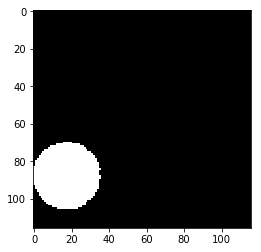

Label  2


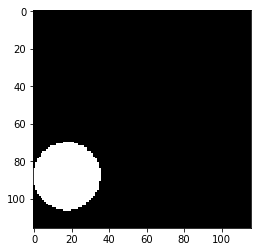

Prediction  3


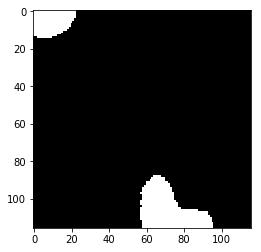

Label  3


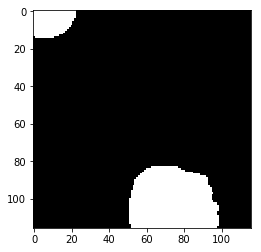

Prediction  4


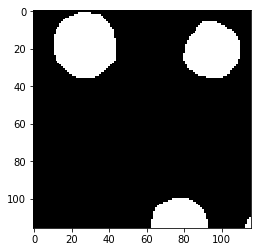

Label  4


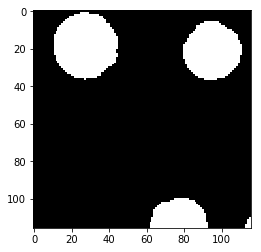

Prediction  5


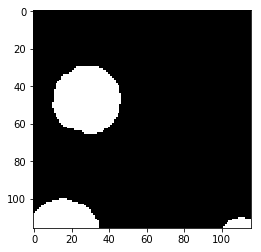

Label  5


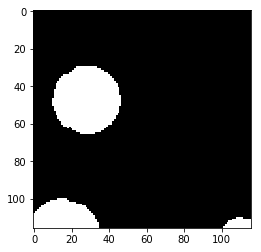

Prediction  6


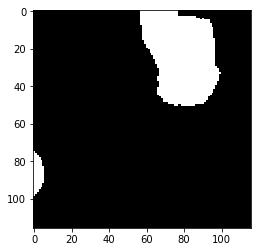

Label  6


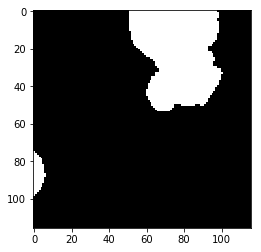

Prediction  7


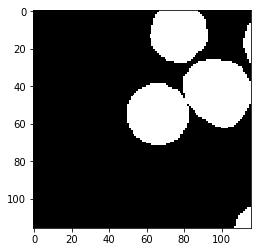

Label  7


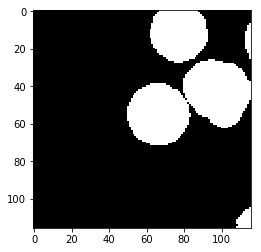

Prediction  8


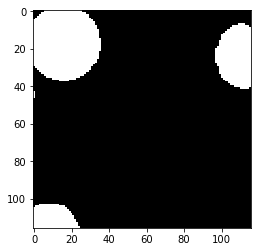

Label  8


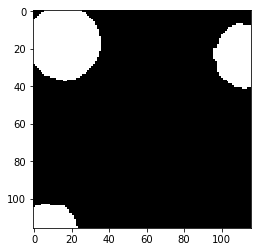

Prediction  9


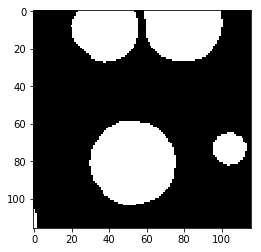

Label  9


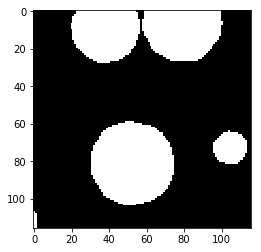

Prediction  10


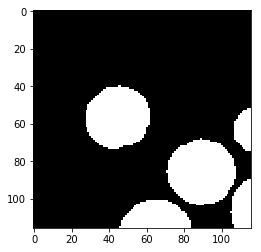

Label  10


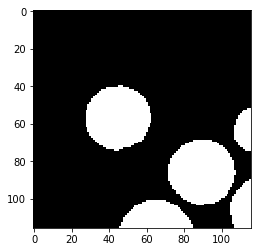

Prediction  11


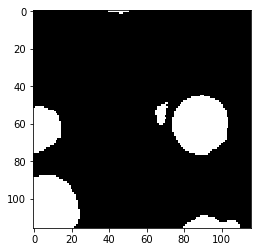

Label  11


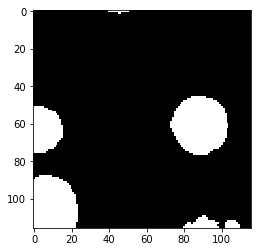

Prediction  12


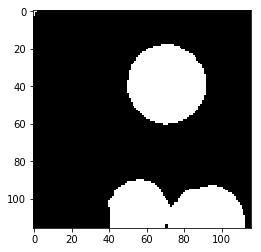

Label  12


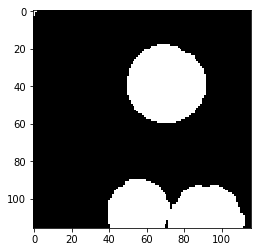

Prediction  13


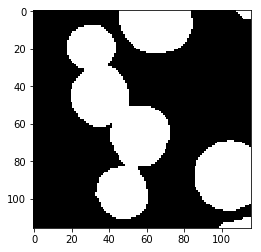

Label  13


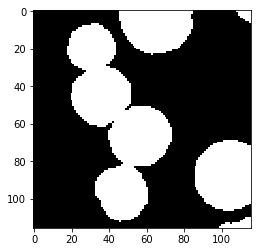

Prediction  14


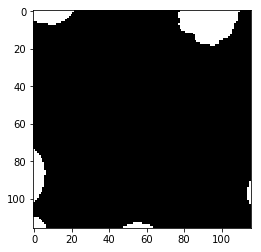

Label  14


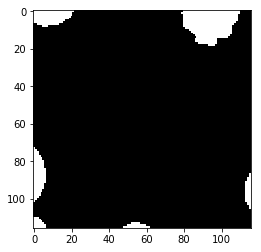

Prediction  15


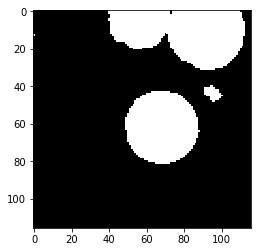

Label  15


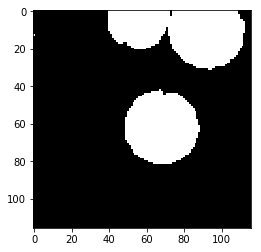

Prediction  16


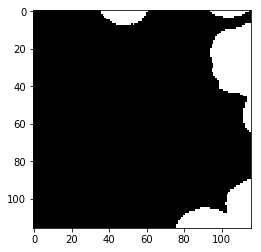

Label  16


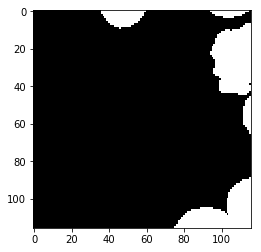

Prediction  17


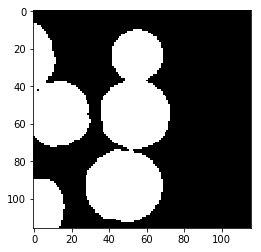

Label  17


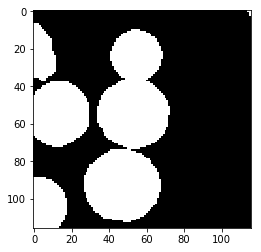

Prediction  18


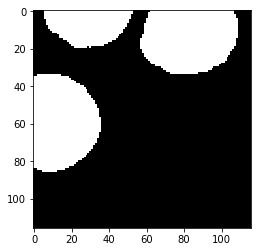

Label  18


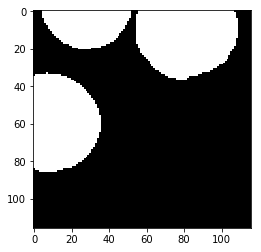

Prediction  19


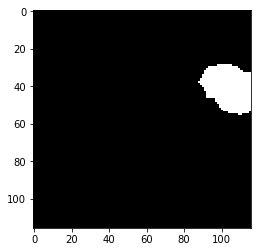

Label  19


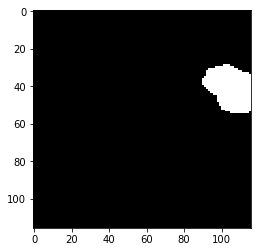

Prediction  20


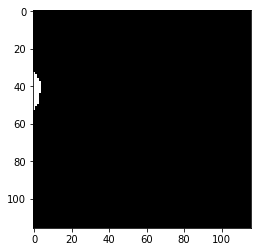

Label  20


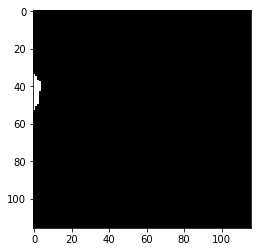

Prediction  21


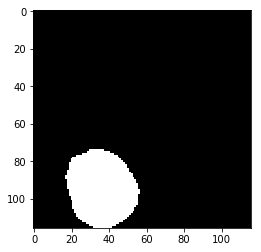

Label  21


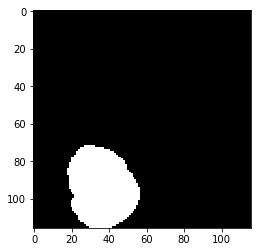

Prediction  22


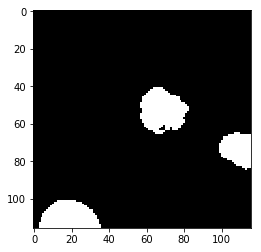

Label  22


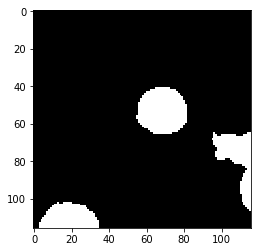

Prediction  23


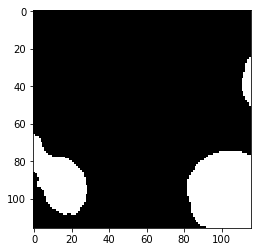

Label  23


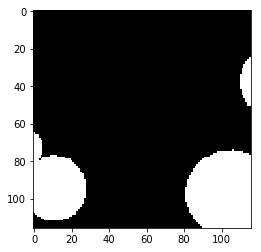

Prediction  24


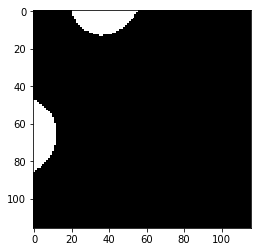

Label  24


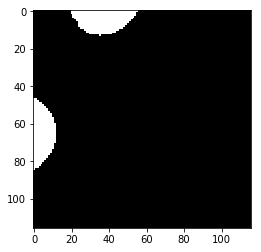

Prediction  25


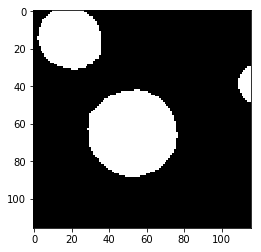

Label  25


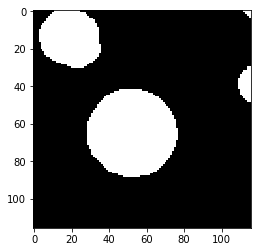

Prediction  26


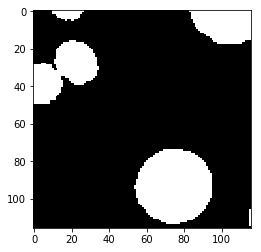

Label  26


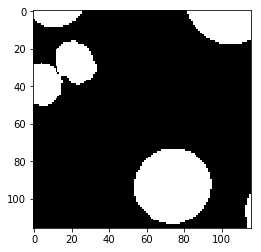

test_accuracy 0.975397306435
Batch: 33500 Train Loss value:0.0105023 Train Accuracy 0.990827045421
Prediction  0


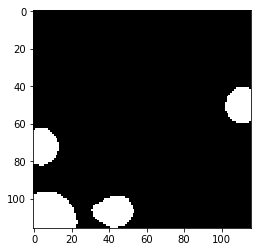

Label  0


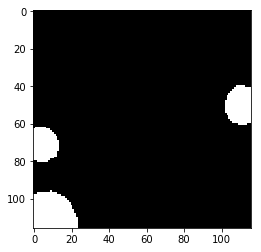

Prediction  1


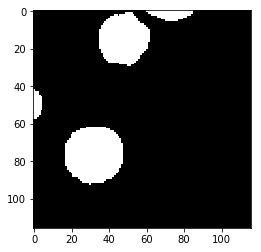

Label  1


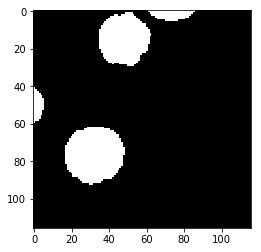

Prediction  2


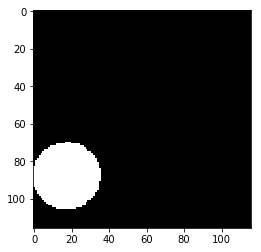

Label  2


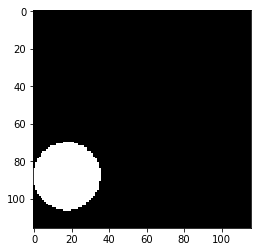

Prediction  3


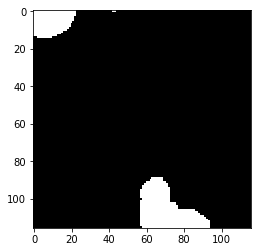

Label  3


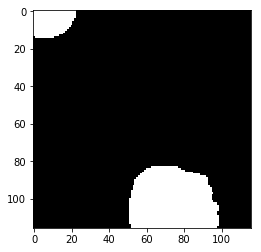

Prediction  4


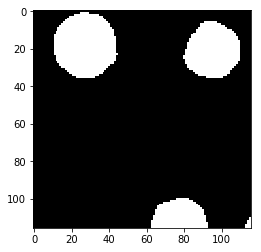

Label  4


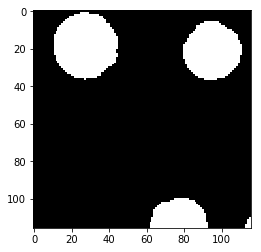

Prediction  5


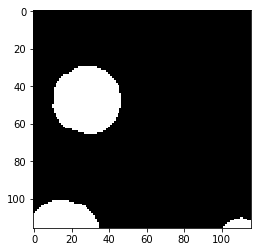

Label  5


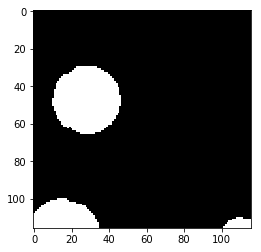

Prediction  6


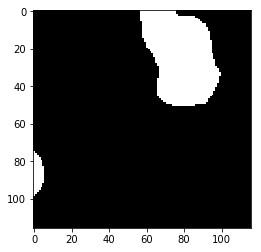

Label  6


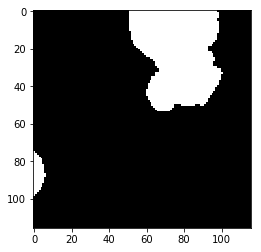

Prediction  7


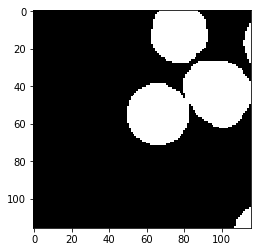

Label  7


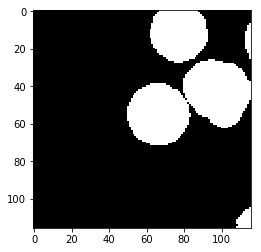

Prediction  8


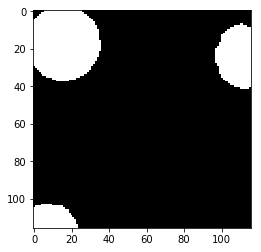

Label  8


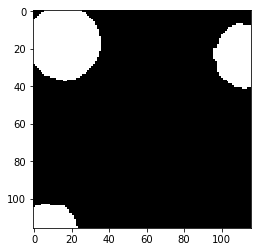

Prediction  9


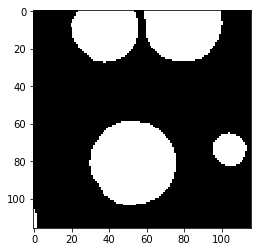

Label  9


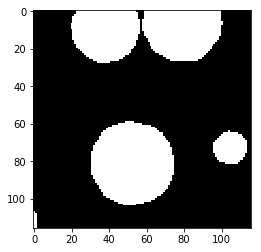

Prediction  10


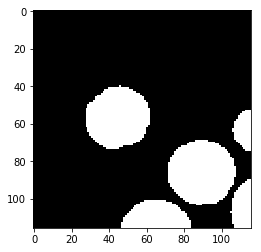

Label  10


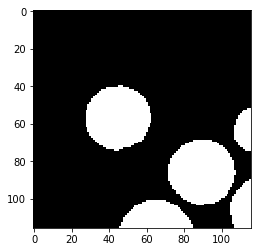

Prediction  11


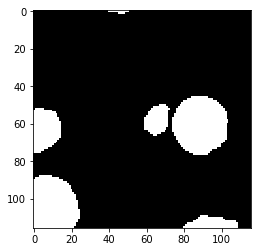

Label  11


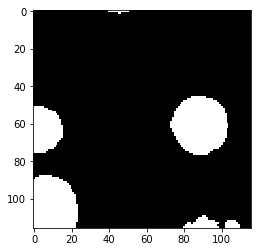

Prediction  12


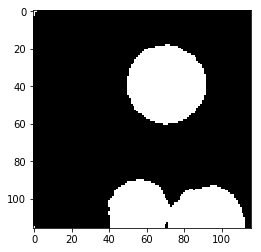

Label  12


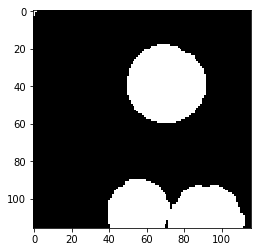

Prediction  13


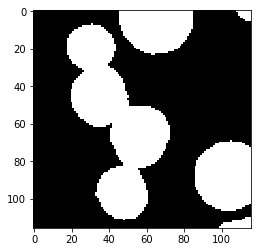

Label  13


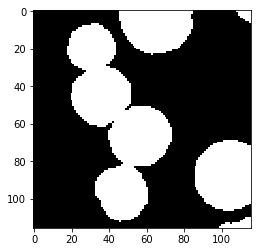

Prediction  14


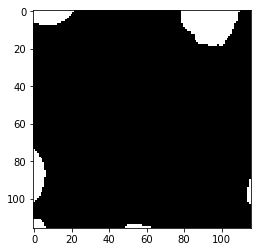

Label  14


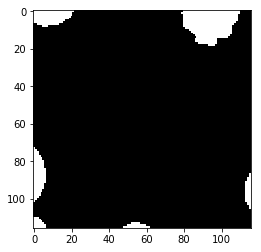

Prediction  15


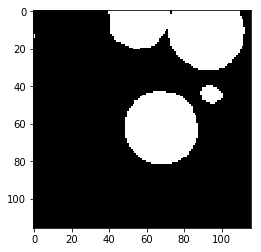

Label  15


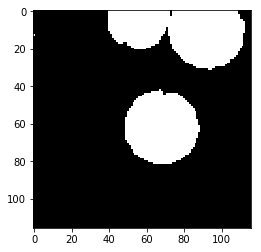

Prediction  16


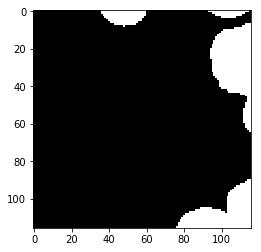

Label  16


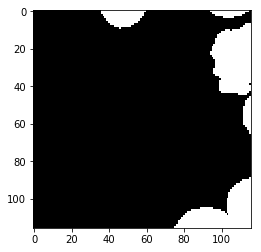

Prediction  17


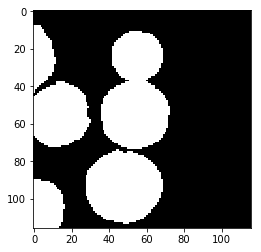

Label  17


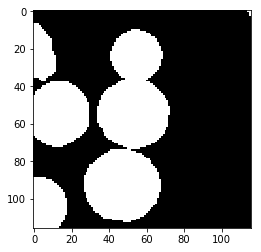

Prediction  18


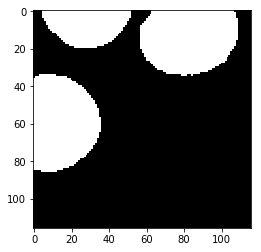

Label  18


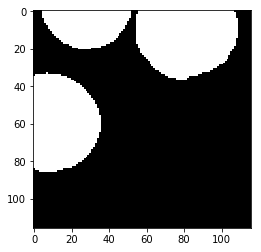

Prediction  19


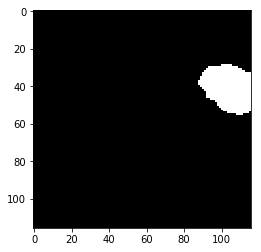

Label  19


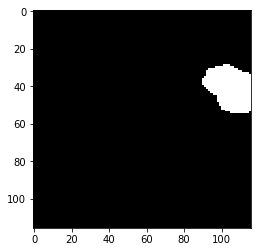

Prediction  20


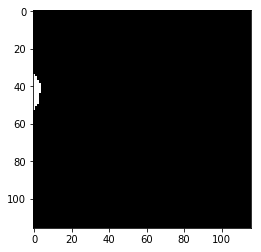

Label  20


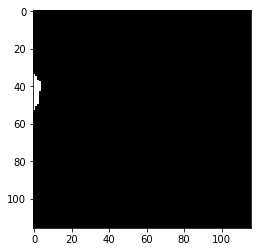

Prediction  21


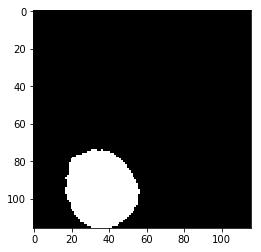

Label  21


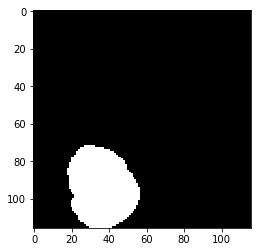

Prediction  22


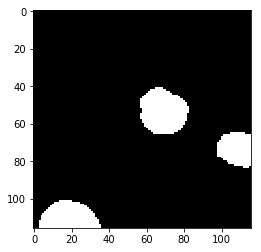

Label  22


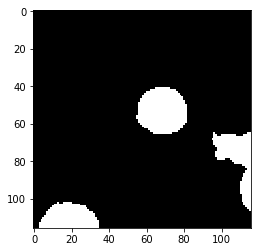

Prediction  23


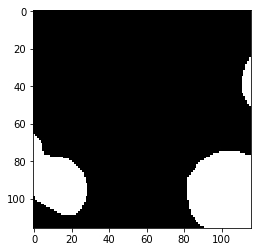

Label  23


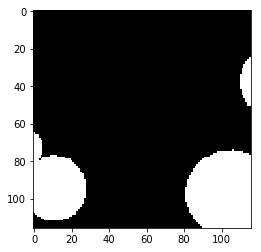

Prediction  24


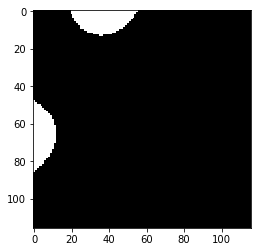

Label  24


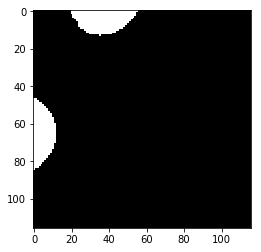

Prediction  25


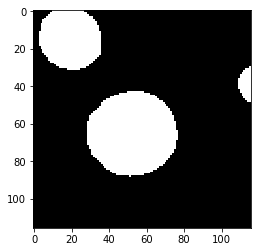

Label  25


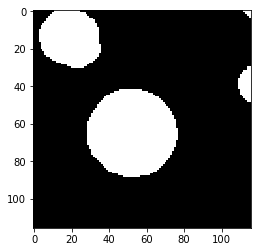

Prediction  26


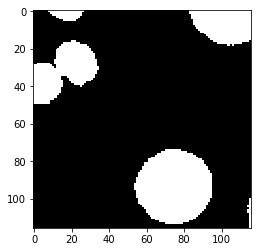

Label  26


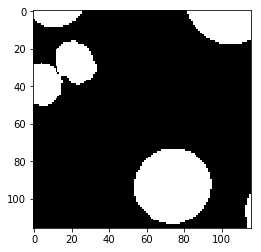

test_accuracy 0.974882373079
Batch: 34000 Train Loss value:0.015202 Train Accuracy 0.986858619417
Prediction  0


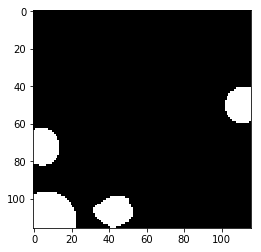

Label  0


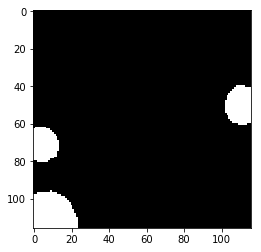

Prediction  1


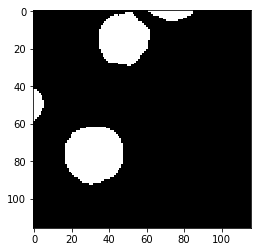

Label  1


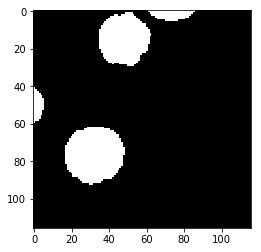

Prediction  2


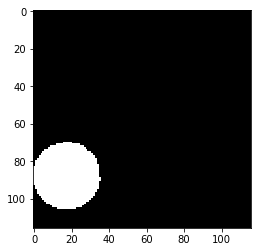

Label  2


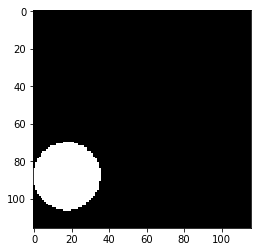

Prediction  3


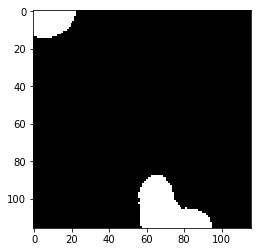

Label  3


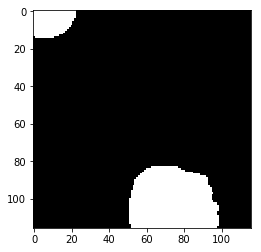

Prediction  4


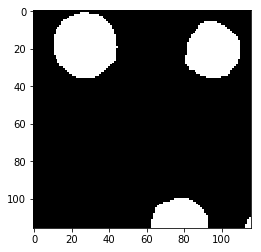

Label  4


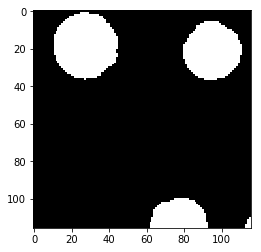

Prediction  5


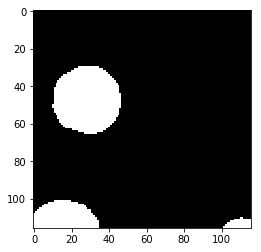

Label  5


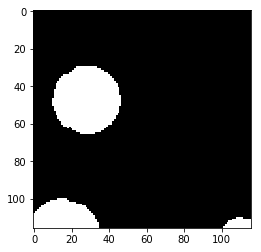

Prediction  6


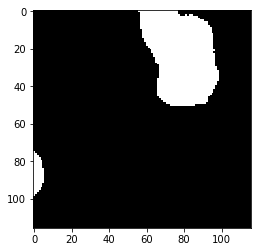

Label  6


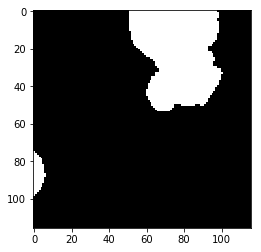

Prediction  7


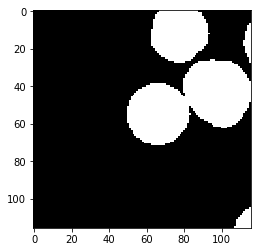

Label  7


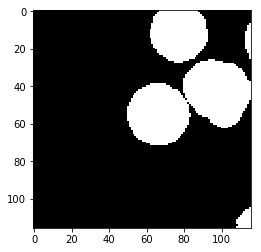

Prediction  8


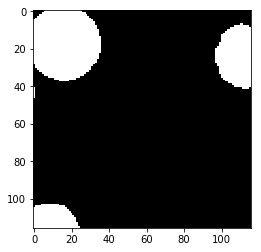

Label  8


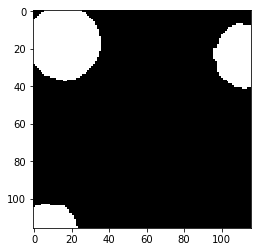

Prediction  9


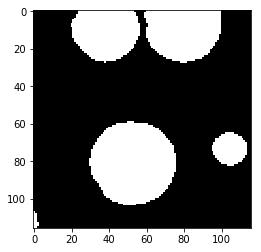

Label  9


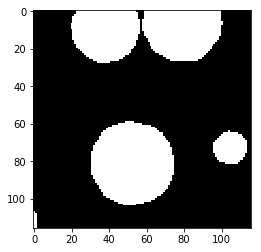

Prediction  10


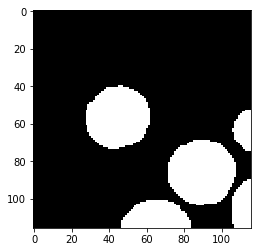

Label  10


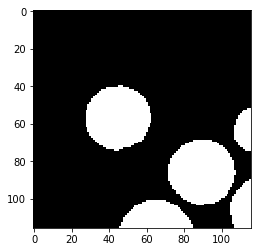

Prediction  11


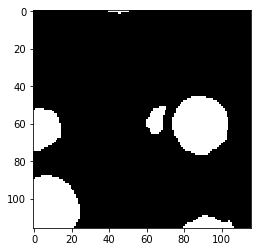

Label  11


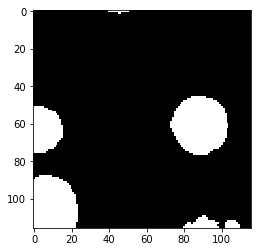

Prediction  12


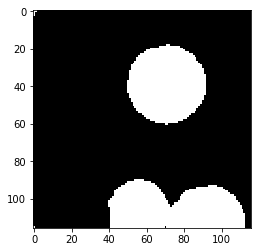

Label  12


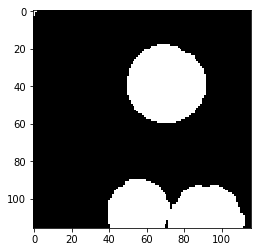

Prediction  13


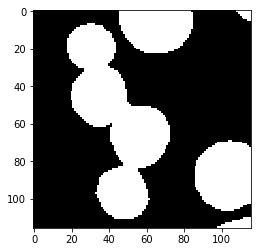

Label  13


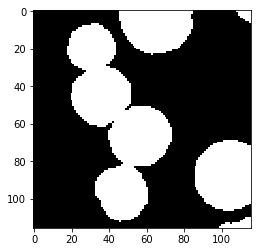

Prediction  14


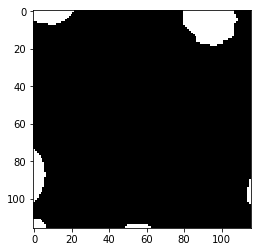

Label  14


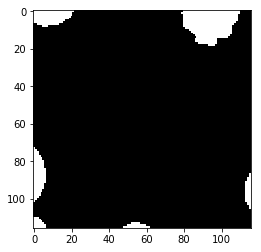

Prediction  15


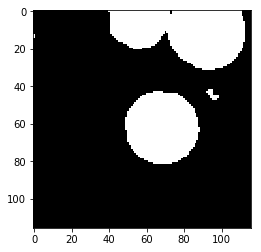

Label  15


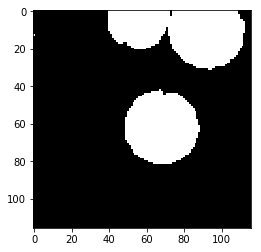

Prediction  16


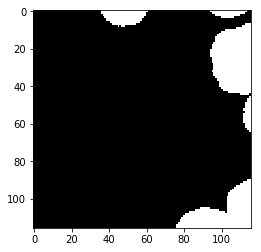

Label  16


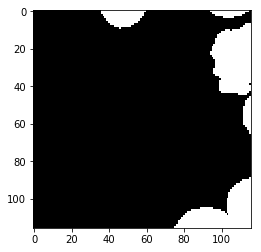

Prediction  17


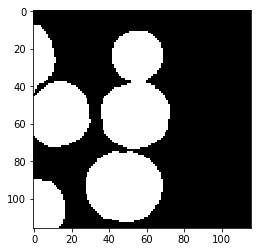

Label  17


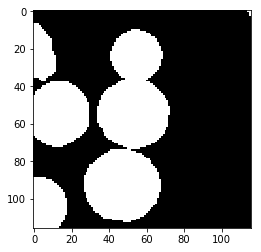

Prediction  18


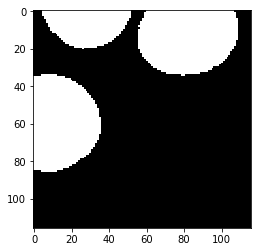

Label  18


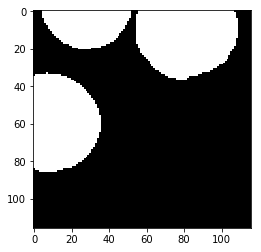

Prediction  19


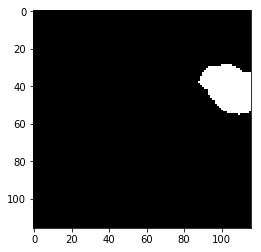

Label  19


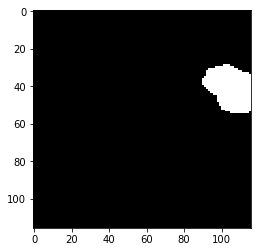

Prediction  20


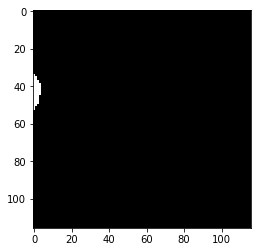

Label  20


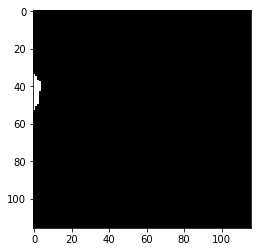

Prediction  21


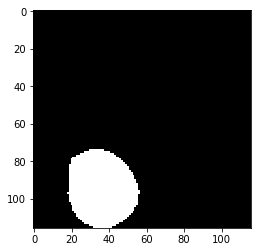

Label  21


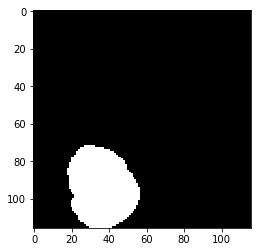

Prediction  22


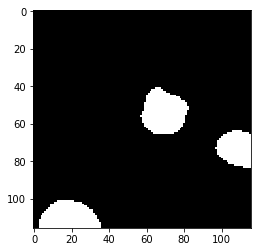

Label  22


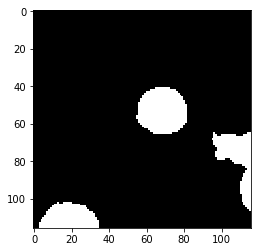

Prediction  23


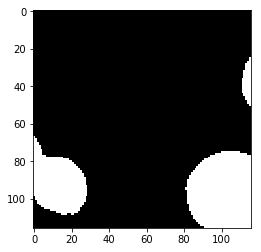

Label  23


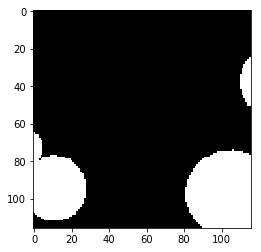

Prediction  24


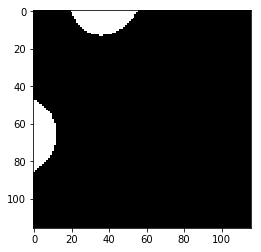

Label  24


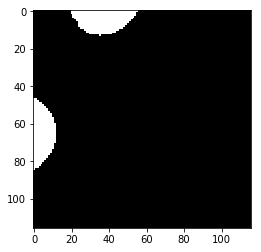

Prediction  25


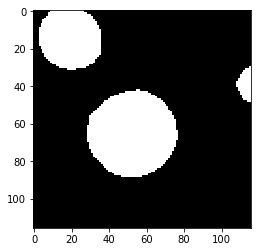

Label  25


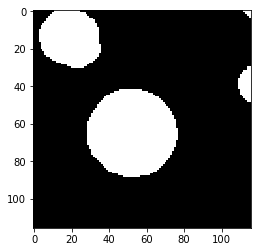

Prediction  26


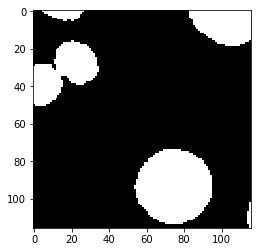

Label  26


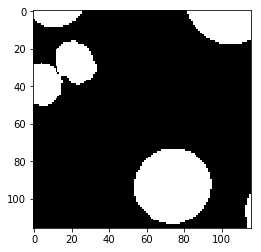

test_accuracy 0.975974920483
Batch: 34500 Train Loss value:0.0136855 Train Accuracy 0.988473474213
Prediction  0


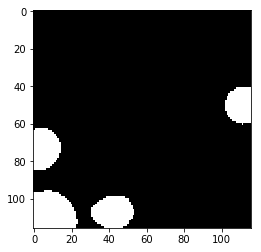

Label  0


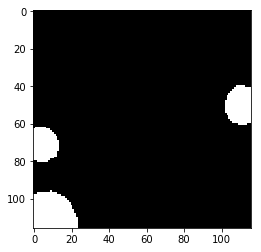

Prediction  1


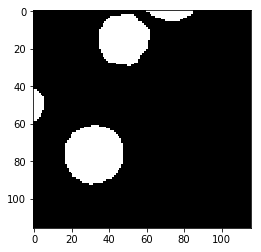

Label  1


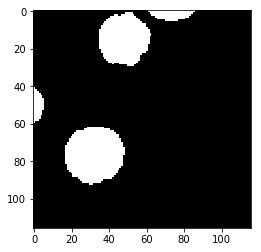

Prediction  2


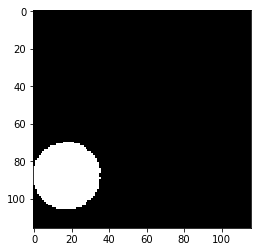

Label  2


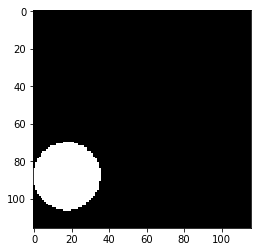

Prediction  3


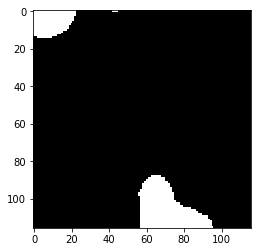

Label  3


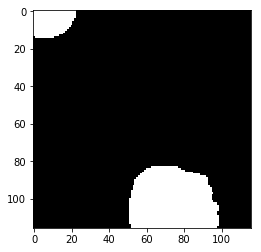

Prediction  4


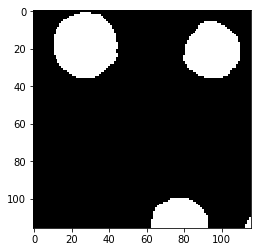

Label  4


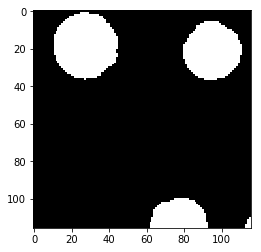

Prediction  5


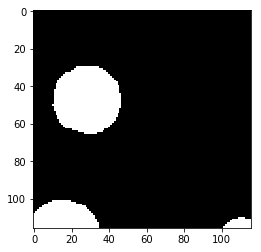

Label  5


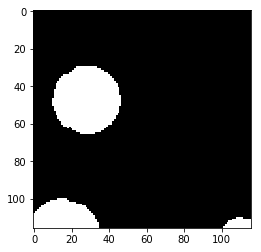

Prediction  6


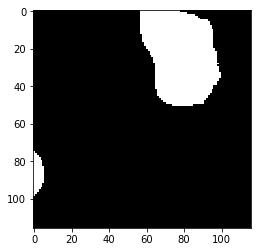

Label  6


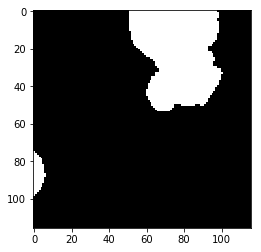

Prediction  7


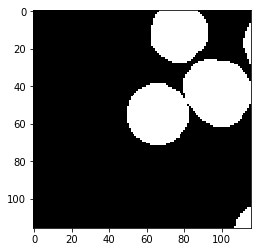

Label  7


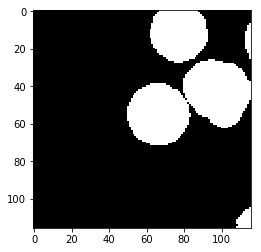

Prediction  8


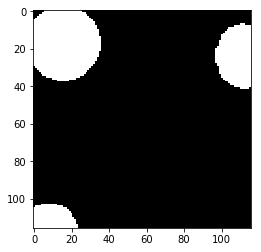

Label  8


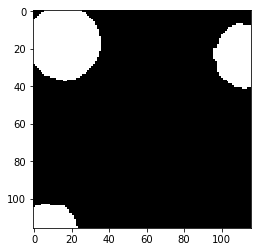

Prediction  9


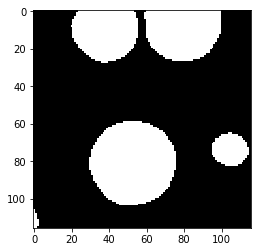

Label  9


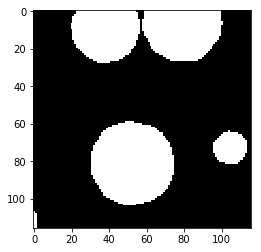

Prediction  10


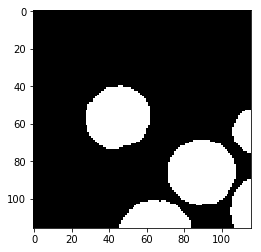

Label  10


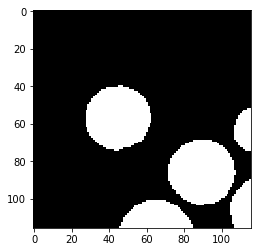

Prediction  11


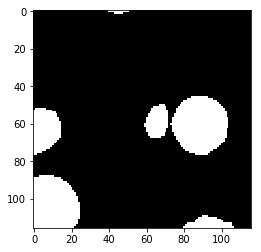

Label  11


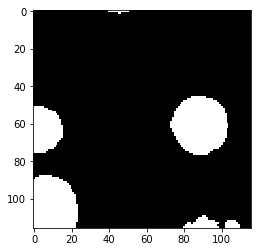

Prediction  12


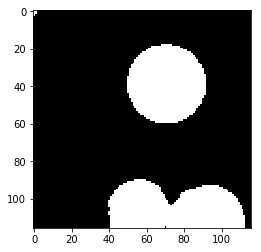

Label  12


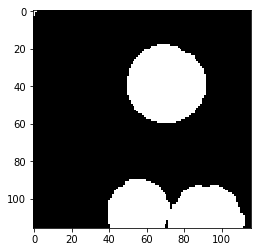

Prediction  13


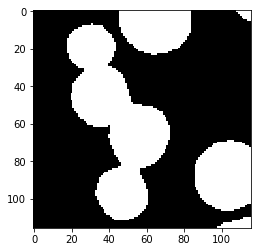

Label  13


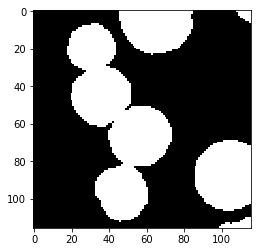

Prediction  14


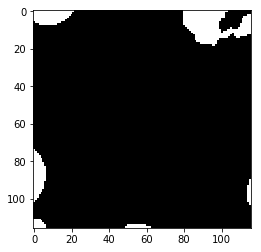

Label  14


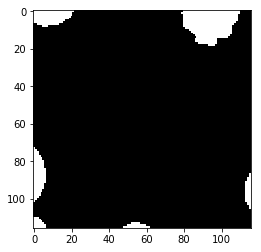

Prediction  15


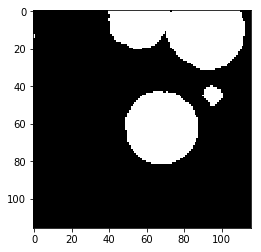

Label  15


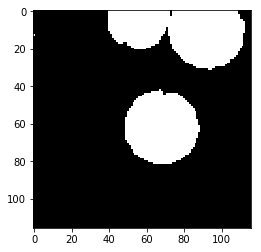

Prediction  16


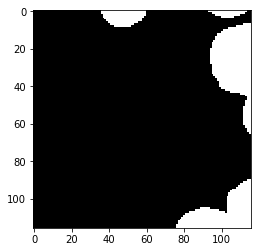

Label  16


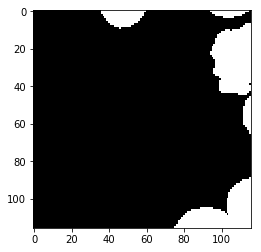

Prediction  17


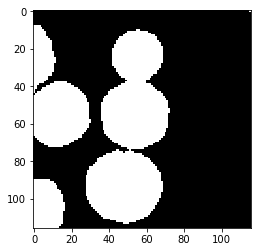

Label  17


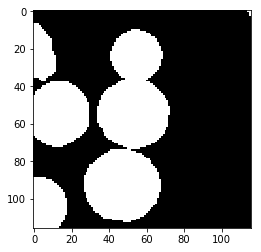

Prediction  18


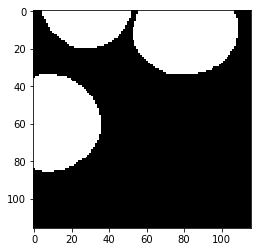

Label  18


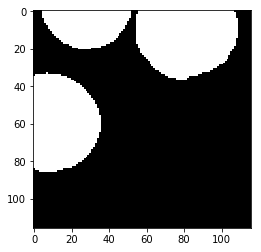

Prediction  19


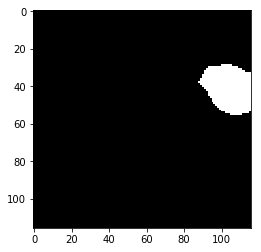

Label  19


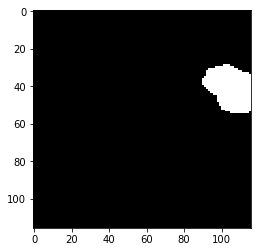

Prediction  20


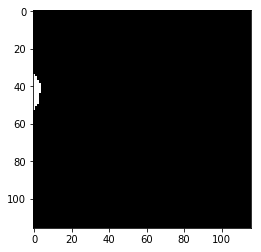

Label  20


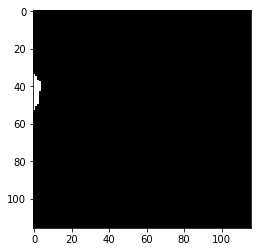

Prediction  21


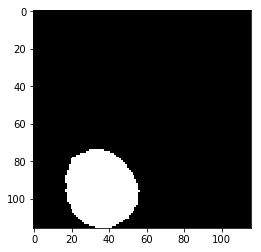

Label  21


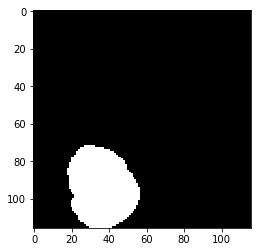

Prediction  22


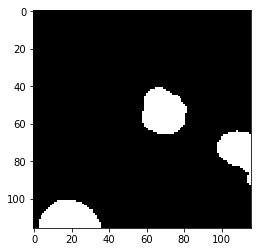

Label  22


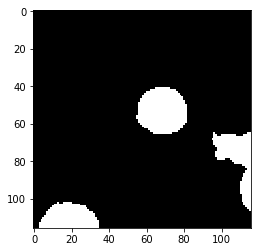

Prediction  23


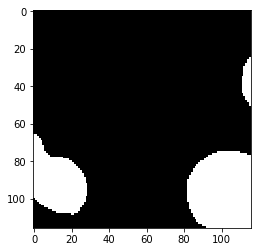

Label  23


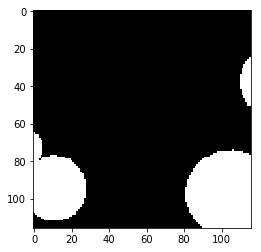

Prediction  24


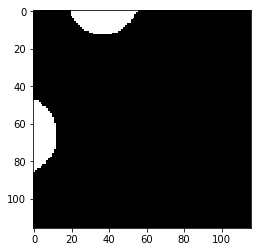

Label  24


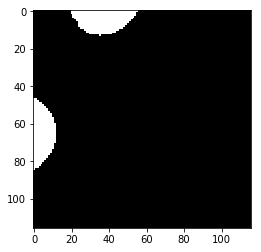

Prediction  25


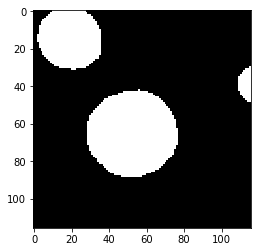

Label  25


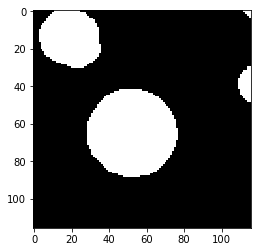

Prediction  26


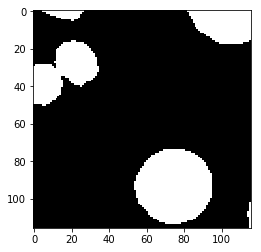

Label  26


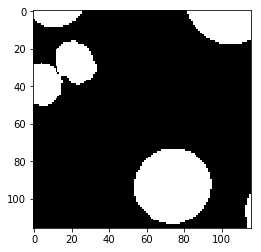

test_accuracy 0.974450672649
Batch: 35000 Train Loss value:0.0217428 Train Accuracy 0.983490566038
Prediction  0


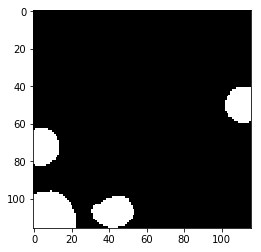

Label  0


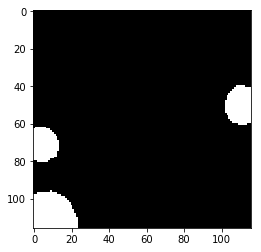

Prediction  1


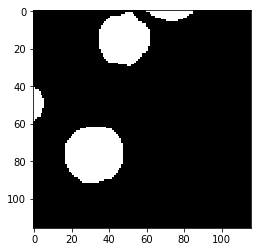

Label  1


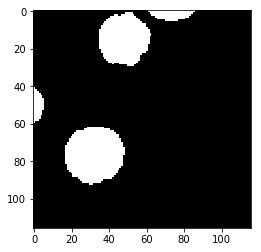

Prediction  2


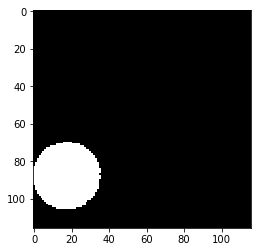

Label  2


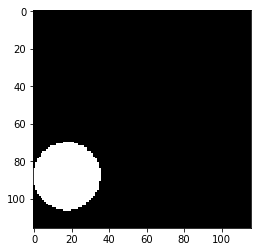

Prediction  3


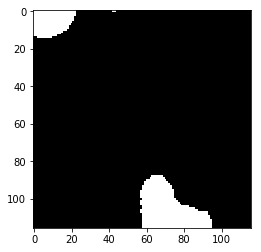

Label  3


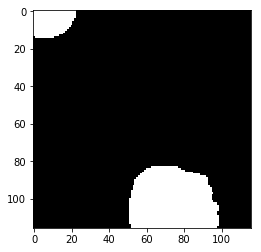

Prediction  4


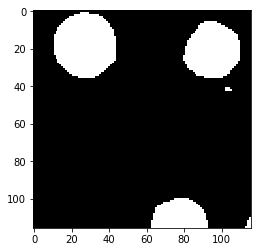

Label  4


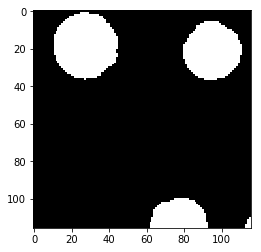

Prediction  5


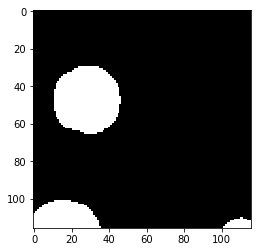

Label  5


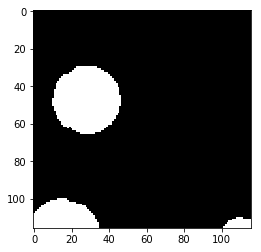

Prediction  6


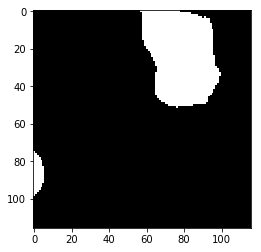

Label  6


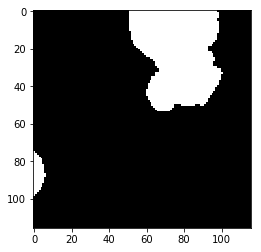

Prediction  7


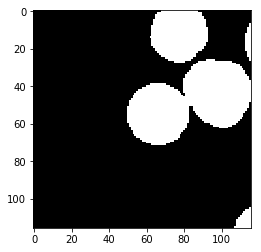

Label  7


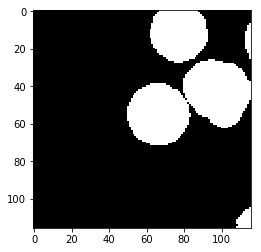

Prediction  8


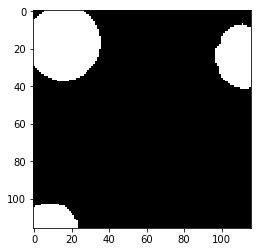

Label  8


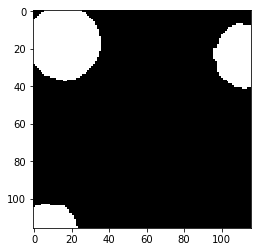

Prediction  9


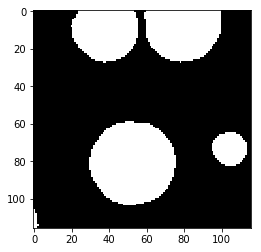

Label  9


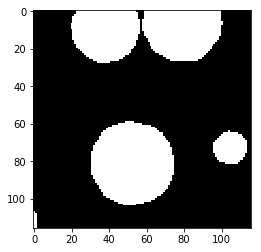

Prediction  10


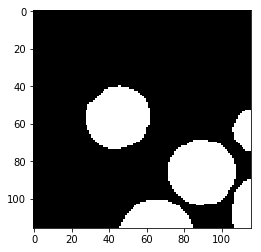

Label  10


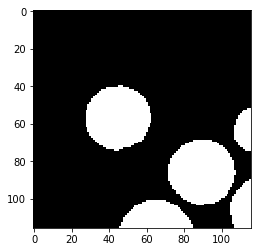

Prediction  11


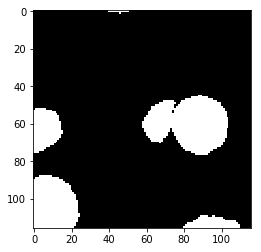

Label  11


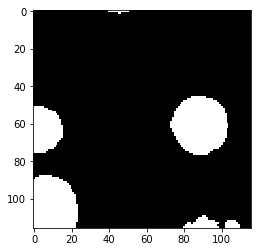

Prediction  12


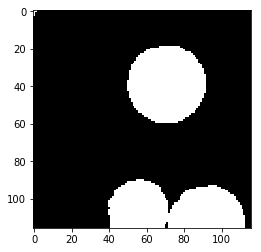

Label  12


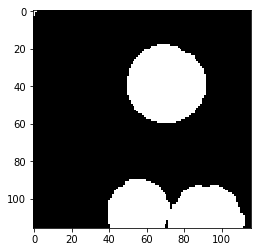

Prediction  13


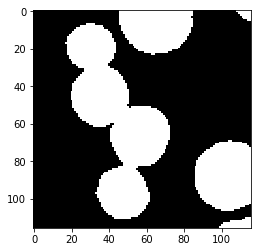

Label  13


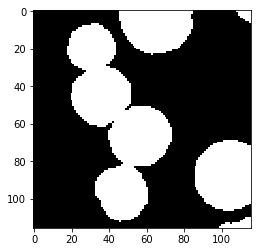

Prediction  14


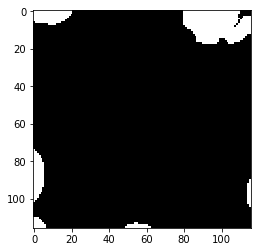

Label  14


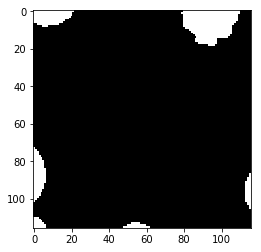

Prediction  15


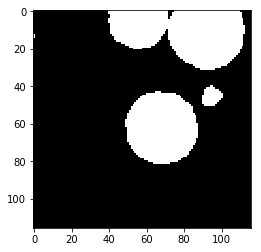

Label  15


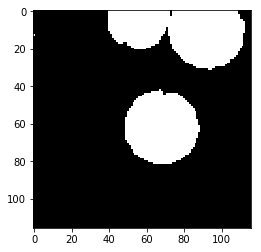

Prediction  16


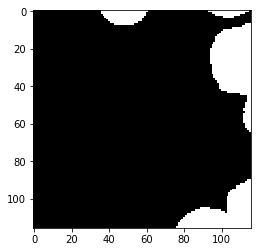

Label  16


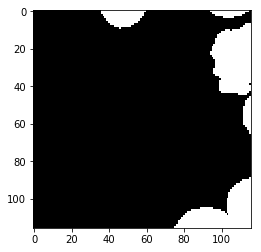

Prediction  17


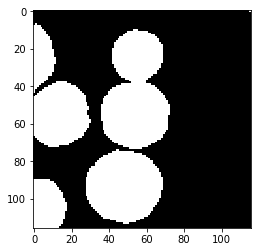

Label  17


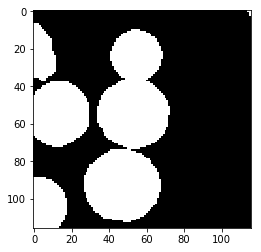

Prediction  18


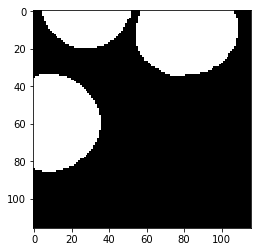

Label  18


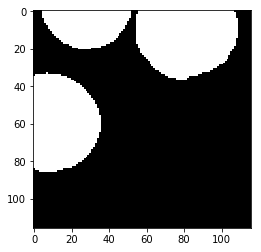

Prediction  19


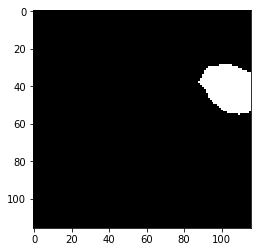

Label  19


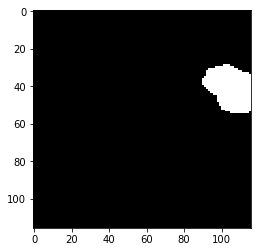

Prediction  20


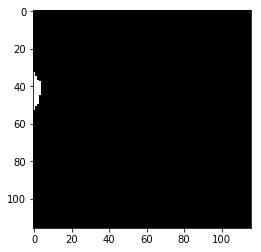

Label  20


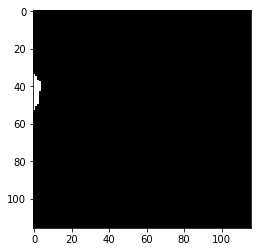

Prediction  21


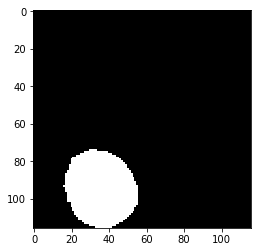

Label  21


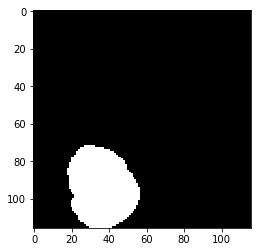

Prediction  22


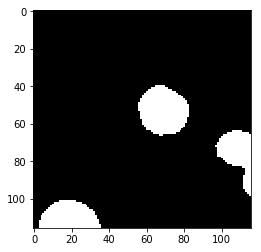

Label  22


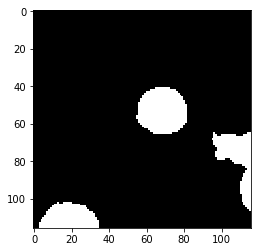

Prediction  23


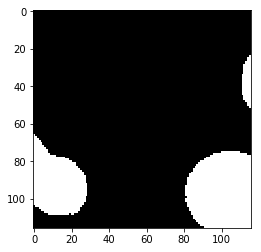

Label  23


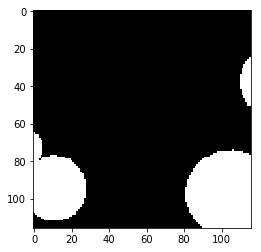

Prediction  24


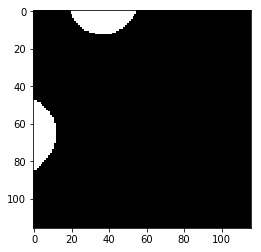

Label  24


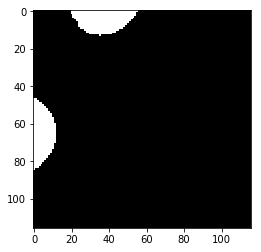

Prediction  25


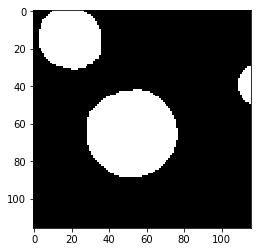

Label  25


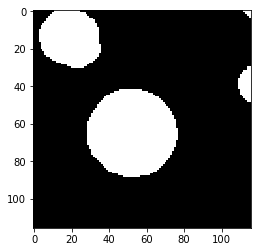

Prediction  26


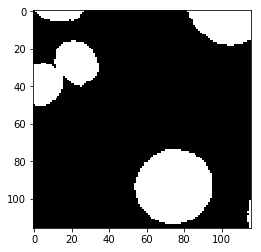

Label  26


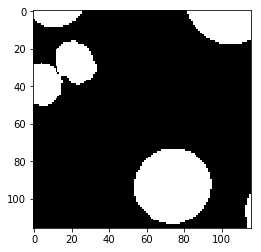

test_accuracy 0.975724974166
Batch: 35500 Train Loss value:0.0249901 Train Accuracy 0.979405707561
Prediction  0


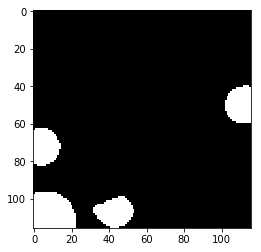

Label  0


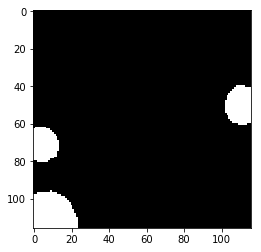

Prediction  1


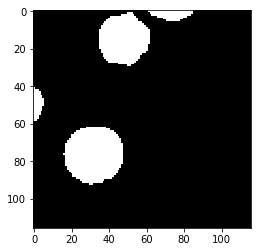

Label  1


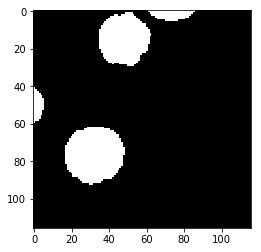

Prediction  2


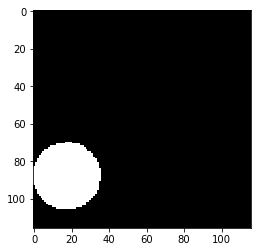

Label  2


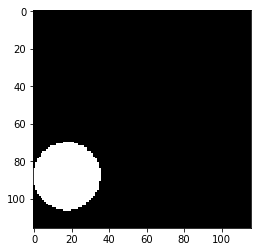

Prediction  3


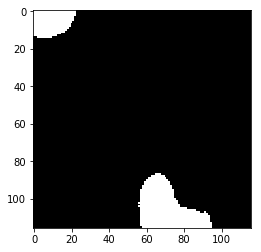

Label  3


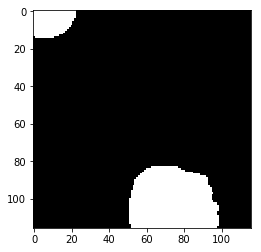

Prediction  4


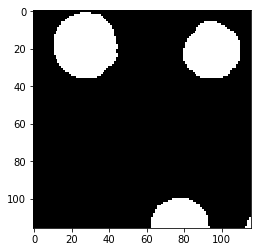

Label  4


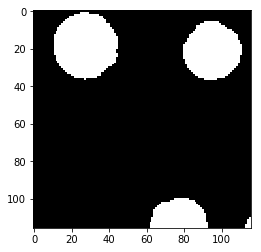

Prediction  5


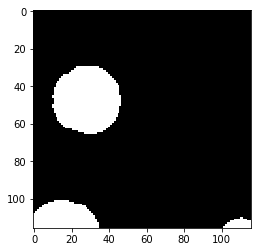

Label  5


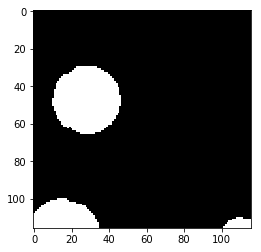

Prediction  6


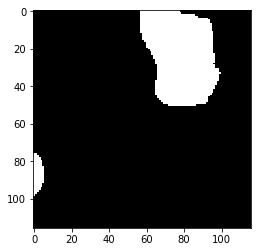

Label  6


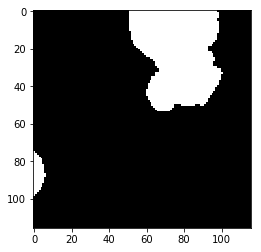

Prediction  7


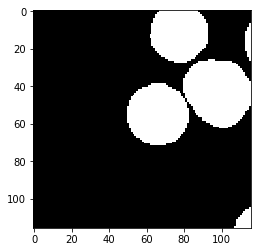

Label  7


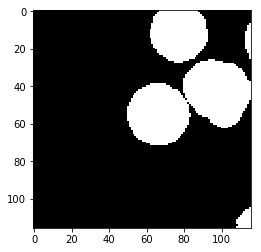

Prediction  8


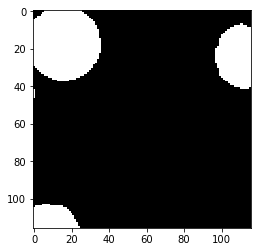

Label  8


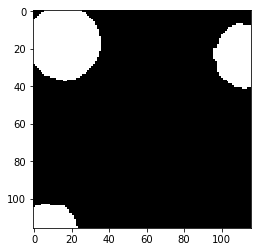

Prediction  9


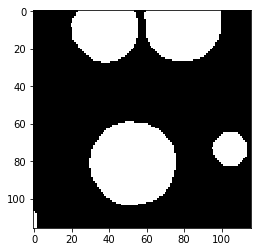

Label  9


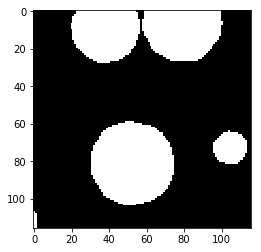

Prediction  10


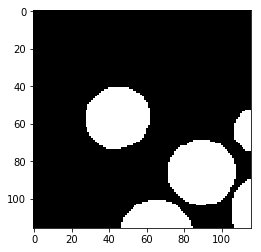

Label  10


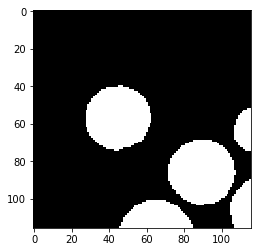

Prediction  11


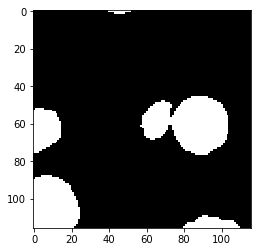

Label  11


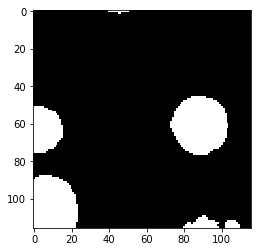

Prediction  12


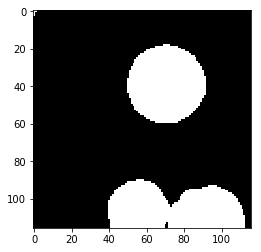

Label  12


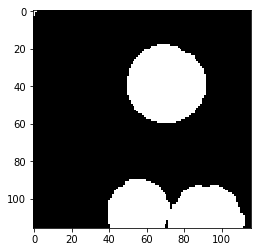

Prediction  13


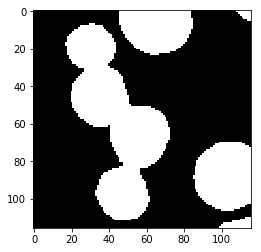

Label  13


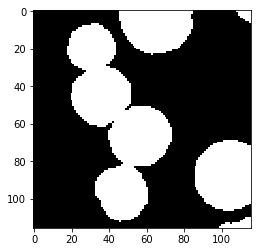

Prediction  14


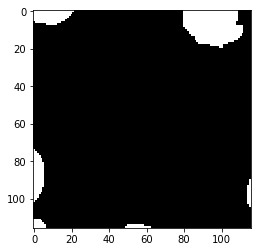

Label  14


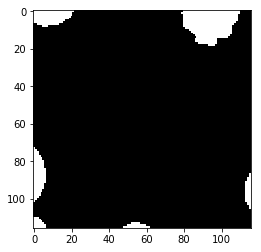

Prediction  15


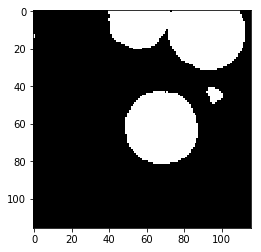

Label  15


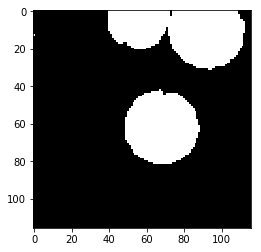

Prediction  16


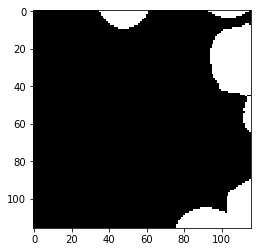

Label  16


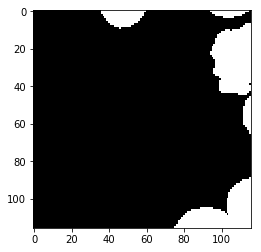

Prediction  17


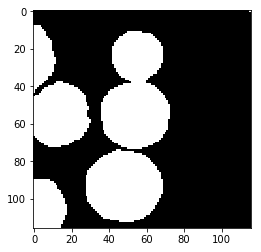

Label  17


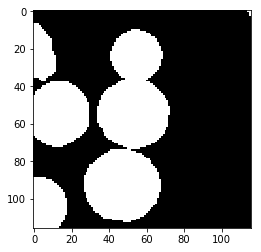

Prediction  18


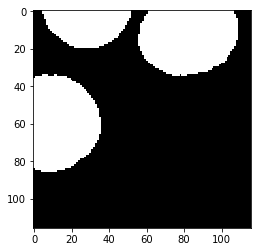

Label  18


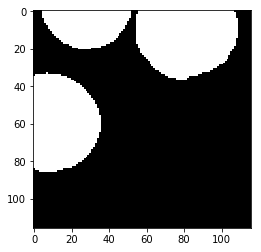

Prediction  19


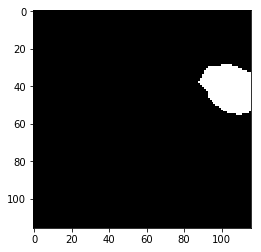

Label  19


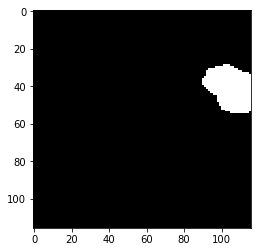

Prediction  20


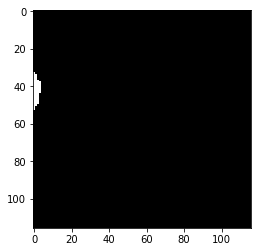

Label  20


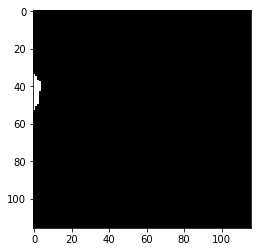

Prediction  21


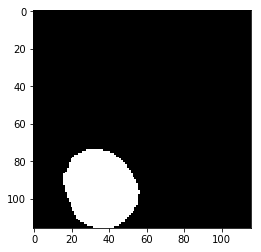

Label  21


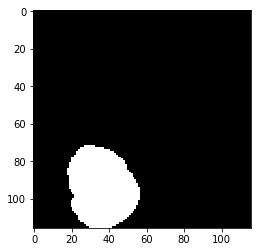

Prediction  22


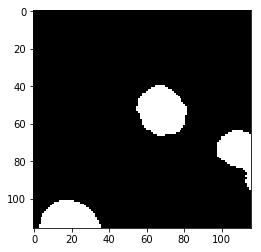

Label  22


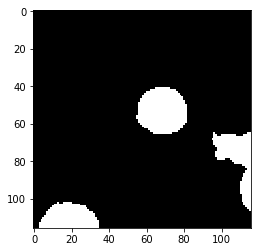

Prediction  23


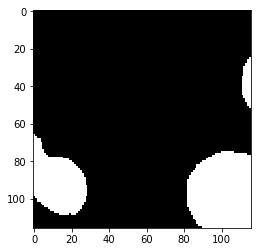

Label  23


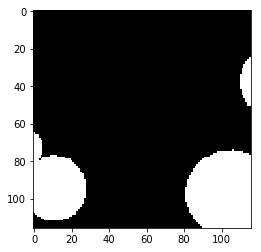

Prediction  24


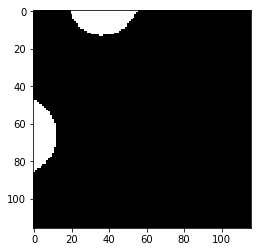

Label  24


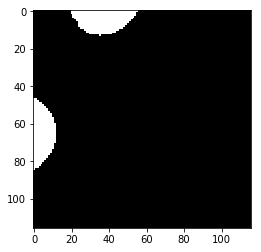

Prediction  25


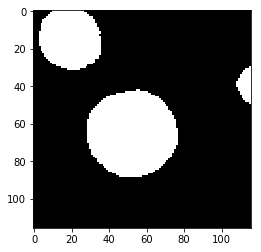

Label  25


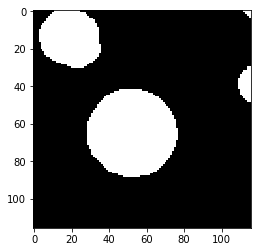

Prediction  26


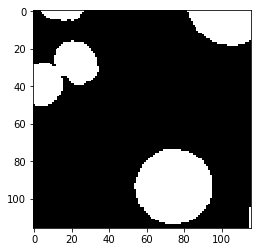

Label  26


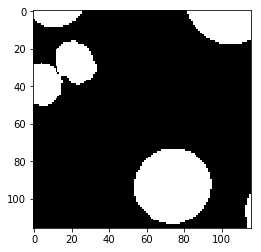

test_accuracy 0.975656344344
Batch: 36000 Train Loss value:0.0193318 Train Accuracy 0.984075493955
Prediction  0


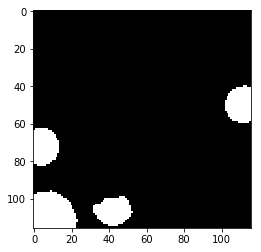

Label  0


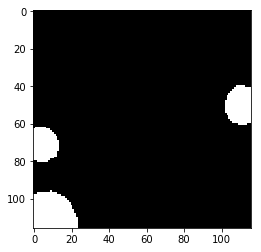

Prediction  1


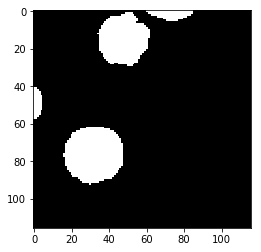

Label  1


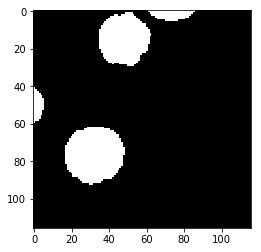

Prediction  2


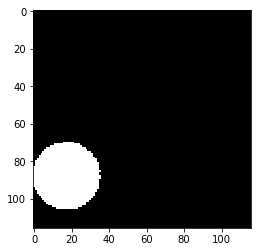

Label  2


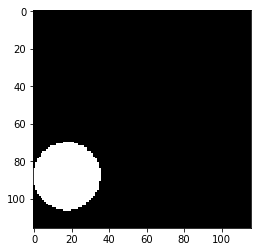

Prediction  3


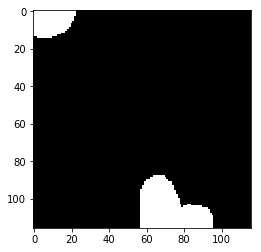

Label  3


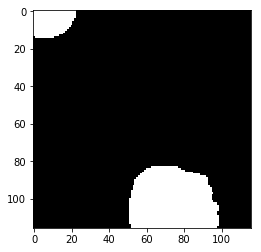

Prediction  4


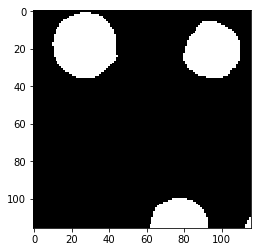

Label  4


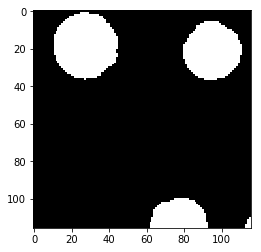

Prediction  5


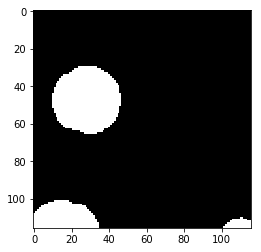

Label  5


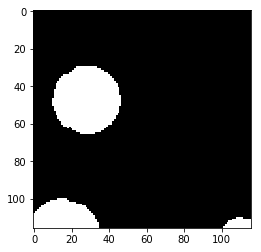

Prediction  6


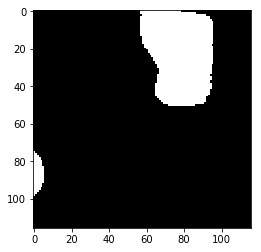

Label  6


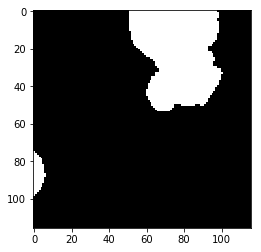

Prediction  7


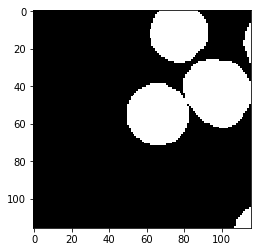

Label  7


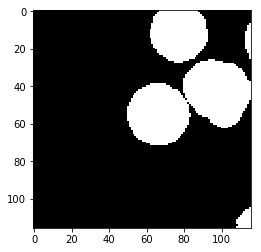

Prediction  8


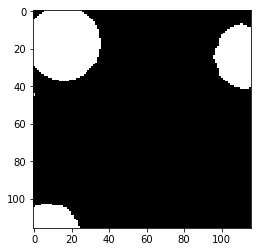

Label  8


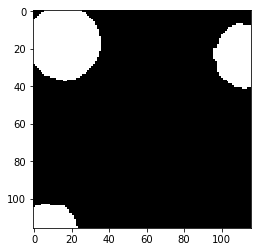

Prediction  9


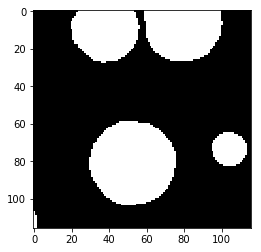

Label  9


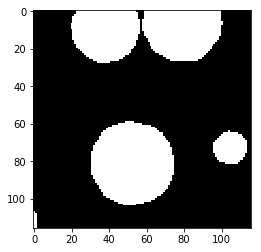

Prediction  10


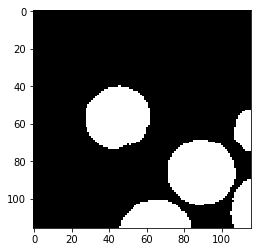

Label  10


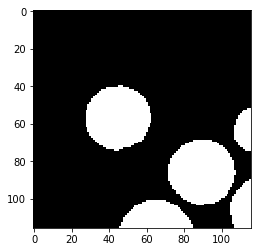

Prediction  11


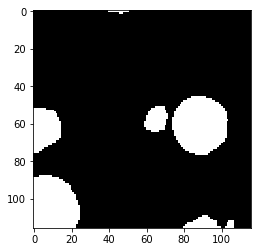

Label  11


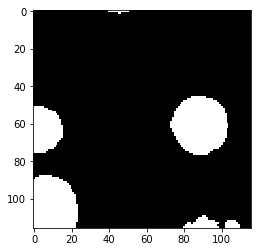

Prediction  12


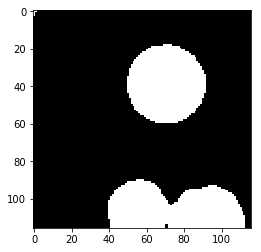

Label  12


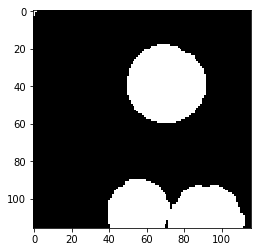

Prediction  13


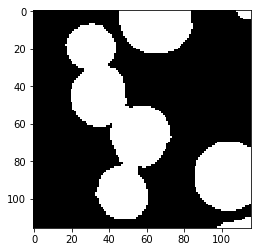

Label  13


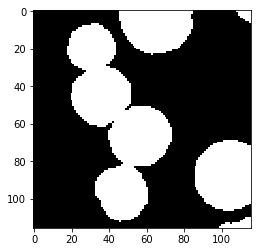

Prediction  14


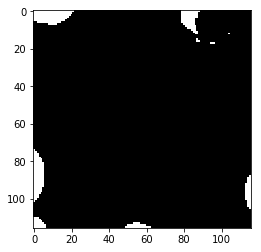

Label  14


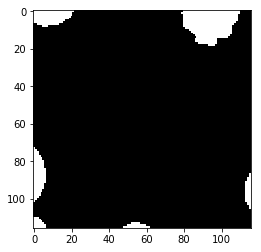

Prediction  15


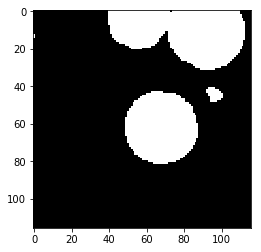

Label  15


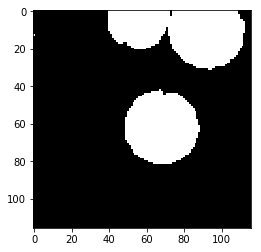

Prediction  16


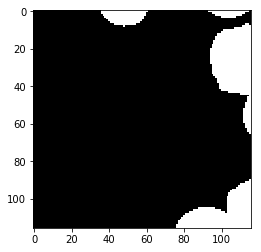

Label  16


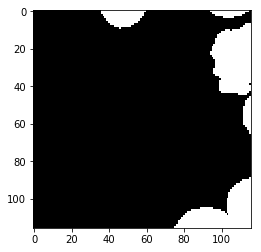

Prediction  17


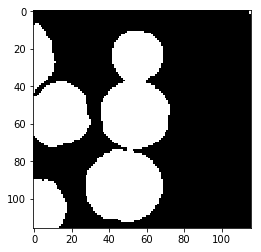

Label  17


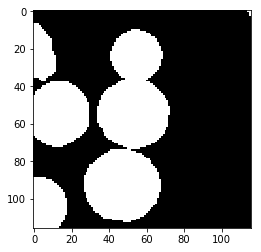

Prediction  18


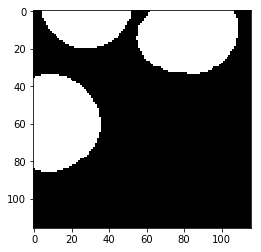

Label  18


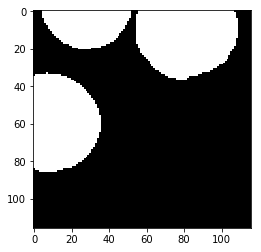

Prediction  19


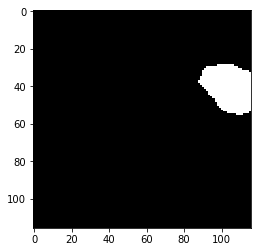

Label  19


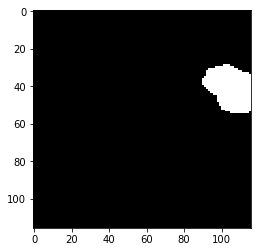

Prediction  20


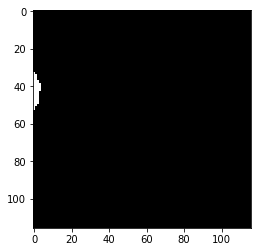

Label  20


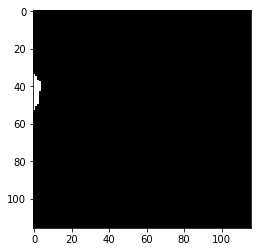

Prediction  21


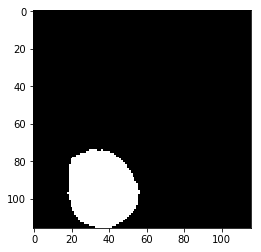

Label  21


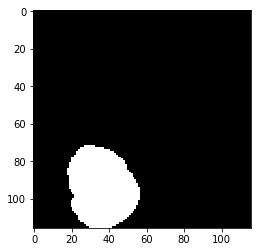

Prediction  22


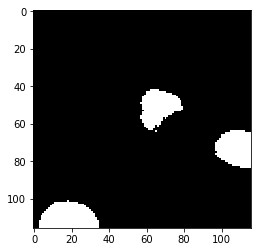

Label  22


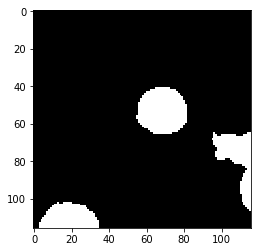

Prediction  23


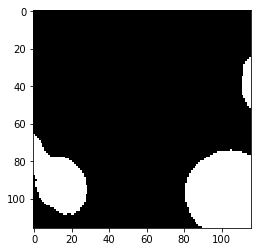

Label  23


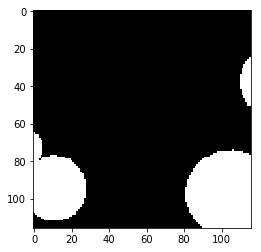

Prediction  24


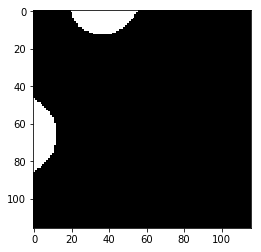

Label  24


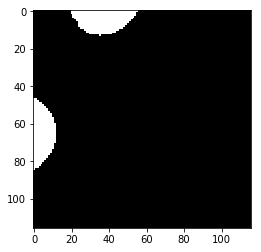

Prediction  25


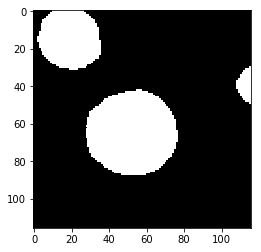

Label  25


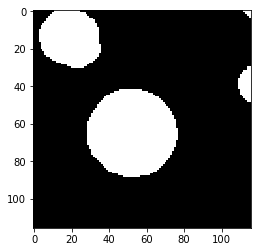

Prediction  26


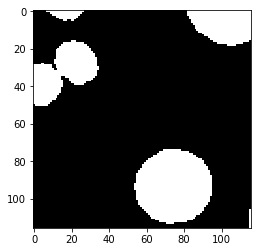

Label  26


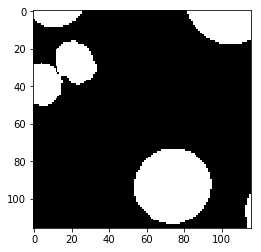

test_accuracy 0.974252655598
Batch: 36500 Train Loss value:0.00362815 Train Accuracy 0.997179962894
Prediction  0


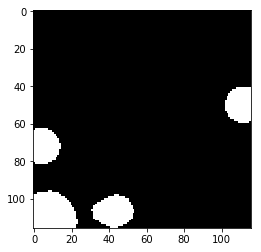

Label  0


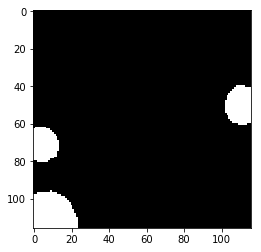

Prediction  1


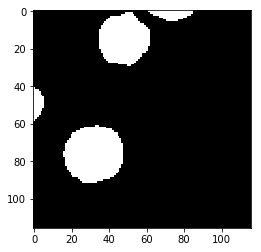

Label  1


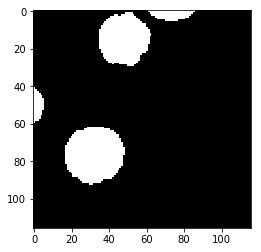

Prediction  2


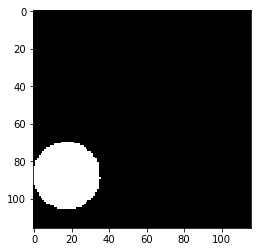

Label  2


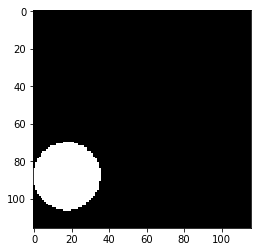

Prediction  3


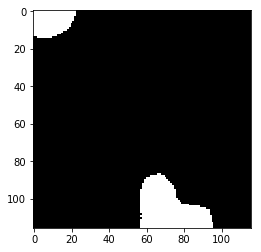

Label  3


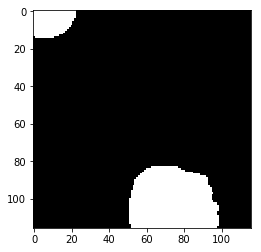

Prediction  4


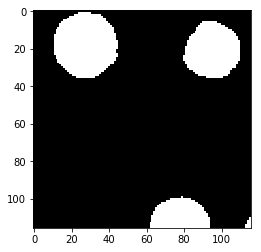

Label  4


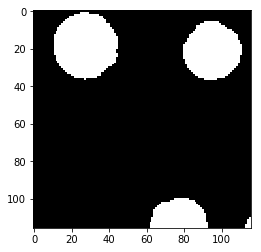

Prediction  5


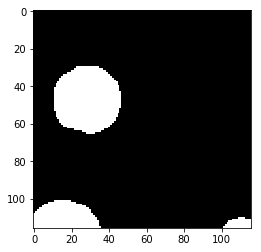

Label  5


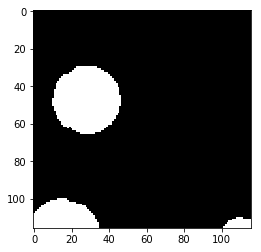

Prediction  6


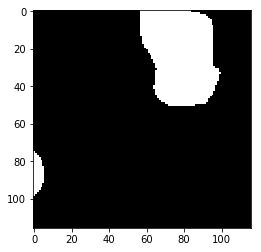

Label  6


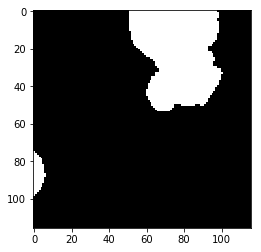

Prediction  7


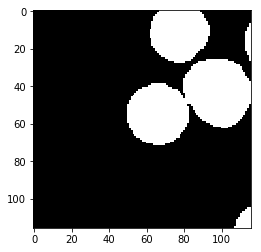

Label  7


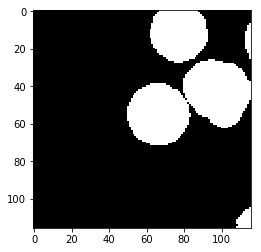

Prediction  8


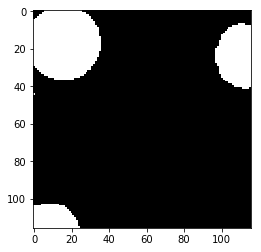

Label  8


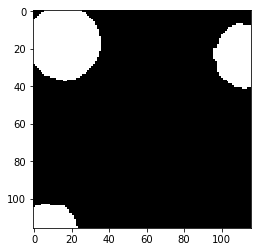

Prediction  9


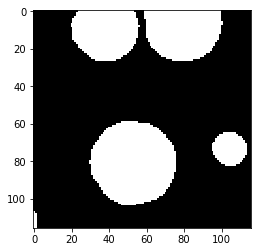

Label  9


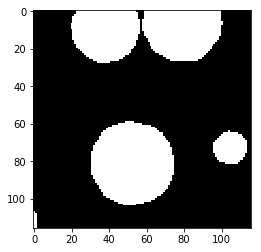

Prediction  10


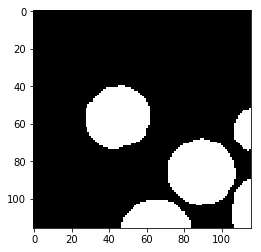

Label  10


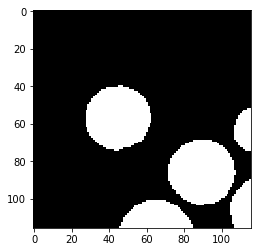

Prediction  11


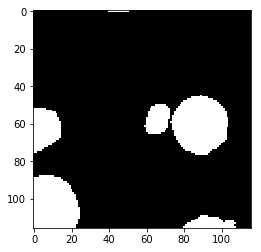

Label  11


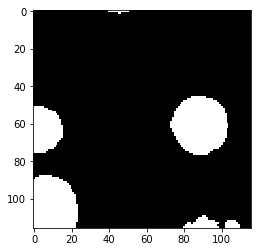

Prediction  12


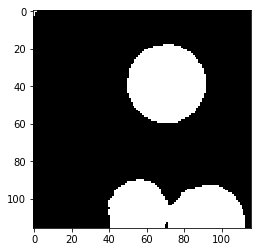

Label  12


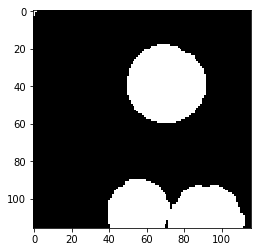

Prediction  13


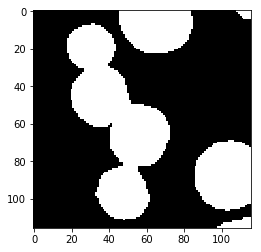

Label  13


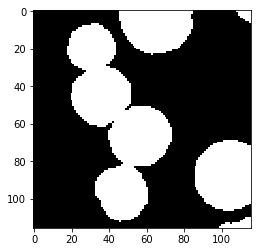

Prediction  14


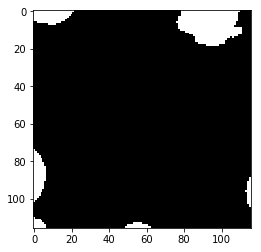

Label  14


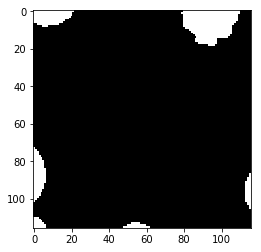

Prediction  15


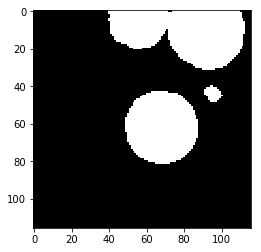

Label  15


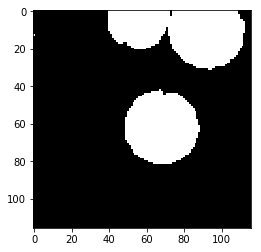

Prediction  16


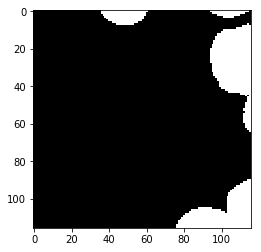

Label  16


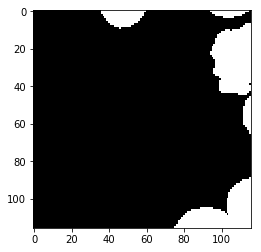

Prediction  17


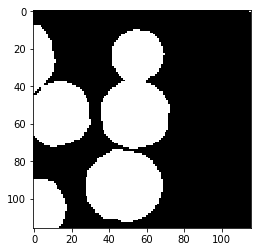

Label  17


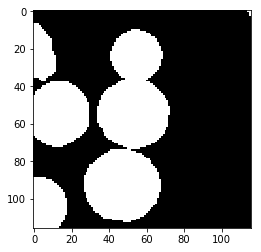

Prediction  18


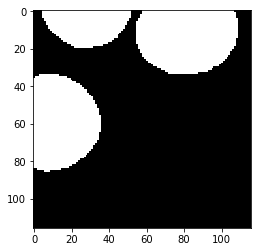

Label  18


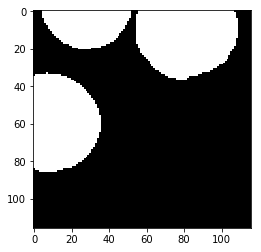

Prediction  19


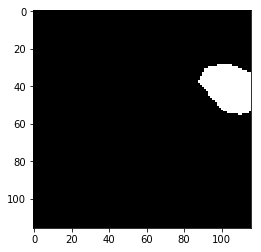

Label  19


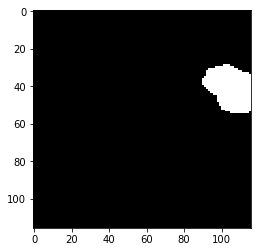

Prediction  20


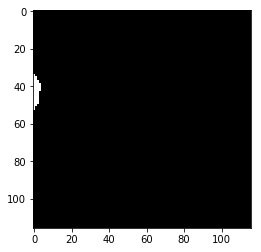

Label  20


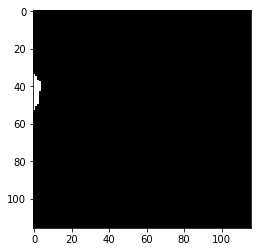

Prediction  21


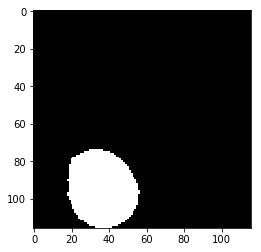

Label  21


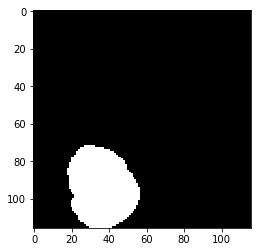

Prediction  22


Label  22


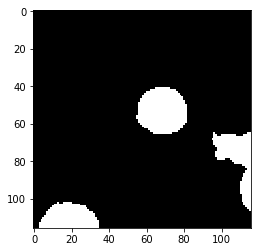

Prediction  23


Label  23


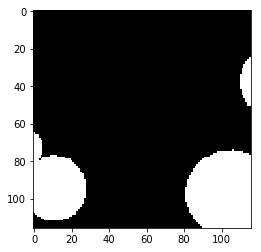

Prediction  24


Label  24


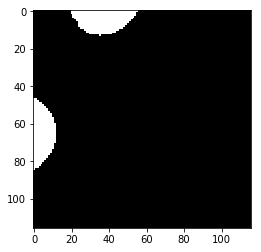

Prediction  25


Label  25


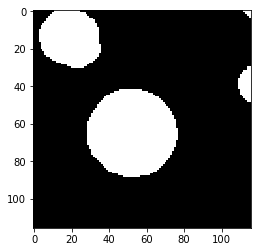

Prediction  26


Label  26


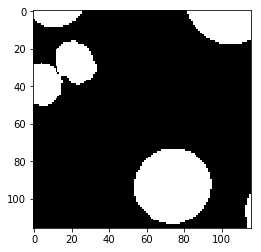

test_accuracy 0.976712307355
Batch: 37000 Train Loss value:0.00248632 Train Accuracy 0.997772993839
Prediction  0


Label  0


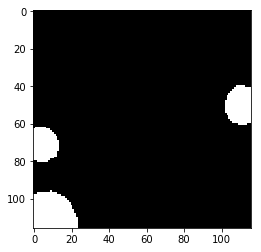

Prediction  1


Label  1


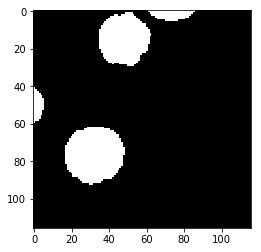

Prediction  2


Label  2


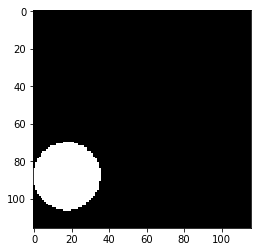

Prediction  3


Label  3


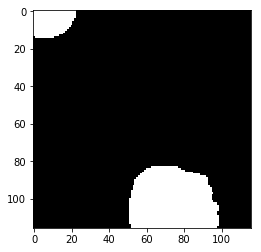

Prediction  4


Label  4


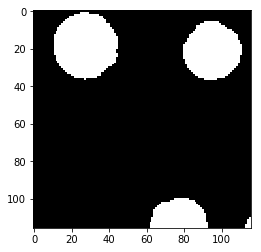

Prediction  5


Label  5


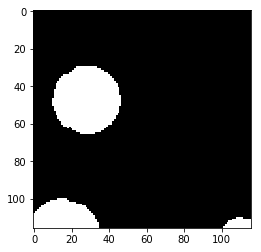

Prediction  6


Label  6


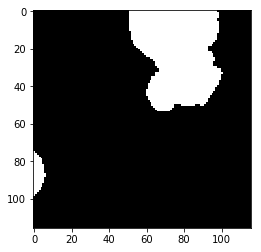

Prediction  7


Label  7


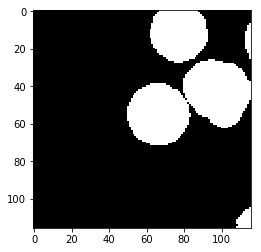

Prediction  8


Label  8


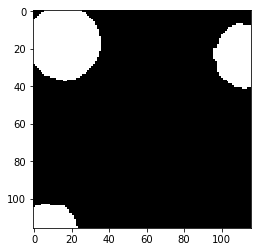

Prediction  9


Label  9


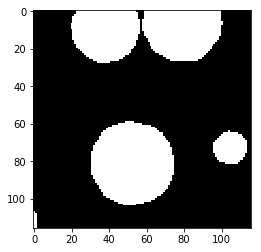

Prediction  10


Label  10


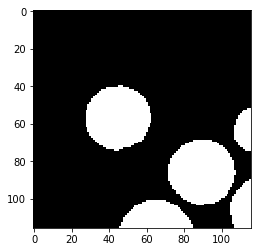

Prediction  11


Label  11


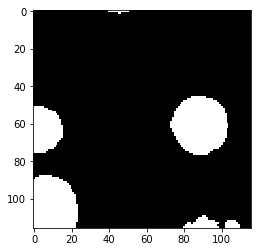

Prediction  12


Label  12


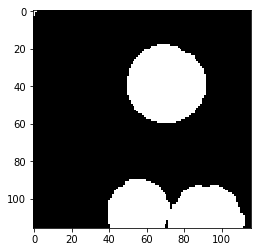

Prediction  13


Label  13


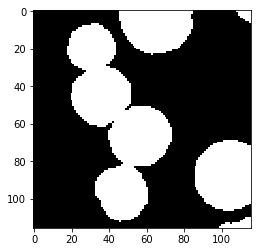

Prediction  14


Label  14


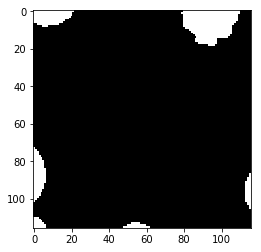

Prediction  15


Label  15


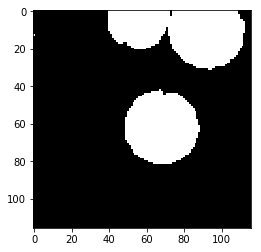

Prediction  16


Label  16


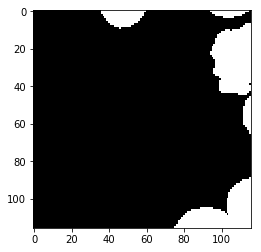

Prediction  17


Label  17


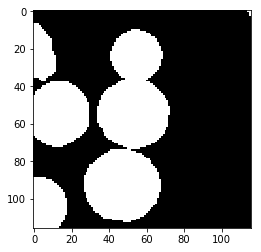

Prediction  18


Label  18


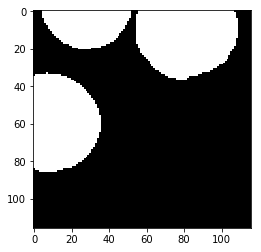

Prediction  19


Label  19


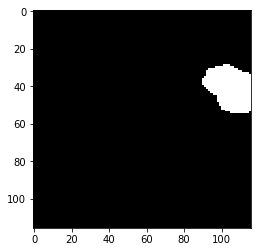

Prediction  20


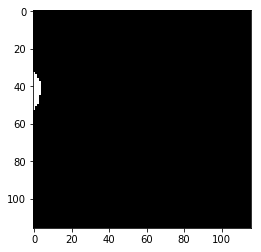

Label  20


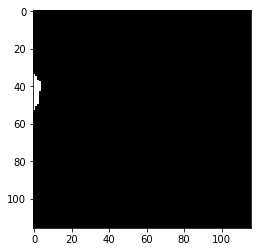

Prediction  21


Label  21


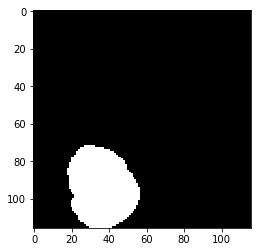

Prediction  22


Label  22


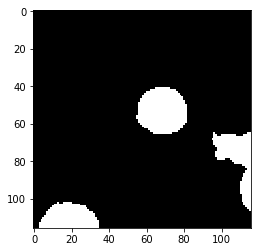

Prediction  23


Label  23


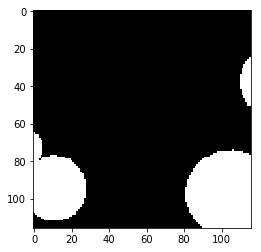

Prediction  24


Label  24


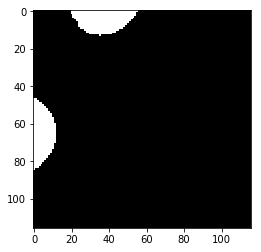

Prediction  25


Label  25


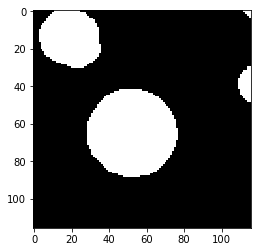

Prediction  26


Label  26


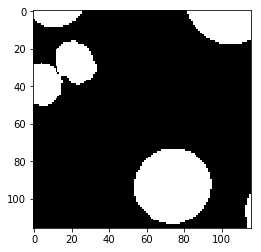

test_accuracy 0.975941369981
Batch: 37500 Train Loss value:0.00933221 Train Accuracy 0.99156367942
Prediction  0


Label  0


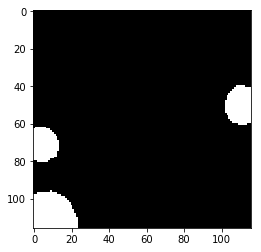

Prediction  1


Label  1


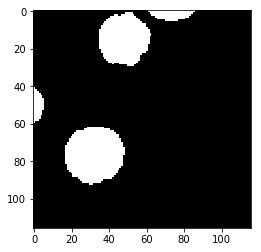

Prediction  2


Label  2


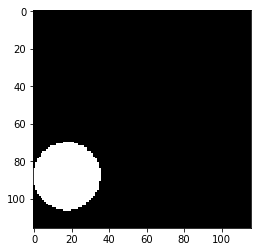

Prediction  3


Label  3


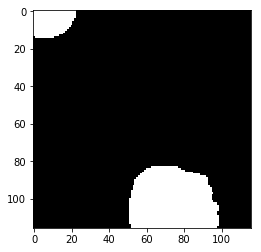

Prediction  4


Label  4


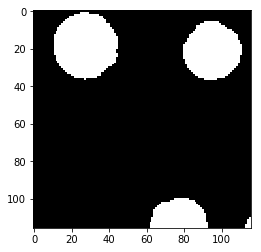

Prediction  5


Label  5


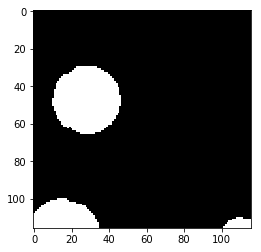

Prediction  6


Label  6


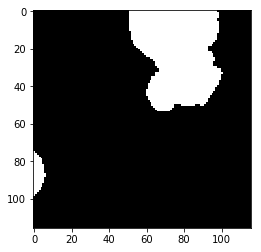

Prediction  7


Label  7


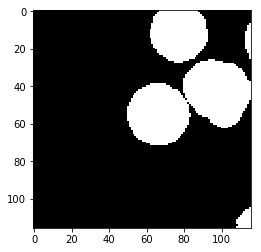

Prediction  8


Label  8


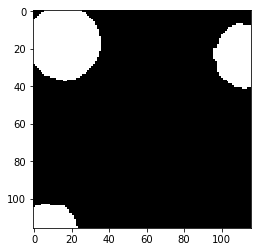

Prediction  9


Label  9


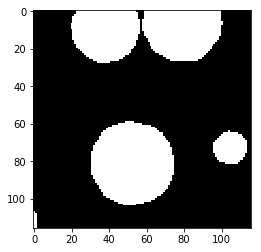

Prediction  10


Label  10


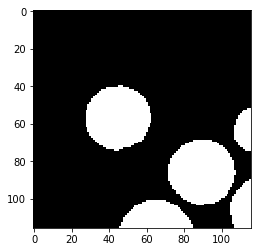

Prediction  11


Label  11


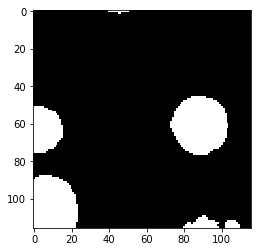

Prediction  12


Label  12


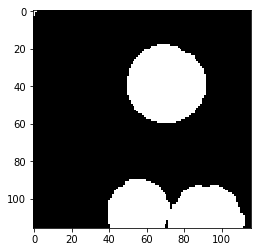

Prediction  13


Label  13


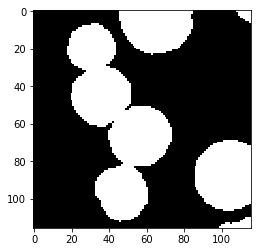

Prediction  14


Label  14


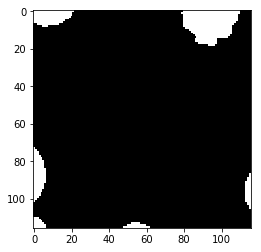

Prediction  15


Label  15


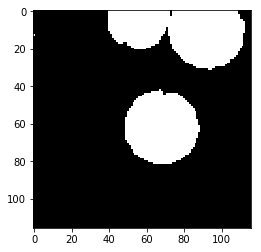

Prediction  16


Label  16


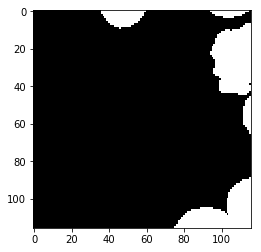

Prediction  17


Label  17


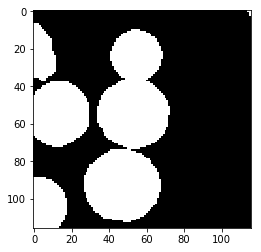

Prediction  18


Label  18


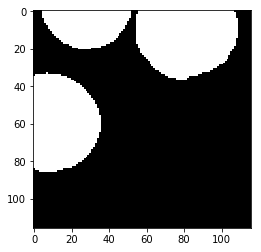

Prediction  19


Label  19


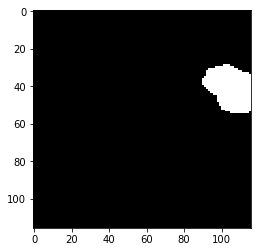

Prediction  20


Label  20


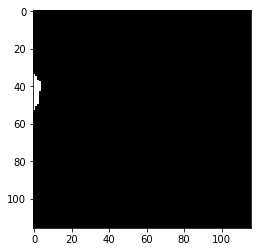

Prediction  21


Label  21


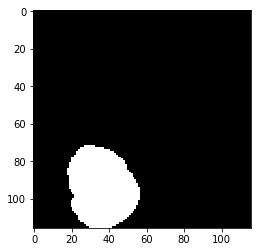

Prediction  22


Label  22


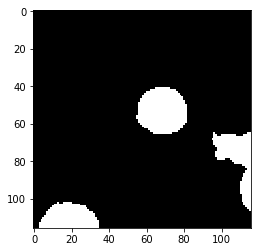

Prediction  23


Label  23


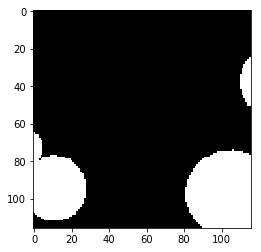

Prediction  24


Label  24


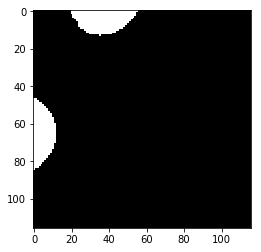

Prediction  25


Label  25


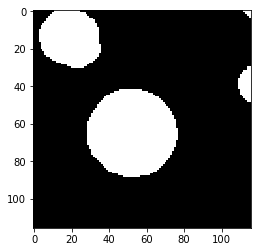

Prediction  26


Label  26


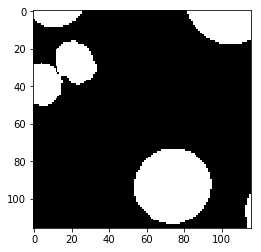

test_accuracy 0.974297084483
Batch: 38000 Train Loss value:0.0198582 Train Accuracy 0.982175738381
Prediction  0


Label  0


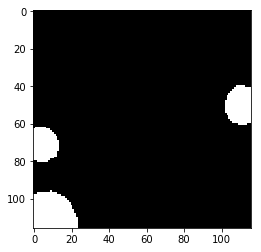

Prediction  1


Label  1


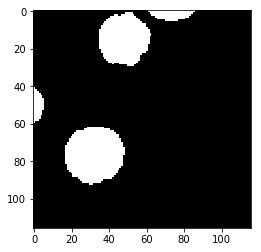

Prediction  2


Label  2


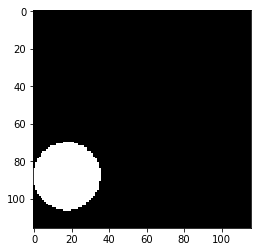

Prediction  3


Label  3


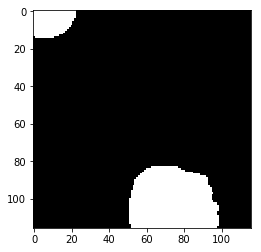

Prediction  4


Label  4


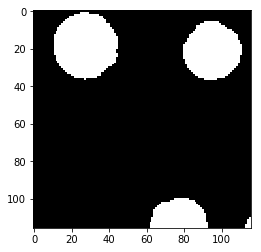

Prediction  5


Label  5


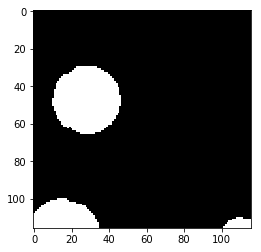

Prediction  6


Label  6


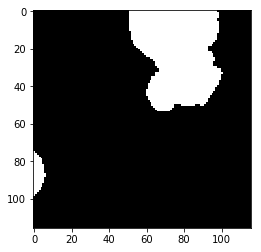

Prediction  7


Label  7


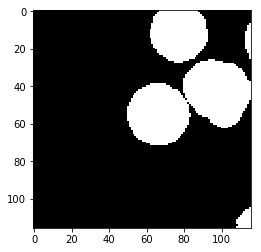

Prediction  8


Label  8


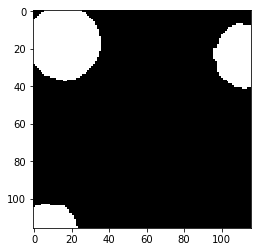

Prediction  9


Label  9


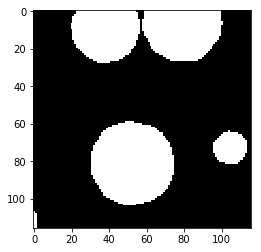

Prediction  10


Label  10


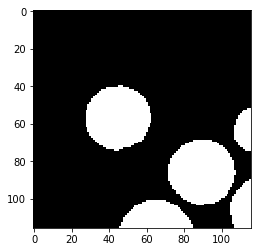

Prediction  11


Label  11


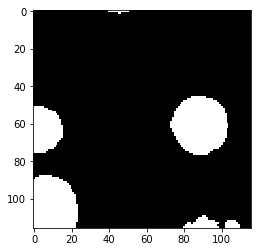

Prediction  12


Label  12


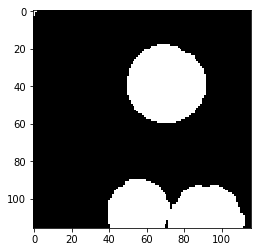

Prediction  13


Label  13


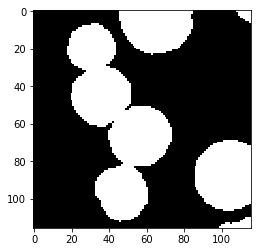

Prediction  14


Label  14


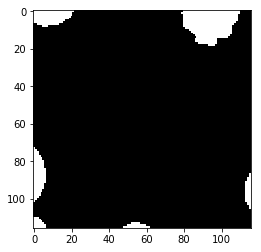

Prediction  15


Label  15


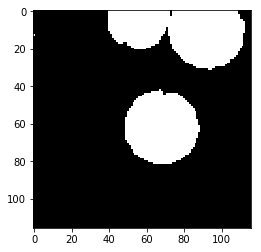

Prediction  16


Label  16


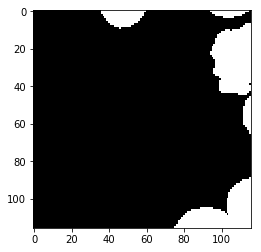

Prediction  17


Label  17


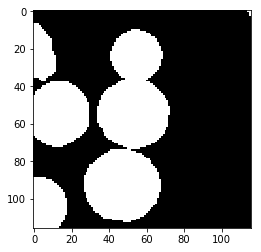

Prediction  18


Label  18


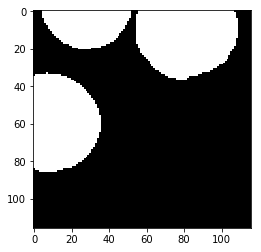

Prediction  19


Label  19


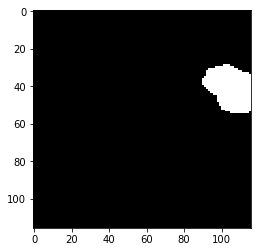

Prediction  20


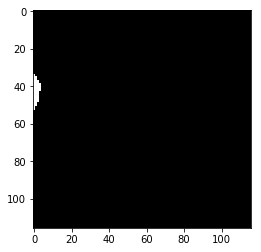

Label  20


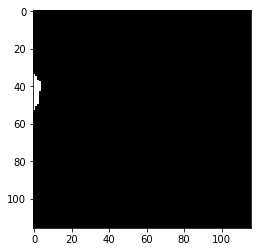

Prediction  21


Label  21


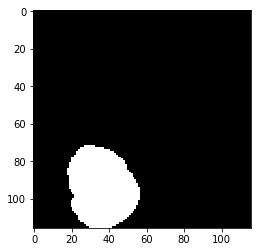

Prediction  22


Label  22


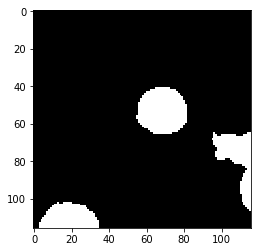

Prediction  23


Label  23


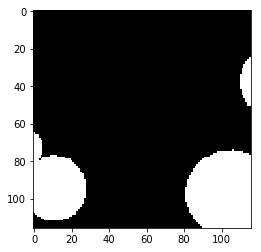

Prediction  24


Label  24


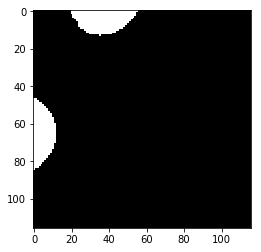

Prediction  25


Label  25


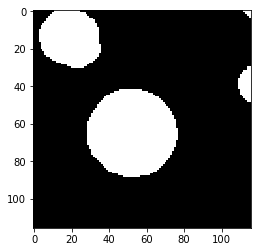

Prediction  26


Label  26


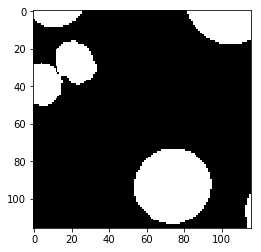

test_accuracy 0.977724983468
Batch: 38500 Train Loss value:0.00899327 Train Accuracy 0.99244836011
Prediction  0


Label  0


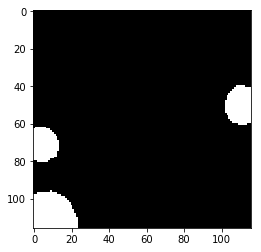

Prediction  1


Label  1


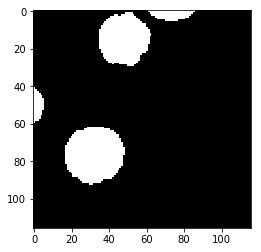

Prediction  2


Label  2


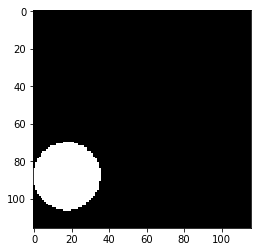

Prediction  3


Label  3


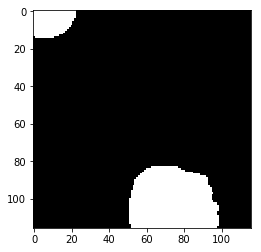

Prediction  4


Label  4


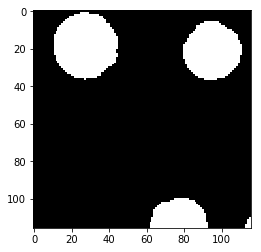

Prediction  5


Label  5


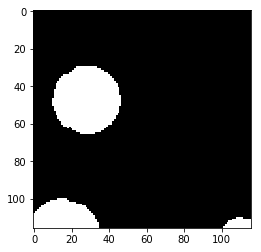

Prediction  6


Label  6


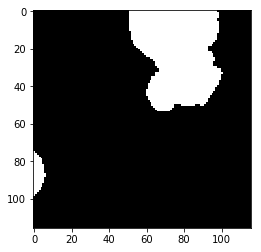

Prediction  7


Label  7


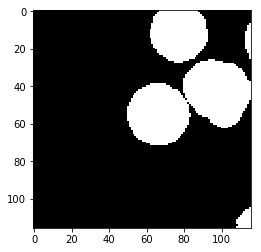

Prediction  8


Label  8


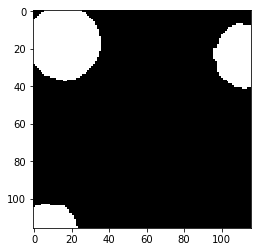

Prediction  9


Label  9


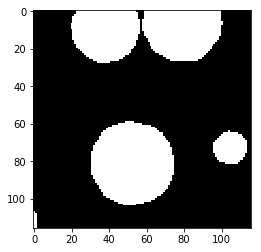

Prediction  10


Label  10


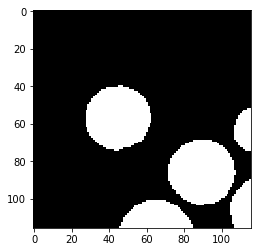

Prediction  11


Label  11


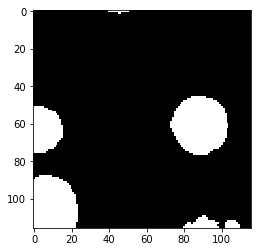

Prediction  12


Label  12


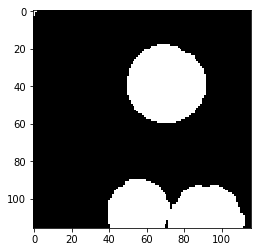

Prediction  13


Label  13


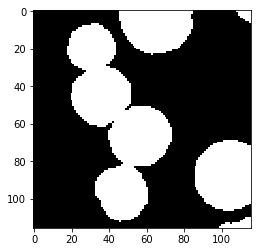

Prediction  14


Label  14


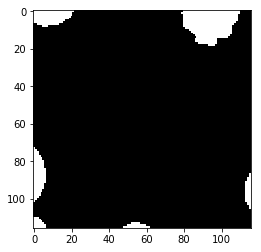

Prediction  15


Label  15


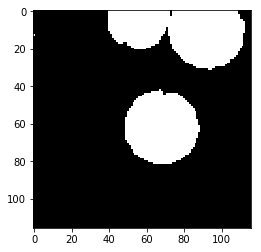

Prediction  16


Label  16


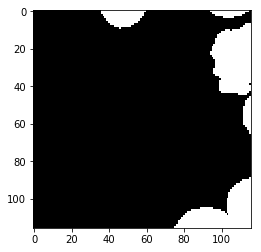

Prediction  17


Label  17


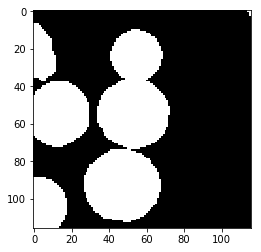

Prediction  18


Label  18


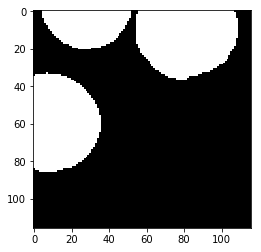

Prediction  19


Label  19


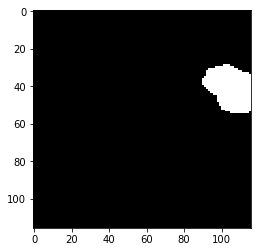

Prediction  20


Label  20


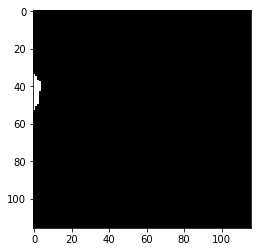

Prediction  21


Label  21


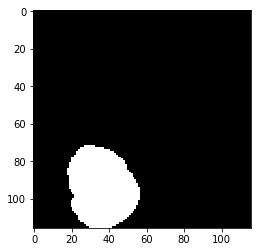

Prediction  22


Label  22


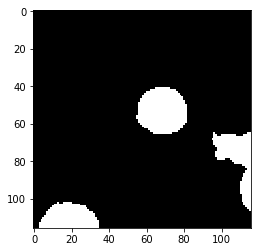

Prediction  23


Label  23


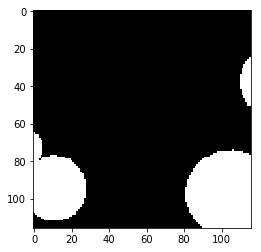

Prediction  24


Label  24


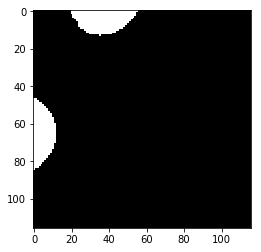

Prediction  25


Label  25


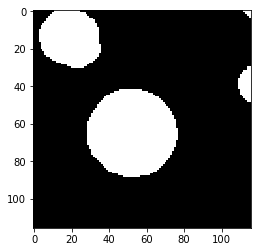

Prediction  26


Label  26


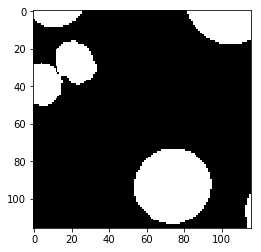

test_accuracy 0.976715998821
Batch: 39000 Train Loss value:0.00289667 Train Accuracy 0.997772993839
Prediction  0


Label  0


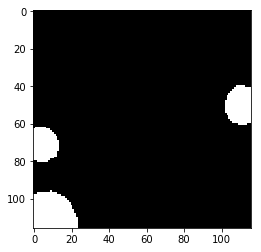

Prediction  1


Label  1


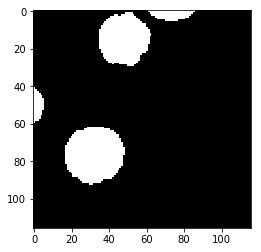

Prediction  2


Label  2


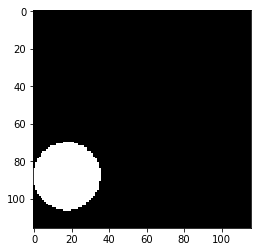

Prediction  3


Label  3


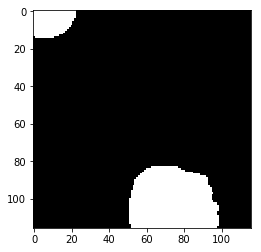

Prediction  4


Label  4


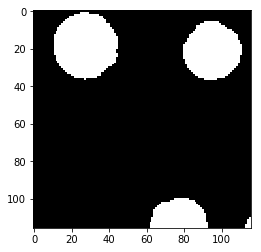

Prediction  5


Label  5


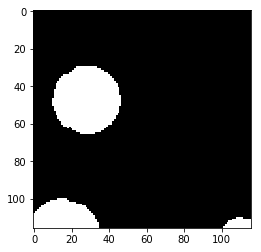

Prediction  6


Label  6


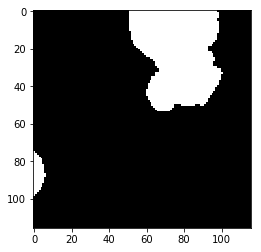

Prediction  7


Label  7


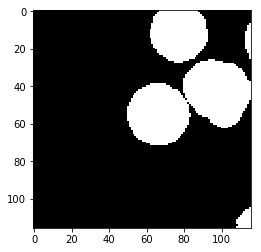

Prediction  8


Label  8


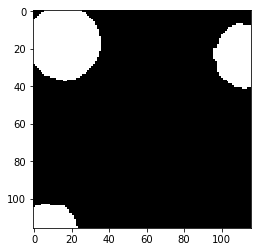

Prediction  9


Label  9


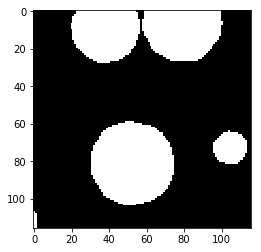

Prediction  10


Label  10


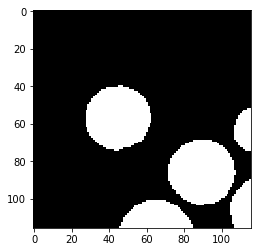

Prediction  11


Label  11


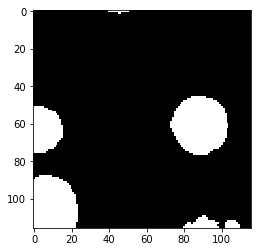

Prediction  12


Label  12


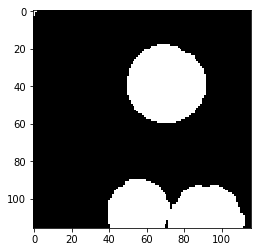

Prediction  13


Label  13


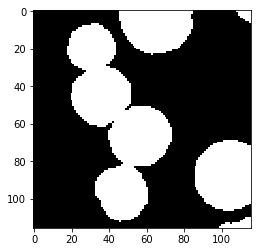

Prediction  14


Label  14


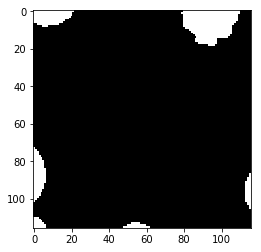

Prediction  15


Label  15


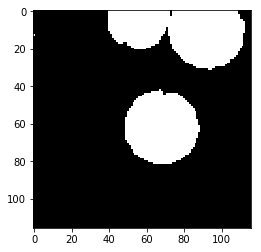

Prediction  16


Label  16


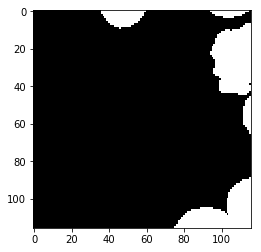

Prediction  17


Label  17


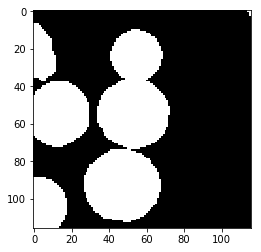

Prediction  18


Label  18


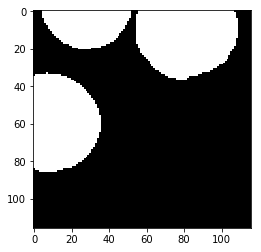

Prediction  19


Label  19


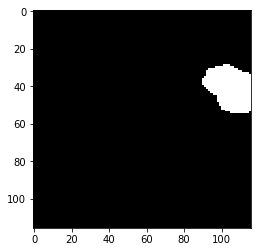

Prediction  20


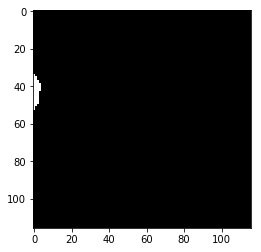

Label  20


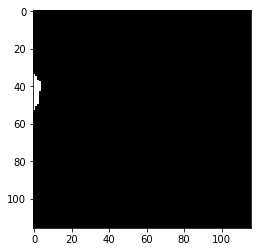

Prediction  21


Label  21


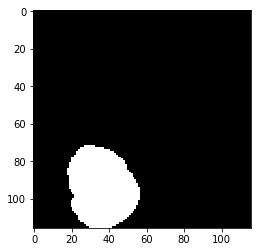

Prediction  22


Label  22


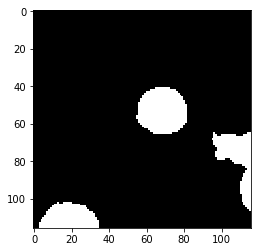

Prediction  23


Label  23


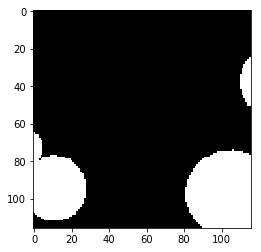

Prediction  24


Label  24


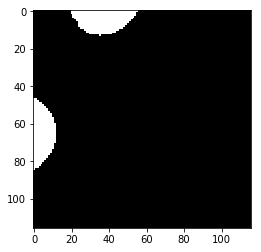

Prediction  25


Label  25


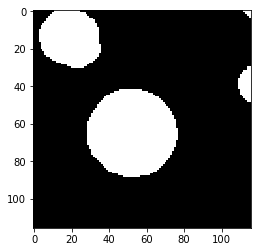

Prediction  26


Label  26


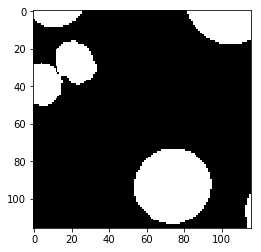

test_accuracy 0.976952682796
Batch: 39500 Train Loss value:0.0184794 Train Accuracy 0.984514416341
Prediction  0


Label  0


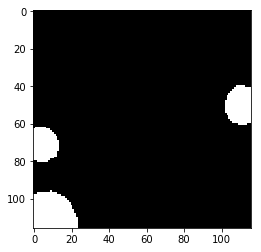

Prediction  1


Label  1


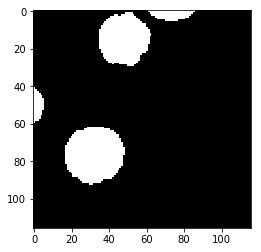

Prediction  2


Label  2


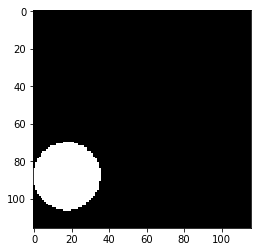

Prediction  3


Label  3


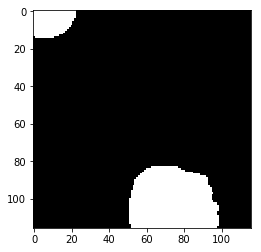

Prediction  4


Label  4


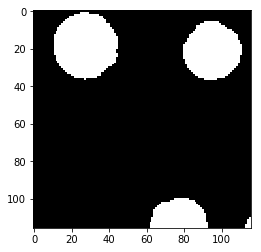

Prediction  5


Label  5


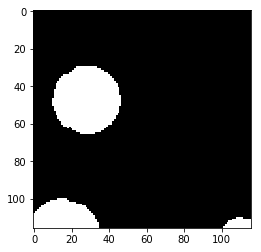

Prediction  6


Label  6


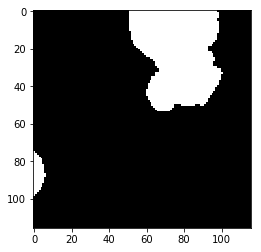

Prediction  7


Label  7


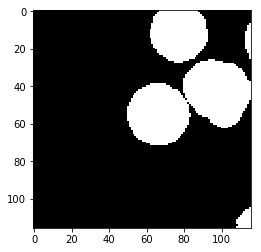

Prediction  8


Label  8


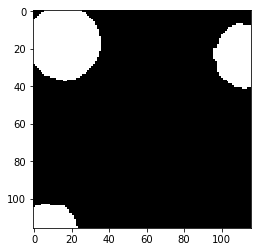

Prediction  9


Label  9


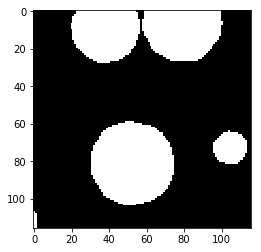

Prediction  10


Label  10


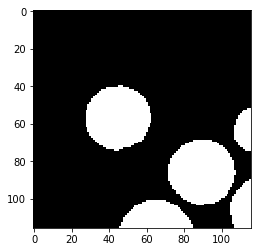

Prediction  11


Label  11


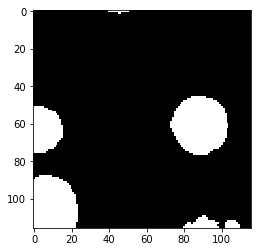

Prediction  12


Label  12


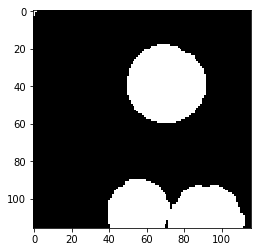

Prediction  13


Label  13


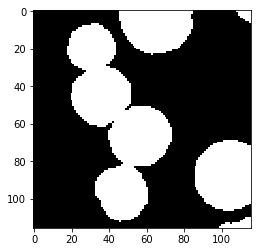

Prediction  14


Label  14


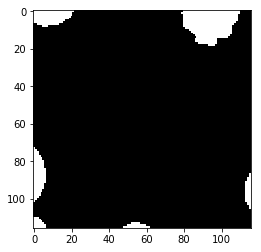

Prediction  15


Label  15


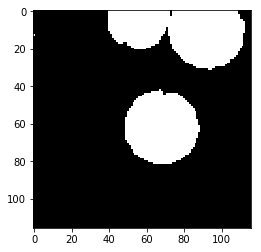

Prediction  16


Label  16


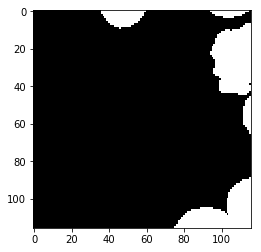

Prediction  17


Label  17


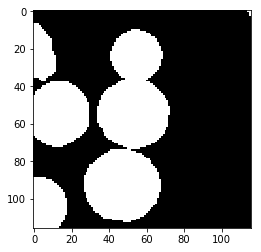

Prediction  18


Label  18


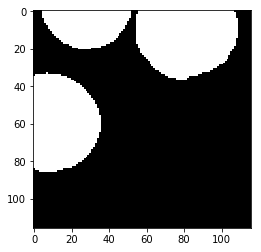

Prediction  19


Label  19


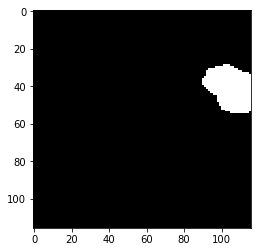

Prediction  20


Label  20


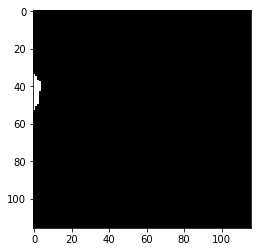

Prediction  21


Label  21


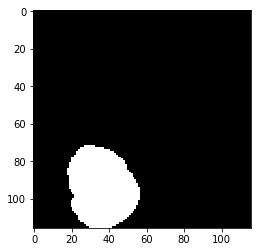

Prediction  22


Label  22


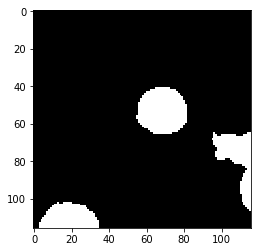

Prediction  23


Label  23


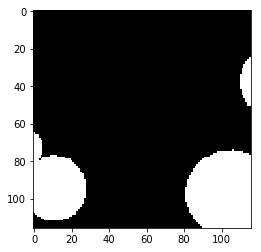

Prediction  24


Label  24


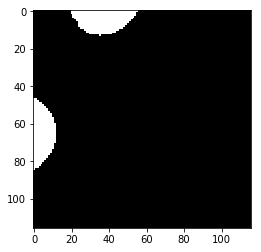

Prediction  25


Label  25


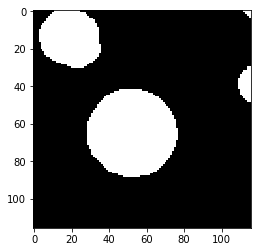

Prediction  26


Label  26


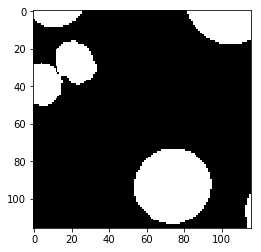

test_accuracy 0.977003610243
Batch: 40000 Train Loss value:0.00226847 Train Accuracy 0.99836637707
Prediction  0


Label  0


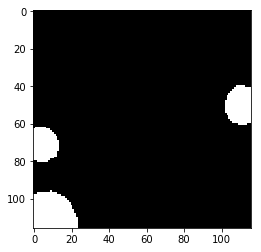

Prediction  1


Label  1


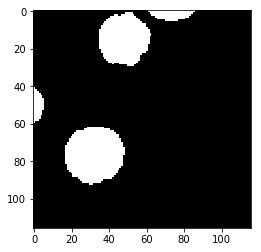

Prediction  2


Label  2


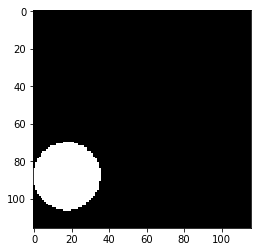

Prediction  3


Label  3


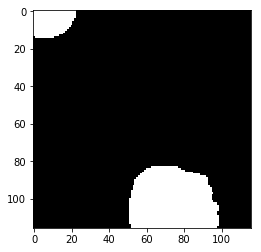

Prediction  4


Label  4


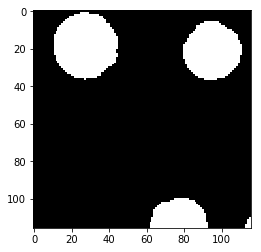

Prediction  5


Label  5


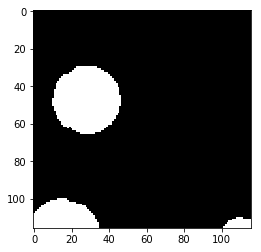

Prediction  6


Label  6


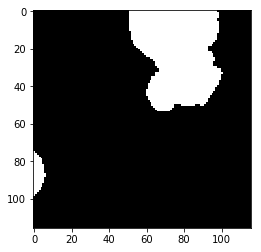

Prediction  7


Label  7


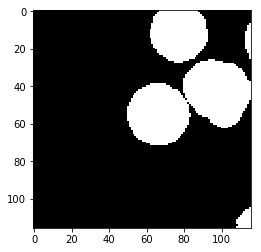

Prediction  8


Label  8


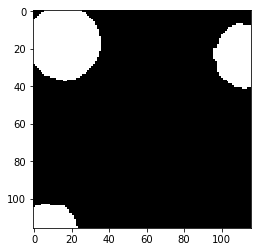

Prediction  9


Label  9


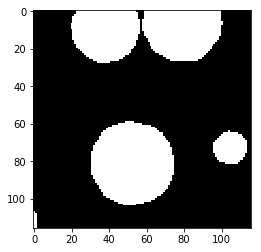

Prediction  10


Label  10


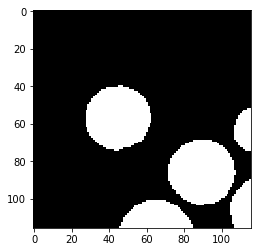

Prediction  11


Label  11


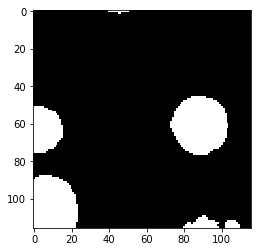

Prediction  12


Label  12


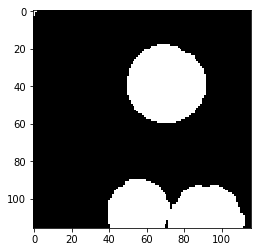

Prediction  13


Label  13


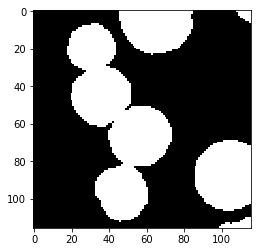

Prediction  14


Label  14


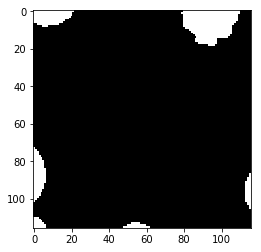

Prediction  15


Label  15


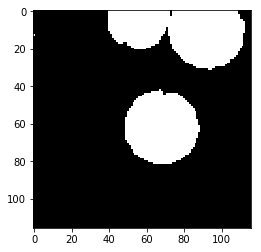

Prediction  16


Label  16


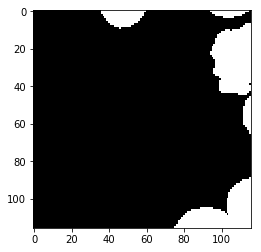

Prediction  17


Label  17


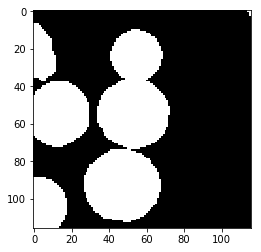

Prediction  18


Label  18


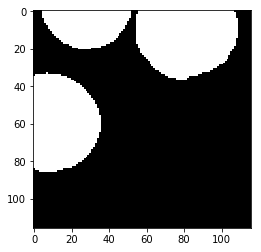

Prediction  19


Label  19


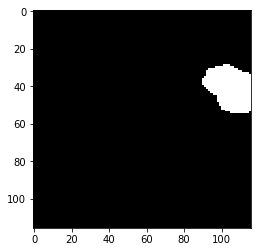

Prediction  20


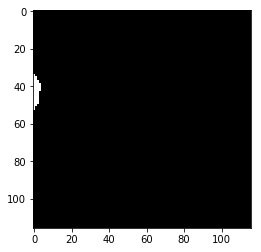

Label  20


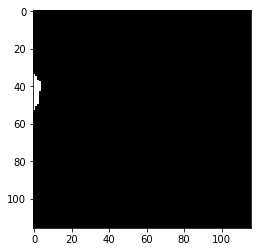

Prediction  21


Label  21


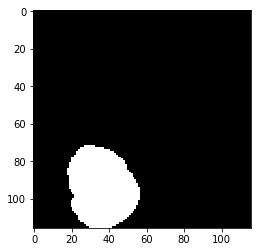

Prediction  22


Label  22


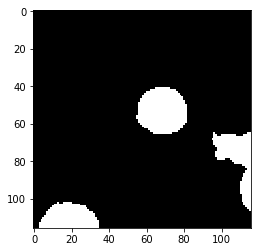

Prediction  23


Label  23


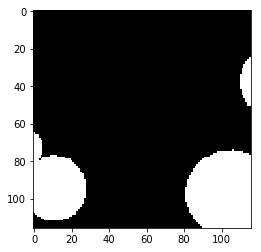

Prediction  24


Label  24


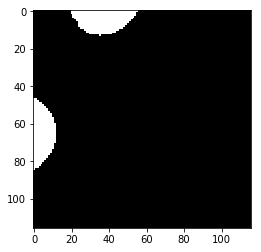

Prediction  25


Label  25


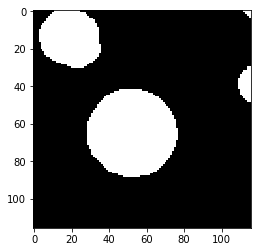

Prediction  26


Label  26


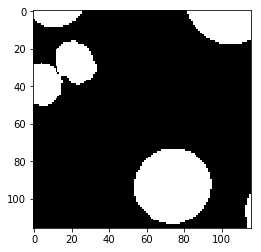

test_accuracy 0.975315651694
Duration: 25952.3s


In [17]:
acc_tr_array=[]
acc_te_array=[]    
loss_tr_array=[]
loss_te_array=[]

mini_batch_size=1
learning_rate=0.0001


x = tf.placeholder(tf.float32, [None, 300,300,1])
y = tf.placeholder(tf.int32, [None, 116,116])




y_hat = u_net(x)

y_resh = tf.reshape(y, [mini_batch_size*116*116])
y_hot=tf.one_hot(y_resh,2)

print('y_hot', y_hot.get_shape().as_list())


y_hat_resh = tf.reshape(y_hat, [mini_batch_size*116*116, 2])

print('y_hat_resh',y_hat_resh.get_shape().as_list())




loss = tf.nn.softmax_cross_entropy_with_logits(labels=y_hot, logits=y_hat_resh)

loss = tf.reduce_mean(loss)



train_step = tf.train.AdamOptimizer(learning_rate, 0.95, 0.99).minimize(loss)

correct_prediction = tf.equal(tf.argmax(y_hat_resh, 1), tf.argmax(y_hot, 1))
correct_prediction = tf.cast(correct_prediction, tf.float32)



config = tf.ConfigProto(
device_count = {'GPU': 0})
sess = tf.Session(config=config)


with sess as sess:
    sess.run(tf.global_variables_initializer())
    t0 = time.time()
    for i in range(40001):
        batch = d.get_train_image_list_and_label_list()
        
        train_step.run(feed_dict={x: batch[0], y: batch[1]})
       
   
        
        if i % 500 == 0:
            prediction = correct_prediction.eval(feed_dict={x: batch[0], y: batch[1]})
            #print('prediction.shape',prediction.shape)
            train_accuracy = (np.sum(prediction))/(2*prediction.shape[0]-np.sum(prediction))

            loss_tr = loss.eval(feed_dict = {x: batch[0], y: batch[1]})

            loss_tr_array.append(loss_tr)
            acc_tr_array.append(train_accuracy)
            
            print("Batch: " + str(i) + " Train Loss value:" + str(loss_tr)+" Train Accuracy "+str(train_accuracy))
            
            
            #test
            im, lbl = d.get_test_image_list_and_label_list()
            test_accuracy=0.0
            for j in range(len(lbl)):
                output= y_hat.eval(feed_dict={x: np.reshape(im[j],[1,300,300,1]), y: np.reshape(lbl[j],[1,116,116])})
                #print(output.shape)
                output=np.argmax(output, axis=-1)
                #print(output.shape)
                
                #prediction
                print('Prediction ', j)
                pixels_in = np.reshape(output,[116, 116])
                plt.imshow(pixels_in, cmap='gray')
                plt.show()
                #label
                print('Label ', j)
                pixels_in = np.reshape(lbl[j],[116, 116])
                plt.imshow(pixels_in, cmap='gray')
                plt.show()
                
                prediction_test = correct_prediction.eval(feed_dict={x: np.reshape(im[j],[1,300,300,1]), y: np.reshape(lbl[j],[1,116,116])})
                test_accuracy = test_accuracy+(np.sum(prediction_test))/(2*prediction_test.shape[0]-np.sum(prediction_test))
            
            test_accuracy = test_accuracy/len(lbl)
            acc_te_array.append(test_accuracy)
            print('test_accuracy',test_accuracy)
            

    t1 = time.time()    
    print('Duration: {:.1f}s'.format(t1-t0))
    
    


In [23]:

print('acc_tr_array', acc_tr_array)  
print('acc_te_array', acc_te_array) 
f_tr = open("train.txt","w") 
f_te = open("test.txt","w")
for t in acc_tr_array:
    f_tr.write(str(t)+'\n') 
for t in acc_te_array:
    f_te.write(str(t)+'\n') 
#f_te.write(acc_te_array) 


f_tr.close()
f_te.close()

acc_tr_array [0.1424690100186789, 0.79688856246244244, 0.9612301413788078, 0.94718182475942403, 0.90932954948563316, 0.91858558494332354, 0.96509675063891931, 0.99525504151838673, 0.88419799761954776, 0.97056454565424322, 0.97678859997061851, 0.96308994091472755, 0.96984336114770897, 0.94450867052023124, 0.98891434483777996, 0.92751754762927952, 1.0, 0.98086265273075224, 1.0, 0.98495353296946453, 0.97998822836962918, 0.98568582601638011, 0.98539284396901516, 0.98994380360839984, 0.99023813045407483, 0.9814460315122957, 0.99717996289424859, 1.0, 0.98964956380304603, 0.99230085875037011, 0.97751487985891694, 0.99466350429884376, 0.99614300548879986, 0.99348148148148152, 0.98159192990206912, 0.99023813045407483, 0.99777299383861628, 0.99481135571862722, 0.98597889454652798, 0.99555094171733649, 0.98700531600708796, 0.99658728392313967, 1.0, 0.99481135571862722, 0.99851477795930488, 0.97955130562706882, 0.98173784977908685, 0.99141630901287559, 0.99422008151167096, 0.99333382712391671, 0.9

In [35]:
#print(valid_acc_arr)


plt.figure(figsize=(12, 8))
x=[]
for i in range(len(acc_te_array)):
    x.append(i*500)
print(len(x))
#print(acc_tr_array)
print(len(acc_te_array))      
plt.plot(x, -np.log(acc_tr_array),label='train acc', linewidth=2.0)
plt.plot(x, -np.log(acc_te_array), label='test acc', linewidth=2.0)
#plt.plot(np.log(loss_tr_array1), label='Log of train loss. Learning rate 1e-1', linewidth=2.0)
plt.legend(loc='best') 
plt.ylabel('Negative log of accuracy')
plt.xlabel('Iterations')
plt.show()    

81
81
